Displaying sample training images:
Training set size: 240
Testing set size: 60


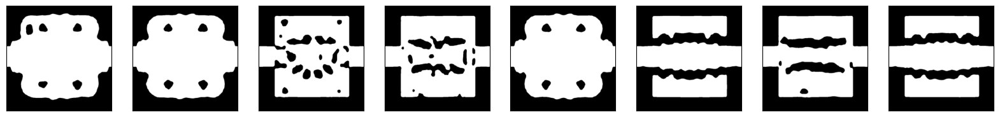

In [5]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# Function to load and resize grayscale images
def load_grayscale_images(path, label, target_size=(63, 63)):
    """
    Loads and resizes grayscale images from the given path and assigns labels.

    Parameters:
        path (str): Directory path containing the images.
        label (int): Label for the images.
        target_size (tuple): Target size for resizing images (width, height).

    Returns:
        images (list): List of resized image arrays.
        labels (list): List of corresponding labels.
    """
    images = []
    labels = []

    for file in os.listdir(path):
        if file.endswith(".bmp"):  # Process only BMP files
            img_path = os.path.join(path, file)
            img = Image.open(img_path).convert('L')  # Convert to grayscale
            img_resized = img.resize(target_size)  # Resize the image to target_size
            images.append(np.array(img_resized))  # Convert to numpy array
            labels.append(label)  # Assign label

    return images, labels

# Function to display sample grayscale images
def show_grayscale_images(images, num_images=8):
    """
    Displays a few grayscale images from the dataset.

    Parameters:
        images (list): List of grayscale image arrays to display.
        num_images (int): Number of images to display.
    """
    fig, axes = plt.subplots(1, num_images, figsize=(20, 20), subplot_kw={'xticks': [], 'yticks': []})
    for i, ax in enumerate(axes.flat):
        ax.imshow(images[i].squeeze(), cmap='gray')  # Use 'gray' colormap for grayscale images

# Folder paths
folder_paths = {
    "no_phase": 'Phase_shifter-new/no_phase/no_phase_first100',
    "pi_by_2_phase": 'Phase_shifter-new/pi_by_2_phase/pi_by_2_phase_first100',
    "zero_phase": 'Phase_shifter-new/zero_phase/zero_phase_first100'
}

# Initialize lists for images and labels
x_train = []
y_train = []
x_test = []
y_test = []

# Load and resize grayscale images for each category
target_size = (256, 256)  # Define the target size for resizing
no_phase_images, no_phase_labels = load_grayscale_images(folder_paths["no_phase"], 0, target_size)
pi_by_2_phase_images, pi_by_2_phase_labels = load_grayscale_images(folder_paths["pi_by_2_phase"], 1, target_size)
zero_phase_images, zero_phase_labels = load_grayscale_images(folder_paths["zero_phase"], 2, target_size)

# Combine images and labels
x_train = no_phase_images + pi_by_2_phase_images + zero_phase_images
y_train = no_phase_labels + pi_by_2_phase_labels + zero_phase_labels

# Convert lists to numpy arrays
x_train = np.array(x_train, dtype="float32") / 255.0  # Normalize grayscale pixel values to [0, 1]
x_train = np.expand_dims(x_train, axis=-1)  # Add a channel dimension for grayscale (e.g., (height, width, 1))
y_train = np.array(y_train, dtype="int")  # Convert labels to numpy array

# Split into training and testing sets (e.g., 75% train, 25% test)
x_train, x_test, y_train, y_test = train_test_split(x_train, y_train, test_size=0.20, random_state=16)

# Display a few sample training images
print("Displaying sample training images:")
show_grayscale_images(x_train[:8])  # Display only the first 8 images
print(f"Training set size: {x_train.shape[0]}")
print(f"Testing set size: {x_test.shape[0]}")


## New code -- Preprocessing

### **Features in This Code**

1. **Grayscale Conversion & Resizing**:  
   Images are resized to \(256 \times 256\) and converted to grayscale.

2. **Normalization**:  
   Pixel values are normalized to the range \([0, 1]\).

3. **Stratified Splitting**:  
   Ensures balanced class distribution in train/test sets.

4. **Class Weights Calculation**:  
   Computes weights for imbalanced classes to improve model training.

5. **Data Augmentation**:  
   Applies transformations such as:
   - **Rotation**: Randomly rotates images.
   - **Shifting**: Horizontally and vertically shifts images.
   - **Zooming**: Randomly zooms into images.
   - **Flipping**: Randomly flips images horizontally.

6. **Visualization**:  
   Displays sample images with their labels for quick verification.

7. **Shape Verification**:  
   Prints dataset shapes to ensure proper preprocessing and readiness for training.

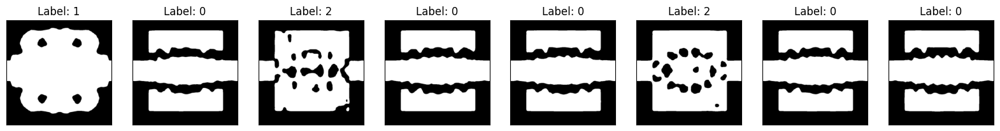

x_train shape: (240, 256, 256, 1), y_train shape: (240,)
x_test shape: (60, 256, 256, 1), y_test shape: (60,)
Class weights: {0: 1.0, 1: 1.0, 2: 1.0}


In [6]:
import os
import numpy as np
from PIL import Image
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit
from sklearn.utils import class_weight
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Parameters
target_size = (256, 256)  # Resize target dimensions
folder_paths = {
    "no_phase": 'Phase_shifter-new/no_phase/no_phase_first100',
    "pi_by_2_phase": 'Phase_shifter-new/pi_by_2_phase/pi_by_2_phase_first100',
    "zero_phase": 'Phase_shifter-new/zero_phase/zero_phase_first100'
}

# Initialize lists for images and labels
x_data = []
y_data = []

# Load and resize grayscale images
for label, path in enumerate(folder_paths.values()):
    for file in os.listdir(path):
        if file.endswith(".bmp"):  # Process only BMP files
            img_path = os.path.join(path, file)
            img = Image.open(img_path).convert('L')  # Convert to grayscale
            img_resized = img.resize(target_size)  # Resize image
            x_data.append(np.array(img_resized))  # Append image as numpy array
            y_data.append(label)  # Append label

# Convert lists to numpy arrays
x_data = np.array(x_data, dtype="float32") / 255.0  # Normalize pixel values to [0, 1]
x_data = np.expand_dims(x_data, axis=-1)  # Add channel dimension for grayscale
y_data = np.array(y_data, dtype="int")  # Convert labels to numpy array

# Stratified splitting for balanced class distribution
sss = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=16)
for train_idx, test_idx in sss.split(x_data, y_data):
    x_train, x_test = x_data[train_idx], x_data[test_idx]
    y_train, y_test = y_data[train_idx], y_data[test_idx]

# Calculate class weights to handle imbalance
class_weights = class_weight.compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y_train),
    y=y_train
)

class_weights = dict(enumerate(class_weights))

# Data augmentation for the training set
datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.2,
    height_shift_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
)
datagen.fit(x_train)

# Display sample images with labels for verification
fig, axes = plt.subplots(1, 8, figsize=(20, 20), subplot_kw={'xticks': [], 'yticks': []})
for i, ax in enumerate(axes.flat):
    ax.imshow(x_train[i].squeeze(), cmap='gray')
    ax.set_title(f"Label: {y_train[i]}")
plt.show()

# Print dataset sizes
print(f"x_train shape: {x_train.shape}, y_train shape: {y_train.shape}")
print(f"x_test shape: {x_test.shape}, y_test shape: {y_test.shape}")
print(f"Class weights: {class_weights}")


### New Neural Net Architecture

In [7]:
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, Dense, Dropout, BatchNormalization, SpatialDropout2D
from keras.regularizers import l2

model = Sequential()

# Convolutional layers
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 1), kernel_regularizer=l2(0.01)))
model.add(BatchNormalization())
model.add(MaxPooling2D(2, 2))
model.add(SpatialDropout2D(0.3))

model.add(Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(0.01)))
model.add(BatchNormalization())
model.add(MaxPooling2D(2, 2))

model.add(Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(0.01)))
model.add(BatchNormalization())
model.add(MaxPooling2D(2, 2))

# Global Average Pooling
model.add(GlobalAveragePooling2D())

# Fully connected layers
model.add(Dense(256, activation='relu', kernel_regularizer=l2(0.01)))
model.add(Dropout(0.5))
model.add(Dense(3, activation='softmax'))  # 3 classes

# Compile
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Learning rate scheduler
from keras.callbacks import ReduceLROnPlateau
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6)

# Display the model architecture
model.summary()


/Users/nayanthara/Library/Python/3.9/lib/python/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 254, 254, 32)   │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 254, 254, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 127, 127, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ spatial_dropout2d               │ (None, 127, 127, 32)   │             0 │
│ (SpatialDropout2D)              │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 125, 125, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 125, 125, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 62, 62, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 60, 60, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 60, 60, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 30, 30, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 128)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 3)              │           771 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 127,363 (497.51 KB)

 Trainable params: 126,915 (495.76 KB)

 Non-trainable params: 448 (1.75 KB)

### Old Neural Net

In [65]:
'''
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense

# Define the CNN model
model = Sequential()

# First convolutional layer
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 1)))  # Update input_shape for grayscale
model.add(MaxPooling2D(2, 2))

# Second convolutional layer
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(2, 2))

# Third convolutional layer
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(2, 2))

# Fourth convolutional layer
model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D(2, 2))

# Flattening and fully connected layers
model.add(Flatten())
model.add(Dense(1024, activation='relu'))  # Fully connected layer
model.add(Dense(3, activation='softmax'))  # Output layer for 3 classes

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Display the model architecture
model.summary()
'''

"\nfrom keras.models import Sequential\nfrom keras.layers import Conv2D, MaxPooling2D, Flatten, Dense\n\n# Define the CNN model\nmodel = Sequential()\n\n# First convolutional layer\nmodel.add(Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 1)))  # Update input_shape for grayscale\nmodel.add(MaxPooling2D(2, 2))\n\n# Second convolutional layer\nmodel.add(Conv2D(64, (3, 3), activation='relu'))\nmodel.add(MaxPooling2D(2, 2))\n\n# Third convolutional layer\nmodel.add(Conv2D(64, (3, 3), activation='relu'))\nmodel.add(MaxPooling2D(2, 2))\n\n# Fourth convolutional layer\nmodel.add(Conv2D(128, (3, 3), activation='relu'))\nmodel.add(MaxPooling2D(2, 2))\n\n# Flattening and fully connected layers\nmodel.add(Flatten())\nmodel.add(Dense(1024, activation='relu'))  # Fully connected layer\nmodel.add(Dense(3, activation='softmax'))  # Output layer for 3 classes\n\n# Compile the model\nmodel.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])\n\n# Display the mo

In [66]:
from tensorflow.keras.utils import to_categorical

# Convert labels to one-hot encoding
y_train = to_categorical(y_train, num_classes=3)
y_test = to_categorical(y_test, num_classes=3)

# Check the shape of y_train and y_test
print("y_train shape:", y_train.shape)
print("y_test shape:", y_test.shape)

# Train the model
hist = model.fit(
    x_train, y_train,
    validation_data=(x_test, y_test),
    batch_size=10,
    epochs=5
)

y_train shape: (240, 3)
y_test shape: (60, 3)
Epoch 1/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 8s 273ms/step - accuracy: 0.4159 - loss: 3.9166 - val_accuracy: 0.3333 - val_loss: 3.8055
Epoch 2/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 6s 270ms/step - accuracy: 0.8251 - loss: 3.1464 - val_accuracy: 0.3333 - val_loss: 3.6468
Epoch 3/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 6s 256ms/step - accuracy: 0.9354 - loss: 2.5153 - val_accuracy: 0.3333 - val_loss: 3.4363
Epoch 4/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 6s 263ms/step - accuracy: 0.9666 - loss: 2.0912 - val_accuracy: 0.3333 - val_loss: 2.8160
Epoch 5/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 6s 258ms/step - accuracy: 0.9423 - loss: 1.8182 - val_accuracy: 0.3333 - val_loss: 2.6005


### LIME Explanation for ALL Images (reference code)

In [ ]:
'''
from lime import lime_image
from skimage.segmentation import mark_boundaries
from lime.wrappers.scikit_image import SegmentationAlgorithm
import numpy as np
import matplotlib.pyplot as plt
import cv2

# Combine all images and labels
all_images = np.concatenate((x_train, x_test), axis=0)
all_labels = np.concatenate((y_train, y_test), axis=0)

# Define the prediction function compatible with LIME
def predict_fn(images):
    grayscale_images = np.expand_dims(np.mean(images, axis=-1), axis=-1)
    return model.predict(grayscale_images)

# Initialize LIME image explainer
explainer = lime_image.LimeImageExplainer()

# Configure segmentation for finer granularity
segmentation_fn = SegmentationAlgorithm('quickshift', kernel_size=1, max_dist=3, ratio=0.2)

# Loop through all images and display LIME explanations
for i, image in enumerate(all_images):
    # Convert grayscale image to RGB for LIME compatibility
    sample_image = cv2.cvtColor((image.squeeze() * 255).astype('uint8'), cv2.COLOR_GRAY2RGB)

    # Run LIME explanation
    explanation = explainer.explain_instance(
        sample_image.astype('double'),
        predict_fn,
        top_labels=1,  # Show explanation for the top predicted label
        hide_color=0,
        num_samples=700,  # Number of perturbed samples for LIME
        segmentation_fn=segmentation_fn  # Use custom segmentation
    )

    # Extract explanation image (with mask for highlighted regions)
    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=True,  # Highlight only positive contributions
        num_features=10,
        hide_rest=False
    )

    # Plot original and explanation images
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))

    # Original image
    ax1.imshow(sample_image, cmap='gray')
    ax1.set_title(f"Label: {np.argmax(all_labels[i])}")
    ax1.axis('off')

    # LIME explanation (highlighted regions)
    ax2.imshow(mark_boundaries(temp, mask, color=(1, 1, 0)))  # Yellow highlight
    ax2.set_title("LIME Explanation")
    ax2.axis('off')

    # Show the plot
    plt.tight_layout()
    plt.show()

    # Optional: Stop after a few images for debugging
    # if i == 10:
    #     break
'''

'\nfrom lime import lime_image\nfrom skimage.segmentation import mark_boundaries\nfrom lime.wrappers.scikit_image import SegmentationAlgorithm\nimport numpy as np\nimport matplotlib.pyplot as plt\nimport cv2\n\n# Combine all images and labels\nall_images = np.concatenate((x_train, x_test), axis=0)\nall_labels = np.concatenate((y_train, y_test), axis=0)\n\n# Define the prediction function compatible with LIME\ndef predict_fn(images):\n    grayscale_images = np.expand_dims(np.mean(images, axis=-1), axis=-1)\n    return model.predict(grayscale_images)\n\n# Initialize LIME image explainer\nexplainer = lime_image.LimeImageExplainer()\n\n# Configure segmentation for finer granularity\nsegmentation_fn = SegmentationAlgorithm(\'quickshift\', kernel_size=1, max_dist=3, ratio=0.2)\n\n# Loop through all images and display LIME explanations\nfor i, image in enumerate(all_images):\n    # Convert grayscale image to RGB for LIME compatibility\n    sample_image = cv2.cvtColor((image.squeeze() * 255).a

## Mix of Above Code + Past LIME Explanation Code (that was done for Multiplexers)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB dat

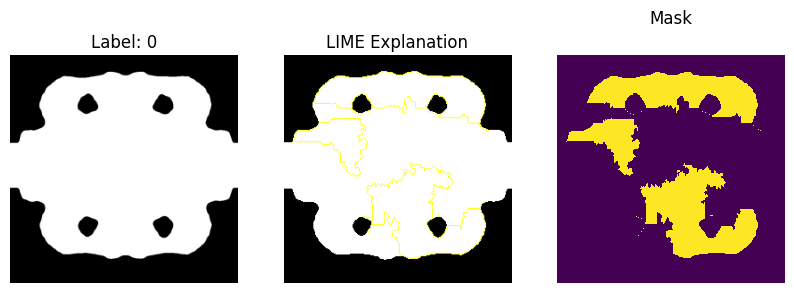

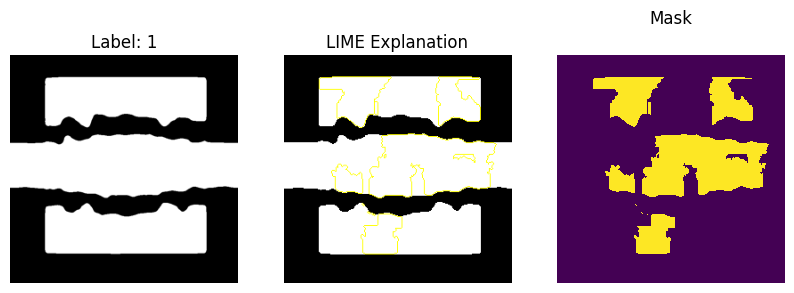

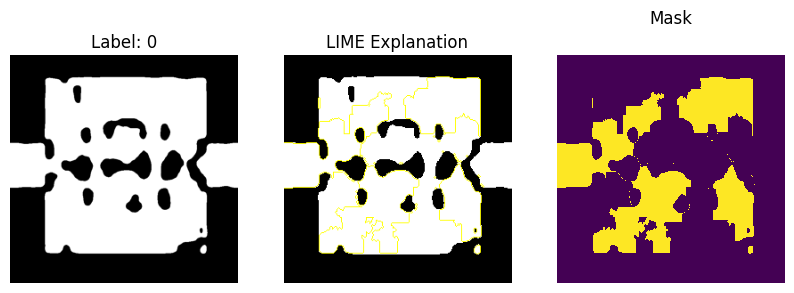

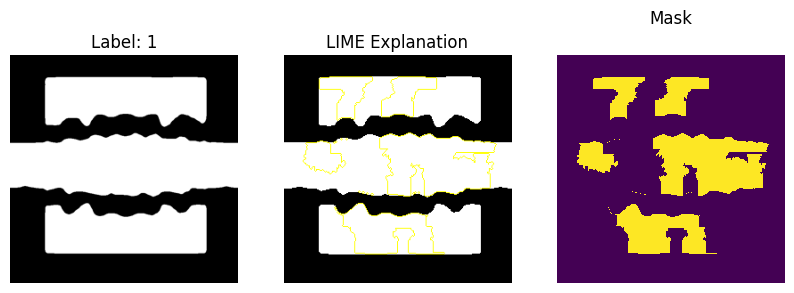

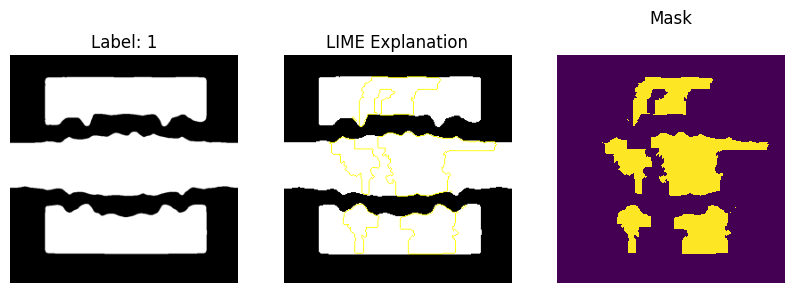

...

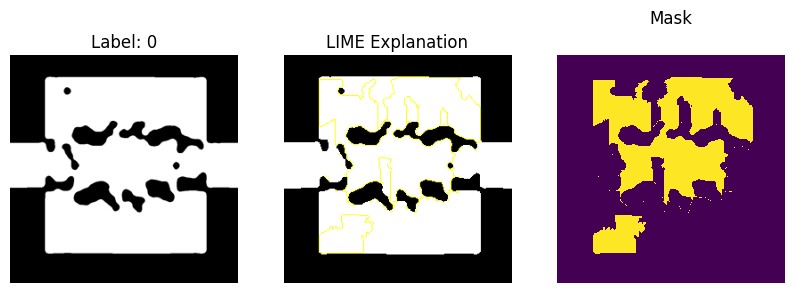

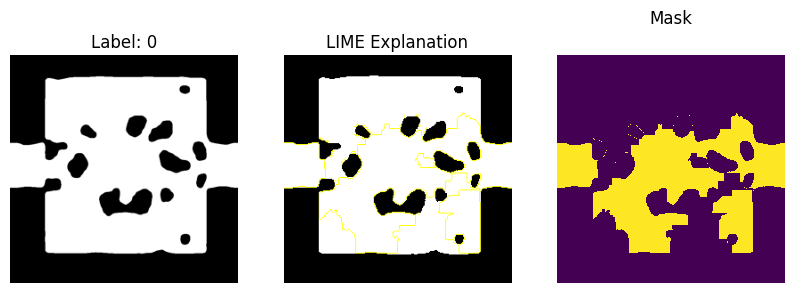

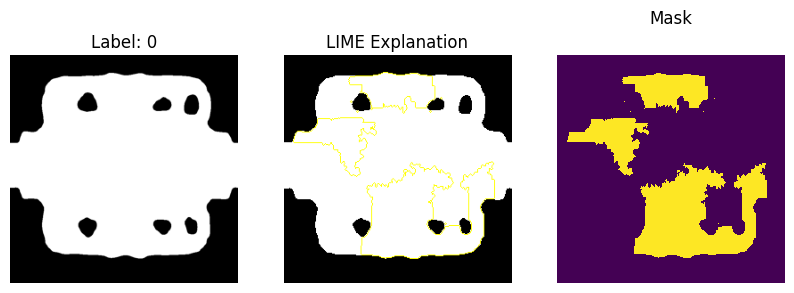

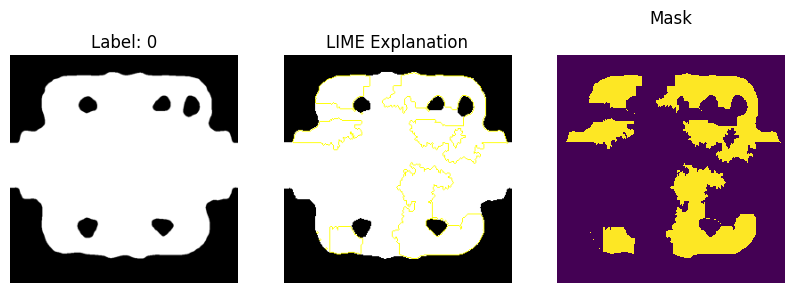

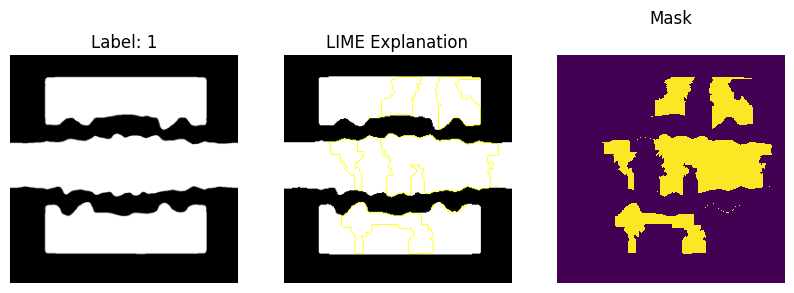

In [70]:
from lime import lime_image
import sys
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt
import cv2
import numpy as np

# SuppressOutput class definition
class SuppressOutput:
    def __enter__(self):
        self._original_stdout = sys.stdout
        self._original_stderr = sys.stderr
        sys.stdout = open(os.devnull, 'w')
        sys.stderr = open(os.devnull, 'w')

    def __exit__(self, exc_type, exc_value, traceback):
        sys.stdout.close()
        sys.stderr.close()
        sys.stdout = self._original_stdout
        sys.stderr = self._original_stderr

# Combine all images and labels
all_images = np.concatenate((x_train, x_test), axis=0)
all_labels = np.concatenate((y_train, y_test), axis=0)

# Define the prediction function compatible with LIME
def predict_fn(images):
    images = images[:, :, :, 0]  # Extract the first channel (grayscale)
    images = np.expand_dims(images, axis=-1)  # Add back the single channel
    return model.predict(images)  # Model prediction

# Initialize LIME explainer
explainer = lime_image.LimeImageExplainer()

# Loop through all images and display LIME explanations
i = 0
for image in all_images:
    # Convert grayscale image to RGB for LIME compatibility
    sample_image = cv2.cvtColor((image.squeeze() * 255).astype('uint8'), cv2.COLOR_GRAY2RGB)

    # Run LIME explanation
    with SuppressOutput():  # Suppress LIME's verbose output
        explanation = explainer.explain_instance(
            sample_image.astype('double'),
            predict_fn,
            top_labels=1,
            hide_color=0,
            num_samples=700  # Number of perturbations
        )

        # Get the image and mask for the top label
        temp, mask = explanation.get_image_and_mask(
            explanation.top_labels[0],
            positive_only=True,
            num_features=10,
            hide_rest=False
        )

    # Display the original image and the LIME explanation
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10, 5))

    # Original image
    ax1.imshow(sample_image[:, :, 0].reshape(sample_image.shape[0], sample_image.shape[1]), cmap='gray')
    ax1.set_title(f"Label: {np.argmax(all_labels[i])}")
    ax1.axis('off')

    # LIME explanation with boundaries
    ax2.imshow(mark_boundaries(temp, mask, color=(1, 1, 0)))  # Yellow boundaries
    ax2.set_title('LIME Explanation')
    ax2.axis('off')

    # Display mask (optional)
    ax3.matshow(mask)
    ax3.set_title('Mask')
    ax3.axis('off')

    i += 1

plt.show()


### New code for LIME Explantion - after some tweaks to the above code

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


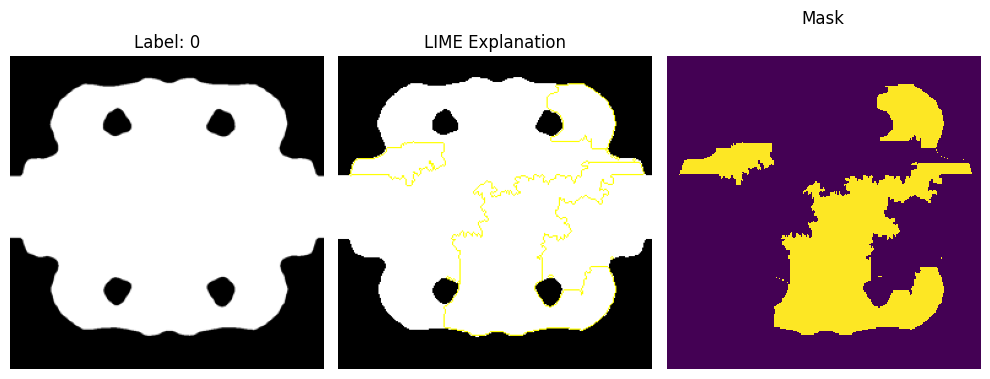

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


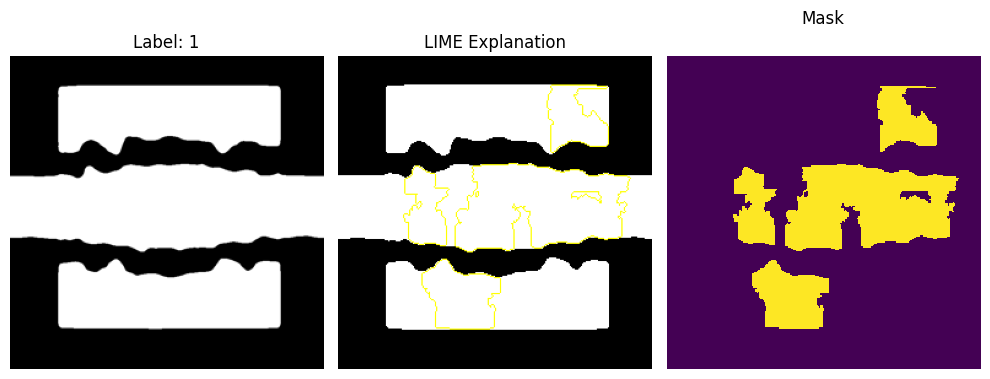

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


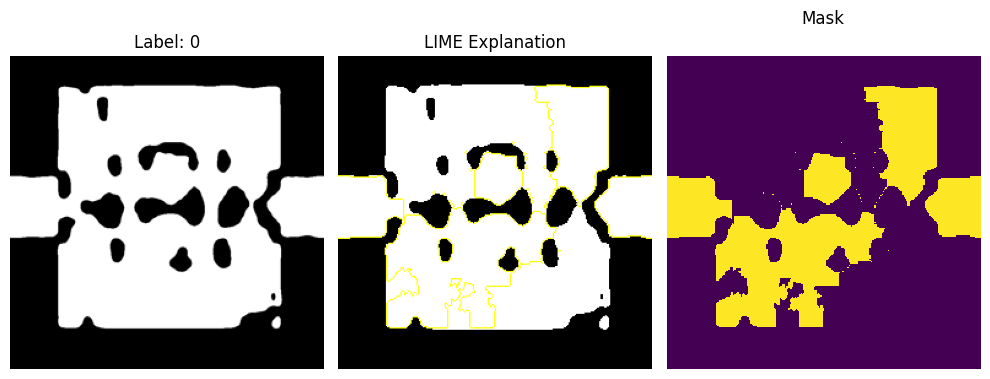

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


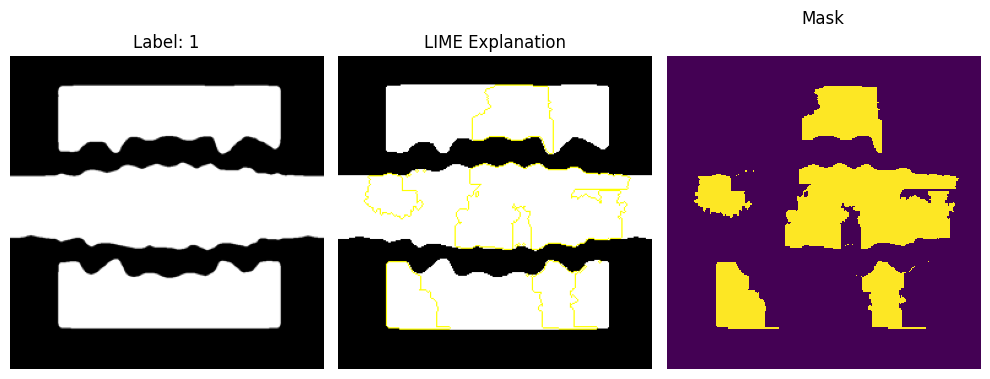

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


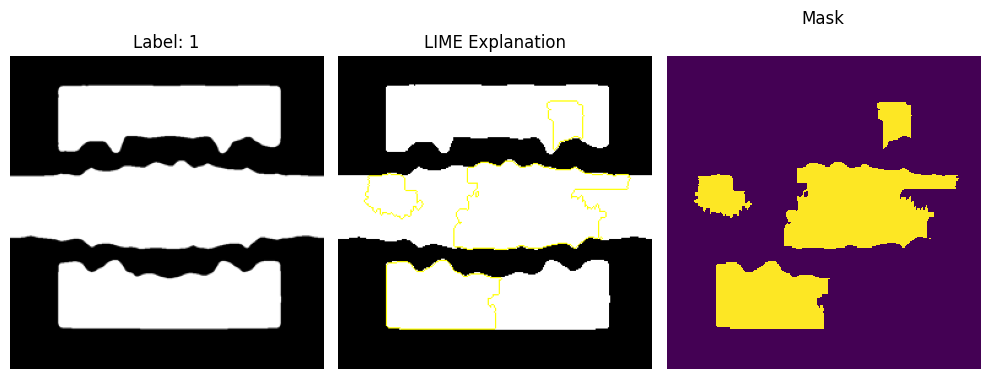

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


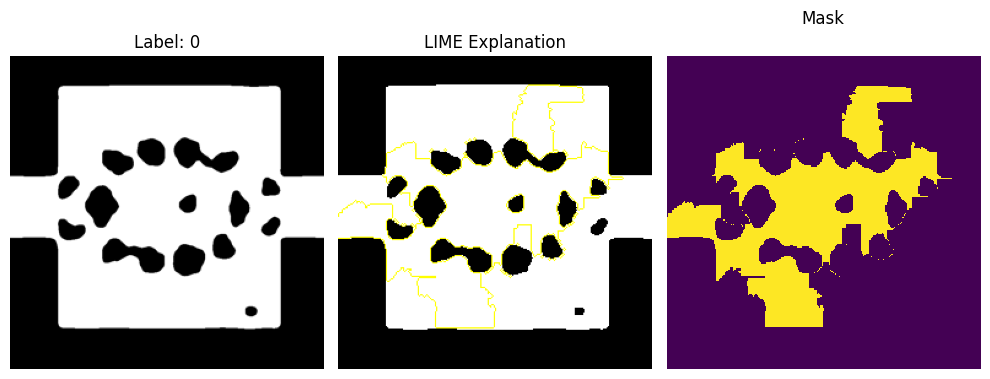

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


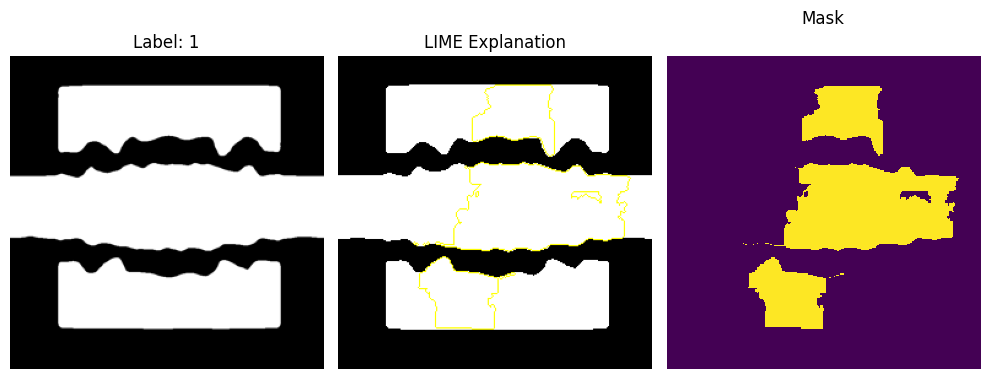

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


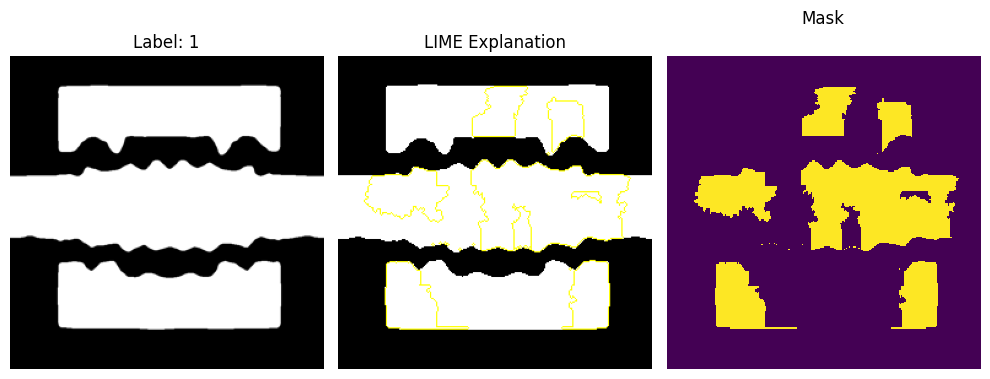

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


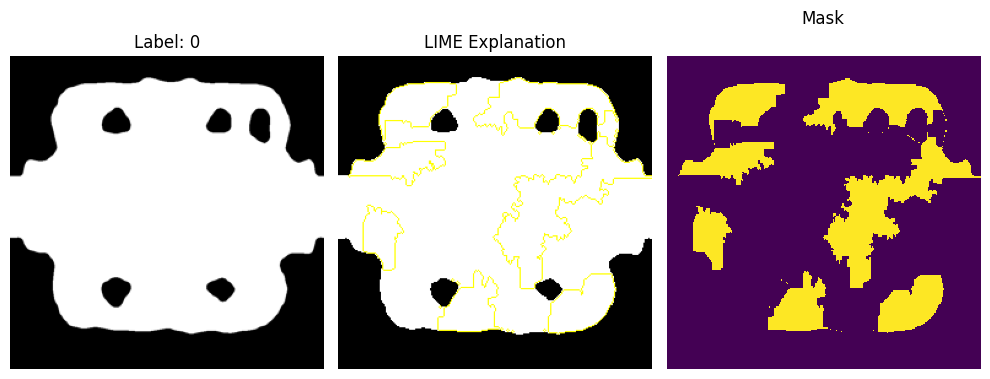

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


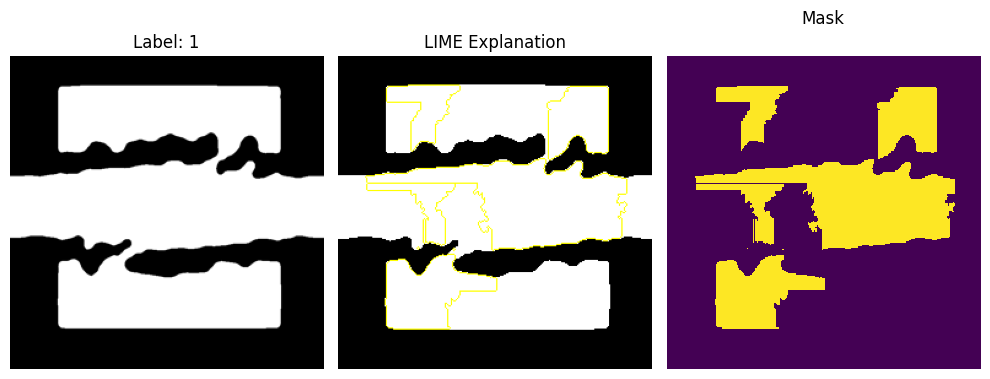

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


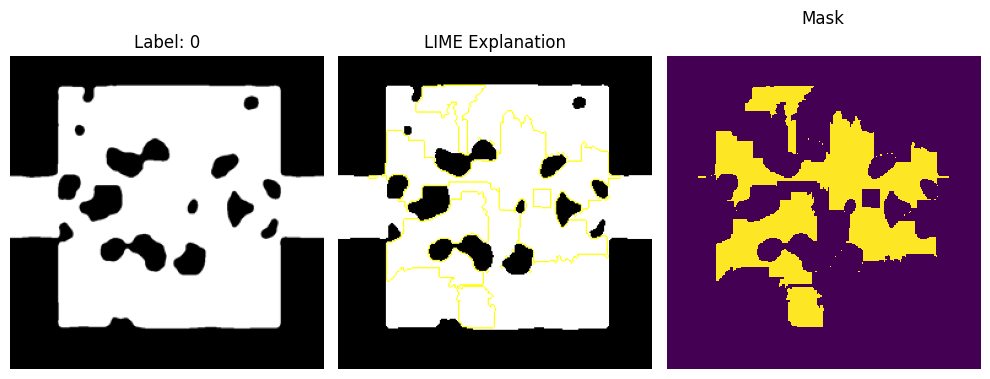

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


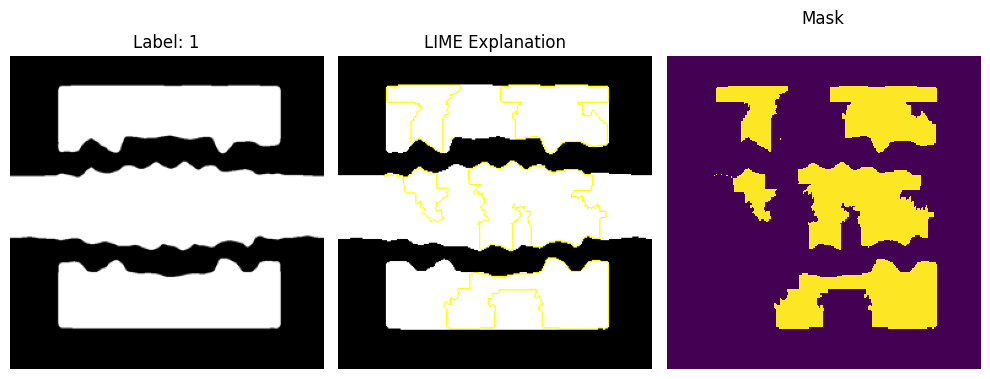

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


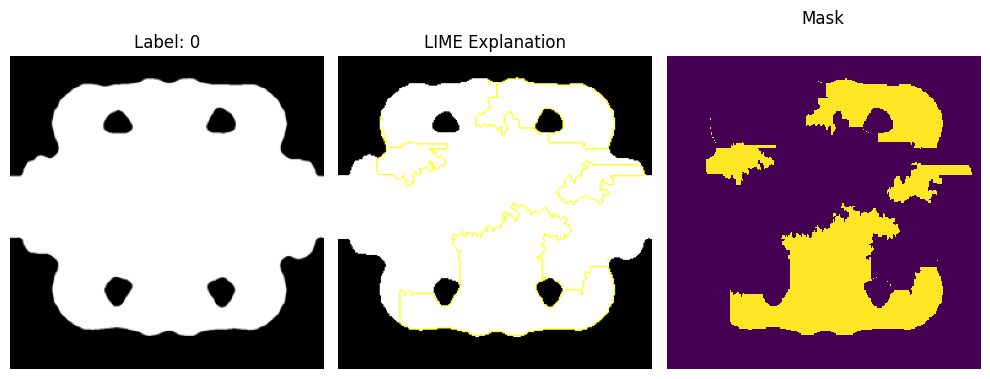

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


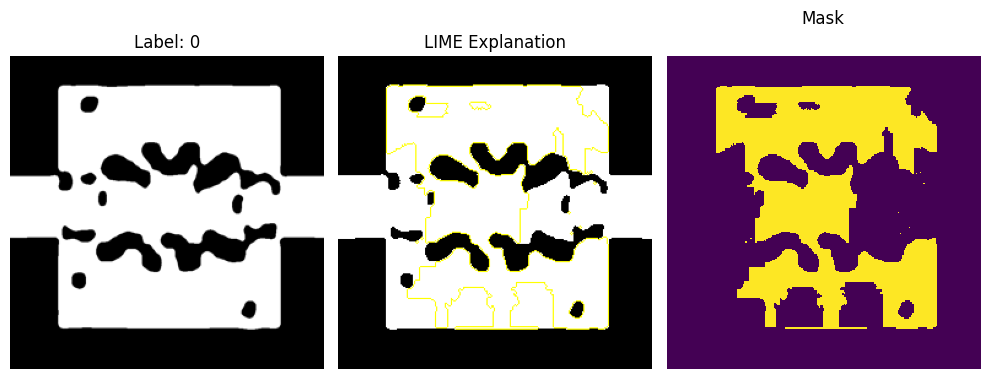

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


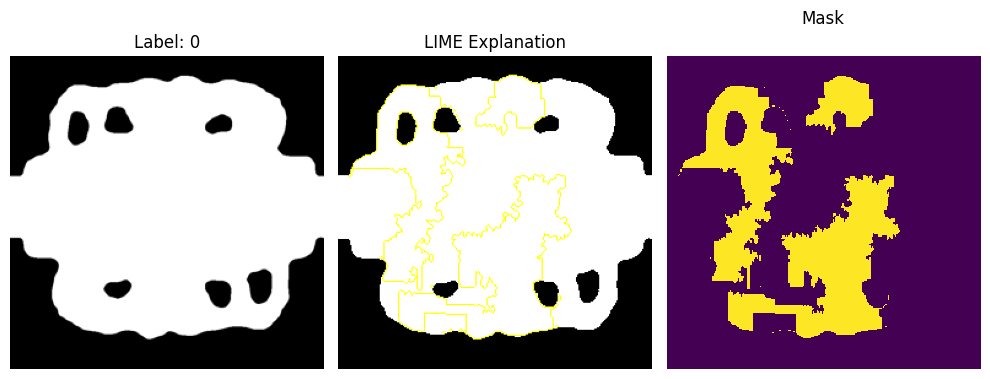

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


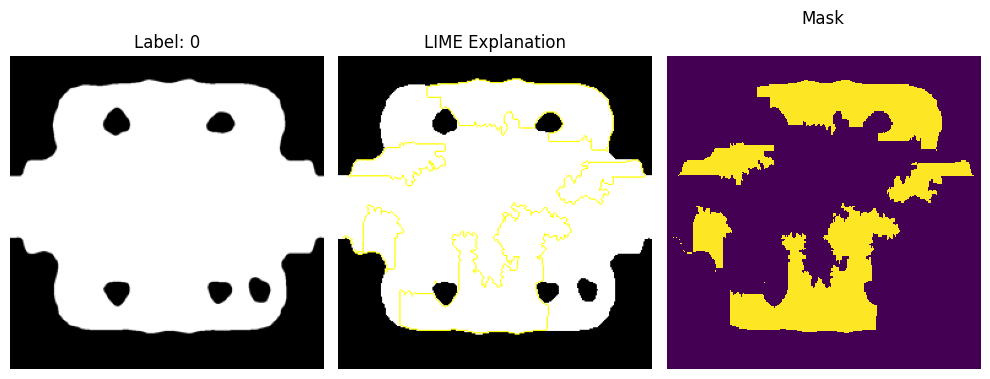

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


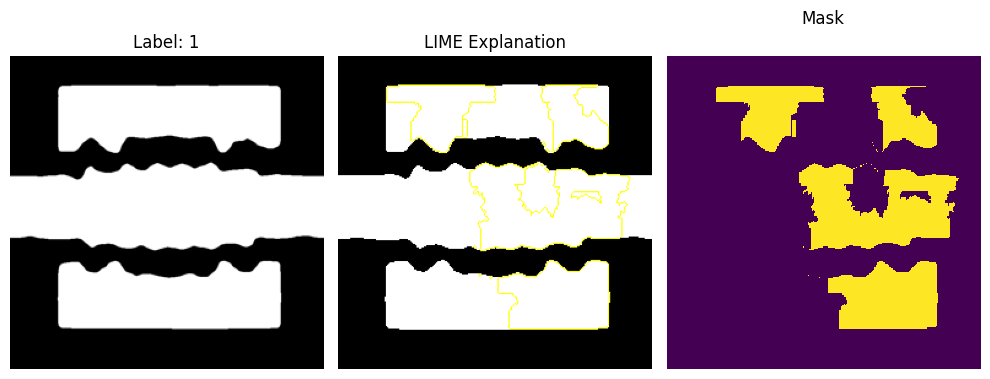

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


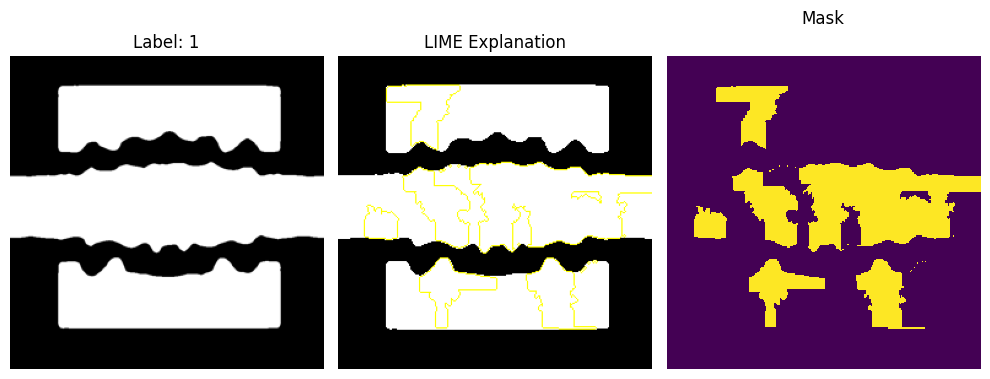

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


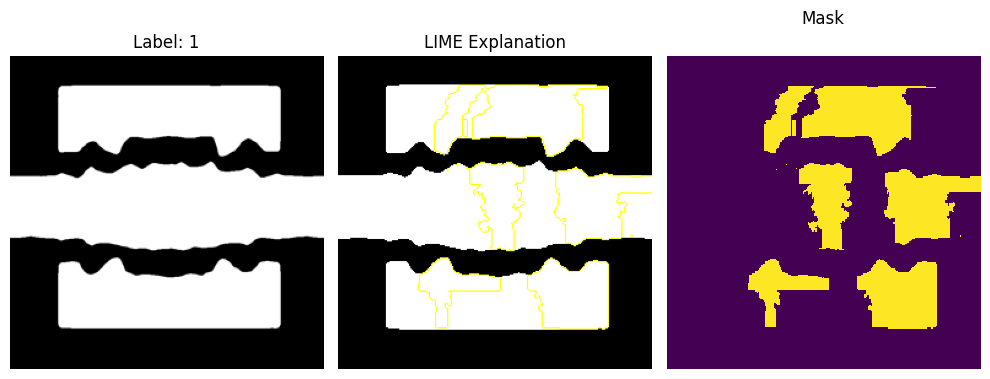

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


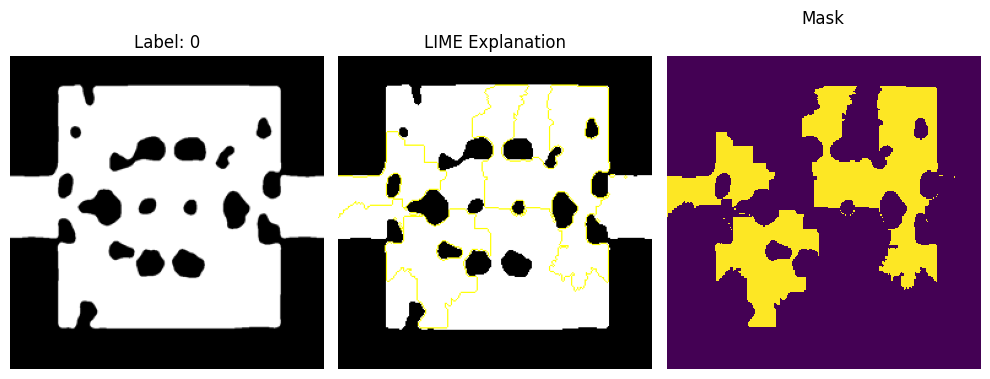

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


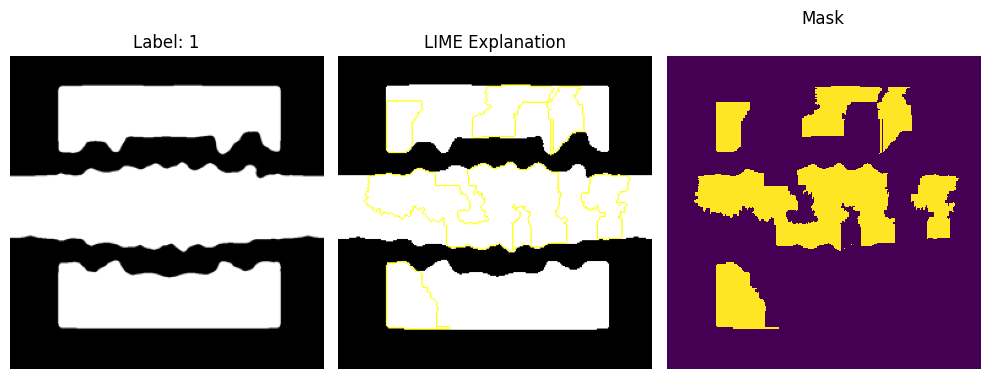

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


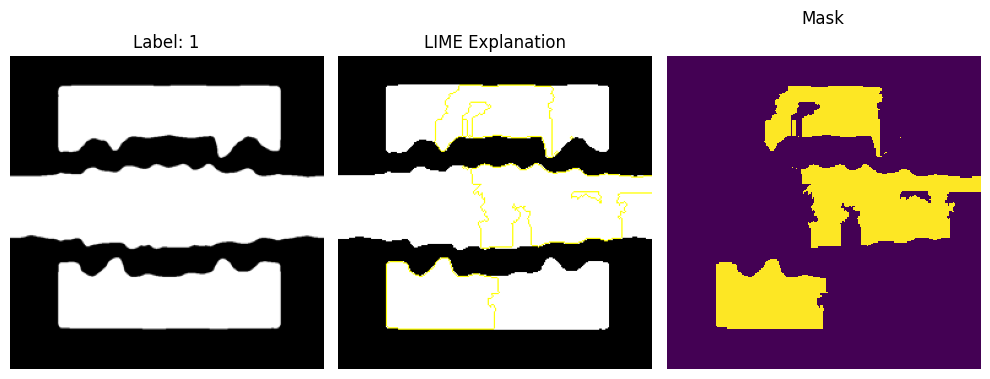

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


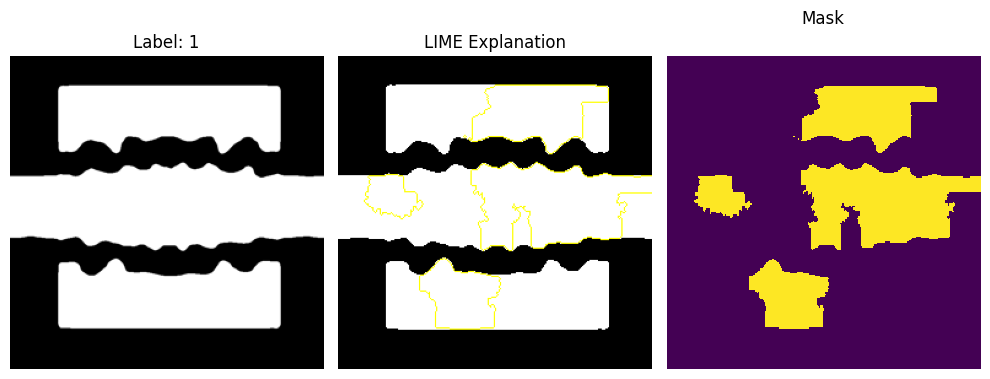

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


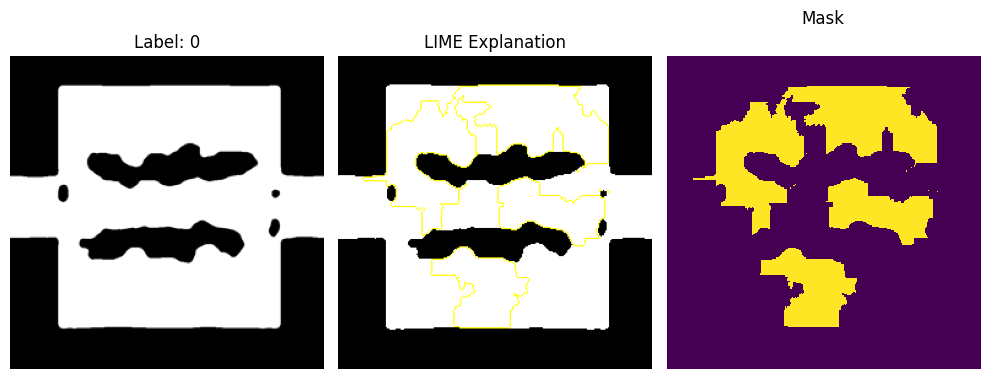

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


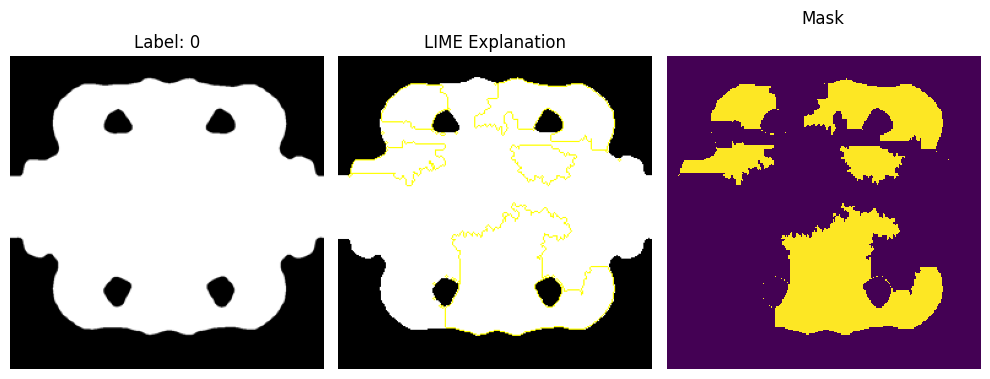

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


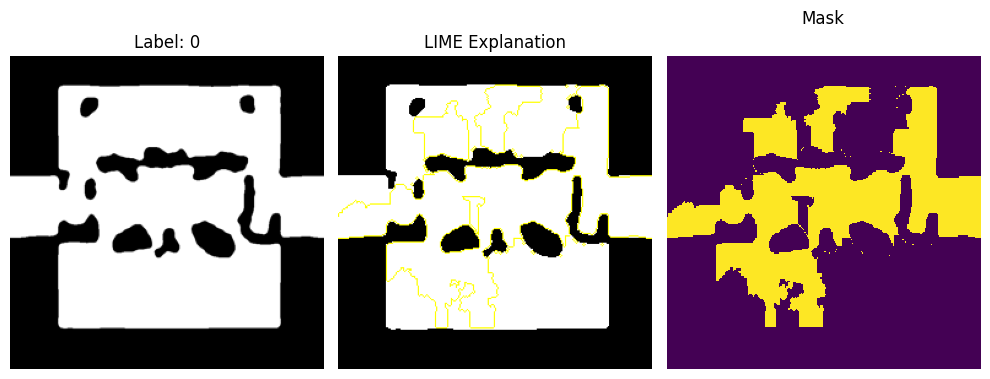

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


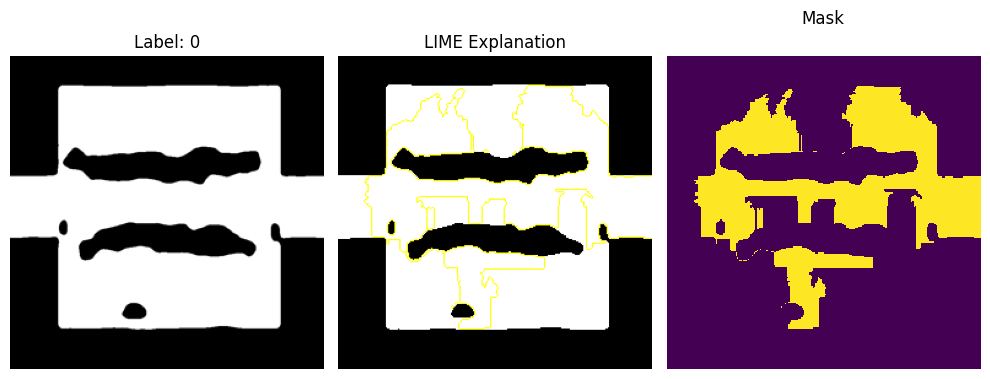

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


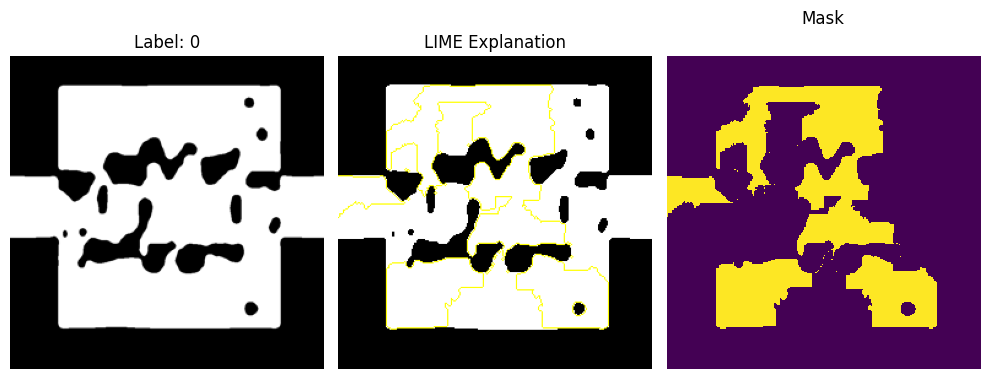

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


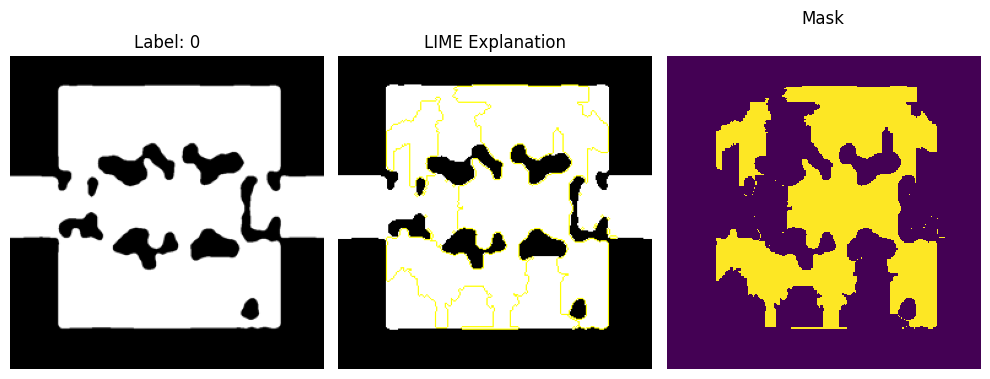

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


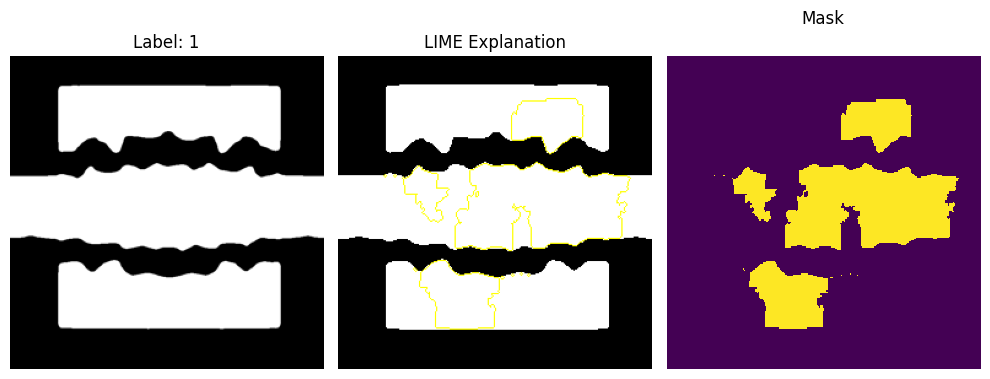

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


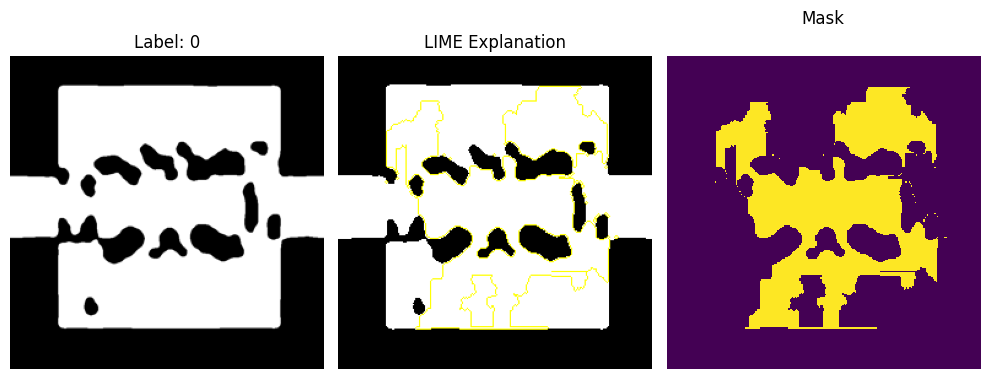

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


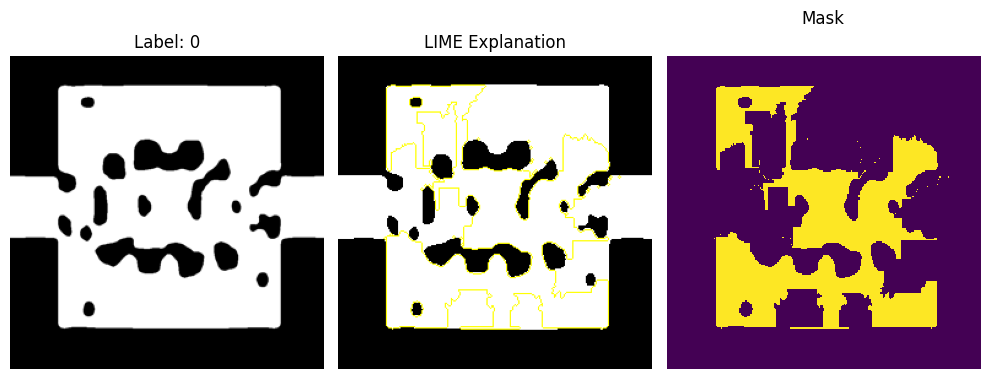

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


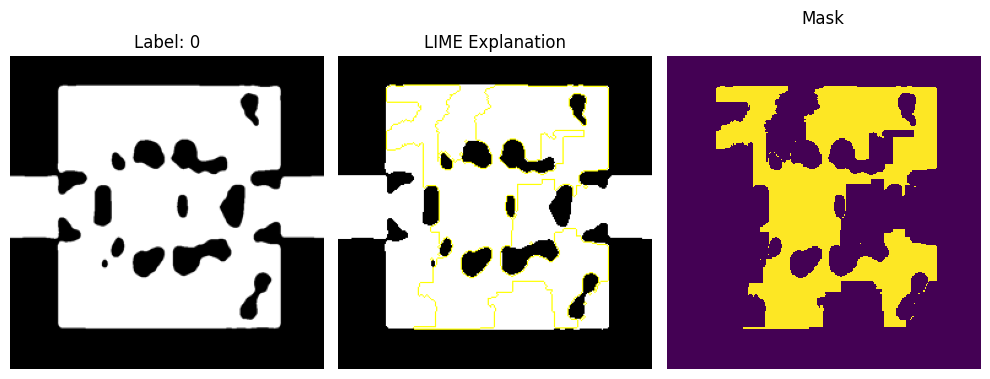

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


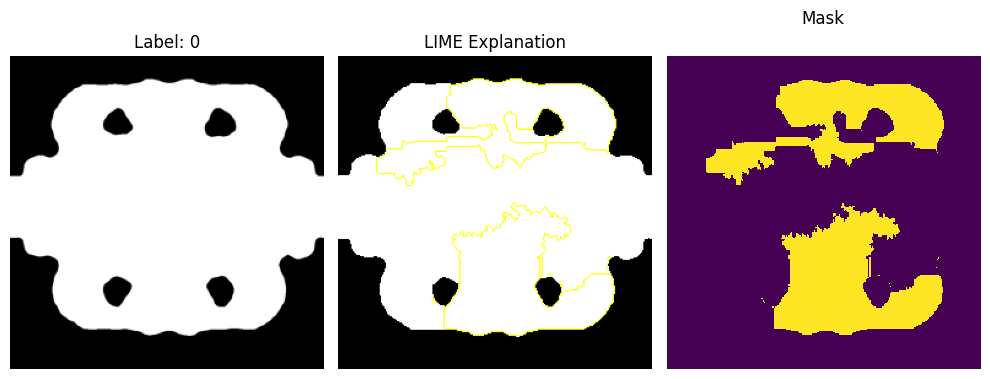

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


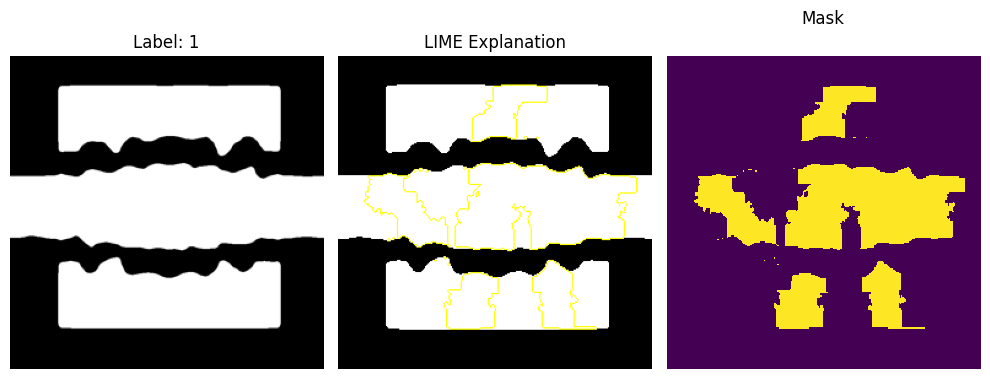

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


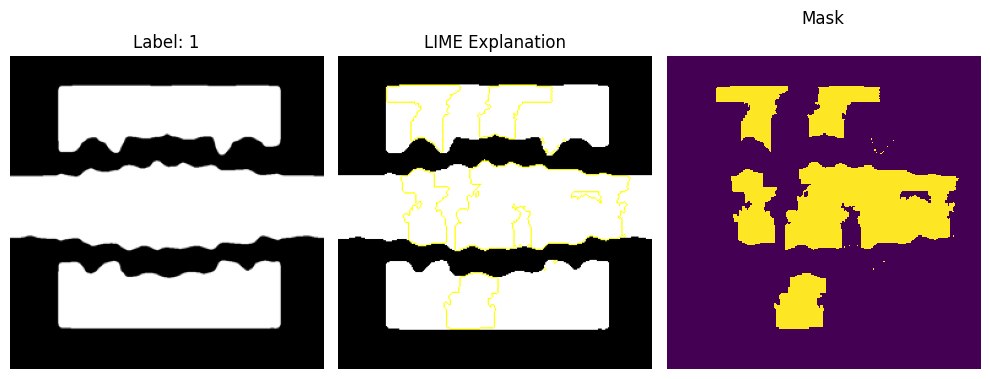

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


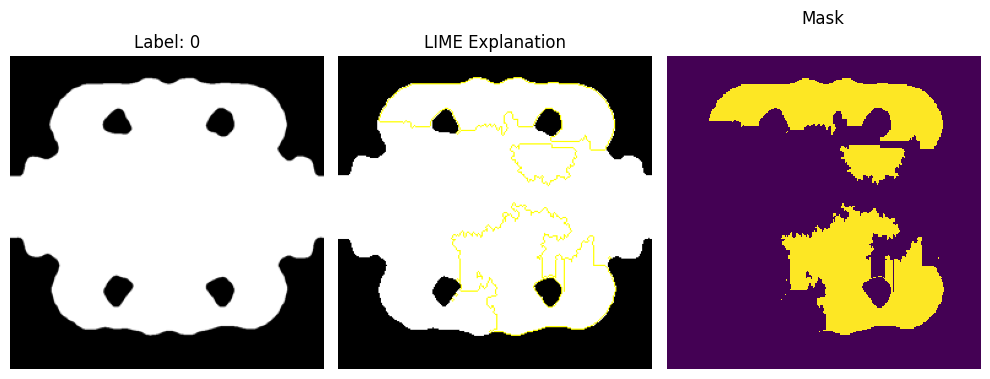

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


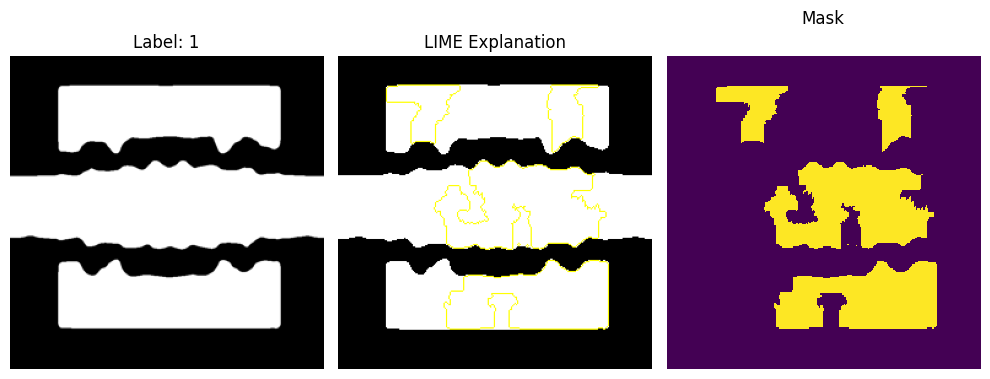

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


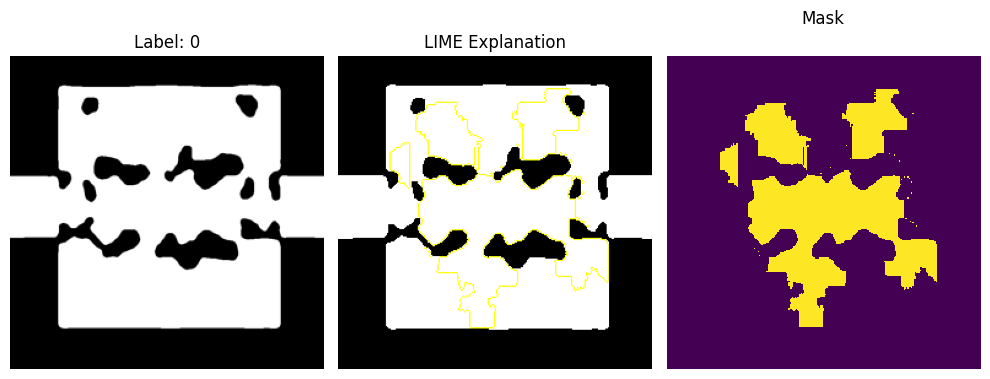

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


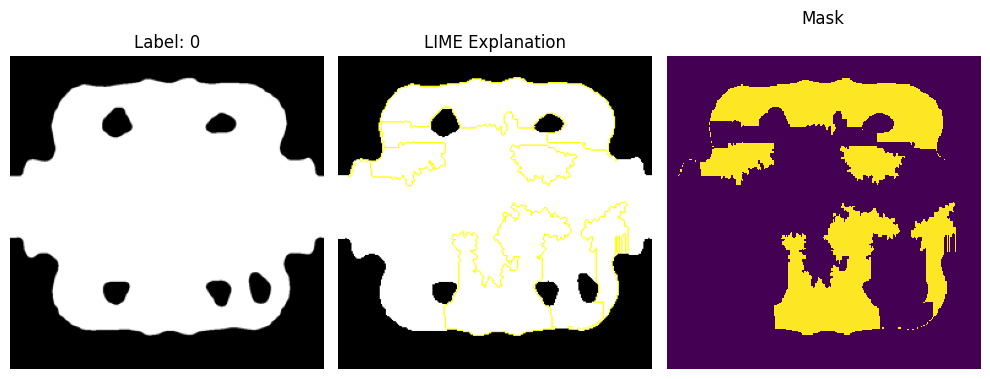

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


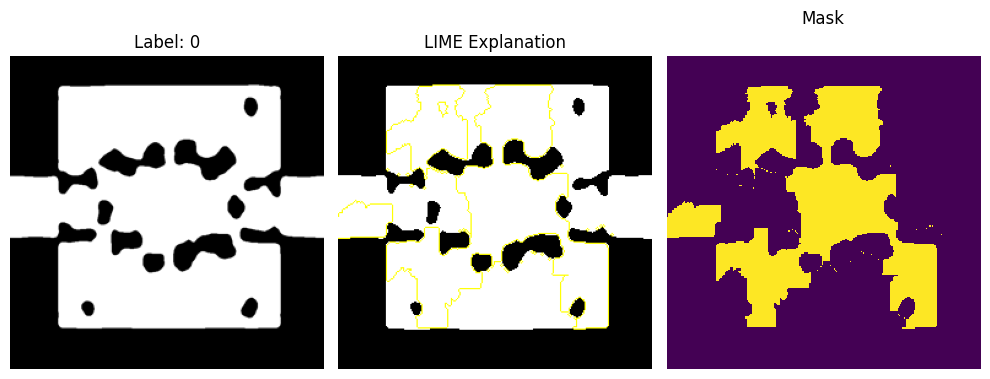

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


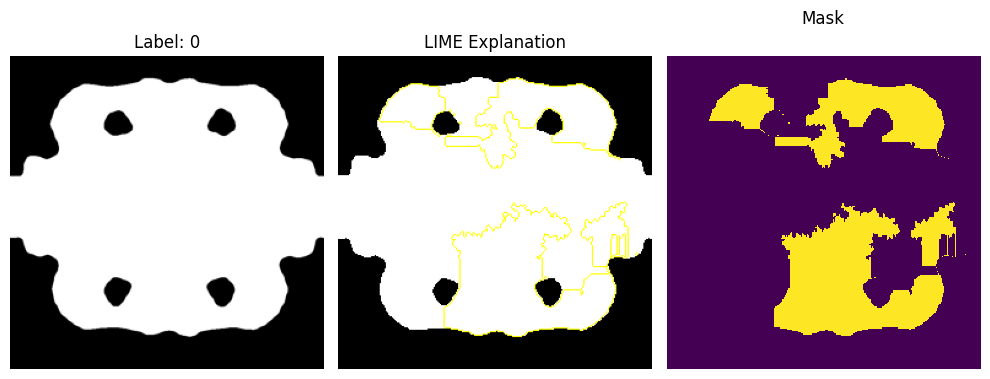

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


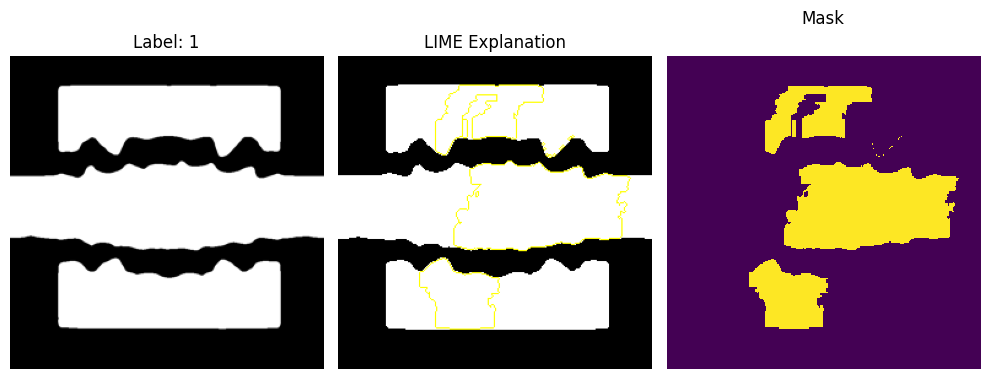

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


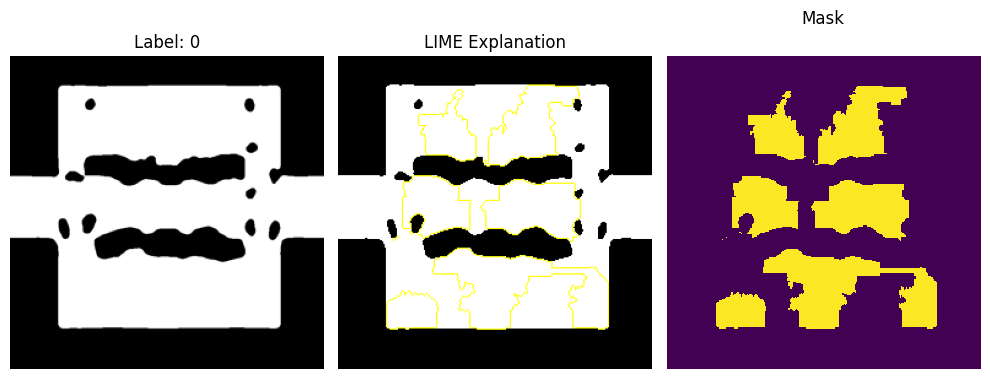

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


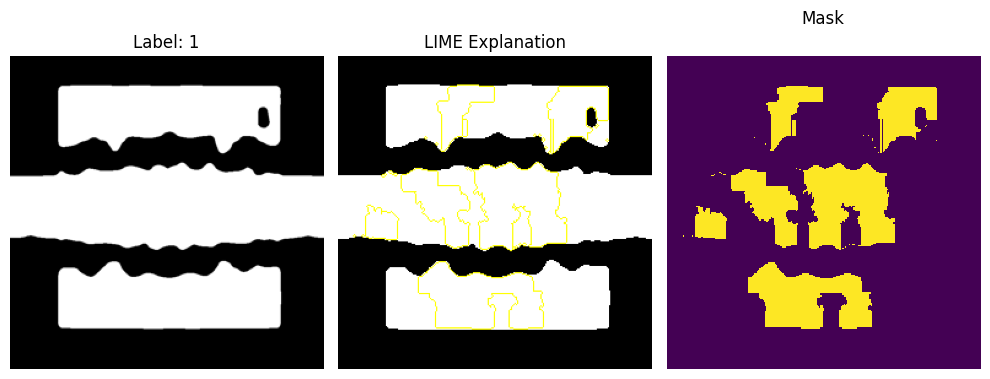

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


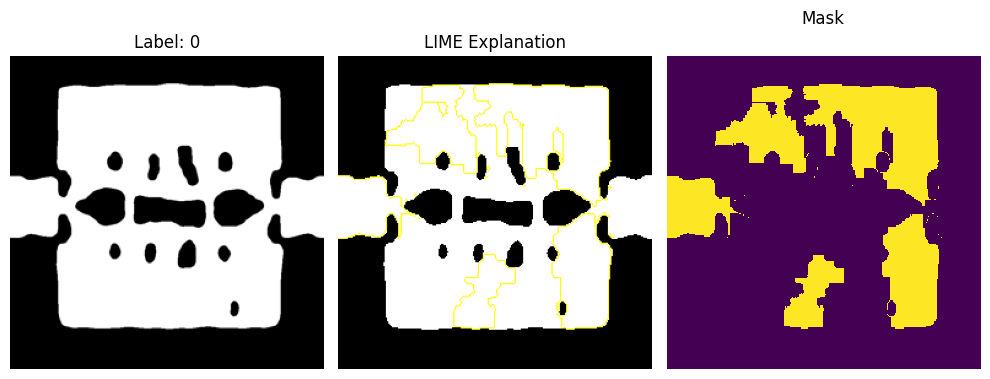

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


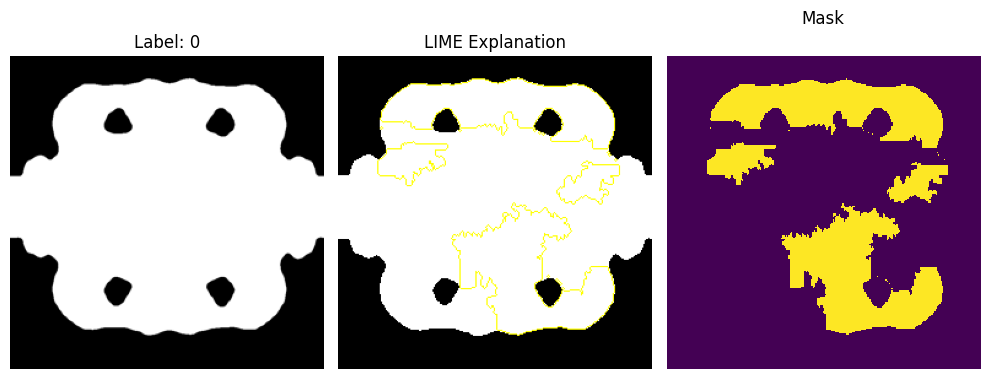

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


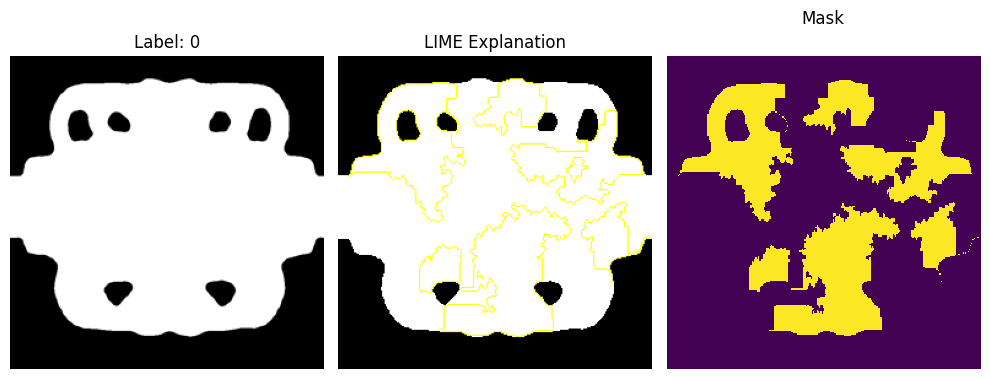

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


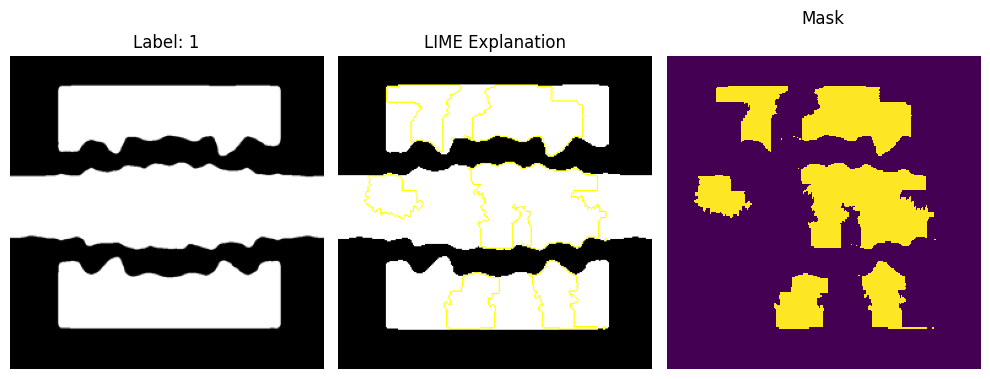

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


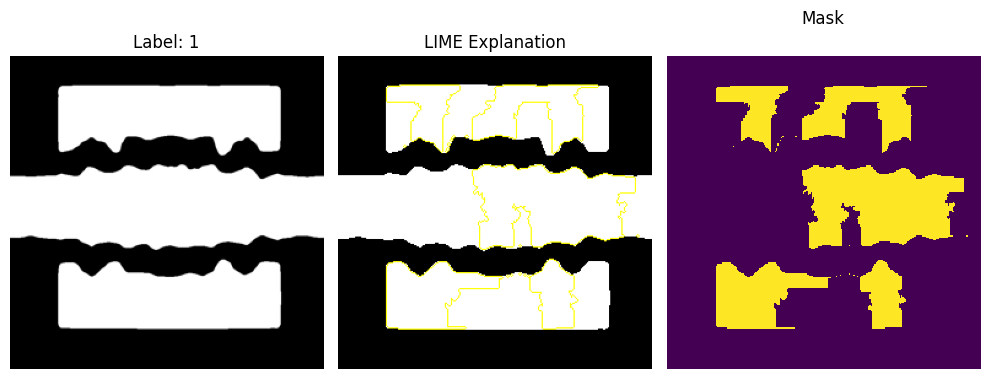

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


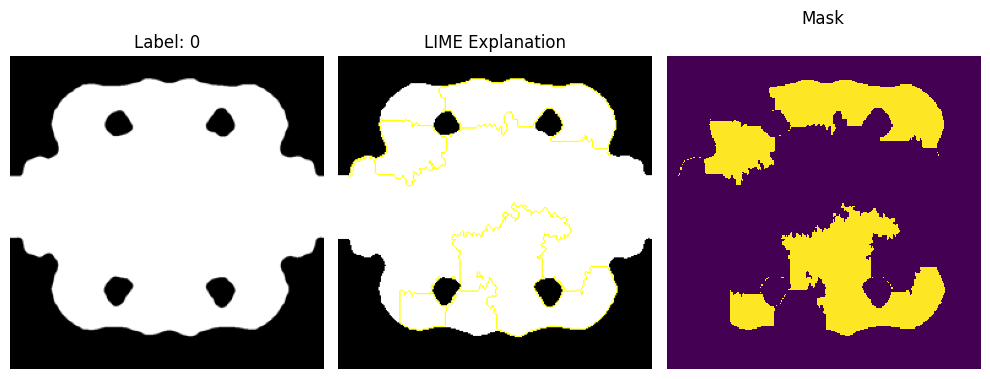

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


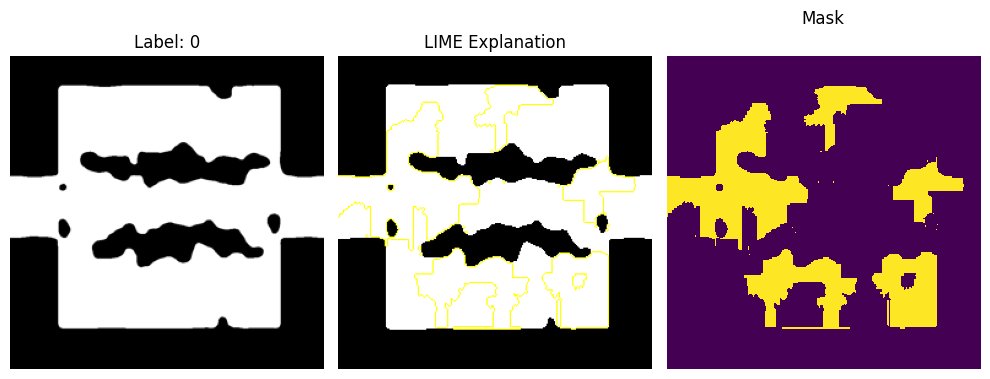

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


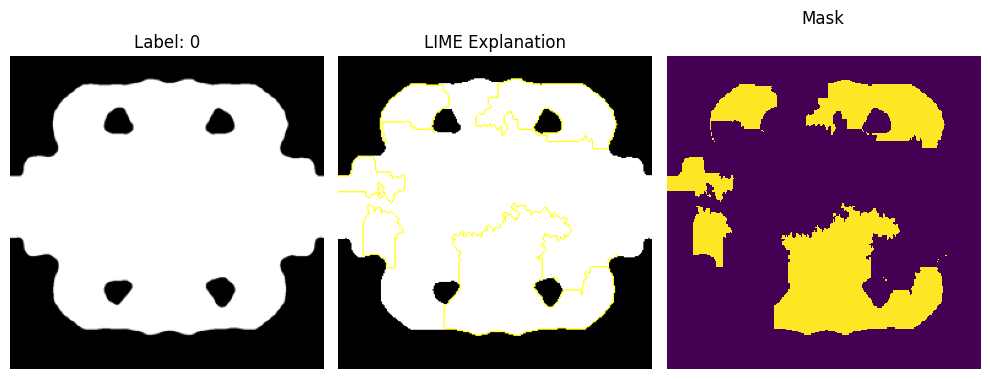

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


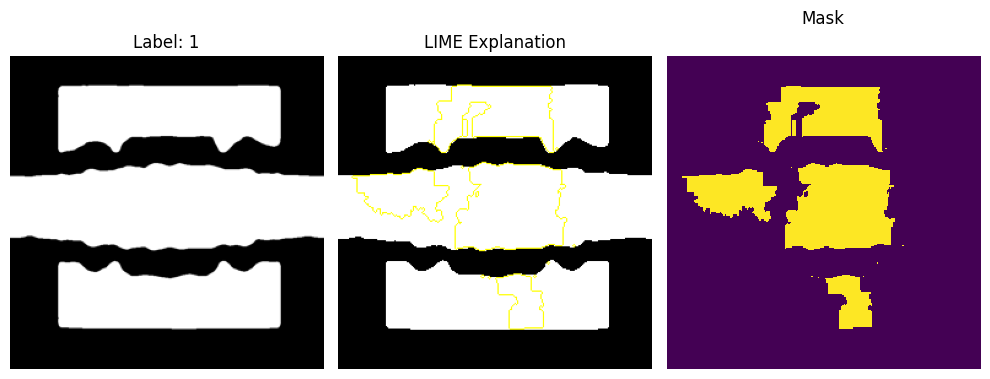

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


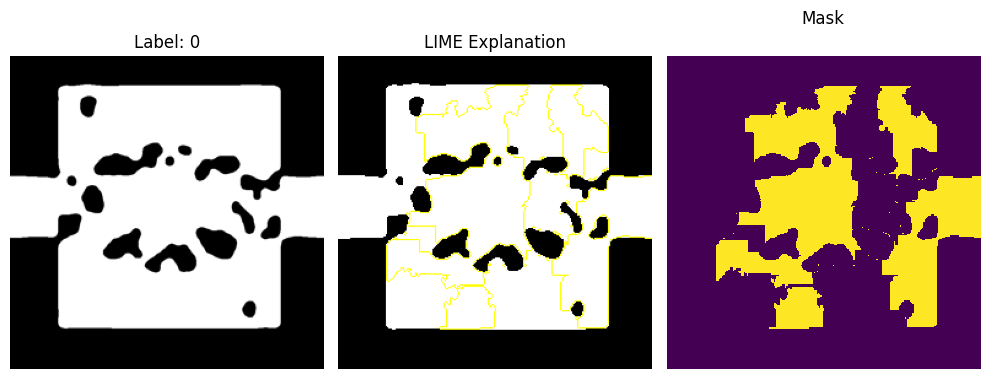

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


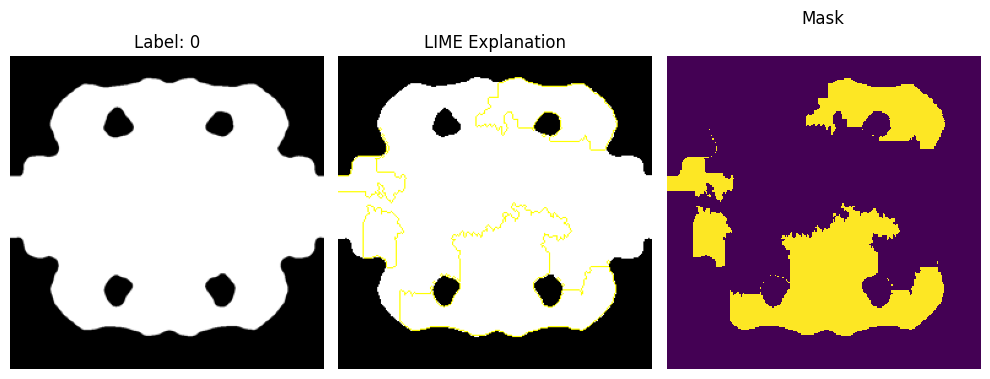

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


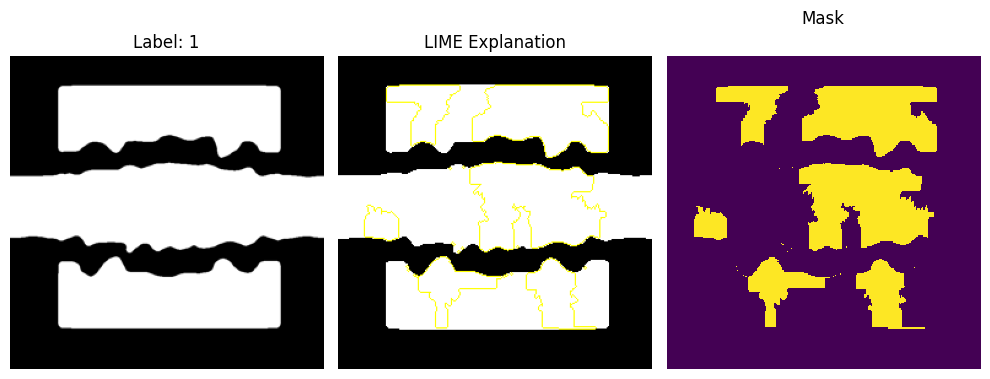

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


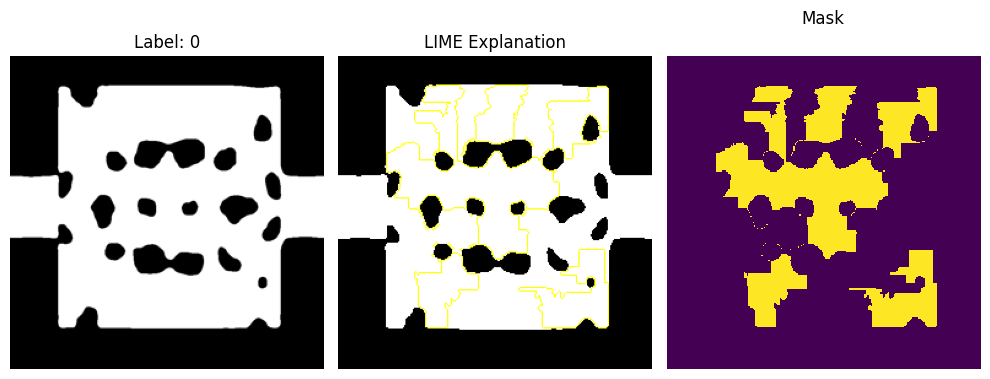

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


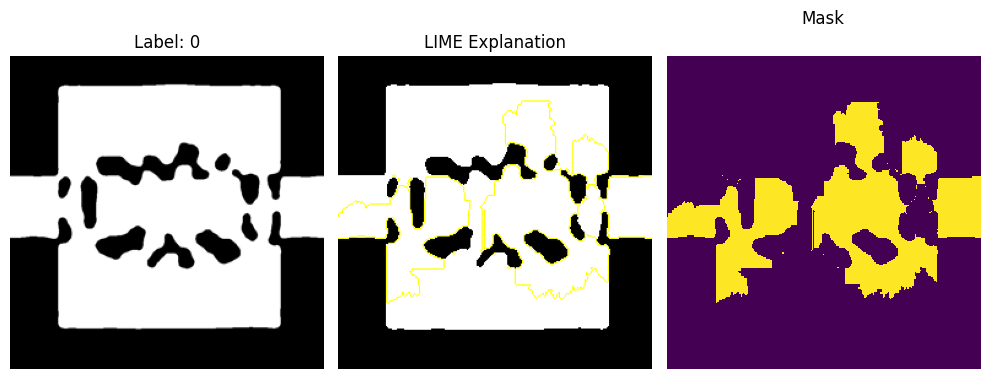

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


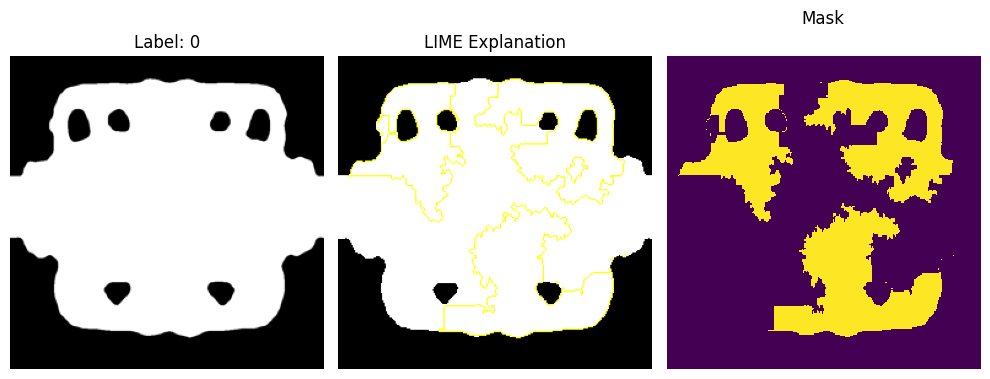

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


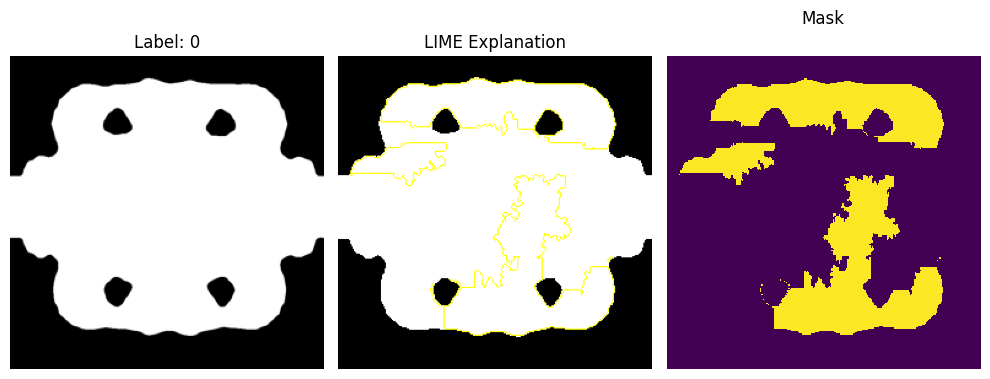

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


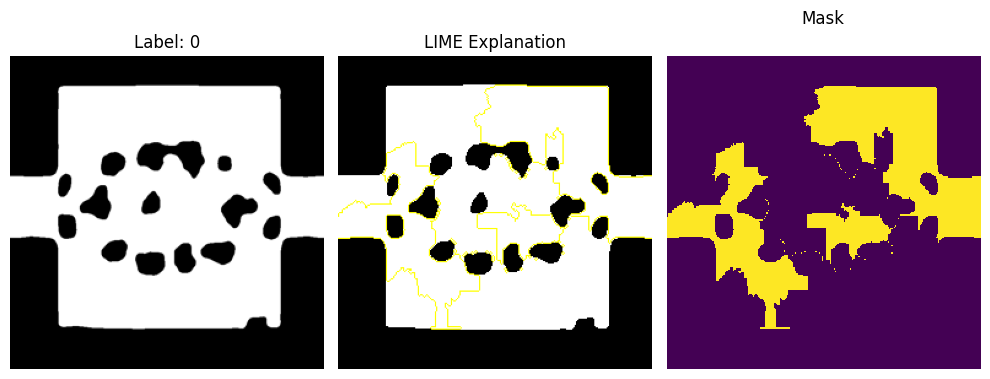

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


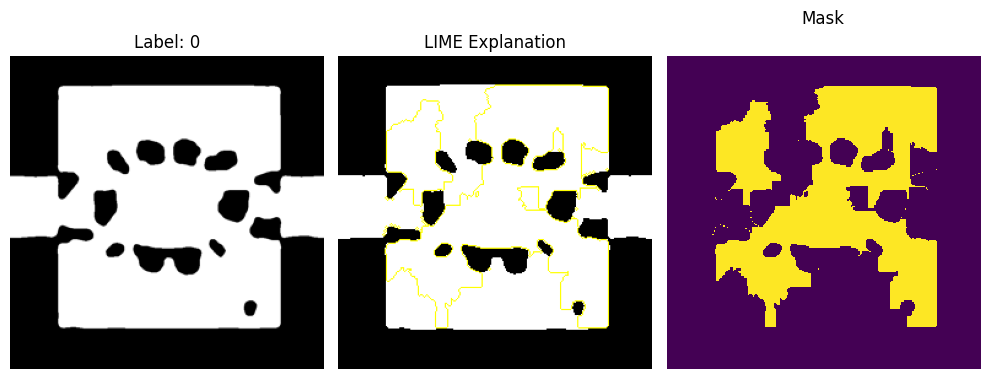

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


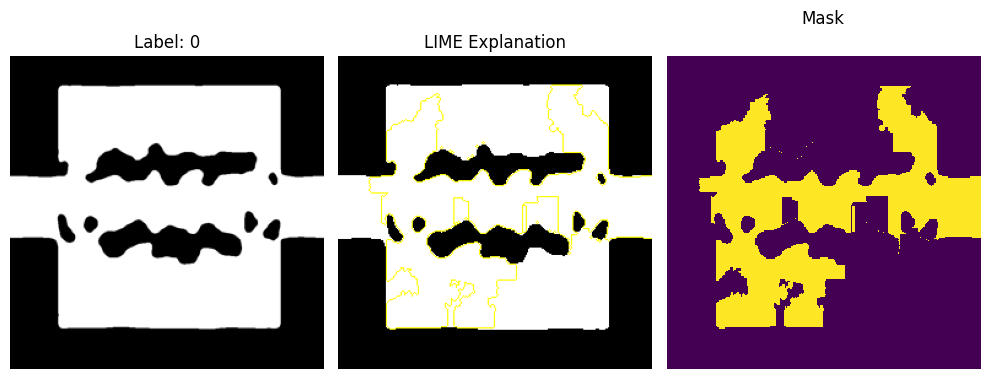

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


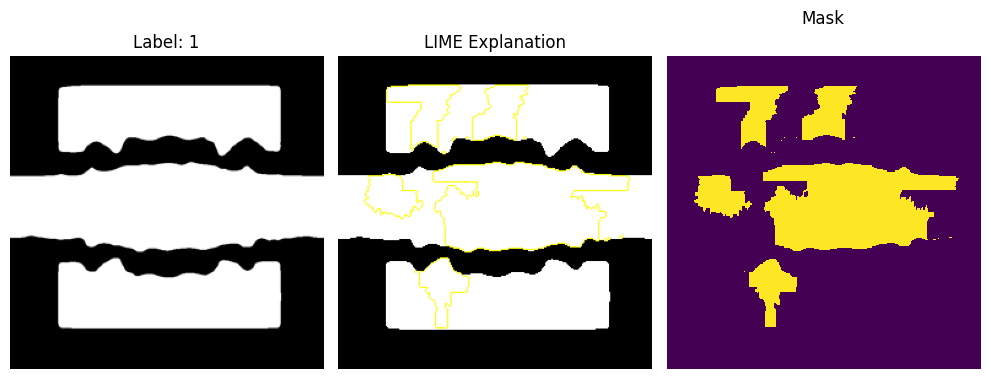

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


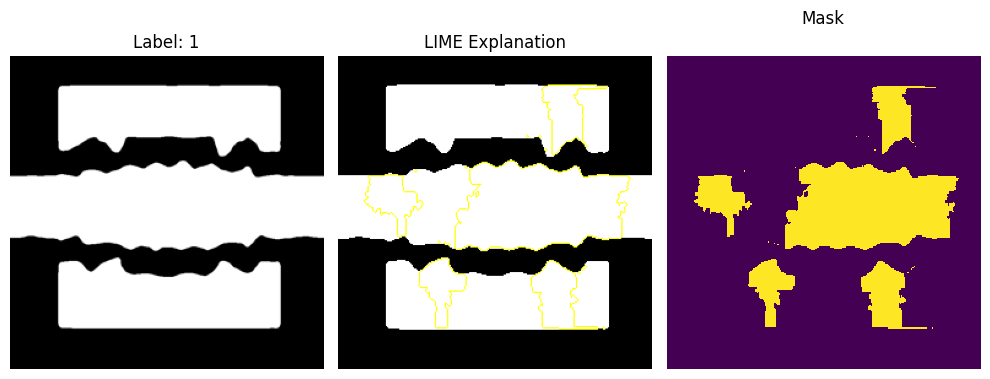

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


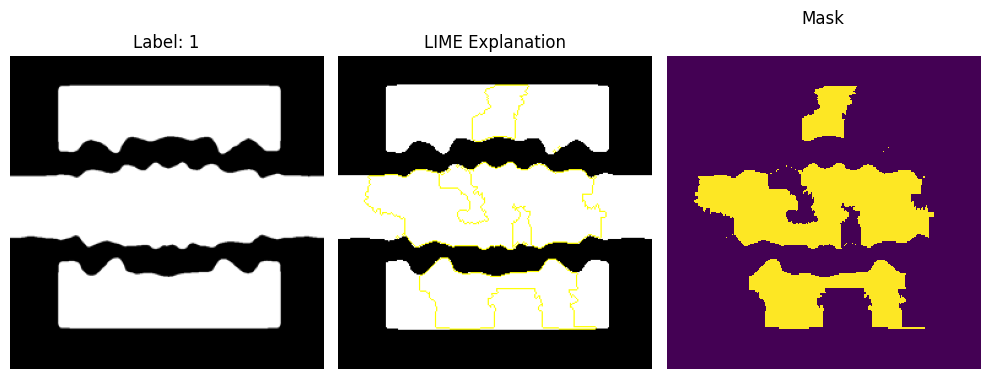

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


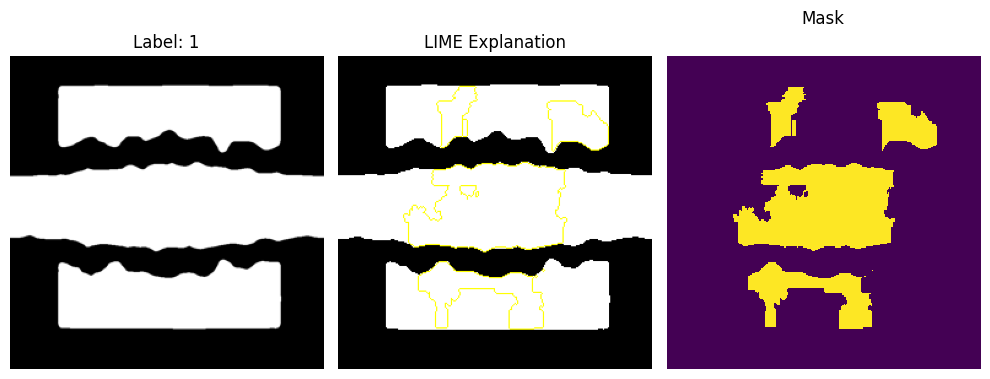

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


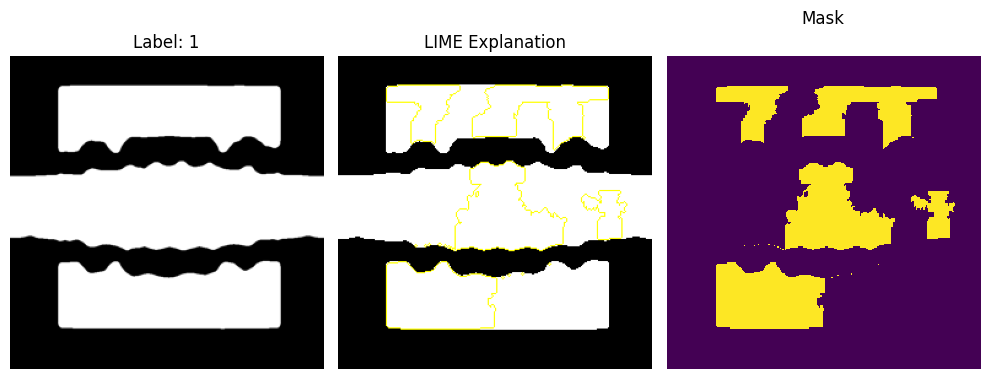

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


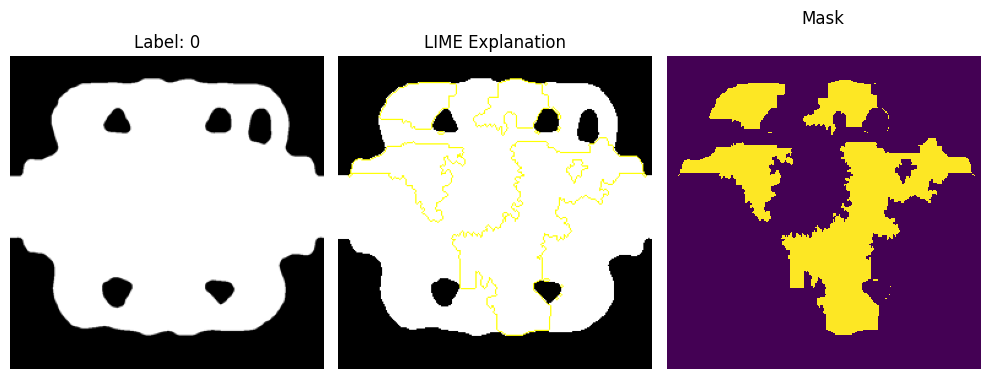

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


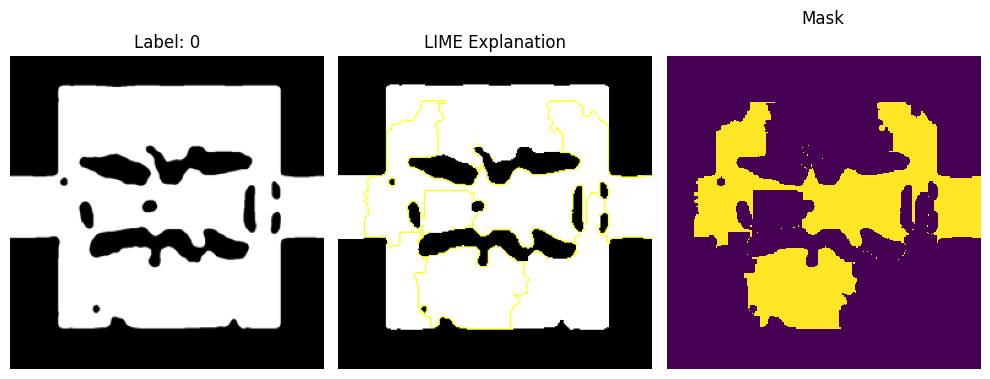

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


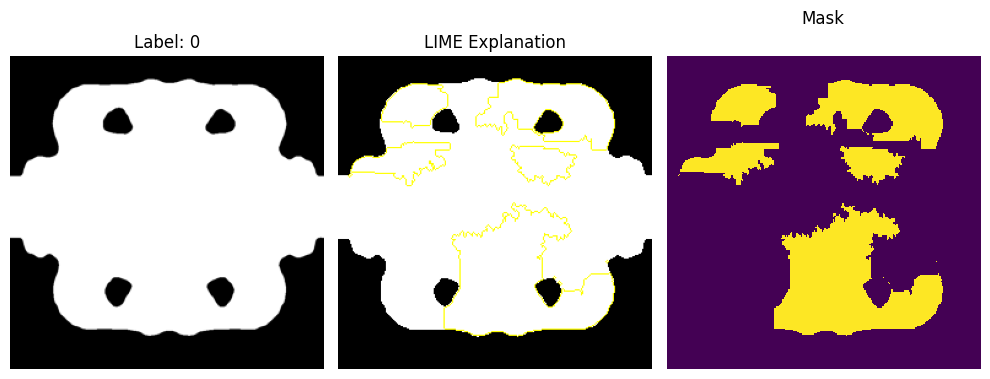

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


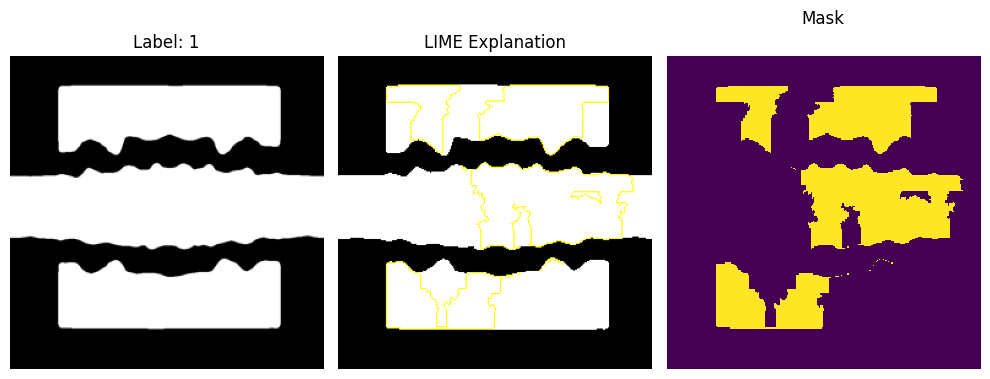

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


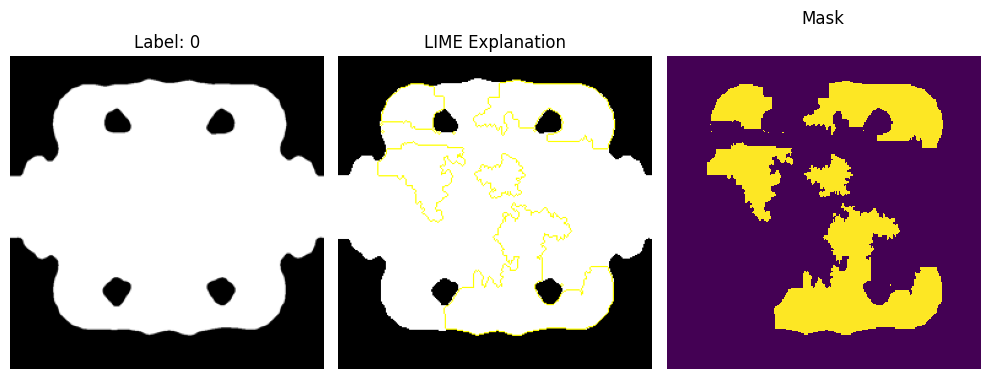

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


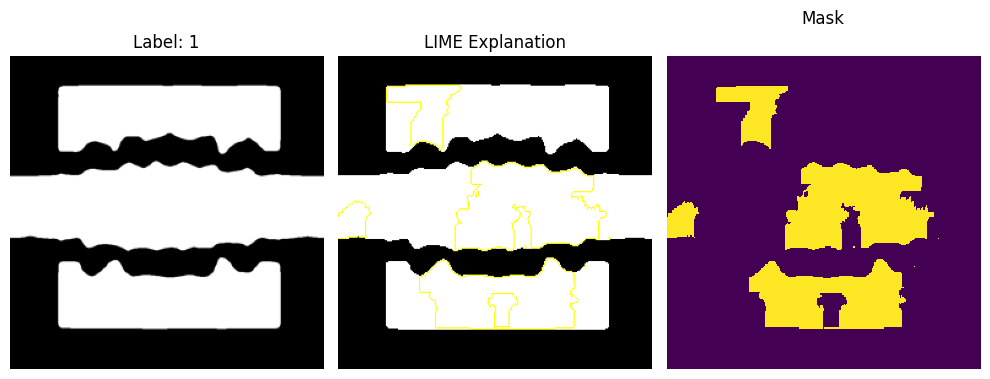

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


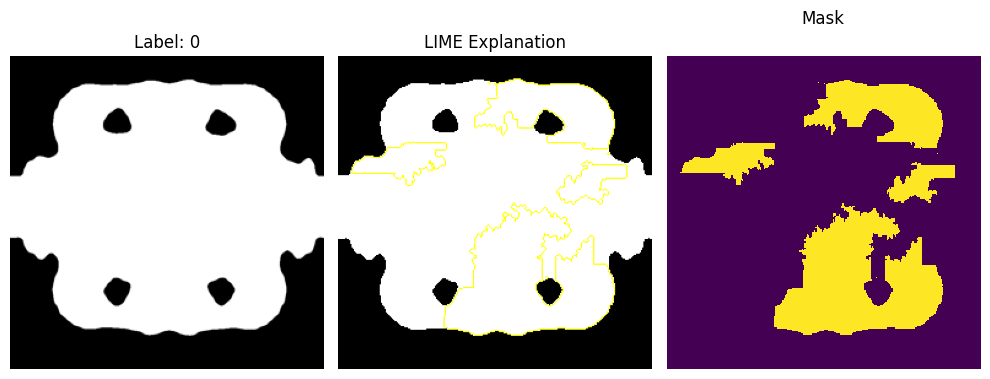

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


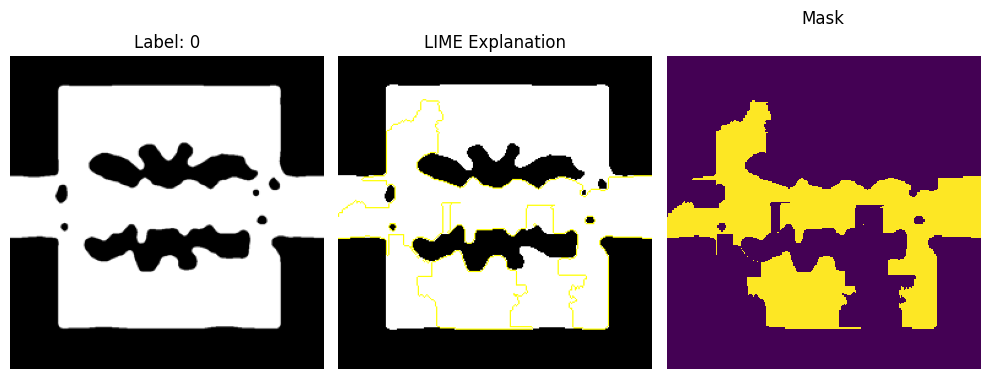

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


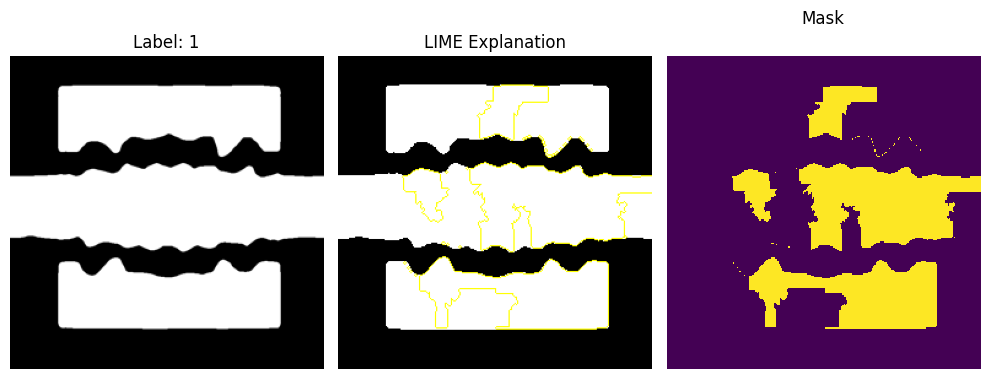

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


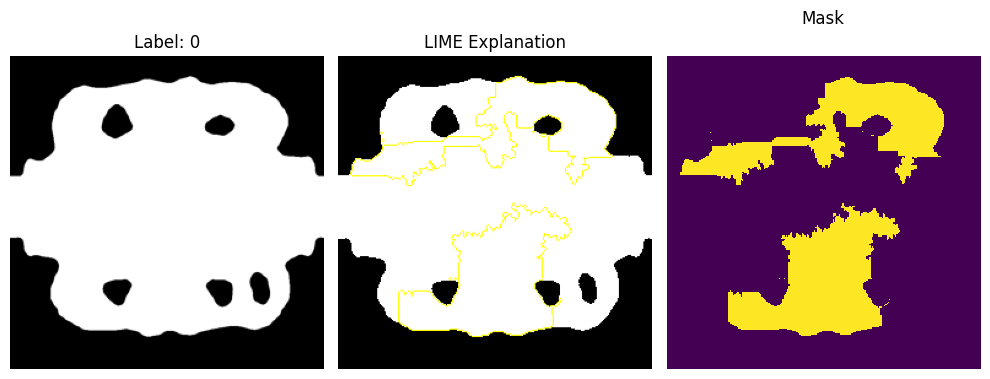

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


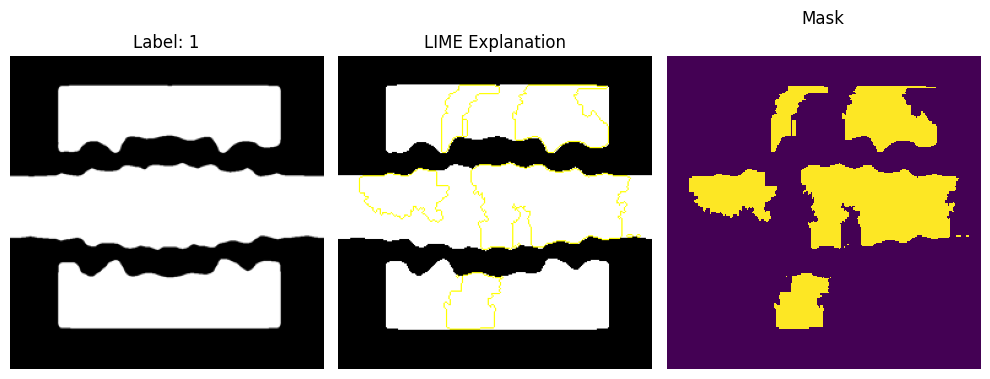

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


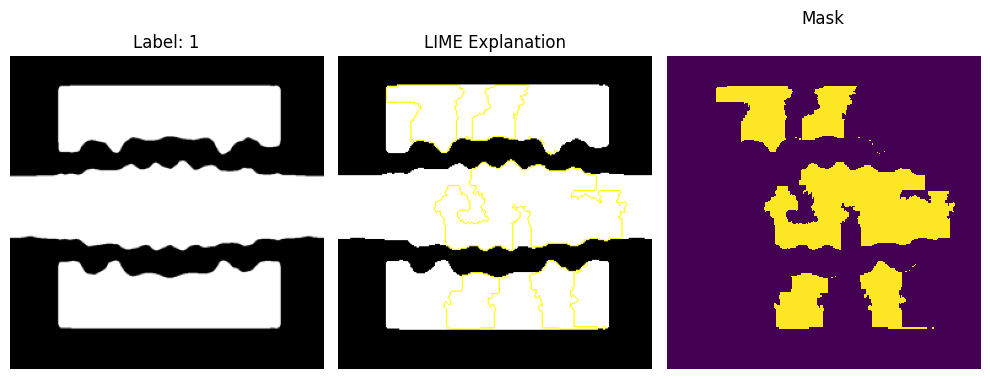

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


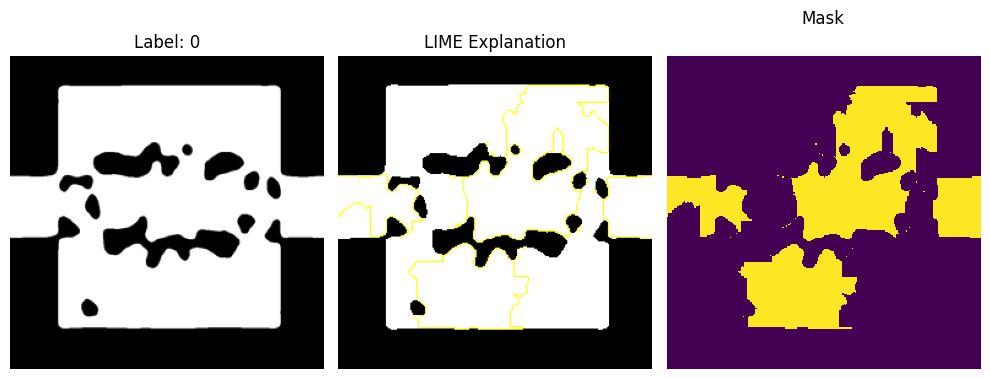

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


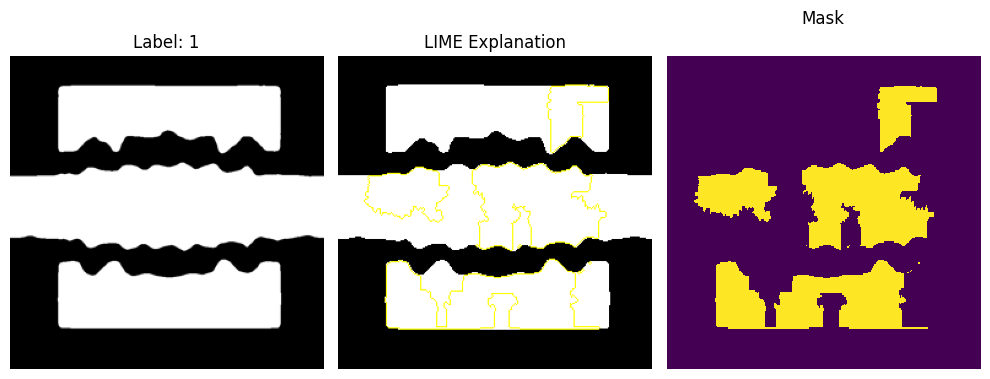

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


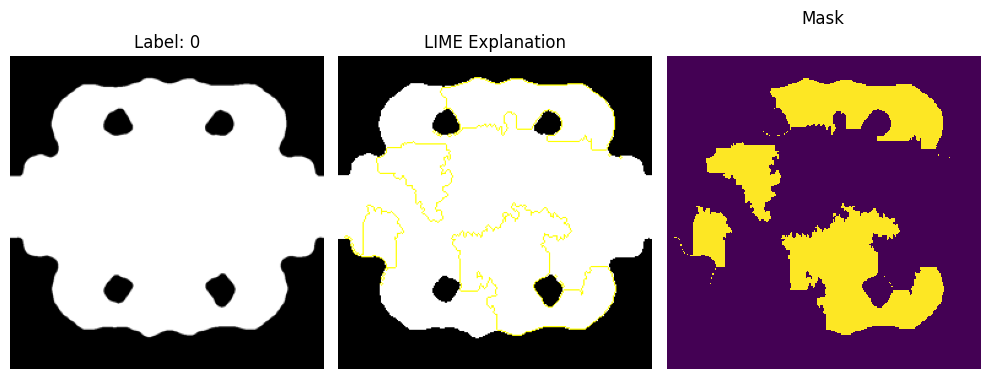

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


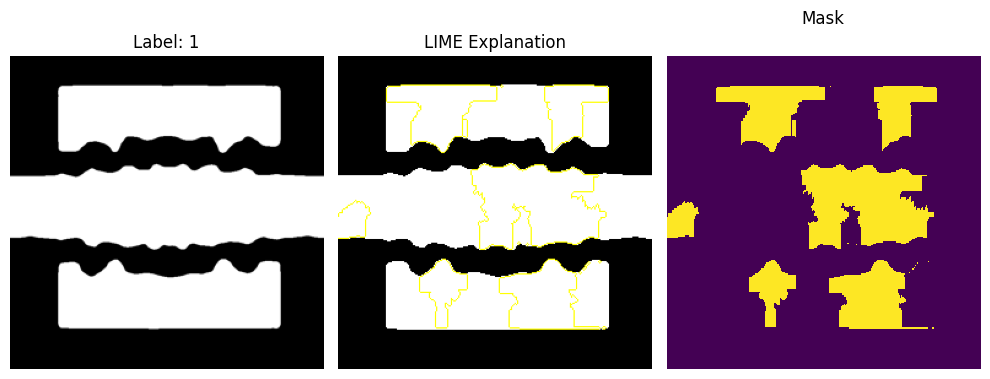

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


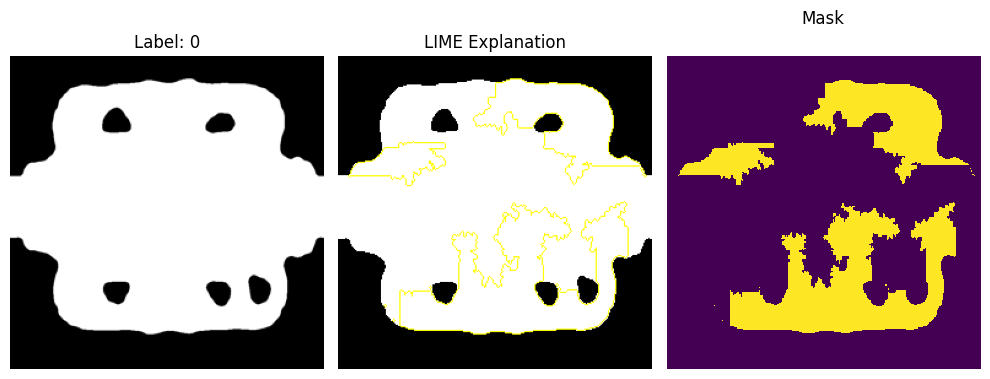

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


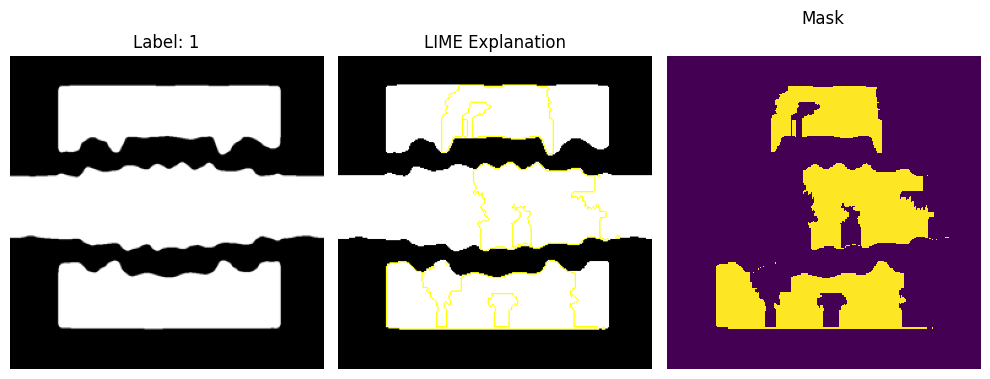

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


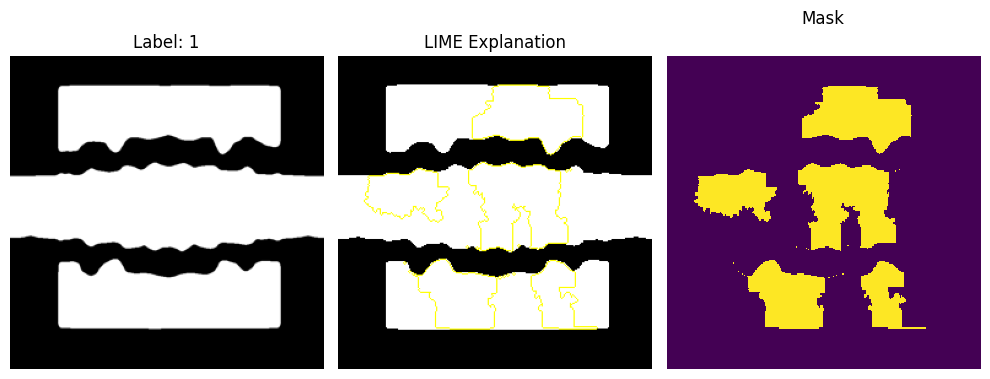

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


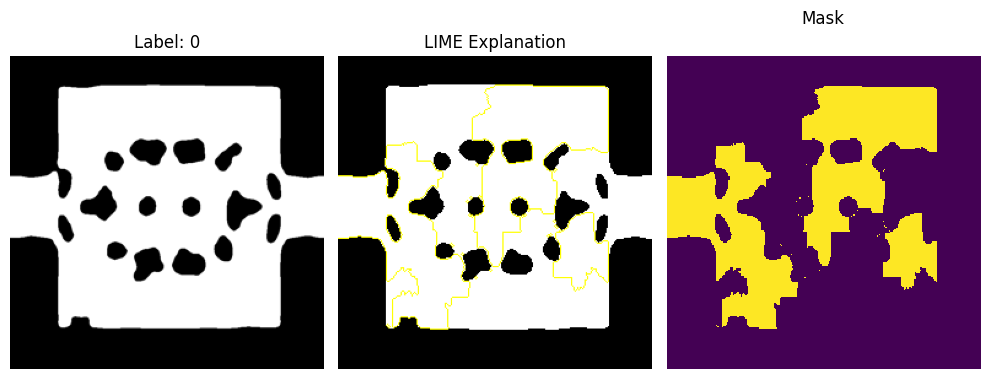

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


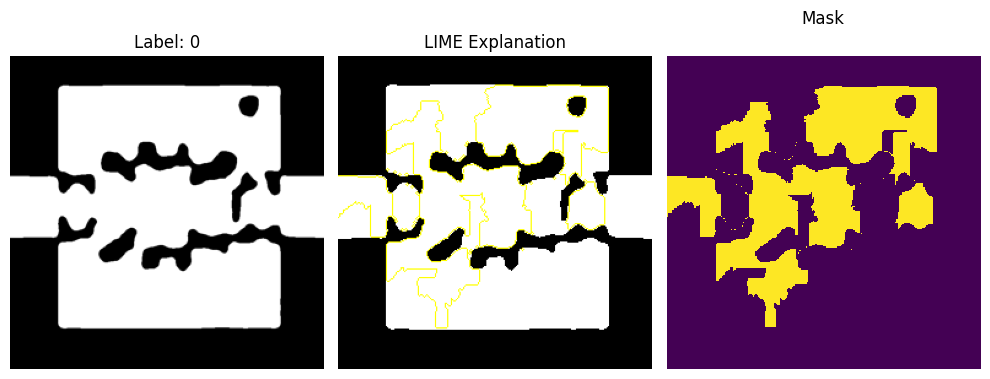

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


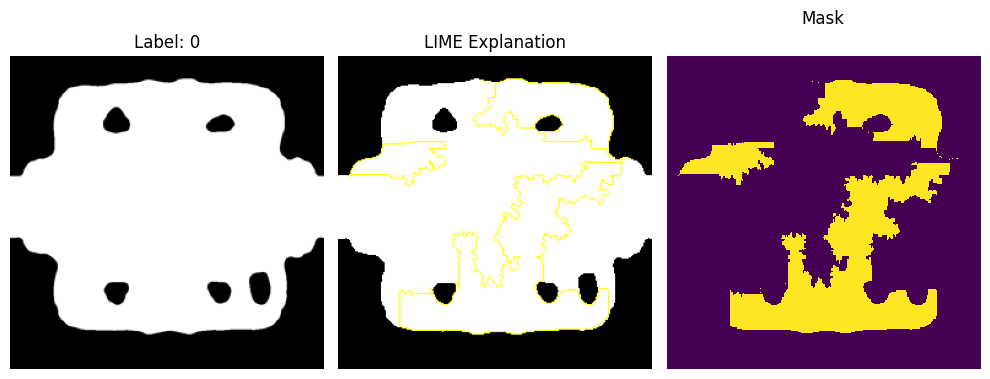

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


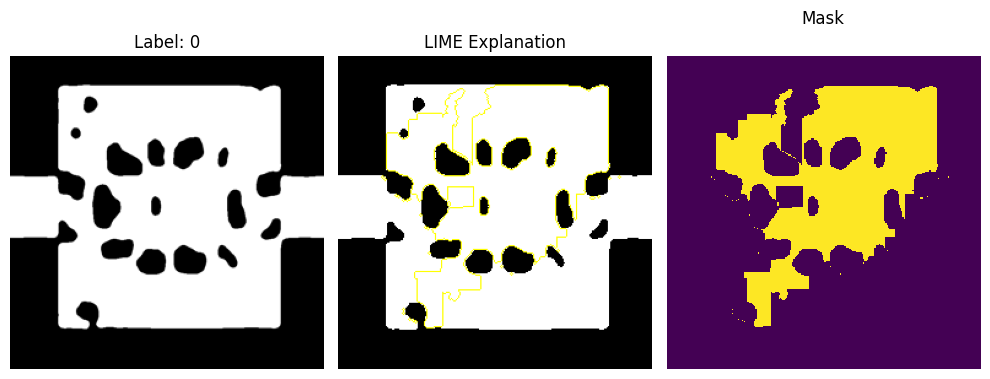

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


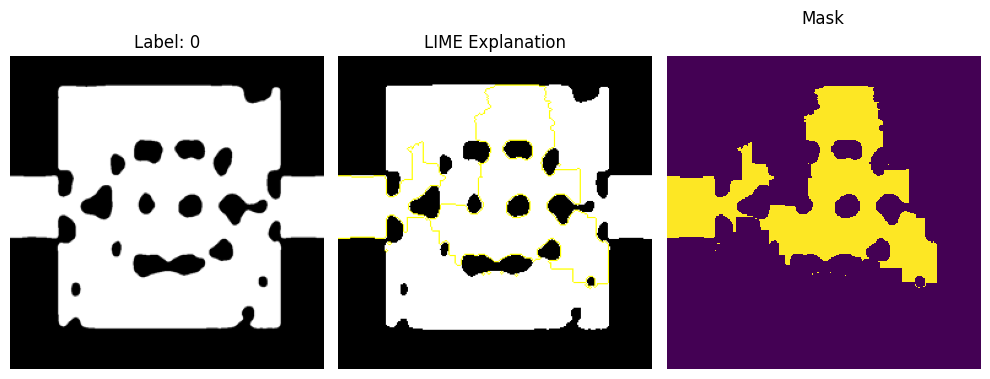

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


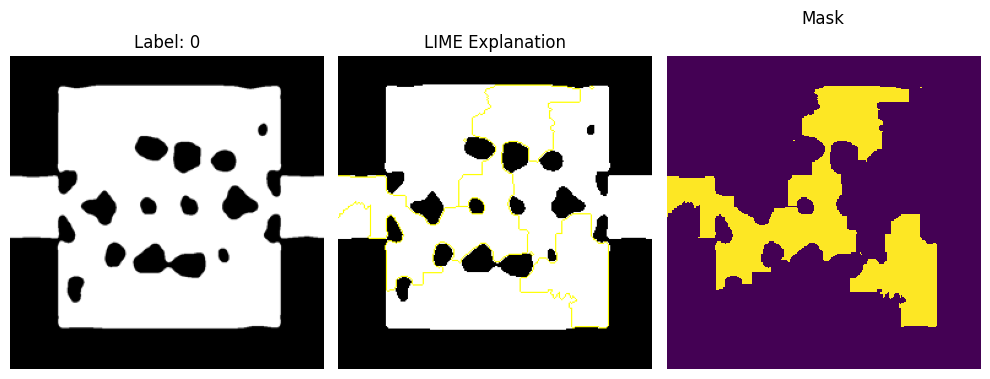

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


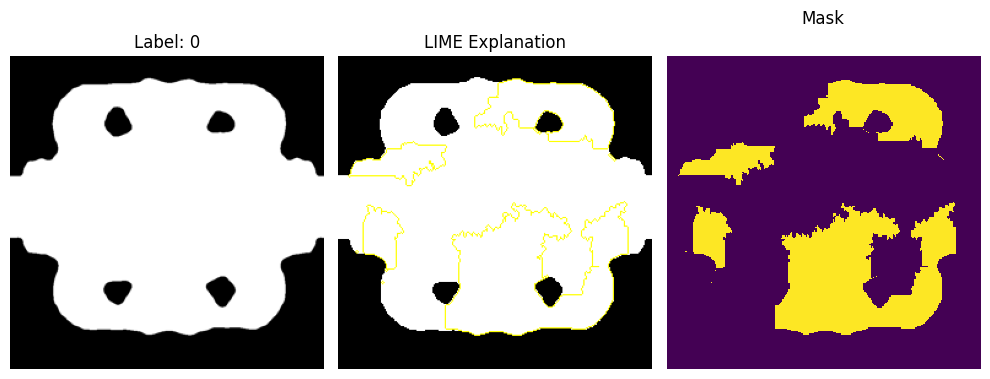

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


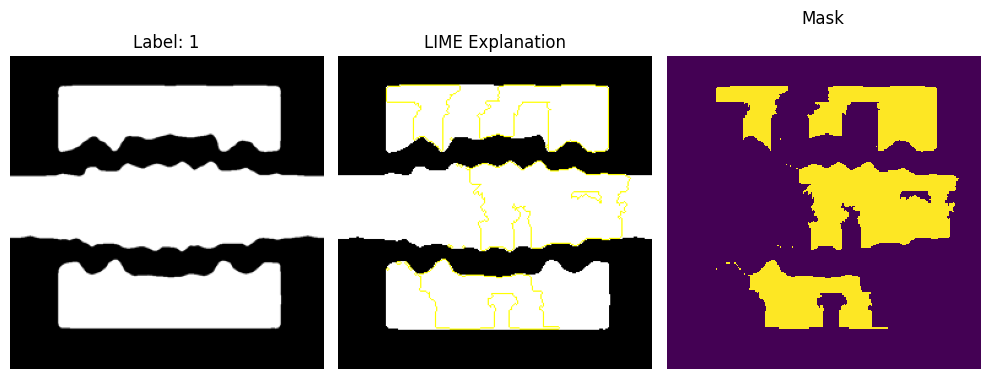

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


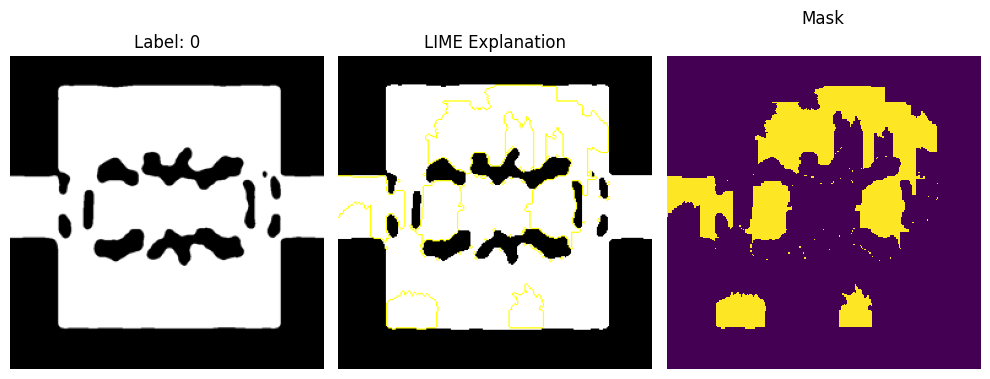

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


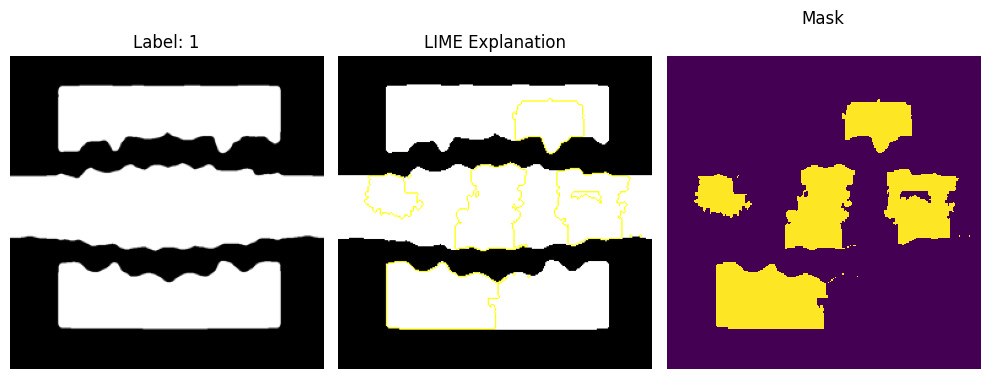

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


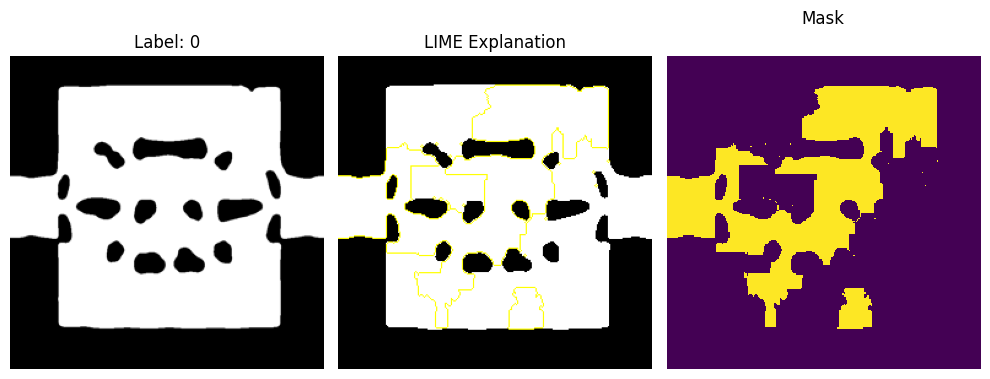

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


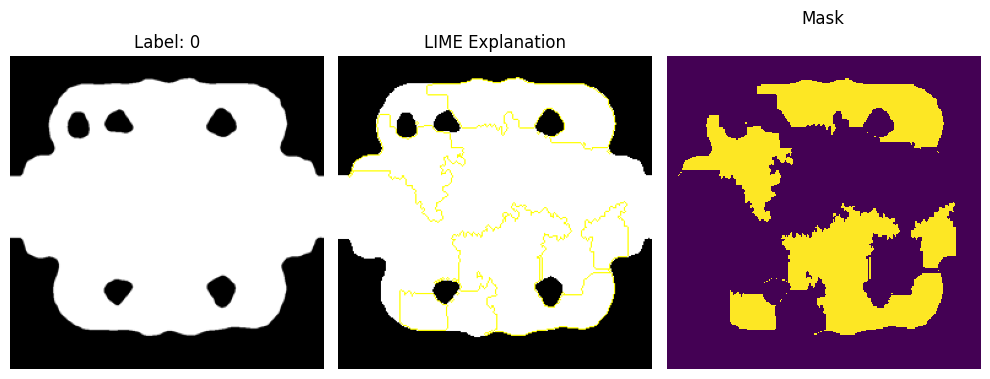

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


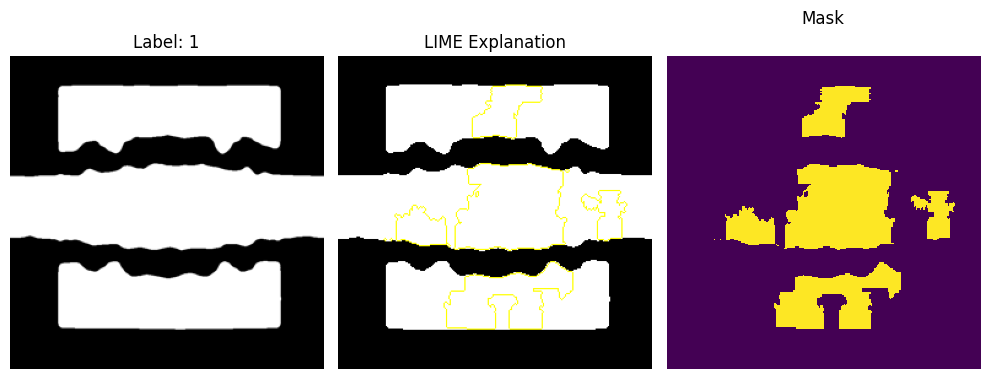

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


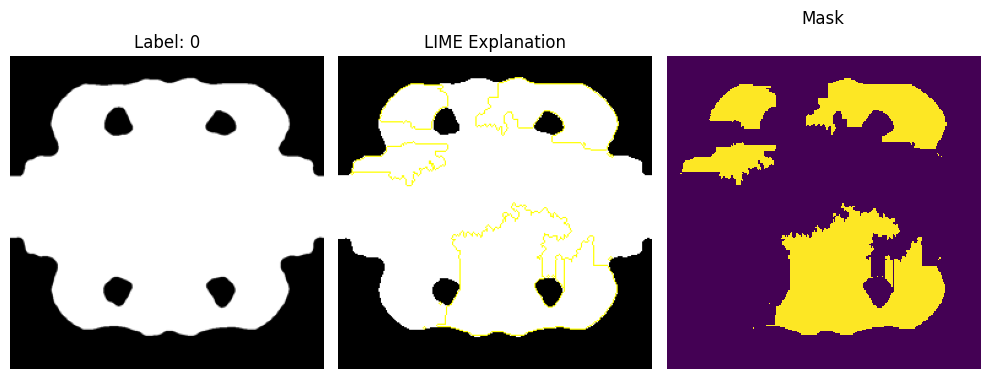

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


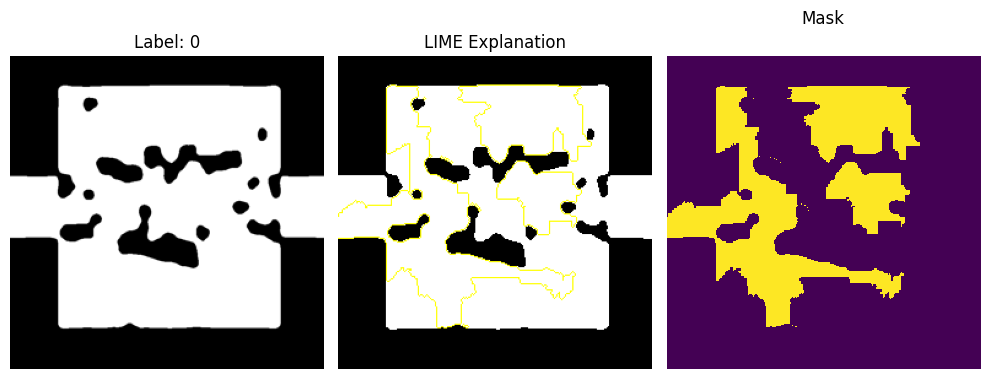

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


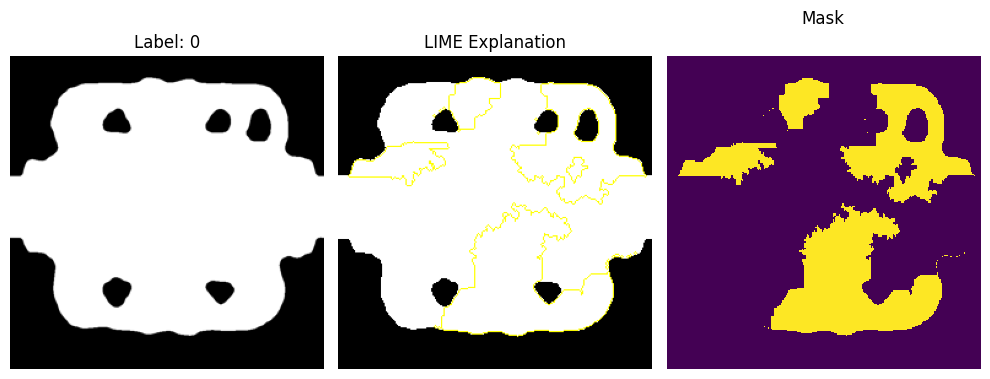

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


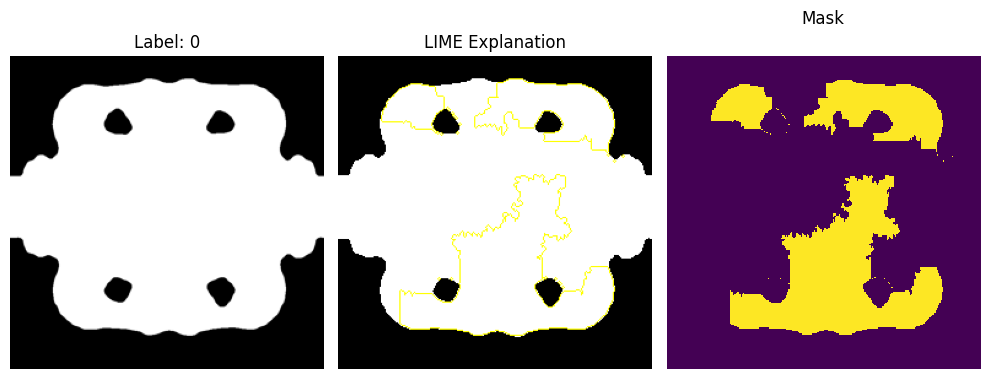

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


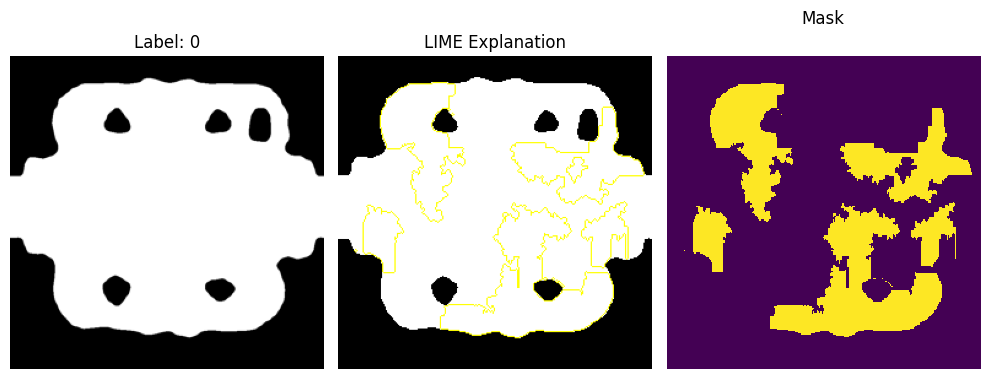

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


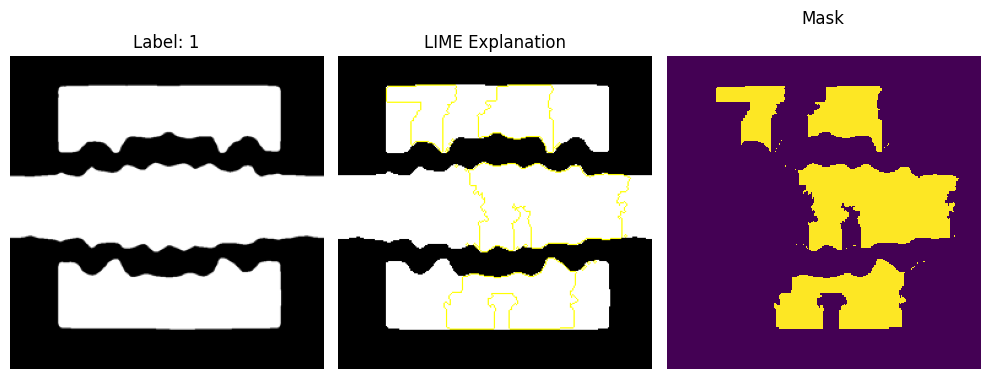

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


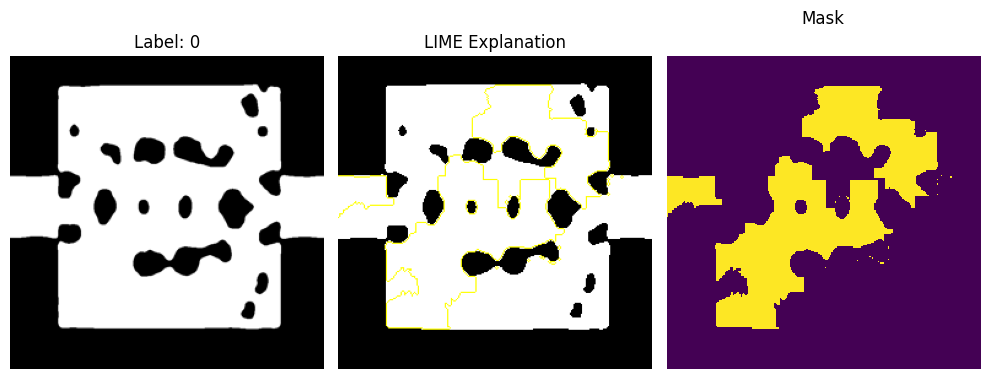

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


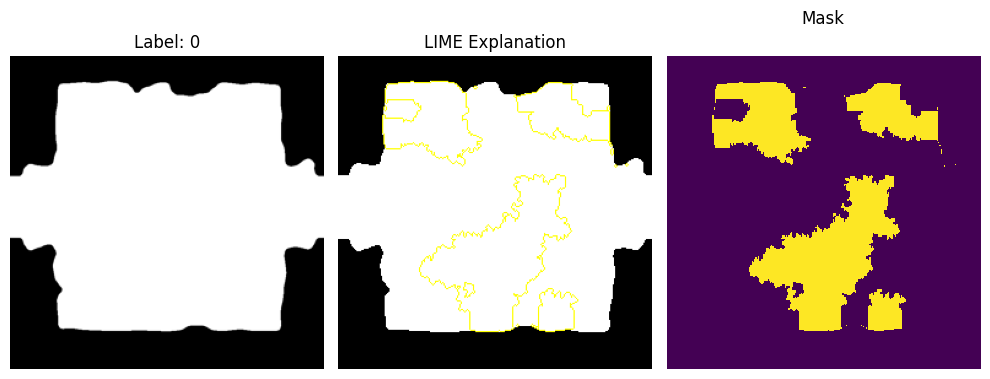

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


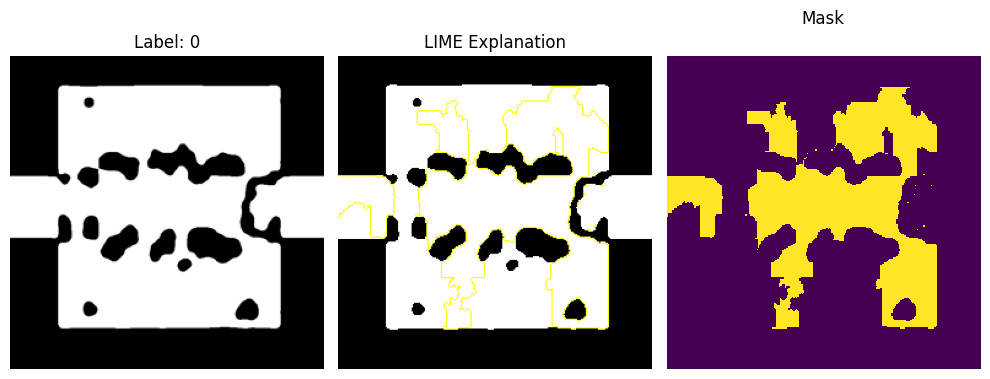

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


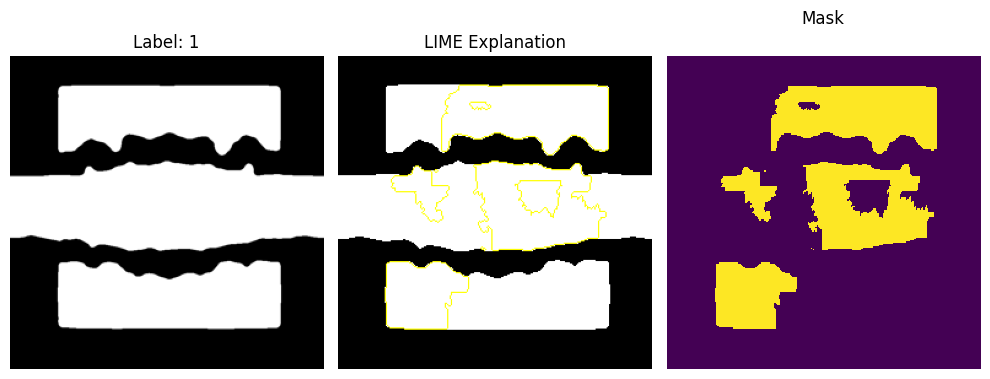

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


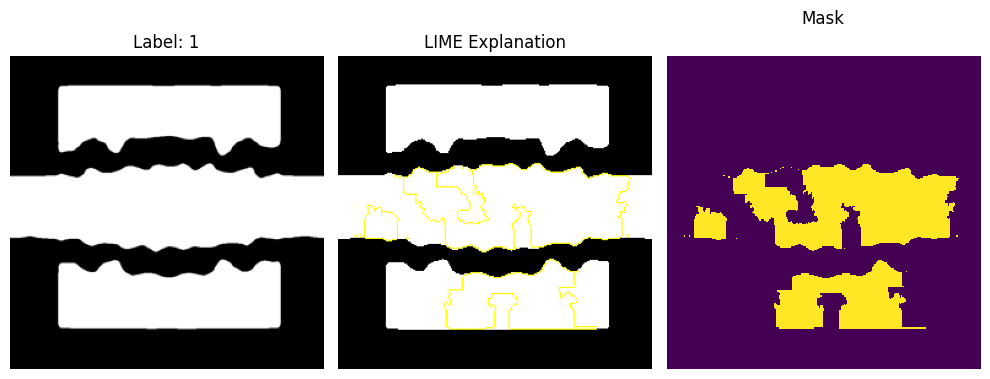

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


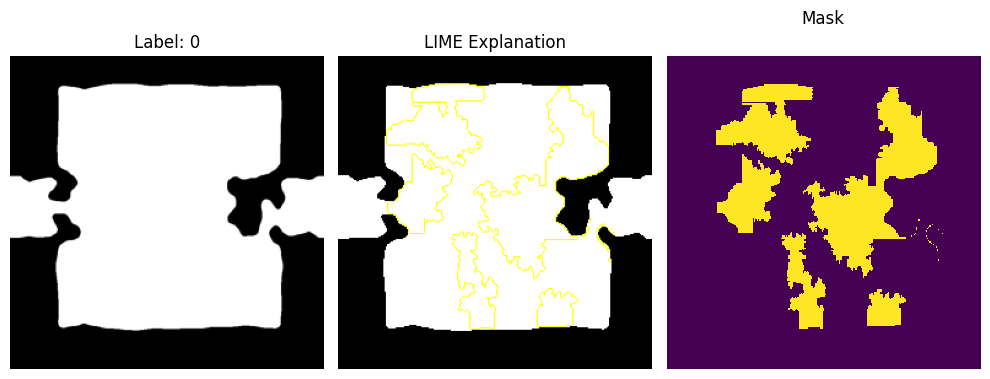

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


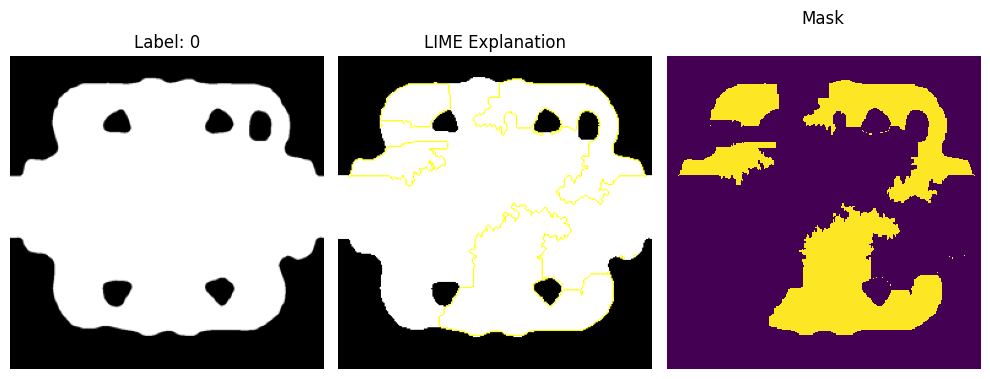

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


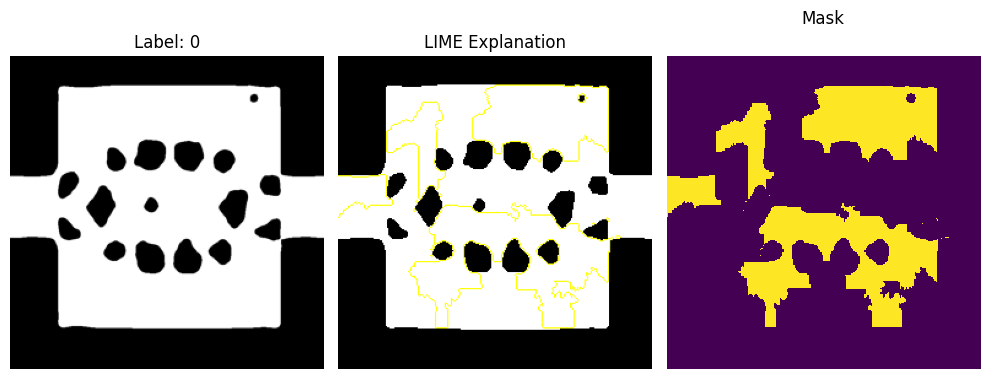

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


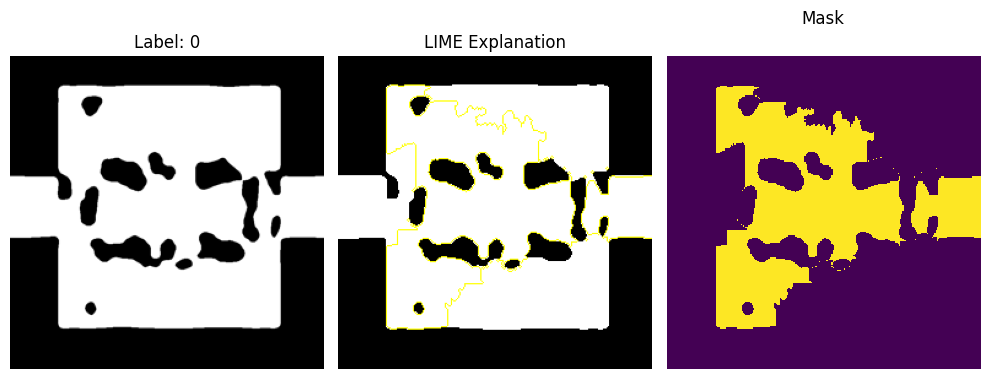

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


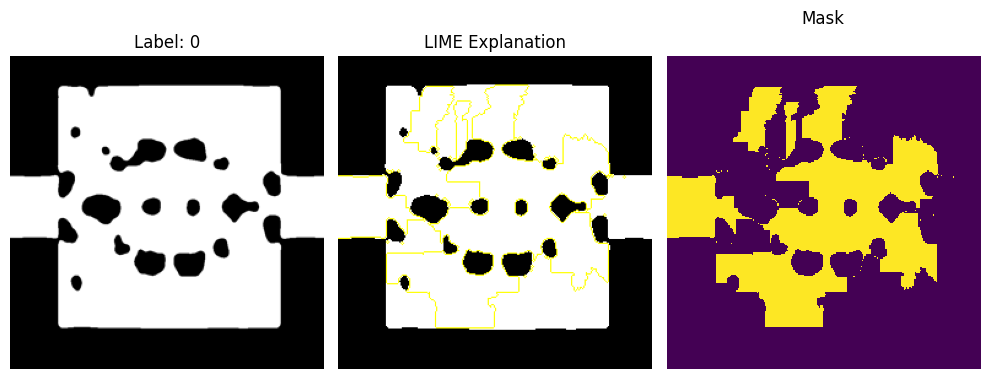

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


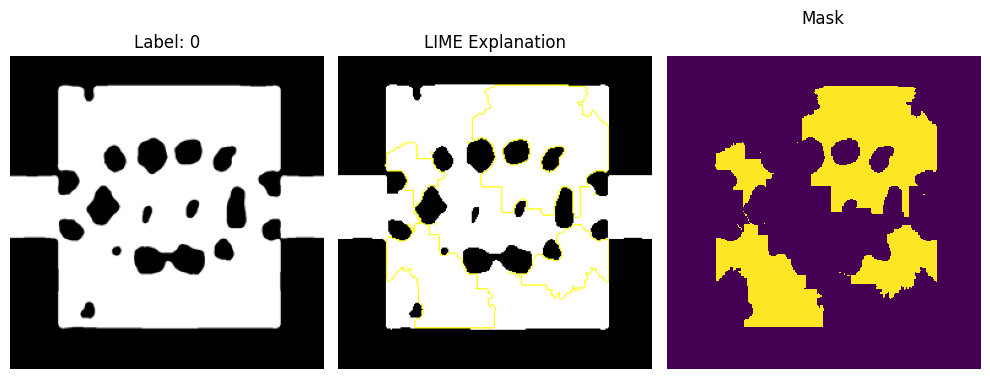

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


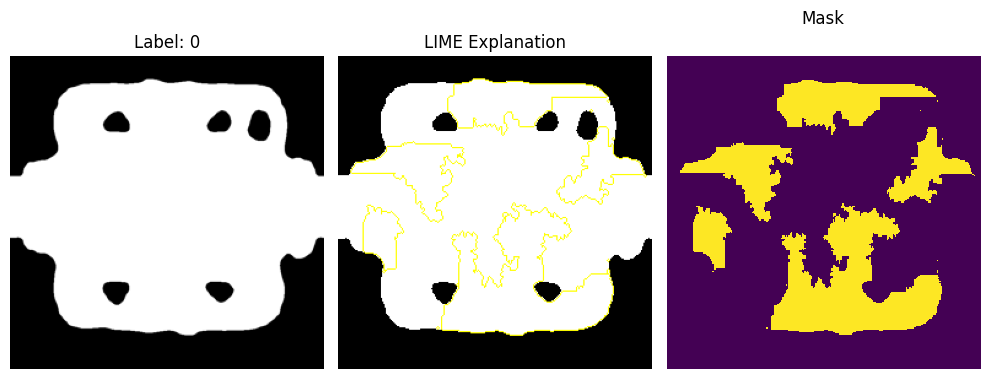

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


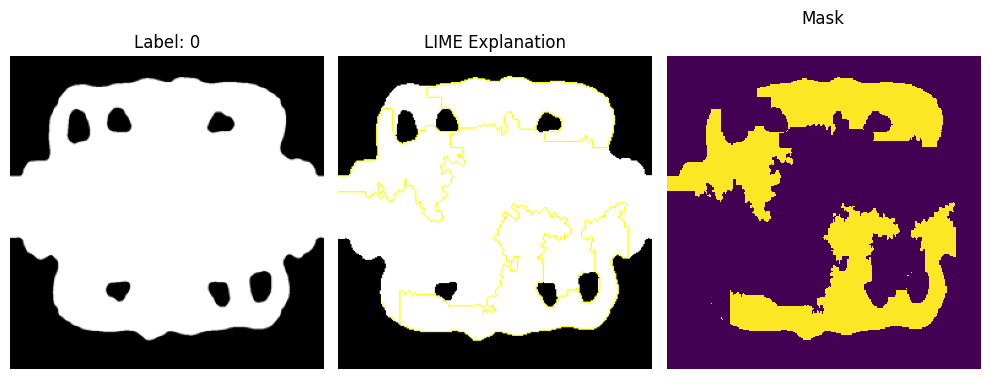

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


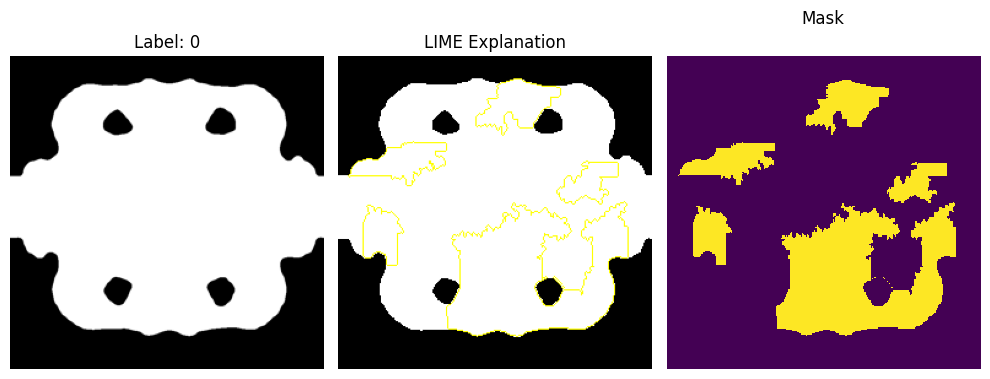

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


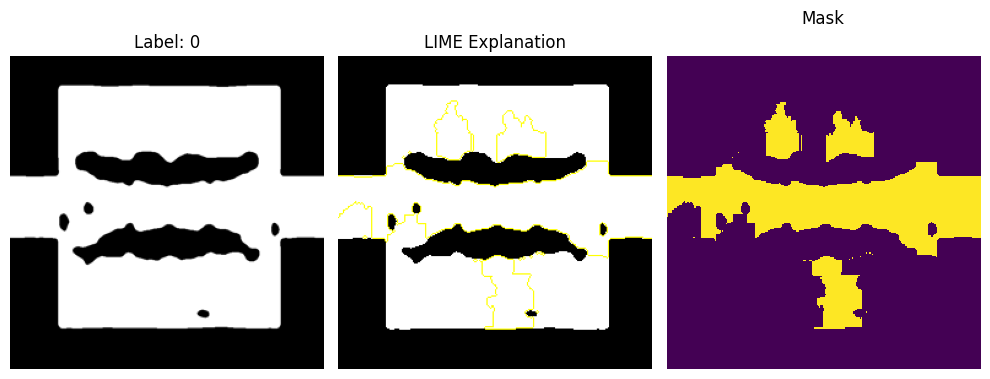

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


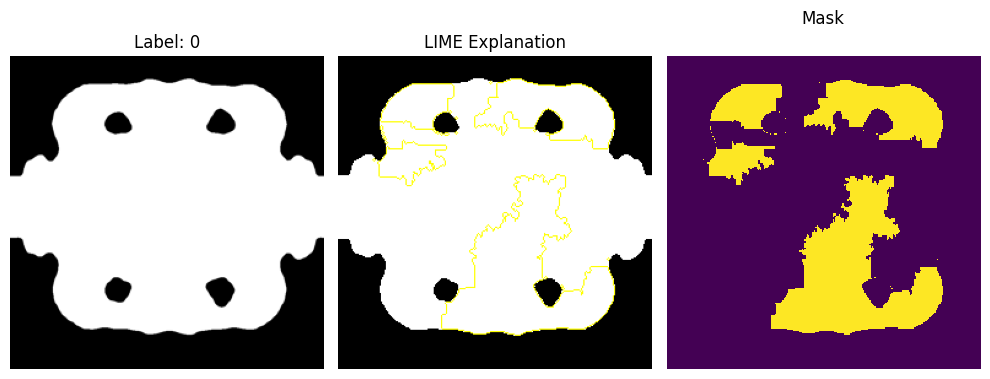

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


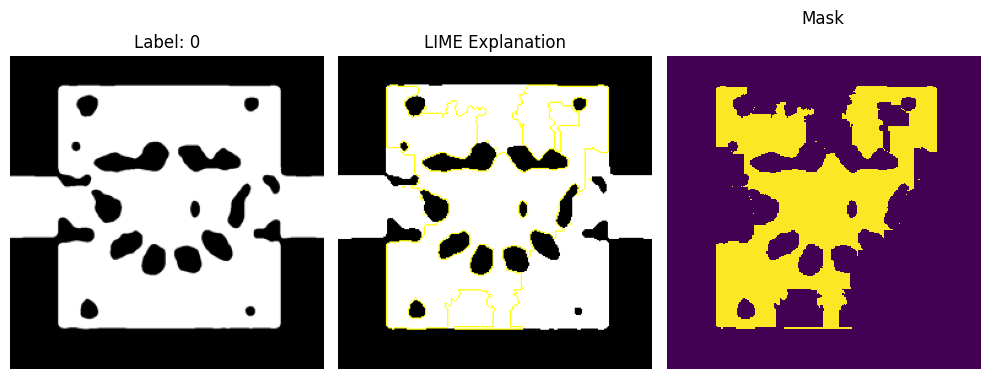

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


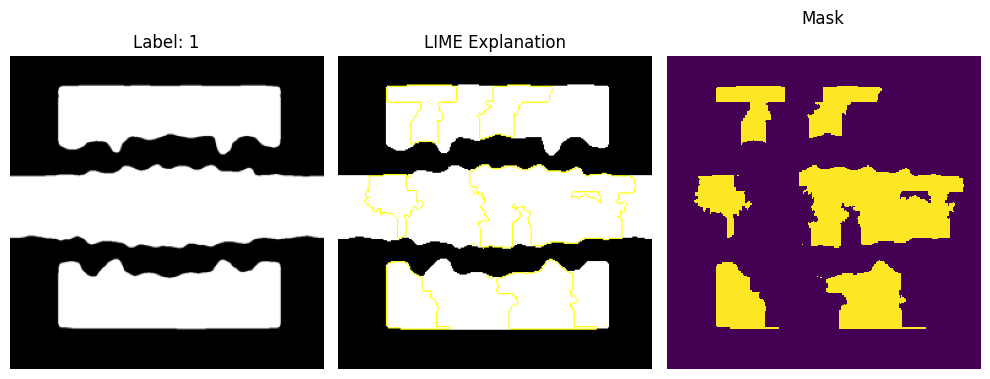

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


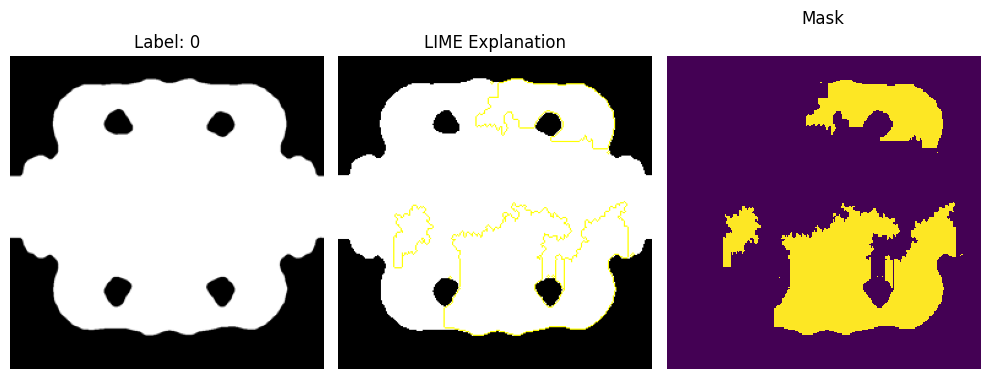

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


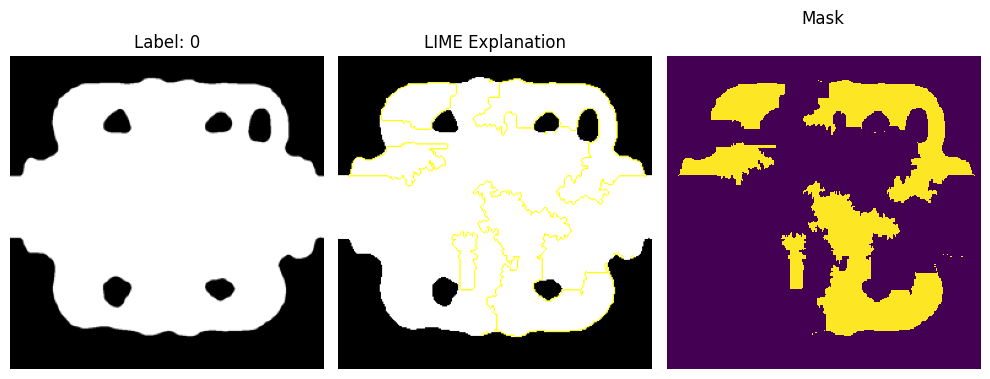

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


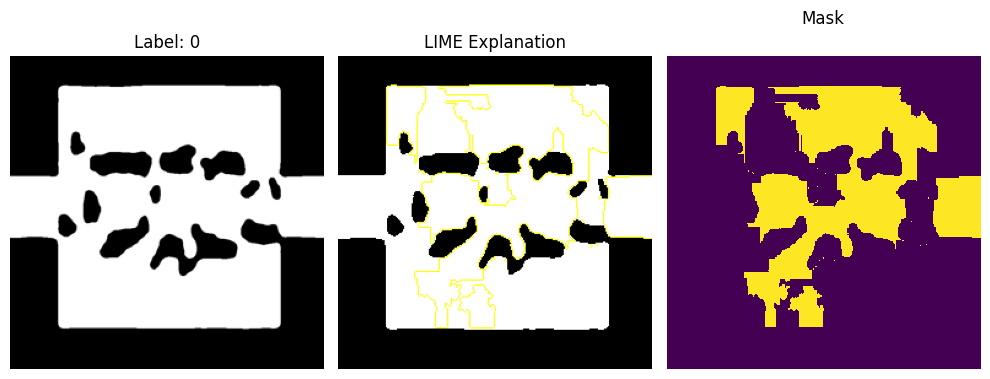

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


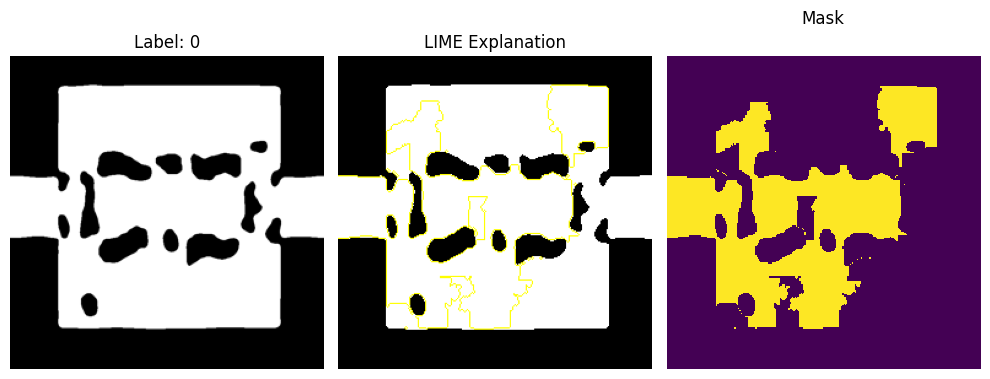

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


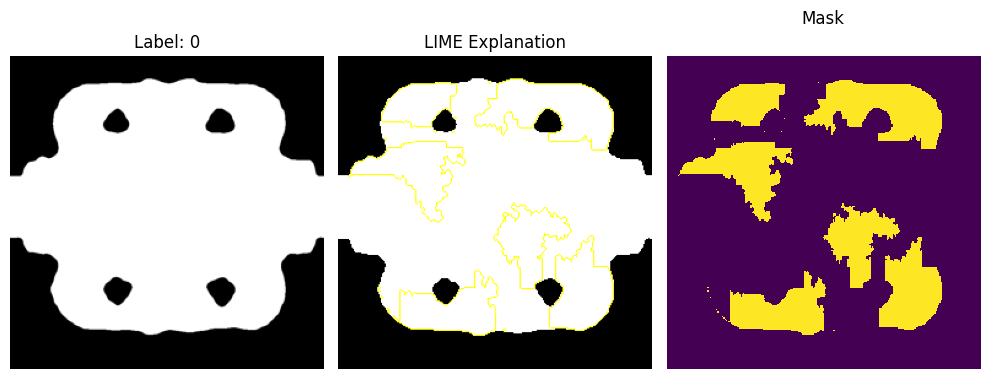

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


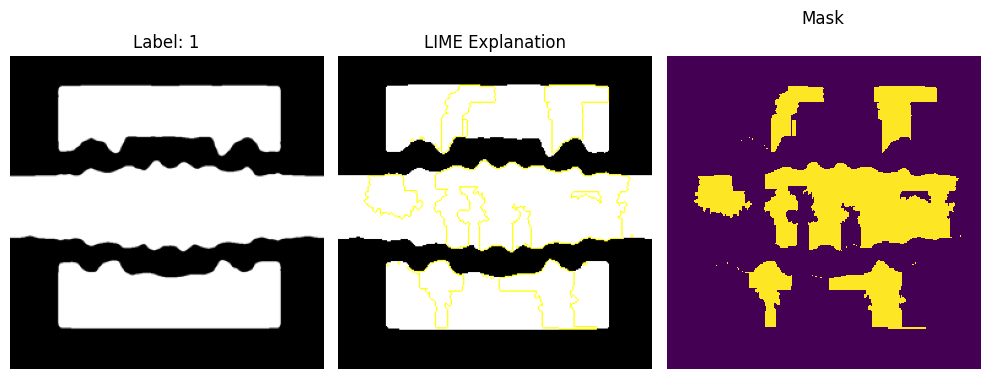

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


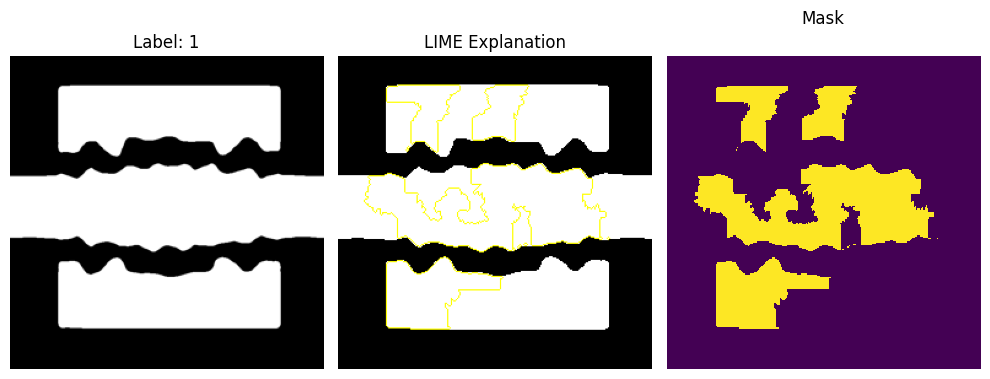

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


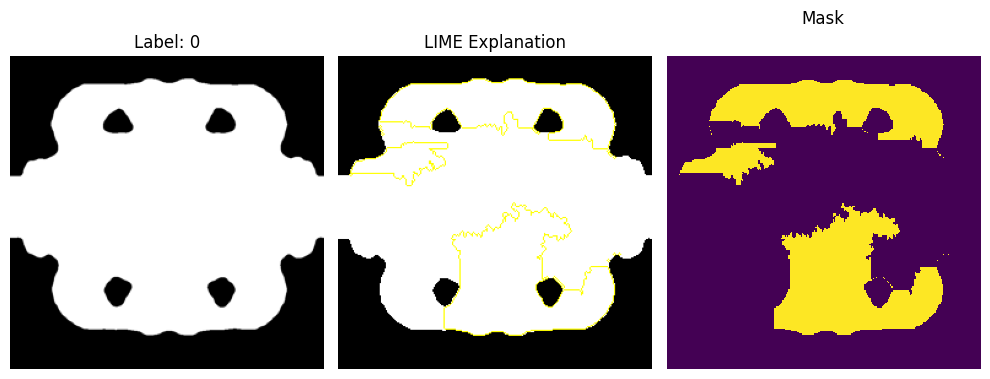

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


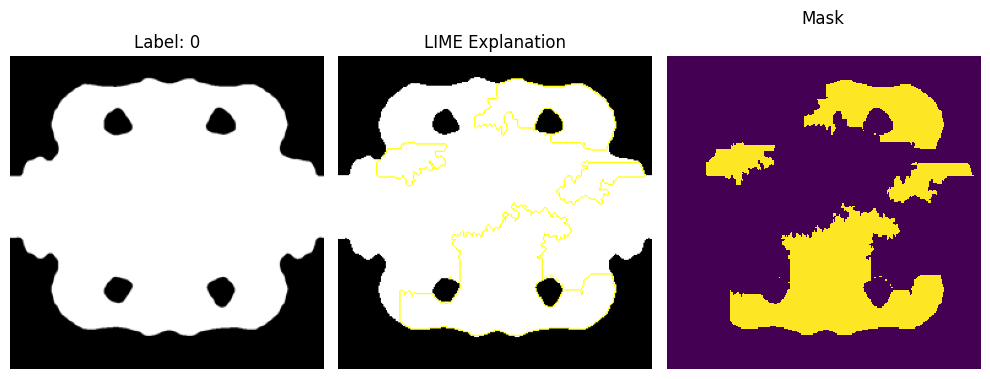

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


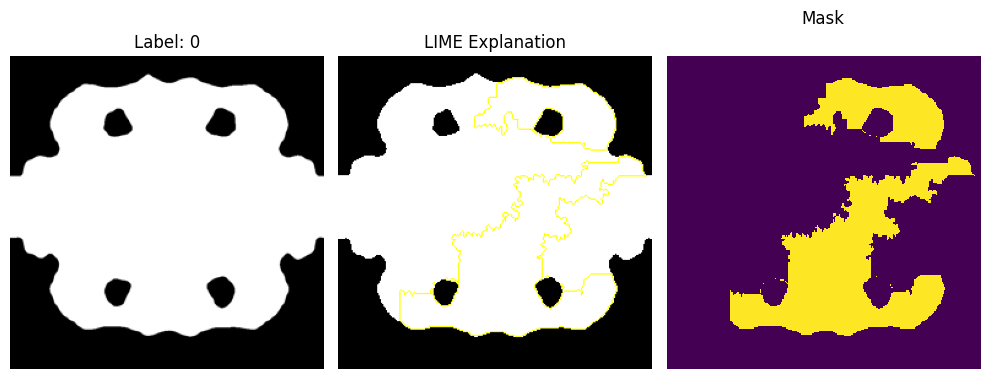

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


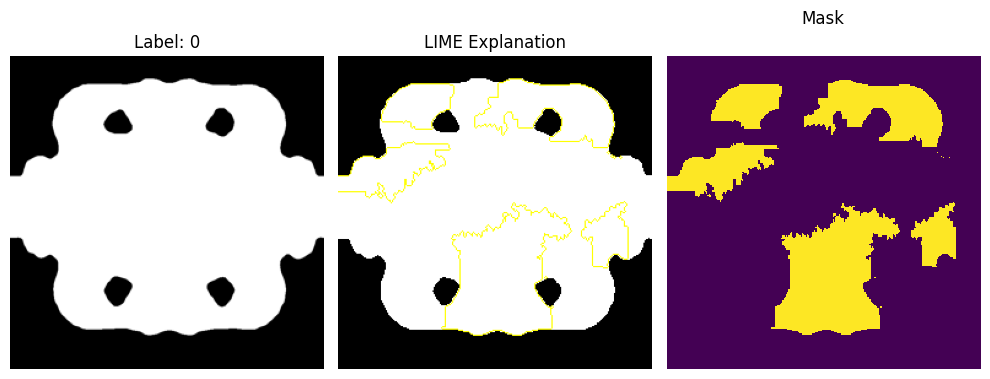

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


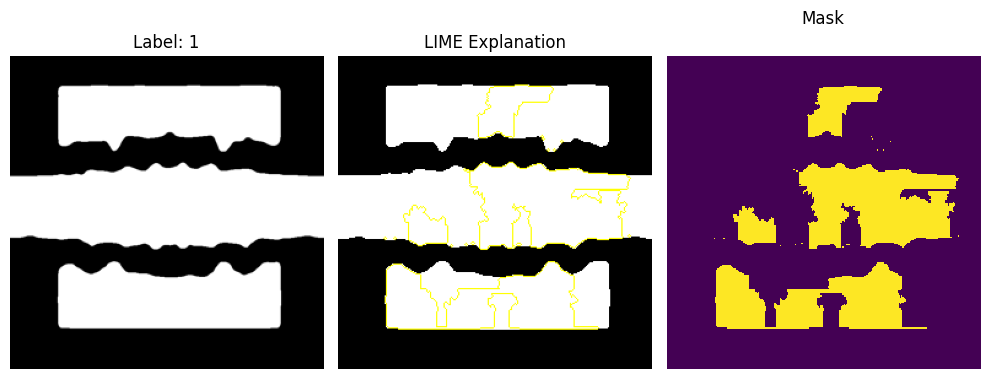

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


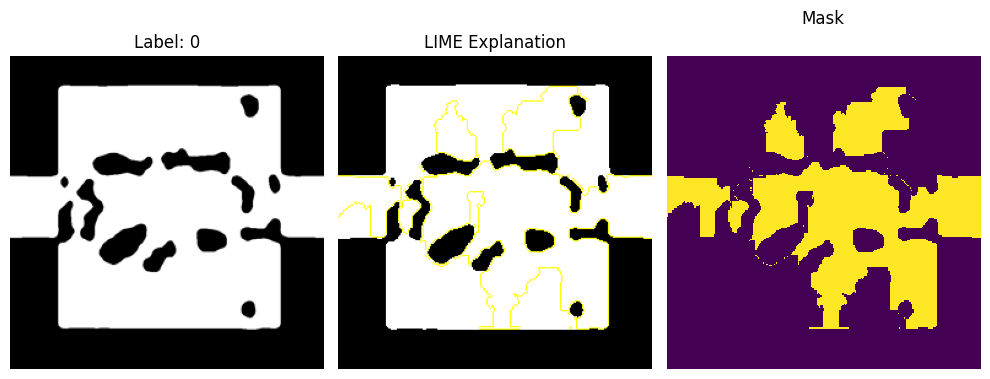

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


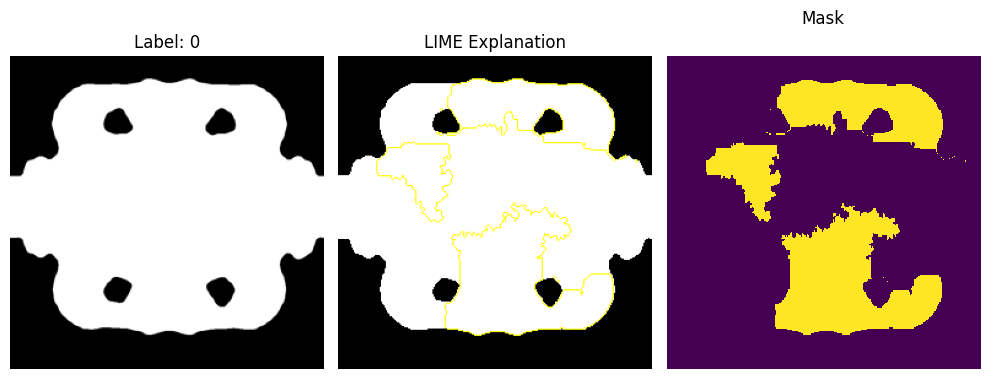

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


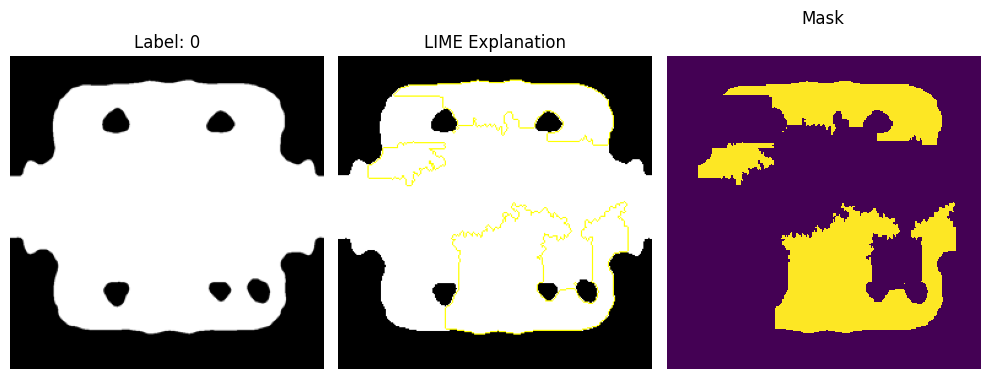

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


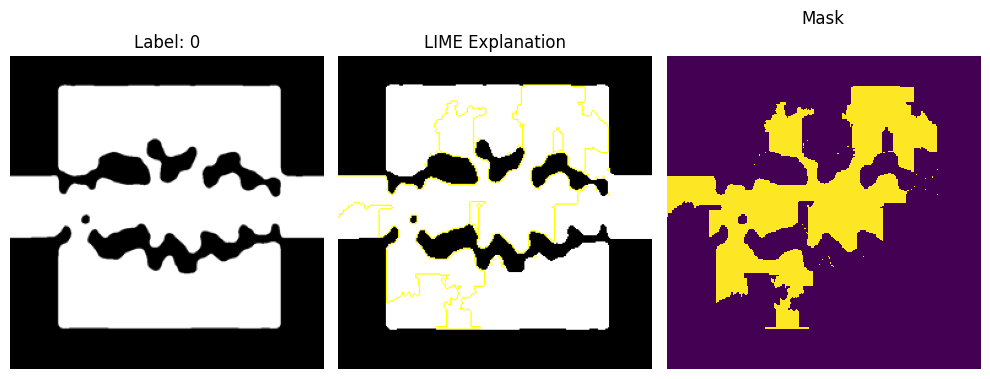

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


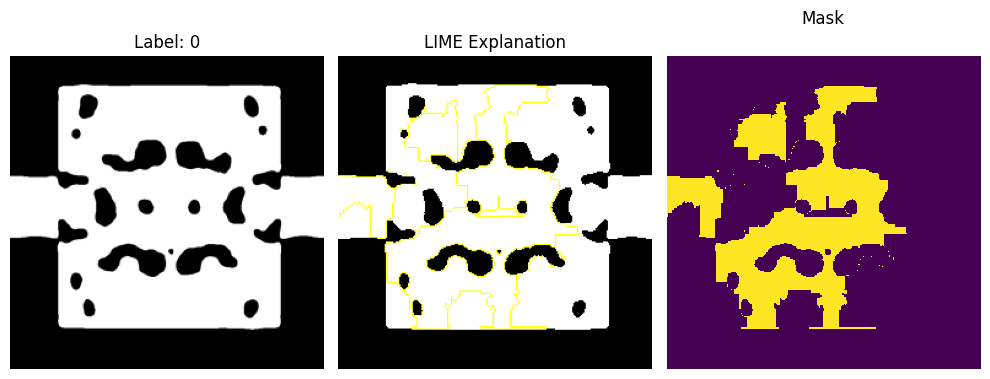

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


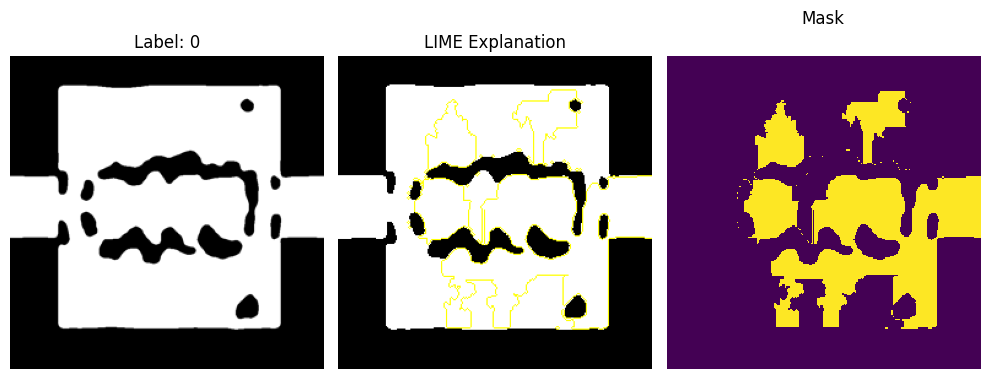

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


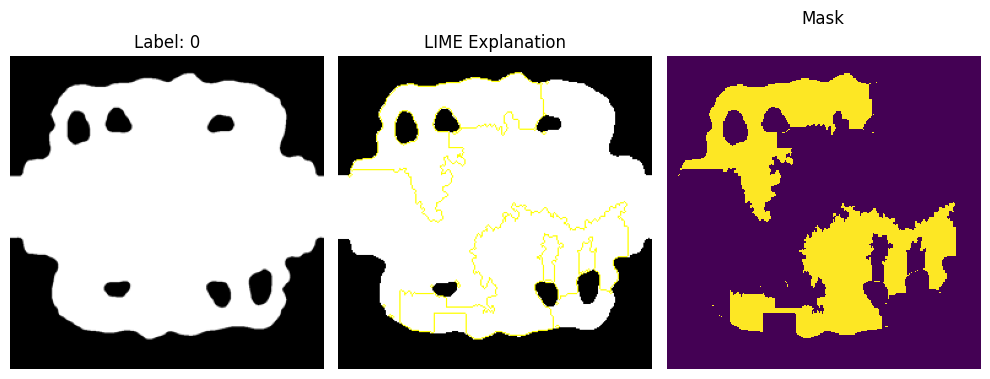

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


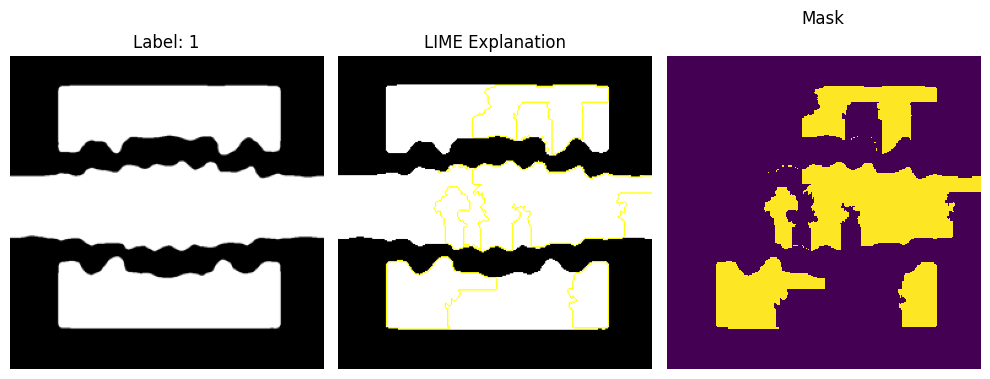

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


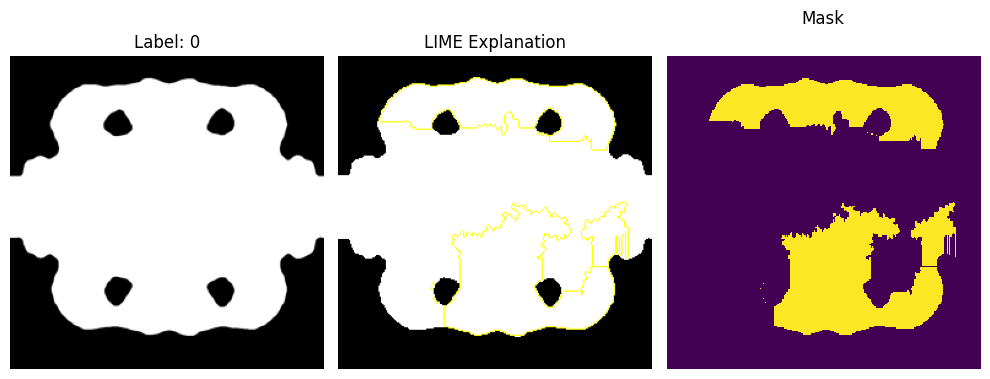

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


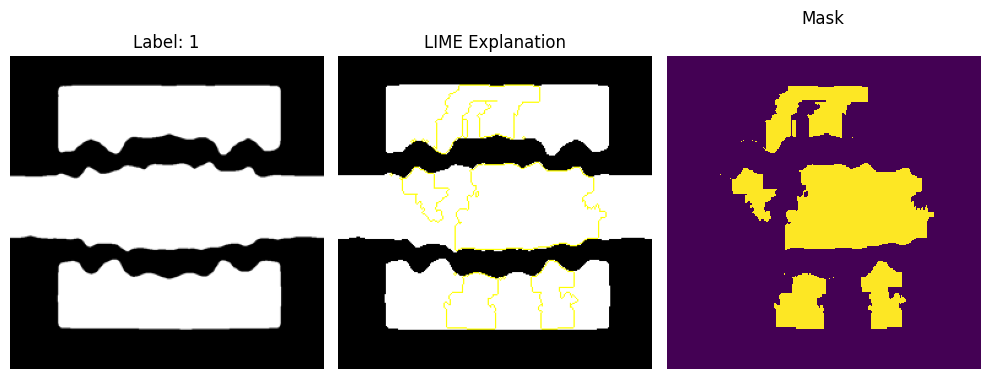

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


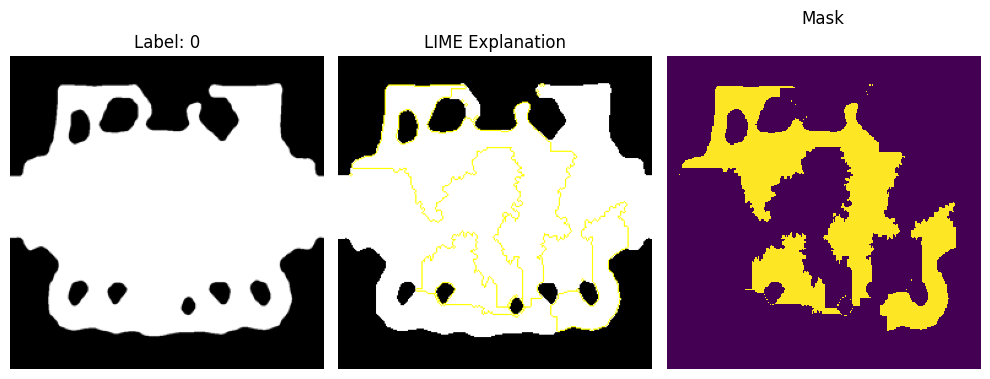

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


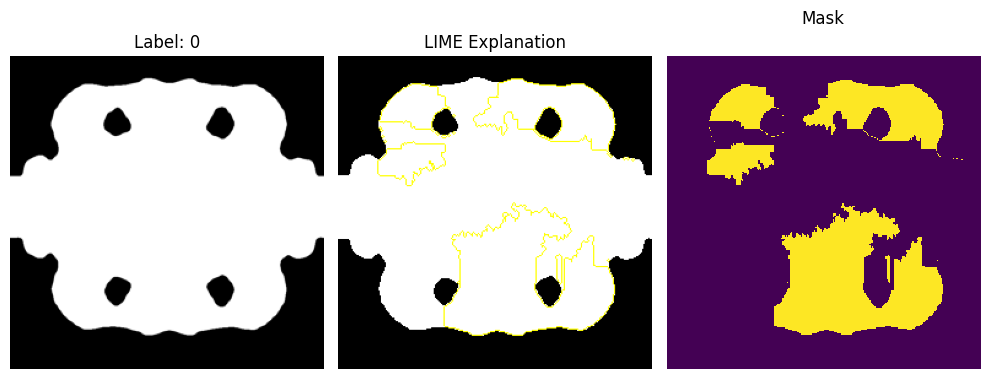

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


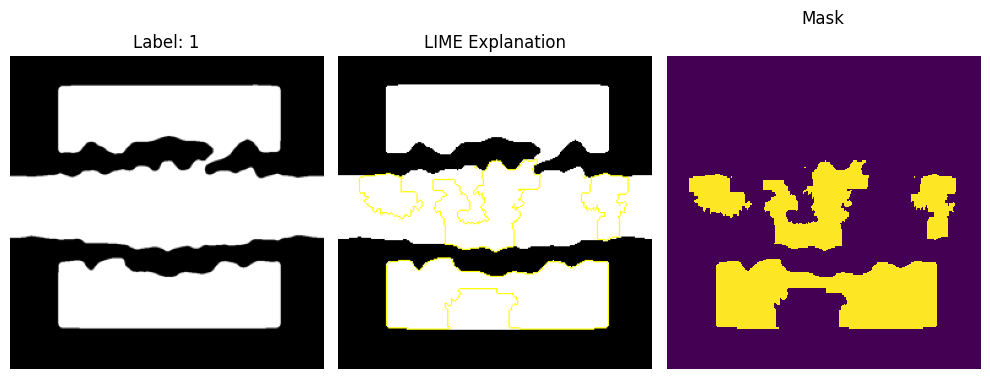

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


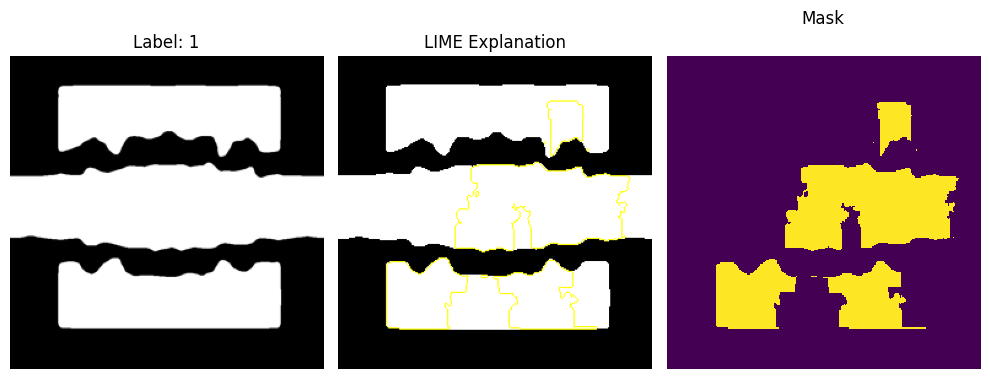

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


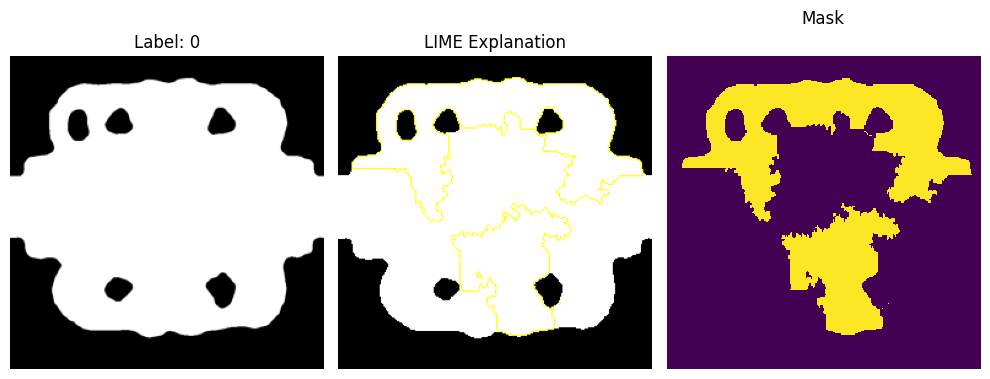

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


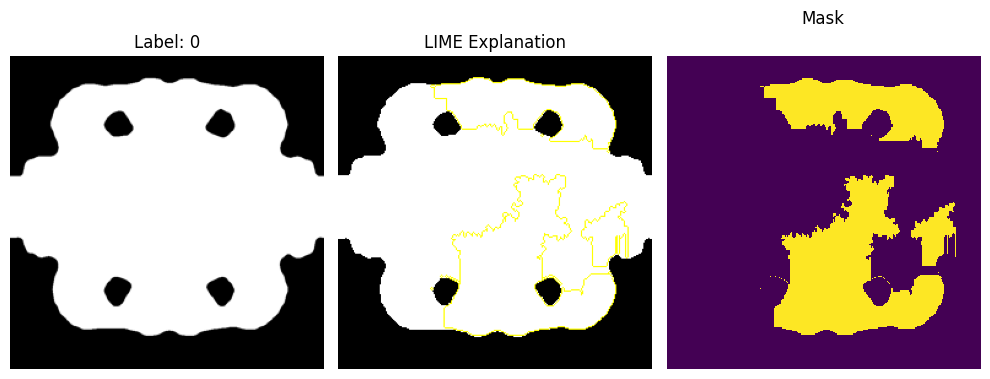

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


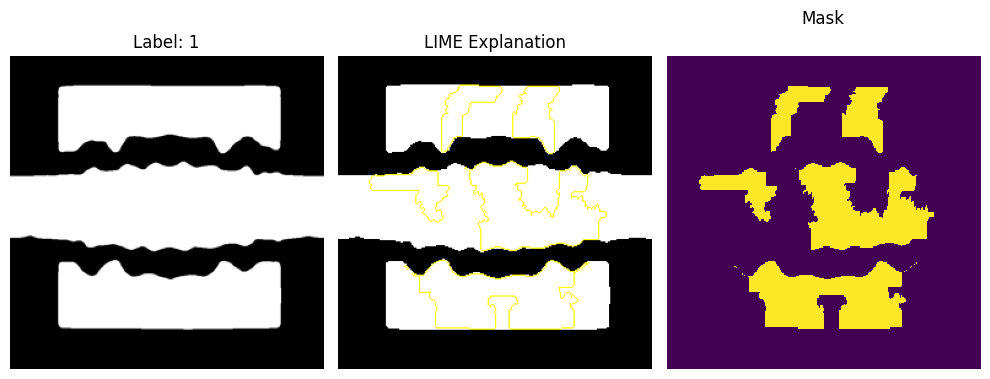

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


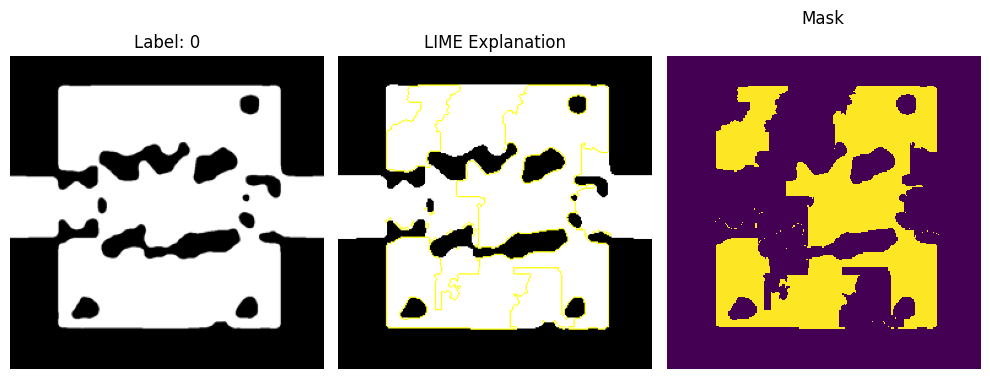

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


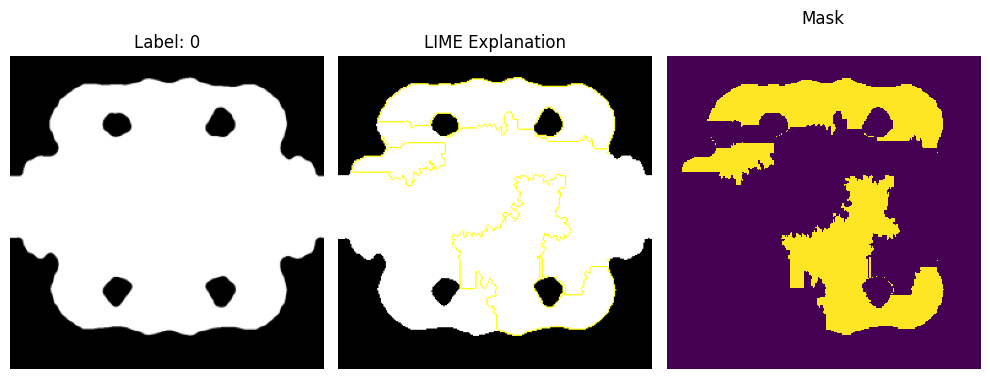

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


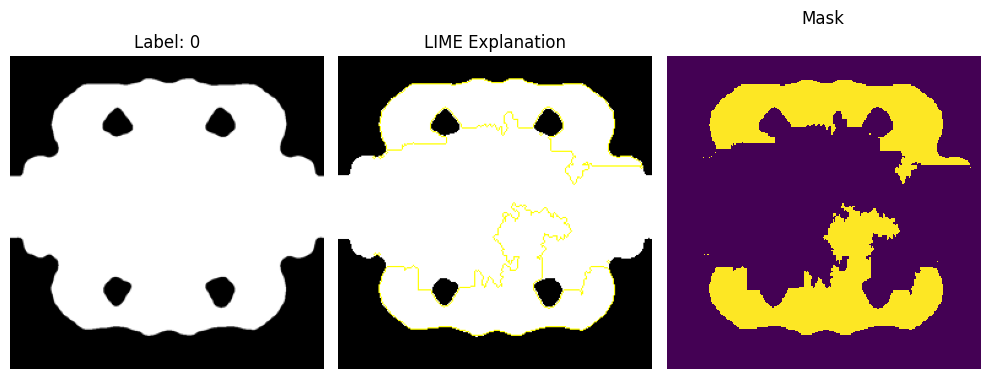

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


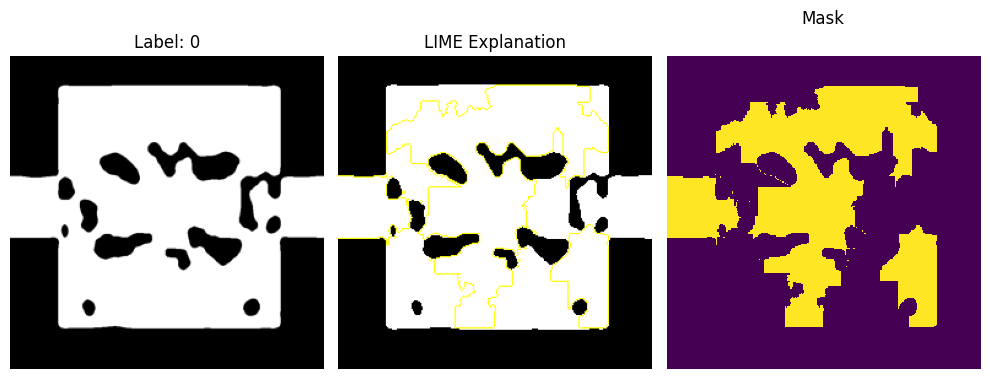

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


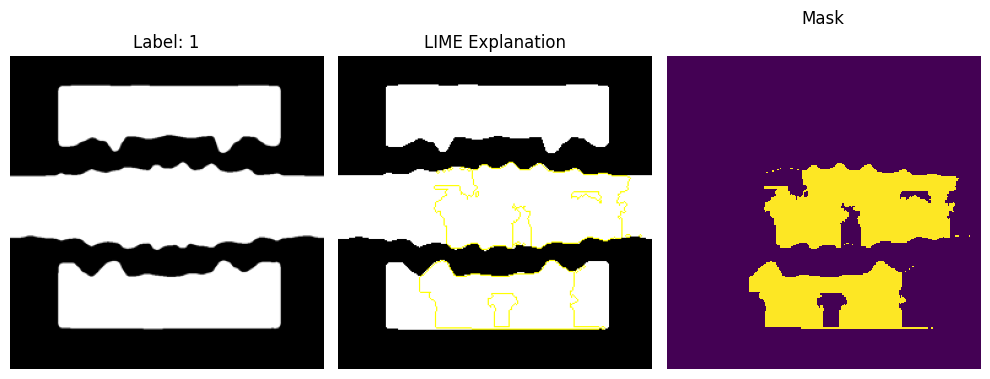

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


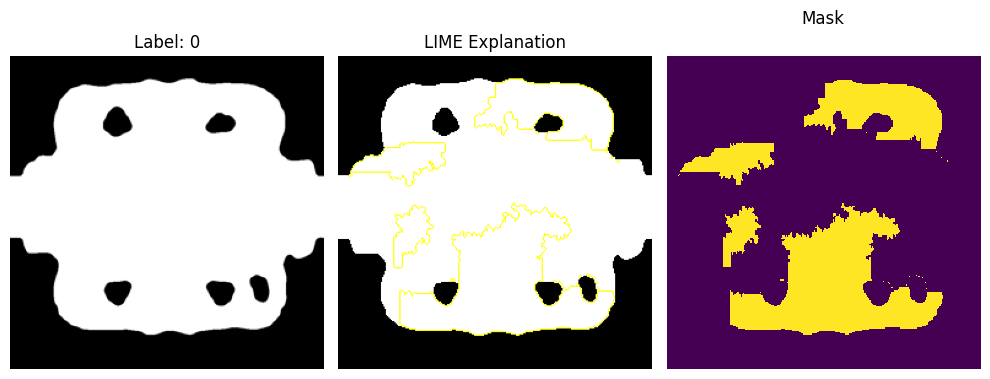

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


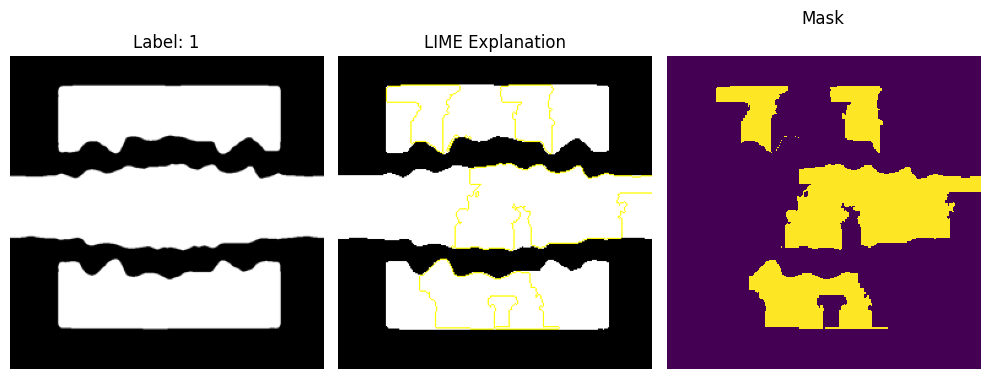

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


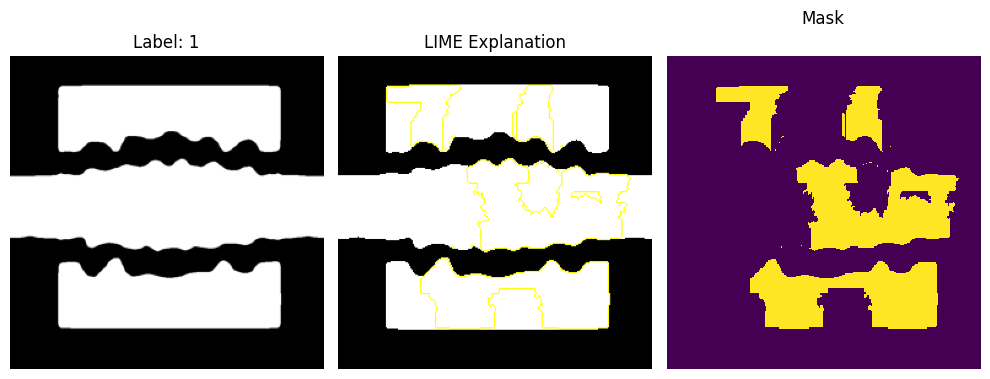

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


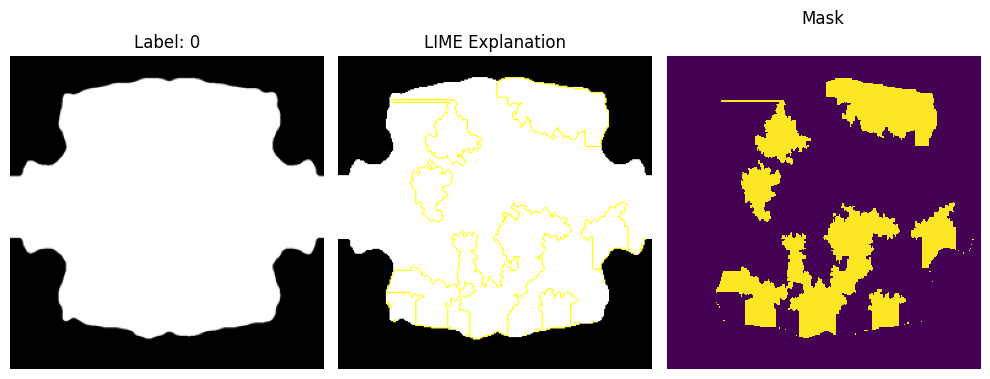

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


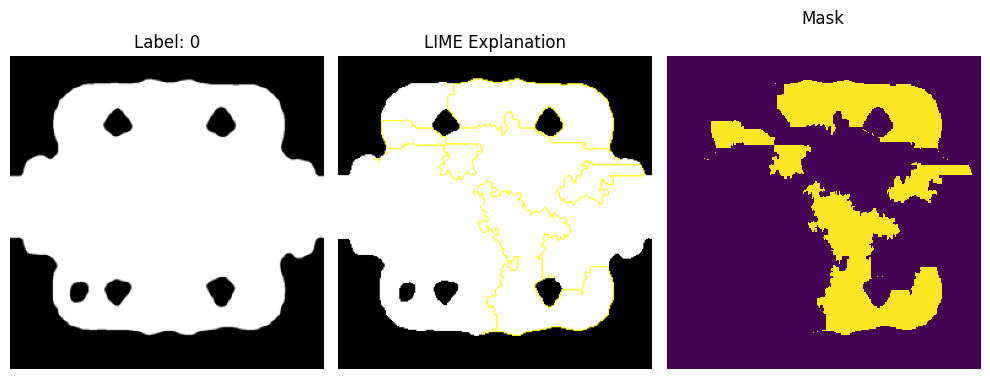

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


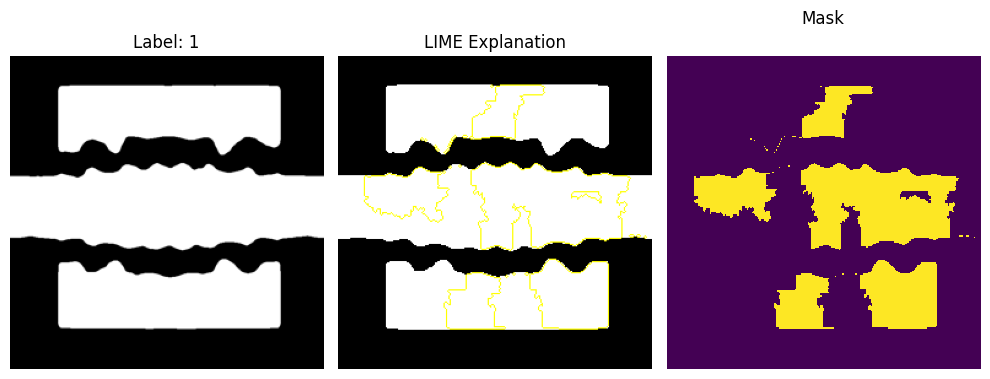

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


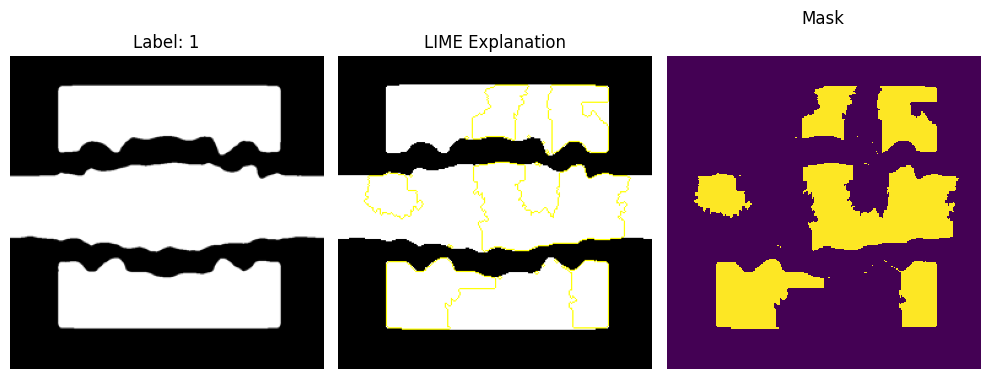

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


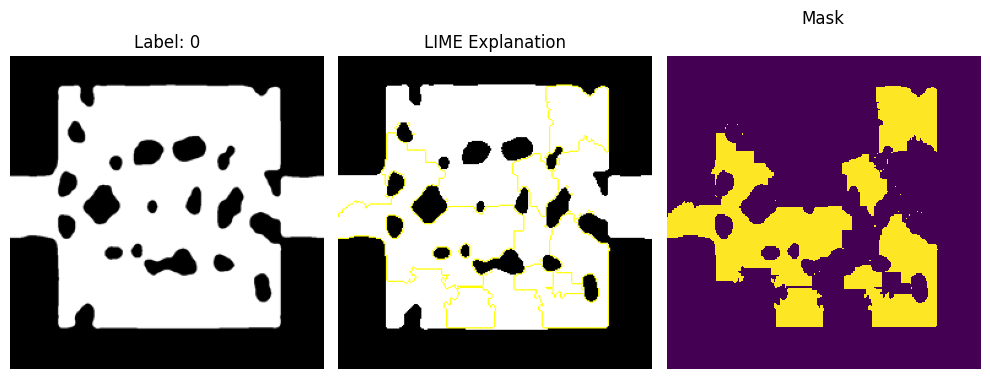

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


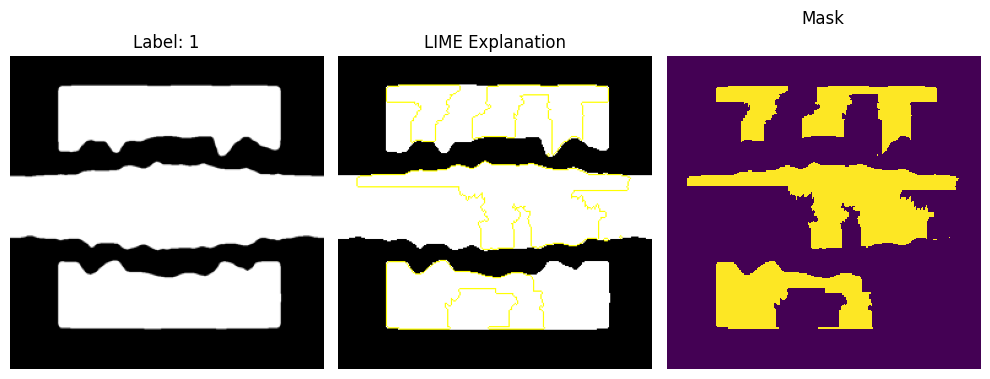

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


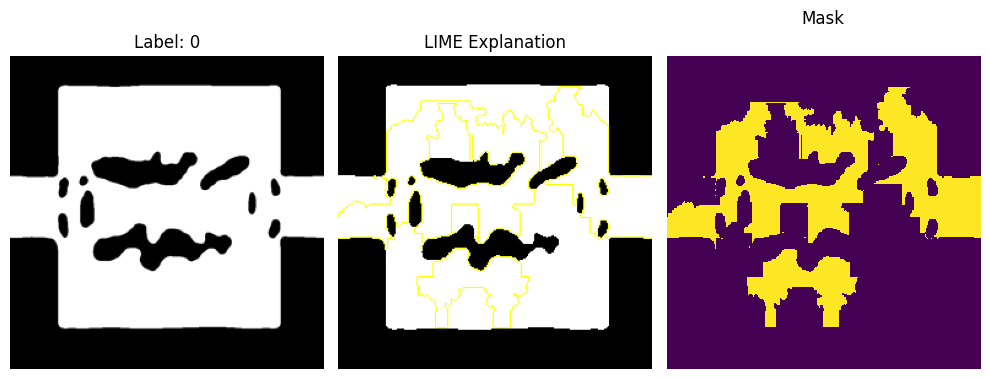

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


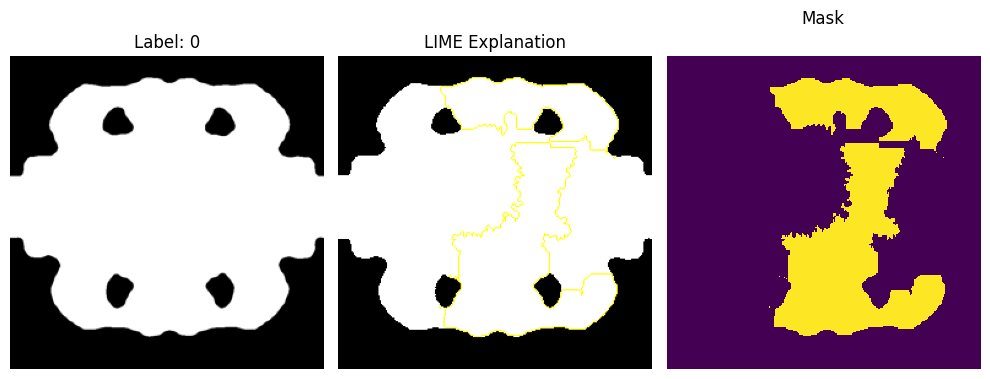

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


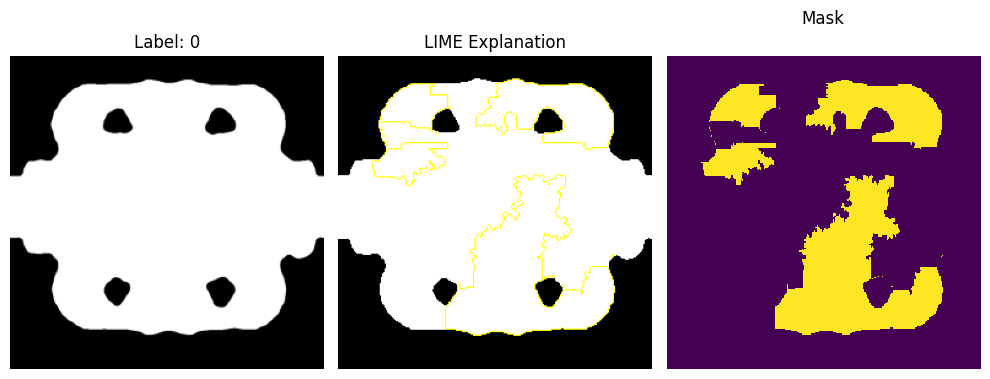

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


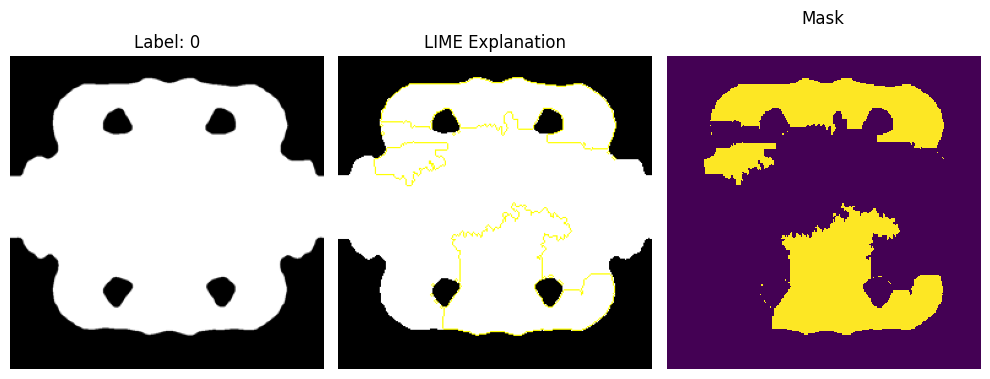

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


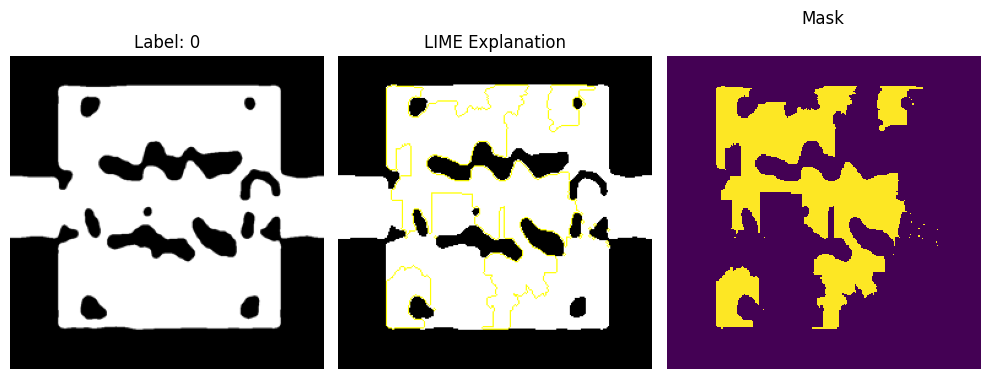

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


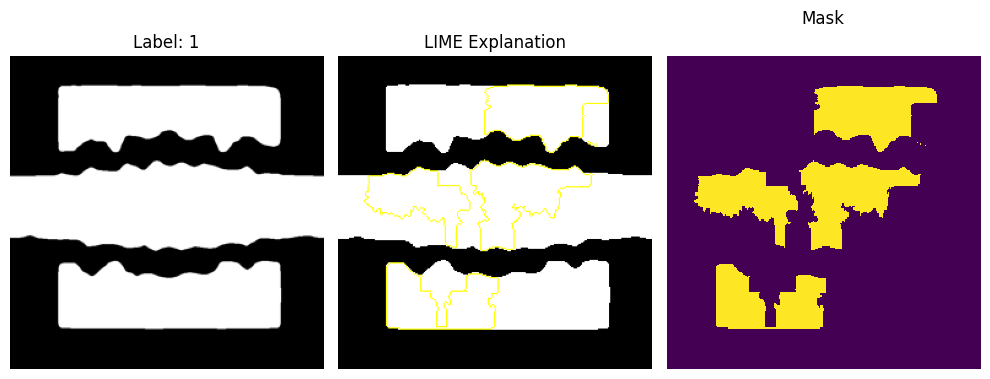

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


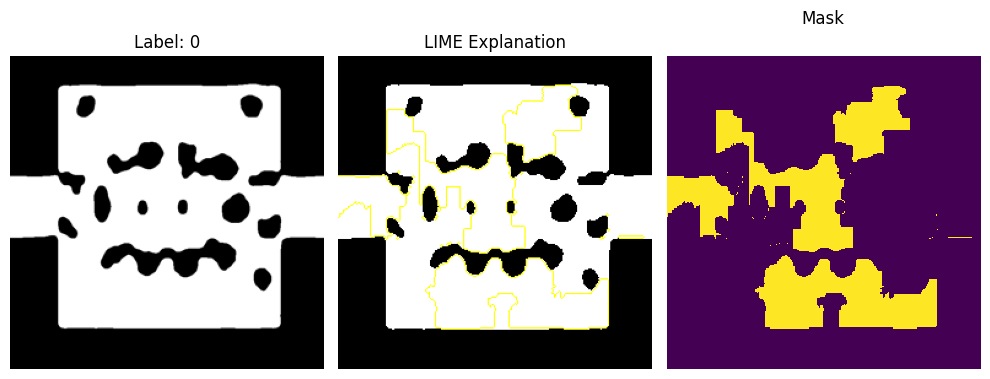

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


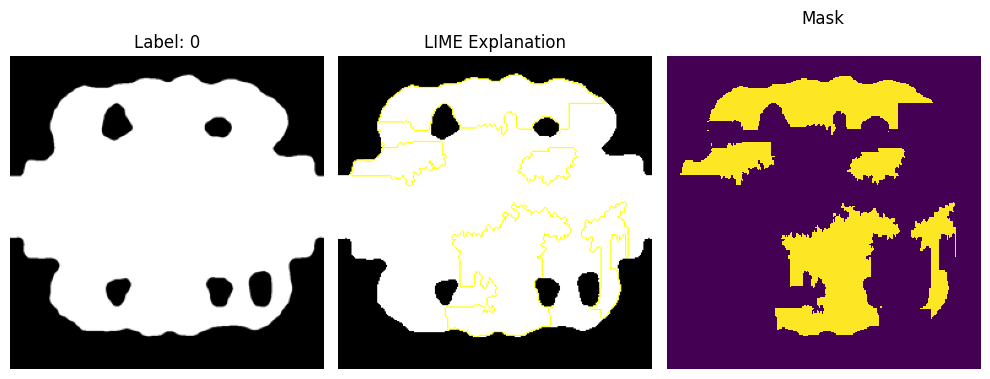

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


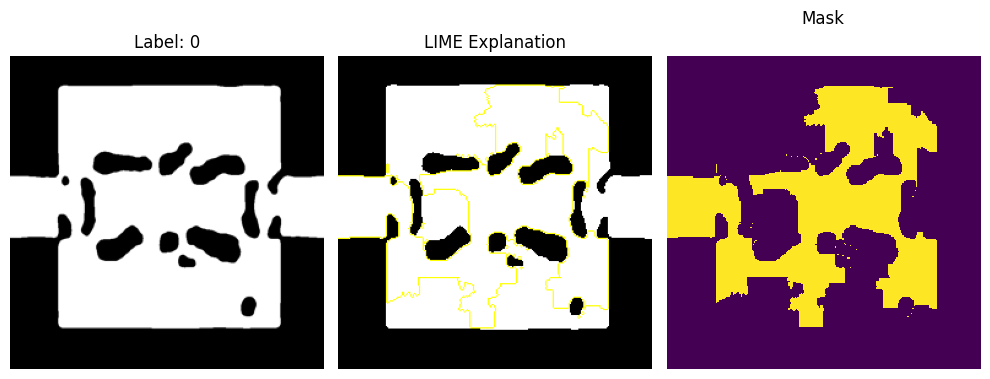

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


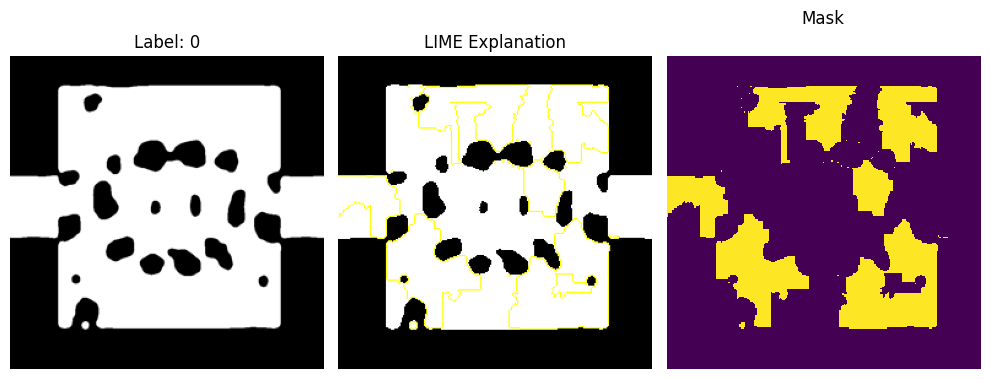

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


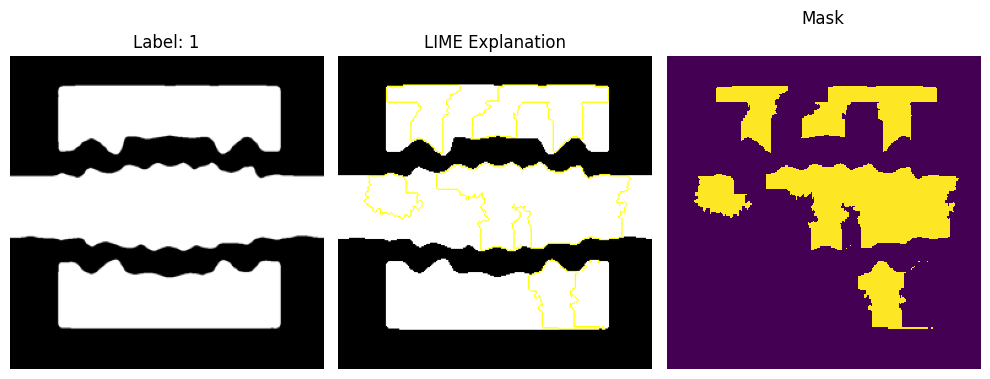

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


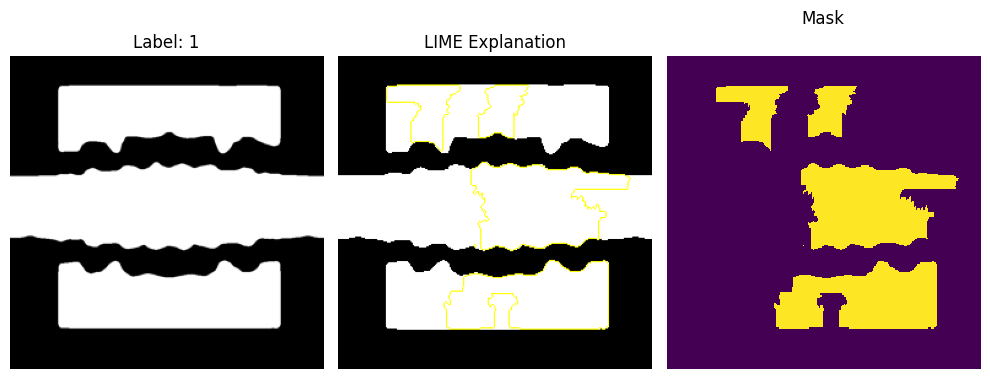

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


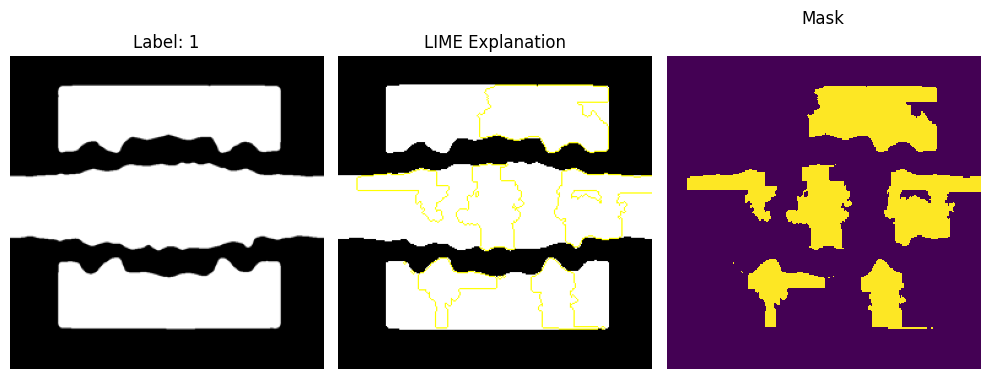

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


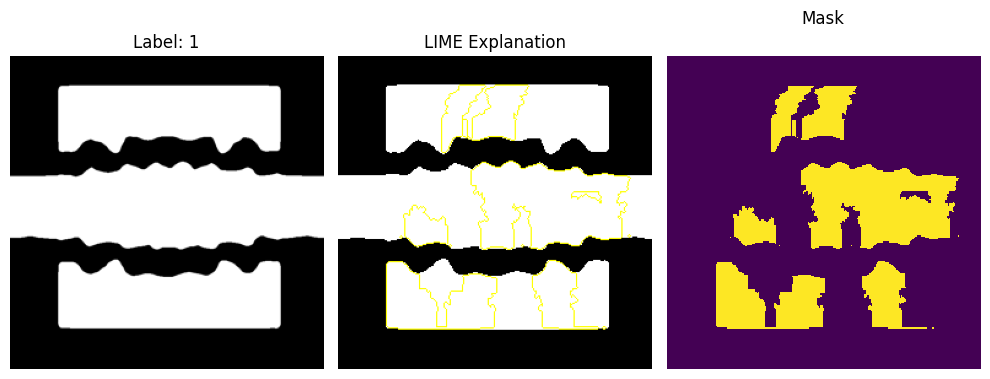

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


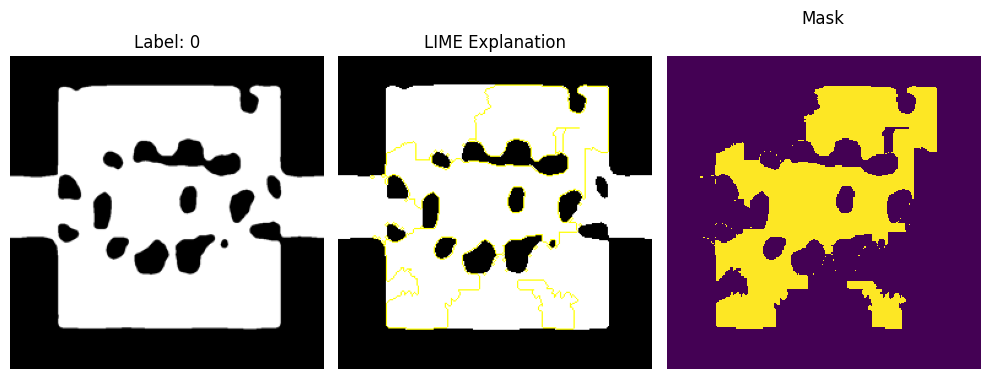

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


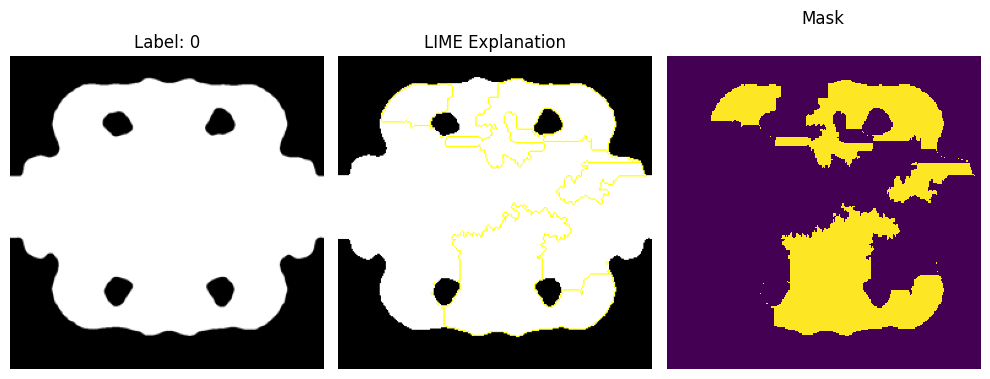

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


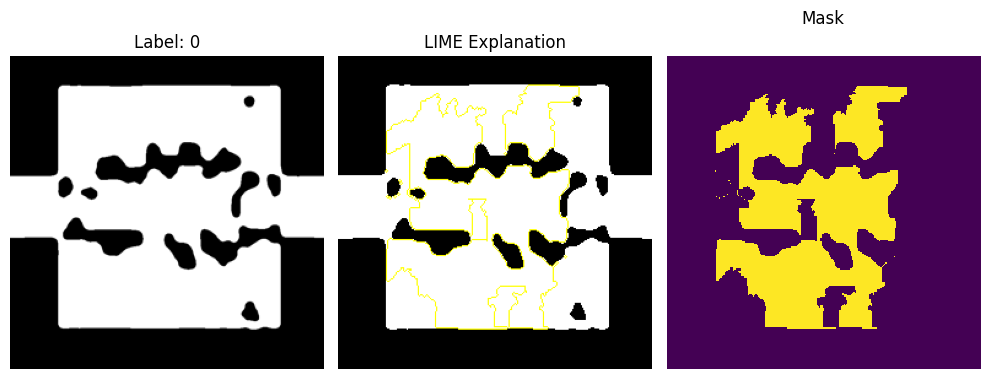

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


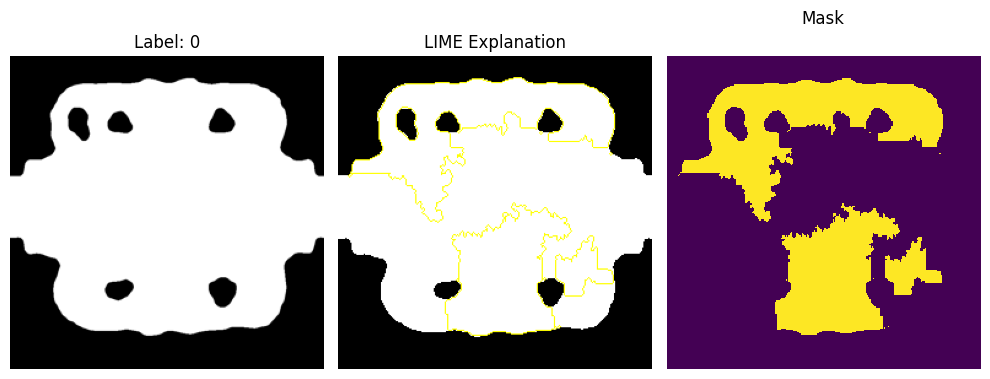

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


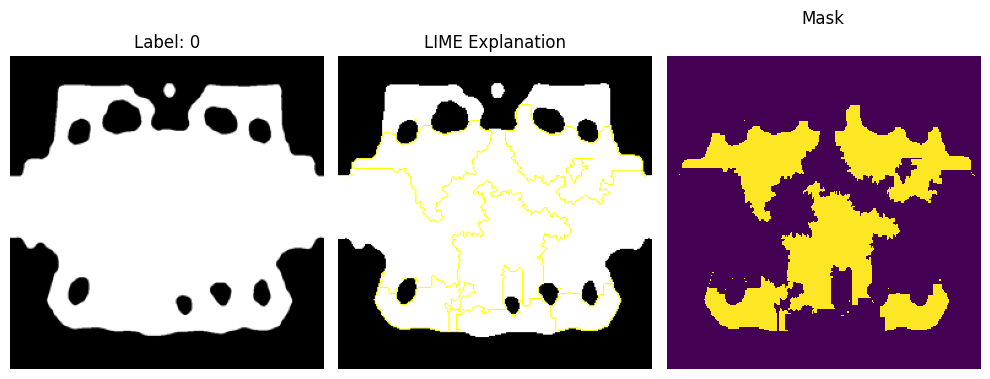

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


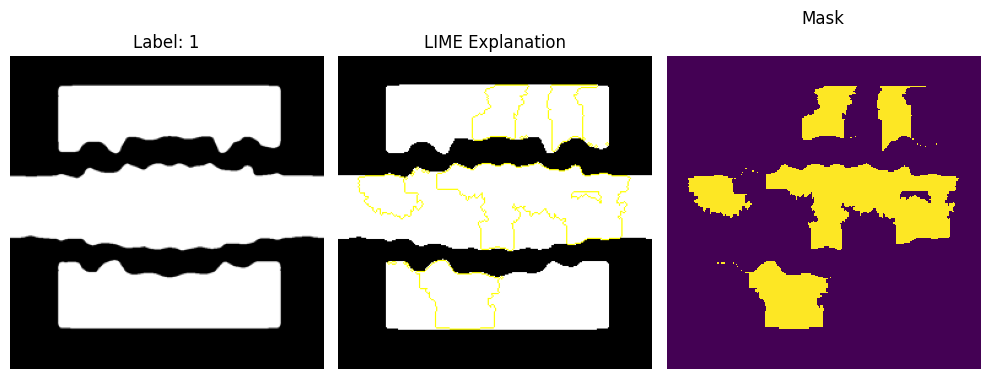

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


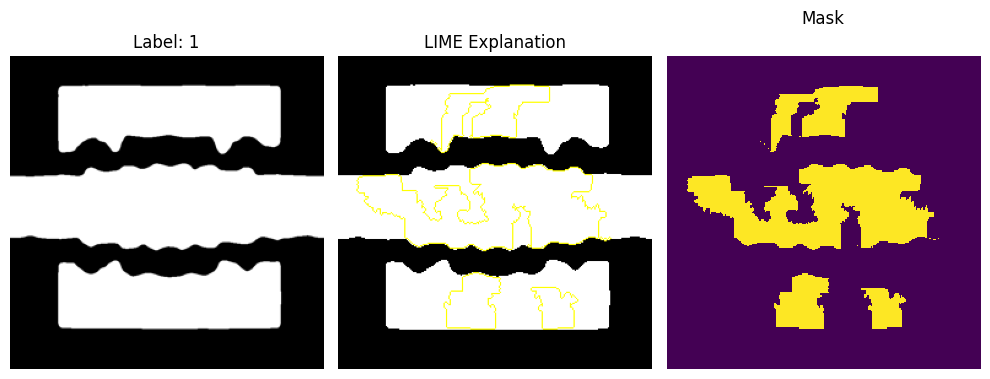

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


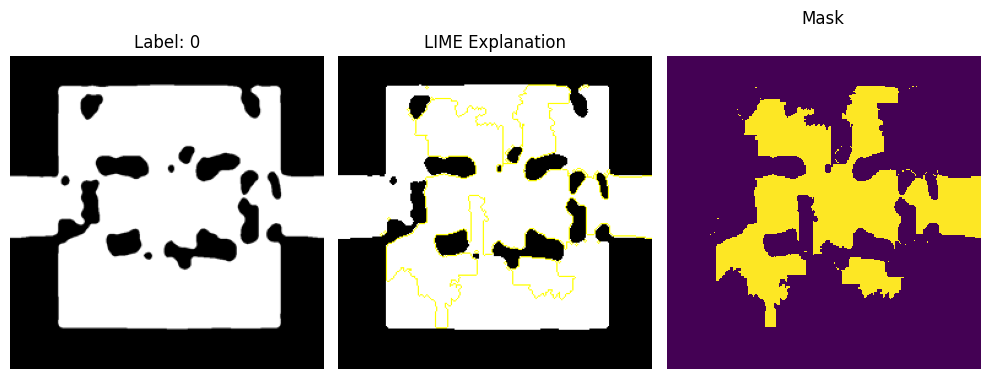

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


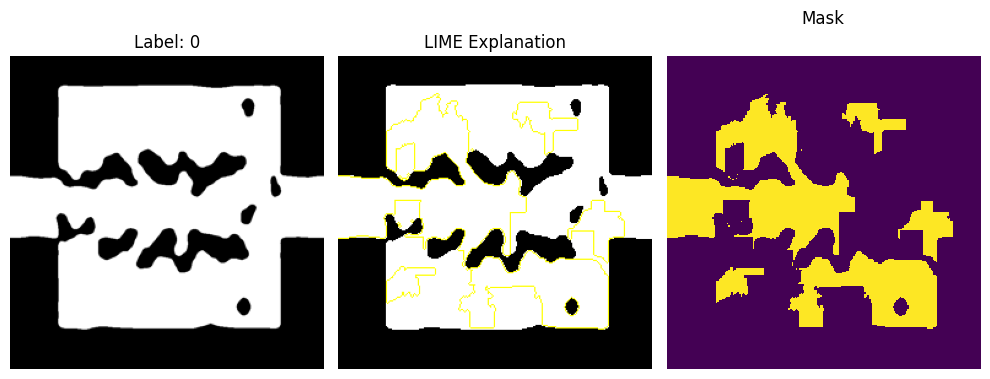

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


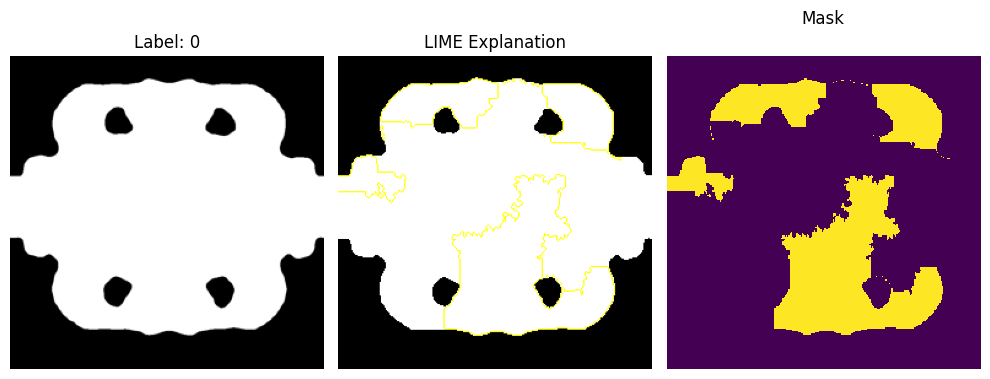

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


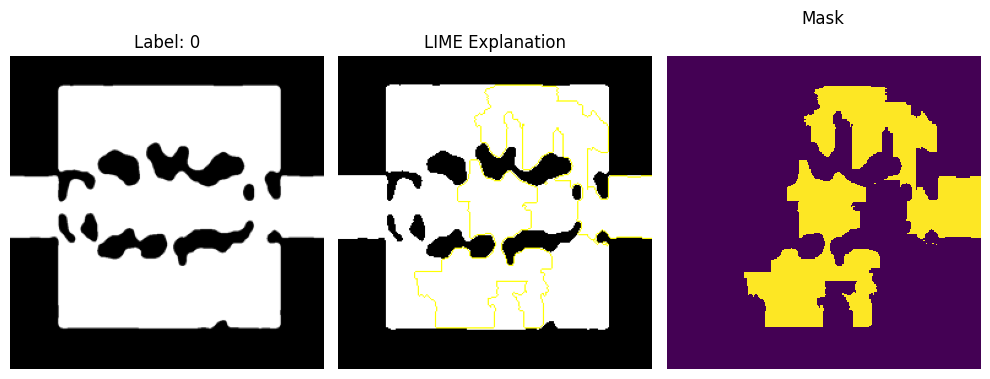

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


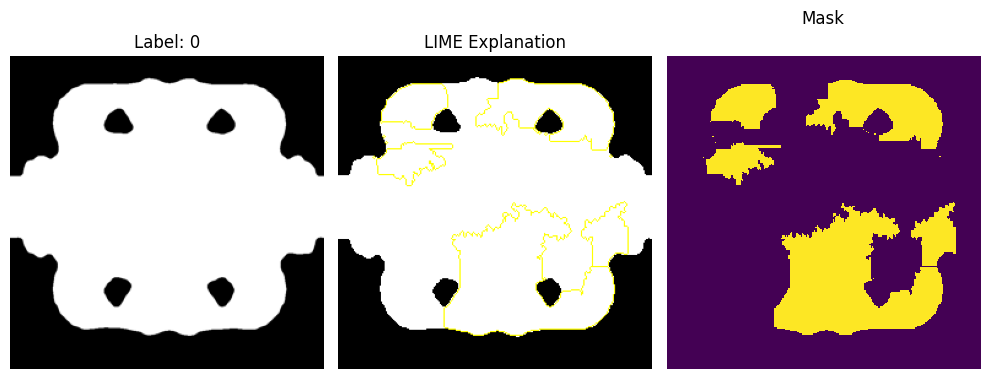

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


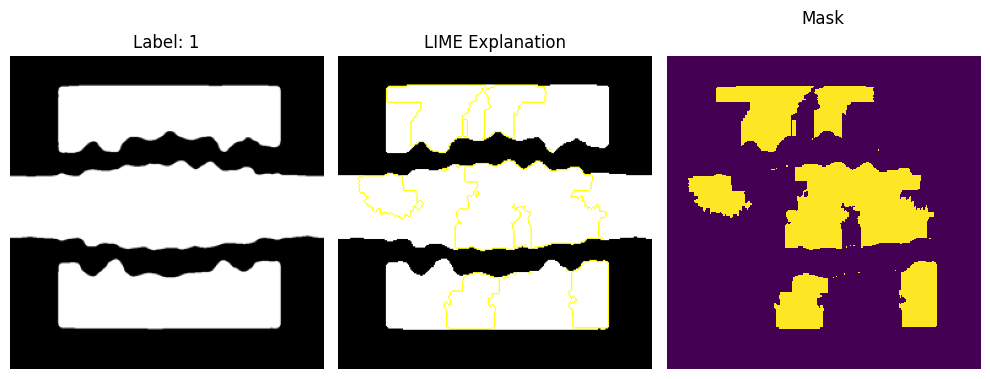

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


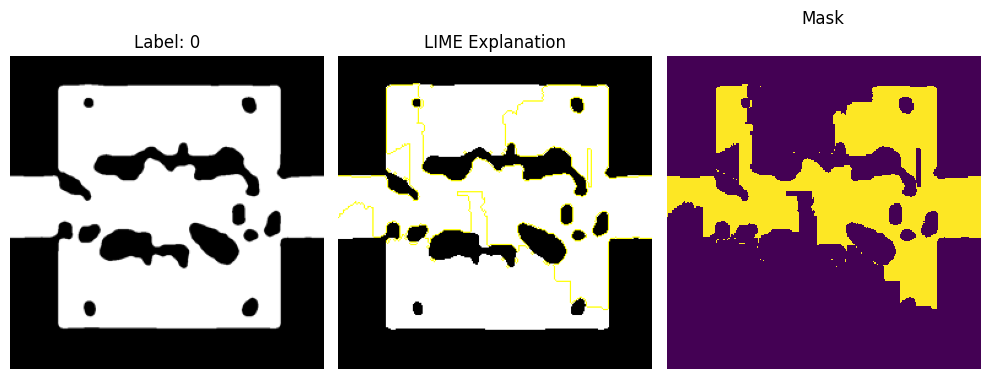

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


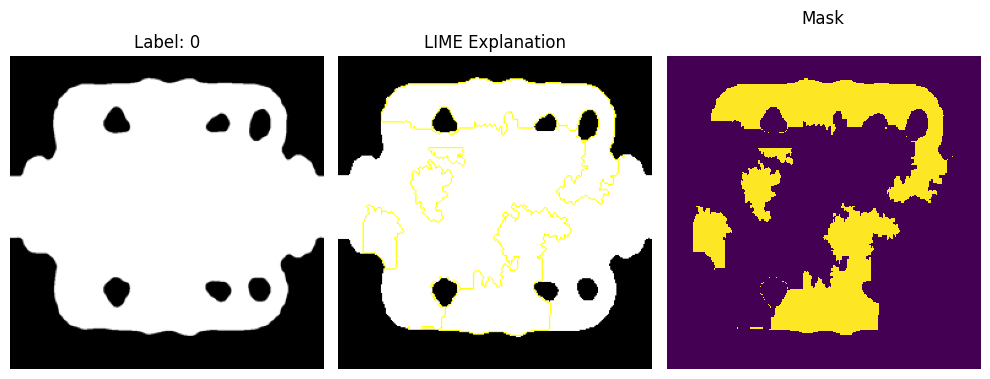

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


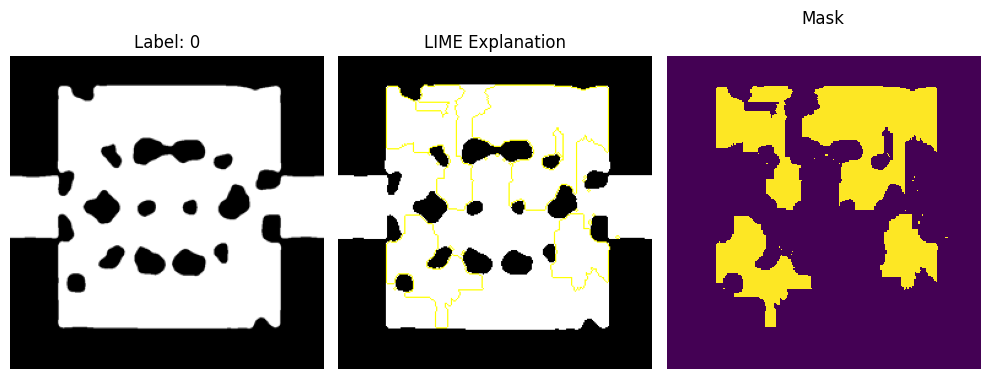

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


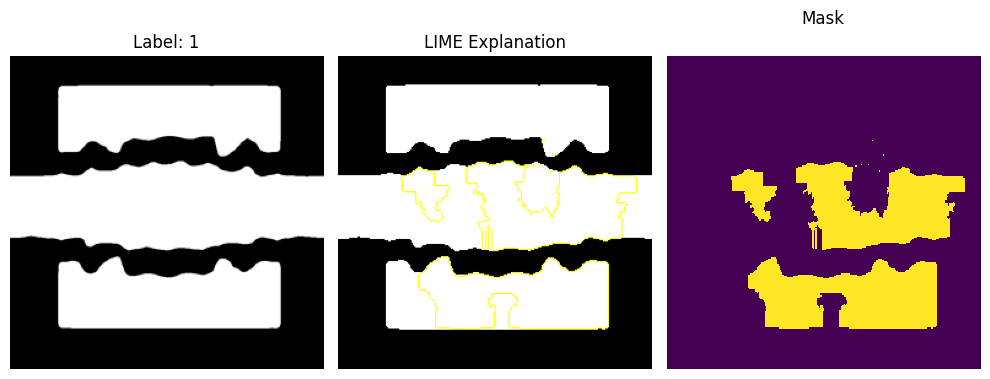

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


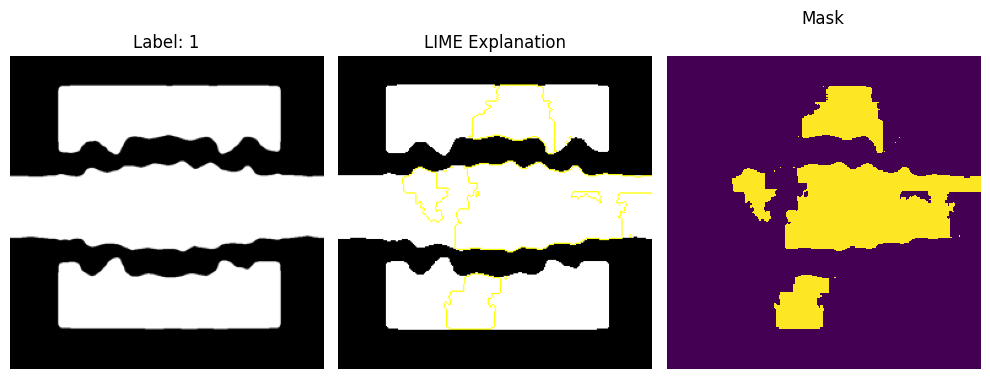

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


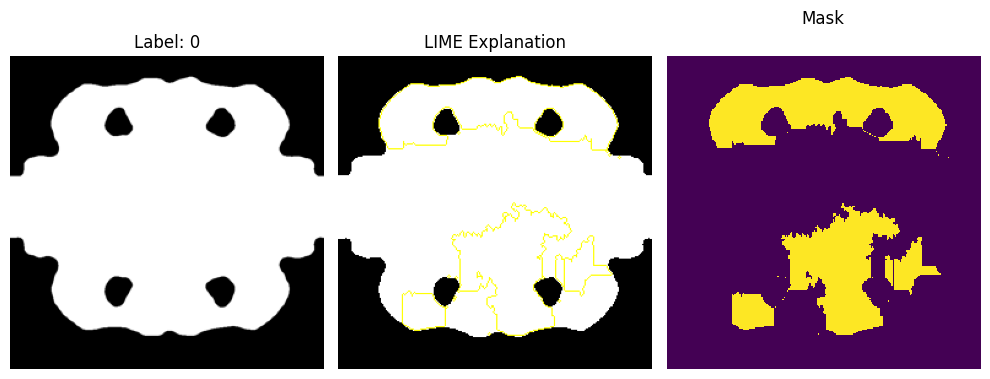

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


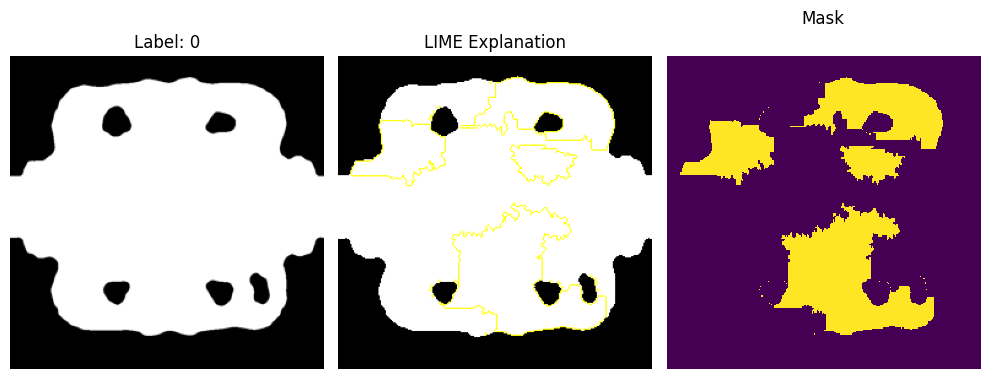

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


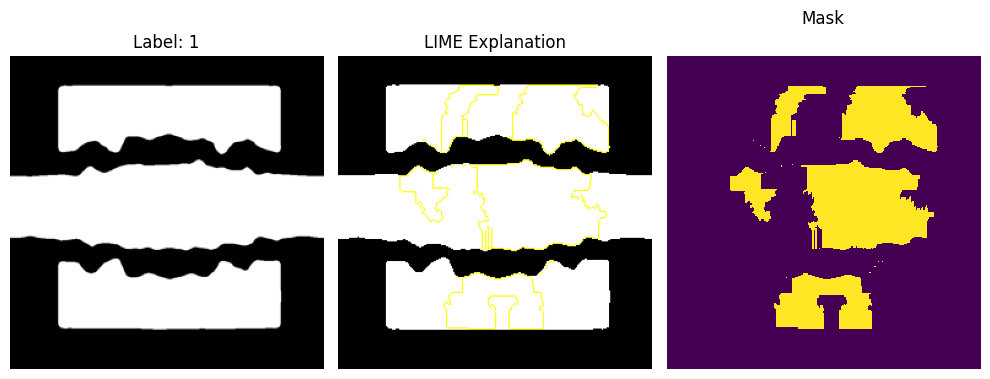

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


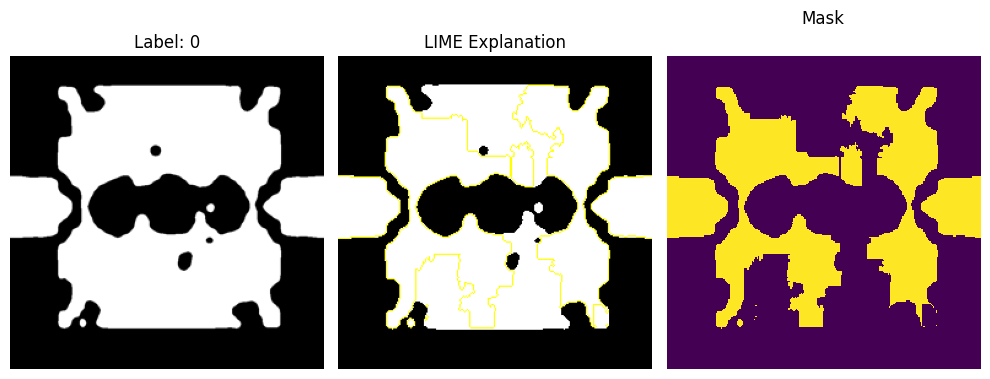

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


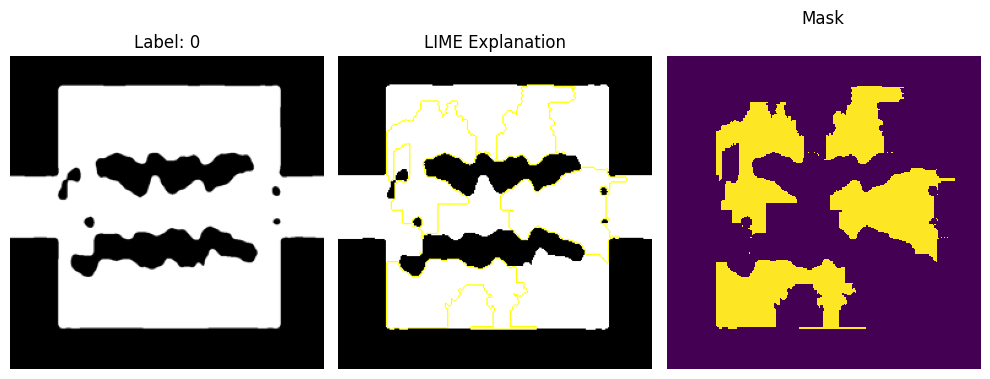

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


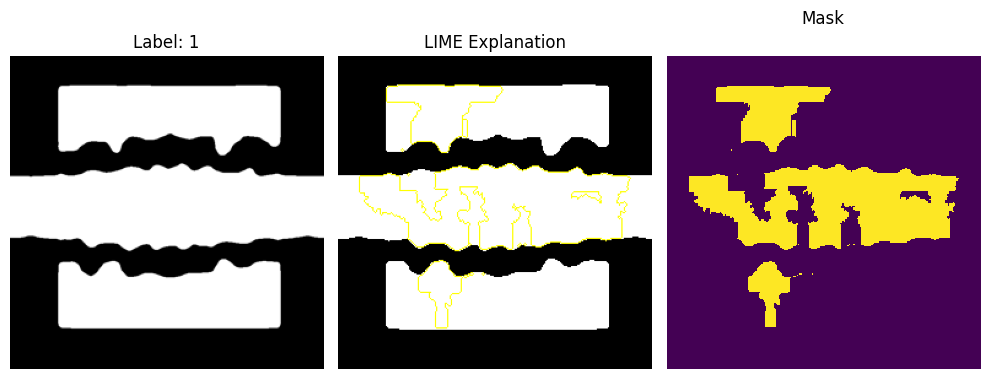

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


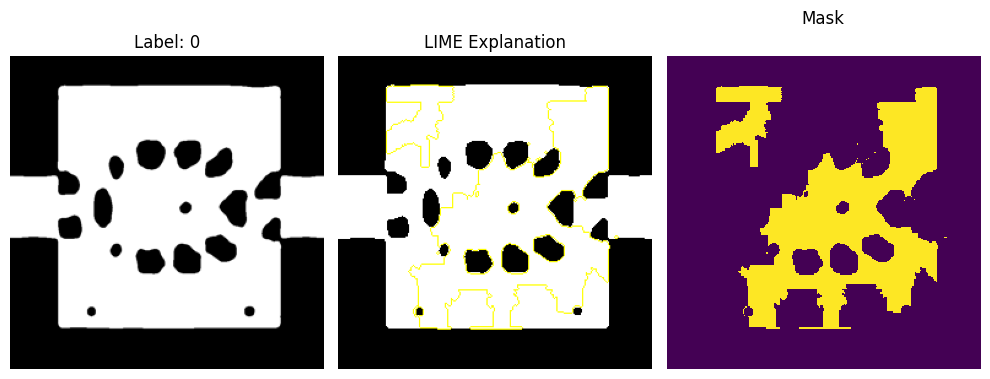

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


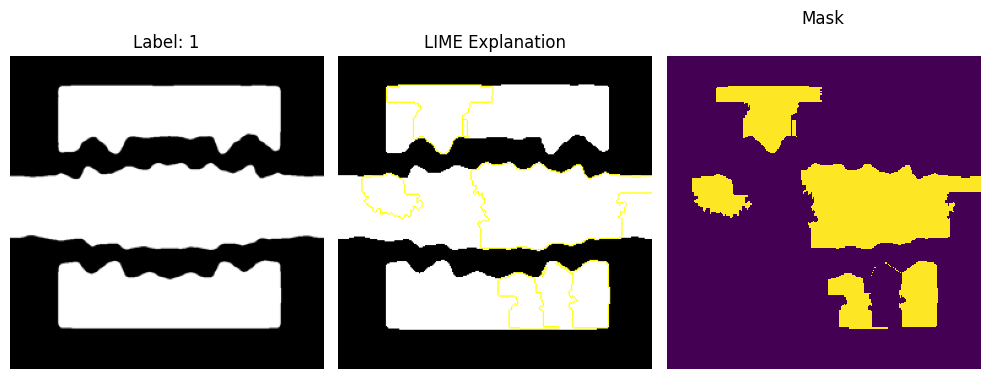

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


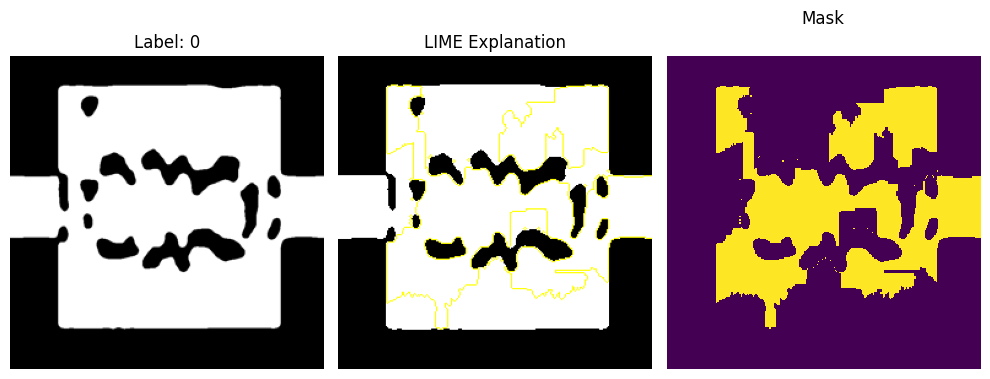

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


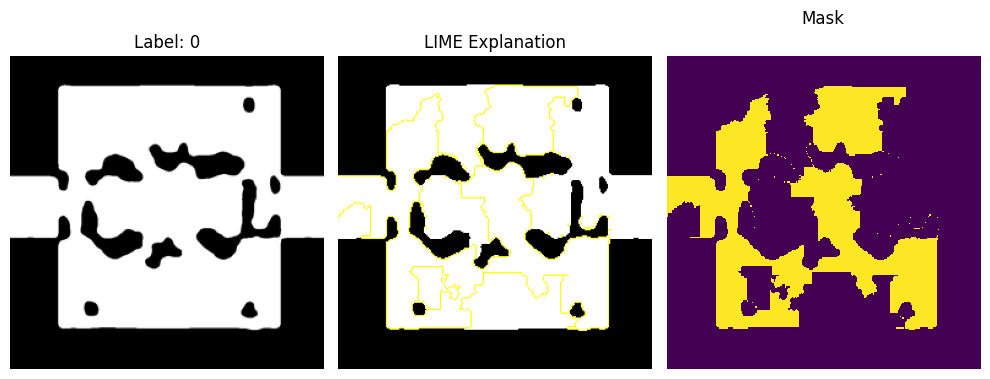

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


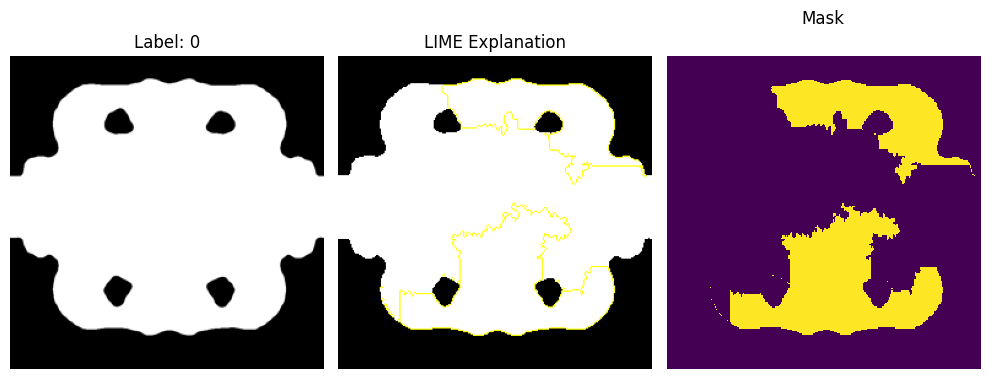

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


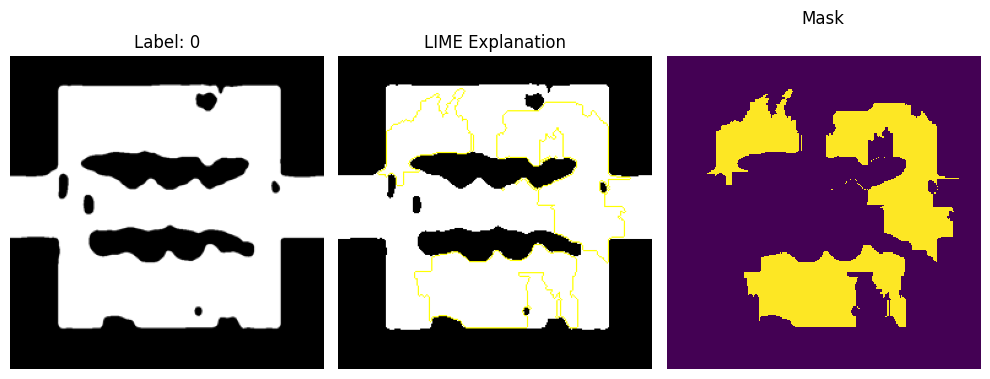

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


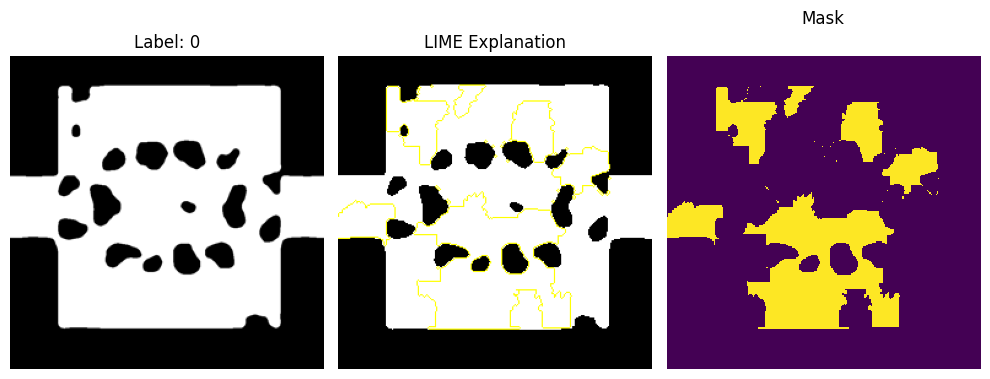

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


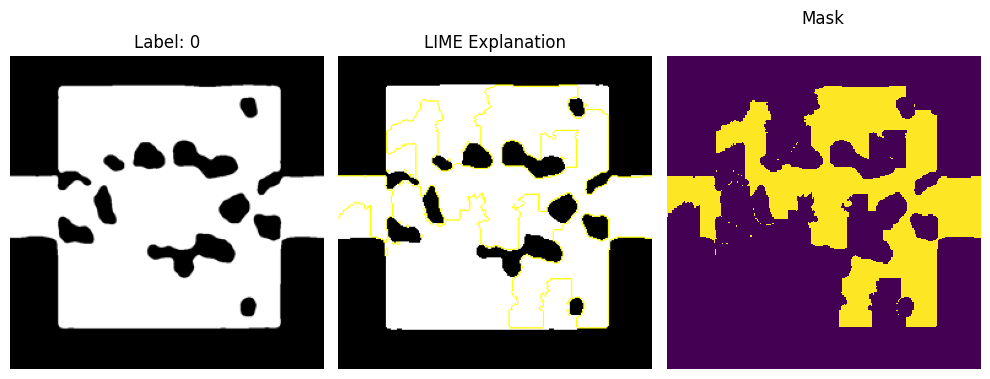

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


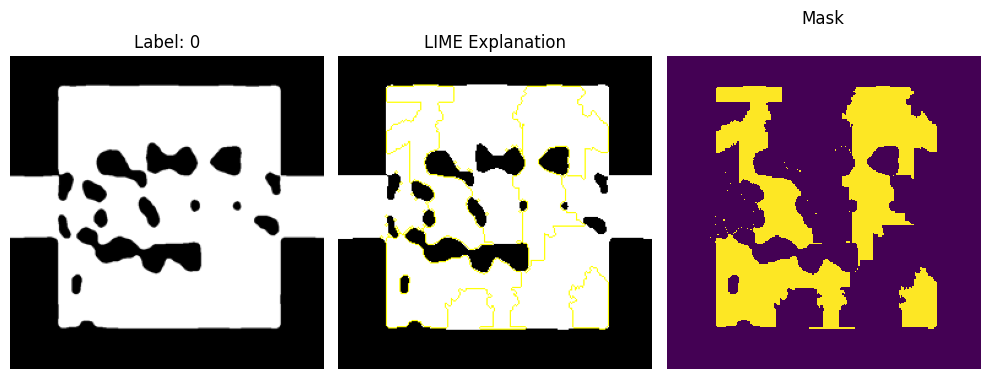

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


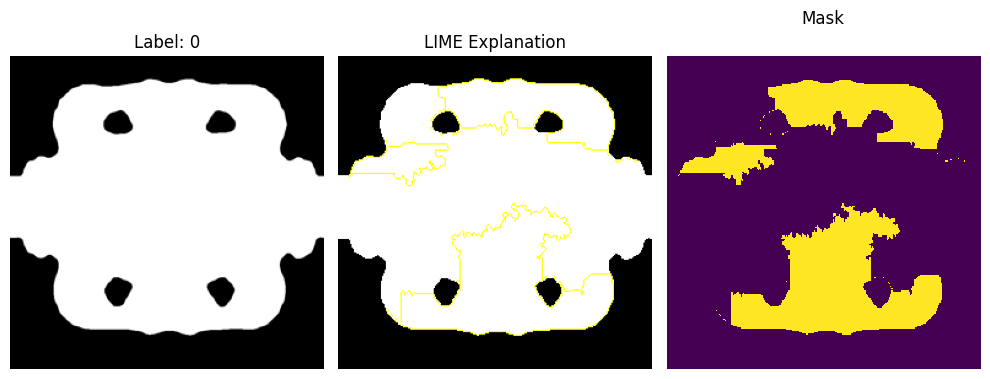

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


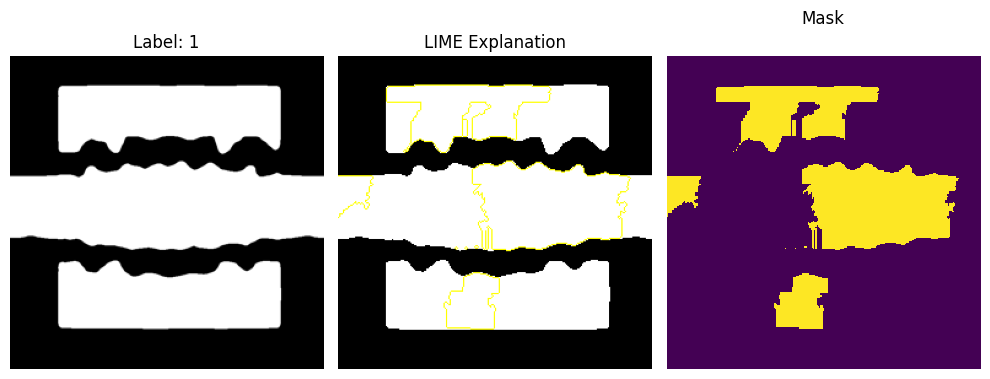

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


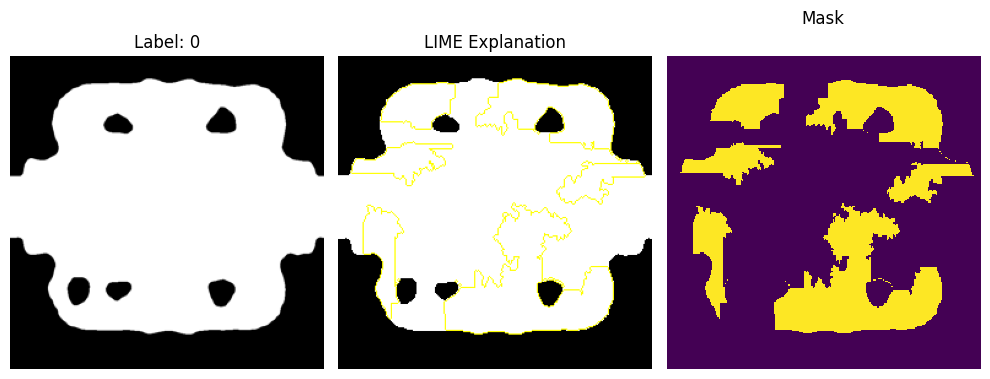

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


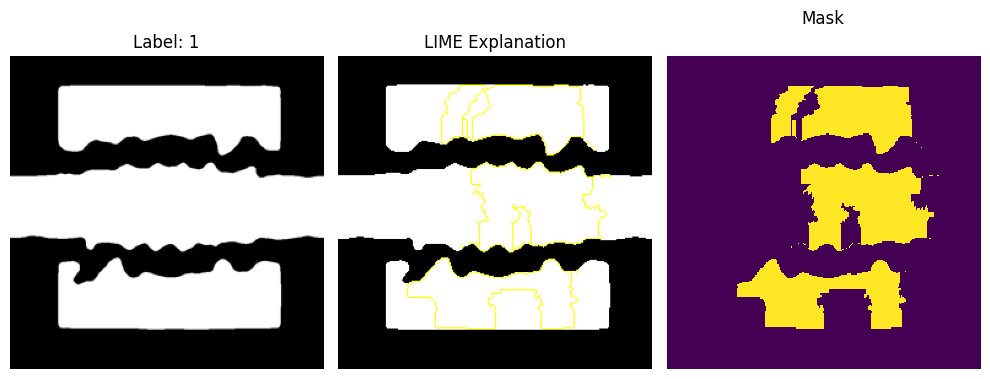

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


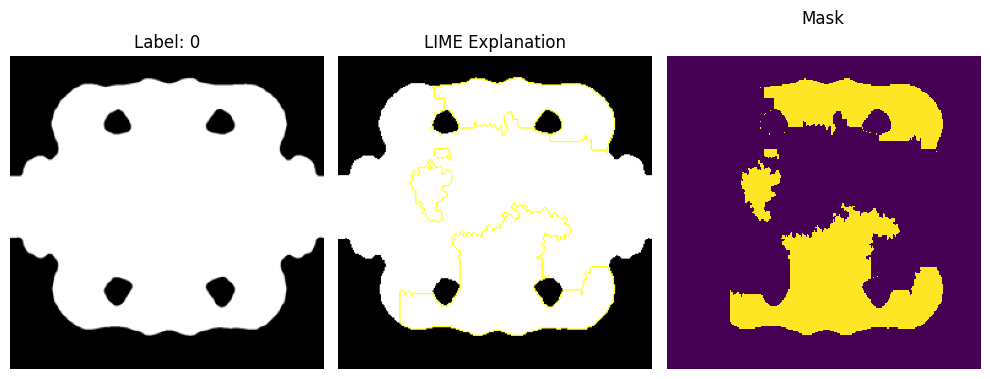

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


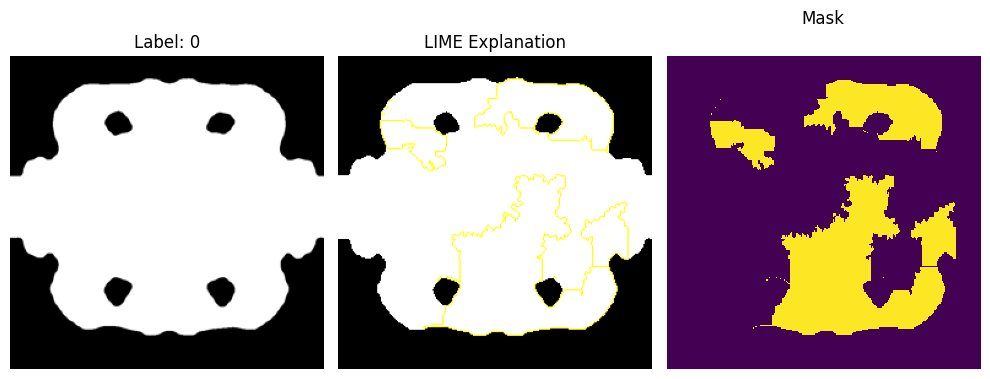

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


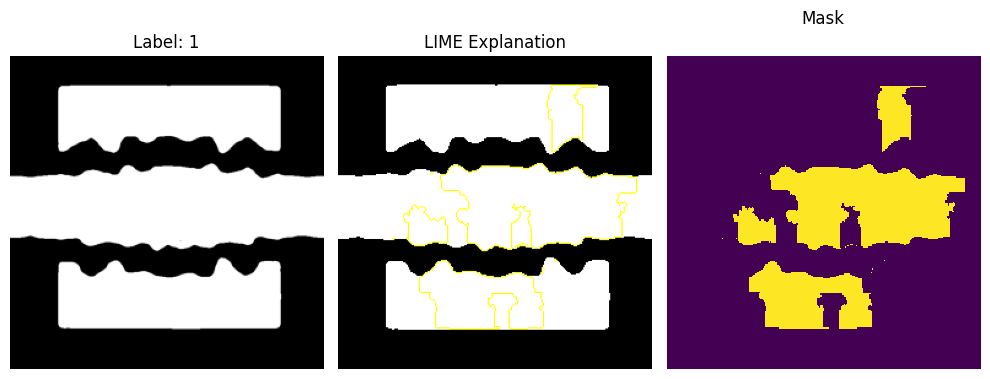

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


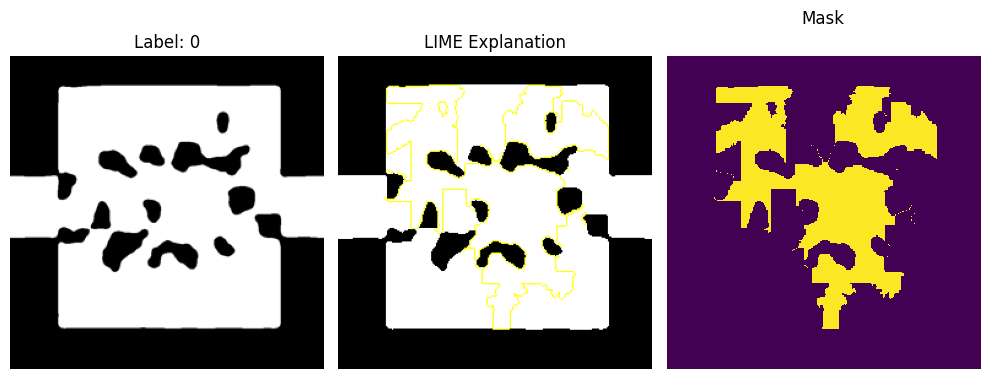

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


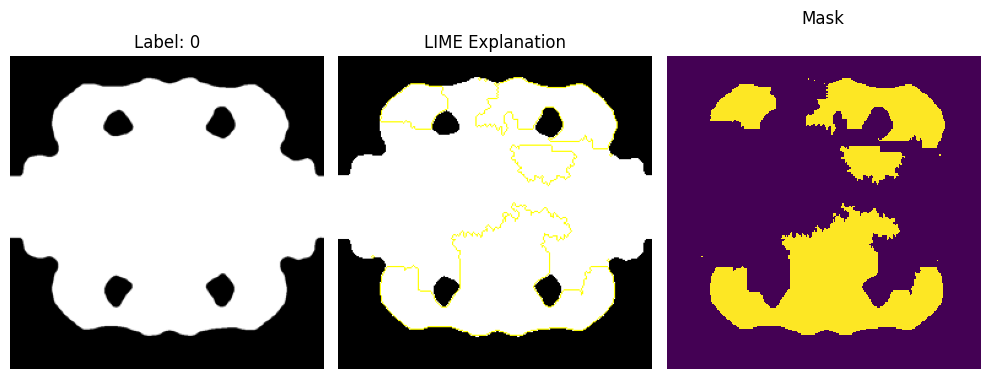

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


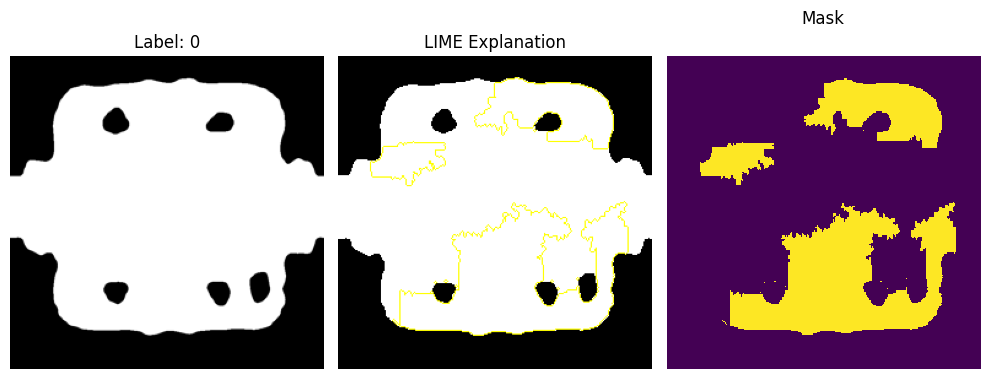

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


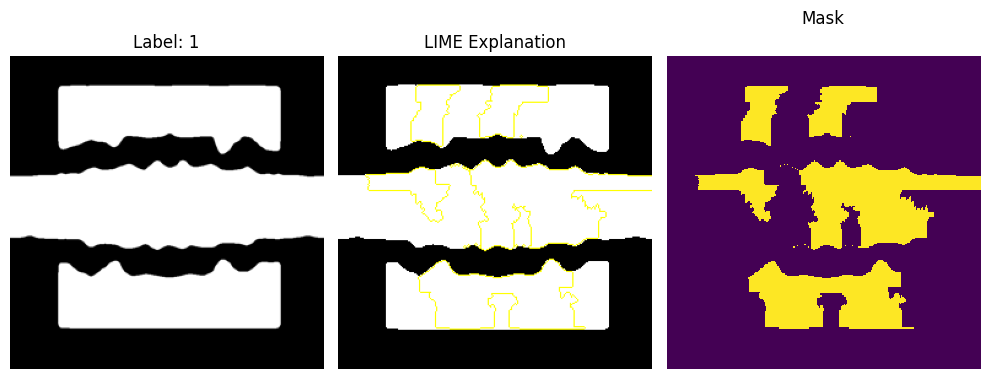

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


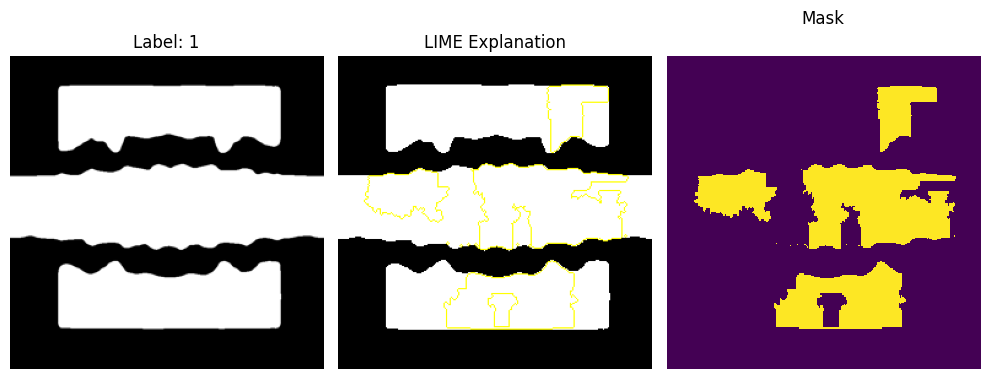

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


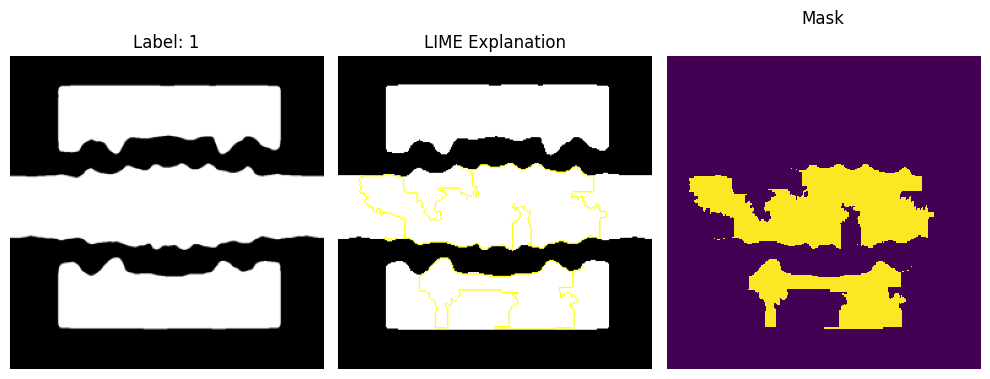

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


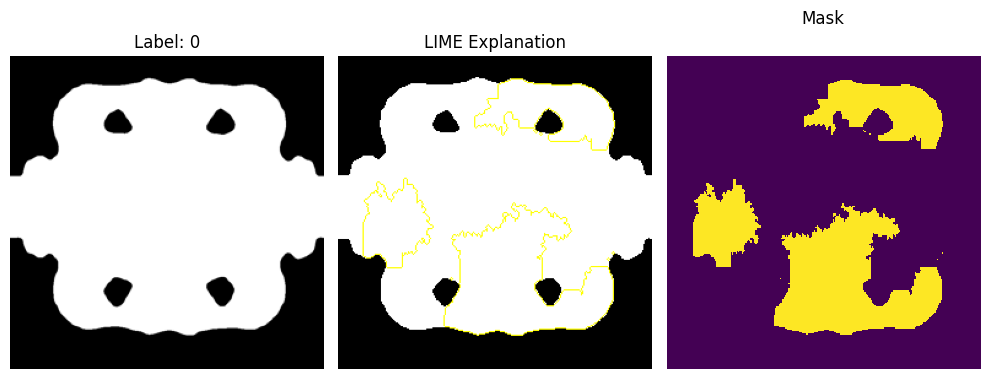

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


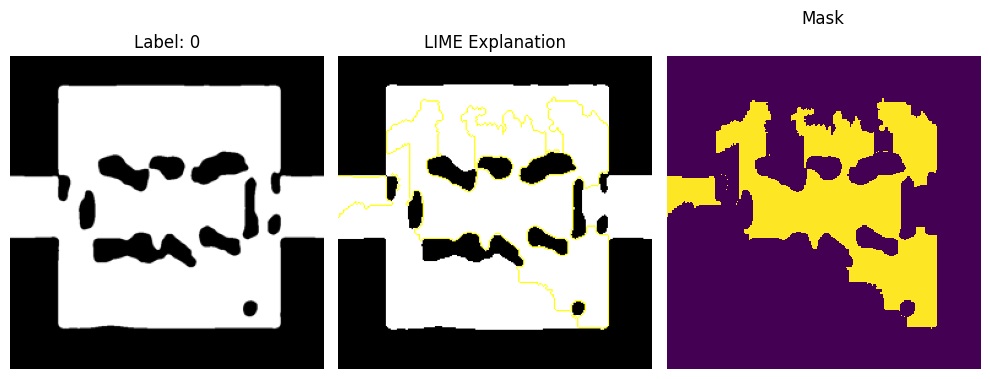

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


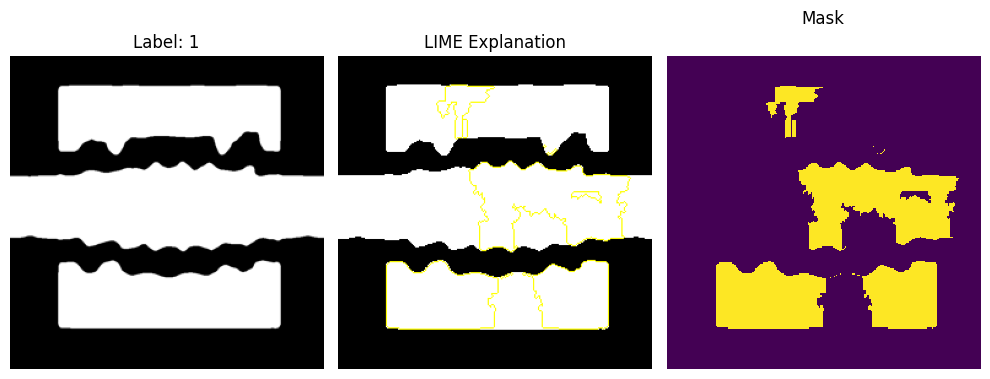

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


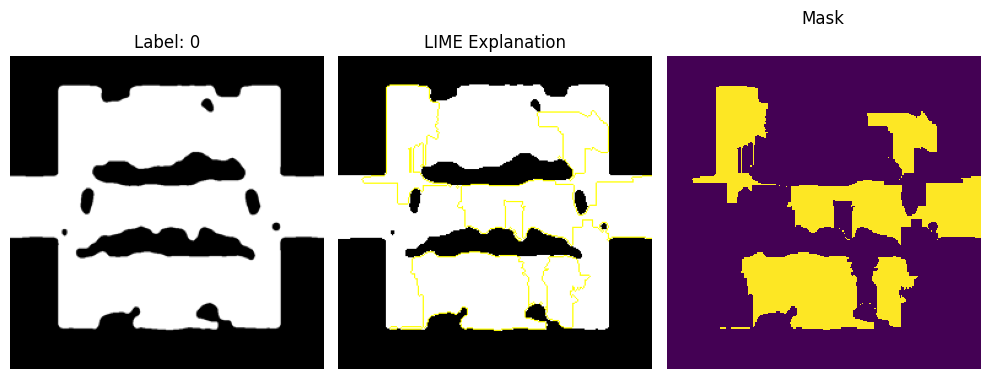

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


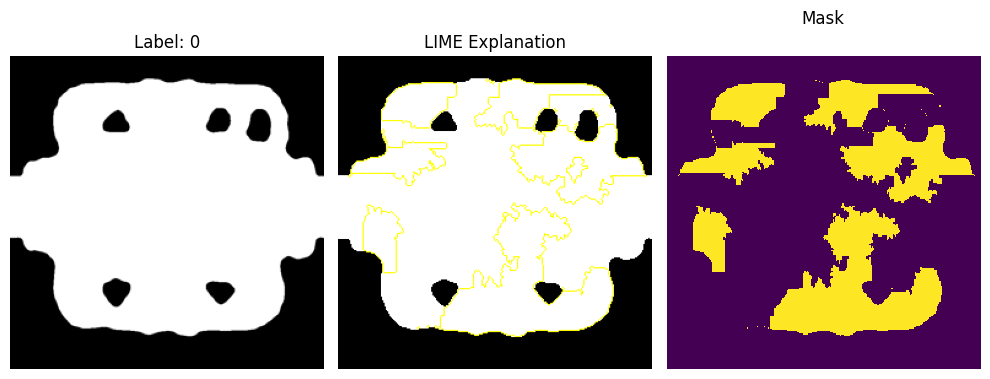

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


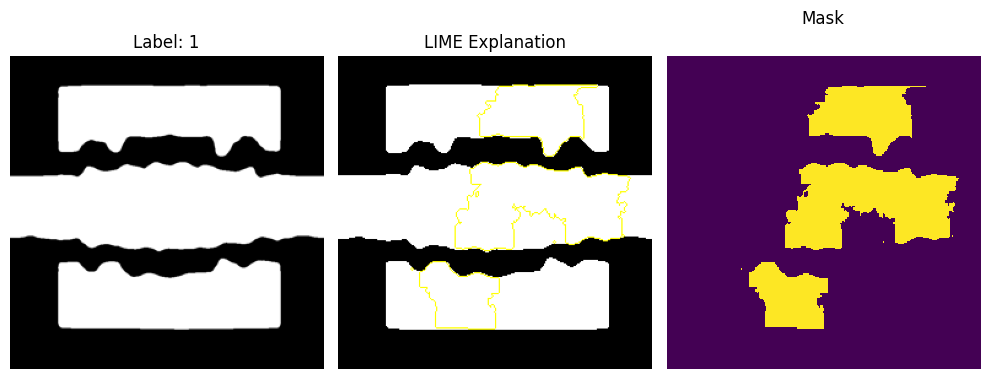

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


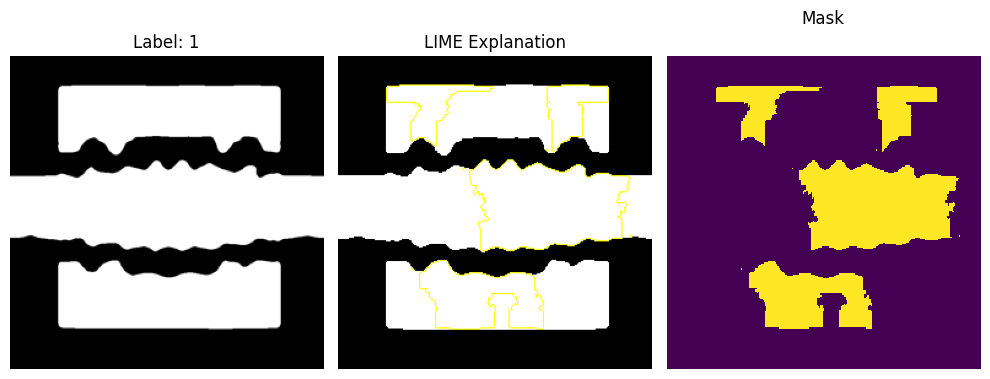

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


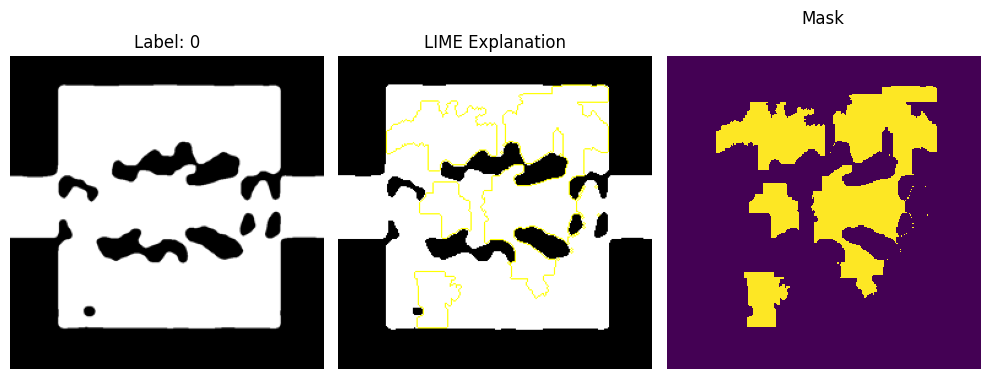

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


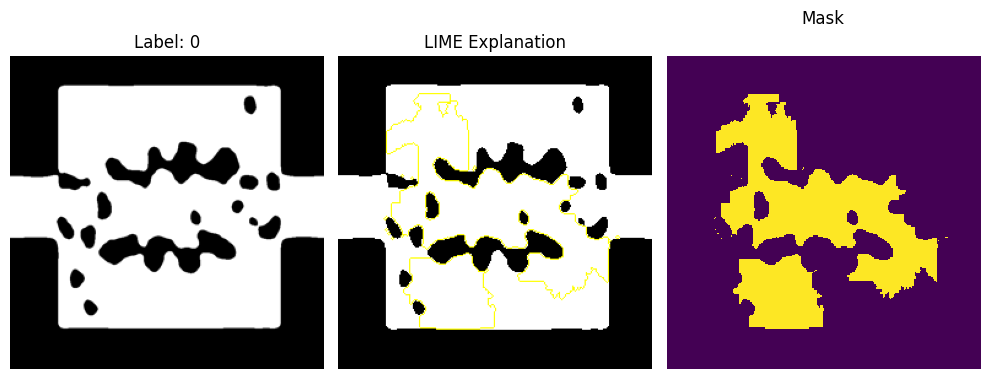

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


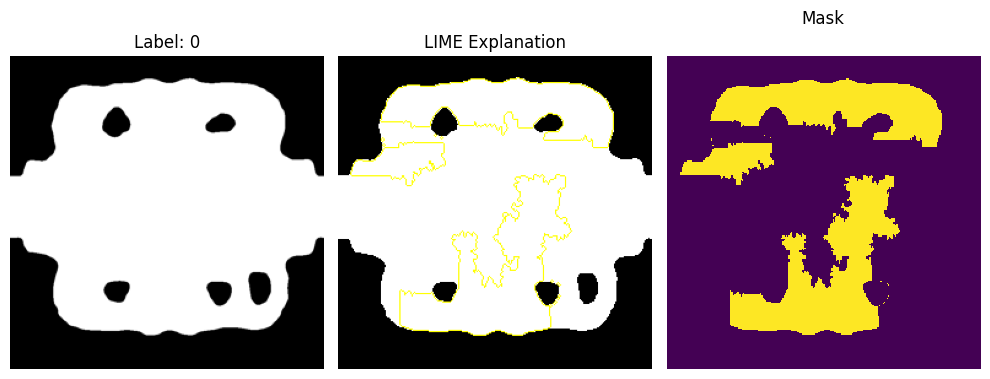

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


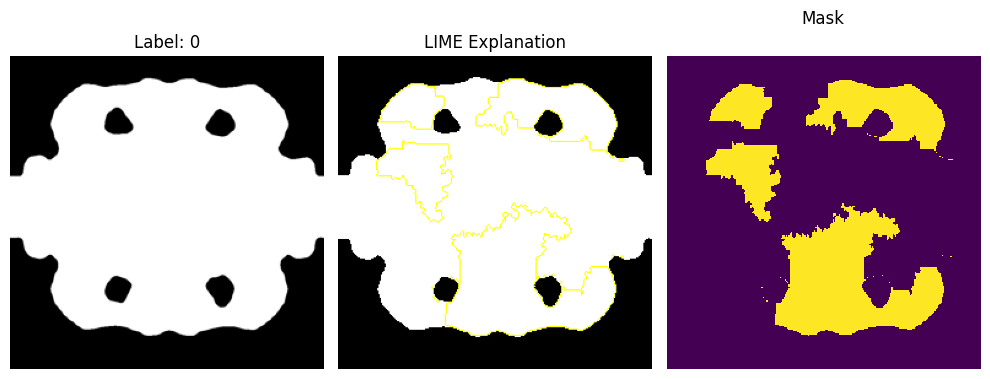

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


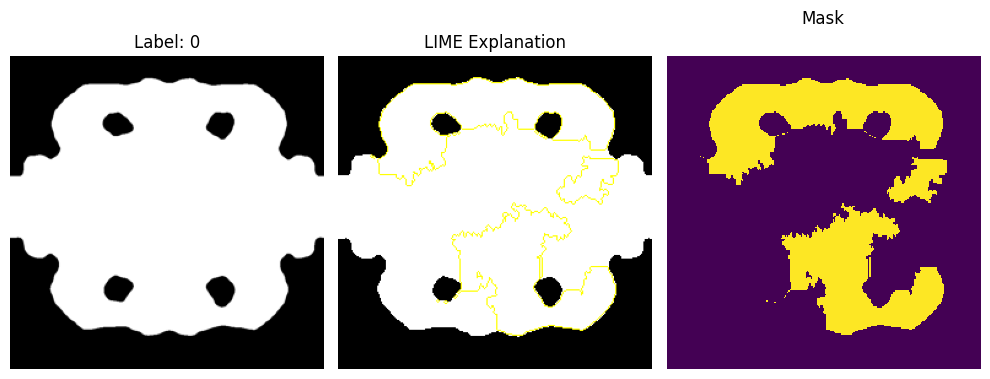

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


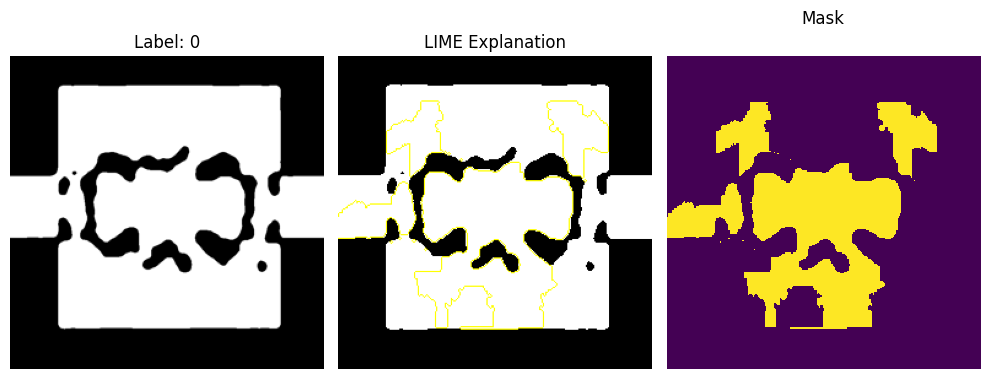

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


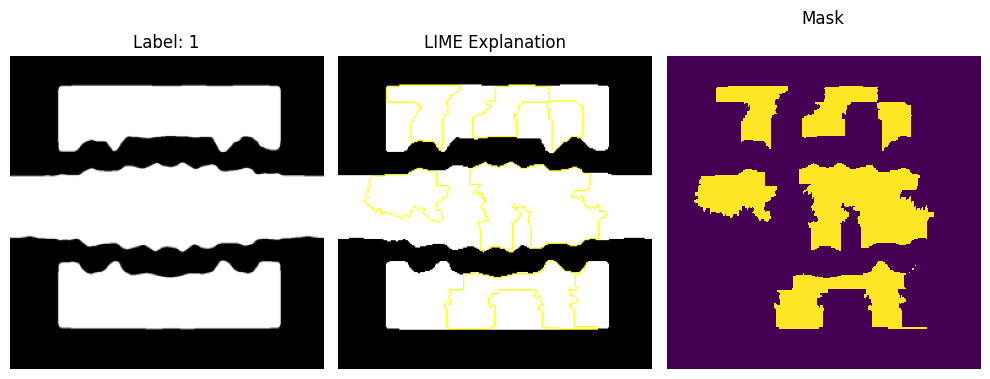

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


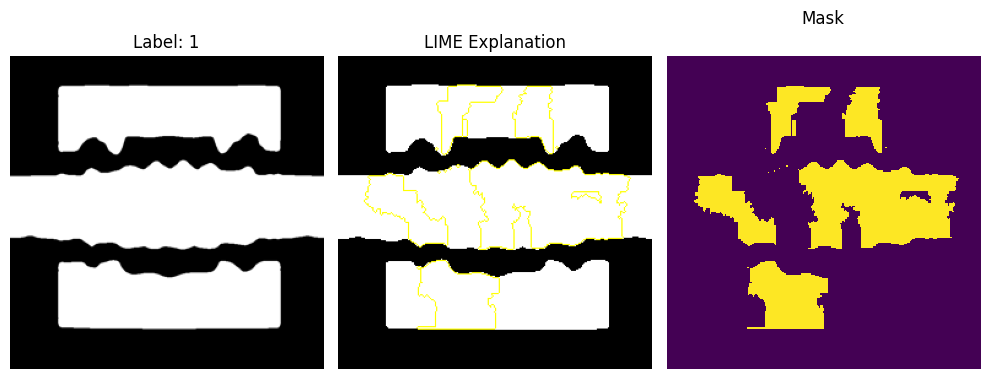

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


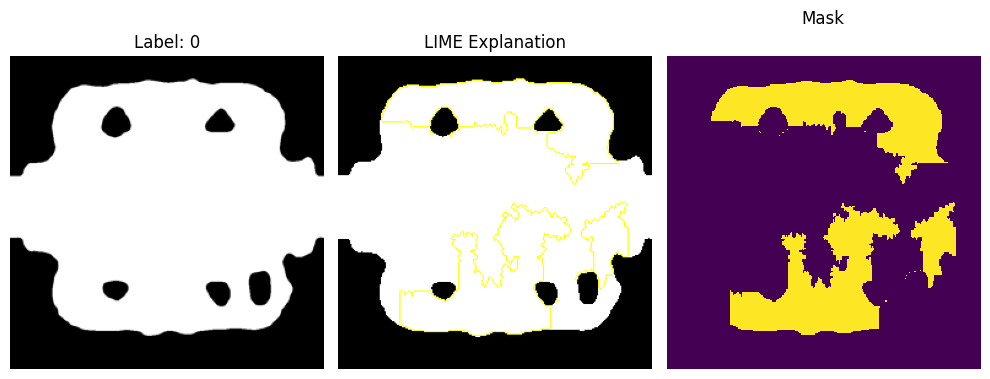

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


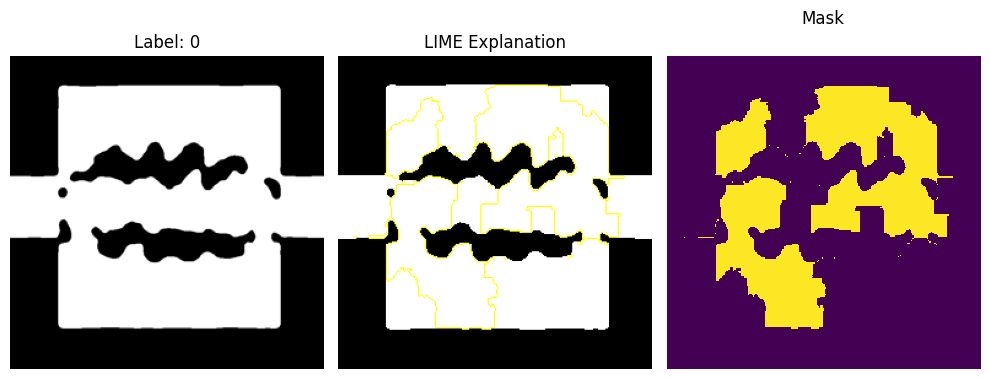

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


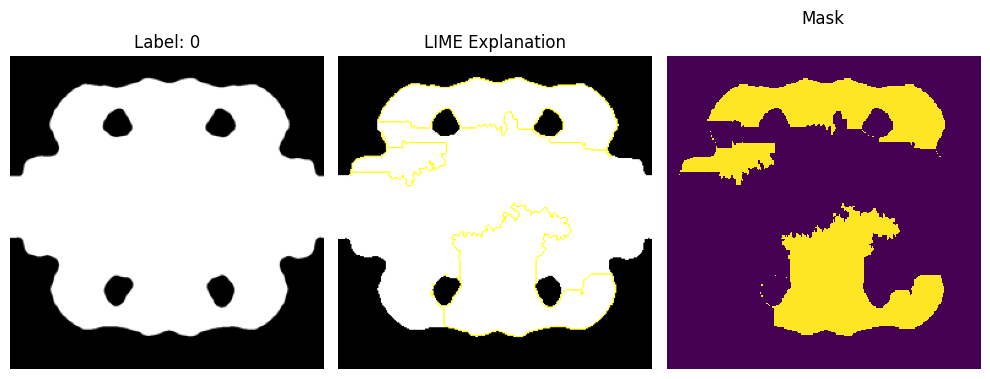

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


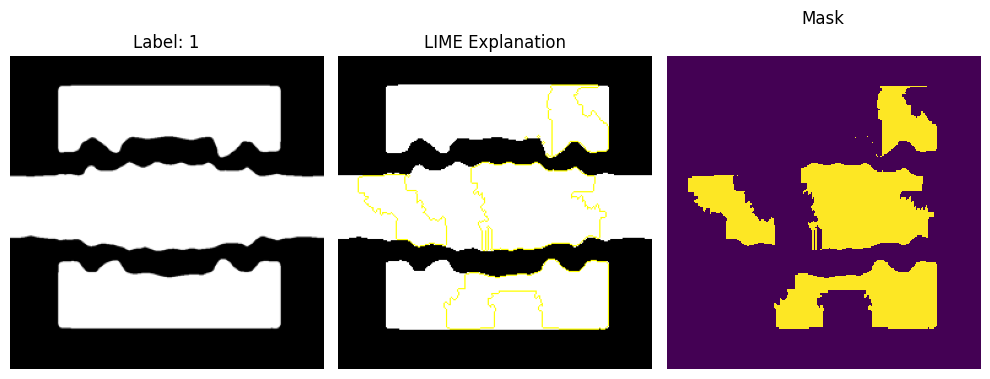

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


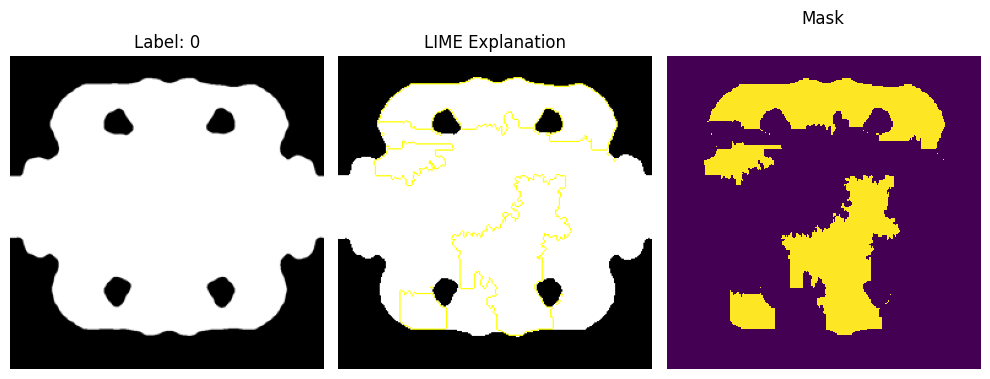

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


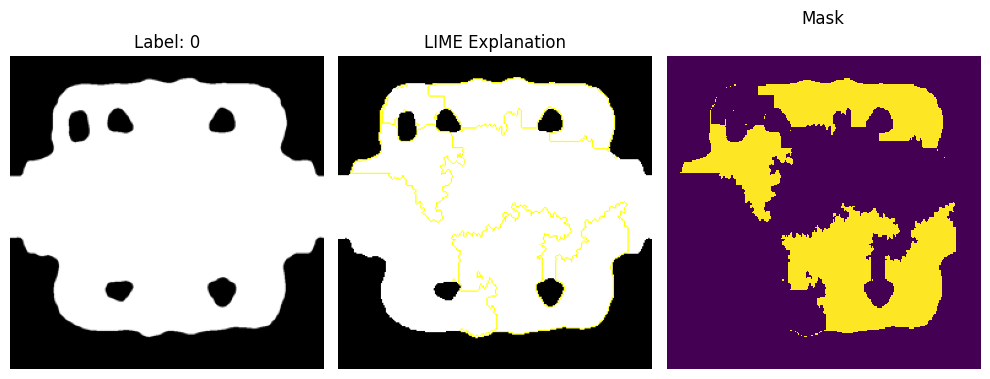

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


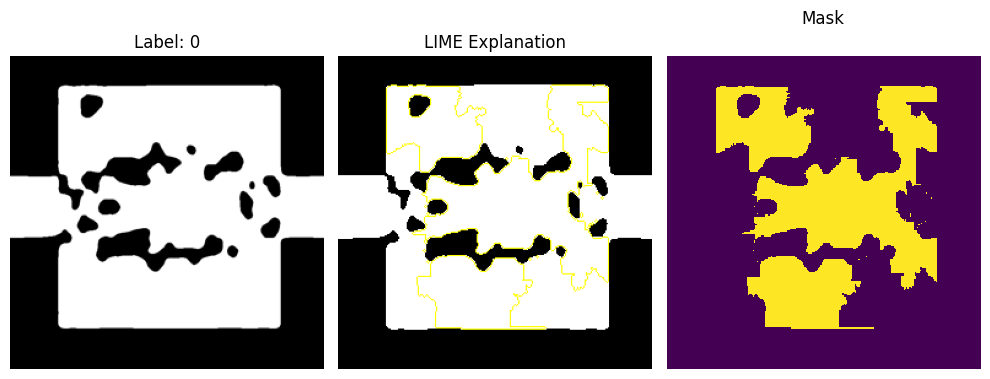

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


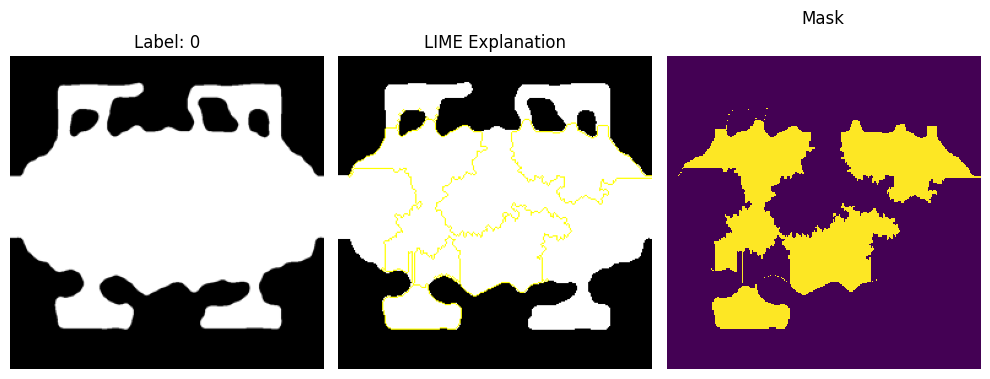

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


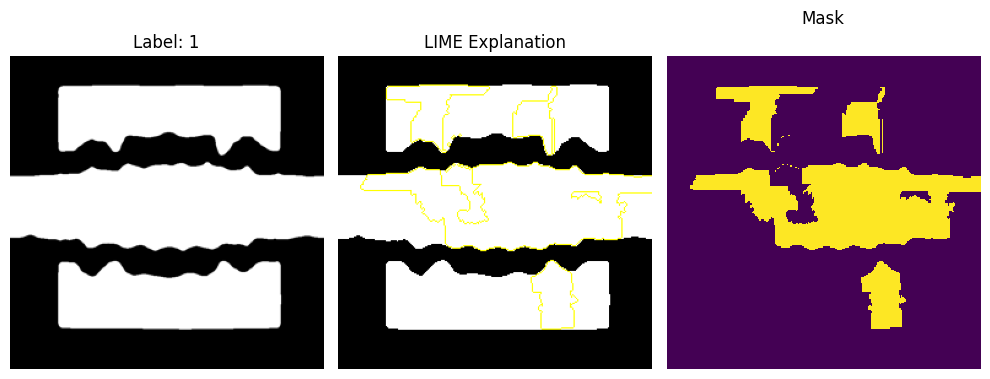

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


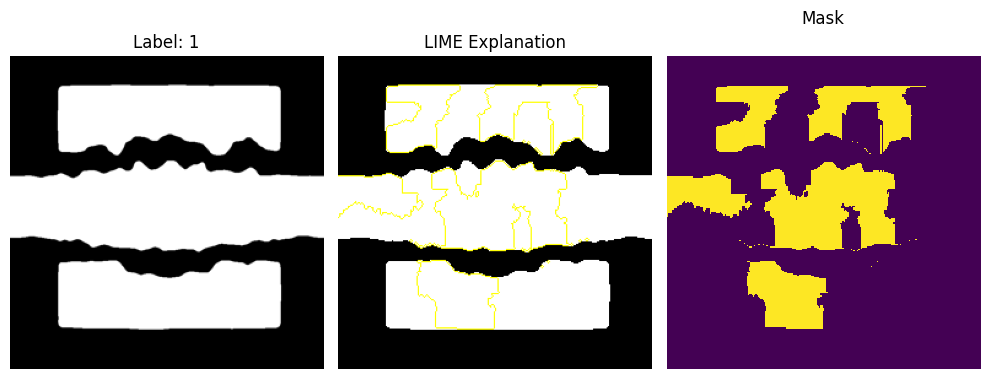

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


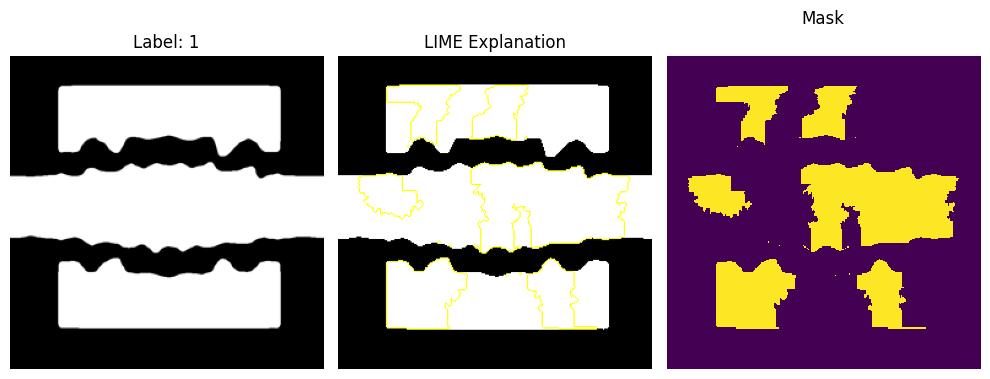

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


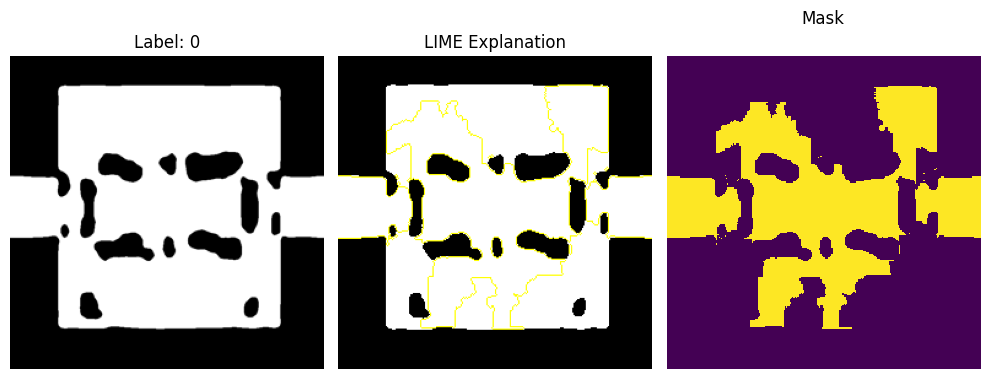

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


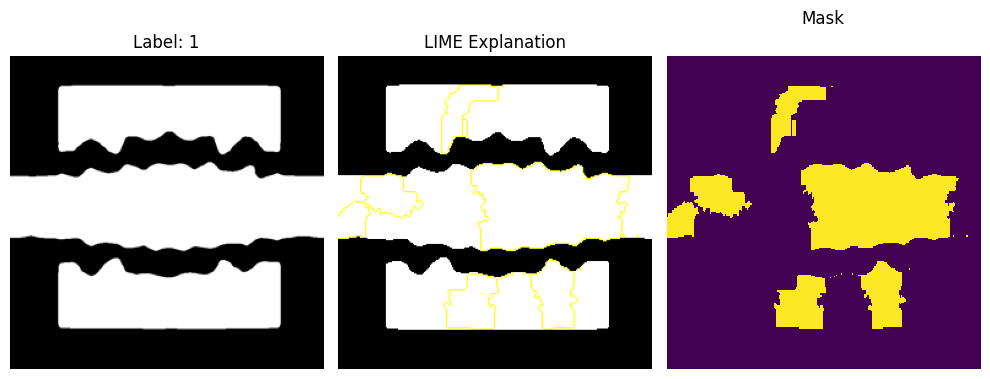

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


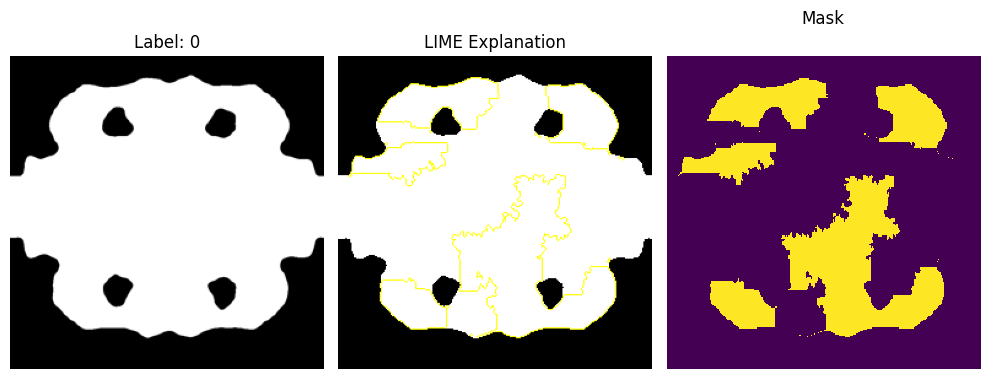

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


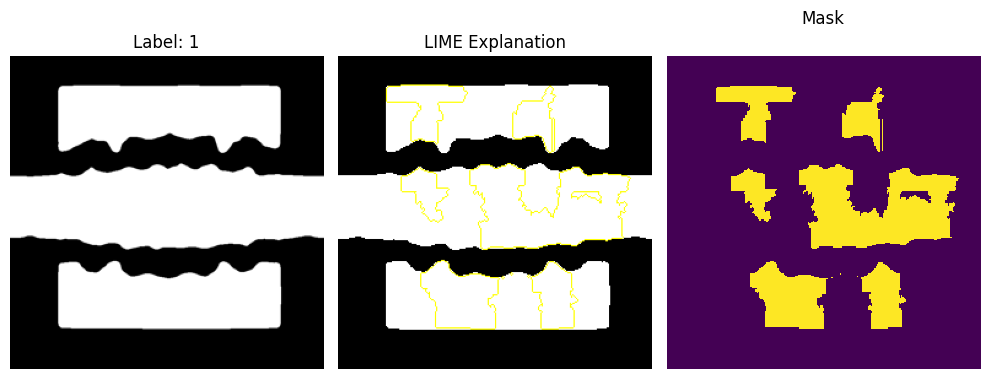

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


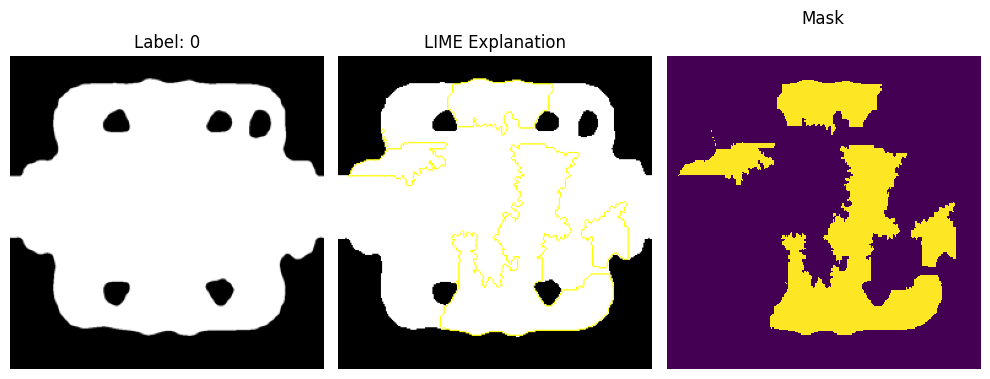

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


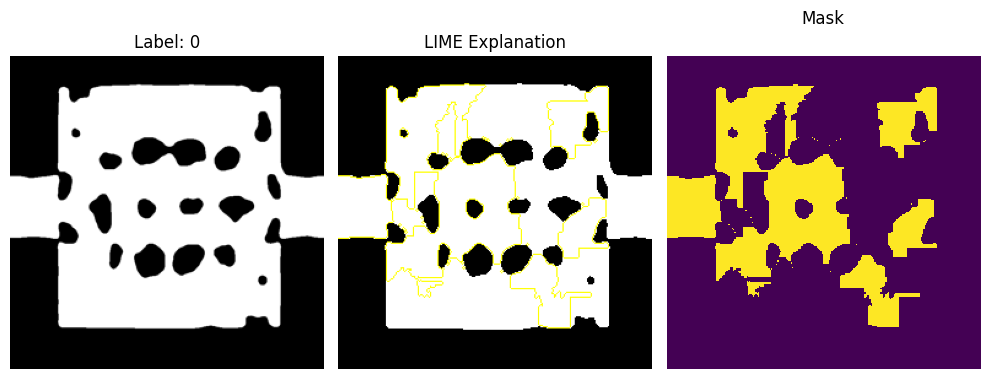

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


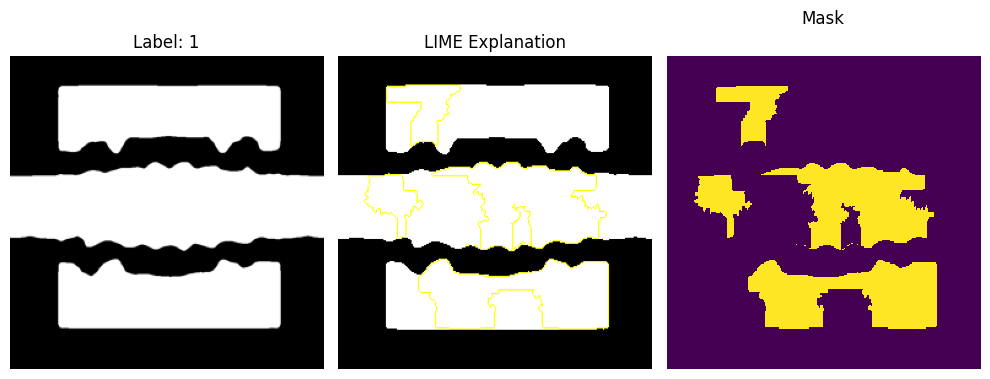

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


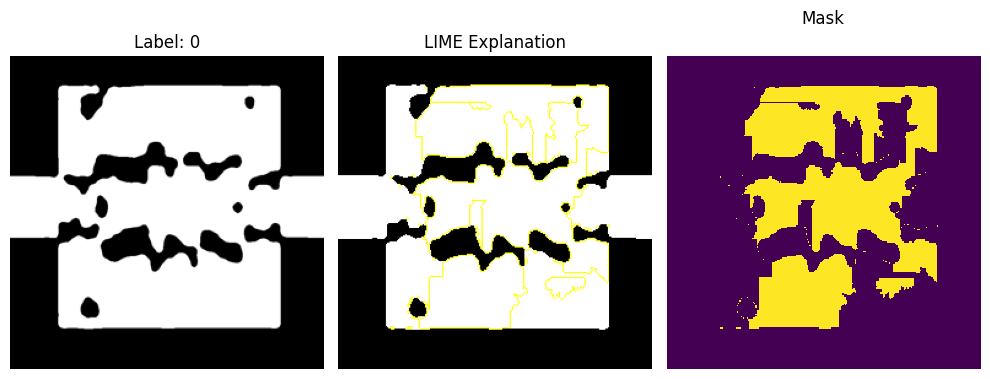

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


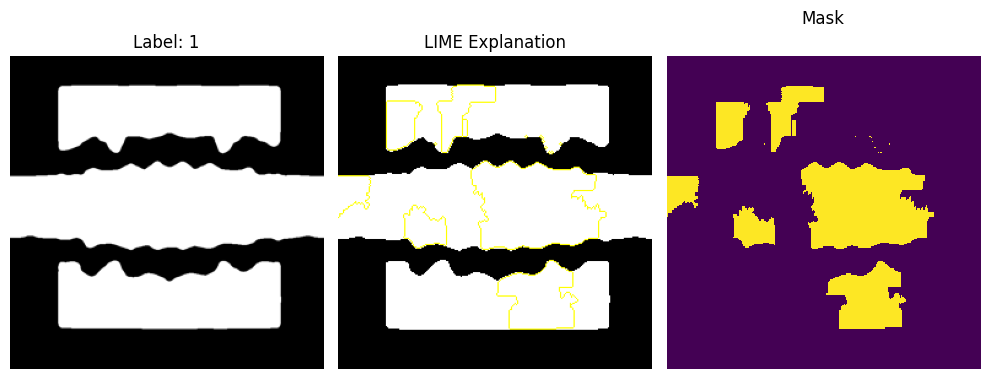

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


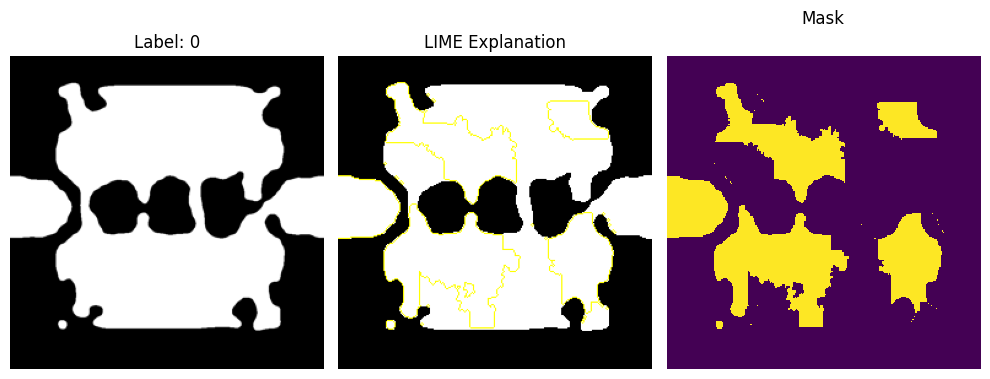

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


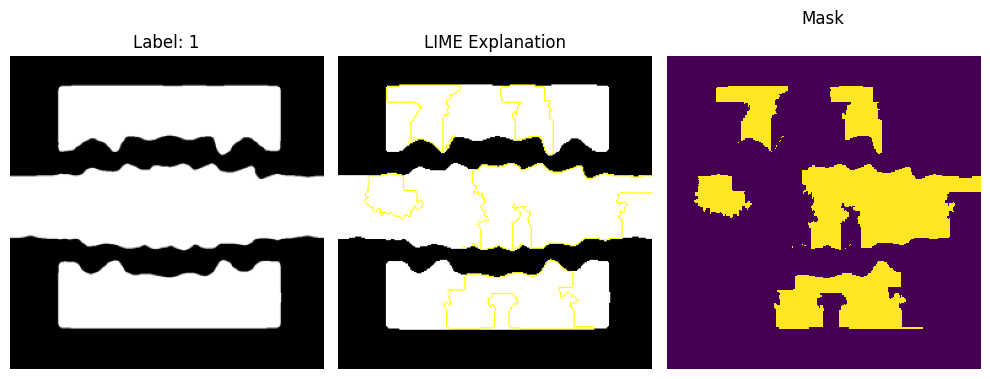

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


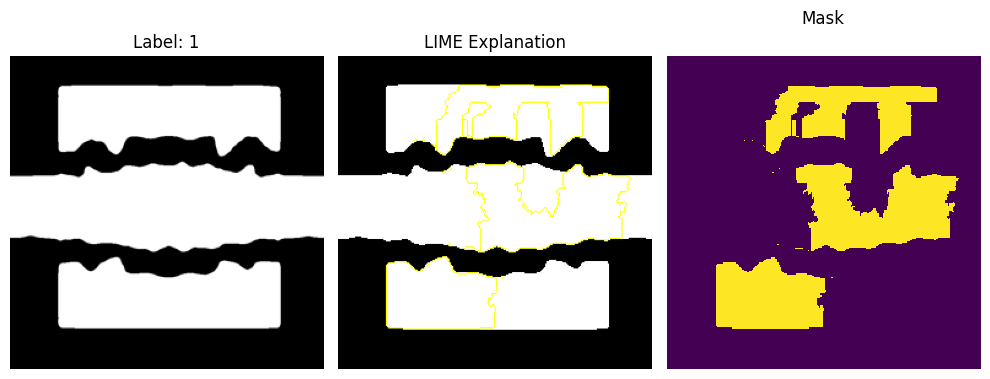

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


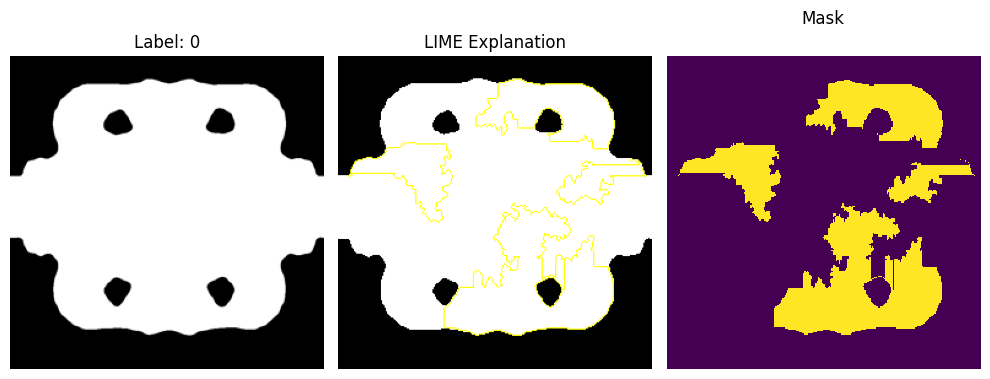

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


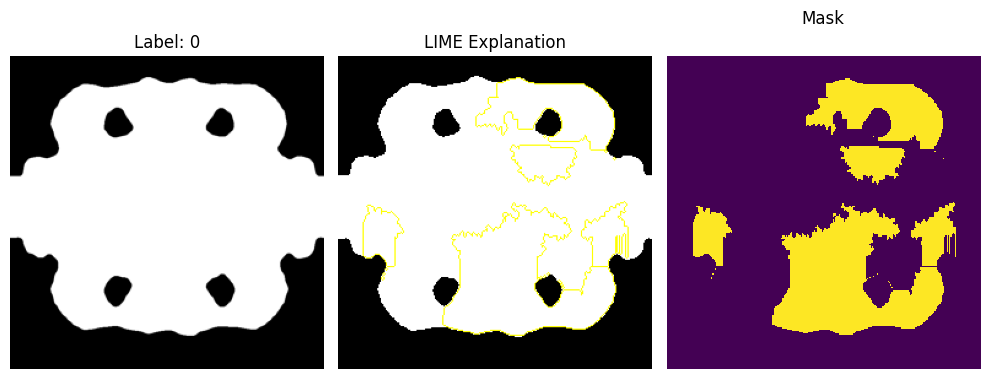

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


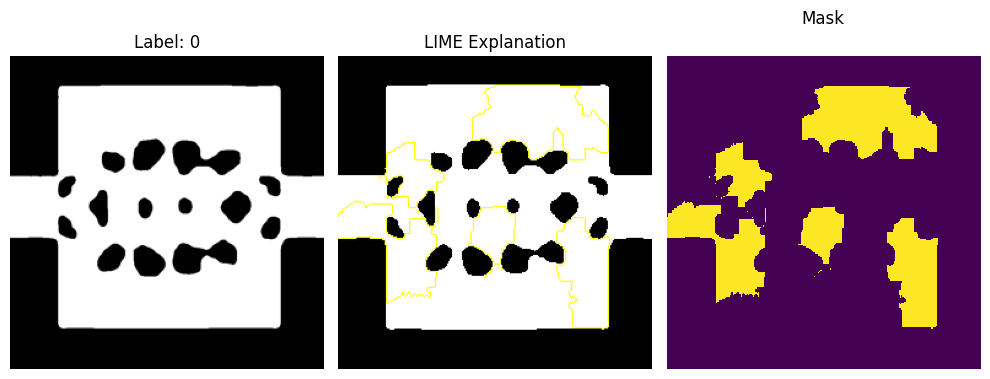

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


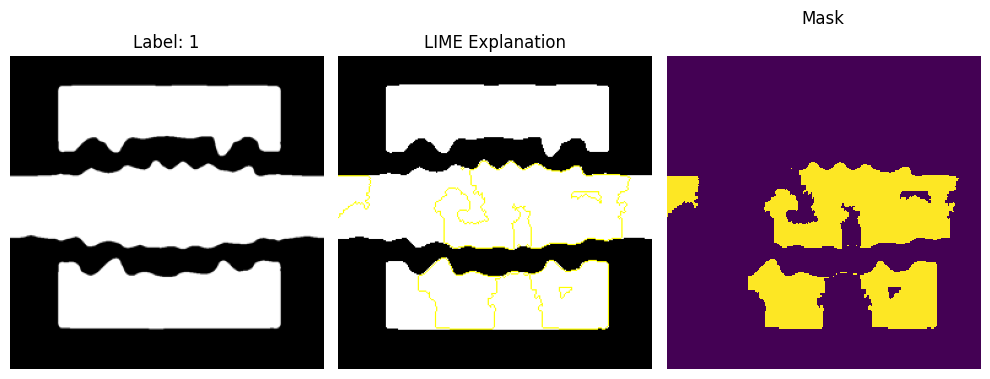

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


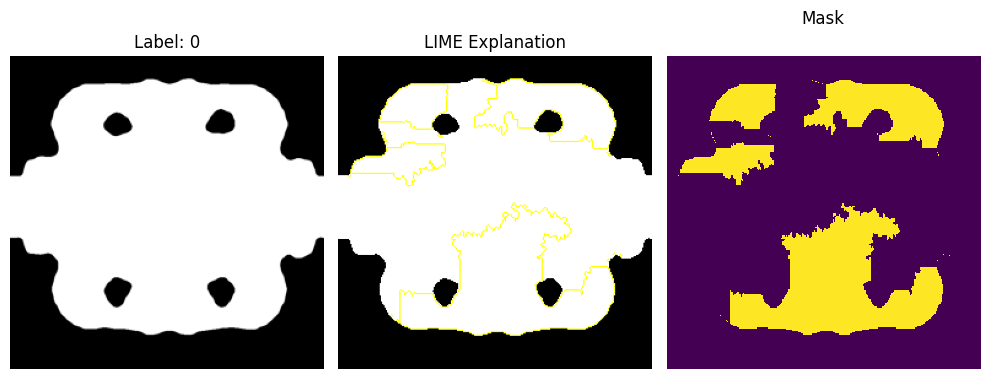

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


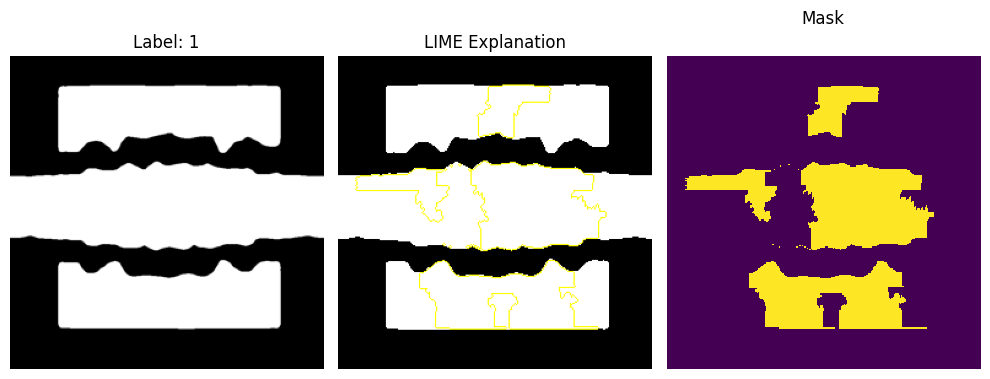

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


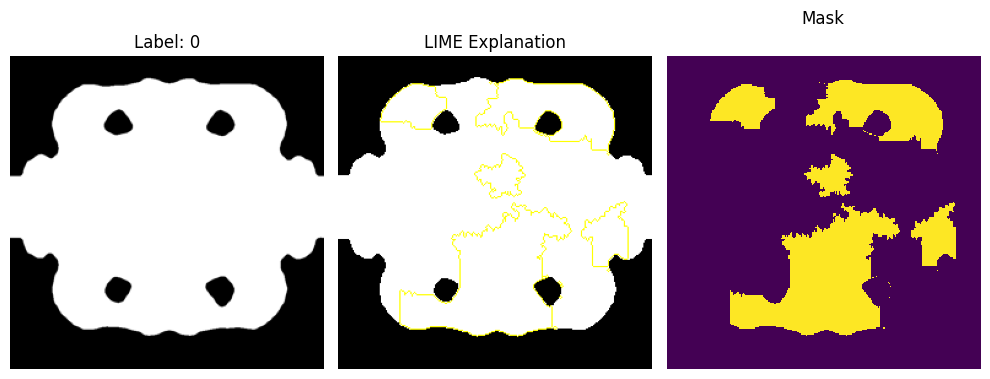

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


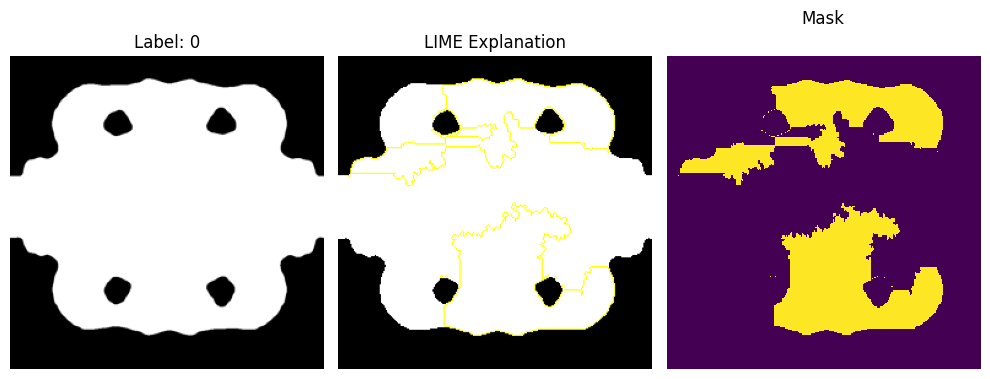

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


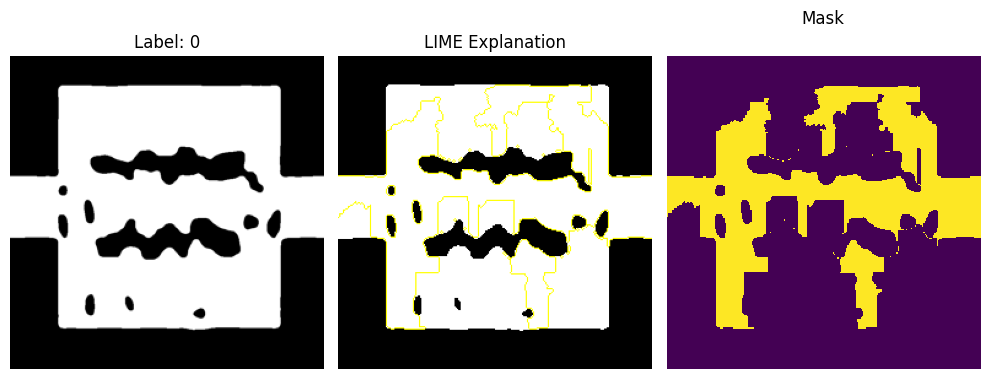

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


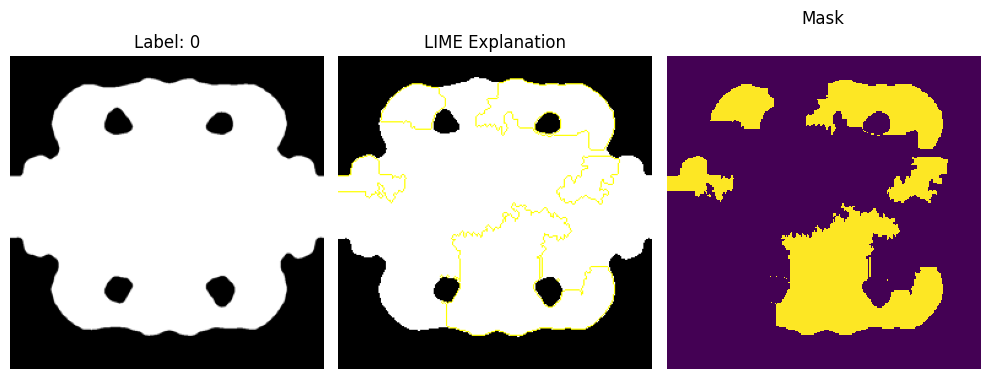

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


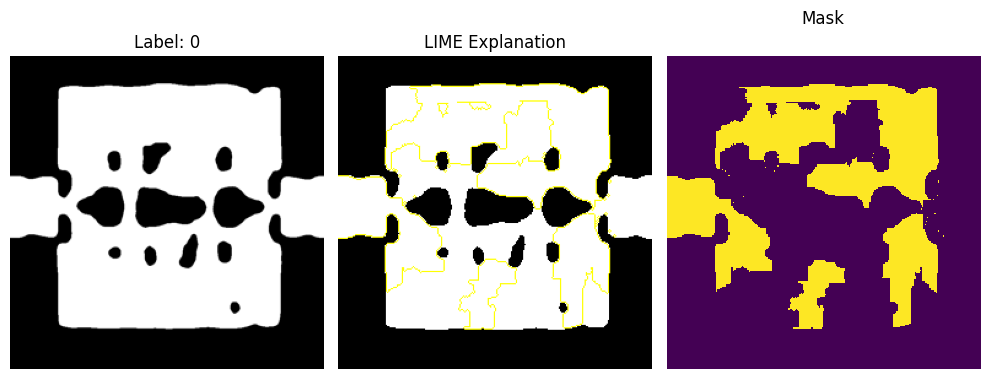

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


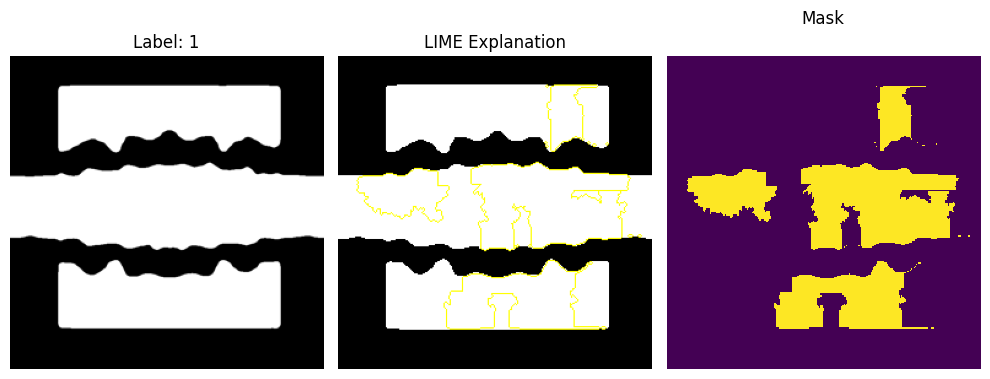

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


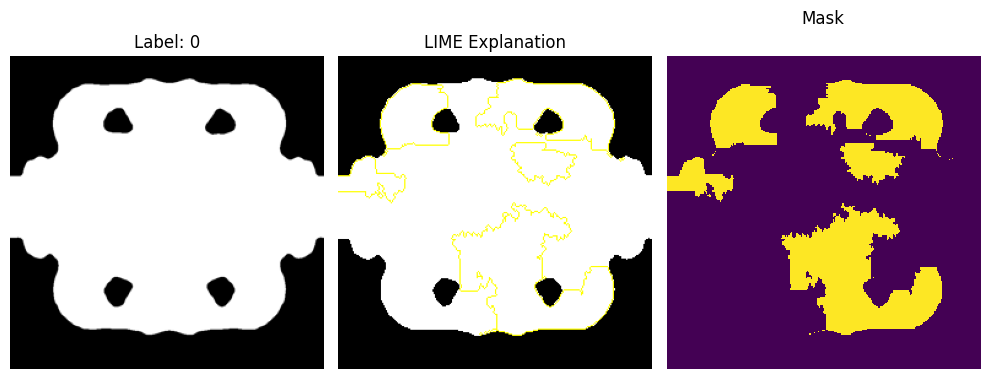

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


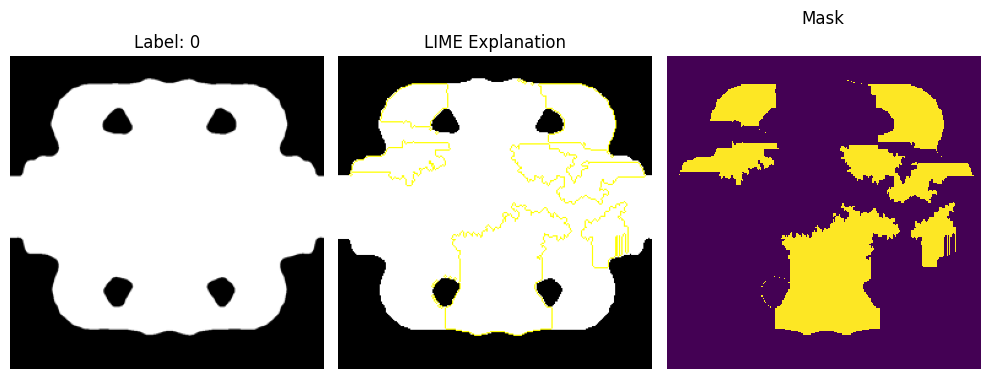

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


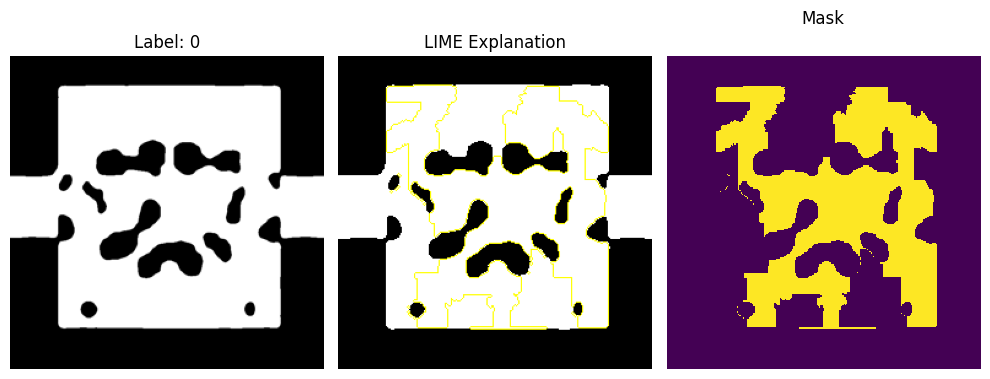

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


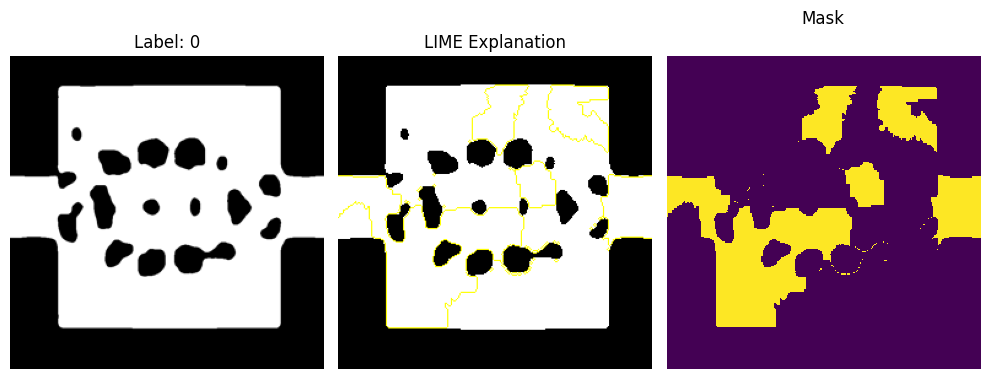

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


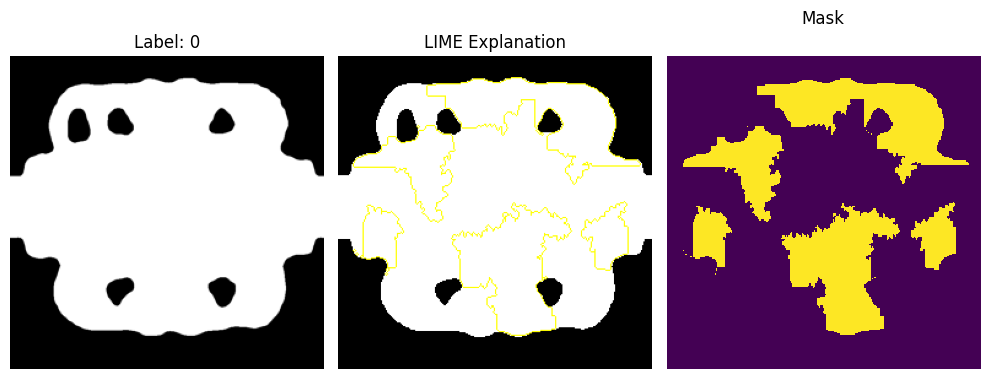

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


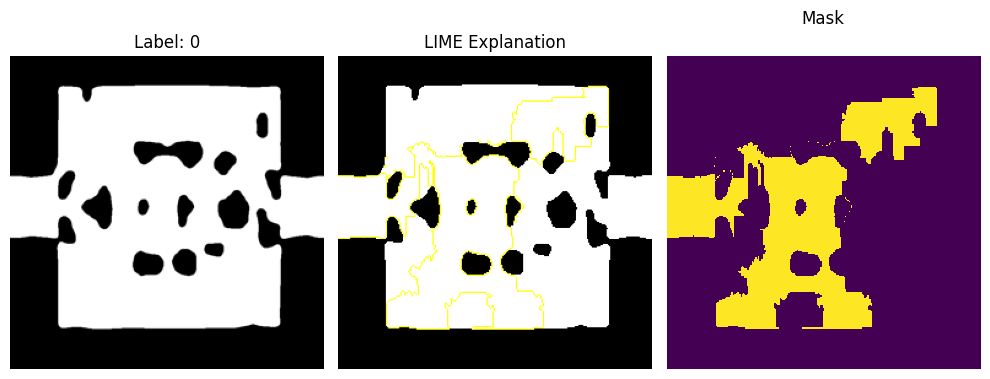

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


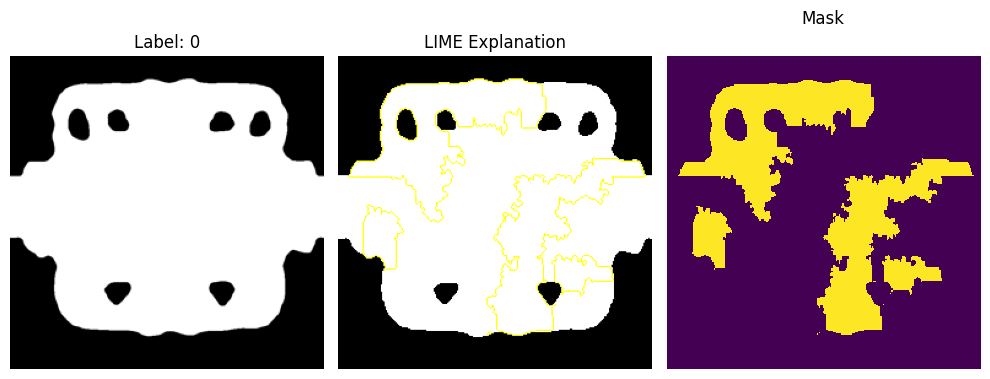

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


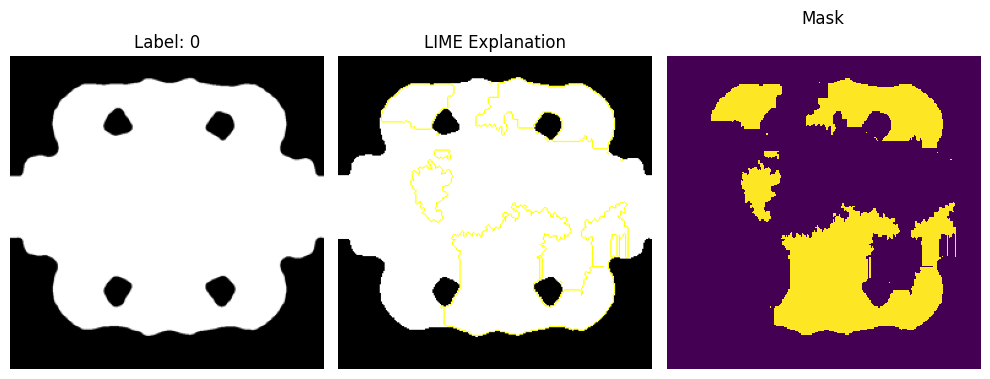

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


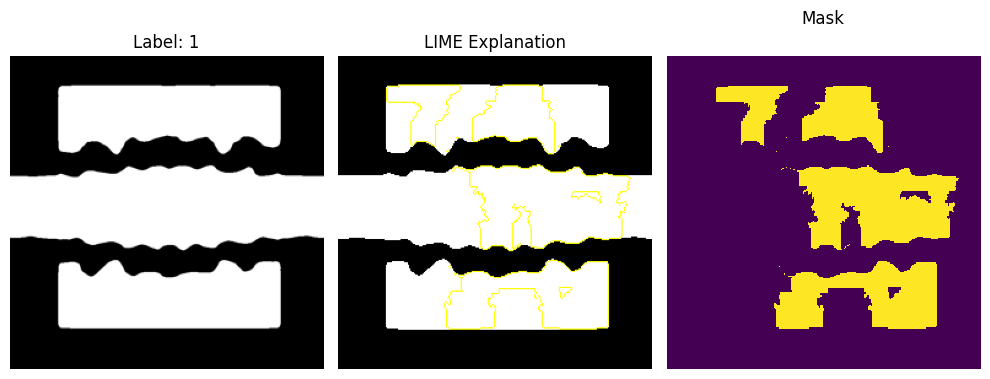

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


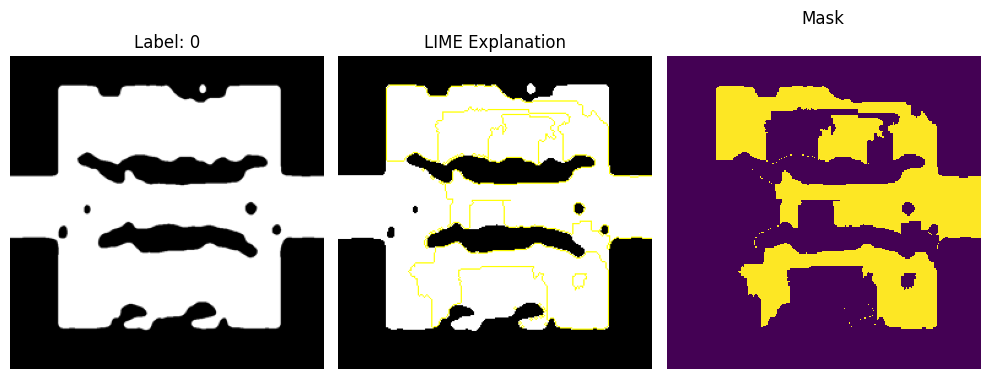

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


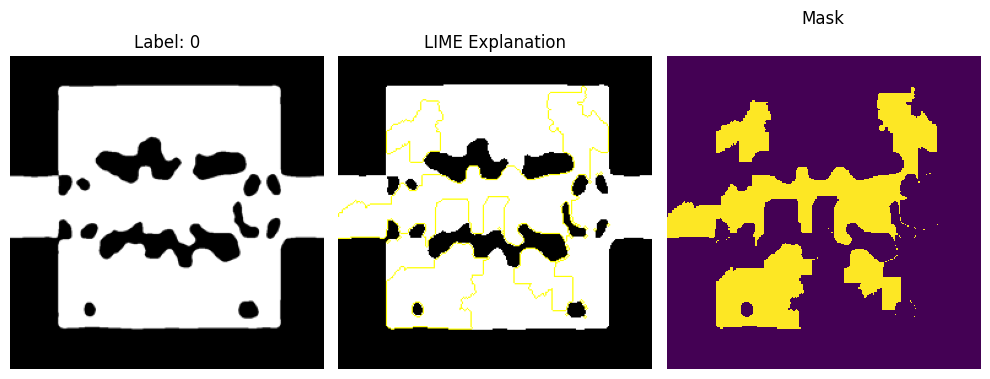

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


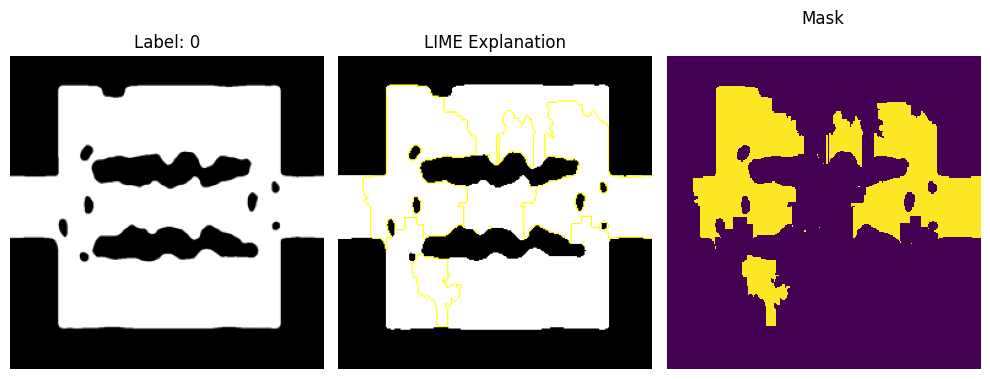

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


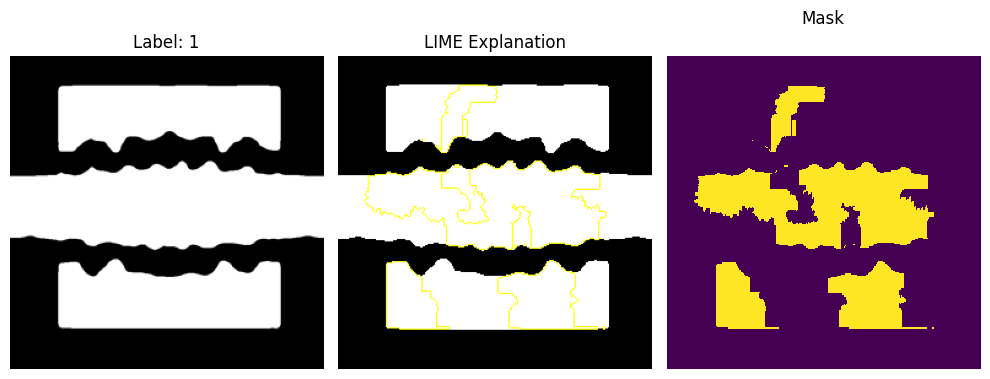

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


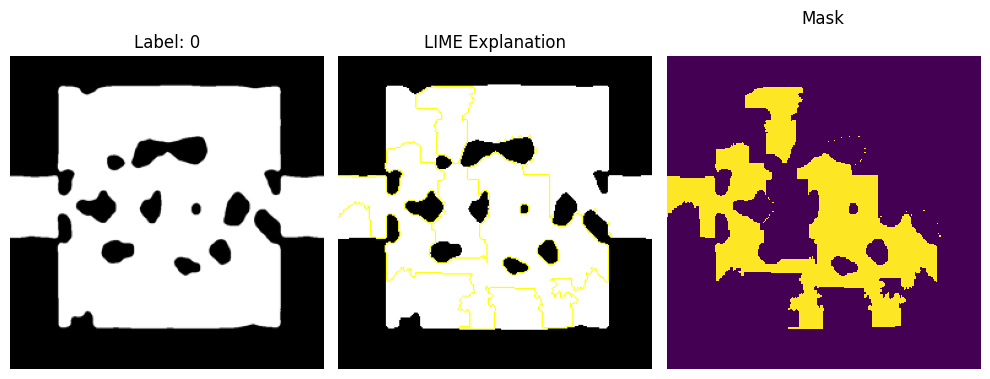

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


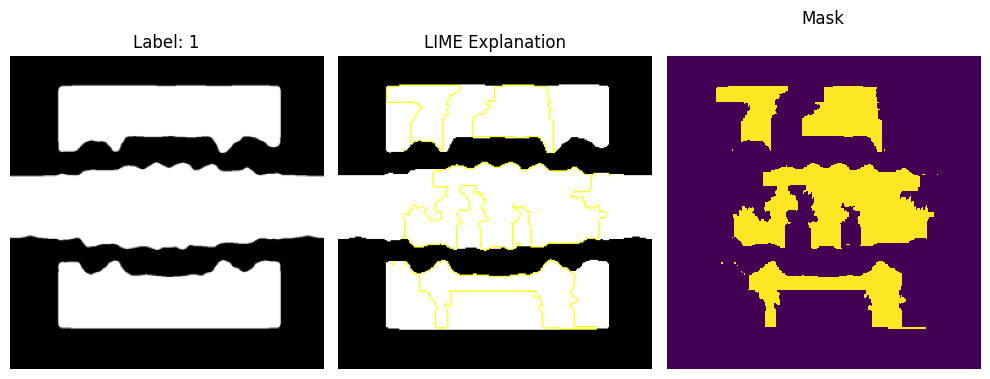

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


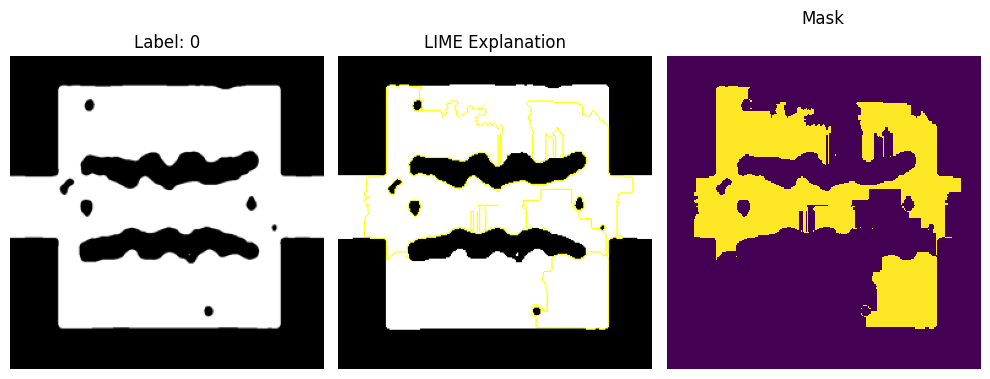

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


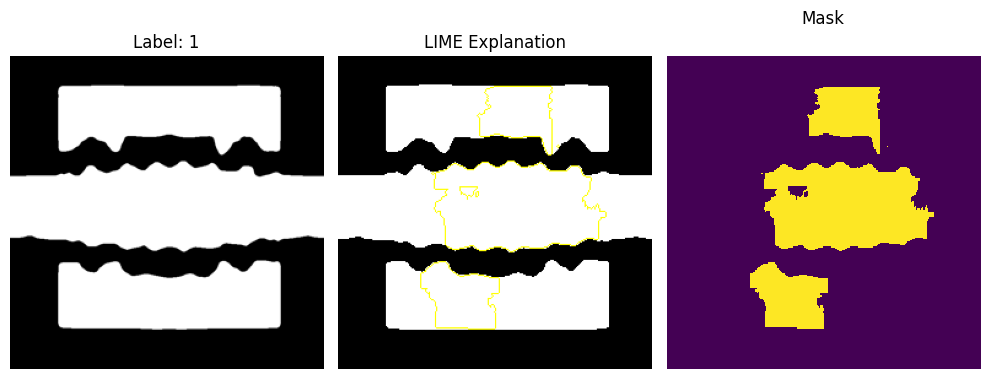

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


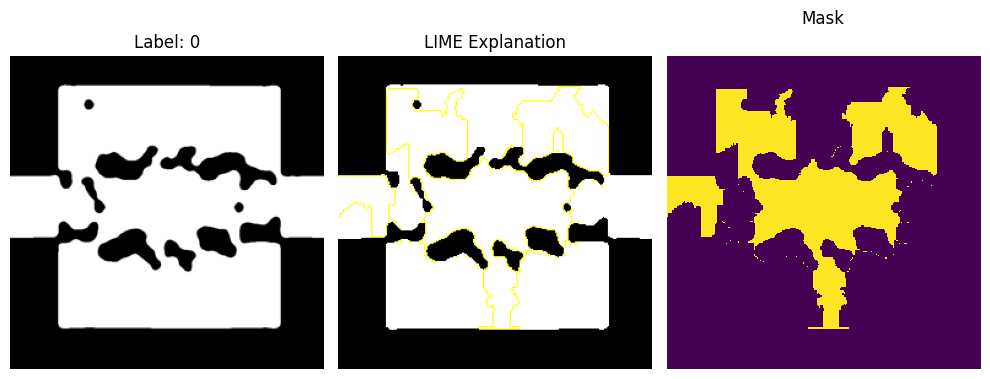

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


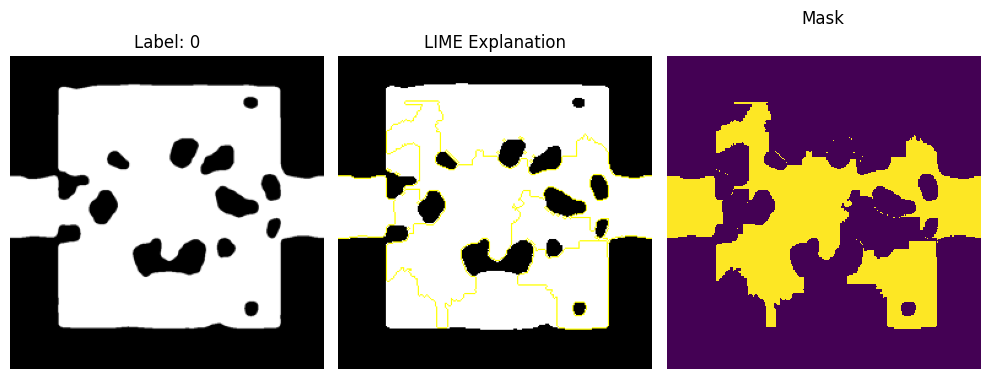

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


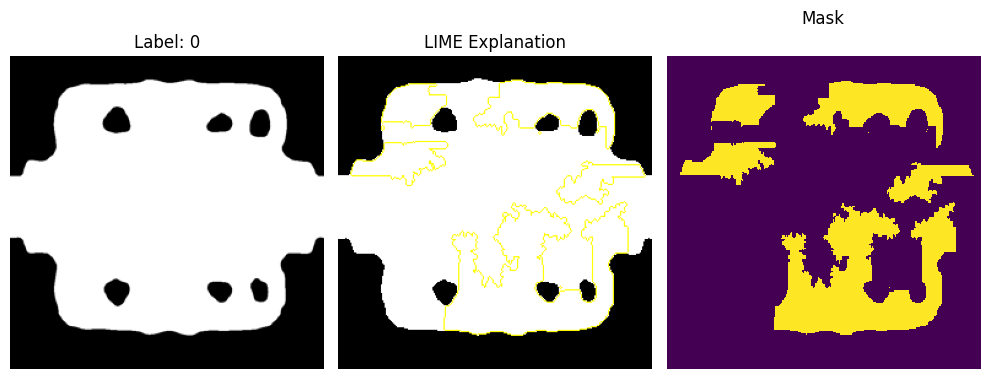

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


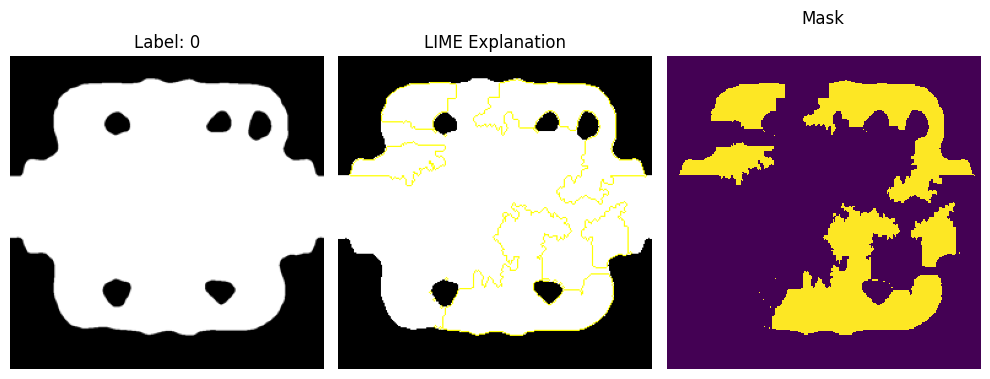

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


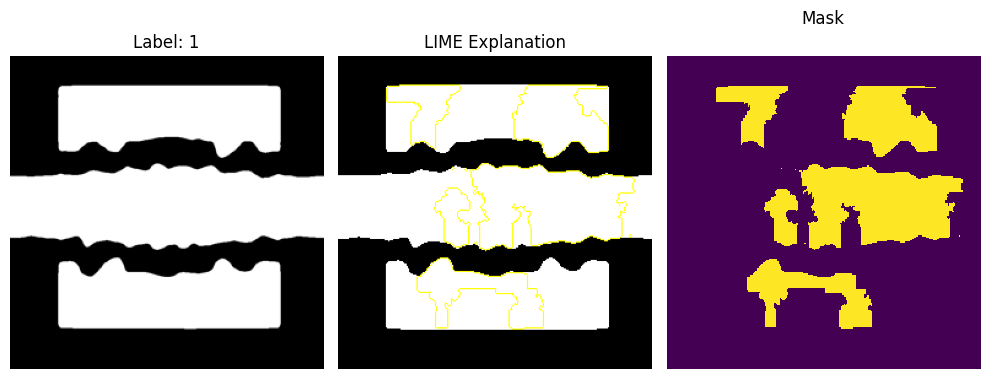

In [71]:
from lime import lime_image
import sys
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt
import cv2
import numpy as np

# SuppressOutput class definition
class SuppressOutput:
    def __enter__(self):
        self._original_stdout = sys.stdout
        self._original_stderr = sys.stderr
        sys.stdout = open(os.devnull, 'w')
        sys.stderr = open(os.devnull, 'w')

    def __exit__(self, exc_type, exc_value, traceback):
        sys.stdout.close()
        sys.stderr.close()
        sys.stdout = self._original_stdout
        sys.stderr = self._original_stderr

# Combine all images and labels
all_images = np.concatenate((x_train, x_test), axis=0)
all_labels = np.concatenate((y_train, y_test), axis=0)

# Define the prediction function compatible with LIME
def predict_fn(images):
    images = images[:, :, :, 0]  # Extract the first channel (grayscale)
    images = np.expand_dims(images, axis=-1)  # Add back the single channel
    return model.predict(images)  # Model prediction

# Initialize LIME explainer
explainer = lime_image.LimeImageExplainer()

# Loop through all images and display LIME explanations
i = 0
for image in all_images:
    # Convert grayscale image to RGB for LIME compatibility
    sample_image = cv2.cvtColor((image.squeeze() * 255).astype('uint8'), cv2.COLOR_GRAY2RGB)

    # Run LIME explanation
    with SuppressOutput():  # Suppress LIME's verbose output
        explanation = explainer.explain_instance(
            sample_image.astype('double'),
            predict_fn,
            top_labels=1,
            hide_color=0,
            num_samples=1000  # Number of perturbations
        )

        # Get the image and mask for the top label
        temp, mask = explanation.get_image_and_mask(
            explanation.top_labels[0],
            positive_only=True,
            num_features=10,
            hide_rest=False
        )

    # Display the original image and the LIME explanation
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10, 5))

    # Original image
    ax1.imshow(sample_image[:, :, 0].reshape(sample_image.shape[0], sample_image.shape[1]), cmap='gray')
    ax1.set_title(f"Label: {np.argmax(all_labels[i])}")
    ax1.axis('off')

    # LIME explanation with boundaries
    ax2.imshow(mark_boundaries(temp, mask, color=(1, 1, 0)))  # Yellow boundaries
    ax2.set_title('LIME Explanation')
    ax2.axis('off')

    # Display mask (optional)
    ax3.matshow(mask)
    ax3.set_title('Mask')
    ax3.axis('off')

    plt.tight_layout()  # Adjust layout to avoid overlap
    plt.show()  # Moved inside the loop to display each explanation

    i += 1


### Collect LIME Metrics

In [80]:
lime_metrics = []

# Loop through all images in the dataset
for i, image in enumerate(all_images):
    # Convert grayscale image to RGB
    sample_image = cv2.cvtColor((image.squeeze() * 255).astype('uint8'), cv2.COLOR_GRAY2RGB)
    
    # Generate LIME explanation
    explanation = explainer.explain_instance(
        sample_image.astype('double'),
        predict_fn,
        top_labels=1,
        hide_color=0,
        num_samples=300
    )
    
    # Extract mask and prediction confidence
    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=True,
        num_features=10,
        hide_rest=False
    )
    
    # Calculate metrics
    highlighted_region_size = np.sum(mask)  # Count of highlighted pixels
    top_prediction_confidence = np.max(predict_fn(np.expand_dims(sample_image, axis=0)))  # Confidence
    
    # Append metrics
    lime_metrics.append({
        'label': np.argmax(all_labels[i]),  # True label
        'highlighted_pixels': highlighted_region_size,
        'confidence': top_prediction_confidence
    })


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


  3%|▎         | 10/300 [00:00<00:06, 45.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  7%|▋         | 20/300 [00:00<00:04, 63.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:03, 73.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 13%|█▎        | 40/300 [00:00<00:03, 80.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 17%|█▋        | 50/300 [00:00<00:03, 82.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 20%|██        | 60/300 [00:00<00:02, 85.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 87.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:00<00:02, 89.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:02, 90.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 90.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 91.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 40%|████      | 120/300 [00:01<00:01, 90.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 43%|████▎     | 130/300 [00:01<00:01, 86.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 47%|████▋     | 140/300 [00:01<00:01, 87.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 50%|█████     | 150/300 [00:01<00:01, 88.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 89.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 90.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 90.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 91.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 91.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 70%|███████   | 210/300 [00:02<00:00, 91.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 91.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 90.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 80%|████████  | 240/300 [00:02<00:00, 90.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 91.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:02<00:00, 92.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 90%|█████████ | 270/300 [00:03<00:00, 89.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 89.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 90.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 87.61it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  3%|▎         | 10/300 [00:00<00:03, 86.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


  7%|▋         | 20/300 [00:00<00:03, 83.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 10%|█         | 30/300 [00:00<00:03, 81.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 13%|█▎        | 40/300 [00:00<00:03, 78.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 17%|█▋        | 50/300 [00:00<00:03, 78.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 20%|██        | 60/300 [00:00<00:03, 76.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 23%|██▎       | 70/300 [00:00<00:03, 76.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 27%|██▋       | 80/300 [00:01<00:02, 79.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 30%|███       | 90/300 [00:01<00:03, 63.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 33%|███▎      | 100/300 [00:01<00:02, 67.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 37%|███▋      | 110/300 [00:01<00:02, 71.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 40%|████      | 120/300 [00:01<00:02, 70.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 43%|████▎     | 130/300 [00:01<00:02, 73.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 47%|████▋     | 140/300 [00:01<00:02, 76.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 50%|█████     | 150/300 [00:01<00:01, 76.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 71.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 74.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 60%|██████    | 180/300 [00:02<00:01, 78.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 81.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 83.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 70%|███████   | 210/300 [00:02<00:01, 85.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 80.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 79.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 80%|████████  | 240/300 [00:03<00:00, 79.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 81.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 81.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 90%|█████████ | 270/300 [00:03<00:00, 80.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 82.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 84.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 78.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  7%|▋         | 20/300 [00:00<00:03, 90.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:03, 88.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:02, 88.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:02, 89.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 20%|██        | 60/300 [00:00<00:02, 89.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 90.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 27%|██▋       | 80/300 [00:00<00:02, 90.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 89.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 33%|███▎      | 100/300 [00:01<00:02, 89.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 89.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 40%|████      | 120/300 [00:01<00:02, 89.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 43%|████▎     | 130/300 [00:01<00:01, 89.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 47%|████▋     | 140/300 [00:01<00:01, 88.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 50%|█████     | 150/300 [00:01<00:01, 87.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 88.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 89.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 89.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 89.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 87.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 70%|███████   | 210/300 [00:02<00:01, 88.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 88.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 88.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 80%|████████  | 240/300 [00:02<00:00, 88.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 87.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:02<00:00, 88.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 87.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 88.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 81.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


100%|██████████| 300/300 [00:03<00:00, 86.32it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  3%|▎         | 10/300 [00:00<00:03, 91.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  7%|▋         | 20/300 [00:00<00:03, 90.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 10%|█         | 30/300 [00:00<00:03, 89.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 13%|█▎        | 40/300 [00:00<00:02, 89.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 17%|█▋        | 50/300 [00:00<00:02, 88.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 20%|██        | 60/300 [00:00<00:02, 89.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 23%|██▎       | 70/300 [00:00<00:02, 89.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 27%|██▋       | 80/300 [00:00<00:02, 88.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 30%|███       | 90/300 [00:01<00:02, 88.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 33%|███▎      | 100/300 [00:01<00:02, 85.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 37%|███▋      | 110/300 [00:01<00:02, 86.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 40%|████      | 120/300 [00:01<00:02, 87.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:01, 88.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 47%|████▋     | 140/300 [00:01<00:01, 88.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 50%|█████     | 150/300 [00:01<00:01, 89.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 89.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 89.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 60%|██████    | 180/300 [00:02<00:01, 77.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 80.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 82.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 70%|███████   | 210/300 [00:02<00:01, 84.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 82.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 78.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 80%|████████  | 240/300 [00:02<00:00, 80.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 83.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 85.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 90%|█████████ | 270/300 [00:03<00:00, 86.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 87.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 88.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


100%|██████████| 300/300 [00:03<00:00, 85.97it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 91.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  7%|▋         | 20/300 [00:00<00:03, 89.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:03, 88.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 13%|█▎        | 40/300 [00:00<00:03, 73.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 17%|█▋        | 50/300 [00:00<00:03, 78.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 20%|██        | 60/300 [00:00<00:02, 81.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 23%|██▎       | 70/300 [00:00<00:02, 83.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:00<00:02, 85.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:02, 86.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 86.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 37%|███▋      | 110/300 [00:01<00:02, 87.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 40%|████      | 120/300 [00:01<00:02, 87.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 43%|████▎     | 130/300 [00:01<00:01, 86.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 47%|████▋     | 140/300 [00:01<00:01, 86.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 50%|█████     | 150/300 [00:01<00:01, 87.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 84.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 85.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 60%|██████    | 180/300 [00:02<00:01, 86.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 86.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 87.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 70%|███████   | 210/300 [00:02<00:01, 88.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 77.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 80.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 80%|████████  | 240/300 [00:02<00:00, 82.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 82.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 83.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 90%|█████████ | 270/300 [00:03<00:00, 85.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 86.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 86.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


100%|██████████| 300/300 [00:03<00:00, 84.82it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


  3%|▎         | 10/300 [00:00<00:03, 81.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  7%|▋         | 20/300 [00:00<00:03, 85.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 10%|█         | 30/300 [00:00<00:03, 86.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 13%|█▎        | 40/300 [00:00<00:02, 87.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 17%|█▋        | 50/300 [00:00<00:02, 88.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 20%|██        | 60/300 [00:00<00:02, 87.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 23%|██▎       | 70/300 [00:00<00:02, 87.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 27%|██▋       | 80/300 [00:00<00:02, 87.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:02, 76.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 33%|███▎      | 100/300 [00:01<00:02, 80.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 82.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 40%|████      | 120/300 [00:01<00:02, 84.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 43%|████▎     | 130/300 [00:01<00:01, 85.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 47%|████▋     | 140/300 [00:01<00:01, 86.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 50%|█████     | 150/300 [00:01<00:01, 87.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 84.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 85.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 60%|██████    | 180/300 [00:02<00:01, 85.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 86.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 87.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 70%|███████   | 210/300 [00:02<00:01, 88.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 88.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 88.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 80%|████████  | 240/300 [00:02<00:00, 87.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 88.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 77.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 90%|█████████ | 270/300 [00:03<00:00, 79.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 82.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 83.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 84.98it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 94.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  7%|▋         | 20/300 [00:00<00:03, 89.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 10%|█         | 30/300 [00:00<00:03, 88.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 13%|█▎        | 40/300 [00:00<00:02, 88.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 17%|█▋        | 50/300 [00:00<00:02, 88.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 20%|██        | 60/300 [00:00<00:02, 88.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:02, 88.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 27%|██▋       | 80/300 [00:00<00:02, 88.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 30%|███       | 90/300 [00:01<00:02, 88.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 33%|███▎      | 100/300 [00:01<00:02, 88.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 87.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 40%|████      | 120/300 [00:01<00:02, 75.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 43%|████▎     | 130/300 [00:01<00:02, 78.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 47%|████▋     | 140/300 [00:01<00:01, 80.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 50%|█████     | 150/300 [00:01<00:01, 79.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 82.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 83.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 60%|██████    | 180/300 [00:02<00:01, 84.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 85.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 85.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 70%|███████   | 210/300 [00:02<00:01, 86.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 86.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 85.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 80%|████████  | 240/300 [00:02<00:00, 86.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 86.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 87.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 90%|█████████ | 270/300 [00:03<00:00, 87.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 76.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 75.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


100%|██████████| 300/300 [00:03<00:00, 83.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 94.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  7%|▋         | 20/300 [00:00<00:03, 89.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 10%|█         | 30/300 [00:00<00:03, 88.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 13%|█▎        | 40/300 [00:00<00:03, 83.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 17%|█▋        | 50/300 [00:00<00:02, 83.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 20%|██        | 60/300 [00:00<00:02, 84.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 23%|██▎       | 70/300 [00:00<00:02, 86.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 27%|██▋       | 80/300 [00:00<00:02, 86.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 30%|███       | 90/300 [00:01<00:02, 86.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 33%|███▎      | 100/300 [00:01<00:02, 86.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 37%|███▋      | 110/300 [00:01<00:02, 87.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 40%|████      | 120/300 [00:01<00:02, 73.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 43%|████▎     | 130/300 [00:01<00:02, 76.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 47%|████▋     | 140/300 [00:01<00:02, 79.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 50%|█████     | 150/300 [00:01<00:01, 81.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 81.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 83.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 60%|██████    | 180/300 [00:02<00:01, 84.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 85.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 85.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 70%|███████   | 210/300 [00:02<00:01, 86.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 87.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 87.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 80%|████████  | 240/300 [00:02<00:00, 87.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 83.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 84.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 73.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 76.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 79.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


100%|██████████| 300/300 [00:03<00:00, 82.98it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  3%|▎         | 10/300 [00:00<00:03, 92.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  7%|▋         | 20/300 [00:00<00:03, 89.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 10%|█         | 30/300 [00:00<00:03, 89.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:02, 90.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 17%|█▋        | 50/300 [00:00<00:02, 90.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 20%|██        | 60/300 [00:00<00:02, 90.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:02, 90.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:00<00:02, 90.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:00<00:02, 90.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 86.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 87.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 43%|████▎     | 129/300 [00:01<00:02, 66.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 46%|████▌     | 137/300 [00:01<00:02, 66.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 48%|████▊     | 145/300 [00:01<00:02, 68.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 51%|█████     | 153/300 [00:01<00:02, 69.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 54%|█████▎    | 161/300 [00:02<00:01, 70.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 73.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 60%|██████    | 180/300 [00:02<00:01, 79.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 82.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 85.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 70%|███████   | 210/300 [00:02<00:01, 86.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 87.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 88.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 80%|████████  | 240/300 [00:02<00:00, 88.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 89.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 89.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 90%|█████████ | 270/300 [00:03<00:00, 89.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 89.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 79.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 83.27it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 90.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  7%|▋         | 20/300 [00:00<00:03, 82.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:03, 86.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 13%|█▎        | 40/300 [00:00<00:02, 87.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 17%|█▋        | 50/300 [00:00<00:02, 89.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 20%|██        | 60/300 [00:00<00:02, 89.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 23%|██▎       | 70/300 [00:00<00:02, 90.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 27%|██▋       | 80/300 [00:00<00:02, 90.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:02, 90.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 90.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 87.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 40%|████      | 120/300 [00:01<00:02, 88.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 43%|████▎     | 130/300 [00:01<00:02, 70.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 47%|████▋     | 140/300 [00:01<00:02, 74.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 50%|█████     | 150/300 [00:01<00:01, 79.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 82.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 84.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 60%|██████    | 180/300 [00:02<00:01, 85.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 86.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 83.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 70%|███████   | 210/300 [00:02<00:01, 85.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 86.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 87.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 80%|████████  | 240/300 [00:02<00:00, 87.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 88.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 88.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 90%|█████████ | 270/300 [00:03<00:00, 83.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 65.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 68.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


100%|██████████| 300/300 [00:03<00:00, 82.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


  3%|▎         | 10/300 [00:00<00:03, 75.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


  7%|▋         | 20/300 [00:00<00:03, 77.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 10%|█         | 30/300 [00:00<00:03, 79.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 13%|█▎        | 40/300 [00:00<00:03, 82.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 17%|█▋        | 50/300 [00:00<00:03, 82.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 20%|██        | 60/300 [00:00<00:02, 81.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 23%|██▎       | 70/300 [00:00<00:02, 81.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 27%|██▋       | 80/300 [00:00<00:02, 82.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 85.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 33%|███▎      | 100/300 [00:01<00:02, 83.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 37%|███▋      | 110/300 [00:01<00:02, 83.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 40%|████      | 120/300 [00:01<00:02, 82.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 43%|████▎     | 130/300 [00:01<00:02, 83.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 47%|████▋     | 140/300 [00:01<00:01, 82.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 50%|█████     | 150/300 [00:01<00:01, 81.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 81.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 81.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 60%|██████    | 180/300 [00:02<00:01, 81.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 80.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 80.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 70%|███████   | 210/300 [00:02<00:01, 80.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 80.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 80.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 80%|████████  | 240/300 [00:02<00:00, 80.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 81.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 81.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 90%|█████████ | 270/300 [00:03<00:00, 70.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 73.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 75.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


100%|██████████| 300/300 [00:03<00:00, 79.99it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


  3%|▎         | 10/300 [00:00<00:03, 84.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  7%|▋         | 20/300 [00:00<00:03, 84.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 10%|█         | 30/300 [00:00<00:03, 81.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 13%|█▎        | 40/300 [00:00<00:03, 82.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 17%|█▋        | 50/300 [00:00<00:03, 81.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 20%|██        | 60/300 [00:00<00:02, 81.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 23%|██▎       | 70/300 [00:00<00:02, 81.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 27%|██▋       | 80/300 [00:00<00:02, 81.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 30%|███       | 90/300 [00:01<00:02, 81.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 33%|███▎      | 100/300 [00:01<00:02, 81.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 37%|███▋      | 110/300 [00:01<00:02, 80.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 40%|████      | 120/300 [00:01<00:02, 80.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 43%|████▎     | 130/300 [00:01<00:02, 81.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 47%|████▋     | 140/300 [00:01<00:01, 81.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 50%|█████     | 150/300 [00:01<00:01, 77.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 79.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 79.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 60%|██████    | 180/300 [00:02<00:01, 80.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 80.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 81.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 70%|███████   | 210/300 [00:02<00:01, 79.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 80.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 81.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 80%|████████  | 240/300 [00:03<00:00, 70.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 73.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 71.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 90%|█████████ | 270/300 [00:03<00:00, 73.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 75.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 77.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


100%|██████████| 300/300 [00:03<00:00, 79.12it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  3%|▎         | 10/300 [00:00<00:03, 88.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


  7%|▋         | 20/300 [00:00<00:03, 84.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 10%|█         | 30/300 [00:00<00:03, 83.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 13%|█▎        | 40/300 [00:00<00:03, 83.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 17%|█▋        | 50/300 [00:00<00:03, 81.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 20%|██        | 60/300 [00:00<00:02, 81.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 23%|██▎       | 70/300 [00:00<00:02, 81.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 27%|██▋       | 80/300 [00:00<00:02, 84.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 30%|███       | 90/300 [00:01<00:02, 83.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 33%|███▎      | 100/300 [00:01<00:02, 82.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 72.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 40%|████      | 120/300 [00:01<00:02, 77.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 43%|████▎     | 130/300 [00:01<00:02, 78.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 47%|████▋     | 140/300 [00:01<00:02, 79.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 50%|█████     | 150/300 [00:01<00:01, 81.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 84.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 82.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 60%|██████    | 180/300 [00:02<00:01, 81.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 81.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 83.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 70%|███████   | 210/300 [00:02<00:01, 83.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 82.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 81.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 80%|████████  | 240/300 [00:02<00:00, 83.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 83.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 82.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 90%|█████████ | 270/300 [00:03<00:00, 83.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 85.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 86.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


100%|██████████| 300/300 [00:03<00:00, 80.91it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  3%|▎         | 10/300 [00:00<00:03, 87.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


  7%|▋         | 20/300 [00:00<00:03, 83.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 10%|█         | 30/300 [00:00<00:03, 81.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 13%|█▎        | 40/300 [00:00<00:03, 82.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 17%|█▋        | 50/300 [00:00<00:02, 84.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 20%|██        | 60/300 [00:00<00:02, 82.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 23%|██▎       | 70/300 [00:00<00:02, 81.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 27%|██▋       | 80/300 [00:00<00:02, 81.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 30%|███       | 90/300 [00:01<00:02, 80.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 33%|███▎      | 100/300 [00:01<00:02, 79.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 37%|███▋      | 110/300 [00:01<00:02, 79.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 40%|████      | 120/300 [00:01<00:02, 80.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 43%|████▎     | 130/300 [00:01<00:02, 82.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 47%|████▋     | 140/300 [00:01<00:01, 81.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 50%|█████     | 150/300 [00:01<00:01, 80.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 69.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 73.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 60%|██████    | 180/300 [00:02<00:01, 76.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 77.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 77.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 70%|███████   | 210/300 [00:02<00:01, 78.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 79.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 77%|███████▋  | 230/300 [00:02<00:01, 66.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 80%|████████  | 240/300 [00:03<00:00, 69.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 72.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 76.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 90%|█████████ | 270/300 [00:03<00:00, 78.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 77.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 77.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:03<00:00, 78.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


  3%|▎         | 10/300 [00:00<00:05, 57.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  7%|▋         | 20/300 [00:00<00:04, 69.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 10%|█         | 30/300 [00:00<00:03, 72.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 13%|█▎        | 40/300 [00:00<00:03, 76.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 17%|█▋        | 50/300 [00:00<00:03, 78.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 20%|██        | 60/300 [00:00<00:02, 81.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 23%|██▎       | 70/300 [00:00<00:02, 83.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 27%|██▋       | 80/300 [00:01<00:02, 82.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 30%|███       | 90/300 [00:01<00:02, 81.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 83.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 37%|███▋      | 110/300 [00:01<00:02, 83.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 40%|████      | 120/300 [00:01<00:02, 82.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 43%|████▎     | 130/300 [00:01<00:02, 83.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 47%|████▋     | 140/300 [00:01<00:01, 83.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 50%|█████     | 150/300 [00:01<00:01, 84.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 83.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 72.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 60%|██████    | 180/300 [00:02<00:01, 72.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 74.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 77.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 70%|███████   | 210/300 [00:02<00:01, 80.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 82.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 84.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:02<00:00, 86.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 88.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 89.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 89.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 89.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 90.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 82.34it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:02, 97.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  7%|▋         | 20/300 [00:00<00:02, 93.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 10%|█         | 30/300 [00:00<00:03, 70.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 13%|█▎        | 40/300 [00:00<00:03, 75.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 17%|█▋        | 50/300 [00:00<00:03, 76.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 20%|██        | 60/300 [00:00<00:03, 78.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 23%|██▎       | 70/300 [00:00<00:02, 79.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 27%|██▋       | 80/300 [00:01<00:02, 79.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:02, 82.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 33%|███▎      | 100/300 [00:01<00:02, 82.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 37%|███▋      | 110/300 [00:01<00:02, 82.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 40%|████      | 120/300 [00:01<00:02, 82.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 43%|████▎     | 130/300 [00:01<00:02, 83.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 47%|████▋     | 140/300 [00:01<00:01, 84.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 50%|█████     | 150/300 [00:01<00:01, 83.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 81.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 82.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 60%|██████    | 180/300 [00:02<00:01, 83.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 72.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 74.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 70%|███████   | 210/300 [00:02<00:01, 76.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 78.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 78.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 80%|████████  | 240/300 [00:03<00:00, 78.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 80.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 83.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 90%|█████████ | 270/300 [00:03<00:00, 83.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 83.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 81.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


100%|██████████| 300/300 [00:03<00:00, 80.52it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


  3%|▎         | 10/300 [00:00<00:03, 80.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


  7%|▋         | 20/300 [00:00<00:04, 64.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 10%|█         | 30/300 [00:00<00:03, 70.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 13%|█▎        | 40/300 [00:00<00:03, 74.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 17%|█▋        | 50/300 [00:00<00:03, 76.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 20%|██        | 60/300 [00:00<00:03, 77.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 23%|██▎       | 70/300 [00:00<00:02, 78.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 27%|██▋       | 80/300 [00:01<00:02, 79.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 30%|███       | 90/300 [00:01<00:02, 79.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 33%|███▎      | 100/300 [00:01<00:02, 79.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 37%|███▋      | 110/300 [00:01<00:02, 80.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 40%|████      | 120/300 [00:01<00:02, 80.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 43%|████▎     | 130/300 [00:01<00:02, 79.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 47%|████▋     | 140/300 [00:01<00:01, 81.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 50%|█████     | 150/300 [00:01<00:01, 80.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 70.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 70.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 60%|██████    | 180/300 [00:02<00:01, 75.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 76.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 77.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 70%|███████   | 210/300 [00:02<00:01, 78.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 78.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 79.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 80%|████████  | 240/300 [00:03<00:00, 82.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 80.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 80.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 90%|█████████ | 270/300 [00:03<00:00, 80.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 80.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 82.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


100%|██████████| 300/300 [00:03<00:00, 77.52it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


  3%|▎         | 10/300 [00:00<00:03, 87.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


  7%|▋         | 20/300 [00:00<00:03, 84.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 10%|█         | 30/300 [00:00<00:03, 83.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 13%|█▎        | 40/300 [00:00<00:03, 81.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 17%|█▋        | 50/300 [00:00<00:03, 80.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 20%|██        | 60/300 [00:00<00:02, 81.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 23%|██▎       | 70/300 [00:00<00:02, 82.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 27%|██▋       | 80/300 [00:00<00:02, 82.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 30%|███       | 90/300 [00:01<00:02, 81.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 83.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 85.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 40%|████      | 120/300 [00:01<00:02, 72.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 43%|████▎     | 130/300 [00:01<00:02, 74.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 47%|████▋     | 140/300 [00:01<00:02, 77.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 50%|█████     | 150/300 [00:01<00:01, 79.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 80.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 81.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 60%|██████    | 180/300 [00:02<00:01, 67.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 64.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 68.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 70%|███████   | 210/300 [00:02<00:01, 72.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 74.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 76.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 80%|████████  | 240/300 [00:03<00:00, 79.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 69.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 72.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 90%|█████████ | 270/300 [00:03<00:00, 76.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 76.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 77.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


100%|██████████| 300/300 [00:03<00:00, 76.99it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 95.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:02, 94.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:02, 92.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 13%|█▎        | 40/300 [00:00<00:02, 88.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 17%|█▋        | 50/300 [00:00<00:02, 86.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 20%|██        | 60/300 [00:00<00:02, 84.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 23%|██▎       | 70/300 [00:00<00:03, 71.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 27%|██▋       | 80/300 [00:00<00:02, 75.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 30%|███       | 90/300 [00:01<00:02, 77.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 33%|███▎      | 100/300 [00:01<00:02, 79.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 37%|███▋      | 110/300 [00:01<00:02, 80.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 40%|████      | 120/300 [00:01<00:02, 81.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 43%|████▎     | 130/300 [00:01<00:02, 78.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 47%|████▋     | 140/300 [00:01<00:01, 80.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 50%|█████     | 150/300 [00:01<00:01, 82.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 84.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 83.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 60%|██████    | 180/300 [00:02<00:01, 83.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 82.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 73.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 70%|███████   | 210/300 [00:02<00:01, 75.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 77.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 78.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 80%|████████  | 240/300 [00:02<00:00, 78.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 79.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 80.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 90%|█████████ | 270/300 [00:03<00:00, 81.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 80.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 80.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


100%|██████████| 300/300 [00:03<00:00, 80.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  3%|▎         | 10/300 [00:00<00:05, 50.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  7%|▋         | 20/300 [00:00<00:04, 64.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 10%|█         | 30/300 [00:00<00:03, 71.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 13%|█▎        | 40/300 [00:00<00:03, 74.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 17%|█▋        | 50/300 [00:00<00:03, 76.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 20%|██        | 60/300 [00:00<00:03, 78.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 23%|██▎       | 70/300 [00:00<00:02, 79.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 27%|██▋       | 80/300 [00:01<00:02, 80.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 30%|███       | 90/300 [00:01<00:02, 80.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 33%|███▎      | 100/300 [00:01<00:02, 80.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 37%|███▋      | 110/300 [00:01<00:02, 80.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 40%|████      | 120/300 [00:01<00:02, 81.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 43%|████▎     | 130/300 [00:01<00:02, 70.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 47%|████▋     | 140/300 [00:01<00:02, 73.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 50%|█████     | 150/300 [00:01<00:01, 75.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 79.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 80.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 60%|██████    | 180/300 [00:02<00:01, 80.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 83.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 82.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 70%|███████   | 210/300 [00:02<00:01, 81.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 83.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 84.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 80%|████████  | 240/300 [00:03<00:00, 87.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 88.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 75.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 90%|█████████ | 270/300 [00:03<00:00, 76.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 77.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 80.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 78.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  3%|▎         | 10/300 [00:00<00:03, 83.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


  7%|▋         | 20/300 [00:00<00:03, 82.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 10%|█         | 30/300 [00:00<00:03, 80.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 13%|█▎        | 40/300 [00:00<00:03, 80.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 17%|█▋        | 50/300 [00:00<00:03, 81.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 20%|██        | 60/300 [00:00<00:03, 69.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 23%|██▎       | 70/300 [00:00<00:03, 72.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 27%|██▋       | 80/300 [00:01<00:02, 75.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 30%|███       | 90/300 [00:01<00:02, 76.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 80.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 37%|███▋      | 110/300 [00:01<00:02, 80.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 40%|████      | 120/300 [00:01<00:02, 80.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 43%|████▎     | 130/300 [00:01<00:02, 81.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 47%|████▋     | 140/300 [00:01<00:01, 83.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 50%|█████     | 150/300 [00:01<00:01, 83.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 79.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 71.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 60%|██████    | 180/300 [00:02<00:01, 75.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 76.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 66.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 70%|███████   | 210/300 [00:02<00:01, 69.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 72.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 75.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 80%|████████  | 240/300 [00:03<00:00, 77.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 78.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 79.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 90%|█████████ | 270/300 [00:03<00:00, 80.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 69.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 72.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


100%|██████████| 300/300 [00:03<00:00, 76.38it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  3%|▎         | 10/300 [00:00<00:03, 84.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  7%|▋         | 20/300 [00:00<00:03, 81.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 10%|█         | 30/300 [00:00<00:03, 81.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 13%|█▎        | 40/300 [00:00<00:03, 81.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 17%|█▋        | 50/300 [00:00<00:03, 81.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 20%|██        | 60/300 [00:00<00:02, 82.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 23%|██▎       | 70/300 [00:00<00:02, 82.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 27%|██▋       | 80/300 [00:01<00:03, 70.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:02, 74.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 33%|███▎      | 100/300 [00:01<00:02, 77.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 37%|███▋      | 110/300 [00:01<00:02, 78.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 40%|████      | 120/300 [00:01<00:02, 79.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 43%|████▎     | 130/300 [00:01<00:02, 80.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 47%|████▋     | 140/300 [00:01<00:02, 79.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 50%|█████     | 150/300 [00:01<00:02, 71.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 73.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 76.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 60%|██████    | 180/300 [00:02<00:01, 76.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 68.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 71.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 70%|███████   | 210/300 [00:02<00:01, 73.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 75.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 77.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 80%|████████  | 240/300 [00:03<00:00, 78.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 79.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 79.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 90%|█████████ | 270/300 [00:03<00:00, 80.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 81.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 81.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


100%|██████████| 300/300 [00:03<00:00, 76.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  3%|▎         | 10/300 [00:00<00:03, 84.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  7%|▋         | 20/300 [00:00<00:03, 80.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 10%|█         | 30/300 [00:00<00:03, 79.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 13%|█▎        | 40/300 [00:00<00:03, 81.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 17%|█▋        | 50/300 [00:00<00:03, 80.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 20%|██        | 60/300 [00:00<00:02, 81.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 23%|██▎       | 70/300 [00:00<00:02, 77.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 27%|██▋       | 80/300 [00:00<00:02, 79.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 30%|███       | 90/300 [00:01<00:03, 69.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 33%|███▎      | 100/300 [00:01<00:02, 72.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 37%|███▋      | 110/300 [00:01<00:02, 74.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 40%|████      | 120/300 [00:01<00:02, 76.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 43%|████▎     | 130/300 [00:01<00:02, 75.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 47%|████▋     | 140/300 [00:01<00:02, 76.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 50%|█████     | 150/300 [00:01<00:01, 78.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 79.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 80.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 60%|██████    | 180/300 [00:02<00:01, 79.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 69.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 72.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 70%|███████   | 210/300 [00:02<00:01, 75.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 76.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 77.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 80%|████████  | 240/300 [00:03<00:00, 80.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 82.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 81.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 90%|█████████ | 270/300 [00:03<00:00, 81.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 80.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 70.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


100%|██████████| 300/300 [00:03<00:00, 76.94it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  3%|▎         | 10/300 [00:00<00:03, 82.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


  7%|▋         | 20/300 [00:00<00:03, 81.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 10%|█         | 30/300 [00:00<00:03, 82.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 13%|█▎        | 40/300 [00:00<00:03, 81.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 17%|█▋        | 50/300 [00:00<00:03, 80.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 20%|██        | 60/300 [00:00<00:02, 80.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 23%|██▎       | 70/300 [00:00<00:02, 81.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 27%|██▋       | 80/300 [00:01<00:03, 69.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 30%|███       | 90/300 [00:01<00:02, 73.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 33%|███▎      | 100/300 [00:01<00:02, 75.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 37%|███▋      | 110/300 [00:01<00:02, 77.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 40%|████      | 120/300 [00:01<00:02, 77.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 43%|████▎     | 130/300 [00:01<00:02, 77.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 47%|████▋     | 140/300 [00:01<00:02, 78.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 50%|█████     | 150/300 [00:01<00:01, 80.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 81.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 83.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 60%|██████    | 180/300 [00:02<00:01, 84.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 84.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 86.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 70%|███████   | 210/300 [00:02<00:01, 87.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 88.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 89.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 80%|████████  | 240/300 [00:02<00:00, 88.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 88.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 89.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 90%|█████████ | 270/300 [00:03<00:00, 75.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 76.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 79.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


100%|██████████| 300/300 [00:03<00:00, 80.99it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  3%|▎         | 10/300 [00:00<00:03, 88.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


  7%|▋         | 20/300 [00:00<00:03, 88.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:03, 89.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 13%|█▎        | 40/300 [00:00<00:02, 90.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:02, 89.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 20%|██        | 60/300 [00:00<00:02, 87.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 23%|██▎       | 70/300 [00:00<00:03, 67.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 27%|██▋       | 80/300 [00:01<00:02, 73.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 30%|███       | 90/300 [00:01<00:02, 75.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 33%|███▎      | 100/300 [00:01<00:02, 77.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 37%|███▋      | 110/300 [00:01<00:02, 78.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 40%|████      | 120/300 [00:01<00:02, 78.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 43%|████▎     | 130/300 [00:01<00:02, 80.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 47%|████▋     | 140/300 [00:01<00:01, 80.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 50%|█████     | 150/300 [00:01<00:01, 79.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 77.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 78.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 60%|██████    | 180/300 [00:02<00:01, 79.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 79.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 79.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 70%|███████   | 210/300 [00:02<00:01, 80.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 80.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 83.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 80%|████████  | 240/300 [00:02<00:00, 84.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 82.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 69.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 90%|█████████ | 270/300 [00:03<00:00, 71.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 75.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 78.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


100%|██████████| 300/300 [00:03<00:00, 79.19it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


  3%|▎         | 10/300 [00:00<00:03, 74.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  7%|▋         | 20/300 [00:00<00:03, 82.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:03, 86.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:02, 87.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 17%|█▋        | 50/300 [00:00<00:02, 89.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 20%|██        | 60/300 [00:00<00:02, 90.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 23%|██▎       | 70/300 [00:00<00:02, 86.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 27%|██▋       | 80/300 [00:00<00:02, 83.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 30%|███       | 90/300 [00:01<00:02, 85.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 84.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 86.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 40%|████      | 120/300 [00:01<00:02, 88.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:01, 89.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:01<00:01, 89.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 50%|█████     | 150/300 [00:01<00:01, 90.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 90.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 91.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 91.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 91.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 91.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:00, 91.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 90.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 87.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 88.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 89.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:02<00:00, 90.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 90.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 91.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 90.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 88.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  3%|▎         | 10/300 [00:00<00:03, 87.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 89.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:03, 89.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 13%|█▎        | 40/300 [00:00<00:02, 90.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 17%|█▋        | 50/300 [00:00<00:02, 91.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 20%|██        | 60/300 [00:00<00:02, 89.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 23%|██▎       | 70/300 [00:00<00:02, 84.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:00<00:02, 86.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 88.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 89.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 37%|███▋      | 110/300 [00:01<00:02, 90.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 40%|████      | 120/300 [00:01<00:02, 85.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 43%|████▎     | 130/300 [00:01<00:02, 81.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 47%|████▋     | 140/300 [00:01<00:01, 80.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 50%|█████     | 150/300 [00:01<00:01, 80.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 81.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 83.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 84.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 86.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 88.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 89.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 89.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 89.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 80%|████████  | 240/300 [00:02<00:00, 90.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 90.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:02<00:00, 91.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 90.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 91.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 91.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


100%|██████████| 300/300 [00:03<00:00, 87.98it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 94.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  7%|▋         | 20/300 [00:00<00:03, 91.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:02, 91.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 13%|█▎        | 40/300 [00:00<00:02, 91.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:02, 92.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 20%|██        | 60/300 [00:00<00:02, 88.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 88.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 88.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:00<00:02, 89.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 90.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 90.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 40%|████      | 120/300 [00:01<00:02, 75.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 43%|████▎     | 130/300 [00:01<00:02, 79.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 47%|████▋     | 140/300 [00:01<00:01, 81.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:01<00:01, 84.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 86.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 88.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 60%|██████    | 180/300 [00:02<00:01, 89.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 89.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 89.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 70%|███████   | 210/300 [00:02<00:01, 89.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 90.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 78.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 80%|████████  | 240/300 [00:02<00:00, 82.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 85.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 87%|████████▋ | 260/300 [00:02<00:00, 86.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 87.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 88.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 89.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 87.33it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  7%|▋         | 20/300 [00:00<00:03, 91.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:02, 90.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:02, 91.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:02, 91.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 20%|██        | 60/300 [00:00<00:02, 91.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:02, 91.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:00<00:02, 91.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 79.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 82.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 85.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 40%|████      | 120/300 [00:01<00:02, 86.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:01, 87.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:01<00:01, 89.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:01<00:01, 90.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 90.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 90.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 90.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 89.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 79.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 82.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 85.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 85.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 80%|████████  | 240/300 [00:02<00:00, 87.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 88.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:02<00:00, 89.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 89.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 90.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 79.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 86.98it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:03, 93.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:02, 92.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:02, 92.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:02, 92.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 20%|██        | 60/300 [00:00<00:02, 92.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:02, 92.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 27%|██▋       | 80/300 [00:00<00:02, 88.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:00<00:02, 88.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 89.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 89.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 40%|████      | 120/300 [00:01<00:01, 90.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:01, 90.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 47%|████▋     | 140/300 [00:01<00:01, 91.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 50%|█████     | 150/300 [00:01<00:02, 72.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 71.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 71.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 60%|██████    | 180/300 [00:02<00:01, 72.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 72.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 73.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 70%|███████   | 210/300 [00:02<00:01, 73.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 71.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 74.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 80%|████████  | 240/300 [00:02<00:00, 77.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 81.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 83.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 85.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 86.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 86.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


100%|██████████| 300/300 [00:03<00:00, 80.61it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 92.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  7%|▋         | 20/300 [00:00<00:03, 89.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:02, 90.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 13%|█▎        | 40/300 [00:00<00:02, 88.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 17%|█▋        | 50/300 [00:00<00:02, 86.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 20%|██        | 60/300 [00:00<00:02, 86.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 23%|██▎       | 70/300 [00:00<00:02, 78.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 27%|██▋       | 80/300 [00:00<00:03, 71.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 30%|███       | 90/300 [00:01<00:02, 71.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 33%|███▎      | 100/300 [00:01<00:02, 75.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 37%|███▋      | 110/300 [00:01<00:02, 75.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 40%|████      | 120/300 [00:01<00:02, 66.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 43%|████▎     | 130/300 [00:01<00:02, 72.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 47%|████▋     | 140/300 [00:01<00:02, 77.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 50%|█████     | 150/300 [00:01<00:01, 77.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 79.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 82.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 60%|██████    | 180/300 [00:02<00:01, 84.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 86.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 87.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 70%|███████   | 210/300 [00:02<00:01, 89.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 89.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 89.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 80%|████████  | 240/300 [00:03<00:01, 58.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 61.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 56.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 56.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 64.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 70.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


100%|██████████| 300/300 [00:03<00:00, 75.27it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  7%|▋         | 20/300 [00:00<00:03, 84.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:03, 87.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 13%|█▎        | 40/300 [00:00<00:02, 87.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 17%|█▋        | 50/300 [00:00<00:02, 88.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 20%|██        | 60/300 [00:00<00:03, 74.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 79.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 27%|██▋       | 80/300 [00:00<00:02, 82.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 84.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 86.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 88.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 40%|████      | 120/300 [00:01<00:02, 88.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 43%|████▎     | 130/300 [00:01<00:01, 89.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:01<00:01, 89.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:01<00:01, 90.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 53%|█████▎    | 160/300 [00:01<00:02, 64.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 57.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 60%|██████    | 180/300 [00:02<00:01, 61.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 66.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 70.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 70%|███████   | 210/300 [00:02<00:01, 71.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 71.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 72.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 80%|████████  | 240/300 [00:03<00:00, 72.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 63.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 69.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 90%|█████████ | 270/300 [00:03<00:00, 73.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 76.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 80.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


100%|██████████| 300/300 [00:03<00:00, 76.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 92.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  7%|▋         | 20/300 [00:00<00:03, 90.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 10%|█         | 30/300 [00:00<00:03, 88.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:03, 74.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 17%|█▋        | 50/300 [00:00<00:03, 79.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 20%|██        | 60/300 [00:00<00:02, 82.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:02, 84.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:00<00:02, 86.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 87.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 33%|███▎      | 100/300 [00:01<00:02, 87.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 87.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 40%|████      | 120/300 [00:01<00:02, 88.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 43%|████▎     | 130/300 [00:01<00:01, 88.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 47%|████▋     | 140/300 [00:01<00:02, 78.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:01<00:01, 81.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 80.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 83.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 85.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 86.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 87.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 88.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 89.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 90.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:02<00:00, 89.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 90.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 90.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 90.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 78.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 81.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 85.32it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  3%|▎         | 10/300 [00:00<00:03, 91.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


  7%|▋         | 20/300 [00:00<00:03, 83.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 10%|█         | 30/300 [00:00<00:03, 82.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 13%|█▎        | 40/300 [00:00<00:03, 71.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 17%|█▋        | 50/300 [00:00<00:03, 77.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 20%|██        | 60/300 [00:00<00:02, 80.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:02, 83.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 27%|██▋       | 80/300 [00:00<00:02, 85.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 87.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 88.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 89.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 40%|████      | 120/300 [00:01<00:01, 90.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 43%|████▎     | 130/300 [00:01<00:01, 90.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 47%|████▋     | 140/300 [00:01<00:02, 78.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 50%|█████     | 150/300 [00:01<00:01, 81.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 84.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 85.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 87.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 88.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 89.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:00, 90.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 90.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 91.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:02<00:00, 91.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 90.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 90.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 91.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 91.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 91.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


100%|██████████| 300/300 [00:03<00:00, 87.34it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:02, 93.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:03, 74.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:03, 80.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:02, 84.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 20%|██        | 60/300 [00:00<00:02, 85.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 86.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:00<00:02, 88.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:02, 89.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 89.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 89.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 40%|████      | 120/300 [00:01<00:02, 78.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:02, 81.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:01<00:01, 84.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 50%|█████     | 150/300 [00:01<00:01, 86.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 87.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 89.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 60%|██████    | 180/300 [00:02<00:01, 89.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 89.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 90.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 70%|███████   | 210/300 [00:02<00:01, 56.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 62.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:02<00:01, 69.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:02<00:00, 74.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 79.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 82.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 84.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 86.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 87.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:03<00:00, 81.38it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  7%|▋         | 20/300 [00:00<00:03, 92.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:02, 91.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 13%|█▎        | 40/300 [00:00<00:02, 90.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:02, 90.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 20%|██        | 60/300 [00:00<00:02, 90.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 91.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:00<00:02, 78.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:02, 81.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 84.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 86.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 40%|████      | 120/300 [00:01<00:02, 86.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:01, 87.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:01<00:01, 89.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:01<00:01, 89.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 90.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 79.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 82.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 84.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 87.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 88.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 89.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 89.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 88.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 89.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 79.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 90%|█████████ | 270/300 [00:03<00:00, 83.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 85.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 87.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


100%|██████████| 300/300 [00:03<00:00, 86.91it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


  3%|▎         | 10/300 [00:00<00:05, 57.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  7%|▋         | 20/300 [00:00<00:04, 68.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 10%|█         | 30/300 [00:00<00:03, 69.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:03, 66.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:03, 73.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 20%|██        | 60/300 [00:00<00:03, 78.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:02, 82.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:01<00:02, 84.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:02, 87.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 88.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 89.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:01, 90.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:01, 90.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 47%|████▋     | 140/300 [00:01<00:01, 91.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 50%|█████     | 150/300 [00:01<00:01, 90.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 90.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 90.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 91.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 92.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 92.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:00, 91.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 92.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 79.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 83.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 86.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 87.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 89.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 90.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 90.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 85.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 96.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  7%|▋         | 20/300 [00:00<00:03, 92.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:02, 91.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:02, 91.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 17%|█▋        | 50/300 [00:00<00:02, 90.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 20%|██        | 60/300 [00:00<00:02, 91.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 90.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 27%|██▋       | 80/300 [00:00<00:02, 90.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:02, 79.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 81.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 37%|███▋      | 110/300 [00:01<00:02, 84.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 40%|████      | 120/300 [00:01<00:02, 86.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:01, 88.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:01<00:01, 88.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:01<00:01, 89.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 89.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 90.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 90.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 90.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 91.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:00, 91.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 76.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 80.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 83.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 85.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:02<00:00, 87.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 90%|█████████ | 270/300 [00:03<00:00, 84.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 82.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 84.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 86.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 89.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:03, 92.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 10%|█         | 30/300 [00:00<00:02, 91.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:03, 77.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:03, 82.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 85.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 23%|██▎       | 70/300 [00:00<00:02, 86.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 89.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 89.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 33%|███▎      | 100/300 [00:01<00:02, 90.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 90.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 79.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:02, 82.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:01<00:01, 84.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 50%|█████     | 150/300 [00:01<00:01, 85.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 87.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 87.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 89.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 78.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 82.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 84.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 86.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 87.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 89.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 89.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 90.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 77.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 82.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 84.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 85.79it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 92.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 92.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:02, 91.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:03, 77.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 17%|█▋        | 50/300 [00:00<00:03, 70.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 20%|██        | 60/300 [00:00<00:03, 72.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:03, 75.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:01<00:02, 78.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 81.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 85.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 87.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 77.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:02, 80.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:01<00:01, 83.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 86.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 87.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 88.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 89.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 89.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 77.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 80.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 84.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 82.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 80%|████████  | 240/300 [00:02<00:00, 84.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 85.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 87.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 90%|█████████ | 270/300 [00:03<00:00, 76.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 81.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 83.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 82.90it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 91.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:03, 92.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:02, 92.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:03, 77.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:03, 81.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 85.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 23%|██▎       | 70/300 [00:00<00:02, 87.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 27%|██▋       | 80/300 [00:00<00:02, 89.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:02, 89.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 90.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 90.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 40%|████      | 120/300 [00:01<00:02, 79.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:02, 81.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 47%|████▋     | 140/300 [00:01<00:01, 84.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:01<00:01, 86.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 88.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 89.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 90.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 90.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 79.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 83.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 85.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 87.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 88.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 86.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 88.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 90%|█████████ | 270/300 [00:03<00:00, 89.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 79.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 82.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 86.07it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 92.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:03, 92.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:02, 91.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:02, 92.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:02, 91.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 90.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 91.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 79.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 30%|███       | 90/300 [00:01<00:02, 82.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 85.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 87.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 89.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:01, 89.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 47%|████▋     | 140/300 [00:01<00:01, 84.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 50%|█████     | 150/300 [00:01<00:02, 73.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 75.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 79.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 81.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 84.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 86.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 88.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 89.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 90.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 80%|████████  | 240/300 [00:02<00:00, 90.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 91.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 91.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 90%|█████████ | 270/300 [00:03<00:00, 79.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 82.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 85.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 85.80it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  3%|▎         | 10/300 [00:00<00:02, 96.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 93.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:02, 93.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:02, 91.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:02, 92.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 92.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 23%|██▎       | 70/300 [00:00<00:02, 92.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 92.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 30%|███       | 90/300 [00:01<00:02, 76.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 33%|███▎      | 100/300 [00:01<00:02, 80.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 82.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 40%|████      | 120/300 [00:01<00:02, 84.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:02, 75.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 47%|████▋     | 140/300 [00:01<00:02, 79.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 50%|█████     | 150/300 [00:01<00:01, 83.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 85.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 87.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 89.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 89.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 86.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 87.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 88.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 88.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 89.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 90.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:02<00:00, 91.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 90%|█████████ | 270/300 [00:03<00:00, 91.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 86.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 88.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


100%|██████████| 300/300 [00:03<00:00, 85.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 95.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:02, 93.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 10%|█         | 30/300 [00:00<00:02, 93.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:02, 91.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:02, 92.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 20%|██        | 60/300 [00:00<00:02, 88.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 23%|██▎       | 70/300 [00:00<00:02, 86.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 88.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 30%|███       | 90/300 [00:00<00:02, 89.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 90.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 79.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 40%|████      | 120/300 [00:01<00:02, 82.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 43%|████▎     | 130/300 [00:01<00:02, 84.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 47%|████▋     | 140/300 [00:01<00:01, 87.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 89.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 89.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 90.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 90.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 90.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 91.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:00, 90.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 80.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 83.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:02<00:00, 85.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 87.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:02<00:00, 89.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 90.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 89.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 78.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 86.80it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:02, 93.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:02, 91.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 13%|█▎        | 40/300 [00:00<00:02, 91.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 17%|█▋        | 50/300 [00:00<00:03, 74.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 20%|██        | 60/300 [00:00<00:03, 78.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 23%|██▎       | 70/300 [00:00<00:02, 82.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:00<00:02, 84.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 83.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 33%|███▎      | 100/300 [00:01<00:02, 84.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 86.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 40%|████      | 120/300 [00:01<00:02, 77.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:02, 80.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 47%|████▋     | 140/300 [00:01<00:01, 83.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 50%|█████     | 150/300 [00:01<00:01, 85.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 87.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 88.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 60%|██████    | 180/300 [00:02<00:01, 89.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 79.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 82.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 83.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 86.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 87.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 88.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 86.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 74.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 78.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 82.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 85.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 84.11it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 90.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:04, 68.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:03, 77.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 13%|█▎        | 40/300 [00:00<00:03, 82.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 17%|█▋        | 50/300 [00:00<00:02, 84.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 85.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 87.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 27%|██▋       | 80/300 [00:00<00:02, 87.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 76.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 33%|███▎      | 100/300 [00:01<00:02, 76.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 78.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 40%|████      | 120/300 [00:01<00:02, 81.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:02, 83.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 47%|████▋     | 140/300 [00:01<00:01, 85.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 86.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 76.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 79.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 60%|██████    | 180/300 [00:02<00:01, 81.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 84.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 85.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 83.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 85.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 75.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 80%|████████  | 240/300 [00:02<00:00, 79.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 79.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 79.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 81.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 84.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 85.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


100%|██████████| 300/300 [00:03<00:00, 80.94it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:02, 94.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 10%|█         | 30/300 [00:00<00:02, 90.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:02, 91.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 17%|█▋        | 50/300 [00:00<00:02, 90.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 20%|██        | 60/300 [00:00<00:03, 77.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 23%|██▎       | 70/300 [00:00<00:02, 80.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 84.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 86.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 33%|███▎      | 100/300 [00:01<00:02, 83.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 37%|███▋      | 110/300 [00:01<00:02, 85.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 87.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 43%|████▎     | 130/300 [00:01<00:02, 76.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 47%|████▋     | 140/300 [00:01<00:01, 80.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 79.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 83.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 86.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 60%|██████    | 180/300 [00:02<00:01, 87.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 88.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 77.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 81.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 80.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 84.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 86.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 87.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 88.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 90%|█████████ | 270/300 [00:03<00:00, 77.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 81.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 78.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 83.33it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 94.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 92.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:03, 75.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:03, 80.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:02, 84.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 86.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 88.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 27%|██▋       | 80/300 [00:00<00:02, 89.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 90.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 79.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 82.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 40%|████      | 120/300 [00:01<00:02, 84.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:01, 86.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 47%|████▋     | 140/300 [00:01<00:01, 87.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 50%|█████     | 150/300 [00:01<00:01, 89.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 90.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 78.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 82.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 85.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 87.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 70%|███████   | 210/300 [00:02<00:01, 89.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 90.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 89.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 80%|████████  | 240/300 [00:02<00:00, 68.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 71.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 77.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 80.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 84.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 85.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


100%|██████████| 300/300 [00:03<00:00, 84.27it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 92.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  7%|▋         | 20/300 [00:00<00:03, 93.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 10%|█         | 30/300 [00:00<00:03, 75.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:03, 80.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:02, 83.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 20%|██        | 60/300 [00:00<00:02, 86.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 23%|██▎       | 70/300 [00:00<00:02, 87.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 27%|██▋       | 80/300 [00:00<00:02, 89.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 30%|███       | 90/300 [00:01<00:02, 77.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 81.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 84.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 86.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 43%|████▎     | 130/300 [00:01<00:01, 88.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 47%|████▋     | 140/300 [00:01<00:01, 89.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 50%|█████     | 150/300 [00:01<00:01, 90.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 91.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 91.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 60%|██████    | 180/300 [00:02<00:01, 91.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 79.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 82.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 70%|███████   | 210/300 [00:02<00:01, 85.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 87.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 88.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 89.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 91.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:02<00:00, 90.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 90%|█████████ | 270/300 [00:03<00:00, 91.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 91.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 78.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


100%|██████████| 300/300 [00:03<00:00, 86.10it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  3%|▎         | 10/300 [00:00<00:03, 96.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  7%|▋         | 20/300 [00:00<00:02, 94.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:03, 85.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:02, 88.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 17%|█▋        | 50/300 [00:00<00:02, 86.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 20%|██        | 60/300 [00:00<00:02, 85.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 87.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 27%|██▋       | 80/300 [00:00<00:02, 76.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 80.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 83.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 85.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 40%|████      | 120/300 [00:01<00:02, 88.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:01, 89.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 47%|████▋     | 140/300 [00:01<00:01, 90.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 90.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 91.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 90.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 79.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 82.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 85.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 87.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 88.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 88.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:02<00:00, 89.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 90.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 87%|████████▋ | 260/300 [00:02<00:00, 90.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 90%|█████████ | 270/300 [00:03<00:00, 91.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 79.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 82.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 86.36it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  3%|▎         | 10/300 [00:00<00:02, 97.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  7%|▋         | 20/300 [00:00<00:03, 91.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:02, 90.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:02, 91.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:02, 92.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 92.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 78.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 27%|██▋       | 80/300 [00:00<00:02, 82.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 30%|███       | 90/300 [00:01<00:02, 84.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 87.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 89.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 40%|████      | 120/300 [00:01<00:02, 88.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:02, 77.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 47%|████▋     | 140/300 [00:01<00:01, 81.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 83.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 86.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 85.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 60%|██████    | 180/300 [00:02<00:01, 83.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 86.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 88.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 89.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 90.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 78.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 80%|████████  | 240/300 [00:02<00:00, 82.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 85.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 87.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 90%|█████████ | 270/300 [00:03<00:00, 87.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 89.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 90.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


100%|██████████| 300/300 [00:03<00:00, 86.53it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  3%|▎         | 10/300 [00:00<00:03, 85.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  7%|▋         | 20/300 [00:00<00:04, 67.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 10%|█         | 30/300 [00:00<00:03, 72.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 13%|█▎        | 40/300 [00:00<00:03, 76.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 17%|█▋        | 50/300 [00:00<00:03, 79.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 20%|██        | 60/300 [00:00<00:02, 81.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 23%|██▎       | 70/300 [00:00<00:02, 81.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 27%|██▋       | 80/300 [00:01<00:03, 70.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 30%|███       | 90/300 [00:01<00:02, 75.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 78.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 37%|███▋      | 110/300 [00:01<00:02, 82.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 85.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 43%|████▎     | 130/300 [00:01<00:01, 86.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 47%|████▋     | 140/300 [00:01<00:02, 77.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:01<00:01, 80.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 83.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 85.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 87.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 87.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 77.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 80.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 82.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 85.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 80%|████████  | 240/300 [00:02<00:00, 87.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 88.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 77.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 80.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 80.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 81.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


100%|██████████| 300/300 [00:03<00:00, 81.21it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  3%|▎         | 10/300 [00:00<00:05, 54.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  7%|▋         | 20/300 [00:00<00:04, 67.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 10%|█         | 30/300 [00:00<00:03, 74.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 13%|█▎        | 40/300 [00:00<00:03, 79.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 17%|█▋        | 50/300 [00:00<00:03, 81.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 20%|██        | 60/300 [00:00<00:03, 71.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 23%|██▎       | 70/300 [00:00<00:03, 76.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 27%|██▋       | 80/300 [00:01<00:02, 78.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 30%|███       | 90/300 [00:01<00:02, 78.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 80.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 84.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 74.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:02, 78.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 47%|████▋     | 140/300 [00:01<00:01, 80.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:01<00:01, 82.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 84.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 86.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 60%|██████    | 180/300 [00:02<00:01, 74.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 77.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 80.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 83.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 85.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 87.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 80%|████████  | 240/300 [00:03<00:00, 76.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 79.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 82.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 85.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 84.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 86.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 79.27it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  3%|▎         | 10/300 [00:00<00:03, 94.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 90.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:03, 89.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:02, 90.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:03, 76.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 20%|██        | 60/300 [00:00<00:03, 79.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 23%|██▎       | 70/300 [00:00<00:02, 83.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 27%|██▋       | 80/300 [00:00<00:02, 80.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 83.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 85.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 75.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 40%|████      | 120/300 [00:01<00:02, 79.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:02, 82.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 47%|████▋     | 140/300 [00:01<00:01, 84.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 87.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 88.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 76.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 60%|██████    | 180/300 [00:02<00:01, 80.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 83.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 85.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 87.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 88.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 77.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 81.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 84.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 85.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 87.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 88.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 76.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 82.74it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 95.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:02, 93.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:02, 91.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:03, 76.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:03, 80.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 83.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 23%|██▎       | 70/300 [00:00<00:02, 85.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 87.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 76.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 80.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 83.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 40%|████      | 120/300 [00:01<00:02, 85.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:01, 88.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:01<00:01, 89.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:01<00:01, 78.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 78.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 79.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 82.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 85.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 86.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 77.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 80.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 82.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 84.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 87.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 88.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 76.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 80.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 84.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


100%|██████████| 300/300 [00:03<00:00, 83.46it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 91.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 70.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 10%|█         | 30/300 [00:00<00:03, 79.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:03, 81.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:02, 85.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 84.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 86.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 27%|██▋       | 80/300 [00:00<00:02, 76.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 79.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 33%|███▎      | 100/300 [00:01<00:02, 82.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 84.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 86.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:02, 76.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 47%|████▋     | 140/300 [00:01<00:01, 80.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:01<00:01, 83.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 85.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 87.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 87.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 77.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 81.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 83.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 86.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 87.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 80%|████████  | 240/300 [00:02<00:00, 83.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 73.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 77.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 90%|█████████ | 270/300 [00:03<00:00, 81.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 84.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 85.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 82.85it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 92.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 91.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:02, 91.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:02, 90.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:02, 90.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 20%|██        | 60/300 [00:00<00:03, 77.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 23%|██▎       | 70/300 [00:00<00:02, 81.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 27%|██▋       | 80/300 [00:00<00:02, 84.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 85.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 33%|███▎      | 100/300 [00:01<00:02, 87.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 88.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 40%|████      | 120/300 [00:01<00:02, 77.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 43%|████▎     | 130/300 [00:01<00:02, 81.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 47%|████▋     | 140/300 [00:01<00:01, 84.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 85.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 87.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 88.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 60%|██████    | 180/300 [00:02<00:01, 78.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 81.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 83.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 70%|███████   | 210/300 [00:02<00:01, 86.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 87.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 88.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:02<00:00, 89.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 89.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 90.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 90%|█████████ | 270/300 [00:03<00:00, 78.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 81.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 84.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 85.18it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 94.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:03, 91.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:02, 90.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:02, 90.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:03, 75.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 80.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 23%|██▎       | 70/300 [00:00<00:02, 83.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 27%|██▋       | 80/300 [00:00<00:02, 85.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 87.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 76.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 79.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 83.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:01, 85.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:01<00:01, 85.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 87.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 88.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 89.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 89.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 77.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 80.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 70%|███████   | 210/300 [00:02<00:01, 83.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 85.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 85.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 87.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 88.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 87.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 90%|█████████ | 270/300 [00:03<00:00, 88.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 76.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 80.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


100%|██████████| 300/300 [00:03<00:00, 84.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 92.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 91.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:02, 90.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 13%|█▎        | 40/300 [00:00<00:02, 91.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 17%|█▋        | 50/300 [00:00<00:02, 86.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 20%|██        | 60/300 [00:00<00:03, 71.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 23%|██▎       | 70/300 [00:00<00:03, 75.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 80.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 83.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 85.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 87.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 88.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 43%|████▎     | 130/300 [00:01<00:01, 89.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 47%|████▋     | 140/300 [00:01<00:01, 90.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 50%|█████     | 150/300 [00:01<00:01, 77.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 81.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 83.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 85.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 87.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 88.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 88.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 89.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 90.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:02<00:00, 78.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 81.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 84.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 90%|█████████ | 270/300 [00:03<00:00, 86.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 84.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 85.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


100%|██████████| 300/300 [00:03<00:00, 85.15it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 92.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:04, 69.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:03, 77.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 13%|█▎        | 40/300 [00:00<00:03, 82.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:02, 85.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 87.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 23%|██▎       | 70/300 [00:00<00:02, 87.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 27%|██▋       | 80/300 [00:00<00:02, 88.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 88.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 88.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 37%|███▋      | 110/300 [00:01<00:02, 71.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 74.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:02, 79.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 47%|████▋     | 140/300 [00:01<00:01, 82.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 50%|█████     | 150/300 [00:01<00:01, 84.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 85.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 87.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 60%|██████    | 180/300 [00:02<00:01, 87.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 88.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 77.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 80.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 83.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 84.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:02<00:00, 85.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 86.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 87.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 90%|█████████ | 270/300 [00:03<00:00, 87.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 88.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 77.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 83.23it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  3%|▎         | 10/300 [00:00<00:02, 96.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 92.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:02, 91.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:02, 91.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 17%|█▋        | 50/300 [00:00<00:02, 91.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 20%|██        | 60/300 [00:00<00:02, 90.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 77.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:00<00:02, 81.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 83.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 85.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 87.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 40%|████      | 120/300 [00:01<00:02, 88.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:01, 89.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:01<00:01, 89.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 50%|█████     | 150/300 [00:01<00:01, 81.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 73.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 77.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 81.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 84.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 86.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 87.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 88.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 89.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:02<00:00, 89.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 77.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 81.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 90%|█████████ | 270/300 [00:03<00:00, 59.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 56.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 58.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


100%|██████████| 300/300 [00:03<00:00, 78.71it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 95.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  7%|▋         | 20/300 [00:00<00:04, 69.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:03, 77.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:03, 82.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 17%|█▋        | 50/300 [00:00<00:03, 83.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 85.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 23%|██▎       | 70/300 [00:00<00:02, 87.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 88.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 30%|███       | 90/300 [00:01<00:02, 89.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 77.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:04, 40.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 40%|████      | 120/300 [00:01<00:03, 48.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:02, 56.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 47%|████▋     | 140/300 [00:02<00:02, 64.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 50%|█████     | 150/300 [00:02<00:02, 63.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 70.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 76.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 60%|██████    | 180/300 [00:02<00:01, 77.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 79.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 72.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 70%|███████   | 210/300 [00:02<00:01, 77.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 73%|███████▎  | 220/300 [00:03<00:00, 81.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 84.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:03<00:00, 86.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 76.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 79.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 90%|█████████ | 270/300 [00:03<00:00, 83.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 86.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 87.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


100%|██████████| 300/300 [00:04<00:00, 74.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


  3%|▎         | 10/300 [00:00<00:03, 96.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:02, 93.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:03, 81.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 13%|█▎        | 40/300 [00:00<00:03, 72.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 17%|█▋        | 50/300 [00:00<00:03, 78.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 20%|██        | 60/300 [00:00<00:02, 82.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 23%|██▎       | 70/300 [00:00<00:02, 85.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 87.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 76.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 80.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 37%|███▋      | 110/300 [00:01<00:02, 84.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 86.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:01, 88.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 47%|████▋     | 140/300 [00:01<00:02, 76.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 50%|█████     | 150/300 [00:01<00:01, 80.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 83.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 85.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 87.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 77.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 81.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 84.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 84.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 83.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 80%|████████  | 240/300 [00:02<00:00, 74.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 79.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 82.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 90%|█████████ | 270/300 [00:03<00:00, 85.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 87.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 76.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 82.05it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  3%|▎         | 10/300 [00:00<00:03, 96.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:02, 93.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:03, 74.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:03, 80.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:02, 84.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 87.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 23%|██▎       | 70/300 [00:00<00:02, 88.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 27%|██▋       | 80/300 [00:00<00:02, 76.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 30%|███       | 90/300 [00:01<00:02, 77.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 80.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 37%|███▋      | 110/300 [00:01<00:02, 83.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 40%|████      | 120/300 [00:01<00:02, 85.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 43%|████▎     | 130/300 [00:01<00:02, 75.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 47%|████▋     | 140/300 [00:01<00:01, 80.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 50%|█████     | 150/300 [00:01<00:01, 82.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 85.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 75.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 60%|██████    | 180/300 [00:02<00:01, 79.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 83.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 85.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 70%|███████   | 210/300 [00:02<00:01, 83.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 74.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 79.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:02<00:00, 82.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 80.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 83.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 90%|█████████ | 270/300 [00:03<00:00, 74.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 79.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 83.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


100%|██████████| 300/300 [00:03<00:00, 81.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:04, 60.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:03, 74.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:03, 80.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 13%|█▎        | 40/300 [00:00<00:03, 84.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:02, 85.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 20%|██        | 60/300 [00:00<00:03, 74.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 23%|██▎       | 70/300 [00:00<00:02, 79.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 82.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 30%|███       | 90/300 [00:01<00:02, 85.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 86.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 37%|███▋      | 110/300 [00:01<00:02, 76.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 40%|████      | 120/300 [00:01<00:02, 81.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:02, 84.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 47%|████▋     | 140/300 [00:01<00:01, 86.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 87.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 76.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 81.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 83.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 86.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 76.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 70%|███████   | 210/300 [00:02<00:01, 80.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 83.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 81.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 80%|████████  | 240/300 [00:02<00:00, 84.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 74.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 78.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 90%|█████████ | 270/300 [00:03<00:00, 79.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 80.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 83.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


100%|██████████| 300/300 [00:03<00:00, 80.33it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


  3%|▎         | 10/300 [00:00<00:04, 64.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


  7%|▋         | 20/300 [00:00<00:04, 68.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:03, 74.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:03, 66.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 17%|█▋        | 50/300 [00:00<00:03, 73.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 20%|██        | 60/300 [00:00<00:03, 79.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 81.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 27%|██▋       | 80/300 [00:01<00:02, 84.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 75.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 79.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 82.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 40%|████      | 120/300 [00:01<00:02, 84.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:01, 87.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 47%|████▋     | 140/300 [00:01<00:02, 76.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 80.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 83.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 85.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 87.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 75.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 80.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 83.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 84.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 87.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:03<00:00, 76.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 80.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 83.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 90%|█████████ | 270/300 [00:03<00:00, 83.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 86.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 70.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


100%|██████████| 300/300 [00:03<00:00, 79.60it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 94.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 92.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:03, 73.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:03, 79.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:03, 83.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 86.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 88.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 27%|██▋       | 80/300 [00:00<00:02, 76.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 80.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 83.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 86.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 84.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:01, 85.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 47%|████▋     | 140/300 [00:01<00:01, 86.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 88.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 77.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 80.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 84.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 74.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 76.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 70.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 75.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 79.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 80%|████████  | 240/300 [00:02<00:00, 81.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 84.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 75.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 90%|█████████ | 270/300 [00:03<00:00, 79.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 83.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 85.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


100%|██████████| 300/300 [00:03<00:00, 81.32it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 94.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 91.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:02, 91.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:02, 91.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 17%|█▋        | 50/300 [00:00<00:03, 75.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 80.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:02, 81.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 27%|██▋       | 80/300 [00:00<00:02, 84.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 86.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 75.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 79.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 83.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:01, 85.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 47%|████▋     | 140/300 [00:01<00:01, 87.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 76.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 80.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 82.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 60%|██████    | 180/300 [00:02<00:01, 85.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 86.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 76.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 80.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 83.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 85.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:02<00:00, 87.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 76.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 80.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 90%|█████████ | 270/300 [00:03<00:00, 83.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 86.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 86.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:03<00:00, 82.08it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  3%|▎         | 10/300 [00:00<00:03, 94.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  7%|▋         | 20/300 [00:00<00:03, 92.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:02, 92.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:03, 75.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:03, 79.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 83.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 23%|██▎       | 70/300 [00:00<00:02, 86.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 87.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 76.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 76.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 37%|███▋      | 110/300 [00:01<00:02, 79.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 83.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 43%|████▎     | 130/300 [00:01<00:02, 81.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 47%|████▋     | 140/300 [00:01<00:02, 73.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 77.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 81.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 83.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 60%|██████    | 180/300 [00:02<00:01, 85.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 74.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 79.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 82.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 84.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 86.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 75.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 79.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 82.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 90%|█████████ | 270/300 [00:03<00:00, 84.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 86.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 75.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


100%|██████████| 300/300 [00:03<00:00, 81.08it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 92.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 91.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:03, 72.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 13%|█▎        | 40/300 [00:00<00:03, 79.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:03, 83.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 20%|██        | 60/300 [00:00<00:02, 85.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 23%|██▎       | 70/300 [00:00<00:02, 87.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 75.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 79.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 82.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 85.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 40%|████      | 120/300 [00:01<00:02, 87.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:02, 76.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 47%|████▋     | 140/300 [00:01<00:01, 80.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 50%|█████     | 150/300 [00:01<00:01, 80.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 83.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 85.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 60%|██████    | 180/300 [00:02<00:01, 78.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 82.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 74.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 78.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 81.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 84.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 86.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 87.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 88.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 76.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 80.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 83.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


100%|██████████| 300/300 [00:03<00:00, 82.07it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 92.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:02, 91.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:02, 92.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:02, 91.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 20%|██        | 60/300 [00:00<00:02, 91.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:02, 77.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 81.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 83.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 86.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 37%|███▋      | 110/300 [00:01<00:02, 86.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 40%|████      | 120/300 [00:01<00:02, 88.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:01, 88.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 47%|████▋     | 140/300 [00:01<00:02, 76.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 50%|█████     | 150/300 [00:01<00:01, 80.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 83.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 57%|█████▋    | 170/300 [00:01<00:01, 85.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 60%|██████    | 180/300 [00:02<00:01, 76.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 79.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 82.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 84.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 86.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 87.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 80%|████████  | 240/300 [00:02<00:00, 88.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:02<00:00, 76.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 80.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 90%|█████████ | 270/300 [00:03<00:00, 83.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 85.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 84.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


100%|██████████| 300/300 [00:03<00:00, 84.05it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 88.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  7%|▋         | 20/300 [00:00<00:03, 89.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 10%|█         | 30/300 [00:00<00:02, 90.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:03, 70.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 17%|█▋        | 50/300 [00:00<00:03, 75.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 80.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 83.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 27%|██▋       | 80/300 [00:00<00:02, 85.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 87.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 88.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 74.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 40%|████      | 120/300 [00:01<00:02, 77.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:02, 80.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 47%|████▋     | 140/300 [00:01<00:01, 83.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 85.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 87.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 88.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 60%|██████    | 180/300 [00:02<00:01, 76.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 80.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 83.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 70%|███████   | 210/300 [00:02<00:01, 85.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 87.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 87.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 89.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 76.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 80.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 83.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 82.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 81.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


100%|██████████| 300/300 [00:03<00:00, 82.82it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 91.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 90.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 10%|█         | 30/300 [00:00<00:03, 89.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:02, 90.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:03, 75.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 80.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 23%|██▎       | 70/300 [00:00<00:02, 83.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 85.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 30%|███       | 90/300 [00:01<00:02, 87.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 33%|███▎      | 100/300 [00:01<00:02, 88.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 37%|███▋      | 110/300 [00:01<00:02, 89.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 40%|████      | 120/300 [00:01<00:02, 76.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 43%|████▎     | 130/300 [00:01<00:02, 80.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 47%|████▋     | 140/300 [00:01<00:01, 83.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 85.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 86.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 82.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 78.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 80.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 80.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 70%|███████   | 210/300 [00:02<00:01, 83.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 84.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 75.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 80%|████████  | 240/300 [00:02<00:00, 79.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 82.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 83.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 90%|█████████ | 270/300 [00:03<00:00, 59.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 63.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 65.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


100%|██████████| 300/300 [00:03<00:00, 78.63it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  3%|▎         | 10/300 [00:00<00:03, 89.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  7%|▋         | 20/300 [00:00<00:03, 90.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 10%|█         | 30/300 [00:00<00:04, 64.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 13%|█▎        | 40/300 [00:00<00:03, 69.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 17%|█▋        | 50/300 [00:00<00:03, 73.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 20%|██        | 60/300 [00:00<00:03, 78.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 23%|██▎       | 70/300 [00:00<00:03, 67.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 27%|██▋       | 80/300 [00:01<00:03, 71.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 30%|███       | 90/300 [00:01<00:02, 75.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 33%|███▎      | 100/300 [00:01<00:02, 78.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 37%|███▋      | 110/300 [00:01<00:03, 57.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 40%|████      | 120/300 [00:01<00:02, 60.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 43%|████▎     | 130/300 [00:01<00:02, 66.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:02<00:02, 63.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 50%|█████     | 150/300 [00:02<00:02, 68.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 72.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 77.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 60%|██████    | 180/300 [00:02<00:01, 70.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 74.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 75.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 70%|███████   | 210/300 [00:02<00:01, 78.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 66.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 68.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 80%|████████  | 240/300 [00:03<00:00, 68.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 71.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 75.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 79.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 82.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 74.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:04<00:00, 72.19it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 92.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 90.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:03, 89.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 13%|█▎        | 40/300 [00:00<00:02, 88.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 17%|█▋        | 50/300 [00:00<00:03, 74.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 20%|██        | 60/300 [00:00<00:03, 78.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 82.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:00<00:02, 84.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:02, 85.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 86.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 87.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 40%|████      | 120/300 [00:01<00:02, 75.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 43%|████▎     | 130/300 [00:01<00:02, 79.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:01<00:01, 80.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:01<00:01, 82.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 83.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 85.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 60%|██████    | 180/300 [00:02<00:01, 86.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 75.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 78.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 81.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 80.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 79.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 80%|████████  | 240/300 [00:02<00:00, 81.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 83.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 73.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 77.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 80.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 83.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


100%|██████████| 300/300 [00:03<00:00, 82.02it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:04, 68.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:03, 76.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:03, 81.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:02, 84.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 20%|██        | 60/300 [00:00<00:02, 84.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 23%|██▎       | 70/300 [00:00<00:02, 86.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 27%|██▋       | 80/300 [00:00<00:02, 86.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 75.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 77.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 37%|███▋      | 110/300 [00:01<00:02, 81.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 40%|████      | 120/300 [00:01<00:02, 82.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:01, 85.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 47%|████▋     | 140/300 [00:01<00:01, 86.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:01<00:01, 88.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 76.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 80.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 60%|██████    | 180/300 [00:02<00:01, 82.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 85.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 80.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 70%|███████   | 210/300 [00:02<00:01, 79.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 82.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 72.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:02<00:00, 77.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 80.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 83.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 85.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 86.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 88.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


100%|██████████| 300/300 [00:03<00:00, 81.16it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  7%|▋         | 20/300 [00:00<00:03, 90.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:02, 91.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:02, 90.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:02, 91.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 20%|██        | 60/300 [00:00<00:03, 75.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 79.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 27%|██▋       | 80/300 [00:00<00:02, 82.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 30%|███       | 90/300 [00:01<00:02, 85.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 86.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 87.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 40%|████      | 120/300 [00:01<00:02, 87.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 43%|████▎     | 130/300 [00:01<00:02, 76.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 47%|████▋     | 140/300 [00:01<00:02, 79.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 50%|█████     | 150/300 [00:01<00:01, 82.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 84.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 83.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 60%|██████    | 180/300 [00:02<00:01, 81.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 83.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 73.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 70%|███████   | 210/300 [00:02<00:01, 77.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 80.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 82.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 80%|████████  | 240/300 [00:02<00:00, 74.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 77.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 80.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 82.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 73.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 78.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 81.54it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  3%|▎         | 10/300 [00:00<00:04, 60.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 74.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:03, 80.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:03, 83.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 17%|█▋        | 50/300 [00:00<00:03, 71.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 20%|██        | 60/300 [00:00<00:03, 76.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 23%|██▎       | 70/300 [00:00<00:02, 79.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:01<00:02, 79.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 30%|███       | 90/300 [00:01<00:02, 70.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 75.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 79.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 40%|████      | 120/300 [00:01<00:02, 81.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 43%|████▎     | 130/300 [00:01<00:02, 72.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 47%|████▋     | 140/300 [00:01<00:02, 74.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 50%|█████     | 150/300 [00:01<00:02, 74.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 78.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 71.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 60%|██████    | 180/300 [00:02<00:01, 75.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 78.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 81.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 72.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 76.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 78.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:03<00:00, 81.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 73.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 73.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 77.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 80.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 72.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


100%|██████████| 300/300 [00:03<00:00, 76.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 94.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  7%|▋         | 20/300 [00:00<00:04, 69.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:03, 76.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 13%|█▎        | 40/300 [00:00<00:03, 80.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 17%|█▋        | 50/300 [00:00<00:02, 83.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 20%|██        | 60/300 [00:00<00:03, 72.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:03, 76.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 27%|██▋       | 80/300 [00:01<00:02, 78.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 30%|███       | 90/300 [00:01<00:02, 81.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 33%|███▎      | 100/300 [00:01<00:02, 72.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 37%|███▋      | 110/300 [00:01<00:02, 74.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 40%|████      | 120/300 [00:01<00:02, 75.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 43%|████▎     | 130/300 [00:01<00:02, 78.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 47%|████▋     | 140/300 [00:01<00:02, 70.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 50%|█████     | 150/300 [00:01<00:01, 75.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 76.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 79.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 60%|██████    | 180/300 [00:02<00:01, 71.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 75.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 79.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 70%|███████   | 210/300 [00:02<00:01, 81.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 73.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 77.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 80%|████████  | 240/300 [00:03<00:00, 79.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 81.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 72.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 76.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 79.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 82.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


100%|██████████| 300/300 [00:03<00:00, 76.47it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  7%|▋         | 20/300 [00:00<00:03, 89.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:03, 71.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:03, 77.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 17%|█▋        | 50/300 [00:00<00:03, 77.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:02, 80.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 23%|██▎       | 70/300 [00:00<00:03, 66.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 27%|██▋       | 80/300 [00:01<00:03, 72.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:02, 76.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 80.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 37%|███▋      | 110/300 [00:01<00:02, 71.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 40%|████      | 120/300 [00:01<00:02, 75.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:02, 78.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:01<00:01, 81.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 50%|█████     | 150/300 [00:01<00:02, 72.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 76.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 78.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 81.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 72.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 75.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 70%|███████   | 210/300 [00:02<00:01, 78.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 81.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 72.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 80%|████████  | 240/300 [00:03<00:00, 76.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 79.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 81.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 90%|█████████ | 270/300 [00:03<00:00, 72.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 76.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 79.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 77.24it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  7%|▋         | 20/300 [00:00<00:03, 84.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 10%|█         | 30/300 [00:00<00:03, 81.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 13%|█▎        | 40/300 [00:00<00:03, 70.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:03, 76.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 20%|██        | 60/300 [00:00<00:03, 79.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:02, 82.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 27%|██▋       | 80/300 [00:01<00:03, 72.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 30%|███       | 90/300 [00:01<00:02, 77.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 33%|███▎      | 100/300 [00:01<00:02, 79.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 82.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 40%|████      | 120/300 [00:01<00:02, 72.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:02, 77.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 47%|████▋     | 140/300 [00:01<00:02, 79.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 50%|█████     | 150/300 [00:01<00:01, 82.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 72.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 76.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 60%|██████    | 180/300 [00:02<00:01, 79.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 82.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 73.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 70%|███████   | 210/300 [00:02<00:01, 77.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 79.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 82.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 80%|████████  | 240/300 [00:03<00:00, 73.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 77.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 80.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 90%|█████████ | 270/300 [00:03<00:00, 82.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 72.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 73.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


100%|██████████| 300/300 [00:03<00:00, 77.43it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  3%|▎         | 10/300 [00:00<00:04, 61.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 75.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:03, 80.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:03, 83.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 17%|█▋        | 50/300 [00:00<00:03, 72.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:03, 73.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:02, 78.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 27%|██▋       | 80/300 [00:01<00:02, 81.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 30%|███       | 90/300 [00:01<00:02, 72.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 76.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 37%|███▋      | 110/300 [00:01<00:02, 79.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 40%|████      | 120/300 [00:01<00:02, 82.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 43%|████▎     | 130/300 [00:01<00:02, 73.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 47%|████▋     | 140/300 [00:01<00:02, 77.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 50%|█████     | 150/300 [00:01<00:01, 80.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 79.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 71.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 60%|██████    | 180/300 [00:02<00:01, 75.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 79.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 81.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 70%|███████   | 210/300 [00:02<00:01, 73.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 77.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 80.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 80%|████████  | 240/300 [00:03<00:00, 81.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 69.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 73.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 76.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 80.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 72.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 76.58it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  7%|▋         | 20/300 [00:00<00:04, 67.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 10%|█         | 30/300 [00:00<00:03, 74.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:03, 75.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 17%|█▋        | 50/300 [00:00<00:03, 79.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 20%|██        | 60/300 [00:00<00:03, 67.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:03, 72.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 27%|██▋       | 80/300 [00:01<00:02, 76.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:02, 79.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 33%|███▎      | 100/300 [00:01<00:02, 70.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 37%|███▋      | 110/300 [00:01<00:02, 75.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 40%|████      | 120/300 [00:01<00:02, 78.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 43%|████▎     | 130/300 [00:01<00:02, 80.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 47%|████▋     | 140/300 [00:01<00:02, 69.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:02<00:02, 74.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 77.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 79.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 60%|██████    | 180/300 [00:02<00:01, 71.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 73.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 73.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 70%|███████   | 210/300 [00:02<00:01, 77.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 70.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 74.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 80%|████████  | 240/300 [00:03<00:00, 78.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 81.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 72.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 90%|█████████ | 270/300 [00:03<00:00, 76.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 79.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 81.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 75.03it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 90.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  7%|▋         | 20/300 [00:00<00:03, 86.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 10%|█         | 30/300 [00:00<00:03, 67.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 13%|█▎        | 40/300 [00:00<00:03, 73.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:03, 78.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 20%|██        | 60/300 [00:00<00:02, 81.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 23%|██▎       | 70/300 [00:00<00:03, 71.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:01<00:02, 76.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 30%|███       | 90/300 [00:01<00:02, 79.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 81.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 37%|███▋      | 110/300 [00:01<00:02, 72.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 40%|████      | 120/300 [00:01<00:02, 73.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 43%|████▎     | 130/300 [00:01<00:02, 76.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 47%|████▋     | 140/300 [00:01<00:02, 77.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 50%|█████     | 150/300 [00:02<00:02, 68.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 73.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 76.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 60%|██████    | 180/300 [00:02<00:01, 80.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 71.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 75.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 70%|███████   | 210/300 [00:02<00:01, 79.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 81.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 72.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 80%|████████  | 240/300 [00:03<00:00, 76.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 79.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 71.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 75.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 79.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 81.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


100%|██████████| 300/300 [00:03<00:00, 75.95it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  3%|▎         | 10/300 [00:00<00:03, 91.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 89.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 10%|█         | 30/300 [00:00<00:03, 71.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 13%|█▎        | 40/300 [00:00<00:03, 76.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:03, 80.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 20%|██        | 60/300 [00:00<00:02, 81.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 23%|██▎       | 70/300 [00:00<00:03, 72.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 27%|██▋       | 80/300 [00:01<00:02, 76.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 30%|███       | 90/300 [00:01<00:02, 75.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 77.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


 37%|███▋      | 110/300 [00:01<00:02, 69.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 40%|████      | 120/300 [00:01<00:02, 74.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 43%|████▎     | 130/300 [00:01<00:02, 77.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 47%|████▋     | 140/300 [00:01<00:01, 80.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 50%|█████     | 150/300 [00:01<00:02, 72.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 76.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 79.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 60%|██████    | 180/300 [00:02<00:01, 81.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 73.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 76.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 70%|███████   | 210/300 [00:02<00:01, 79.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 81.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 72.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 80%|████████  | 240/300 [00:03<00:00, 76.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 75.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 77.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 90%|█████████ | 270/300 [00:03<00:00, 69.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 73.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 77.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 76.66it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 91.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 90.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 10%|█         | 30/300 [00:00<00:03, 85.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 13%|█▎        | 40/300 [00:00<00:03, 68.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 17%|█▋        | 50/300 [00:00<00:03, 73.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 20%|██        | 60/300 [00:00<00:03, 77.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 23%|██▎       | 70/300 [00:00<00:02, 80.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 27%|██▋       | 80/300 [00:01<00:03, 71.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 30%|███       | 90/300 [00:01<00:02, 75.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 33%|███▎      | 100/300 [00:01<00:02, 78.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 80.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 40%|████      | 120/300 [00:01<00:02, 71.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 43%|████▎     | 130/300 [00:01<00:02, 75.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 47%|████▋     | 140/300 [00:01<00:02, 78.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 50%|█████     | 150/300 [00:01<00:01, 81.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 72.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 76.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 60%|██████    | 180/300 [00:02<00:01, 67.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 70.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 66.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 70%|███████   | 210/300 [00:02<00:01, 71.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 74.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 77.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 80%|████████  | 240/300 [00:03<00:00, 69.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 74.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 76.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 90%|█████████ | 270/300 [00:03<00:00, 79.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 69.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 70.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


100%|██████████| 300/300 [00:04<00:00, 74.72it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 91.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  7%|▋         | 20/300 [00:00<00:03, 88.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 10%|█         | 30/300 [00:00<00:03, 71.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:03, 76.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 17%|█▋        | 50/300 [00:00<00:03, 80.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 20%|██        | 60/300 [00:00<00:02, 82.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 23%|██▎       | 70/300 [00:00<00:03, 72.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 27%|██▋       | 80/300 [00:01<00:02, 76.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 30%|███       | 90/300 [00:01<00:02, 79.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 33%|███▎      | 100/300 [00:01<00:02, 81.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 37%|███▋      | 110/300 [00:01<00:02, 72.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 40%|████      | 120/300 [00:01<00:02, 76.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 43%|████▎     | 130/300 [00:01<00:02, 79.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 47%|████▋     | 140/300 [00:01<00:01, 81.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 50%|█████     | 150/300 [00:01<00:02, 72.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 76.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 79.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 60%|██████    | 180/300 [00:02<00:01, 81.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 72.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 75.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 70%|███████   | 210/300 [00:02<00:01, 76.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 76.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 69.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 80%|████████  | 240/300 [00:03<00:00, 73.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 77.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 79.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 90%|█████████ | 270/300 [00:03<00:00, 71.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 75.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 78.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 77.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  3%|▎         | 10/300 [00:00<00:03, 86.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  7%|▋         | 20/300 [00:00<00:03, 86.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:03, 87.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 13%|█▎        | 40/300 [00:00<00:03, 72.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 17%|█▋        | 50/300 [00:00<00:03, 76.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 20%|██        | 60/300 [00:00<00:03, 79.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 23%|██▎       | 70/300 [00:00<00:02, 81.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 27%|██▋       | 80/300 [00:01<00:03, 71.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 30%|███       | 90/300 [00:01<00:02, 75.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 78.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 37%|███▋      | 110/300 [00:01<00:02, 80.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 40%|████      | 120/300 [00:01<00:02, 71.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 43%|████▎     | 130/300 [00:01<00:02, 75.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 47%|████▋     | 140/300 [00:01<00:02, 78.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 50%|█████     | 150/300 [00:01<00:02, 74.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 68.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 72.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 60%|██████    | 180/300 [00:02<00:01, 76.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 79.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 70.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 70%|███████   | 210/300 [00:02<00:01, 73.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 77.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 79.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 80%|████████  | 240/300 [00:03<00:00, 70.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 74.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 77.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 90%|█████████ | 270/300 [00:03<00:00, 80.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 71.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 75.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


100%|██████████| 300/300 [00:03<00:00, 76.24it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 89.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  7%|▋         | 20/300 [00:00<00:03, 86.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 10%|█         | 30/300 [00:00<00:03, 86.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 13%|█▎        | 40/300 [00:00<00:03, 71.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:03, 76.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 20%|██        | 60/300 [00:00<00:03, 79.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 23%|██▎       | 70/300 [00:00<00:03, 72.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 27%|██▋       | 80/300 [00:01<00:03, 72.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 30%|███       | 90/300 [00:01<00:02, 72.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 33%|███▎      | 100/300 [00:01<00:02, 73.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 37%|███▋      | 110/300 [00:01<00:02, 66.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 40%|████      | 120/300 [00:01<00:02, 71.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 43%|████▎     | 130/300 [00:01<00:02, 75.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 47%|████▋     | 140/300 [00:01<00:02, 77.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 50%|█████     | 150/300 [00:02<00:02, 69.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 74.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 77.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 60%|██████    | 180/300 [00:02<00:01, 79.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 71.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 75.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 70%|███████   | 210/300 [00:02<00:01, 77.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 80.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 71.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 80%|████████  | 240/300 [00:03<00:00, 75.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 78.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 80.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 90%|█████████ | 270/300 [00:03<00:00, 71.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 74.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 77.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


100%|██████████| 300/300 [00:03<00:00, 75.69it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 90.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


  7%|▋         | 20/300 [00:00<00:03, 81.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 10%|█         | 30/300 [00:00<00:03, 79.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 13%|█▎        | 40/300 [00:00<00:03, 68.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 17%|█▋        | 50/300 [00:00<00:03, 74.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 20%|██        | 60/300 [00:00<00:03, 77.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 23%|██▎       | 70/300 [00:00<00:02, 80.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 27%|██▋       | 80/300 [00:01<00:03, 71.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 30%|███       | 90/300 [00:01<00:02, 75.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 33%|███▎      | 100/300 [00:01<00:02, 79.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 37%|███▋      | 110/300 [00:01<00:02, 70.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 40%|████      | 120/300 [00:01<00:02, 74.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 43%|████▎     | 130/300 [00:01<00:02, 77.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 47%|████▋     | 140/300 [00:01<00:01, 80.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 50%|█████     | 150/300 [00:01<00:02, 72.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 75.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 78.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 60%|██████    | 180/300 [00:02<00:01, 80.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 71.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 75.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 70%|███████   | 210/300 [00:02<00:01, 78.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 80.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 72.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 80%|████████  | 240/300 [00:03<00:00, 75.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 70.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 70.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 90%|█████████ | 270/300 [00:03<00:00, 63.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 68.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 72.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:04<00:00, 74.92it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  3%|▎         | 10/300 [00:00<00:03, 92.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  7%|▋         | 20/300 [00:00<00:03, 88.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 10%|█         | 30/300 [00:00<00:03, 87.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 13%|█▎        | 40/300 [00:00<00:02, 87.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 17%|█▋        | 50/300 [00:00<00:02, 87.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 20%|██        | 60/300 [00:00<00:03, 74.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 23%|██▎       | 70/300 [00:00<00:02, 78.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 27%|██▋       | 80/300 [00:00<00:02, 80.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 30%|███       | 90/300 [00:01<00:02, 82.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 33%|███▎      | 100/300 [00:01<00:02, 83.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 37%|███▋      | 110/300 [00:01<00:02, 84.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 40%|████      | 120/300 [00:01<00:02, 73.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 43%|████▎     | 130/300 [00:01<00:02, 77.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 47%|████▋     | 140/300 [00:01<00:01, 80.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 50%|█████     | 150/300 [00:01<00:01, 82.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 83.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 84.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 60%|██████    | 180/300 [00:02<00:01, 74.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 75.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 75.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 70%|███████   | 210/300 [00:02<00:01, 78.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 80.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 82.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 80%|████████  | 240/300 [00:03<00:00, 72.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 76.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 79.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 90%|█████████ | 270/300 [00:03<00:00, 81.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 82.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 83.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


100%|██████████| 300/300 [00:03<00:00, 79.40it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 90.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  7%|▋         | 20/300 [00:00<00:03, 88.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 10%|█         | 30/300 [00:00<00:03, 87.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 13%|█▎        | 40/300 [00:00<00:03, 83.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 17%|█▋        | 50/300 [00:00<00:03, 71.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 20%|██        | 60/300 [00:00<00:03, 76.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 23%|██▎       | 70/300 [00:00<00:02, 79.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 27%|██▋       | 80/300 [00:00<00:02, 81.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 30%|███       | 90/300 [00:01<00:02, 82.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 83.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 37%|███▋      | 110/300 [00:01<00:02, 73.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 40%|████      | 120/300 [00:01<00:02, 74.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 43%|████▎     | 130/300 [00:01<00:02, 74.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 47%|████▋     | 140/300 [00:01<00:02, 77.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 50%|█████     | 150/300 [00:01<00:01, 79.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 81.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 71.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 60%|██████    | 180/300 [00:02<00:01, 75.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 78.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 80.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 70%|███████   | 210/300 [00:02<00:01, 82.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 83.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 73.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 80%|████████  | 240/300 [00:03<00:00, 76.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 79.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 80.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 90%|█████████ | 270/300 [00:03<00:00, 82.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 83.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 72.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


100%|██████████| 300/300 [00:03<00:00, 78.40it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 89.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  7%|▋         | 20/300 [00:00<00:03, 87.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 10%|█         | 30/300 [00:00<00:03, 86.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 13%|█▎        | 40/300 [00:00<00:03, 71.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 17%|█▋        | 50/300 [00:00<00:03, 73.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 20%|██        | 60/300 [00:00<00:03, 73.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 23%|██▎       | 70/300 [00:00<00:03, 76.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 27%|██▋       | 80/300 [00:01<00:02, 79.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 30%|███       | 90/300 [00:01<00:02, 81.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 33%|███▎      | 100/300 [00:01<00:02, 71.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 37%|███▋      | 110/300 [00:01<00:02, 75.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 40%|████      | 120/300 [00:01<00:02, 78.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 43%|████▎     | 130/300 [00:01<00:02, 80.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 47%|████▋     | 140/300 [00:01<00:01, 81.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 50%|█████     | 150/300 [00:01<00:01, 83.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 73.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 76.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 60%|██████    | 180/300 [00:02<00:01, 78.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 80.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 67.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 70%|███████   | 210/300 [00:02<00:01, 68.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 60.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 66.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 80%|████████  | 240/300 [00:03<00:00, 71.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 75.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 78.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 90%|█████████ | 270/300 [00:03<00:00, 80.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 72.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 73.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


100%|██████████| 300/300 [00:03<00:00, 75.19it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  3%|▎         | 10/300 [00:00<00:03, 92.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  7%|▋         | 20/300 [00:00<00:03, 88.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 10%|█         | 30/300 [00:00<00:03, 85.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 13%|█▎        | 40/300 [00:00<00:03, 85.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 17%|█▋        | 50/300 [00:00<00:02, 85.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 20%|██        | 60/300 [00:00<00:03, 72.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 23%|██▎       | 70/300 [00:00<00:02, 77.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 27%|██▋       | 80/300 [00:00<00:02, 79.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 30%|███       | 90/300 [00:01<00:02, 81.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:02, 82.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 83.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 40%|████      | 120/300 [00:01<00:02, 70.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 43%|████▎     | 130/300 [00:01<00:02, 73.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 47%|████▋     | 140/300 [00:01<00:02, 77.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 50%|█████     | 150/300 [00:01<00:01, 79.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 80.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 82.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 60%|██████    | 180/300 [00:02<00:01, 72.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 76.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 78.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 70%|███████   | 210/300 [00:02<00:01, 78.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 76.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 78.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 80%|████████  | 240/300 [00:03<00:00, 71.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 74.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 77.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 90%|█████████ | 270/300 [00:03<00:00, 79.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 81.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 83.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


100%|██████████| 300/300 [00:03<00:00, 78.04it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 91.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  7%|▋         | 20/300 [00:00<00:03, 87.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 10%|█         | 30/300 [00:00<00:03, 87.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 13%|█▎        | 40/300 [00:00<00:02, 87.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:03, 73.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 20%|██        | 60/300 [00:00<00:03, 77.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 23%|██▎       | 70/300 [00:00<00:02, 80.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 27%|██▋       | 80/300 [00:00<00:02, 82.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 30%|███       | 90/300 [00:01<00:02, 82.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 33%|███▎      | 100/300 [00:01<00:02, 84.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 37%|███▋      | 110/300 [00:01<00:02, 73.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 40%|████      | 120/300 [00:01<00:02, 77.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 43%|████▎     | 130/300 [00:01<00:02, 78.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 47%|████▋     | 140/300 [00:01<00:02, 76.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 50%|█████     | 150/300 [00:01<00:01, 79.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 53%|█████▎    | 160/300 [00:01<00:01, 80.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 71.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 60%|██████    | 180/300 [00:02<00:01, 75.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 79.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 80.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 70%|███████   | 210/300 [00:02<00:01, 81.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 73%|███████▎  | 220/300 [00:02<00:00, 83.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 73.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 80%|████████  | 240/300 [00:03<00:00, 76.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 79.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 81.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 90%|█████████ | 270/300 [00:03<00:00, 82.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 84.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 73.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:03<00:00, 79.14it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 87.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  7%|▋         | 20/300 [00:00<00:03, 86.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 10%|█         | 30/300 [00:00<00:03, 86.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 13%|█▎        | 40/300 [00:00<00:03, 70.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 17%|█▋        | 50/300 [00:00<00:03, 70.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 20%|██        | 60/300 [00:00<00:03, 74.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 23%|██▎       | 70/300 [00:00<00:02, 77.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 27%|██▋       | 80/300 [00:01<00:02, 79.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 30%|███       | 90/300 [00:01<00:02, 81.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 33%|███▎      | 100/300 [00:01<00:02, 72.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 37%|███▋      | 110/300 [00:01<00:02, 75.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 40%|████      | 120/300 [00:01<00:02, 78.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 43%|████▎     | 130/300 [00:01<00:02, 80.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 47%|████▋     | 140/300 [00:01<00:02, 79.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 50%|█████     | 150/300 [00:01<00:01, 81.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 72.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 75.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 60%|██████    | 180/300 [00:02<00:01, 78.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 80.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 82.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 70%|███████   | 210/300 [00:02<00:01, 73.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 76.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 79.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 80%|████████  | 240/300 [00:03<00:00, 81.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 82.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 73.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 90%|█████████ | 270/300 [00:03<00:00, 74.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 74.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 74.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:03<00:00, 77.39it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 91.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  7%|▋         | 20/300 [00:00<00:03, 88.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 10%|█         | 30/300 [00:00<00:03, 87.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 13%|█▎        | 40/300 [00:00<00:03, 86.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 17%|█▋        | 50/300 [00:00<00:03, 73.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 20%|██        | 60/300 [00:00<00:03, 76.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 23%|██▎       | 70/300 [00:00<00:02, 79.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 27%|██▋       | 80/300 [00:00<00:02, 81.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 30%|███       | 90/300 [00:01<00:02, 83.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 33%|███▎      | 100/300 [00:01<00:02, 73.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 37%|███▋      | 110/300 [00:01<00:02, 76.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 40%|████      | 120/300 [00:01<00:02, 79.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 43%|████▎     | 130/300 [00:01<00:02, 81.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 47%|████▋     | 140/300 [00:01<00:01, 83.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 50%|█████     | 150/300 [00:01<00:02, 73.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 76.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 78.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 60%|██████    | 180/300 [00:02<00:01, 80.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 79.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 68.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 70%|███████   | 210/300 [00:02<00:01, 71.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 74.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 77.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 80%|████████  | 240/300 [00:03<00:00, 80.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 72.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 75.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 90%|█████████ | 270/300 [00:03<00:00, 78.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 80.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 80.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


100%|██████████| 300/300 [00:03<00:00, 76.47it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 91.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  7%|▋         | 20/300 [00:00<00:03, 87.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 10%|█         | 30/300 [00:00<00:03, 86.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 13%|█▎        | 40/300 [00:00<00:03, 71.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 17%|█▋        | 50/300 [00:00<00:03, 75.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 20%|██        | 60/300 [00:00<00:03, 78.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 23%|██▎       | 70/300 [00:00<00:02, 80.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 27%|██▋       | 80/300 [00:00<00:02, 81.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 30%|███       | 90/300 [00:01<00:02, 72.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 33%|███▎      | 100/300 [00:01<00:02, 75.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 37%|███▋      | 110/300 [00:01<00:02, 75.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 40%|████      | 120/300 [00:01<00:02, 75.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 43%|████▎     | 130/300 [00:01<00:02, 77.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 47%|████▋     | 140/300 [00:01<00:02, 69.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 50%|█████     | 150/300 [00:01<00:02, 73.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 74.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 77.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 60%|██████    | 180/300 [00:02<00:01, 79.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 71.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 75.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 70%|███████   | 210/300 [00:02<00:01, 78.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 68.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 70.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 80%|████████  | 240/300 [00:03<00:00, 65.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 70.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 74.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 90%|█████████ | 270/300 [00:03<00:00, 76.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 79.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 70.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:04<00:00, 74.91it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 89.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  7%|▋         | 20/300 [00:00<00:03, 79.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 10%|█         | 30/300 [00:00<00:04, 63.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 13%|█▎        | 40/300 [00:00<00:03, 69.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 17%|█▋        | 50/300 [00:00<00:03, 74.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 20%|██        | 60/300 [00:00<00:03, 77.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 23%|██▎       | 70/300 [00:00<00:02, 80.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 27%|██▋       | 80/300 [00:01<00:03, 68.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 30%|███       | 90/300 [00:01<00:02, 72.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 33%|███▎      | 100/300 [00:01<00:02, 75.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 37%|███▋      | 110/300 [00:01<00:02, 78.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 40%|████      | 120/300 [00:01<00:02, 80.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 43%|████▎     | 130/300 [00:01<00:02, 71.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 47%|████▋     | 140/300 [00:01<00:02, 74.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 50%|█████     | 150/300 [00:01<00:01, 77.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 69.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 73.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 60%|██████    | 180/300 [00:02<00:01, 76.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 79.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 80.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 70%|███████   | 210/300 [00:02<00:01, 71.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 75.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 78.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 80%|████████  | 240/300 [00:03<00:00, 77.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 75.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 68.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 90%|█████████ | 270/300 [00:03<00:00, 72.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 75.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 78.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


100%|██████████| 300/300 [00:03<00:00, 75.44it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  3%|▎         | 10/300 [00:00<00:03, 91.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  7%|▋         | 20/300 [00:00<00:03, 87.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 10%|█         | 30/300 [00:00<00:03, 87.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 13%|█▎        | 40/300 [00:00<00:03, 86.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 17%|█▋        | 50/300 [00:00<00:03, 72.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 20%|██        | 60/300 [00:00<00:03, 76.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 23%|██▎       | 70/300 [00:00<00:02, 79.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 27%|██▋       | 80/300 [00:00<00:02, 81.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 30%|███       | 90/300 [00:01<00:02, 82.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 33%|███▎      | 100/300 [00:01<00:02, 72.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 37%|███▋      | 110/300 [00:01<00:02, 75.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 40%|████      | 120/300 [00:01<00:02, 78.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 43%|████▎     | 130/300 [00:01<00:02, 80.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 47%|████▋     | 140/300 [00:01<00:01, 82.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 50%|█████     | 150/300 [00:01<00:02, 68.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 72.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 75.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 60%|██████    | 180/300 [00:02<00:01, 78.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 80.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 71.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 70%|███████   | 210/300 [00:02<00:01, 75.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 78.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 77%|███████▋  | 230/300 [00:02<00:00, 80.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 80%|████████  | 240/300 [00:03<00:00, 82.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 72.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 76.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 90%|█████████ | 270/300 [00:03<00:00, 79.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 81.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 82.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


100%|██████████| 300/300 [00:03<00:00, 77.51it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  3%|▎         | 10/300 [00:00<00:03, 88.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  7%|▋         | 20/300 [00:00<00:03, 84.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 10%|█         | 30/300 [00:00<00:03, 84.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 13%|█▎        | 40/300 [00:00<00:03, 70.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 17%|█▋        | 50/300 [00:00<00:03, 71.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 20%|██        | 60/300 [00:00<00:03, 72.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 23%|██▎       | 70/300 [00:00<00:03, 76.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 27%|██▋       | 80/300 [00:01<00:02, 79.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 30%|███       | 90/300 [00:01<00:02, 70.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 33%|███▎      | 100/300 [00:01<00:02, 74.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 37%|███▋      | 110/300 [00:01<00:02, 76.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 40%|████      | 120/300 [00:01<00:02, 79.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 43%|████▎     | 130/300 [00:01<00:02, 80.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 47%|████▋     | 140/300 [00:01<00:02, 70.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 50%|█████     | 150/300 [00:01<00:02, 74.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 77.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 79.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 60%|██████    | 180/300 [00:02<00:01, 80.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 71.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 74.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 70%|███████   | 210/300 [00:02<00:01, 77.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 69.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 73.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 80%|████████  | 240/300 [00:03<00:00, 76.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 78.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 79.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 90%|█████████ | 270/300 [00:03<00:00, 68.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 70.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 73.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


100%|██████████| 300/300 [00:03<00:00, 75.39it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


  3%|▎         | 10/300 [00:00<00:04, 59.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


  7%|▋         | 20/300 [00:00<00:03, 72.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 10%|█         | 30/300 [00:00<00:03, 77.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 13%|█▎        | 40/300 [00:00<00:03, 80.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 17%|█▋        | 50/300 [00:00<00:03, 82.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 20%|██        | 60/300 [00:00<00:03, 71.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 23%|██▎       | 70/300 [00:00<00:03, 74.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 27%|██▋       | 80/300 [00:01<00:02, 77.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 30%|███       | 90/300 [00:01<00:02, 79.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 33%|███▎      | 100/300 [00:01<00:02, 80.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 37%|███▋      | 110/300 [00:01<00:02, 71.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 40%|████      | 120/300 [00:01<00:02, 75.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 43%|████▎     | 130/300 [00:01<00:02, 78.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 47%|████▋     | 140/300 [00:01<00:01, 80.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 50%|█████     | 150/300 [00:01<00:01, 82.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 71.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 72.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 60%|██████    | 180/300 [00:02<00:01, 73.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 75.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 78.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 70%|███████   | 210/300 [00:02<00:01, 69.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 73%|███████▎  | 220/300 [00:02<00:01, 74.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 77.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 80%|████████  | 240/300 [00:03<00:00, 79.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 81.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 71.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 90%|█████████ | 270/300 [00:03<00:00, 75.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 77.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 73.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


100%|██████████| 300/300 [00:03<00:00, 75.97it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


  3%|▎         | 10/300 [00:00<00:03, 90.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


  7%|▋         | 20/300 [00:00<00:03, 88.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 10%|█         | 30/300 [00:00<00:03, 70.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 13%|█▎        | 40/300 [00:00<00:03, 75.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 17%|█▋        | 50/300 [00:00<00:03, 78.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 20%|██        | 60/300 [00:00<00:03, 70.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 23%|██▎       | 70/300 [00:00<00:03, 74.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 27%|██▋       | 80/300 [00:01<00:02, 75.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 30%|███       | 90/300 [00:01<00:03, 65.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 33%|███▎      | 100/300 [00:01<00:02, 70.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 37%|███▋      | 110/300 [00:01<00:02, 74.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 40%|████      | 120/300 [00:01<00:02, 67.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 43%|████▎     | 130/300 [00:01<00:02, 72.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 47%|████▋     | 140/300 [00:01<00:02, 75.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 50%|█████     | 150/300 [00:02<00:02, 69.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 73.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 76.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 60%|██████    | 180/300 [00:02<00:01, 68.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 72.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 75.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 70%|███████   | 210/300 [00:02<00:01, 69.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 73.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 75.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 80%|████████  | 240/300 [00:03<00:00, 67.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 71.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 74.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 90%|█████████ | 270/300 [00:03<00:00, 67.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 72.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 72.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


100%|██████████| 300/300 [00:04<00:00, 71.61it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 90.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  7%|▋         | 20/300 [00:00<00:04, 66.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 10%|█         | 30/300 [00:00<00:03, 74.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 13%|█▎        | 40/300 [00:00<00:03, 78.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 17%|█▋        | 50/300 [00:00<00:03, 68.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 20%|██        | 60/300 [00:00<00:03, 73.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 23%|██▎       | 70/300 [00:00<00:02, 76.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 27%|██▋       | 80/300 [00:01<00:03, 69.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 30%|███       | 90/300 [00:01<00:02, 73.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 33%|███▎      | 100/300 [00:01<00:02, 76.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 37%|███▋      | 110/300 [00:01<00:02, 69.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 40%|████      | 120/300 [00:01<00:02, 73.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 43%|████▎     | 130/300 [00:01<00:02, 76.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 47%|████▋     | 140/300 [00:01<00:02, 68.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 50%|█████     | 150/300 [00:02<00:02, 72.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 76.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 68.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 60%|██████    | 180/300 [00:02<00:01, 72.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 73.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 65.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 70%|███████   | 210/300 [00:02<00:01, 70.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 72.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 67.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 80%|████████  | 240/300 [00:03<00:00, 71.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 74.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 68.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 90%|█████████ | 270/300 [00:03<00:00, 72.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 75.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 68.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


100%|██████████| 300/300 [00:04<00:00, 72.04it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  3%|▎         | 10/300 [00:00<00:04, 59.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


  7%|▋         | 20/300 [00:00<00:03, 71.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 10%|█         | 30/300 [00:00<00:03, 76.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 13%|█▎        | 40/300 [00:00<00:03, 67.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 17%|█▋        | 50/300 [00:00<00:03, 72.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 20%|██        | 60/300 [00:00<00:03, 76.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 23%|██▎       | 70/300 [00:00<00:03, 68.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 27%|██▋       | 80/300 [00:01<00:03, 72.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 30%|███       | 90/300 [00:01<00:02, 73.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 33%|███▎      | 100/300 [00:01<00:03, 65.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 37%|███▋      | 110/300 [00:01<00:02, 70.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 40%|████      | 120/300 [00:01<00:02, 74.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 43%|████▎     | 130/300 [00:01<00:02, 67.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 47%|████▋     | 140/300 [00:01<00:02, 71.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 50%|█████     | 150/300 [00:02<00:01, 75.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 68.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 72.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 60%|██████    | 180/300 [00:02<00:01, 75.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 68.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 72.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 70%|███████   | 210/300 [00:02<00:01, 76.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 68.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 72.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 80%|████████  | 240/300 [00:03<00:00, 76.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 69.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 72.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 90%|█████████ | 270/300 [00:03<00:00, 75.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 68.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 72.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


100%|██████████| 300/300 [00:04<00:00, 71.63it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  3%|▎         | 10/300 [00:00<00:03, 88.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  7%|▋         | 20/300 [00:00<00:03, 85.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 10%|█         | 30/300 [00:00<00:03, 68.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 13%|█▎        | 40/300 [00:00<00:03, 74.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 17%|█▋        | 50/300 [00:00<00:03, 78.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 20%|██        | 60/300 [00:00<00:03, 69.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 23%|██▎       | 70/300 [00:00<00:03, 73.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 27%|██▋       | 80/300 [00:01<00:02, 76.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 30%|███       | 90/300 [00:01<00:03, 69.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 33%|███▎      | 100/300 [00:01<00:02, 73.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 37%|███▋      | 110/300 [00:01<00:02, 76.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 40%|████      | 120/300 [00:01<00:02, 69.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 43%|████▎     | 130/300 [00:01<00:02, 72.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 47%|████▋     | 140/300 [00:01<00:02, 76.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 50%|█████     | 150/300 [00:02<00:02, 68.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 73.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 76.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 60%|██████    | 180/300 [00:02<00:01, 68.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 72.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 73.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 70%|███████   | 210/300 [00:02<00:01, 65.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 70.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 73.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 80%|████████  | 240/300 [00:03<00:00, 67.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 71.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 75.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 90%|█████████ | 270/300 [00:03<00:00, 68.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 72.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 97%|█████████▋| 290/300 [00:03<00:00, 75.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


100%|██████████| 300/300 [00:04<00:00, 72.08it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  3%|▎         | 10/300 [00:00<00:03, 88.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  7%|▋         | 20/300 [00:00<00:04, 66.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 10%|█         | 30/300 [00:00<00:03, 73.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 13%|█▎        | 40/300 [00:00<00:03, 77.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 17%|█▋        | 50/300 [00:00<00:03, 68.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 20%|██        | 60/300 [00:00<00:03, 72.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 23%|██▎       | 70/300 [00:00<00:03, 75.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 27%|██▋       | 80/300 [00:01<00:03, 67.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 30%|███       | 90/300 [00:01<00:02, 72.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 33%|███▎      | 100/300 [00:01<00:02, 73.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 37%|███▋      | 110/300 [00:01<00:02, 63.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 40%|████      | 120/300 [00:01<00:02, 68.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 43%|████▎     | 130/300 [00:01<00:02, 72.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 47%|████▋     | 140/300 [00:01<00:02, 66.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 50%|█████     | 150/300 [00:02<00:02, 71.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 74.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 67.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 60%|██████    | 180/300 [00:02<00:01, 71.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 75.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 68.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 70%|███████   | 210/300 [00:02<00:01, 72.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 75.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 68.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 80%|████████  | 240/300 [00:03<00:00, 72.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 75.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 68.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 90%|█████████ | 270/300 [00:03<00:00, 72.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 75.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 68.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


100%|██████████| 300/300 [00:04<00:00, 71.50it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


  3%|▎         | 10/300 [00:00<00:05, 57.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  7%|▋         | 20/300 [00:00<00:03, 70.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 10%|█         | 30/300 [00:00<00:03, 74.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 13%|█▎        | 40/300 [00:00<00:03, 65.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 17%|█▋        | 50/300 [00:00<00:03, 71.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 20%|██        | 60/300 [00:00<00:03, 74.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 23%|██▎       | 70/300 [00:01<00:03, 67.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 27%|██▋       | 80/300 [00:01<00:03, 71.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 30%|███       | 90/300 [00:01<00:02, 75.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 33%|███▎      | 100/300 [00:01<00:02, 66.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 37%|███▋      | 110/300 [00:01<00:02, 71.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 40%|████      | 120/300 [00:01<00:02, 73.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 43%|████▎     | 130/300 [00:01<00:02, 67.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 47%|████▋     | 140/300 [00:01<00:02, 71.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 50%|█████     | 150/300 [00:02<00:02, 74.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 67.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 71.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 60%|██████    | 180/300 [00:02<00:01, 74.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 67.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 69.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 70%|███████   | 210/300 [00:02<00:01, 69.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 64.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 69.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 80%|████████  | 240/300 [00:03<00:00, 72.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 66.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 70.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 90%|█████████ | 270/300 [00:03<00:00, 73.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 67.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 71.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


100%|██████████| 300/300 [00:04<00:00, 70.66it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  3%|▎         | 10/300 [00:00<00:03, 93.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  7%|▋         | 20/300 [00:00<00:03, 86.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 10%|█         | 30/300 [00:00<00:03, 69.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 13%|█▎        | 40/300 [00:00<00:03, 75.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 17%|█▋        | 50/300 [00:00<00:03, 77.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 20%|██        | 60/300 [00:00<00:03, 68.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 23%|██▎       | 70/300 [00:00<00:03, 73.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 27%|██▋       | 80/300 [00:01<00:02, 77.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 30%|███       | 90/300 [00:01<00:03, 66.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 33%|███▎      | 100/300 [00:01<00:02, 69.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 37%|███▋      | 110/300 [00:01<00:02, 73.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 40%|████      | 120/300 [00:01<00:02, 67.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 43%|████▎     | 130/300 [00:01<00:02, 71.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 47%|████▋     | 140/300 [00:01<00:02, 75.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 50%|█████     | 150/300 [00:02<00:02, 68.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 72.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 75.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 60%|██████    | 180/300 [00:02<00:01, 68.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 73.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 76.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 70%|███████   | 210/300 [00:02<00:01, 69.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 73.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 76.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 80%|████████  | 240/300 [00:03<00:00, 68.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 73.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 76.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 90%|█████████ | 270/300 [00:03<00:00, 69.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 71.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 71.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


100%|██████████| 300/300 [00:04<00:00, 71.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  3%|▎         | 10/300 [00:00<00:03, 92.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


  7%|▋         | 20/300 [00:00<00:04, 66.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 10%|█         | 30/300 [00:00<00:03, 73.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 13%|█▎        | 40/300 [00:00<00:03, 78.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 17%|█▋        | 50/300 [00:00<00:03, 68.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 20%|██        | 60/300 [00:00<00:03, 73.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 23%|██▎       | 70/300 [00:00<00:03, 67.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 27%|██▋       | 80/300 [00:01<00:03, 62.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 30%|███       | 90/300 [00:01<00:03, 65.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 33%|███▎      | 100/300 [00:01<00:02, 70.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 37%|███▋      | 110/300 [00:01<00:02, 65.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 40%|████      | 120/300 [00:01<00:02, 69.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 43%|████▎     | 130/300 [00:01<00:02, 73.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 47%|████▋     | 140/300 [00:02<00:02, 67.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 50%|█████     | 150/300 [00:02<00:02, 71.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 74.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 65.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 60%|██████    | 180/300 [00:02<00:01, 69.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 72.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 67.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 70%|███████   | 210/300 [00:03<00:01, 71.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 74.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 67.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 80%|████████  | 240/300 [00:03<00:00, 71.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 75.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 68.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 90%|█████████ | 270/300 [00:03<00:00, 72.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 75.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 68.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


100%|██████████| 300/300 [00:04<00:00, 70.61it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  3%|▎         | 10/300 [00:00<00:04, 58.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  7%|▋         | 20/300 [00:00<00:03, 71.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 10%|█         | 30/300 [00:00<00:03, 76.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 13%|█▎        | 40/300 [00:00<00:03, 66.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 17%|█▋        | 50/300 [00:00<00:03, 69.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 20%|██        | 60/300 [00:00<00:03, 69.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 23%|██▎       | 70/300 [00:01<00:03, 64.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 27%|██▋       | 80/300 [00:01<00:03, 70.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 30%|███       | 90/300 [00:01<00:02, 73.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 33%|███▎      | 100/300 [00:01<00:02, 66.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 37%|███▋      | 110/300 [00:01<00:02, 71.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 40%|████      | 120/300 [00:01<00:02, 74.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 43%|████▎     | 130/300 [00:01<00:02, 67.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 47%|████▋     | 140/300 [00:01<00:02, 71.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 50%|█████     | 150/300 [00:02<00:02, 73.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 66.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 71.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 60%|██████    | 180/300 [00:02<00:01, 75.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 66.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 70.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 70%|███████   | 210/300 [00:02<00:01, 74.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 67.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 71.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 80%|████████  | 240/300 [00:03<00:00, 75.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 65.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 69.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 90%|█████████ | 270/300 [00:03<00:00, 72.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 66.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 70.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


100%|██████████| 300/300 [00:04<00:00, 70.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  3%|▎         | 10/300 [00:00<00:03, 90.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  7%|▋         | 20/300 [00:00<00:03, 86.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 10%|█         | 30/300 [00:00<00:03, 69.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 13%|█▎        | 40/300 [00:00<00:03, 74.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 17%|█▋        | 50/300 [00:00<00:03, 78.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 20%|██        | 60/300 [00:00<00:03, 69.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 23%|██▎       | 70/300 [00:00<00:03, 73.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 27%|██▋       | 80/300 [00:01<00:02, 76.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 30%|███       | 90/300 [00:01<00:03, 68.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 33%|███▎      | 100/300 [00:01<00:02, 72.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 37%|███▋      | 110/300 [00:01<00:02, 75.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 40%|████      | 120/300 [00:01<00:02, 68.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 43%|████▎     | 130/300 [00:01<00:02, 70.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 47%|████▋     | 140/300 [00:01<00:02, 70.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 50%|█████     | 150/300 [00:02<00:02, 65.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 69.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 73.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 60%|██████    | 180/300 [00:02<00:01, 66.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 71.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 74.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 70%|███████   | 210/300 [00:02<00:01, 67.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 71.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 74.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 80%|████████  | 240/300 [00:03<00:00, 68.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 72.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 75.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 90%|█████████ | 270/300 [00:03<00:00, 68.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 93%|█████████▎| 280/300 [00:03<00:00, 71.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 75.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


100%|██████████| 300/300 [00:04<00:00, 71.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 87.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


  7%|▋         | 20/300 [00:00<00:04, 60.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 10%|█         | 30/300 [00:00<00:04, 65.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 13%|█▎        | 40/300 [00:00<00:03, 71.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 17%|█▋        | 50/300 [00:00<00:03, 64.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 20%|██        | 60/300 [00:00<00:03, 69.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 23%|██▎       | 70/300 [00:01<00:03, 71.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 27%|██▋       | 80/300 [00:01<00:04, 53.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 30%|███       | 90/300 [00:01<00:03, 61.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 33%|███▎      | 100/300 [00:01<00:03, 62.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 37%|███▋      | 110/300 [00:01<00:03, 59.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|████      | 120/300 [00:01<00:03, 53.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 43%|████▎     | 130/300 [00:02<00:02, 57.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 47%|████▋     | 140/300 [00:02<00:02, 60.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 50%|█████     | 150/300 [00:02<00:02, 56.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 61.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 63.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 60%|██████    | 180/300 [00:02<00:02, 57.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 61.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 64.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 70%|███████   | 210/300 [00:03<00:01, 59.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 59.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 55.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 80%|████████  | 240/300 [00:03<00:01, 54.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 60.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 64.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 90%|█████████ | 270/300 [00:04<00:00, 61.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 65.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 69.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


100%|██████████| 300/300 [00:04<00:00, 61.70it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  3%|▎         | 10/300 [00:00<00:03, 75.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  7%|▋         | 20/300 [00:00<00:04, 61.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 10%|█         | 30/300 [00:00<00:04, 63.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 13%|█▎        | 40/300 [00:00<00:03, 66.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 17%|█▋        | 50/300 [00:00<00:04, 60.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 20%|██        | 60/300 [00:00<00:03, 63.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 23%|██▎       | 70/300 [00:01<00:03, 67.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 27%|██▋       | 80/300 [00:01<00:03, 63.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 30%|███       | 90/300 [00:01<00:03, 68.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 33%|███▎      | 100/300 [00:01<00:02, 69.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 37%|███▋      | 110/300 [00:01<00:03, 60.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 40%|████      | 120/300 [00:01<00:02, 64.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 43%|████▎     | 130/300 [00:01<00:02, 66.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 47%|████▋     | 140/300 [00:02<00:02, 62.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 50%|█████     | 150/300 [00:02<00:02, 64.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 69.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 61.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 60%|██████    | 180/300 [00:02<00:01, 65.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 66.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 60.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 70%|███████   | 210/300 [00:03<00:01, 64.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 66.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 62.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 80%|████████  | 240/300 [00:03<00:00, 65.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 69.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 62.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 90%|█████████ | 270/300 [00:04<00:00, 67.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 71.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 62.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


100%|██████████| 300/300 [00:04<00:00, 65.14it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  3%|▎         | 10/300 [00:00<00:03, 88.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  7%|▋         | 20/300 [00:00<00:03, 84.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 10%|█         | 30/300 [00:00<00:03, 83.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 13%|█▎        | 40/300 [00:00<00:03, 82.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 17%|█▋        | 50/300 [00:00<00:03, 71.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 20%|██        | 60/300 [00:00<00:03, 74.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 23%|██▎       | 70/300 [00:00<00:02, 77.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 27%|██▋       | 80/300 [00:01<00:03, 67.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 30%|███       | 90/300 [00:01<00:02, 72.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 33%|███▎      | 100/300 [00:01<00:02, 75.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 37%|███▋      | 110/300 [00:01<00:02, 67.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 40%|████      | 120/300 [00:01<00:02, 70.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 43%|████▎     | 130/300 [00:01<00:02, 58.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 47%|████▋     | 140/300 [00:02<00:02, 56.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 50%|█████     | 150/300 [00:02<00:02, 60.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 62.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 58.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 60%|██████    | 180/300 [00:02<00:01, 61.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 65.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 60.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 70%|███████   | 210/300 [00:03<00:01, 65.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 67.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 62.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 80%|████████  | 240/300 [00:03<00:00, 64.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 67.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 56.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 90%|█████████ | 270/300 [00:04<00:00, 60.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 57.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 62.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


100%|██████████| 300/300 [00:04<00:00, 65.72it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  3%|▎         | 10/300 [00:00<00:03, 86.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 10%|█         | 30/300 [00:00<00:04, 65.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 13%|█▎        | 40/300 [00:00<00:03, 67.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 17%|█▋        | 50/300 [00:00<00:04, 59.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 20%|██        | 60/300 [00:00<00:03, 65.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 23%|██▎       | 70/300 [00:01<00:03, 70.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 27%|██▋       | 80/300 [00:01<00:03, 65.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 30%|███       | 90/300 [00:01<00:02, 70.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 33%|███▎      | 100/300 [00:01<00:03, 65.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 37%|███▋      | 110/300 [00:01<00:02, 70.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 40%|████      | 120/300 [00:01<00:02, 73.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 43%|████▎     | 130/300 [00:01<00:02, 65.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 47%|████▋     | 140/300 [00:02<00:02, 70.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 50%|█████     | 150/300 [00:02<00:02, 73.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 67.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 69.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 60%|██████    | 180/300 [00:02<00:01, 63.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 68.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 61.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 70%|███████   | 210/300 [00:03<00:01, 64.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 67.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 42.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 80%|████████  | 240/300 [00:03<00:01, 43.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 83%|████████▎ | 250/300 [00:04<00:01, 49.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 56.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 90%|█████████ | 270/300 [00:04<00:00, 54.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 59.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 64.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


100%|██████████| 300/300 [00:04<00:00, 62.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


  3%|▎         | 10/300 [00:00<00:05, 56.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


  7%|▋         | 20/300 [00:00<00:04, 62.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 10%|█         | 30/300 [00:00<00:04, 58.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 13%|█▎        | 40/300 [00:00<00:03, 65.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 17%|█▋        | 50/300 [00:00<00:03, 69.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 20%|██        | 60/300 [00:00<00:03, 63.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 23%|██▎       | 70/300 [00:01<00:03, 66.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 27%|██▋       | 80/300 [00:01<00:03, 59.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 30%|███       | 90/300 [00:01<00:03, 64.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 33%|███▎      | 100/300 [00:01<00:03, 57.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 37%|███▋      | 110/300 [00:01<00:03, 61.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 40%|████      | 120/300 [00:01<00:03, 57.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 43%|████▎     | 130/300 [00:02<00:02, 60.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 47%|████▋     | 140/300 [00:02<00:02, 57.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 50%|█████     | 150/300 [00:02<00:02, 61.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 57.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 62.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 60%|██████    | 180/300 [00:02<00:02, 58.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 59.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 64.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 70%|███████   | 210/300 [00:03<00:01, 59.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 64.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 68.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 80%|████████  | 240/300 [00:03<00:00, 60.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 62.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 58.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 90%|█████████ | 270/300 [00:04<00:00, 63.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 56.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 59.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


100%|██████████| 300/300 [00:04<00:00, 60.35it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


  3%|▎         | 10/300 [00:00<00:04, 62.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  7%|▋         | 20/300 [00:00<00:03, 70.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 10%|█         | 30/300 [00:00<00:04, 62.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 13%|█▎        | 40/300 [00:00<00:03, 69.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 17%|█▋        | 50/300 [00:00<00:03, 64.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 20%|██        | 60/300 [00:00<00:03, 69.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 23%|██▎       | 70/300 [00:01<00:03, 63.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 27%|██▋       | 80/300 [00:01<00:03, 68.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 30%|███       | 90/300 [00:01<00:02, 72.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 33%|███▎      | 100/300 [00:01<00:02, 66.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 37%|███▋      | 110/300 [00:01<00:02, 70.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 40%|████      | 120/300 [00:01<00:02, 74.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 43%|████▎     | 130/300 [00:01<00:02, 67.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 47%|████▋     | 140/300 [00:02<00:02, 71.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 50%|█████     | 150/300 [00:02<00:02, 73.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 67.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 68.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 60%|██████    | 180/300 [00:02<00:01, 69.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 64.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 68.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 70%|███████   | 210/300 [00:03<00:01, 71.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 66.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 70.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 80%|████████  | 240/300 [00:03<00:00, 73.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 67.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 71.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 90%|█████████ | 270/300 [00:03<00:00, 65.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 69.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 73.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


100%|██████████| 300/300 [00:04<00:00, 68.80it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  3%|▎         | 10/300 [00:00<00:04, 58.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


  7%|▋         | 20/300 [00:00<00:04, 65.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 10%|█         | 30/300 [00:00<00:04, 60.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 13%|█▎        | 40/300 [00:00<00:03, 66.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 17%|█▋        | 50/300 [00:00<00:03, 68.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 20%|██        | 60/300 [00:00<00:03, 65.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 23%|██▎       | 70/300 [00:01<00:03, 59.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 27%|██▋       | 80/300 [00:01<00:03, 62.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 30%|███       | 90/300 [00:01<00:03, 66.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 33%|███▎      | 100/300 [00:01<00:02, 69.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 37%|███▋      | 110/300 [00:01<00:02, 72.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 40%|████      | 120/300 [00:01<00:02, 74.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 43%|████▎     | 130/300 [00:01<00:02, 74.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 47%|████▋     | 140/300 [00:02<00:02, 76.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 50%|█████     | 150/300 [00:02<00:01, 77.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 78.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 79.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 60%|██████    | 180/300 [00:02<00:01, 80.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 79.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 80.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 70%|███████   | 210/300 [00:02<00:01, 80.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 76.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 74.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 80%|████████  | 240/300 [00:03<00:00, 68.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 68.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 69.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 90%|█████████ | 270/300 [00:03<00:00, 59.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 61.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 64.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


100%|██████████| 300/300 [00:04<00:00, 69.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


  7%|▋         | 20/300 [00:00<00:03, 78.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 10%|█         | 30/300 [00:00<00:03, 76.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 13%|█▎        | 40/300 [00:00<00:03, 75.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 17%|█▋        | 50/300 [00:00<00:03, 75.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 20%|██        | 60/300 [00:00<00:03, 76.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 23%|██▎       | 70/300 [00:00<00:03, 65.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 27%|██▋       | 80/300 [00:01<00:03, 68.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 30%|███       | 90/300 [00:01<00:03, 63.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 33%|███▎      | 100/300 [00:01<00:03, 65.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 37%|███▋      | 110/300 [00:01<00:03, 60.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 40%|████      | 120/300 [00:01<00:02, 62.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 43%|████▎     | 130/300 [00:02<00:03, 55.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 47%|████▋     | 140/300 [00:02<00:02, 59.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 50%|█████     | 150/300 [00:02<00:03, 45.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 48.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 48.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 60%|██████    | 180/300 [00:02<00:02, 54.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 53.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 57.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 70%|███████   | 210/300 [00:03<00:01, 55.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 60.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 53.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 80%|████████  | 240/300 [00:04<00:01, 57.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 55.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 59.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 90%|█████████ | 270/300 [00:04<00:00, 63.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 59.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 63.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


100%|██████████| 300/300 [00:05<00:00, 59.77it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


  3%|▎         | 10/300 [00:00<00:04, 58.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


  7%|▋         | 20/300 [00:00<00:05, 53.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 10%|█         | 30/300 [00:00<00:05, 51.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 13%|█▎        | 40/300 [00:00<00:04, 58.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 17%|█▋        | 50/300 [00:00<00:04, 56.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 20%|██        | 60/300 [00:01<00:03, 60.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 23%|██▎       | 70/300 [00:01<00:04, 57.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 27%|██▋       | 80/300 [00:01<00:03, 62.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 30%|███       | 90/300 [00:01<00:03, 63.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 33%|███▎      | 100/300 [00:01<00:03, 58.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 37%|███▋      | 110/300 [00:01<00:03, 63.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 40%|████      | 120/300 [00:02<00:03, 59.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 43%|████▎     | 130/300 [00:02<00:02, 63.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 47%|████▋     | 140/300 [00:02<00:02, 60.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 50%|█████     | 150/300 [00:02<00:02, 65.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 62.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 65.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 60%|██████    | 180/300 [00:02<00:01, 66.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 62.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 66.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 70%|███████   | 210/300 [00:03<00:01, 70.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 66.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 70.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 80%|████████  | 240/300 [00:03<00:00, 73.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 67.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 71.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 90%|█████████ | 270/300 [00:04<00:00, 74.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 68.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 71.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


100%|██████████| 300/300 [00:04<00:00, 64.11it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


  3%|▎         | 10/300 [00:00<00:04, 60.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  7%|▋         | 20/300 [00:00<00:03, 70.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 10%|█         | 30/300 [00:00<00:03, 72.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 13%|█▎        | 40/300 [00:00<00:04, 61.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 17%|█▋        | 50/300 [00:00<00:03, 67.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 20%|██        | 60/300 [00:00<00:03, 63.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 23%|██▎       | 70/300 [00:01<00:03, 68.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 27%|██▋       | 80/300 [00:01<00:03, 72.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 30%|███       | 90/300 [00:01<00:03, 66.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 33%|███▎      | 100/300 [00:01<00:02, 70.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 37%|███▋      | 110/300 [00:01<00:02, 73.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 40%|████      | 120/300 [00:01<00:02, 67.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 43%|████▎     | 130/300 [00:01<00:02, 71.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 47%|████▋     | 140/300 [00:02<00:02, 74.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 50%|█████     | 150/300 [00:02<00:02, 68.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 71.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 68.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 60%|██████    | 180/300 [00:02<00:01, 70.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 73.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 67%|██████▋   | 200/300 [00:02<00:01, 67.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 70%|███████   | 210/300 [00:03<00:01, 69.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 69.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 64.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 80%|████████  | 240/300 [00:03<00:00, 67.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 61.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 87%|████████▋ | 260/300 [00:03<00:00, 63.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 90%|█████████ | 270/300 [00:04<00:00, 58.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 60.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 61.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


100%|██████████| 300/300 [00:04<00:00, 65.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  3%|▎         | 10/300 [00:00<00:06, 42.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


  7%|▋         | 20/300 [00:00<00:06, 43.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 10%|█         | 30/300 [00:00<00:08, 33.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 13%|█▎        | 40/300 [00:01<00:08, 32.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 17%|█▋        | 50/300 [00:01<00:09, 27.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 20%|██        | 60/300 [00:01<00:08, 27.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 23%|██▎       | 70/300 [00:02<00:10, 21.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 27%|██▋       | 80/300 [00:03<00:11, 18.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 30%|███       | 90/300 [00:03<00:10, 20.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 33%|███▎      | 100/300 [00:04<00:08, 23.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 37%|███▋      | 110/300 [00:04<00:09, 20.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 40%|████      | 120/300 [00:05<00:08, 21.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 43%|████▎     | 130/300 [00:05<00:08, 19.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 47%|████▋     | 140/300 [00:06<00:07, 20.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 50%|█████     | 150/300 [00:06<00:06, 21.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 53%|█████▎    | 160/300 [00:06<00:05, 23.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 57%|█████▋    | 170/300 [00:07<00:05, 22.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 60%|██████    | 180/300 [00:07<00:05, 23.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 63%|██████▎   | 190/300 [00:08<00:05, 21.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 67%|██████▋   | 200/300 [00:08<00:04, 22.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 70%|███████   | 210/300 [00:09<00:03, 23.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 73%|███████▎  | 220/300 [00:09<00:03, 21.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 77%|███████▋  | 230/300 [00:10<00:03, 21.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 80%|████████  | 240/300 [00:10<00:02, 20.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


 83%|████████▎ | 250/300 [00:11<00:02, 19.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 87%|████████▋ | 260/300 [00:11<00:02, 19.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 90%|█████████ | 270/300 [00:12<00:01, 21.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


 93%|█████████▎| 280/300 [00:12<00:00, 20.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 97%|█████████▋| 290/300 [00:12<00:00, 21.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


100%|██████████| 300/300 [00:13<00:00, 22.21it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


  3%|▎         | 10/300 [00:00<00:10, 27.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  7%|▋         | 20/300 [00:00<00:09, 28.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|█         | 30/300 [00:01<00:08, 30.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 13%|█▎        | 40/300 [00:01<00:09, 27.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 17%|█▋        | 50/300 [00:01<00:08, 30.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 20%|██        | 60/300 [00:01<00:07, 31.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 23%|██▎       | 70/300 [00:02<00:07, 29.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 27%|██▋       | 80/300 [00:02<00:07, 31.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 30%|███       | 90/300 [00:03<00:07, 28.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 33%|███▎      | 100/300 [00:03<00:06, 30.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 37%|███▋      | 110/300 [00:03<00:06, 30.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 40%|████      | 120/300 [00:04<00:06, 27.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 43%|████▎     | 130/300 [00:04<00:05, 29.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 47%|████▋     | 140/300 [00:04<00:05, 28.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 50%|█████     | 150/300 [00:05<00:04, 30.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 53%|█████▎    | 160/300 [00:05<00:04, 32.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 30.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 60%|██████    | 180/300 [00:05<00:03, 32.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 63%|██████▎   | 190/300 [00:06<00:03, 33.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 31.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 70%|███████   | 210/300 [00:06<00:02, 32.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 73%|███████▎  | 220/300 [00:07<00:02, 34.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 31.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 80%|████████  | 240/300 [00:07<00:01, 33.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 83%|████████▎ | 250/300 [00:08<00:01, 34.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 31.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 90%|█████████ | 270/300 [00:08<00:00, 33.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 33.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 29.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


100%|██████████| 300/300 [00:09<00:00, 31.03it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


  3%|▎         | 10/300 [00:00<00:04, 63.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


  7%|▋         | 20/300 [00:00<00:05, 54.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 10%|█         | 30/300 [00:00<00:06, 39.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 13%|█▎        | 40/300 [00:00<00:06, 39.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 17%|█▋        | 50/300 [00:01<00:06, 39.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 20%|██        | 60/300 [00:01<00:06, 35.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 23%|██▎       | 70/300 [00:01<00:06, 37.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 27%|██▋       | 80/300 [00:02<00:05, 38.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 30%|███       | 90/300 [00:02<00:05, 35.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 33%|███▎      | 100/300 [00:02<00:05, 36.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 37%|███▋      | 110/300 [00:02<00:04, 38.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 40%|████      | 120/300 [00:03<00:05, 34.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 43%|████▎     | 130/300 [00:03<00:04, 36.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 47%|████▋     | 140/300 [00:03<00:04, 37.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 50%|█████     | 150/300 [00:04<00:04, 32.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 33.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 35.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 60%|██████    | 180/300 [00:05<00:04, 29.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 31.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 33.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 70%|███████   | 210/300 [00:05<00:02, 31.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 34.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 35.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 80%|████████  | 240/300 [00:06<00:01, 33.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 35.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 33.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 90%|█████████ | 270/300 [00:07<00:00, 35.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 37.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 34.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


100%|██████████| 300/300 [00:08<00:00, 35.59it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


  3%|▎         | 10/300 [00:00<00:04, 67.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


  7%|▋         | 20/300 [00:00<00:04, 56.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 10%|█         | 30/300 [00:00<00:06, 38.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 13%|█▎        | 40/300 [00:00<00:06, 40.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 17%|█▋        | 50/300 [00:01<00:06, 40.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 20%|██        | 60/300 [00:01<00:06, 35.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 23%|██▎       | 70/300 [00:01<00:06, 37.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 27%|██▋       | 80/300 [00:01<00:05, 38.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 30%|███       | 90/300 [00:02<00:05, 35.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 33%|███▎      | 100/300 [00:02<00:05, 36.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 37%|███▋      | 110/300 [00:02<00:04, 38.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 40%|████      | 120/300 [00:03<00:05, 34.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 43%|████▎     | 130/300 [00:03<00:04, 36.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 47%|████▋     | 140/300 [00:03<00:04, 37.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 50%|█████     | 150/300 [00:03<00:04, 35.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 36.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 36.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 60%|██████    | 180/300 [00:04<00:03, 32.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 34.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 35.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 70%|███████   | 210/300 [00:05<00:02, 33.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 73%|███████▎  | 220/300 [00:05<00:02, 35.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 37.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 80%|████████  | 240/300 [00:06<00:01, 34.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 36.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 37.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 90%|█████████ | 270/300 [00:07<00:00, 34.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 36.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 97%|█████████▋| 290/300 [00:07<00:00, 37.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


100%|██████████| 300/300 [00:08<00:00, 36.54it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  3%|▎         | 10/300 [00:00<00:04, 70.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


  7%|▋         | 20/300 [00:00<00:06, 46.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 10%|█         | 30/300 [00:00<00:05, 45.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 13%|█▎        | 40/300 [00:01<00:07, 34.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 17%|█▋        | 50/300 [00:01<00:07, 35.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 20%|██        | 60/300 [00:01<00:06, 37.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 23%|██▎       | 70/300 [00:01<00:06, 34.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 27%|██▋       | 80/300 [00:02<00:05, 36.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 30%|███       | 90/300 [00:02<00:06, 34.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 33%|███▎      | 100/300 [00:02<00:05, 36.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 37%|███▋      | 110/300 [00:02<00:04, 38.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 40%|████      | 120/300 [00:03<00:05, 35.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 43%|████▎     | 130/300 [00:03<00:05, 32.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 47%|████▋     | 140/300 [00:03<00:04, 33.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 33.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 35.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 60%|██████    | 180/300 [00:05<00:03, 33.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 35.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 36.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 70%|███████   | 210/300 [00:05<00:02, 32.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 33.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 35.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 80%|████████  | 240/300 [00:06<00:01, 33.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 35.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 37.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 90%|█████████ | 270/300 [00:07<00:00, 34.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 36.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 37.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


100%|██████████| 300/300 [00:08<00:00, 35.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


  3%|▎         | 10/300 [00:00<00:03, 72.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


  7%|▋         | 20/300 [00:00<00:05, 48.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 10%|█         | 30/300 [00:00<00:05, 46.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 40/300 [00:01<00:07, 35.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 17%|█▋        | 50/300 [00:01<00:07, 32.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 20%|██        | 60/300 [00:01<00:06, 35.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 23%|██▎       | 70/300 [00:01<00:06, 35.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 27%|██▋       | 80/300 [00:02<00:06, 31.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 30%|███       | 90/300 [00:02<00:06, 33.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 33%|███▎      | 100/300 [00:02<00:05, 35.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 37%|███▋      | 110/300 [00:03<00:05, 33.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 40%|████      | 120/300 [00:03<00:05, 35.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 43%|████▎     | 130/300 [00:03<00:04, 37.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 47%|████▋     | 140/300 [00:03<00:04, 34.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 50%|█████     | 150/300 [00:04<00:04, 36.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 37.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 34.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 60%|██████    | 180/300 [00:04<00:03, 36.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 63%|██████▎   | 190/300 [00:05<00:02, 37.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 38.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 70%|███████   | 210/300 [00:05<00:02, 35.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 36.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 38.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 80%|████████  | 240/300 [00:06<00:01, 37.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 33.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 88%|████████▊ | 265/300 [00:07<00:00, 36.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 90%|█████████ | 270/300 [00:07<00:00, 32.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 31.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 28.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


100%|██████████| 300/300 [00:08<00:00, 35.29it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  3%|▎         | 10/300 [00:00<00:03, 72.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


  7%|▋         | 20/300 [00:00<00:04, 61.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 10%|█         | 30/300 [00:00<00:05, 45.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 13%|█▎        | 40/300 [00:00<00:05, 43.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 17%|█▋        | 50/300 [00:01<00:05, 43.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 20%|██        | 60/300 [00:01<00:05, 42.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 23%|██▎       | 70/300 [00:01<00:06, 37.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 27%|██▋       | 80/300 [00:01<00:05, 38.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 30%|███       | 90/300 [00:02<00:05, 38.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 33%|███▎      | 100/300 [00:02<00:05, 37.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 37%|███▋      | 110/300 [00:02<00:05, 34.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 40%|████      | 120/300 [00:03<00:05, 35.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 43%|████▎     | 130/300 [00:03<00:04, 37.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 47%|████▋     | 140/300 [00:03<00:04, 39.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 50%|█████     | 150/300 [00:03<00:04, 35.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 37.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 38.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 60%|██████    | 180/300 [00:04<00:03, 39.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 63%|██████▎   | 190/300 [00:04<00:03, 33.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 35.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 70%|███████   | 210/300 [00:05<00:02, 36.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 73%|███████▎  | 220/300 [00:05<00:02, 38.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 35.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 80%|████████  | 240/300 [00:06<00:01, 36.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 36.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 87%|████████▋ | 260/300 [00:06<00:01, 35.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 90%|█████████ | 270/300 [00:07<00:00, 33.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 34.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 97%|█████████▋| 290/300 [00:07<00:00, 36.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


100%|██████████| 300/300 [00:07<00:00, 37.85it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


  3%|▎         | 10/300 [00:00<00:04, 72.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


  7%|▋         | 20/300 [00:00<00:04, 63.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 10%|█         | 30/300 [00:00<00:04, 56.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 13%|█▎        | 40/300 [00:00<00:06, 42.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 17%|█▋        | 50/300 [00:01<00:05, 42.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 20%|██        | 60/300 [00:01<00:05, 42.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 23%|██▎       | 70/300 [00:01<00:05, 42.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 27%|██▋       | 80/300 [00:01<00:05, 37.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 30%|███       | 90/300 [00:02<00:05, 38.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 33%|███▎      | 100/300 [00:02<00:04, 40.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 40%|███▉      | 119/300 [00:02<00:03, 45.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 42%|████▏     | 125/300 [00:03<00:05, 33.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 43%|████▎     | 130/300 [00:03<00:05, 30.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 47%|████▋     | 140/300 [00:03<00:04, 33.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 50%|█████     | 150/300 [00:03<00:04, 35.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 33.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 35.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 60%|██████    | 180/300 [00:04<00:03, 37.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 63%|██████▎   | 190/300 [00:04<00:02, 38.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 35.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 70%|███████   | 210/300 [00:05<00:02, 36.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 73%|███████▎  | 220/300 [00:05<00:02, 38.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 77%|███████▋  | 230/300 [00:05<00:01, 38.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 80%|████████  | 240/300 [00:06<00:01, 35.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 37.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 87%|████████▋ | 260/300 [00:06<00:01, 38.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 90%|█████████ | 270/300 [00:07<00:00, 39.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 33.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 97%|█████████▋| 290/300 [00:07<00:00, 34.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


100%|██████████| 300/300 [00:07<00:00, 37.88it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


  3%|▎         | 10/300 [00:00<00:06, 47.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


  7%|▋         | 20/300 [00:00<00:05, 49.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 10%|█         | 30/300 [00:00<00:06, 44.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 13%|█▎        | 40/300 [00:00<00:05, 43.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 17%|█▋        | 50/300 [00:01<00:06, 37.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 20%|██        | 60/300 [00:01<00:06, 38.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 23%|██▎       | 70/300 [00:01<00:05, 40.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 27%|██▋       | 80/300 [00:01<00:05, 40.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 30%|███       | 90/300 [00:02<00:05, 36.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 33%|███▎      | 100/300 [00:02<00:05, 38.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 37%|███▋      | 110/300 [00:02<00:04, 39.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 40%|████      | 120/300 [00:02<00:04, 40.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 130/300 [00:03<00:04, 34.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 47%|████▋     | 140/300 [00:03<00:04, 35.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 50%|█████     | 150/300 [00:03<00:04, 36.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 37.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 35.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 60%|██████    | 180/300 [00:04<00:03, 36.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 63%|██████▎   | 190/300 [00:04<00:02, 38.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 38.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 70%|███████   | 210/300 [00:05<00:02, 35.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 73%|███████▎  | 220/300 [00:05<00:02, 37.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 38.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 80%|████████  | 240/300 [00:06<00:01, 39.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 35.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 87%|████████▋ | 260/300 [00:06<00:01, 36.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 90%|█████████ | 270/300 [00:07<00:00, 38.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 39.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 97%|█████████▋| 290/300 [00:07<00:00, 29.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


100%|██████████| 300/300 [00:08<00:00, 36.67it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


  3%|▎         | 10/300 [00:00<00:04, 71.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


  7%|▋         | 20/300 [00:00<00:04, 62.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 10%|█         | 30/300 [00:00<00:06, 43.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 13%|█▎        | 40/300 [00:00<00:06, 41.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 17%|█▋        | 50/300 [00:01<00:05, 41.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 20%|██        | 60/300 [00:01<00:05, 41.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 23%|██▎       | 70/300 [00:01<00:06, 37.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 27%|██▋       | 80/300 [00:01<00:05, 38.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 30%|███       | 90/300 [00:02<00:05, 39.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 33%|███▎      | 100/300 [00:02<00:04, 40.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 37%|███▋      | 110/300 [00:02<00:05, 36.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 40%|████      | 120/300 [00:02<00:04, 37.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 43%|████▎     | 130/300 [00:03<00:04, 38.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 47%|████▋     | 140/300 [00:03<00:04, 37.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 50%|█████     | 150/300 [00:03<00:04, 32.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 34.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 36.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 60%|██████    | 180/300 [00:04<00:03, 38.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 63%|██████▎   | 190/300 [00:04<00:03, 35.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 33.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 70%|███████   | 210/300 [00:05<00:02, 34.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 73%|███████▎  | 220/300 [00:05<00:02, 36.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 34.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 80%|████████  | 240/300 [00:06<00:01, 35.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 37.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 87%|████████▋ | 260/300 [00:06<00:01, 38.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 90%|█████████ | 270/300 [00:07<00:00, 35.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 36.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 97%|█████████▋| 290/300 [00:07<00:00, 38.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


100%|██████████| 300/300 [00:07<00:00, 37.77it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:03, 73.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


  7%|▋         | 20/300 [00:00<00:04, 62.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 10%|█         | 30/300 [00:00<00:04, 56.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 13%|█▎        | 40/300 [00:00<00:06, 42.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 17%|█▋        | 50/300 [00:01<00:05, 42.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 20%|██        | 60/300 [00:01<00:05, 41.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 23%|██▎       | 70/300 [00:01<00:05, 42.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 27%|██▋       | 80/300 [00:01<00:05, 37.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 30%|███       | 90/300 [00:02<00:05, 38.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 33%|███▎      | 100/300 [00:02<00:05, 39.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 37%|███▋      | 110/300 [00:02<00:04, 40.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 40%|████      | 120/300 [00:03<00:05, 33.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 43%|████▎     | 130/300 [00:03<00:04, 34.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 47%|████▋     | 140/300 [00:03<00:04, 36.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 50%|█████     | 150/300 [00:03<00:04, 36.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 32.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 33.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 60%|██████    | 180/300 [00:04<00:03, 35.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 63%|██████▎   | 190/300 [00:04<00:03, 36.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 34.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 70%|███████   | 210/300 [00:05<00:02, 35.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 73%|███████▎  | 220/300 [00:05<00:02, 37.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 38.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 80%|████████  | 240/300 [00:06<00:01, 34.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 36.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 87%|████████▋ | 260/300 [00:06<00:01, 34.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 90%|█████████ | 270/300 [00:07<00:00, 35.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 33.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 97%|█████████▋| 290/300 [00:07<00:00, 34.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


100%|██████████| 300/300 [00:08<00:00, 37.22it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  3%|▎         | 10/300 [00:00<00:04, 71.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


  7%|▋         | 20/300 [00:00<00:04, 61.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 10%|█         | 30/300 [00:00<00:05, 45.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 13%|█▎        | 40/300 [00:00<00:05, 43.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 17%|█▋        | 50/300 [00:01<00:05, 42.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 20%|██        | 60/300 [00:01<00:05, 42.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 23%|██▎       | 70/300 [00:01<00:06, 37.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 27%|██▋       | 80/300 [00:01<00:05, 38.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 30%|███       | 90/300 [00:02<00:05, 39.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 33%|███▎      | 100/300 [00:02<00:04, 40.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 37%|███▋      | 110/300 [00:02<00:05, 36.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 40%|████      | 120/300 [00:02<00:04, 38.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 43%|████▎     | 130/300 [00:03<00:04, 39.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 47%|████▋     | 140/300 [00:03<00:04, 39.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 50%|█████     | 150/300 [00:03<00:04, 36.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 36.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 35.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 60%|██████    | 180/300 [00:04<00:03, 35.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 63%|██████▎   | 190/300 [00:04<00:03, 33.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 35.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 70%|███████   | 210/300 [00:05<00:02, 37.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 73%|███████▎  | 220/300 [00:05<00:02, 38.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 77%|███████▋  | 230/300 [00:05<00:01, 35.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 80%|████████  | 240/300 [00:06<00:01, 36.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 37.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 87%|████████▋ | 260/300 [00:06<00:01, 38.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 90%|█████████ | 270/300 [00:07<00:00, 35.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 36.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 97%|█████████▋| 290/300 [00:07<00:00, 37.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


100%|██████████| 300/300 [00:07<00:00, 38.51it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  3%|▎         | 10/300 [00:00<00:04, 67.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


  7%|▋         | 20/300 [00:00<00:04, 59.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 10%|█         | 30/300 [00:00<00:06, 44.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 13%|█▎        | 40/300 [00:00<00:06, 42.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 17%|█▋        | 50/300 [00:01<00:05, 42.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 20%|██        | 60/300 [00:01<00:06, 37.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 23%|██▎       | 70/300 [00:01<00:06, 38.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 27%|██▋       | 80/300 [00:01<00:05, 39.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 30%|███       | 90/300 [00:02<00:05, 35.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 33%|███▎      | 100/300 [00:02<00:05, 36.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 37%|███▋      | 110/300 [00:02<00:04, 38.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 40%|████      | 120/300 [00:03<00:05, 34.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 43%|████▎     | 130/300 [00:03<00:04, 36.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 47%|████▋     | 140/300 [00:03<00:04, 37.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 50%|█████     | 150/300 [00:03<00:04, 35.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 34.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 34.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 60%|██████    | 180/300 [00:04<00:03, 32.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 34.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 36.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 70%|███████   | 210/300 [00:05<00:02, 33.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 73%|███████▎  | 220/300 [00:05<00:02, 35.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 37.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 80%|████████  | 240/300 [00:06<00:01, 34.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 35.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 37.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 90%|█████████ | 270/300 [00:07<00:00, 34.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 36.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 97%|█████████▋| 290/300 [00:07<00:00, 37.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


100%|██████████| 300/300 [00:08<00:00, 36.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


  3%|▎         | 10/300 [00:00<00:04, 66.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


  7%|▋         | 20/300 [00:00<00:06, 46.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 10%|█         | 30/300 [00:00<00:05, 45.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 13%|█▎        | 40/300 [00:00<00:05, 44.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 17%|█▋        | 50/300 [00:01<00:06, 37.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 20%|██        | 60/300 [00:01<00:06, 38.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 23%|██▎       | 70/300 [00:01<00:05, 40.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 27%|██▋       | 80/300 [00:02<00:06, 36.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 30%|███       | 90/300 [00:02<00:05, 37.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 33%|███▎      | 100/300 [00:02<00:05, 39.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 37%|███▋      | 110/300 [00:02<00:05, 35.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 40%|████      | 120/300 [00:03<00:04, 37.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 43%|████▎     | 130/300 [00:03<00:04, 38.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 47%|████▋     | 140/300 [00:03<00:04, 35.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 50%|█████     | 150/300 [00:03<00:04, 36.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 36.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 57%|█████▋    | 170/300 [00:04<00:04, 32.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 60%|██████    | 180/300 [00:04<00:03, 34.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 36.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 33.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 70%|███████   | 210/300 [00:05<00:02, 35.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 73%|███████▎  | 220/300 [00:05<00:02, 36.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 34.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 80%|████████  | 240/300 [00:06<00:01, 35.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 36.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 34.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 90%|█████████ | 270/300 [00:07<00:00, 35.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 37.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 97%|█████████▋| 290/300 [00:07<00:00, 34.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


100%|██████████| 300/300 [00:08<00:00, 36.78it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


  3%|▎         | 10/300 [00:00<00:04, 65.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


  7%|▋         | 20/300 [00:00<00:05, 54.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 10%|█         | 30/300 [00:00<00:06, 42.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 13%|█▎        | 40/300 [00:00<00:06, 42.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 17%|█▋        | 50/300 [00:01<00:05, 42.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 20%|██        | 60/300 [00:01<00:06, 36.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 23%|██▎       | 70/300 [00:01<00:06, 38.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 27%|██▋       | 80/300 [00:01<00:05, 39.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 30%|███       | 90/300 [00:02<00:05, 35.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 33%|███▎      | 100/300 [00:02<00:05, 37.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 37%|███▋      | 110/300 [00:02<00:04, 38.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 40%|████      | 120/300 [00:03<00:05, 35.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 43%|████▎     | 130/300 [00:03<00:04, 36.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 47%|████▋     | 140/300 [00:03<00:04, 37.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 50%|█████     | 150/300 [00:03<00:04, 35.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 35.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 34.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 60%|██████    | 180/300 [00:04<00:03, 32.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 34.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 35.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 70%|███████   | 210/300 [00:05<00:02, 33.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 73%|███████▎  | 220/300 [00:05<00:02, 35.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 36.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 80%|████████  | 240/300 [00:06<00:01, 33.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 35.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 90%|█████████ | 270/300 [00:07<00:00, 35.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 36.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 97%|█████████▋| 290/300 [00:07<00:00, 34.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


100%|██████████| 300/300 [00:08<00:00, 36.43it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


  3%|▎         | 10/300 [00:00<00:04, 58.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


  7%|▋         | 20/300 [00:00<00:05, 48.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 10%|█         | 30/300 [00:00<00:07, 37.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 13%|█▎        | 40/300 [00:01<00:07, 36.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 17%|█▋        | 50/300 [00:01<00:06, 38.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 20%|██        | 60/300 [00:01<00:06, 35.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 23%|██▎       | 70/300 [00:01<00:06, 36.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 27%|██▋       | 80/300 [00:02<00:05, 37.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 30%|███       | 90/300 [00:02<00:06, 34.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 33%|███▎      | 100/300 [00:02<00:05, 36.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 37%|███▋      | 110/300 [00:02<00:05, 37.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 40%|████      | 120/300 [00:03<00:05, 34.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 43%|████▎     | 130/300 [00:03<00:04, 36.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 47%|████▋     | 140/300 [00:03<00:04, 37.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 50%|█████     | 150/300 [00:04<00:04, 34.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 36.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 36.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 60%|██████    | 180/300 [00:05<00:03, 30.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 32.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 35.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 70%|███████   | 210/300 [00:05<00:02, 33.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 35.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 37.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 80%|████████  | 240/300 [00:06<00:01, 34.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 35.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 37.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 90%|█████████ | 270/300 [00:07<00:00, 34.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 36.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 37.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


100%|██████████| 300/300 [00:08<00:00, 35.86it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


  3%|▎         | 10/300 [00:00<00:04, 62.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


  7%|▋         | 20/300 [00:00<00:07, 39.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 10%|█         | 30/300 [00:00<00:06, 40.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 13%|█▎        | 40/300 [00:00<00:06, 40.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 17%|█▋        | 50/300 [00:01<00:06, 35.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 20%|██        | 60/300 [00:01<00:06, 37.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 23%|██▎       | 70/300 [00:01<00:06, 34.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 27%|██▋       | 80/300 [00:02<00:06, 36.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 30%|███       | 90/300 [00:02<00:05, 37.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 33%|███▎      | 100/300 [00:02<00:05, 34.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 37%|███▋      | 110/300 [00:02<00:05, 36.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 40%|████      | 120/300 [00:03<00:04, 37.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 43%|████▎     | 130/300 [00:03<00:04, 34.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 47%|████▋     | 140/300 [00:03<00:04, 36.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 50%|█████     | 150/300 [00:04<00:03, 37.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 34.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 35.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 60%|██████    | 180/300 [00:04<00:03, 35.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 32.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 34.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 70%|███████   | 210/300 [00:05<00:02, 36.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 31.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 33.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 80%|████████  | 240/300 [00:06<00:01, 35.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 33.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 34.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 90%|█████████ | 270/300 [00:07<00:00, 36.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 34.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 35.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


100%|██████████| 300/300 [00:08<00:00, 35.88it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


  3%|▎         | 10/300 [00:00<00:04, 62.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


  7%|▋         | 20/300 [00:00<00:08, 31.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 10%|█         | 30/300 [00:00<00:07, 37.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 13%|█▎        | 40/300 [00:01<00:07, 35.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 17%|█▋        | 50/300 [00:01<00:06, 36.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 20%|██        | 60/300 [00:01<00:06, 38.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 23%|██▎       | 70/300 [00:01<00:06, 34.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 27%|██▋       | 80/300 [00:02<00:06, 35.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 30%|███       | 90/300 [00:02<00:05, 37.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 33%|███▎      | 100/300 [00:02<00:05, 34.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 37%|███▋      | 110/300 [00:03<00:05, 35.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 40%|████      | 120/300 [00:03<00:04, 37.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 43%|████▎     | 130/300 [00:03<00:04, 34.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 47%|████▋     | 140/300 [00:03<00:04, 35.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 50%|█████     | 150/300 [00:04<00:04, 37.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 34.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 34.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 60%|██████    | 180/300 [00:05<00:03, 34.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 32.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 34.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 70%|███████   | 210/300 [00:05<00:02, 35.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 33.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 35.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 80%|████████  | 240/300 [00:06<00:01, 36.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 34.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 89%|████████▊ | 266/300 [00:07<00:00, 38.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 90%|█████████ | 271/300 [00:07<00:01, 27.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 27.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 27.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


100%|██████████| 300/300 [00:08<00:00, 34.25it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


  6%|▋         | 19/300 [00:00<00:04, 65.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


  9%|▊         | 26/300 [00:00<00:05, 47.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 11%|█         | 32/300 [00:00<00:07, 37.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 13%|█▎        | 40/300 [00:01<00:08, 30.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 17%|█▋        | 50/300 [00:01<00:07, 34.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 20%|██        | 60/300 [00:01<00:06, 36.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 23%|██▎       | 70/300 [00:01<00:06, 33.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 27%|██▋       | 80/300 [00:02<00:06, 35.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 30%|███       | 90/300 [00:02<00:05, 37.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 33%|███▎      | 100/300 [00:02<00:05, 34.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 37%|███▋      | 110/300 [00:02<00:05, 36.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 40%|████      | 120/300 [00:03<00:04, 37.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 43%|████▎     | 130/300 [00:03<00:04, 34.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 47%|████▋     | 140/300 [00:03<00:04, 36.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 50%|█████     | 150/300 [00:04<00:03, 37.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 32.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 33.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 60%|██████    | 180/300 [00:05<00:03, 33.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 31.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 33.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 70%|███████   | 210/300 [00:05<00:02, 35.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 33.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 35.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 80%|████████  | 240/300 [00:06<00:01, 36.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 34.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 35.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 90%|█████████ | 270/300 [00:07<00:00, 37.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 34.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 36.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


100%|██████████| 300/300 [00:08<00:00, 35.81it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


  3%|▎         | 10/300 [00:00<00:04, 63.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


  7%|▋         | 20/300 [00:00<00:04, 56.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 10%|█         | 30/300 [00:00<00:06, 42.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 13%|█▎        | 40/300 [00:00<00:06, 41.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 17%|█▋        | 50/300 [00:01<00:06, 35.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 20%|██        | 60/300 [00:01<00:06, 37.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 23%|██▎       | 70/300 [00:01<00:06, 36.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 27%|██▋       | 80/300 [00:02<00:07, 30.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 30%|███       | 90/300 [00:02<00:06, 33.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 33%|███▎      | 100/300 [00:02<00:05, 35.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 37%|███▋      | 110/300 [00:03<00:05, 32.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 40%|████      | 120/300 [00:03<00:05, 34.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 43%|████▎     | 130/300 [00:03<00:04, 36.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 47%|████▋     | 140/300 [00:03<00:04, 33.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 50%|█████     | 150/300 [00:04<00:04, 33.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 33.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 57%|█████▋    | 170/300 [00:04<00:04, 31.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 60%|██████    | 180/300 [00:05<00:03, 33.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 35.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 33.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 70%|███████   | 210/300 [00:05<00:02, 35.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 36.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 33.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 80%|████████  | 240/300 [00:06<00:01, 35.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 36.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 34.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 90%|█████████ | 270/300 [00:07<00:00, 35.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 36.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 34.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


100%|██████████| 300/300 [00:08<00:00, 35.27it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  3%|▎         | 10/300 [00:00<00:04, 69.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


  7%|▋         | 20/300 [00:00<00:05, 46.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 10%|█         | 30/300 [00:00<00:05, 45.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 13%|█▎        | 40/300 [00:00<00:05, 43.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 17%|█▋        | 50/300 [00:01<00:06, 36.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 20%|██        | 60/300 [00:01<00:06, 37.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 23%|██▎       | 70/300 [00:01<00:05, 38.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 27%|██▋       | 80/300 [00:02<00:06, 35.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 30%|███       | 90/300 [00:02<00:05, 36.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 33%|███▎      | 100/300 [00:02<00:05, 37.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 37%|███▋      | 110/300 [00:02<00:05, 34.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 40%|████      | 120/300 [00:03<00:05, 35.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 43%|████▎     | 130/300 [00:03<00:04, 37.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 47%|████▋     | 140/300 [00:03<00:04, 32.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 50%|█████     | 150/300 [00:04<00:04, 33.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 34.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 32.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 60%|██████    | 180/300 [00:04<00:03, 34.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 35.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 33.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 70%|███████   | 210/300 [00:05<00:02, 34.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 34.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 32.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 80%|████████  | 240/300 [00:06<00:01, 34.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 35.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 33.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 90%|█████████ | 270/300 [00:07<00:00, 35.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 36.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 31.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


100%|██████████| 300/300 [00:08<00:00, 35.29it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  3%|▎         | 10/300 [00:00<00:04, 68.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


  7%|▋         | 20/300 [00:00<00:04, 59.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 10%|█         | 30/300 [00:00<00:06, 43.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 13%|█▎        | 40/300 [00:00<00:06, 42.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 17%|█▋        | 50/300 [00:01<00:06, 41.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 20%|██        | 60/300 [00:01<00:06, 36.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 23%|██▎       | 70/300 [00:01<00:06, 37.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 27%|██▋       | 80/300 [00:01<00:05, 38.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 30%|███       | 90/300 [00:02<00:05, 35.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 33%|███▎      | 100/300 [00:02<00:05, 36.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 37%|███▋      | 110/300 [00:02<00:05, 37.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 40%|████      | 120/300 [00:03<00:05, 33.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 130/300 [00:03<00:05, 33.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 140/300 [00:03<00:04, 34.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 50%|█████     | 150/300 [00:04<00:04, 32.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 33.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 35.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 60%|██████    | 180/300 [00:04<00:03, 33.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 34.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 36.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 70%|███████   | 210/300 [00:05<00:02, 33.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 35.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 36.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 80%|████████  | 240/300 [00:06<00:01, 34.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 35.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 36.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 90%|█████████ | 270/300 [00:07<00:00, 34.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 34.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 34.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


100%|██████████| 300/300 [00:08<00:00, 35.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  3%|▎         | 10/300 [00:00<00:04, 70.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


  7%|▋         | 20/300 [00:00<00:06, 43.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 10%|█         | 30/300 [00:00<00:06, 42.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 13%|█▎        | 40/300 [00:00<00:06, 42.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 17%|█▋        | 50/300 [00:01<00:06, 36.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 20%|██        | 60/300 [00:01<00:06, 37.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 23%|██▎       | 70/300 [00:01<00:05, 38.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 27%|██▋       | 80/300 [00:02<00:06, 35.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 30%|███       | 90/300 [00:02<00:05, 36.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 33%|███▎      | 100/300 [00:02<00:05, 38.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 37%|███▋      | 110/300 [00:02<00:05, 34.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 40%|████      | 120/300 [00:03<00:05, 34.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 43%|████▎     | 130/300 [00:03<00:04, 34.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 47%|████▋     | 140/300 [00:03<00:04, 32.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 50%|█████     | 150/300 [00:04<00:04, 34.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 35.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 33.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 60%|██████    | 180/300 [00:04<00:03, 34.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 36.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 34.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 70%|███████   | 210/300 [00:05<00:02, 35.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 36.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 34.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 80%|████████  | 240/300 [00:06<00:01, 35.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 37.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 34.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 90%|█████████ | 270/300 [00:07<00:00, 31.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 32.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 30.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


100%|██████████| 300/300 [00:08<00:00, 35.27it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


  3%|▎         | 10/300 [00:00<00:04, 71.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


  7%|▋         | 20/300 [00:00<00:05, 47.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 10%|█         | 30/300 [00:00<00:05, 46.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 13%|█▎        | 40/300 [00:00<00:05, 44.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 17%|█▋        | 50/300 [00:01<00:06, 37.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 20%|██        | 60/300 [00:01<00:06, 38.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 25%|██▌       | 76/300 [00:01<00:06, 35.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 30%|██▉       | 89/300 [00:02<00:06, 34.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 31%|███       | 93/300 [00:02<00:08, 25.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 33%|███▎      | 100/300 [00:03<00:07, 25.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 110/300 [00:03<00:06, 27.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 42%|████▏     | 125/300 [00:03<00:05, 33.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 43%|████▎     | 130/300 [00:04<00:06, 27.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 47%|████▋     | 140/300 [00:04<00:05, 30.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 50%|█████     | 150/300 [00:04<00:05, 28.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 31.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 57%|█████▋    | 170/300 [00:05<00:03, 33.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 60%|██████    | 180/300 [00:05<00:03, 32.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 33.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 67%|██████▋   | 200/300 [00:06<00:02, 35.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 70%|███████   | 210/300 [00:06<00:02, 33.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 34.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 36.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 80%|████████  | 240/300 [00:07<00:01, 33.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 34.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 35.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


 90%|█████████ | 270/300 [00:08<00:00, 31.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 33.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 34.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


100%|██████████| 300/300 [00:09<00:00, 33.24it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  3%|▎         | 10/300 [00:00<00:04, 70.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


  7%|▋         | 20/300 [00:00<00:06, 46.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 10%|█         | 30/300 [00:00<00:05, 45.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 13%|█▎        | 40/300 [00:00<00:05, 43.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 17%|█▋        | 50/300 [00:01<00:06, 37.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 20%|██        | 60/300 [00:01<00:06, 37.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 23%|██▎       | 70/300 [00:01<00:05, 38.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 27%|██▋       | 80/300 [00:02<00:06, 35.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|███       | 90/300 [00:02<00:05, 35.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 33%|███▎      | 100/300 [00:02<00:05, 34.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 37%|███▋      | 110/300 [00:02<00:05, 32.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 40%|████      | 120/300 [00:03<00:05, 34.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 43%|████▎     | 130/300 [00:03<00:04, 36.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 47%|████▋     | 140/300 [00:03<00:04, 33.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 50%|█████     | 150/300 [00:04<00:04, 35.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 36.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 34.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 60%|██████    | 180/300 [00:04<00:03, 35.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 63%|██████▎   | 190/300 [00:05<00:02, 36.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 34.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 70%|███████   | 210/300 [00:05<00:02, 35.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 36.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 32.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|████████  | 240/300 [00:06<00:01, 33.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 34.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 32.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 90%|█████████ | 270/300 [00:07<00:00, 33.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 35.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 33.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


100%|██████████| 300/300 [00:08<00:00, 35.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


  6%|▋         | 19/300 [00:00<00:03, 74.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


  9%|▉         | 27/300 [00:00<00:04, 55.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 11%|█         | 33/300 [00:00<00:06, 41.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 13%|█▎        | 40/300 [00:00<00:07, 36.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 17%|█▋        | 50/300 [00:01<00:07, 33.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 20%|██        | 60/300 [00:01<00:06, 34.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 23%|██▎       | 70/300 [00:01<00:06, 36.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 28%|██▊       | 84/300 [00:02<00:05, 36.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|███       | 90/300 [00:02<00:06, 32.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 33%|███▎      | 100/300 [00:02<00:05, 34.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 37%|███▋      | 110/300 [00:02<00:05, 32.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 40%|████      | 120/300 [00:03<00:05, 34.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 43%|████▎     | 130/300 [00:03<00:04, 36.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 47%|████▋     | 140/300 [00:03<00:04, 33.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 50%|█████     | 150/300 [00:04<00:04, 35.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 36.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 33.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 60%|██████    | 180/300 [00:04<00:03, 35.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 36.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 32.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 70%|███████   | 210/300 [00:05<00:02, 33.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 34.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 32.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 80%|████████  | 240/300 [00:06<00:01, 34.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 83%|████████▎ | 250/300 [00:06<00:01, 35.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 33.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 90%|█████████ | 270/300 [00:07<00:00, 34.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 36.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 33.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


100%|██████████| 300/300 [00:08<00:00, 35.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


  3%|▎         | 10/300 [00:00<00:04, 69.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


  7%|▋         | 20/300 [00:00<00:06, 46.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 10%|█         | 30/300 [00:00<00:06, 43.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 13%|█▎        | 40/300 [00:00<00:06, 38.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 17%|█▋        | 50/300 [00:01<00:07, 33.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 20%|██        | 60/300 [00:01<00:06, 35.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 23%|██▎       | 70/300 [00:01<00:06, 37.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 27%|██▋       | 80/300 [00:02<00:06, 34.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 30%|███       | 90/300 [00:02<00:05, 35.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 33%|███▎      | 100/300 [00:02<00:06, 32.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 37%|███▋      | 110/300 [00:03<00:05, 34.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 40%|████      | 120/300 [00:03<00:05, 32.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 43%|████▎     | 130/300 [00:03<00:04, 34.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 47%|████▋     | 140/300 [00:03<00:04, 34.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 53%|█████▎    | 159/300 [00:04<00:03, 42.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 55%|█████▍    | 164/300 [00:04<00:03, 35.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 170/300 [00:04<00:04, 32.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 60%|██████    | 180/300 [00:05<00:03, 32.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 30.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 32.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 70%|███████   | 210/300 [00:06<00:02, 31.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 33.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 34.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 80%|████████  | 240/300 [00:06<00:01, 32.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 34.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 35.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 90%|█████████ | 270/300 [00:07<00:00, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 34.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 32.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


100%|██████████| 300/300 [00:08<00:00, 34.72it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


  3%|▎         | 10/300 [00:00<00:04, 69.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


  7%|▋         | 20/300 [00:00<00:06, 45.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 10%|█         | 30/300 [00:00<00:06, 44.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 13%|█▎        | 40/300 [00:00<00:06, 42.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 17%|█▋        | 50/300 [00:01<00:06, 36.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 20%|██        | 60/300 [00:01<00:06, 37.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 23%|██▎       | 70/300 [00:01<00:06, 37.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 27%|██▋       | 80/300 [00:02<00:06, 34.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 30%|███       | 90/300 [00:02<00:05, 36.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 33%|███▎      | 100/300 [00:02<00:05, 37.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 37%|███▋      | 110/300 [00:02<00:05, 34.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 40%|████      | 120/300 [00:03<00:05, 35.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 43%|████▎     | 130/300 [00:03<00:04, 36.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 47%|████▋     | 140/300 [00:03<00:05, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|█████     | 150/300 [00:04<00:04, 32.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 31.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 57%|█████▋    | 170/300 [00:04<00:04, 29.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 60%|██████    | 180/300 [00:05<00:03, 31.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 33.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 32.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 70%|███████   | 210/300 [00:06<00:02, 32.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 34.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 32.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 80%|████████  | 240/300 [00:06<00:01, 33.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 35.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 33.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 90%|█████████ | 270/300 [00:07<00:00, 34.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 34.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 31.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


100%|██████████| 300/300 [00:08<00:00, 34.51it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


  3%|▎         | 10/300 [00:00<00:04, 68.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


  7%|▋         | 20/300 [00:00<00:06, 45.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 10%|█         | 30/300 [00:00<00:06, 43.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 13%|█▎        | 40/300 [00:00<00:06, 42.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 17%|█▋        | 50/300 [00:01<00:06, 35.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 20%|██        | 60/300 [00:01<00:06, 36.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 23%|██▎       | 70/300 [00:01<00:06, 37.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 27%|██▋       | 80/300 [00:02<00:06, 34.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 30%|███       | 90/300 [00:02<00:05, 35.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 33%|███▎      | 100/300 [00:02<00:05, 36.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 37%|███▋      | 110/300 [00:03<00:05, 32.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|████      | 120/300 [00:03<00:05, 32.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 43%|████▎     | 130/300 [00:03<00:04, 34.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 47%|████▋     | 140/300 [00:03<00:04, 32.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 50%|█████     | 150/300 [00:04<00:04, 33.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 35.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 32.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 60%|██████    | 180/300 [00:05<00:03, 34.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 35.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 32.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 70%|███████   | 210/300 [00:05<00:02, 34.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 35.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 33.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 80%|████████  | 240/300 [00:06<00:01, 34.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 34.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 31.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 90%|█████████ | 270/300 [00:07<00:00, 33.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 34.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 32.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


100%|██████████| 300/300 [00:08<00:00, 34.85it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


  3%|▎         | 10/300 [00:00<00:04, 71.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


  7%|▋         | 20/300 [00:00<00:04, 60.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 10%|█         | 30/300 [00:00<00:06, 44.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 13%|█▎        | 40/300 [00:00<00:06, 42.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 17%|█▋        | 50/300 [00:01<00:06, 41.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 20%|██        | 60/300 [00:01<00:06, 36.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 23%|██▎       | 70/300 [00:01<00:06, 37.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 27%|██▋       | 80/300 [00:01<00:05, 37.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


 30%|███       | 90/300 [00:02<00:06, 30.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 33%|███▎      | 100/300 [00:02<00:06, 32.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 37%|███▋      | 110/300 [00:02<00:05, 34.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 40%|████      | 120/300 [00:03<00:05, 32.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 43%|████▎     | 130/300 [00:03<00:05, 33.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 47%|████▋     | 140/300 [00:03<00:04, 34.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 50%|█████     | 150/300 [00:04<00:04, 32.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 34.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 35.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 60%|██████    | 180/300 [00:05<00:03, 32.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 34.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 36.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 70%|███████   | 210/300 [00:05<00:02, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 34.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 35.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 80%|████████  | 240/300 [00:06<00:01, 36.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 31.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 33.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 90%|█████████ | 270/300 [00:07<00:00, 35.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 33.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 34.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


100%|██████████| 300/300 [00:08<00:00, 35.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


  3%|▎         | 10/300 [00:00<00:04, 61.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


  7%|▋         | 20/300 [00:00<00:05, 55.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 10%|█         | 30/300 [00:00<00:06, 41.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 13%|█▎        | 40/300 [00:00<00:06, 39.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 17%|█▋        | 50/300 [00:01<00:06, 38.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 20%|██        | 60/300 [00:01<00:07, 33.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 23%|██▎       | 70/300 [00:01<00:06, 35.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 27%|██▋       | 80/300 [00:02<00:05, 37.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 32%|███▏      | 97/300 [00:02<00:05, 40.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 34%|███▍      | 102/300 [00:02<00:05, 33.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 37%|███▋      | 110/300 [00:02<00:05, 33.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 40%|████      | 120/300 [00:03<00:05, 31.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 43%|████▎     | 130/300 [00:03<00:05, 33.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 47%|████▋     | 140/300 [00:03<00:04, 35.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 50%|█████     | 150/300 [00:04<00:04, 32.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 34.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 36.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|██████    | 180/300 [00:05<00:03, 33.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 34.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 34.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 71%|███████▏  | 214/300 [00:05<00:02, 35.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 29.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 32.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 80%|████████  | 240/300 [00:06<00:01, 30.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 32.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 34.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 90%|█████████ | 270/300 [00:07<00:00, 32.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 33.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 35.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


100%|██████████| 300/300 [00:08<00:00, 34.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


  3%|▎         | 10/300 [00:00<00:06, 44.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


  7%|▋         | 20/300 [00:00<00:06, 42.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 10%|█         | 30/300 [00:00<00:07, 37.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 13%|█▎        | 40/300 [00:01<00:08, 29.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 17%|█▋        | 50/300 [00:01<00:07, 33.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 20%|██        | 60/300 [00:01<00:07, 31.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 23%|██▎       | 70/300 [00:02<00:06, 34.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 27%|██▋       | 80/300 [00:02<00:06, 31.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 30%|███       | 90/300 [00:02<00:06, 33.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 33%|███▎      | 100/300 [00:03<00:06, 32.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 37%|███▋      | 110/300 [00:03<00:06, 30.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 40%|████      | 120/300 [00:03<00:06, 28.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 43%|████▎     | 130/300 [00:04<00:05, 30.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 47%|████▋     | 140/300 [00:04<00:05, 29.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 53%|█████▎    | 160/300 [00:05<00:04, 29.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 30.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 60%|██████    | 180/300 [00:05<00:04, 29.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 31.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 30.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 70%|███████   | 210/300 [00:06<00:02, 32.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 31.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 33.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 80%|████████  | 240/300 [00:07<00:01, 31.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 33.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 31.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 90%|█████████ | 270/300 [00:08<00:00, 33.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 31.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 33.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


100%|██████████| 300/300 [00:09<00:00, 31.80it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


  3%|▎         | 10/300 [00:00<00:07, 40.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


  7%|▋         | 20/300 [00:00<00:06, 42.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 10%|█         | 30/300 [00:00<00:07, 35.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 13%|█▎        | 40/300 [00:01<00:07, 36.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 17%|█▋        | 50/300 [00:01<00:07, 33.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 20%|██        | 60/300 [00:01<00:06, 34.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 23%|██▎       | 70/300 [00:02<00:07, 32.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 27%|██▋       | 80/300 [00:02<00:06, 34.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 30%|███       | 90/300 [00:02<00:06, 32.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 33%|███▎      | 100/300 [00:02<00:05, 33.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 37%|███▋      | 110/300 [00:03<00:05, 31.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 40%|████      | 120/300 [00:03<00:05, 33.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 43%|████▎     | 130/300 [00:03<00:05, 30.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 47%|████▋     | 140/300 [00:04<00:05, 31.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 50%|█████     | 150/300 [00:04<00:04, 30.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 31.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 60%|██████    | 180/300 [00:05<00:03, 32.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 31.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 67%|██████▋   | 200/300 [00:06<00:02, 33.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 70%|███████   | 210/300 [00:06<00:02, 30.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 32.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 31.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 80%|████████  | 240/300 [00:07<00:01, 33.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 31.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 90%|█████████ | 270/300 [00:08<00:00, 30.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 31.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 30.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


100%|██████████| 300/300 [00:09<00:00, 32.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  3%|▎         | 10/300 [00:00<00:04, 68.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


  7%|▋         | 20/300 [00:00<00:05, 46.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 10%|█         | 30/300 [00:00<00:05, 45.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 13%|█▎        | 40/300 [00:00<00:07, 37.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 17%|█▋        | 50/300 [00:01<00:06, 37.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 20%|██        | 60/300 [00:01<00:06, 34.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 23%|██▎       | 70/300 [00:01<00:06, 35.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 27%|██▋       | 80/300 [00:02<00:06, 33.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 30%|███       | 90/300 [00:02<00:06, 34.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 33%|███▎      | 100/300 [00:02<00:06, 31.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 37%|███▋      | 110/300 [00:03<00:06, 31.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 40%|████      | 120/300 [00:03<00:05, 31.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 43%|████▎     | 130/300 [00:03<00:05, 33.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 48%|████▊     | 144/300 [00:04<00:04, 34.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 30.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 33.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 62%|██████▏   | 185/300 [00:05<00:03, 36.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 30.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 29.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 70%|███████   | 210/300 [00:06<00:02, 32.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 30.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 33.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


 80%|████████  | 240/300 [00:07<00:01, 30.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 31.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 30.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 90%|█████████ | 270/300 [00:08<00:00, 32.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 30.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 32.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


100%|██████████| 300/300 [00:09<00:00, 33.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


  3%|▎         | 10/300 [00:00<00:06, 45.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


  7%|▋         | 20/300 [00:00<00:05, 47.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 10%|█         | 30/300 [00:00<00:07, 38.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 13%|█▎        | 40/300 [00:01<00:06, 37.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 17%|█▋        | 50/300 [00:01<00:07, 33.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 20%|██        | 60/300 [00:01<00:06, 34.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 23%|██▎       | 70/300 [00:02<00:07, 31.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 27%|██▋       | 80/300 [00:02<00:06, 32.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 30%|███       | 90/300 [00:02<00:06, 30.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 33%|███▎      | 100/300 [00:02<00:06, 32.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 37%|███▋      | 110/300 [00:03<00:06, 30.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 40%|████      | 120/300 [00:03<00:05, 32.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 43%|████▎     | 130/300 [00:03<00:05, 30.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 47%|████▋     | 140/300 [00:04<00:04, 32.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 33.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 31.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 60%|██████    | 180/300 [00:05<00:03, 33.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 63%|██████▎   | 190/300 [00:06<00:04, 22.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 27.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


 70%|███████   | 210/300 [00:06<00:03, 25.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 73%|███████▎  | 220/300 [00:07<00:02, 27.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 27.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 80%|████████  | 240/300 [00:07<00:01, 30.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 83%|████████▎ | 250/300 [00:08<00:01, 29.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 31.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 90%|█████████ | 270/300 [00:08<00:00, 30.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 32.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 31.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


100%|██████████| 300/300 [00:09<00:00, 31.29it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


  3%|▎         | 10/300 [00:00<00:04, 60.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  7%|▋         | 20/300 [00:00<00:06, 42.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 10%|█         | 30/300 [00:00<00:06, 42.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


 13%|█▎        | 40/300 [00:01<00:07, 33.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 17%|█▋        | 50/300 [00:01<00:07, 35.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 23%|██▎       | 68/300 [00:01<00:05, 41.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▍       | 73/300 [00:01<00:06, 33.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 27%|██▋       | 80/300 [00:02<00:07, 29.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 30%|███       | 90/300 [00:02<00:06, 31.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 33%|███▎      | 100/300 [00:02<00:06, 30.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 37%|███▋      | 110/300 [00:03<00:05, 32.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 40%|████      | 120/300 [00:03<00:05, 31.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 43%|████▎     | 130/300 [00:03<00:05, 33.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 47%|████▋     | 140/300 [00:04<00:05, 31.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 50%|█████     | 150/300 [00:04<00:04, 33.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 32.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 57%|█████▋    | 170/300 [00:05<00:03, 33.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 61%|██████▏   | 184/300 [00:05<00:03, 33.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 30.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 30.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 70%|███████   | 210/300 [00:06<00:02, 32.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 30.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 29.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 80%|████████  | 240/300 [00:07<00:02, 28.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 31.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 30.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 90%|█████████ | 270/300 [00:08<00:00, 32.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 31.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 33.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


100%|██████████| 300/300 [00:09<00:00, 32.49it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


  3%|▎         | 10/300 [00:00<00:06, 44.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


  7%|▋         | 20/300 [00:00<00:05, 47.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 10%|█         | 30/300 [00:00<00:07, 37.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 13%|█▎        | 40/300 [00:01<00:06, 38.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 17%|█▋        | 50/300 [00:01<00:07, 34.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 20%|██        | 60/300 [00:01<00:06, 35.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 23%|██▎       | 70/300 [00:01<00:06, 33.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 27%|██▋       | 80/300 [00:02<00:06, 34.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 30%|███       | 90/300 [00:02<00:06, 32.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 33%|███▎      | 100/300 [00:02<00:05, 34.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 37%|███▋      | 110/300 [00:03<00:05, 31.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 40%|████      | 120/300 [00:03<00:05, 32.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 43%|████▎     | 130/300 [00:03<00:05, 30.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 47%|████▋     | 140/300 [00:04<00:04, 32.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 50%|█████     | 150/300 [00:04<00:04, 30.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 32.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 30.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|██████    | 180/300 [00:05<00:03, 31.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 30.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 32.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 70%|███████   | 210/300 [00:06<00:02, 31.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 33.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 31.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 80%|████████  | 240/300 [00:07<00:01, 33.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 30.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 32.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 92%|█████████▏| 277/300 [00:08<00:00, 36.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 94%|█████████▎| 281/300 [00:08<00:00, 30.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 28.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


100%|██████████| 300/300 [00:09<00:00, 32.68it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


  3%|▎         | 10/300 [00:00<00:04, 67.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  7%|▋         | 20/300 [00:00<00:06, 45.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 10%|█         | 30/300 [00:00<00:06, 43.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 13%|█▎        | 40/300 [00:01<00:07, 35.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 17%|█▋        | 50/300 [00:01<00:06, 36.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 20%|██        | 60/300 [00:01<00:07, 33.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 23%|██▎       | 70/300 [00:01<00:06, 34.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 30%|██▉       | 89/300 [00:02<00:05, 39.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 31%|███▏      | 94/300 [00:02<00:06, 33.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 35%|███▍      | 104/300 [00:02<00:06, 30.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 37%|███▋      | 110/300 [00:03<00:06, 29.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 41%|████▏     | 124/300 [00:03<00:05, 32.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 43%|████▎     | 130/300 [00:03<00:05, 29.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 47%|████▋     | 140/300 [00:04<00:05, 28.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 30.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 57%|█████▋    | 170/300 [00:05<00:03, 32.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 60%|██████    | 180/300 [00:05<00:03, 31.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 33.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 30.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 70%|███████   | 210/300 [00:06<00:02, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 75%|███████▍  | 224/300 [00:06<00:02, 33.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 30.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 80%|████████  | 240/300 [00:07<00:02, 29.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 32.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 30.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 90%|█████████ | 270/300 [00:08<00:00, 32.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 31.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 33.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


100%|██████████| 300/300 [00:09<00:00, 32.78it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


  3%|▎         | 10/300 [00:00<00:06, 45.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


  7%|▋         | 20/300 [00:00<00:06, 45.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


 10%|█         | 30/300 [00:00<00:08, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 13%|█▎        | 40/300 [00:01<00:07, 35.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 17%|█▋        | 50/300 [00:01<00:07, 32.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 20%|██        | 60/300 [00:01<00:06, 34.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 23%|██▎       | 70/300 [00:02<00:07, 32.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 27%|██▋       | 80/300 [00:02<00:06, 34.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 30%|███       | 90/300 [00:02<00:06, 32.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 33%|███▎      | 100/300 [00:02<00:05, 34.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 37%|███▋      | 110/300 [00:03<00:05, 32.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 40%|████      | 120/300 [00:03<00:05, 34.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 43%|████▎     | 130/300 [00:03<00:05, 32.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 47%|████▋     | 140/300 [00:04<00:04, 34.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 33.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 59%|█████▉    | 177/300 [00:05<00:03, 38.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 182/300 [00:05<00:03, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 65%|██████▍   | 194/300 [00:05<00:03, 31.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 29.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 70%|███████   | 210/300 [00:06<00:03, 28.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 31.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 30.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 80%|████████  | 240/300 [00:07<00:01, 32.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 31.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 33.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 90%|█████████ | 270/300 [00:08<00:00, 31.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 32.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 30.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


100%|██████████| 300/300 [00:09<00:00, 32.84it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:04, 70.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


  7%|▋         | 20/300 [00:00<00:06, 45.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 10%|█         | 30/300 [00:00<00:06, 44.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 13%|█▎        | 40/300 [00:01<00:07, 36.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 17%|█▋        | 50/300 [00:01<00:06, 36.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 20%|██        | 60/300 [00:01<00:07, 33.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 23%|██▎       | 70/300 [00:01<00:06, 35.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 27%|██▋       | 80/300 [00:02<00:06, 32.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 30%|███       | 90/300 [00:02<00:06, 32.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 33%|███▎      | 100/300 [00:02<00:06, 29.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 37%|███▋      | 110/300 [00:03<00:06, 31.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 40%|████      | 120/300 [00:03<00:05, 30.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 43%|████▎     | 130/300 [00:03<00:05, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 47%|████▋     | 140/300 [00:04<00:05, 30.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 50%|█████     | 150/300 [00:04<00:04, 32.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 30.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 32.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 60%|██████    | 180/300 [00:05<00:03, 30.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 32.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 30.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 70%|███████   | 210/300 [00:06<00:02, 32.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 30.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 31.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 82%|████████▏ | 245/300 [00:07<00:01, 33.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 29.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 88%|████████▊ | 265/300 [00:08<00:01, 33.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 90%|█████████ | 270/300 [00:08<00:01, 28.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 28.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 30.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


100%|██████████| 300/300 [00:09<00:00, 32.05it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  3%|▎         | 10/300 [00:00<00:06, 44.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


  7%|▋         | 20/300 [00:00<00:05, 47.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 10%|█         | 30/300 [00:00<00:07, 37.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 13%|█▎        | 40/300 [00:01<00:06, 38.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 17%|█▋        | 50/300 [00:01<00:07, 31.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|██        | 60/300 [00:01<00:07, 33.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 25%|██▍       | 74/300 [00:02<00:06, 35.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 80/300 [00:02<00:06, 31.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 30%|███       | 90/300 [00:02<00:06, 30.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 33%|███▎      | 100/300 [00:02<00:06, 32.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 37%|███▋      | 110/300 [00:03<00:06, 30.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 40%|████      | 120/300 [00:03<00:05, 32.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 43%|████▎     | 130/300 [00:03<00:05, 30.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 47%|████▋     | 140/300 [00:04<00:04, 32.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 33.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 31.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 60%|██████    | 180/300 [00:05<00:03, 32.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 30.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 32.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 72%|███████▏  | 217/300 [00:06<00:02, 38.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 74%|███████▍  | 222/300 [00:06<00:02, 31.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 79%|███████▊  | 236/300 [00:07<00:01, 35.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


 80%|████████  | 240/300 [00:07<00:02, 23.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 83%|████████▎ | 250/300 [00:07<00:02, 24.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 27.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 90%|█████████ | 270/300 [00:08<00:01, 28.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 30.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 29.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


100%|██████████| 300/300 [00:09<00:00, 32.04it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


  3%|▎         | 10/300 [00:00<00:04, 68.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


  7%|▋         | 20/300 [00:00<00:06, 45.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 10%|█         | 30/300 [00:00<00:06, 44.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 13%|█▎        | 40/300 [00:01<00:07, 35.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 17%|█▋        | 50/300 [00:01<00:06, 36.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 20%|██        | 60/300 [00:01<00:07, 33.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 23%|██▎       | 70/300 [00:01<00:06, 34.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 27%|██▋       | 80/300 [00:02<00:06, 32.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 30%|███       | 90/300 [00:02<00:06, 34.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 33%|███▎      | 100/300 [00:02<00:06, 31.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 37%|███▋      | 110/300 [00:03<00:05, 34.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


 40%|████      | 120/300 [00:03<00:06, 29.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 43%|████▎     | 130/300 [00:03<00:05, 28.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 47%|████▋     | 140/300 [00:04<00:05, 31.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 50%|█████     | 150/300 [00:04<00:05, 28.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 31.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 59%|█████▊    | 176/300 [00:05<00:03, 35.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 60%|██████    | 180/300 [00:05<00:03, 30.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 65%|██████▍   | 194/300 [00:05<00:03, 32.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 29.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 71%|███████▏  | 214/300 [00:06<00:02, 33.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 29.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 78%|███████▊  | 234/300 [00:07<00:01, 33.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 80%|████████  | 240/300 [00:07<00:01, 30.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 29.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 31.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 90%|█████████ | 270/300 [00:08<00:00, 33.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 30.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 33.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


100%|██████████| 300/300 [00:09<00:00, 33.21it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


  3%|▎         | 10/300 [00:00<00:07, 41.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


  7%|▋         | 20/300 [00:00<00:06, 45.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 10%|█         | 30/300 [00:00<00:07, 36.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 13%|█▎        | 40/300 [00:01<00:07, 36.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 17%|█▋        | 50/300 [00:01<00:07, 33.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 20%|██        | 60/300 [00:01<00:06, 34.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 23%|██▎       | 70/300 [00:02<00:07, 32.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 80/300 [00:02<00:06, 33.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 30%|███       | 90/300 [00:02<00:07, 27.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 33%|███▎      | 100/300 [00:03<00:06, 31.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 37%|███▋      | 110/300 [00:03<00:06, 30.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 40%|████      | 120/300 [00:03<00:05, 32.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 43%|████▎     | 130/300 [00:03<00:05, 31.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 47%|████▋     | 140/300 [00:04<00:04, 33.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 33.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 31.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 60%|██████    | 180/300 [00:05<00:03, 33.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 31.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 67%|██████▋   | 200/300 [00:06<00:02, 33.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 70%|███████   | 210/300 [00:06<00:02, 31.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 34.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 80%|████████  | 240/300 [00:07<00:02, 29.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 31.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 28.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 90%|█████████ | 270/300 [00:08<00:00, 31.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 30.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 32.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


100%|██████████| 300/300 [00:09<00:00, 32.14it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


  3%|▎         | 10/300 [00:00<00:06, 45.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


  7%|▋         | 20/300 [00:00<00:06, 46.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 10%|█         | 30/300 [00:00<00:07, 35.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 13%|█▎        | 40/300 [00:01<00:07, 35.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 18%|█▊        | 55/300 [00:01<00:06, 39.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 20%|██        | 60/300 [00:01<00:07, 32.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 25%|██▍       | 74/300 [00:02<00:06, 34.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 27%|██▋       | 80/300 [00:02<00:07, 31.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 31%|███▏      | 94/300 [00:02<00:06, 34.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 33%|███▎      | 100/300 [00:02<00:06, 30.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 38%|███▊      | 114/300 [00:03<00:05, 33.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 40%|████      | 120/300 [00:03<00:06, 26.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 43%|████▎     | 130/300 [00:03<00:06, 26.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 47%|████▋     | 140/300 [00:04<00:05, 29.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 50%|█████     | 150/300 [00:04<00:05, 29.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 30.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 29.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 60%|██████    | 180/300 [00:05<00:03, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 66%|██████▋   | 199/300 [00:05<00:02, 38.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 68%|██████▊   | 204/300 [00:06<00:02, 32.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 72%|███████▏  | 215/300 [00:06<00:02, 31.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 27.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 28.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 80%|████████  | 240/300 [00:07<00:01, 31.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 85%|████████▍ | 254/300 [00:07<00:01, 33.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 30.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 91%|█████████▏| 274/300 [00:08<00:00, 32.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 29.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 28.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


100%|██████████| 300/300 [00:09<00:00, 32.18it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


  3%|▎         | 10/300 [00:00<00:05, 50.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


  7%|▋         | 20/300 [00:00<00:05, 46.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 10%|█         | 30/300 [00:00<00:07, 36.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 13%|█▎        | 40/300 [00:01<00:06, 37.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 17%|█▋        | 50/300 [00:01<00:07, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 20%|██        | 60/300 [00:01<00:06, 34.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 23%|██▎       | 70/300 [00:02<00:07, 32.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 27%|██▋       | 80/300 [00:02<00:06, 34.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 30%|███       | 90/300 [00:02<00:06, 31.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 33%|███▎      | 100/300 [00:02<00:05, 33.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


 37%|███▋      | 110/300 [00:03<00:06, 30.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|████      | 120/300 [00:03<00:05, 31.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 43%|████▎     | 130/300 [00:03<00:05, 30.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 47%|████▋     | 140/300 [00:04<00:04, 32.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 51%|█████▏    | 154/300 [00:04<00:04, 33.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 30.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 58%|█████▊    | 174/300 [00:05<00:03, 32.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|██████    | 180/300 [00:05<00:04, 29.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 29.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 32.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 73%|███████▎  | 218/300 [00:06<00:02, 37.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 74%|███████▍  | 222/300 [00:06<00:02, 30.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


 77%|███████▋  | 230/300 [00:07<00:03, 23.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 80%|████████  | 240/300 [00:07<00:02, 25.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 27.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 26.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 90%|█████████ | 270/300 [00:08<00:01, 29.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 95%|█████████▍| 284/300 [00:08<00:00, 31.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 29.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


100%|██████████| 300/300 [00:09<00:00, 31.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  3%|▎         | 10/300 [00:00<00:06, 44.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


  7%|▋         | 20/300 [00:00<00:06, 46.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 10%|█         | 30/300 [00:00<00:07, 37.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 13%|█▎        | 40/300 [00:01<00:06, 37.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 17%|█▋        | 50/300 [00:01<00:07, 33.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 20%|██        | 60/300 [00:01<00:07, 34.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 25%|██▍       | 74/300 [00:02<00:06, 33.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 27%|██▋       | 80/300 [00:02<00:07, 30.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 31%|███▏      | 94/300 [00:02<00:06, 33.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 33%|███▎      | 100/300 [00:02<00:06, 28.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 37%|███▋      | 110/300 [00:03<00:06, 28.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 40%|████      | 120/300 [00:03<00:05, 30.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 43%|████▎     | 130/300 [00:03<00:05, 29.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 47%|████▋     | 140/300 [00:04<00:05, 31.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 50%|█████     | 150/300 [00:04<00:04, 30.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 32.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 30.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 60%|██████    | 180/300 [00:05<00:03, 32.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 29.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 70%|███████   | 210/300 [00:06<00:02, 33.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 30.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 81%|████████▏ | 244/300 [00:07<00:01, 33.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 30.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 29.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 90%|█████████ | 270/300 [00:08<00:00, 31.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 30.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 31.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


100%|██████████| 300/300 [00:09<00:00, 32.06it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


  3%|▎         | 10/300 [00:00<00:04, 62.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


  7%|▋         | 20/300 [00:00<00:05, 55.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 10%|█         | 30/300 [00:00<00:06, 40.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 13%|█▎        | 40/300 [00:00<00:06, 40.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 17%|█▋        | 50/300 [00:01<00:07, 34.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 20%|██        | 60/300 [00:01<00:06, 36.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 23%|██▎       | 70/300 [00:01<00:06, 33.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 27%|██▋       | 80/300 [00:02<00:06, 35.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 30%|███       | 90/300 [00:02<00:06, 32.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 33%|███▎      | 100/300 [00:02<00:05, 34.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


 37%|███▋      | 110/300 [00:03<00:06, 29.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 40%|████      | 120/300 [00:03<00:06, 29.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 43%|████▎     | 130/300 [00:03<00:06, 28.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 47%|████▋     | 140/300 [00:04<00:05, 31.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 50%|█████     | 150/300 [00:04<00:04, 33.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 29.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 32.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 63%|██████▎   | 189/300 [00:05<00:02, 38.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▍   | 194/300 [00:05<00:03, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 68%|██████▊   | 204/300 [00:06<00:03, 30.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 70%|███████   | 210/300 [00:06<00:03, 27.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 75%|███████▍  | 224/300 [00:06<00:02, 30.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 27.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 80%|████████  | 240/300 [00:07<00:02, 27.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 30.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 28.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 90%|█████████ | 270/300 [00:08<00:00, 31.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 28.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 31.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


100%|██████████| 300/300 [00:09<00:00, 32.48it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


  3%|▎         | 10/300 [00:00<00:06, 45.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


  7%|▋         | 20/300 [00:00<00:05, 47.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 10%|█         | 30/300 [00:00<00:07, 37.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 13%|█▎        | 40/300 [00:00<00:06, 38.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 17%|█▋        | 50/300 [00:01<00:07, 33.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 20%|██        | 60/300 [00:01<00:06, 35.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 23%|██▎       | 70/300 [00:02<00:07, 31.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 27%|██▋       | 80/300 [00:02<00:06, 32.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 32%|███▏      | 97/300 [00:02<00:05, 36.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 34%|███▎      | 101/300 [00:02<00:06, 31.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 37%|███▋      | 110/300 [00:03<00:05, 33.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 40%|████      | 120/300 [00:03<00:06, 29.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 43%|████▎     | 130/300 [00:03<00:05, 33.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 49%|████▉     | 148/300 [00:04<00:03, 39.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 51%|█████     | 153/300 [00:04<00:04, 33.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 56%|█████▋    | 169/300 [00:04<00:03, 38.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 174/300 [00:05<00:03, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 62%|██████▏   | 186/300 [00:05<00:03, 33.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 28.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 69%|██████▉   | 207/300 [00:06<00:02, 35.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|███████   | 211/300 [00:06<00:03, 28.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 30.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 28.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 80%|████████  | 240/300 [00:07<00:01, 31.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 85%|████████▌ | 256/300 [00:07<00:01, 36.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 30.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 93%|█████████▎| 279/300 [00:08<00:00, 40.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 95%|█████████▍| 284/300 [00:08<00:00, 32.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 99%|█████████▉| 298/300 [00:08<00:00, 38.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


100%|██████████| 300/300 [00:09<00:00, 33.29it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


  3%|▎         | 10/300 [00:00<00:04, 69.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


  7%|▋         | 20/300 [00:00<00:06, 45.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 10%|█         | 30/300 [00:00<00:06, 43.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 15%|█▌        | 46/300 [00:01<00:06, 40.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 17%|█▋        | 51/300 [00:01<00:07, 34.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 23%|██▎       | 68/300 [00:01<00:05, 40.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 24%|██▍       | 73/300 [00:01<00:07, 31.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 29%|██▉       | 87/300 [00:02<00:05, 38.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 31%|███       | 92/300 [00:02<00:07, 29.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 35%|███▌      | 105/300 [00:02<00:05, 33.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 37%|███▋      | 110/300 [00:03<00:07, 24.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 40%|████      | 120/300 [00:03<00:07, 25.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 43%|████▎     | 130/300 [00:03<00:05, 29.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 47%|████▋     | 140/300 [00:04<00:05, 28.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 50%|█████     | 150/300 [00:04<00:04, 30.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 55%|█████▍    | 164/300 [00:05<00:04, 30.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 28.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 61%|██████▏   | 184/300 [00:05<00:03, 32.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 30.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 69%|██████▉   | 207/300 [00:06<00:02, 37.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 70%|███████   | 211/300 [00:06<00:03, 27.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 73%|███████▎  | 220/300 [00:06<00:03, 25.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 29.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 80%|████████  | 240/300 [00:07<00:02, 28.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 30.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 29.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 90%|█████████ | 270/300 [00:08<00:00, 30.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 28.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 31.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


100%|██████████| 300/300 [00:09<00:00, 31.90it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  3%|▎         | 10/300 [00:00<00:06, 46.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


  7%|▋         | 20/300 [00:00<00:05, 46.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 10%|█         | 30/300 [00:00<00:07, 36.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 13%|█▎        | 40/300 [00:01<00:06, 37.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 17%|█▋        | 50/300 [00:01<00:07, 32.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 20%|██        | 60/300 [00:01<00:07, 33.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 23%|██▎       | 70/300 [00:02<00:07, 31.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 27%|██▋       | 80/300 [00:02<00:06, 32.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 33%|███▎      | 98/300 [00:02<00:06, 33.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 34%|███▍      | 103/300 [00:03<00:06, 29.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 37%|███▋      | 110/300 [00:03<00:07, 25.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 40%|████      | 120/300 [00:03<00:06, 29.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 43%|████▎     | 130/300 [00:04<00:05, 28.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 47%|████▋     | 140/300 [00:04<00:05, 30.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 50%|█████     | 150/300 [00:04<00:05, 29.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 53%|█████▎    | 160/300 [00:05<00:04, 31.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 30.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 60%|██████    | 180/300 [00:05<00:03, 32.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 63%|██████▎   | 190/300 [00:06<00:03, 30.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 28.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


 70%|███████   | 210/300 [00:07<00:03, 24.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 73%|███████▎  | 220/300 [00:07<00:02, 27.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 78%|███████▊  | 234/300 [00:07<00:02, 30.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 80%|████████  | 240/300 [00:07<00:02, 28.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 85%|████████▍ | 254/300 [00:08<00:01, 31.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 29.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 92%|█████████▏| 275/300 [00:08<00:00, 33.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 93%|█████████▎| 280/300 [00:09<00:00, 28.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 98%|█████████▊| 295/300 [00:09<00:00, 33.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


100%|██████████| 300/300 [00:09<00:00, 30.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


  3%|▎         | 10/300 [00:00<00:04, 59.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


  7%|▋         | 20/300 [00:00<00:07, 38.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 10%|█         | 30/300 [00:00<00:07, 37.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 13%|█▎        | 40/300 [00:01<00:07, 33.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 17%|█▋        | 50/300 [00:01<00:07, 34.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 20%|██        | 60/300 [00:01<00:07, 32.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 23%|██▎       | 70/300 [00:01<00:06, 34.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 27%|██▋       | 80/300 [00:02<00:06, 31.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 30%|███       | 90/300 [00:02<00:06, 33.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 33%|███▎      | 100/300 [00:02<00:06, 31.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 37%|███▋      | 110/300 [00:03<00:05, 33.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 40%|████      | 120/300 [00:03<00:05, 31.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 43%|████▎     | 130/300 [00:03<00:05, 32.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 48%|████▊     | 144/300 [00:04<00:04, 34.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 50%|█████     | 150/300 [00:04<00:04, 30.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 56%|█████▋    | 169/300 [00:04<00:03, 40.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 58%|█████▊    | 174/300 [00:05<00:04, 30.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 60%|██████    | 180/300 [00:05<00:04, 28.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 28.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 30.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 70%|███████   | 210/300 [00:06<00:03, 29.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 31.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 30.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 80%|████████  | 240/300 [00:07<00:01, 32.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 30.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 32.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 90%|█████████ | 270/300 [00:08<00:00, 33.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 36.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 31.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


100%|██████████| 300/300 [00:09<00:00, 32.41it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


  3%|▎         | 10/300 [00:00<00:04, 68.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


  7%|▋         | 20/300 [00:00<00:06, 44.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 10%|█         | 30/300 [00:00<00:06, 43.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 13%|█▎        | 40/300 [00:01<00:07, 36.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 17%|█▋        | 50/300 [00:01<00:06, 37.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 20%|██        | 60/300 [00:01<00:07, 33.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 70/300 [00:01<00:06, 33.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 27%|██▋       | 80/300 [00:02<00:07, 30.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 30%|███       | 90/300 [00:02<00:06, 32.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 36%|███▌      | 107/300 [00:02<00:05, 37.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 37%|███▋      | 111/300 [00:03<00:05, 32.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 43%|████▎     | 128/300 [00:03<00:04, 37.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 44%|████▍     | 132/300 [00:03<00:05, 31.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 50%|████▉     | 149/300 [00:04<00:03, 38.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 51%|█████▏    | 154/300 [00:04<00:04, 32.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 56%|█████▌    | 168/300 [00:04<00:03, 35.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 57%|█████▋    | 172/300 [00:05<00:04, 29.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 62%|██████▏   | 187/300 [00:05<00:03, 35.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 64%|██████▎   | 191/300 [00:05<00:03, 27.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 29.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 70%|███████   | 210/300 [00:06<00:03, 27.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 31.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 29.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 80%|████████  | 240/300 [00:07<00:01, 32.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 86%|████████▌ | 257/300 [00:07<00:01, 36.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 87%|████████▋ | 261/300 [00:07<00:01, 31.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 93%|█████████▎| 279/300 [00:08<00:00, 39.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 95%|█████████▍| 284/300 [00:08<00:00, 30.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 27.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


100%|██████████| 300/300 [00:09<00:00, 32.80it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


  3%|▎         | 10/300 [00:00<00:07, 39.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


  7%|▋         | 20/300 [00:00<00:06, 42.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 10%|█         | 30/300 [00:00<00:07, 34.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 13%|█▎        | 40/300 [00:01<00:07, 35.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 17%|█▋        | 50/300 [00:01<00:07, 31.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 20%|██        | 60/300 [00:01<00:07, 34.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 23%|██▎       | 70/300 [00:02<00:07, 31.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 27%|██▋       | 80/300 [00:02<00:06, 33.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 30%|███       | 90/300 [00:02<00:06, 30.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 33%|███▎      | 100/300 [00:02<00:06, 32.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 37%|███▋      | 110/300 [00:03<00:06, 30.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 40%|████      | 120/300 [00:03<00:05, 32.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


 43%|████▎     | 130/300 [00:04<00:05, 29.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 47%|████▋     | 140/300 [00:04<00:05, 31.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 50%|█████     | 150/300 [00:04<00:04, 33.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 30.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 31.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 60%|██████    | 180/300 [00:05<00:03, 30.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 29.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 27.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 70%|███████   | 210/300 [00:06<00:03, 29.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 73%|███████▎  | 220/300 [00:07<00:02, 28.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 30.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 80%|████████  | 240/300 [00:07<00:02, 29.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 31.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 29.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 90%|█████████ | 270/300 [00:08<00:00, 31.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 93%|█████████▎| 280/300 [00:09<00:00, 28.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 31.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


100%|██████████| 300/300 [00:09<00:00, 31.47it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  3%|▎         | 10/300 [00:00<00:06, 44.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


  7%|▋         | 20/300 [00:00<00:05, 47.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 10%|█         | 30/300 [00:00<00:07, 36.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 13%|█▎        | 40/300 [00:01<00:07, 36.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 17%|█▋        | 50/300 [00:01<00:07, 32.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 20%|██        | 60/300 [00:01<00:07, 34.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 23%|██▎       | 70/300 [00:02<00:07, 29.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 27%|██▋       | 80/300 [00:02<00:06, 32.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 30%|███       | 90/300 [00:02<00:06, 34.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 33%|███▎      | 100/300 [00:02<00:06, 31.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 37%|███▋      | 110/300 [00:03<00:05, 33.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 40%|████      | 120/300 [00:03<00:05, 31.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 43%|████▎     | 130/300 [00:03<00:05, 33.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 47%|████▋     | 140/300 [00:04<00:05, 27.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 30.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 57%|█████▋    | 170/300 [00:05<00:03, 32.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 60%|██████    | 180/300 [00:05<00:03, 30.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 32.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 29.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 70%|███████   | 210/300 [00:06<00:02, 32.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 34.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 30.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 80%|████████  | 240/300 [00:07<00:01, 33.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 86%|████████▋ | 259/300 [00:07<00:01, 39.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 88%|████████▊ | 264/300 [00:08<00:01, 33.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 90%|█████████ | 270/300 [00:08<00:00, 32.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 29.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 30.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


100%|██████████| 300/300 [00:09<00:00, 32.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


  3%|▎         | 10/300 [00:00<00:07, 39.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


  7%|▋         | 20/300 [00:00<00:06, 41.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 10%|█         | 30/300 [00:00<00:08, 32.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 13%|█▎        | 40/300 [00:01<00:07, 35.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 17%|█▋        | 50/300 [00:01<00:07, 32.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 20%|██        | 60/300 [00:01<00:06, 34.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 23%|██▎       | 70/300 [00:02<00:07, 32.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 27%|██▋       | 80/300 [00:02<00:06, 34.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 30%|███       | 90/300 [00:02<00:06, 31.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 33%|███▎      | 100/300 [00:02<00:05, 33.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 37%|███▋      | 110/300 [00:03<00:06, 31.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 40%|████      | 120/300 [00:03<00:05, 33.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 43%|████▎     | 130/300 [00:03<00:05, 31.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 47%|████▋     | 140/300 [00:04<00:04, 33.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|█████     | 150/300 [00:04<00:04, 34.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 37.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 32.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 60%|██████    | 180/300 [00:05<00:04, 29.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 28.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 30.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 70%|███████   | 210/300 [00:06<00:03, 29.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 31.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 30.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 80%|████████  | 240/300 [00:07<00:01, 32.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 30.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 31.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 90%|█████████ | 270/300 [00:08<00:00, 32.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 29.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 32.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


100%|██████████| 300/300 [00:09<00:00, 32.47it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


  3%|▎         | 10/300 [00:00<00:04, 69.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


  7%|▋         | 20/300 [00:00<00:06, 44.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 10%|█         | 30/300 [00:00<00:06, 43.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 13%|█▎        | 40/300 [00:01<00:07, 35.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 17%|█▋        | 50/300 [00:01<00:06, 35.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 20%|██        | 60/300 [00:01<00:07, 32.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 23%|██▎       | 70/300 [00:01<00:07, 32.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 28%|██▊       | 84/300 [00:02<00:06, 34.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 30%|███       | 90/300 [00:02<00:06, 30.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 33%|███▎      | 100/300 [00:02<00:05, 33.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 37%|███▋      | 110/300 [00:03<00:06, 29.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 40%|████      | 120/300 [00:03<00:05, 32.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 43%|████▎     | 130/300 [00:03<00:04, 35.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 47%|████▋     | 140/300 [00:04<00:05, 31.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 50%|█████     | 150/300 [00:04<00:04, 33.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 56%|█████▌    | 168/300 [00:04<00:03, 39.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 58%|█████▊    | 173/300 [00:05<00:03, 33.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 60%|██████    | 180/300 [00:05<00:03, 32.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 28.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 30.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


 70%|███████   | 210/300 [00:06<00:03, 27.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 31.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 33.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 80%|████████  | 240/300 [00:07<00:02, 29.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 32.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 90%|████████▉ | 269/300 [00:07<00:00, 39.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 91%|█████████▏| 274/300 [00:08<00:00, 33.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 96%|█████████▌| 288/300 [00:08<00:00, 36.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 98%|█████████▊| 293/300 [00:08<00:00, 28.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


100%|██████████| 300/300 [00:09<00:00, 33.16it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  3%|▎         | 10/300 [00:00<00:06, 43.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


  7%|▋         | 20/300 [00:00<00:06, 46.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 10%|█         | 30/300 [00:00<00:07, 36.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 13%|█▎        | 40/300 [00:01<00:06, 37.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 17%|█▋        | 50/300 [00:01<00:07, 33.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 20%|██        | 60/300 [00:01<00:06, 34.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 23%|██▎       | 70/300 [00:02<00:07, 32.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 27%|██▋       | 80/300 [00:02<00:06, 34.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 30%|███       | 90/300 [00:02<00:06, 31.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 33%|███▎      | 100/300 [00:02<00:05, 33.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 37%|███▋      | 110/300 [00:03<00:06, 31.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|████      | 120/300 [00:03<00:05, 32.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 46%|████▌     | 138/300 [00:03<00:04, 37.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 47%|████▋     | 142/300 [00:04<00:04, 32.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 50%|█████     | 150/300 [00:04<00:04, 32.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 28.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 32.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


 60%|██████    | 180/300 [00:05<00:04, 25.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 28.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 28.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 70%|███████   | 210/300 [00:06<00:02, 30.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 75%|███████▍  | 224/300 [00:06<00:02, 31.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 30.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 82%|████████▏ | 245/300 [00:07<00:01, 33.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 28.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 89%|████████▊ | 266/300 [00:08<00:01, 33.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 90%|█████████ | 270/300 [00:08<00:01, 28.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 28.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


100%|██████████| 300/300 [00:09<00:00, 32.15it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


  3%|▎         | 10/300 [00:00<00:04, 68.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 10%|█         | 30/300 [00:00<00:06, 40.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 13%|█▎        | 40/300 [00:00<00:06, 38.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 17%|█▋        | 50/300 [00:01<00:07, 32.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


 20%|██        | 60/300 [00:01<00:08, 27.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


 23%|██▎       | 70/300 [00:02<00:09, 25.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 27%|██▋       | 80/300 [00:02<00:07, 28.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 30%|███       | 90/300 [00:02<00:07, 27.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 33%|███▎      | 100/300 [00:03<00:06, 30.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 37%|███▋      | 110/300 [00:03<00:06, 29.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|████      | 120/300 [00:03<00:05, 30.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 43%|████▎     | 130/300 [00:04<00:05, 29.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 47%|████▋     | 140/300 [00:04<00:05, 31.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 50%|█████     | 150/300 [00:04<00:04, 30.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 53%|█████▎    | 160/300 [00:05<00:04, 31.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 27.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 60%|██████    | 180/300 [00:05<00:03, 30.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 63%|██████▎   | 190/300 [00:06<00:03, 31.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 28.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 70%|███████   | 210/300 [00:06<00:02, 32.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 73%|███████▎  | 220/300 [00:07<00:02, 34.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 29.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 80%|████████  | 240/300 [00:07<00:01, 32.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 34.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 30.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 90%|█████████ | 270/300 [00:08<00:00, 32.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 35.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 32.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


100%|██████████| 300/300 [00:09<00:00, 31.55it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


  3%|▎         | 10/300 [00:00<00:04, 68.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


  7%|▋         | 20/300 [00:00<00:06, 45.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 10%|█         | 30/300 [00:00<00:06, 44.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 13%|█▎        | 40/300 [00:01<00:07, 36.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 17%|█▋        | 50/300 [00:01<00:06, 36.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 20%|██        | 60/300 [00:01<00:07, 32.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 23%|██▎       | 70/300 [00:01<00:06, 34.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 27%|██▋       | 80/300 [00:02<00:06, 32.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 30%|███       | 90/300 [00:02<00:06, 34.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 33%|███▎      | 100/300 [00:02<00:06, 31.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 37%|███▋      | 110/300 [00:03<00:05, 33.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 40%|████      | 120/300 [00:03<00:06, 29.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 43%|████▎     | 130/300 [00:03<00:05, 33.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 47%|████▋     | 140/300 [00:04<00:04, 35.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 33.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 31.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 60%|██████    | 180/300 [00:05<00:03, 33.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 31.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 33.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 71%|███████▏  | 214/300 [00:06<00:02, 34.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 31.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 33.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 80%|████████  | 240/300 [00:07<00:01, 30.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 33.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 35.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 90%|█████████ | 270/300 [00:07<00:00, 38.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 32.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 35.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


100%|██████████| 300/300 [00:08<00:00, 34.14it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


  3%|▎         | 10/300 [00:00<00:04, 67.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


  7%|▋         | 20/300 [00:00<00:06, 45.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 10%|█         | 30/300 [00:00<00:06, 42.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 13%|█▎        | 40/300 [00:01<00:07, 33.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 17%|█▋        | 50/300 [00:01<00:07, 35.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


 20%|██        | 60/300 [00:01<00:07, 30.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 23%|██▎       | 70/300 [00:01<00:06, 33.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 27%|██▋       | 80/300 [00:02<00:06, 35.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 30%|███       | 90/300 [00:02<00:06, 32.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 33%|███▎      | 100/300 [00:02<00:05, 34.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 38%|███▊      | 114/300 [00:03<00:05, 35.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 40%|████      | 120/300 [00:03<00:05, 31.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 46%|████▌     | 137/300 [00:03<00:04, 36.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 47%|████▋     | 141/300 [00:04<00:05, 30.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 50%|█████     | 150/300 [00:04<00:04, 32.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 30.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 30.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 60%|██████    | 180/300 [00:05<00:04, 28.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 31.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 28.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 70%|███████   | 210/300 [00:06<00:02, 31.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 33.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 29.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 80%|████████  | 240/300 [00:07<00:01, 32.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 33.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 29.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 90%|█████████ | 270/300 [00:08<00:00, 32.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 96%|█████████▋| 289/300 [00:08<00:00, 37.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 98%|█████████▊| 294/300 [00:08<00:00, 31.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


100%|██████████| 300/300 [00:09<00:00, 32.30it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


  3%|▎         | 10/300 [00:00<00:04, 67.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  7%|▋         | 20/300 [00:00<00:06, 43.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 10%|█         | 30/300 [00:00<00:06, 42.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 13%|█▎        | 40/300 [00:01<00:07, 34.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 17%|█▋        | 50/300 [00:01<00:07, 35.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 20%|██        | 60/300 [00:01<00:07, 31.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 23%|██▎       | 70/300 [00:01<00:06, 33.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 27%|██▋       | 80/300 [00:02<00:07, 30.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 30%|███       | 90/300 [00:02<00:06, 31.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 35%|███▍      | 104/300 [00:03<00:06, 32.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 37%|███▋      | 110/300 [00:03<00:06, 30.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 40%|████      | 120/300 [00:03<00:05, 33.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 43%|████▎     | 130/300 [00:03<00:05, 29.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 47%|████▋     | 140/300 [00:04<00:04, 32.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 50%|█████     | 150/300 [00:04<00:04, 34.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 29.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 32.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 63%|██████▎   | 188/300 [00:05<00:02, 39.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 64%|██████▍   | 193/300 [00:05<00:03, 32.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 210/300 [00:06<00:03, 28.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 29.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 27.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 80%|████████  | 240/300 [00:07<00:01, 30.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 33.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 29.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 90%|█████████ | 270/300 [00:08<00:00, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 34.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 28.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


100%|██████████| 300/300 [00:09<00:00, 32.24it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


  3%|▎         | 10/300 [00:00<00:04, 68.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  7%|▋         | 20/300 [00:00<00:06, 41.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 10%|█         | 30/300 [00:00<00:06, 41.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 13%|█▎        | 40/300 [00:00<00:06, 40.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 17%|█▋        | 50/300 [00:01<00:07, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 20%|██        | 60/300 [00:01<00:06, 35.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 23%|██▎       | 70/300 [00:01<00:06, 36.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 27%|██▋       | 80/300 [00:02<00:06, 31.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 30%|███       | 90/300 [00:02<00:06, 33.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 33%|███▎      | 100/300 [00:02<00:06, 31.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 37%|███▋      | 110/300 [00:03<00:05, 33.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 43%|████▎     | 129/300 [00:03<00:04, 40.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 45%|████▍     | 134/300 [00:03<00:04, 34.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 47%|████▋     | 140/300 [00:03<00:04, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 50%|█████     | 150/300 [00:04<00:05, 27.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 30.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 34.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 60%|██████    | 180/300 [00:05<00:03, 34.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 30.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 33.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 70%|███████   | 210/300 [00:06<00:02, 35.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 30.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 33.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 80%|████████  | 240/300 [00:06<00:01, 35.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 30.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 33.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 90%|█████████ | 270/300 [00:07<00:00, 35.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 30.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 32.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


100%|██████████| 300/300 [00:08<00:00, 33.81it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


  3%|▎         | 10/300 [00:00<00:04, 67.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


  7%|▋         | 20/300 [00:00<00:06, 45.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 10%|█         | 30/300 [00:00<00:06, 43.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 13%|█▎        | 40/300 [00:01<00:07, 34.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 17%|█▋        | 50/300 [00:01<00:06, 36.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 20%|██        | 60/300 [00:01<00:07, 32.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 23%|██▎       | 70/300 [00:01<00:06, 34.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 27%|██▋       | 80/300 [00:02<00:06, 31.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 30%|███       | 90/300 [00:02<00:06, 32.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 33%|███▎      | 100/300 [00:02<00:05, 34.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 37%|███▋      | 110/300 [00:03<00:06, 31.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 40%|████      | 120/300 [00:03<00:05, 34.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 43%|████▎     | 130/300 [00:03<00:04, 35.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 47%|████▋     | 140/300 [00:04<00:05, 30.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 50%|█████     | 150/300 [00:04<00:04, 33.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 35.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 30.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 60%|██████    | 180/300 [00:05<00:03, 32.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 31.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 30.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


 70%|███████   | 210/300 [00:06<00:03, 27.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 73%|███████▎  | 220/300 [00:06<00:03, 26.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 27.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 80%|████████  | 240/300 [00:07<00:02, 23.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 83%|████████▎ | 250/300 [00:08<00:02, 24.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 23.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 90%|█████████ | 270/300 [00:08<00:01, 24.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step


 93%|█████████▎| 280/300 [00:09<00:00, 22.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 23.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


100%|██████████| 300/300 [00:10<00:00, 28.90it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


  3%|▎         | 10/300 [00:00<00:06, 44.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


  7%|▋         | 20/300 [00:00<00:13, 20.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step


 10%|█         | 30/300 [00:01<00:15, 17.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


 16%|█▋        | 49/300 [00:02<00:10, 24.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 18%|█▊        | 54/300 [00:02<00:11, 20.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 20%|██        | 60/300 [00:03<00:13, 17.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 23%|██▎       | 70/300 [00:03<00:11, 20.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 27%|██▋       | 80/300 [00:03<00:11, 19.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 30%|███       | 90/300 [00:04<00:09, 21.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 33%|███▎      | 100/300 [00:04<00:09, 20.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 37%|███▋      | 110/300 [00:05<00:08, 22.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 40%|████      | 120/300 [00:05<00:08, 22.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 43%|████▎     | 130/300 [00:06<00:07, 23.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 47%|████▋     | 140/300 [00:06<00:07, 21.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


 50%|█████     | 150/300 [00:07<00:06, 21.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step


 53%|█████▎    | 160/300 [00:07<00:07, 19.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 60%|█████▉    | 179/300 [00:08<00:07, 16.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 61%|██████    | 182/300 [00:09<00:08, 13.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 63%|██████▎   | 190/300 [00:09<00:06, 15.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 67%|██████▋   | 200/300 [00:09<00:05, 19.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 70%|███████   | 210/300 [00:10<00:04, 19.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 73%|███████▎  | 220/300 [00:10<00:03, 21.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 77%|███████▋  | 230/300 [00:11<00:02, 23.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 80%|████████  | 240/300 [00:11<00:02, 24.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 83%|████████▎ | 250/300 [00:11<00:01, 26.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


 87%|████████▋ | 260/300 [00:12<00:01, 23.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 90%|█████████ | 270/300 [00:12<00:01, 24.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 93%|█████████▎| 280/300 [00:13<00:00, 25.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


100%|█████████▉| 299/300 [00:13<00:00, 29.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


100%|██████████| 300/300 [00:13<00:00, 21.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


  3%|▎         | 10/300 [00:00<00:04, 60.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  7%|▋         | 20/300 [00:00<00:06, 40.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 10%|█         | 30/300 [00:00<00:06, 38.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 13%|█▎        | 40/300 [00:01<00:07, 32.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 17%|█▋        | 50/300 [00:01<00:07, 33.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 20%|██        | 60/300 [00:01<00:08, 29.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 23%|██▎       | 70/300 [00:02<00:07, 31.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 27%|██▋       | 80/300 [00:02<00:07, 28.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 30%|███       | 90/300 [00:02<00:06, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 33%|███▎      | 100/300 [00:02<00:05, 33.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 37%|███▋      | 110/300 [00:03<00:06, 29.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 40%|████      | 120/300 [00:03<00:05, 32.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 43%|████▎     | 130/300 [00:03<00:05, 33.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 47%|████▋     | 140/300 [00:04<00:05, 29.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 50%|█████     | 150/300 [00:04<00:04, 32.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 34.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 29.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 60%|██████    | 180/300 [00:05<00:03, 30.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 31.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 67%|██████▋   | 200/300 [00:06<00:02, 34.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 70%|███████   | 210/300 [00:06<00:02, 30.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 31.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 33.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|████████  | 240/300 [00:07<00:02, 29.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 32.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 33.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 90%|█████████ | 270/300 [00:08<00:01, 27.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 29.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 26.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


100%|██████████| 300/300 [00:09<00:00, 31.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


  3%|▎         | 10/300 [00:00<00:04, 61.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


  7%|▋         | 20/300 [00:00<00:07, 38.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|█         | 30/300 [00:00<00:07, 37.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 13%|█▎        | 40/300 [00:01<00:08, 32.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 17%|█▋        | 50/300 [00:01<00:07, 33.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 20%|██        | 60/300 [00:01<00:07, 30.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 70/300 [00:02<00:07, 32.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 27%|██▋       | 80/300 [00:02<00:07, 30.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 30%|███       | 90/300 [00:02<00:06, 31.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 33%|███▎      | 100/300 [00:03<00:06, 31.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 110/300 [00:03<00:06, 27.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 40%|████      | 120/300 [00:03<00:05, 30.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 43%|████▎     | 130/300 [00:04<00:05, 32.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


 47%|████▋     | 140/300 [00:04<00:05, 28.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 33.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 28.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 60%|██████    | 180/300 [00:05<00:03, 31.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 29.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 70%|███████   | 210/300 [00:06<00:02, 30.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 73%|███████▎  | 220/300 [00:07<00:02, 29.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 31.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 80%|████████  | 240/300 [00:07<00:01, 30.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 32.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 34.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 90%|█████████ | 270/300 [00:08<00:00, 30.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 32.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 29.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


100%|██████████| 300/300 [00:09<00:00, 31.60it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


  3%|▎         | 10/300 [00:00<00:05, 56.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


  7%|▋         | 20/300 [00:00<00:07, 36.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 10%|█         | 30/300 [00:00<00:07, 37.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 13%|█▎        | 40/300 [00:01<00:08, 32.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 17%|█▋        | 50/300 [00:01<00:07, 34.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 20%|██        | 60/300 [00:01<00:07, 31.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 23%|██▎       | 70/300 [00:02<00:06, 33.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 27%|██▋       | 80/300 [00:02<00:06, 31.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 30%|███       | 90/300 [00:02<00:06, 34.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 36%|███▋      | 109/300 [00:02<00:04, 42.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 38%|███▊      | 114/300 [00:03<00:05, 31.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 40%|████      | 120/300 [00:03<00:06, 28.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 43%|████▎     | 130/300 [00:03<00:06, 28.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 47%|████▋     | 140/300 [00:04<00:05, 30.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 34.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 32.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 60%|██████    | 180/300 [00:05<00:03, 34.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 35.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 29.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 70%|███████   | 210/300 [00:06<00:02, 31.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 75%|███████▌  | 225/300 [00:06<00:02, 34.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 30.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 80%|████████  | 240/300 [00:07<00:01, 33.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 29.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 31.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 90%|█████████ | 270/300 [00:08<00:00, 31.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 96%|█████████▌| 288/300 [00:08<00:00, 35.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 97%|█████████▋| 292/300 [00:08<00:00, 29.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


100%|██████████| 300/300 [00:09<00:00, 32.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


  3%|▎         | 10/300 [00:00<00:04, 62.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  7%|▋         | 20/300 [00:00<00:06, 43.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 10%|█         | 30/300 [00:00<00:06, 40.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 13%|█▎        | 40/300 [00:01<00:07, 33.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 17%|█▋        | 50/300 [00:01<00:07, 35.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 20%|██        | 60/300 [00:01<00:07, 31.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 23%|██▎       | 70/300 [00:01<00:06, 33.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


 27%|██▋       | 80/300 [00:02<00:07, 29.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 30%|███       | 90/300 [00:02<00:06, 32.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 33%|███▎      | 100/300 [00:02<00:05, 34.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 37%|███▋      | 110/300 [00:03<00:06, 30.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 40%|████      | 120/300 [00:03<00:05, 32.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 45%|████▍     | 134/300 [00:03<00:04, 34.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 47%|████▋     | 140/300 [00:04<00:04, 32.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 50%|█████     | 150/300 [00:04<00:04, 34.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 30.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 57%|█████▋    | 170/300 [00:05<00:03, 33.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


 60%|██████    | 180/300 [00:05<00:04, 29.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 31.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 32.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 70%|███████   | 210/300 [00:06<00:02, 35.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 32.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 35.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 80%|████████  | 240/300 [00:07<00:01, 36.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 31.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 34.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 90%|█████████ | 270/300 [00:08<00:00, 30.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 33.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 35.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


100%|██████████| 300/300 [00:09<00:00, 33.01it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


  3%|▎         | 10/300 [00:00<00:04, 65.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


  7%|▋         | 20/300 [00:00<00:06, 44.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 10%|█         | 30/300 [00:00<00:06, 42.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 40/300 [00:00<00:06, 40.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 17%|█▋        | 50/300 [00:01<00:07, 34.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 20%|██        | 60/300 [00:01<00:06, 36.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 26%|██▋       | 79/300 [00:01<00:05, 42.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 28%|██▊       | 84/300 [00:02<00:05, 36.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 30%|███       | 90/300 [00:02<00:06, 32.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 36%|███▌      | 107/300 [00:03<00:06, 30.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 37%|███▋      | 111/300 [00:03<00:07, 25.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


 40%|████      | 120/300 [00:03<00:07, 24.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 43%|████▎     | 130/300 [00:03<00:05, 28.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 47%|████▋     | 140/300 [00:04<00:05, 31.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 50%|█████     | 150/300 [00:04<00:04, 34.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 31.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 57%|█████▋    | 170/300 [00:05<00:03, 34.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 60%|██████    | 180/300 [00:05<00:03, 35.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 30.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 33.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 70%|███████   | 210/300 [00:06<00:02, 35.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 31.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 32.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 80%|████████  | 240/300 [00:07<00:01, 33.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 31.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 33.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 90%|█████████ | 270/300 [00:08<00:00, 35.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 30.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 33.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


100%|██████████| 300/300 [00:08<00:00, 33.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


  3%|▎         | 10/300 [00:00<00:04, 67.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


  7%|▋         | 20/300 [00:00<00:06, 44.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|█         | 30/300 [00:00<00:06, 42.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 13%|█▎        | 40/300 [00:00<00:06, 39.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 17%|█▋        | 50/300 [00:01<00:06, 39.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 20%|██        | 60/300 [00:01<00:07, 33.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 23%|██▎       | 70/300 [00:01<00:06, 36.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 27%|██▋       | 80/300 [00:02<00:06, 35.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 30%|███       | 90/300 [00:02<00:05, 37.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 33%|███▎      | 100/300 [00:02<00:05, 33.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 37%|███▋      | 110/300 [00:02<00:05, 36.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 40%|████      | 120/300 [00:03<00:04, 37.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 43%|████▎     | 130/300 [00:03<00:05, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 47%|████▋     | 140/300 [00:03<00:04, 34.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 50%|█████     | 150/300 [00:04<00:04, 36.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 31.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 32.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 60%|██████    | 180/300 [00:05<00:03, 34.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 31.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 34.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 70%|███████   | 210/300 [00:05<00:02, 35.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 35.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 78%|███████▊  | 234/300 [00:06<00:01, 35.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 80%|████████  | 240/300 [00:06<00:01, 31.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 34.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 29.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 90%|█████████ | 270/300 [00:07<00:00, 33.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 93%|█████████▎| 280/300 [00:07<00:00, 35.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 31.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


100%|██████████| 300/300 [00:08<00:00, 34.85it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


  3%|▎         | 10/300 [00:00<00:08, 34.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 20/300 [00:00<00:07, 36.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


 10%|█         | 30/300 [00:01<00:10, 26.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 13%|█▎        | 40/300 [00:01<00:09, 27.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 17%|█▋        | 50/300 [00:01<00:09, 25.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 20%|██        | 60/300 [00:02<00:08, 28.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


 23%|██▎       | 70/300 [00:02<00:08, 27.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 27%|██▋       | 80/300 [00:02<00:07, 29.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


 30%|███       | 90/300 [00:03<00:08, 25.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 33%|███▎      | 100/300 [00:03<00:07, 26.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 37%|███▋      | 110/300 [00:03<00:06, 27.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 40%|████      | 120/300 [00:04<00:06, 26.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 43%|████▎     | 130/300 [00:04<00:06, 28.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 49%|████▉     | 148/300 [00:05<00:05, 30.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 51%|█████     | 152/300 [00:05<00:05, 26.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 53%|█████▎    | 160/300 [00:05<00:05, 27.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 57%|█████▋    | 170/300 [00:06<00:05, 24.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 63%|██████▎   | 188/300 [00:06<00:03, 32.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 64%|██████▍   | 193/300 [00:06<00:03, 28.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 67%|██████▋   | 200/300 [00:07<00:03, 27.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


 70%|███████   | 210/300 [00:07<00:03, 25.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 73%|███████▎  | 220/300 [00:07<00:02, 26.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 77%|███████▋  | 230/300 [00:08<00:02, 28.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 80%|████████  | 240/300 [00:08<00:01, 30.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 83%|████████▎ | 250/300 [00:08<00:01, 31.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 87%|████████▋ | 260/300 [00:09<00:01, 32.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 90%|█████████ | 270/300 [00:09<00:00, 34.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 93%|█████████▎| 280/300 [00:09<00:00, 35.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 36.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


100%|██████████| 300/300 [00:10<00:00, 29.54it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


  3%|▎         | 10/300 [00:00<00:04, 67.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 10%|█         | 30/300 [00:00<00:05, 51.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 13%|█▎        | 40/300 [00:00<00:06, 39.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 17%|█▋        | 50/300 [00:01<00:06, 38.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 20%|██        | 60/300 [00:01<00:06, 36.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 23%|██▎       | 70/300 [00:01<00:06, 33.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 27%|██▋       | 80/300 [00:02<00:06, 34.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 30%|███       | 90/300 [00:02<00:06, 32.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 33%|███▎      | 100/300 [00:02<00:05, 34.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 37%|███▋      | 110/300 [00:02<00:05, 35.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 40%|████      | 120/300 [00:03<00:05, 34.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 43%|████▎     | 130/300 [00:03<00:05, 33.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 47%|████▋     | 140/300 [00:03<00:05, 30.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 55%|█████▍    | 164/300 [00:04<00:04, 33.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 57%|█████▋    | 170/300 [00:04<00:04, 31.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 60%|██████    | 180/300 [00:05<00:03, 33.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 28.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 31.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 70%|███████   | 210/300 [00:06<00:03, 27.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 30.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 33.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 80%|████████  | 240/300 [00:07<00:02, 29.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 32.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 34.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 90%|█████████ | 270/300 [00:07<00:00, 35.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 96%|█████████▋| 289/300 [00:08<00:00, 40.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 98%|█████████▊| 294/300 [00:08<00:00, 33.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


100%|██████████| 300/300 [00:08<00:00, 33.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


  3%|▎         | 10/300 [00:00<00:04, 62.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


  7%|▋         | 20/300 [00:00<00:05, 54.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 10%|█         | 30/300 [00:00<00:05, 47.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 15%|█▌        | 45/300 [00:00<00:06, 41.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 17%|█▋        | 50/300 [00:01<00:07, 34.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 20%|██        | 60/300 [00:01<00:06, 36.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 23%|██▎       | 70/300 [00:01<00:07, 30.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 27%|██▋       | 80/300 [00:02<00:06, 33.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 30%|███       | 90/300 [00:02<00:06, 34.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


 33%|███▎      | 100/300 [00:02<00:06, 30.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 37%|███▋      | 110/300 [00:03<00:05, 31.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 41%|████▏     | 124/300 [00:03<00:05, 32.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 43%|████▎     | 130/300 [00:03<00:05, 29.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


 47%|████▋     | 140/300 [00:04<00:05, 27.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 50%|█████     | 150/300 [00:04<00:04, 30.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 34.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 35.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 60%|██████    | 180/300 [00:05<00:03, 37.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 63%|██████▎   | 190/300 [00:05<00:02, 37.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 33.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 70%|███████   | 210/300 [00:06<00:02, 35.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 35.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 33.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 80%|████████  | 240/300 [00:06<00:01, 34.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 30.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 31.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 90%|█████████ | 270/300 [00:07<00:00, 32.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 34.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 31.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


100%|██████████| 300/300 [00:08<00:00, 34.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


  3%|▎         | 10/300 [00:00<00:04, 62.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  7%|▋         | 20/300 [00:00<00:06, 42.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|█         | 30/300 [00:00<00:06, 40.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 13%|█▎        | 40/300 [00:01<00:07, 33.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 17%|█▋        | 50/300 [00:01<00:07, 34.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


 20%|██        | 60/300 [00:01<00:07, 30.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 23%|██▎       | 70/300 [00:02<00:07, 32.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 27%|██▋       | 80/300 [00:02<00:07, 29.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|███       | 90/300 [00:02<00:06, 31.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 36%|███▌      | 108/300 [00:03<00:05, 37.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 113/300 [00:03<00:05, 31.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 40%|████      | 120/300 [00:03<00:05, 30.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 130/300 [00:04<00:06, 27.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 47%|████▋     | 140/300 [00:04<00:05, 30.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 50%|█████     | 150/300 [00:04<00:04, 33.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 30.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 57%|█████▋    | 170/300 [00:05<00:03, 33.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 60%|██████    | 180/300 [00:05<00:03, 34.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 29.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 31.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 70%|███████   | 210/300 [00:06<00:02, 33.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 26.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 29.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 80%|████████  | 240/300 [00:07<00:01, 31.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 33.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 30.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 90%|█████████ | 270/300 [00:08<00:00, 32.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 96%|█████████▌| 288/300 [00:08<00:00, 38.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 98%|█████████▊| 293/300 [00:09<00:00, 32.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


100%|██████████| 300/300 [00:09<00:00, 32.29it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


  3%|▎         | 10/300 [00:00<00:07, 38.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


  7%|▋         | 20/300 [00:00<00:08, 31.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 10%|█         | 30/300 [00:00<00:07, 33.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 13%|█▎        | 40/300 [00:01<00:08, 30.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 17%|█▋        | 50/300 [00:01<00:07, 32.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 20%|██        | 60/300 [00:01<00:07, 30.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 23%|██▎       | 70/300 [00:02<00:07, 32.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 27%|██▋       | 80/300 [00:02<00:06, 35.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|███       | 90/300 [00:02<00:06, 30.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 33%|███▎      | 100/300 [00:03<00:06, 33.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 37%|███▋      | 110/300 [00:03<00:05, 33.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 41%|████▏     | 124/300 [00:03<00:05, 33.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 43%|████▎     | 130/300 [00:04<00:05, 30.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 47%|████▋     | 140/300 [00:04<00:04, 33.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


 50%|█████     | 150/300 [00:04<00:05, 29.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 33.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 57%|█████▋    | 170/300 [00:05<00:03, 35.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|██████    | 180/300 [00:05<00:03, 35.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 63%|██████▎   | 190/300 [00:05<00:02, 37.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 37.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 70%|███████   | 210/300 [00:06<00:02, 38.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step


 73%|███████▎  | 220/300 [00:06<00:03, 25.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 24.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 80%|████████  | 240/300 [00:07<00:02, 27.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 26.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 29.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 90%|█████████ | 270/300 [00:08<00:00, 31.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 28.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 31.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


100%|██████████| 300/300 [00:09<00:00, 31.29it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  3%|▎         | 10/300 [00:00<00:06, 44.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


  7%|▋         | 20/300 [00:00<00:06, 44.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 10%|█         | 30/300 [00:00<00:07, 34.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 13%|█▎        | 40/300 [00:01<00:07, 33.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 17%|█▋        | 50/300 [00:01<00:07, 34.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 20%|██        | 60/300 [00:01<00:06, 36.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 23%|██▎       | 70/300 [00:02<00:07, 32.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 27%|██▋       | 80/300 [00:02<00:06, 34.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


 30%|███       | 90/300 [00:02<00:07, 29.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 33%|███▎      | 100/300 [00:02<00:06, 32.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 37%|███▋      | 110/300 [00:03<00:05, 34.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


 40%|████      | 120/300 [00:03<00:05, 30.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 43%|████▎     | 130/300 [00:03<00:05, 32.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 47%|████▋     | 140/300 [00:04<00:05, 29.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


 53%|█████▎    | 160/300 [00:05<00:05, 27.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 29.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 60%|██████    | 180/300 [00:05<00:03, 32.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 33.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 67%|██████▋   | 200/300 [00:06<00:02, 33.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 70%|███████   | 210/300 [00:06<00:02, 31.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 32.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 29.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 80%|████████  | 240/300 [00:07<00:01, 32.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 29.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 31.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


 90%|█████████ | 270/300 [00:08<00:01, 28.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 30.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 32.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


100%|██████████| 300/300 [00:09<00:00, 32.26it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


  3%|▎         | 10/300 [00:00<00:04, 65.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  7%|▋         | 20/300 [00:00<00:06, 42.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 10%|█         | 30/300 [00:00<00:06, 41.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 13%|█▎        | 40/300 [00:01<00:07, 34.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 17%|█▋        | 50/300 [00:01<00:07, 35.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 20%|██        | 60/300 [00:01<00:06, 37.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 23%|██▎       | 70/300 [00:01<00:06, 33.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 27%|██▋       | 80/300 [00:02<00:06, 35.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


 30%|███       | 90/300 [00:02<00:07, 29.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 33%|███▎      | 100/300 [00:02<00:06, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 37%|███▋      | 110/300 [00:03<00:05, 35.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 40%|████      | 120/300 [00:03<00:05, 34.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 43%|████▎     | 130/300 [00:03<00:04, 35.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 47%|████▋     | 140/300 [00:03<00:04, 37.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 50%|█████     | 150/300 [00:04<00:04, 31.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 33.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 35.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 60%|██████    | 180/300 [00:05<00:03, 36.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 32.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 35.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 70%|███████   | 210/300 [00:06<00:02, 34.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 29.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 31.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 80%|████████  | 240/300 [00:06<00:01, 34.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 30.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 33.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 90%|█████████ | 270/300 [00:08<00:00, 30.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 32.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 34.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


100%|██████████| 300/300 [00:08<00:00, 34.28it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


  3%|▎         | 10/300 [00:00<00:04, 64.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


  7%|▋         | 20/300 [00:00<00:06, 41.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 10%|█         | 30/300 [00:00<00:06, 39.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 13%|█▎        | 40/300 [00:00<00:06, 38.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 17%|█▋        | 50/300 [00:01<00:08, 31.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 20%|██        | 60/300 [00:01<00:07, 34.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


 23%|██▎       | 70/300 [00:02<00:07, 30.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 27%|██▋       | 80/300 [00:02<00:06, 33.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 30%|███       | 90/300 [00:02<00:05, 35.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 612ms/step


 36%|███▋      | 109/300 [00:03<00:06, 29.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 38%|███▊      | 114/300 [00:03<00:07, 26.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 40%|████      | 120/300 [00:04<00:07, 23.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 43%|████▎     | 130/300 [00:04<00:06, 26.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 47%|████▋     | 140/300 [00:04<00:05, 26.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 50%|█████     | 150/300 [00:04<00:05, 28.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 53%|█████▎    | 160/300 [00:05<00:04, 31.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 57%|█████▋    | 170/300 [00:05<00:03, 33.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 60%|██████    | 180/300 [00:05<00:03, 30.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 63%|██████▎   | 190/300 [00:06<00:03, 33.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 67%|██████▋   | 200/300 [00:06<00:02, 34.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 70%|███████   | 210/300 [00:06<00:02, 36.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 73%|███████▎  | 220/300 [00:07<00:02, 31.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 34.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


 80%|████████  | 240/300 [00:07<00:01, 30.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 32.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 29.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 90%|█████████ | 270/300 [00:08<00:00, 30.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 34.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


100%|██████████| 300/300 [00:09<00:00, 31.36it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  3%|▎         | 10/300 [00:00<00:06, 44.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


  7%|▋         | 20/300 [00:00<00:06, 45.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 10%|█         | 30/300 [00:00<00:07, 35.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 13%|█▎        | 40/300 [00:01<00:07, 36.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 20%|█▉        | 59/300 [00:01<00:05, 44.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 21%|██▏       | 64/300 [00:01<00:06, 36.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 23%|██▎       | 70/300 [00:01<00:06, 32.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


 27%|██▋       | 80/300 [00:02<00:08, 27.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 30%|███       | 90/300 [00:02<00:06, 30.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 33%|███▎      | 100/300 [00:02<00:05, 33.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 37%|███▋      | 110/300 [00:03<00:05, 33.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 40%|████      | 120/300 [00:03<00:05, 35.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 43%|████▎     | 130/300 [00:03<00:04, 37.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 47%|████▋     | 140/300 [00:04<00:04, 32.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 50%|█████     | 150/300 [00:04<00:04, 32.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 35.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


 57%|█████▋    | 170/300 [00:04<00:04, 30.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 60%|██████    | 180/300 [00:05<00:03, 33.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 29.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 70%|██████▉   | 209/300 [00:06<00:02, 38.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 72%|███████▏  | 215/300 [00:06<00:02, 34.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 31.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 30.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 80%|████████  | 240/300 [00:07<00:01, 32.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 34.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 36.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 90%|█████████ | 270/300 [00:07<00:00, 32.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 35.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 31.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


100%|██████████| 300/300 [00:08<00:00, 33.95it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


  3%|▎         | 10/300 [00:00<00:04, 62.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


  7%|▋         | 20/300 [00:00<00:06, 40.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 10%|█         | 30/300 [00:00<00:06, 40.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 13%|█▎        | 40/300 [00:01<00:07, 33.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 17%|█▋        | 50/300 [00:01<00:07, 35.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 23%|██▎       | 68/300 [00:01<00:05, 40.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 24%|██▍       | 73/300 [00:01<00:06, 34.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 27%|██▋       | 80/300 [00:02<00:06, 33.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 30%|███       | 90/300 [00:02<00:06, 30.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 33%|███▎      | 100/300 [00:02<00:06, 30.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 37%|███▋      | 110/300 [00:03<00:05, 32.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 40%|████      | 120/300 [00:03<00:06, 29.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 43%|████▎     | 130/300 [00:03<00:05, 31.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


 47%|████▋     | 140/300 [00:04<00:05, 27.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 50%|█████     | 150/300 [00:04<00:04, 30.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 31.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 57%|█████▋    | 170/300 [00:05<00:03, 34.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 60%|██████    | 180/300 [00:05<00:03, 35.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 31.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 33.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 70%|███████   | 210/300 [00:06<00:02, 35.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 76%|███████▌  | 227/300 [00:06<00:02, 34.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 232/300 [00:07<00:02, 27.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 83%|████████▎ | 248/300 [00:07<00:01, 34.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▍ | 252/300 [00:07<00:01, 27.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 26.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 90%|█████████ | 270/300 [00:08<00:01, 29.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 33.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 33.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


100%|██████████| 300/300 [00:09<00:00, 32.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


  3%|▎         | 10/300 [00:00<00:04, 63.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  7%|▋         | 20/300 [00:00<00:06, 41.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 10%|█         | 30/300 [00:00<00:06, 41.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 13%|█▎        | 40/300 [00:01<00:07, 34.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 17%|█▋        | 50/300 [00:01<00:07, 34.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 20%|██        | 60/300 [00:01<00:06, 35.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 23%|██▎       | 70/300 [00:02<00:07, 31.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 27%|██▋       | 80/300 [00:02<00:06, 34.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|███       | 90/300 [00:02<00:05, 35.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 33%|███▎      | 100/300 [00:02<00:05, 37.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 37%|███▋      | 110/300 [00:03<00:05, 33.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 40%|████      | 120/300 [00:03<00:05, 35.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 43%|████▎     | 130/300 [00:03<00:04, 37.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


 47%|████▋     | 140/300 [00:04<00:05, 31.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 50%|█████     | 150/300 [00:04<00:04, 33.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 53%|█████▎    | 160/300 [00:04<00:03, 35.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 57%|█████▋    | 170/300 [00:04<00:04, 31.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 60%|██████    | 180/300 [00:05<00:03, 33.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 29.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 31.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 70%|███████   | 210/300 [00:06<00:02, 34.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 34.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 77%|███████▋  | 230/300 [00:06<00:01, 36.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 80%|████████  | 240/300 [00:07<00:01, 32.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 32.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 34.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 90%|█████████ | 270/300 [00:07<00:00, 36.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 31.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 33.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


100%|██████████| 300/300 [00:08<00:00, 33.69it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  3%|▎         | 10/300 [00:00<00:06, 43.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


  7%|▋         | 20/300 [00:00<00:06, 44.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 10%|█         | 30/300 [00:00<00:07, 35.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 13%|█▎        | 40/300 [00:01<00:07, 36.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 17%|█▋        | 50/300 [00:01<00:06, 38.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 20%|██        | 60/300 [00:01<00:07, 34.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


 23%|██▎       | 70/300 [00:02<00:07, 29.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 27%|██▋       | 80/300 [00:02<00:06, 32.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


 30%|███       | 90/300 [00:02<00:07, 29.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 33%|███▎      | 100/300 [00:02<00:06, 32.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


 37%|███▋      | 110/300 [00:03<00:06, 28.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 40%|████      | 120/300 [00:03<00:05, 30.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 43%|████▎     | 130/300 [00:03<00:05, 33.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 47%|████▋     | 140/300 [00:04<00:04, 34.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


 50%|█████     | 150/300 [00:04<00:04, 30.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 33.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 57%|█████▋    | 170/300 [00:05<00:03, 34.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


 60%|██████    | 180/300 [00:05<00:03, 30.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 32.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 30.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 70%|███████   | 210/300 [00:06<00:02, 32.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 33.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 34.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 80%|████████  | 240/300 [00:07<00:01, 36.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 31.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 33.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 92%|█████████▏| 275/300 [00:08<00:00, 36.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 30.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 31.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


100%|██████████| 300/300 [00:09<00:00, 33.11it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  3%|▎         | 10/300 [00:00<00:06, 44.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


  7%|▋         | 20/300 [00:00<00:06, 44.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 10%|█         | 30/300 [00:00<00:07, 35.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 13%|█▎        | 40/300 [00:01<00:07, 35.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 17%|█▋        | 50/300 [00:01<00:06, 37.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 20%|██        | 60/300 [00:01<00:06, 38.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 23%|██▎       | 70/300 [00:01<00:06, 34.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 27%|██▋       | 80/300 [00:02<00:06, 36.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 30%|███       | 90/300 [00:02<00:05, 36.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 33%|███▎      | 100/300 [00:02<00:05, 38.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 37%|███▋      | 110/300 [00:03<00:05, 34.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 40%|████      | 120/300 [00:03<00:04, 36.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


 43%|████▎     | 130/300 [00:03<00:05, 31.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 47%|████▋     | 140/300 [00:03<00:04, 34.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


 50%|█████     | 150/300 [00:04<00:04, 30.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 31.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 33.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 60%|██████    | 180/300 [00:05<00:03, 35.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 31.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 67%|██████▋   | 200/300 [00:05<00:02, 34.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 70%|███████   | 210/300 [00:05<00:02, 35.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 37.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 33.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 80%|████████  | 240/300 [00:06<00:01, 35.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 36.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 38.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


 90%|█████████ | 270/300 [00:07<00:00, 32.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 96%|█████████▌| 287/300 [00:08<00:00, 36.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 97%|█████████▋| 291/300 [00:08<00:00, 29.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


100%|██████████| 300/300 [00:08<00:00, 34.30it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  3%|▎         | 10/300 [00:00<00:06, 43.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


  7%|▋         | 20/300 [00:00<00:06, 44.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 10%|█         | 30/300 [00:00<00:07, 35.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 13%|█▎        | 40/300 [00:01<00:07, 36.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 17%|█▋        | 50/300 [00:01<00:06, 38.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 20%|██        | 60/300 [00:01<00:07, 31.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 23%|██▎       | 70/300 [00:01<00:06, 34.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


 27%|██▋       | 80/300 [00:02<00:07, 29.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 30%|███       | 90/300 [00:02<00:06, 32.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 33%|███▎      | 100/300 [00:02<00:05, 34.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 37%|███▋      | 110/300 [00:03<00:05, 34.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 40%|████      | 120/300 [00:03<00:05, 34.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


 43%|████▎     | 130/300 [00:03<00:05, 29.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 47%|████▋     | 140/300 [00:04<00:04, 32.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


 50%|█████     | 150/300 [00:04<00:05, 29.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 53%|█████▎    | 160/300 [00:04<00:04, 32.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 29.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 60%|██████    | 180/300 [00:05<00:03, 32.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 28.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 30.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 70%|███████   | 210/300 [00:06<00:02, 33.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 33.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 77%|███████▋  | 230/300 [00:06<00:02, 34.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 82%|████████▏ | 246/300 [00:07<00:01, 37.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 30.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 33.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 90%|█████████ | 270/300 [00:08<00:01, 28.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 32.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 29.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


100%|██████████| 300/300 [00:09<00:00, 32.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


  3%|▎         | 10/300 [00:00<00:04, 62.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  7%|▋         | 20/300 [00:00<00:06, 41.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 10%|█         | 30/300 [00:00<00:06, 40.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 13%|█▎        | 40/300 [00:01<00:07, 34.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 17%|█▋        | 50/300 [00:01<00:06, 36.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 20%|██        | 60/300 [00:01<00:06, 37.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 23%|██▎       | 70/300 [00:01<00:07, 31.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 27%|██▋       | 80/300 [00:02<00:06, 34.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


 30%|███       | 90/300 [00:02<00:06, 30.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 100/300 [00:02<00:06, 31.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 37%|███▋      | 110/300 [00:03<00:05, 32.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 40%|████      | 120/300 [00:03<00:05, 34.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 45%|████▍     | 134/300 [00:03<00:04, 35.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 47%|████▋     | 140/300 [00:04<00:05, 31.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 53%|█████▎    | 159/300 [00:04<00:03, 40.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 55%|█████▍    | 164/300 [00:04<00:04, 31.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 29.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 60%|██████    | 180/300 [00:05<00:04, 28.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 190/300 [00:05<00:03, 30.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 67%|██████▋   | 200/300 [00:05<00:03, 32.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 70%|███████   | 210/300 [00:06<00:03, 29.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 30.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 27.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 80%|████████  | 240/300 [00:07<00:01, 30.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 28.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 87%|████████▋ | 260/300 [00:07<00:01, 31.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 90%|█████████ | 270/300 [00:08<00:01, 28.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 31.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


100%|██████████| 300/300 [00:09<00:00, 32.74it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


  3%|▎         | 10/300 [00:00<00:05, 54.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


  7%|▋         | 20/300 [00:00<00:08, 34.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|█         | 30/300 [00:00<00:07, 35.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 13%|█▎        | 40/300 [00:01<00:06, 37.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 17%|█▋        | 50/300 [00:01<00:07, 33.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 20%|██        | 60/300 [00:01<00:06, 34.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


 23%|██▎       | 70/300 [00:02<00:07, 29.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 27%|██▋       | 80/300 [00:02<00:06, 32.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


 30%|███       | 90/300 [00:02<00:07, 29.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 33%|███▎      | 100/300 [00:03<00:06, 32.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 37%|███▋      | 110/300 [00:03<00:06, 28.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 40%|████      | 120/300 [00:03<00:05, 31.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


 43%|████▎     | 130/300 [00:04<00:06, 28.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 47%|████▋     | 140/300 [00:04<00:05, 28.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 50%|█████     | 150/300 [00:04<00:05, 29.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 53%|█████▎    | 160/300 [00:05<00:04, 31.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 694ms/step


 59%|█████▊    | 176/300 [00:06<00:05, 21.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 60%|██████    | 180/300 [00:06<00:06, 19.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 63%|██████▎   | 190/300 [00:06<00:05, 21.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 67%|██████▋   | 200/300 [00:07<00:04, 24.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


 70%|███████   | 210/300 [00:07<00:03, 24.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 220/300 [00:07<00:02, 27.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 77%|███████▋  | 230/300 [00:08<00:02, 30.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 80%|████████  | 240/300 [00:08<00:02, 26.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 83%|████████▎ | 250/300 [00:08<00:01, 29.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 87%|████████▋ | 260/300 [00:09<00:01, 32.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 93%|█████████▎| 279/300 [03:08<01:58,  5.63s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 96%|█████████▋| 289/300 [03:09<00:38,  3.49s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 98%|█████████▊| 294/300 [03:09<00:16,  2.74s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


100%|██████████| 300/300 [03:09<00:00,  1.58it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


  3%|▎         | 10/300 [00:00<00:05, 52.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


  7%|▋         | 20/300 [00:00<00:07, 36.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 10%|█         | 30/300 [00:00<00:09, 29.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 15%|█▍        | 44/300 [00:01<00:08, 29.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 17%|█▋        | 50/300 [00:01<00:10, 24.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


 20%|██        | 60/300 [00:02<00:10, 23.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step


 23%|██▎       | 70/300 [00:02<00:11, 20.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 27%|██▋       | 80/300 [00:03<00:11, 19.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 647ms/step


 30%|███       | 90/300 [00:04<00:14, 14.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 36%|███▌      | 107/300 [00:04<00:09, 19.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 37%|███▋      | 110/300 [00:05<00:12, 14.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 40%|████      | 120/300 [00:05<00:10, 16.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 43%|████▎     | 130/300 [00:06<00:10, 16.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 47%|████▋     | 140/300 [00:07<00:09, 17.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 50%|█████     | 150/300 [00:07<00:09, 16.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 53%|█████▎    | 160/300 [00:08<00:07, 19.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 57%|█████▋    | 170/300 [00:08<00:06, 20.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


 60%|██████    | 180/300 [00:09<00:05, 20.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 63%|██████▎   | 190/300 [00:09<00:05, 20.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 67%|██████▋   | 200/300 [00:09<00:04, 21.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 70%|███████   | 210/300 [00:10<00:04, 21.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 73%|███████▎  | 220/300 [00:10<00:03, 23.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 79%|███████▉  | 237/300 [00:11<00:02, 28.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


 80%|████████  | 241/300 [00:11<00:02, 21.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 83%|████████▎ | 250/300 [00:11<00:01, 25.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 88%|████████▊ | 265/300 [00:12<00:01, 29.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 90%|█████████ | 270/300 [00:12<00:01, 24.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 280/300 [00:12<00:00, 28.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 97%|█████████▋| 290/300 [00:13<00:00, 26.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


100%|██████████| 300/300 [00:13<00:00, 22.00it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


  3%|▎         | 10/300 [00:00<00:04, 62.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


  7%|▋         | 20/300 [00:00<00:07, 39.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 10%|█         | 30/300 [00:00<00:08, 32.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 15%|█▌        | 46/300 [00:01<00:06, 38.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


 17%|█▋        | 51/300 [00:01<00:09, 24.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 20%|██        | 60/300 [00:01<00:08, 28.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 23%|██▎       | 70/300 [00:02<00:10, 22.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


 27%|██▋       | 80/300 [00:03<00:10, 20.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 30%|███       | 90/300 [00:03<00:08, 25.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 33%|███▎      | 100/300 [00:03<00:08, 24.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 37%|███▋      | 110/300 [00:03<00:06, 28.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 40%|████      | 120/300 [00:04<00:06, 27.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 43%|████▎     | 130/300 [00:04<00:05, 31.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 47%|████▋     | 140/300 [00:04<00:05, 30.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 50%|█████     | 150/300 [00:05<00:04, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


 53%|█████▎    | 160/300 [00:05<00:04, 28.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 31.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 60%|██████    | 180/300 [00:06<00:03, 34.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 63%|██████▎   | 190/300 [00:06<00:03, 30.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 33.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 70%|███████   | 210/300 [00:07<00:02, 33.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 73%|███████▎  | 220/300 [00:07<00:02, 31.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 33.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step


 80%|████████  | 240/300 [00:08<00:02, 24.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 83%|████████▎ | 250/300 [00:08<00:01, 28.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 29.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 90%|█████████ | 270/300 [00:09<00:00, 31.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 93%|█████████▎| 280/300 [00:09<00:00, 30.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 33.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


100%|██████████| 300/300 [00:10<00:00, 29.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


  3%|▎         | 10/300 [00:00<00:12, 23.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 10%|▉         | 29/300 [00:01<00:09, 28.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 11%|█         | 33/300 [00:01<00:11, 24.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 13%|█▎        | 40/300 [00:01<00:10, 23.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 17%|█▋        | 50/300 [00:02<00:10, 24.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 20%|██        | 60/300 [00:02<00:09, 24.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 25%|██▌       | 75/300 [00:02<00:07, 29.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 27%|██▋       | 80/300 [00:03<00:08, 25.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 31%|███▏      | 94/300 [00:03<00:06, 31.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 33%|███▎      | 100/300 [00:03<00:07, 25.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


 37%|███▋      | 110/300 [00:04<00:07, 24.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 41%|████▏     | 124/300 [00:04<00:05, 30.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 46%|████▌     | 138/300 [00:04<00:04, 33.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 47%|████▋     | 142/300 [00:05<00:06, 25.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 51%|█████▏    | 154/300 [00:05<00:04, 30.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 53%|█████▎    | 160/300 [00:06<00:06, 22.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 57%|█████▋    | 170/300 [00:06<00:05, 22.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 63%|██████▎   | 188/300 [00:07<00:04, 27.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 64%|██████▎   | 191/300 [00:07<00:07, 15.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 67%|██████▋   | 200/300 [00:08<00:05, 17.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 70%|███████   | 210/300 [00:08<00:04, 19.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 73%|███████▎  | 220/300 [00:09<00:03, 20.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 77%|███████▋  | 230/300 [00:09<00:03, 20.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 80%|████████  | 240/300 [00:09<00:02, 20.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 83%|████████▎ | 250/300 [00:10<00:02, 20.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 87%|████████▋ | 260/300 [00:10<00:01, 20.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 90%|█████████ | 270/300 [00:11<00:01, 19.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 96%|█████████▌| 287/300 [00:11<00:00, 26.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step


 97%|█████████▋| 291/300 [00:12<00:00, 19.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


100%|██████████| 300/300 [00:12<00:00, 23.49it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


  3%|▎         | 10/300 [00:00<00:05, 52.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


  7%|▋         | 20/300 [00:00<00:07, 35.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|█         | 30/300 [00:00<00:08, 30.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


 13%|█▎        | 40/300 [00:01<00:09, 28.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 17%|█▋        | 50/300 [00:01<00:09, 27.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 20%|██        | 60/300 [00:02<00:09, 26.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 23%|██▎       | 70/300 [00:02<00:07, 29.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 27%|██▋       | 80/300 [00:02<00:07, 27.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 31%|███▏      | 94/300 [00:03<00:06, 31.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


 33%|███▎      | 100/300 [00:03<00:08, 24.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 37%|███▋      | 110/300 [00:03<00:06, 27.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 40%|████      | 120/300 [00:04<00:06, 26.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 46%|████▌     | 137/300 [00:04<00:05, 32.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 47%|████▋     | 141/300 [00:04<00:05, 26.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 51%|█████▏    | 154/300 [00:05<00:04, 31.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 53%|█████▎    | 160/300 [00:05<00:05, 26.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 26.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 60%|██████    | 180/300 [00:06<00:04, 29.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 63%|██████▎   | 190/300 [00:06<00:03, 30.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 32.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 70%|███████   | 210/300 [00:07<00:02, 32.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 73%|███████▎  | 220/300 [00:07<00:02, 33.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 31.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 80%|████████  | 240/300 [00:07<00:01, 34.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 83%|████████▎ | 250/300 [00:08<00:01, 32.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 34.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 90%|█████████ | 270/300 [00:08<00:00, 32.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 93%|█████████▎| 280/300 [00:09<00:00, 35.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 32.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


100%|██████████| 300/300 [00:09<00:00, 30.78it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


  3%|▎         | 10/300 [00:00<00:04, 65.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


  7%|▋         | 20/300 [00:00<00:06, 43.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 10%|█         | 30/300 [00:00<00:07, 33.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 13%|█▎        | 40/300 [00:01<00:08, 31.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 17%|█▋        | 50/300 [00:01<00:08, 29.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 20%|██        | 60/300 [00:01<00:08, 28.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 23%|██▎       | 70/300 [00:02<00:08, 28.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 27%|██▋       | 80/300 [00:02<00:07, 27.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 30%|███       | 90/300 [00:03<00:07, 27.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 33%|███▎      | 100/300 [00:03<00:07, 27.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 37%|███▋      | 110/300 [00:03<00:06, 29.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 40%|████      | 120/300 [00:04<00:06, 29.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 43%|████▎     | 130/300 [00:04<00:05, 31.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 47%|████▋     | 140/300 [00:04<00:05, 31.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 50%|█████     | 150/300 [00:04<00:04, 33.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 53%|█████▎    | 160/300 [00:05<00:04, 31.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 57%|█████▋    | 170/300 [00:05<00:03, 34.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 60%|██████    | 180/300 [00:05<00:03, 32.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 63%|██████▎   | 190/300 [00:06<00:03, 35.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 30.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 73%|███████▎  | 219/300 [00:06<00:02, 39.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 75%|███████▍  | 224/300 [00:07<00:02, 33.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 32.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 80%|████████  | 240/300 [00:07<00:02, 27.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 31.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 89%|████████▊ | 266/300 [00:08<00:00, 36.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


 90%|█████████ | 271/300 [00:08<00:01, 25.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 29.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 26.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


100%|██████████| 300/300 [00:09<00:00, 31.32it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


  3%|▎         | 10/300 [00:00<00:04, 65.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


  7%|▋         | 20/300 [00:00<00:06, 44.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 10%|█         | 30/300 [00:00<00:07, 33.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 13%|█▎        | 40/300 [00:01<00:07, 36.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 17%|█▋        | 50/300 [00:01<00:07, 32.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 23%|██▎       | 68/300 [00:01<00:05, 42.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


 25%|██▍       | 74/300 [00:02<00:07, 28.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 27%|██▋       | 80/300 [00:02<00:07, 28.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 32%|███▏      | 97/300 [00:02<00:05, 35.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 34%|███▍      | 102/300 [00:03<00:06, 28.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 38%|███▊      | 114/300 [00:03<00:05, 32.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


 40%|████      | 120/300 [00:03<00:07, 23.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 43%|████▎     | 130/300 [00:04<00:06, 24.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 47%|████▋     | 140/300 [00:04<00:06, 24.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 50%|█████     | 150/300 [00:04<00:05, 28.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 53%|█████▎    | 160/300 [00:05<00:04, 28.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 32.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


 60%|██████    | 180/300 [00:05<00:04, 26.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 66%|██████▋   | 199/300 [00:06<00:02, 35.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 68%|██████▊   | 204/300 [00:06<00:03, 29.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 73%|███████▎  | 218/300 [00:06<00:02, 36.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 74%|███████▍  | 223/300 [00:07<00:02, 29.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 27.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 80%|████████  | 240/300 [00:07<00:01, 30.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 83%|████████▎ | 250/300 [00:08<00:01, 29.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 89%|████████▉ | 267/300 [00:08<00:00, 36.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


 91%|█████████ | 272/300 [00:08<00:01, 24.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 93%|█████████▎| 280/300 [00:09<00:00, 27.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 27.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


100%|██████████| 300/300 [00:09<00:00, 30.70it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


  3%|▎         | 10/300 [00:00<00:04, 66.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


  7%|▋         | 20/300 [00:00<00:06, 44.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 10%|█         | 30/300 [00:00<00:07, 35.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 13%|█▎        | 40/300 [00:01<00:08, 31.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 17%|█▋        | 50/300 [00:01<00:08, 30.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 20%|██        | 60/300 [00:01<00:08, 28.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 23%|██▎       | 70/300 [00:02<00:07, 31.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 27%|██▋       | 80/300 [00:02<00:07, 30.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 30%|███       | 90/300 [00:02<00:06, 33.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 33%|███▎      | 100/300 [00:03<00:06, 32.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 37%|███▋      | 110/300 [00:03<00:05, 35.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 40%|████      | 120/300 [00:03<00:05, 32.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 43%|████▎     | 130/300 [00:03<00:04, 35.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 47%|████▋     | 140/300 [00:04<00:04, 33.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 53%|█████▎    | 158/300 [00:04<00:03, 41.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


 54%|█████▍    | 163/300 [00:04<00:04, 28.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 60%|█████▉    | 179/300 [00:05<00:03, 33.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 61%|██████    | 183/300 [00:05<00:05, 22.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 63%|██████▎   | 190/300 [00:06<00:04, 24.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 69%|██████▊   | 206/300 [00:06<00:02, 34.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


 70%|███████   | 211/300 [00:06<00:03, 24.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 28.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 28.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 80%|████████  | 240/300 [00:07<00:01, 31.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 29.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 88%|████████▊ | 264/300 [00:08<00:01, 32.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 92%|█████████▏| 277/300 [00:08<00:00, 33.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 94%|█████████▎| 281/300 [00:08<00:00, 26.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 99%|█████████▊| 296/300 [00:09<00:00, 35.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


100%|██████████| 300/300 [00:09<00:00, 31.28it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


  3%|▎         | 10/300 [00:00<00:04, 65.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


  7%|▋         | 20/300 [00:00<00:06, 44.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 10%|█         | 30/300 [00:00<00:07, 35.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 13%|█▎        | 40/300 [00:01<00:09, 28.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 17%|█▋        | 50/300 [00:01<00:09, 27.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 20%|██        | 60/300 [00:01<00:08, 27.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 23%|██▎       | 70/300 [00:02<00:08, 27.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 27%|██▋       | 80/300 [00:02<00:08, 27.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 30%|███       | 90/300 [00:03<00:07, 28.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 33%|███▎      | 100/300 [00:03<00:06, 30.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 37%|███▋      | 110/300 [00:03<00:06, 29.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 40%|████      | 120/300 [00:03<00:05, 32.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 43%|████▎     | 130/300 [00:04<00:05, 32.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 47%|████▋     | 140/300 [00:04<00:04, 33.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 50%|█████     | 150/300 [00:04<00:04, 34.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 53%|█████▎    | 160/300 [00:05<00:04, 34.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 30.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 60%|██████    | 180/300 [00:05<00:03, 32.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 63%|██████▎   | 190/300 [00:06<00:03, 32.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 67%|██████▋   | 200/300 [00:06<00:02, 34.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 70%|███████   | 210/300 [00:06<00:02, 32.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 73%|███████▎  | 220/300 [00:06<00:02, 34.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


 77%|███████▋  | 230/300 [00:07<00:02, 31.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 80%|████████  | 240/300 [00:07<00:01, 34.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 36.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 34.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 90%|█████████ | 270/300 [00:08<00:00, 35.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 93%|█████████▎| 280/300 [00:08<00:00, 38.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 97%|█████████▋| 290/300 [00:08<00:00, 35.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


100%|██████████| 300/300 [00:09<00:00, 33.01it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


  3%|▎         | 10/300 [00:00<00:04, 64.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


  7%|▋         | 20/300 [00:00<00:06, 44.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|█         | 30/300 [00:00<00:07, 35.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


 13%|█▎        | 40/300 [00:01<00:08, 30.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 17%|█▋        | 50/300 [00:01<00:07, 33.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


 20%|██        | 60/300 [00:01<00:08, 27.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 23%|██▎       | 70/300 [00:02<00:08, 27.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 27%|██▋       | 80/300 [00:02<00:07, 27.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 30%|███       | 90/300 [00:02<00:07, 28.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 35%|███▌      | 106/300 [00:03<00:05, 34.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 37%|███▋      | 111/300 [00:03<00:06, 30.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


 40%|████      | 120/300 [00:04<00:06, 25.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 46%|████▌     | 138/300 [00:04<00:04, 34.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 48%|████▊     | 143/300 [00:04<00:05, 28.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 50%|█████     | 150/300 [00:04<00:05, 28.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


 53%|█████▎    | 160/300 [00:05<00:05, 26.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 57%|█████▋    | 170/300 [00:05<00:04, 30.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 60%|██████    | 180/300 [00:05<00:04, 28.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 63%|██████▎   | 190/300 [00:06<00:03, 32.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 67%|██████▋   | 200/300 [00:06<00:03, 31.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 70%|███████   | 210/300 [00:06<00:02, 33.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


 73%|███████▎  | 220/300 [00:07<00:02, 29.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 78%|███████▊  | 234/300 [00:07<00:01, 33.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


 80%|████████  | 240/300 [00:07<00:02, 25.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 83%|████████▎ | 250/300 [00:08<00:01, 29.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 20.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 90%|█████████ | 270/300 [00:09<00:01, 23.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 93%|█████████▎| 280/300 [00:09<00:00, 24.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 97%|█████████▋| 290/300 [00:09<00:00, 28.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


100%|██████████| 300/300 [00:10<00:00, 29.34it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


  3%|▎         | 10/300 [00:00<00:04, 66.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


  7%|▋         | 20/300 [00:00<00:06, 42.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 10%|█         | 30/300 [00:00<00:07, 35.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 13%|█▎        | 40/300 [00:01<00:08, 31.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 17%|█▋        | 50/300 [00:01<00:08, 31.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 919s 919s/step


 20%|██        | 60/300 [15:20<2:05:07, 31.28s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 70/300 [15:21<1:20:44, 21.06s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 29%|██▉       | 88/300 [15:21<37:14, 10.54s/it]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 31%|███       | 93/300 [15:21<29:24,  8.52s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 33%|███▎      | 100/300 [15:22<20:34,  6.17s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 110/300 [15:22<12:30,  3.95s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 40%|████      | 120/300 [15:23<07:51,  2.62s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 43%|████▎     | 130/300 [15:23<05:01,  1.77s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 50%|████▉     | 149/300 [15:23<02:10,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 51%|█████▏    | 154/300 [15:24<01:44,  1.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 55%|█████▍    | 164/300 [15:24<01:01,  2.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step


 57%|█████▋    | 170/300 [15:25<00:46,  2.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 60%|██████    | 180/300 [15:25<00:26,  4.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 63%|██████▎   | 190/300 [15:25<00:16,  6.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 67%|██████▋   | 200/300 [15:25<00:10,  9.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 70%|███████   | 210/300 [15:26<00:06, 13.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 73%|███████▎  | 220/300 [15:26<00:04, 18.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 77%|███████▋  | 230/300 [15:26<00:03, 22.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 80%|████████  | 240/300 [15:26<00:02, 29.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 83%|████████▎ | 250/300 [15:26<00:01, 32.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 87%|████████▋ | 260/300 [15:26<00:00, 40.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 90%|█████████ | 270/300 [15:27<00:00, 42.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 93%|█████████▎| 280/300 [15:27<00:00, 49.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 97%|█████████▋| 290/300 [15:27<00:00, 43.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


100%|██████████| 300/300 [15:27<00:00,  3.09s/it]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


  7%|▋         | 20/300 [00:00<00:04, 58.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 10%|█         | 30/300 [00:00<00:04, 54.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 13%|█▎        | 40/300 [00:00<00:04, 53.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 17%|█▋        | 50/300 [00:00<00:04, 50.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 20%|██        | 60/300 [00:01<00:04, 50.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 23%|██▎       | 70/300 [00:01<00:04, 50.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 27%|██▋       | 80/300 [00:01<00:04, 48.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 30%|███       | 90/300 [00:01<00:03, 56.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 33%|███▎      | 100/300 [00:01<00:04, 48.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 37%|███▋      | 110/300 [00:02<00:03, 49.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 40%|████      | 120/300 [00:02<00:03, 49.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 43%|████▎     | 130/300 [00:02<00:03, 56.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 50%|████▉     | 149/300 [00:02<00:02, 65.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 52%|█████▏    | 157/300 [00:02<00:02, 54.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 55%|█████▍    | 164/300 [00:03<00:02, 51.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 44.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 60%|██████    | 180/300 [00:03<00:02, 44.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 52.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 58.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 70%|███████   | 210/300 [00:03<00:01, 53.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 60.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 58.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 80%|████████  | 240/300 [00:04<00:01, 56.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 53.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 89%|████████▉ | 267/300 [00:04<00:00, 59.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 91%|█████████▏| 274/300 [00:05<00:00, 48.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 49.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 55.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


100%|██████████| 300/300 [00:05<00:00, 52.86it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


  3%|▎         | 10/300 [00:00<00:03, 82.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|█         | 30/300 [00:00<00:05, 52.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 13%|█▎        | 40/300 [00:00<00:04, 52.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 17%|█▋        | 50/300 [00:00<00:04, 51.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 20%|██        | 60/300 [00:01<00:05, 45.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 23%|██▎       | 70/300 [00:01<00:04, 47.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 27%|██▋       | 80/300 [00:01<00:04, 54.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 30%|███       | 90/300 [00:01<00:04, 51.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 33%|███▎      | 100/300 [00:01<00:03, 58.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 37%|███▋      | 110/300 [00:02<00:03, 55.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 40%|████      | 120/300 [00:02<00:02, 62.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 43%|████▎     | 130/300 [00:02<00:03, 55.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 47%|████▋     | 140/300 [00:02<00:02, 54.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 50%|█████     | 150/300 [00:02<00:02, 52.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 54.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 59.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 60%|██████    | 180/300 [00:03<00:01, 65.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 57.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 63.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 70%|███████   | 210/300 [00:03<00:01, 58.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 64.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 61.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 80%|████████  | 240/300 [00:04<00:00, 66.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 57.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 59.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 90%|█████████ | 270/300 [00:04<00:00, 63.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 59.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 52.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


100%|██████████| 300/300 [00:05<00:00, 56.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


  3%|▎         | 10/300 [00:00<00:03, 77.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


  7%|▋         | 20/300 [00:00<00:04, 58.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|█         | 30/300 [00:00<00:05, 53.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 13%|█▎        | 40/300 [00:00<00:04, 54.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 17%|█▋        | 50/300 [00:00<00:04, 53.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 20%|██        | 60/300 [00:01<00:04, 50.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 23%|██▎       | 70/300 [00:01<00:04, 50.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 28%|██▊       | 85/300 [00:01<00:06, 35.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 30%|███       | 90/300 [00:02<00:06, 34.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 33%|███▎      | 100/300 [00:02<00:04, 40.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 37%|███▋      | 110/300 [00:02<00:03, 49.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 40%|████      | 120/300 [00:02<00:03, 50.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 43%|████▎     | 130/300 [00:02<00:03, 50.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 47%|████▋     | 140/300 [00:02<00:03, 51.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 50%|█████     | 150/300 [00:03<00:02, 51.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 160/300 [00:03<00:03, 46.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 60%|█████▉    | 179/300 [00:03<00:02, 59.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 62%|██████▏   | 186/300 [00:03<00:02, 55.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 64%|██████▍   | 193/300 [00:03<00:01, 55.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 67%|██████▋   | 200/300 [00:04<00:02, 46.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 70%|███████   | 210/300 [00:04<00:01, 55.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 56.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 59.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 80%|████████  | 240/300 [00:04<00:01, 56.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 61.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 55.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 90%|█████████ | 270/300 [00:05<00:00, 62.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 56.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 57.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:05<00:00, 52.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


  3%|▎         | 10/300 [00:00<00:03, 82.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


  7%|▋         | 20/300 [00:00<00:04, 59.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 10%|█         | 30/300 [00:00<00:04, 56.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 13%|█▎        | 40/300 [00:00<00:04, 52.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 17%|█▋        | 50/300 [00:00<00:04, 51.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 20%|██        | 60/300 [00:01<00:04, 52.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 23%|██▎       | 70/300 [00:01<00:04, 50.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 27%|██▋       | 80/300 [00:01<00:04, 45.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 30%|███       | 90/300 [00:01<00:04, 46.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 33%|███▎      | 100/300 [00:01<00:04, 47.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 37%|███▋      | 110/300 [00:02<00:03, 54.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 40%|████      | 120/300 [00:02<00:03, 51.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 43%|████▎     | 130/300 [00:02<00:03, 50.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 47%|████▋     | 140/300 [00:02<00:03, 51.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 50%|█████     | 150/300 [00:02<00:02, 50.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 53%|█████▎    | 160/300 [00:03<00:02, 49.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 50.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 60%|██████    | 180/300 [00:03<00:02, 51.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 58.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 56.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 70%|███████   | 210/300 [00:04<00:01, 54.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 50.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 57.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 80%|████████  | 240/300 [00:04<00:01, 56.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 61.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 56.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 90%|█████████ | 270/300 [00:05<00:00, 50.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 51.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 51.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


100%|██████████| 300/300 [00:05<00:00, 52.44it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


  3%|▎         | 10/300 [00:00<00:03, 81.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


  7%|▋         | 20/300 [00:00<00:04, 58.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|█         | 30/300 [00:00<00:05, 53.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 40/300 [00:00<00:05, 51.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 17%|█▋        | 50/300 [00:00<00:04, 51.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 20%|██        | 60/300 [00:01<00:04, 50.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 23%|██▎       | 70/300 [00:01<00:04, 52.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 27%|██▋       | 80/300 [00:01<00:04, 51.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 30%|███       | 90/300 [00:01<00:04, 43.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 33%|███▎      | 100/300 [00:02<00:04, 45.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 37%|███▋      | 110/300 [00:02<00:03, 52.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 40%|████      | 120/300 [00:02<00:03, 52.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 43%|████▎     | 130/300 [00:02<00:02, 59.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 47%|████▋     | 140/300 [00:02<00:02, 57.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 50%|█████     | 150/300 [00:02<00:02, 64.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 59.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 57%|█████▋    | 170/300 [00:03<00:01, 66.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|██████    | 180/300 [00:03<00:02, 59.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 66.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 61.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 70%|███████   | 210/300 [00:03<00:01, 54.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 62.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 49.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 80%|████████  | 240/300 [00:04<00:01, 56.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 63.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 52.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 90%|█████████ | 270/300 [00:04<00:00, 50.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 49.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 51.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


100%|██████████| 300/300 [00:05<00:00, 55.05it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  3%|▎         | 10/300 [00:00<00:03, 80.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


  7%|▋         | 20/300 [00:00<00:04, 56.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 10%|█         | 30/300 [00:00<00:04, 66.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 13%|█▎        | 40/300 [00:00<00:05, 45.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 17%|█▋        | 50/300 [00:00<00:05, 47.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 20%|██        | 60/300 [00:01<00:04, 48.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 23%|██▎       | 70/300 [00:01<00:04, 50.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 27%|██▋       | 80/300 [00:01<00:04, 52.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 30%|███       | 90/300 [00:01<00:03, 58.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 33%|███▎      | 100/300 [00:01<00:03, 50.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 37%|███▋      | 110/300 [00:02<00:03, 55.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 40%|████      | 120/300 [00:02<00:03, 55.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 43%|████▎     | 130/300 [00:02<00:03, 53.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 47%|████▋     | 140/300 [00:02<00:02, 61.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 50%|█████     | 150/300 [00:02<00:02, 57.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 55.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 51.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 60%|██████    | 180/300 [00:03<00:02, 50.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 51.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 52.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 70%|███████   | 210/300 [00:03<00:01, 59.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 63.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 57.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 80%|████████  | 240/300 [00:04<00:00, 63.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 55.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 62.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 90%|█████████ | 270/300 [00:04<00:00, 58.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 65.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 60.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:05<00:00, 56.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  3%|▎         | 10/300 [00:00<00:03, 78.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|█         | 30/300 [00:00<00:05, 53.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 13%|█▎        | 40/300 [00:00<00:05, 45.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 17%|█▋        | 50/300 [00:00<00:05, 49.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 23%|██▎       | 69/300 [00:01<00:03, 63.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 25%|██▌       | 76/300 [00:01<00:03, 59.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 28%|██▊       | 83/300 [00:01<00:04, 53.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 30%|███       | 90/300 [00:01<00:04, 47.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 33%|███▎      | 100/300 [00:01<00:03, 55.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 37%|███▋      | 110/300 [00:02<00:03, 50.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 40%|████      | 120/300 [00:02<00:03, 59.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 43%|████▎     | 130/300 [00:02<00:03, 46.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 140/300 [00:02<00:03, 47.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 50%|█████     | 150/300 [00:02<00:02, 53.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 53%|█████▎    | 160/300 [00:03<00:02, 54.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 59.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 60%|██████    | 180/300 [00:03<00:02, 56.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 63.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 56.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 70%|███████   | 210/300 [00:03<00:01, 54.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 61.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 49.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|████████  | 240/300 [00:04<00:01, 48.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 83%|████████▎ | 250/300 [00:04<00:01, 47.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 55.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 90%|█████████ | 270/300 [00:05<00:00, 51.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 58.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 55.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


100%|██████████| 300/300 [00:05<00:00, 54.80it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 10%|█         | 30/300 [00:00<00:04, 55.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 13%|█▎        | 40/300 [00:00<00:05, 49.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 17%|█▋        | 50/300 [00:00<00:04, 57.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 20%|██        | 60/300 [00:01<00:04, 52.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 23%|██▎       | 70/300 [00:01<00:04, 53.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 27%|██▋       | 80/300 [00:01<00:04, 52.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 30%|███       | 90/300 [00:01<00:04, 51.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 33%|███▎      | 100/300 [00:01<00:03, 55.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 37%|███▋      | 110/300 [00:01<00:03, 59.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 40%|████      | 120/300 [00:02<00:03, 51.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 43%|████▎     | 130/300 [00:02<00:03, 46.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 47%|████▋     | 140/300 [00:02<00:03, 47.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 50%|█████     | 150/300 [00:02<00:03, 47.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 53%|█████▎    | 160/300 [00:03<00:02, 53.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 51.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 60%|██████    | 180/300 [00:03<00:02, 57.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 52.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 59.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 70%|███████   | 210/300 [00:03<00:01, 53.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 55.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 59.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 80%|████████  | 240/300 [00:04<00:01, 45.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 83%|████████▎ | 250/300 [00:04<00:01, 41.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 47.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 90%|█████████ | 270/300 [00:05<00:00, 44.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 45.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 99%|█████████▉| 297/300 [00:05<00:00, 52.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


100%|██████████| 300/300 [00:06<00:00, 49.68it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


  3%|▎         | 10/300 [00:00<00:06, 46.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


  7%|▋         | 20/300 [00:00<00:05, 48.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 10%|█         | 30/300 [00:00<00:05, 47.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 13%|█▎        | 40/300 [00:00<00:05, 47.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 17%|█▋        | 50/300 [00:01<00:05, 46.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 23%|██▎       | 69/300 [00:01<00:03, 60.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 25%|██▌       | 76/300 [00:01<00:04, 48.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 27%|██▋       | 82/300 [00:01<00:04, 45.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|███       | 90/300 [00:01<00:04, 42.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 33%|███▎      | 100/300 [00:02<00:04, 45.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 37%|███▋      | 110/300 [00:02<00:04, 44.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 40%|████      | 120/300 [00:02<00:03, 47.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 43%|████▎     | 130/300 [00:02<00:03, 54.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 47%|████▋     | 140/300 [00:02<00:02, 53.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 50%|█████     | 150/300 [00:03<00:03, 45.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 53%|█████▎    | 160/300 [00:03<00:02, 50.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 50.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 60%|██████    | 180/300 [00:03<00:02, 56.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 55.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 59.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 70%|███████   | 210/300 [00:04<00:01, 58.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 60.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 55.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 80%|████████  | 240/300 [00:04<00:00, 60.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 55.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 60.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 90%|█████████ | 270/300 [00:05<00:00, 54.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 54.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 51.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


100%|██████████| 300/300 [00:05<00:00, 52.35it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


  3%|▎         | 10/300 [00:00<00:05, 50.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  7%|▋         | 20/300 [00:00<00:06, 46.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 10%|█         | 30/300 [00:00<00:06, 42.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 13%|█▎        | 40/300 [00:00<00:06, 42.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 17%|█▋        | 50/300 [00:01<00:06, 39.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 20%|██        | 60/300 [00:01<00:06, 37.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 23%|██▎       | 70/300 [00:01<00:05, 38.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 80/300 [00:01<00:05, 39.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 30%|███       | 90/300 [00:02<00:05, 39.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 35%|███▌      | 105/300 [00:02<00:04, 40.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 37%|███▋      | 110/300 [00:02<00:05, 34.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 40%|████      | 120/300 [00:03<00:04, 36.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 43%|████▎     | 130/300 [00:03<00:04, 38.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 47%|████▋     | 140/300 [00:03<00:04, 36.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 50%|█████     | 150/300 [00:03<00:03, 38.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 53%|█████▎    | 160/300 [00:03<00:03, 44.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 57%|█████▋    | 170/300 [00:04<00:03, 41.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 60%|██████    | 180/300 [00:04<00:02, 48.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 63%|██████▎   | 190/300 [00:04<00:02, 40.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 67%|██████▋   | 200/300 [00:04<00:02, 46.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 70%|███████   | 210/300 [00:05<00:01, 50.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 73%|███████▎  | 220/300 [00:05<00:01, 46.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 77%|███████▋  | 230/300 [00:05<00:01, 45.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|████████  | 240/300 [00:05<00:01, 45.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 83%|████████▎ | 250/300 [00:05<00:01, 45.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 87%|████████▋ | 260/300 [00:06<00:00, 48.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 90%|█████████ | 270/300 [00:06<00:00, 44.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 93%|█████████▎| 280/300 [00:06<00:00, 47.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 97%|█████████▋| 290/300 [00:06<00:00, 40.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


100%|██████████| 300/300 [00:07<00:00, 41.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


  3%|▎         | 10/300 [00:00<00:05, 50.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


  7%|▋         | 20/300 [00:00<00:06, 46.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 10%|█         | 30/300 [00:00<00:06, 43.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 13%|█▎        | 40/300 [00:00<00:05, 44.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 17%|█▋        | 50/300 [00:01<00:05, 49.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 20%|██        | 60/300 [00:01<00:05, 45.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 23%|██▎       | 70/300 [00:01<00:04, 51.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 27%|██▋       | 80/300 [00:01<00:05, 43.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 30%|███       | 90/300 [00:01<00:04, 49.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 33%|███▎      | 100/300 [00:02<00:04, 42.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 37%|███▋      | 110/300 [00:02<00:04, 41.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 40%|████      | 120/300 [00:02<00:04, 42.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 46%|████▋     | 139/300 [00:02<00:02, 54.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 49%|████▊     | 146/300 [00:03<00:03, 49.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 51%|█████     | 152/300 [00:03<00:03, 47.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 53%|█████▎    | 160/300 [00:03<00:03, 45.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 46.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 60%|██████    | 180/300 [00:03<00:02, 43.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 63%|██████▎   | 190/300 [00:04<00:02, 48.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 67%|██████▋   | 200/300 [00:04<00:02, 44.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 70%|███████   | 210/300 [00:04<00:02, 42.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 42.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 77%|███████▋  | 230/300 [00:05<00:01, 43.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 80%|████████  | 240/300 [00:05<00:01, 43.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 83%|████████▎ | 250/300 [00:05<00:01, 46.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 44.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 90%|█████████ | 270/300 [00:05<00:00, 50.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 93%|█████████▎| 280/300 [00:06<00:00, 49.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 97%|█████████▋| 290/300 [00:06<00:00, 53.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


100%|██████████| 300/300 [00:06<00:00, 46.39it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:03, 76.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


  7%|▋         | 20/300 [00:00<00:05, 52.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 10%|█         | 30/300 [00:00<00:05, 47.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 13%|█▎        | 40/300 [00:00<00:05, 43.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 17%|█▋        | 50/300 [00:00<00:04, 51.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 20%|██        | 60/300 [00:01<00:04, 49.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 23%|██▎       | 70/300 [00:01<00:04, 55.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 80/300 [00:01<00:04, 51.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 30%|███       | 90/300 [00:01<00:03, 56.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 33%|███▎      | 100/300 [00:01<00:03, 54.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 37%|███▋      | 110/300 [00:02<00:03, 58.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 40%|████      | 120/300 [00:02<00:03, 51.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 46%|████▌     | 137/300 [00:02<00:02, 60.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 48%|████▊     | 144/300 [00:02<00:02, 52.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 50%|█████     | 150/300 [00:02<00:03, 43.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 56%|█████▌    | 167/300 [00:03<00:02, 52.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 58%|█████▊    | 173/300 [00:03<00:03, 39.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 60%|██████    | 180/300 [00:03<00:02, 43.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 44.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 67%|██████▋   | 200/300 [00:04<00:02, 42.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 70%|███████   | 210/300 [00:04<00:01, 48.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 47.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 46.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 80%|████████  | 240/300 [00:04<00:01, 51.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 85%|████████▌ | 256/300 [00:05<00:00, 50.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 87%|████████▋ | 262/300 [00:05<00:00, 40.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 90%|█████████ | 270/300 [00:05<00:00, 43.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 44.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 49.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


100%|██████████| 300/300 [00:06<00:00, 48.41it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:03, 78.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 10%|█         | 30/300 [00:00<00:05, 51.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 13%|█▎        | 40/300 [00:00<00:05, 49.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 17%|█▋        | 50/300 [00:01<00:05, 44.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 20%|██        | 60/300 [00:01<00:05, 44.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 23%|██▎       | 70/300 [00:01<00:04, 48.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 27%|██▋       | 80/300 [00:01<00:05, 41.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 30%|███       | 90/300 [00:01<00:04, 42.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 33%|███▎      | 100/300 [00:02<00:04, 46.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 37%|███▋      | 110/300 [00:02<00:05, 33.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 40%|████      | 120/300 [00:02<00:04, 39.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 43%|████▎     | 130/300 [00:02<00:04, 41.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 47%|████▋     | 140/300 [00:03<00:03, 42.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 50%|█████     | 150/300 [00:03<00:03, 47.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 53%|█████▎    | 160/300 [00:03<00:03, 44.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 46.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 63%|██████▎   | 188/300 [00:04<00:02, 54.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 65%|██████▍   | 194/300 [00:04<00:02, 43.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 67%|██████▋   | 200/300 [00:04<00:02, 43.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 70%|███████   | 210/300 [00:04<00:02, 44.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 46.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 77%|███████▋  | 230/300 [00:05<00:01, 45.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 80%|████████  | 240/300 [00:05<00:01, 50.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 83%|████████▎ | 250/300 [00:05<00:01, 47.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 51.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 90%|█████████ | 270/300 [00:05<00:00, 56.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 93%|█████████▎| 280/300 [00:06<00:00, 44.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 97%|█████████▋| 290/300 [00:06<00:00, 49.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


100%|██████████| 300/300 [00:06<00:00, 46.33it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  3%|▎         | 10/300 [00:00<00:03, 81.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


  7%|▋         | 20/300 [00:00<00:04, 56.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 10%|█         | 30/300 [00:00<00:05, 49.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 13%|█▎        | 40/300 [00:00<00:05, 45.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 17%|█▋        | 50/300 [00:00<00:04, 52.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 20%|██        | 60/300 [00:01<00:05, 45.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 23%|██▎       | 70/300 [00:01<00:04, 51.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 27%|██▋       | 80/300 [00:01<00:05, 42.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 33%|███▎      | 98/300 [00:01<00:03, 53.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 35%|███▌      | 105/300 [00:02<00:04, 46.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 37%|███▋      | 111/300 [00:02<00:04, 42.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 40%|████      | 120/300 [00:02<00:04, 39.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 43%|████▎     | 130/300 [00:02<00:04, 38.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 47%|████▋     | 140/300 [00:03<00:04, 39.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 53%|█████▎    | 159/300 [00:03<00:02, 51.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 55%|█████▌    | 165/300 [00:03<00:03, 40.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 57%|█████▋    | 170/300 [00:03<00:03, 40.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 62%|██████▏   | 185/300 [00:04<00:02, 42.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 63%|██████▎   | 190/300 [00:04<00:02, 41.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 67%|██████▋   | 200/300 [00:04<00:02, 36.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 73%|███████▎  | 219/300 [00:04<00:01, 52.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 75%|███████▌  | 226/300 [00:05<00:01, 45.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 77%|███████▋  | 232/300 [00:05<00:01, 44.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 80%|████████  | 240/300 [00:05<00:01, 36.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 83%|████████▎ | 250/300 [00:05<00:01, 43.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 50.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 93%|█████████▎| 278/300 [00:06<00:00, 52.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 95%|█████████▍| 284/300 [00:06<00:00, 47.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 97%|█████████▋| 290/300 [00:06<00:00, 40.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


100%|██████████| 300/300 [00:06<00:00, 44.67it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


  3%|▎         | 10/300 [00:00<00:07, 37.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  7%|▋         | 20/300 [00:00<00:06, 41.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 10%|█         | 30/300 [00:00<00:05, 49.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 40/300 [00:00<00:05, 48.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 17%|█▋        | 50/300 [00:01<00:04, 54.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 20%|██        | 60/300 [00:01<00:04, 50.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 23%|██▎       | 70/300 [00:01<00:04, 56.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 27%|██▋       | 80/300 [00:01<00:04, 53.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 30%|███       | 90/300 [00:01<00:03, 57.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 100/300 [00:01<00:03, 52.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 37%|███▋      | 110/300 [00:02<00:03, 57.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 40%|████      | 120/300 [00:02<00:03, 54.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 43%|████▎     | 130/300 [00:02<00:02, 57.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 47%|████▋     | 140/300 [00:02<00:02, 54.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 50%|█████     | 150/300 [00:02<00:02, 55.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 59.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 52.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 60%|██████    | 180/300 [00:03<00:02, 57.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 61.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 67%|██████▋   | 200/300 [00:03<00:02, 46.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 70%|███████   | 210/300 [00:03<00:01, 51.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 50.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 80%|███████▉  | 239/300 [00:04<00:01, 59.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 82%|████████▏ | 246/300 [00:04<00:01, 44.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 84%|████████▍ | 252/300 [00:04<00:01, 43.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 42.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 90%|█████████ | 270/300 [00:05<00:00, 40.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 96%|█████████▌| 288/300 [00:05<00:00, 52.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 98%|█████████▊| 294/300 [00:05<00:00, 40.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


100%|██████████| 300/300 [00:05<00:00, 50.13it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  3%|▎         | 10/300 [00:00<00:03, 77.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


  7%|▋         | 20/300 [00:00<00:05, 53.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|█         | 30/300 [00:00<00:05, 50.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 13%|█▎        | 40/300 [00:00<00:05, 46.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 17%|█▋        | 50/300 [00:01<00:05, 44.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 20%|██        | 60/300 [00:01<00:05, 47.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 23%|██▎       | 70/300 [00:01<00:04, 46.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 27%|██▋       | 80/300 [00:01<00:04, 50.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 30%|███       | 90/300 [00:01<00:04, 49.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 33%|███▎      | 100/300 [00:01<00:03, 53.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 37%|███▋      | 110/300 [00:02<00:03, 49.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 40%|████      | 120/300 [00:02<00:03, 54.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 43%|████▎     | 130/300 [00:02<00:03, 51.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 47%|████▋     | 140/300 [00:02<00:02, 55.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 50%|█████     | 150/300 [00:02<00:03, 49.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 53%|█████▎    | 160/300 [00:03<00:02, 54.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 49.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 60%|██████    | 180/300 [00:03<00:02, 52.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 56.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 67%|██████▋   | 200/300 [00:03<00:02, 48.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 70%|███████   | 210/300 [00:04<00:01, 53.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 52.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 51.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 80%|████████  | 240/300 [00:04<00:01, 51.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 51.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 48.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 90%|█████████ | 270/300 [00:05<00:00, 51.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 47.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 50.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


100%|██████████| 300/300 [00:05<00:00, 50.94it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  3%|▎         | 10/300 [00:00<00:05, 52.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


  7%|▋         | 20/300 [00:00<00:06, 46.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 10%|█         | 30/300 [00:00<00:06, 43.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 13%|█▎        | 40/300 [00:00<00:06, 42.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 17%|█▋        | 50/300 [00:01<00:05, 42.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 20%|██        | 60/300 [00:01<00:05, 42.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 23%|██▎       | 70/300 [00:01<00:04, 47.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 29%|██▉       | 88/300 [00:01<00:03, 53.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 31%|███▏      | 94/300 [00:02<00:04, 41.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 36%|███▌      | 108/300 [00:02<00:04, 46.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 38%|███▊      | 114/300 [00:02<00:05, 31.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 40%|████      | 120/300 [00:02<00:05, 31.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 43%|████▎     | 130/300 [00:03<00:05, 31.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 47%|████▋     | 140/300 [00:03<00:04, 33.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 50%|█████     | 150/300 [00:03<00:04, 36.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 53%|█████▎    | 160/300 [00:03<00:03, 39.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 57%|█████▋    | 170/300 [00:04<00:02, 43.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 60%|██████    | 180/300 [00:04<00:03, 37.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 63%|██████▎   | 190/300 [00:04<00:02, 42.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 67%|██████▋   | 200/300 [00:04<00:02, 43.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 70%|███████   | 210/300 [00:05<00:01, 47.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 75%|███████▌  | 226/300 [00:05<00:01, 52.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 77%|███████▋  | 232/300 [00:05<00:01, 50.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 80%|████████  | 240/300 [00:05<00:01, 47.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 83%|████████▎ | 250/300 [00:05<00:01, 41.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 87%|████████▋ | 260/300 [00:06<00:00, 42.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 90%|█████████ | 270/300 [00:06<00:00, 45.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 93%|█████████▎| 280/300 [00:06<00:00, 44.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 97%|█████████▋| 290/300 [00:06<00:00, 48.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


100%|██████████| 300/300 [00:07<00:00, 42.18it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


  3%|▎         | 10/300 [00:00<00:04, 72.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


  7%|▋         | 20/300 [00:00<00:05, 47.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 10%|█         | 30/300 [00:00<00:06, 42.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 13%|█▎        | 40/300 [00:00<00:06, 41.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 17%|█▋        | 50/300 [00:01<00:06, 40.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 20%|██        | 60/300 [00:01<00:06, 39.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 23%|██▎       | 70/300 [00:01<00:05, 38.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 27%|██▋       | 80/300 [00:01<00:05, 39.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 30%|███       | 90/300 [00:02<00:05, 41.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 33%|███▎      | 100/300 [00:02<00:04, 40.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 37%|███▋      | 110/300 [00:02<00:04, 45.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 40%|████      | 120/300 [00:02<00:04, 43.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 43%|████▎     | 130/300 [00:02<00:03, 47.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 47%|████▋     | 140/300 [00:03<00:03, 43.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 50%|█████     | 150/300 [00:03<00:03, 48.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 53%|█████▎    | 160/300 [00:03<00:03, 43.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 48.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 60%|██████    | 180/300 [00:04<00:02, 45.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 63%|██████▎   | 190/300 [00:04<00:02, 50.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 200/300 [00:04<00:02, 49.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 70%|███████   | 210/300 [00:04<00:01, 51.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 54.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 77%|███████▋  | 230/300 [00:05<00:01, 48.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 80%|████████  | 240/300 [00:05<00:01, 51.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 83%|████████▎ | 250/300 [00:05<00:00, 55.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 40.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 90%|█████████ | 270/300 [00:05<00:00, 45.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 93%|█████████▎| 280/300 [00:06<00:00, 39.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 97%|█████████▋| 290/300 [00:06<00:00, 43.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


100%|██████████| 300/300 [00:06<00:00, 44.92it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  3%|▎         | 10/300 [00:00<00:03, 80.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


  7%|▋         | 20/300 [00:00<00:05, 54.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 10%|█         | 30/300 [00:00<00:05, 46.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 40/300 [00:00<00:05, 46.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 17%|█▋        | 50/300 [00:01<00:05, 45.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 20%|██        | 60/300 [00:01<00:04, 48.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 23%|██▎       | 70/300 [00:01<00:04, 50.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 27%|██▋       | 80/300 [00:01<00:05, 43.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 30%|███       | 90/300 [00:01<00:04, 46.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 33%|███▎      | 100/300 [00:02<00:04, 43.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 37%|███▋      | 110/300 [00:02<00:04, 47.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 40%|████      | 120/300 [00:02<00:03, 52.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 43%|████▎     | 130/300 [00:02<00:04, 40.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 47%|████▋     | 140/300 [00:02<00:03, 45.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 50%|█████     | 150/300 [00:03<00:03, 45.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 53%|█████▎    | 160/300 [00:03<00:02, 49.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 47.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 60%|██████    | 180/300 [00:03<00:02, 50.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 49.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 67%|██████▋   | 200/300 [00:04<00:01, 51.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 70%|███████   | 210/300 [00:04<00:01, 50.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 52.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


 77%|███████▋  | 230/300 [00:05<00:01, 35.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 80%|████████  | 240/300 [00:05<00:01, 41.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 83%|████████▎ | 250/300 [00:05<00:01, 43.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 46.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 92%|█████████▏| 276/300 [00:05<00:00, 51.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 94%|█████████▍| 282/300 [00:05<00:00, 47.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 97%|█████████▋| 290/300 [00:06<00:00, 44.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


100%|██████████| 300/300 [00:06<00:00, 46.23it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  3%|▎         | 10/300 [00:00<00:05, 53.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


  7%|▋         | 20/300 [00:00<00:06, 46.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 10%|█         | 30/300 [00:00<00:06, 41.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 13%|█▎        | 40/300 [00:00<00:05, 47.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 17%|█▋        | 50/300 [00:01<00:05, 46.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 20%|██        | 60/300 [00:01<00:04, 50.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 23%|██▎       | 70/300 [00:01<00:04, 55.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 27%|██▋       | 80/300 [00:01<00:05, 42.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 30%|███       | 90/300 [00:01<00:04, 47.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 33%|███▎      | 100/300 [00:02<00:04, 46.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 37%|███▋      | 110/300 [00:02<00:03, 48.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 40%|████      | 120/300 [00:02<00:04, 40.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 43%|████▎     | 130/300 [00:02<00:03, 45.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 47%|████▋     | 140/300 [00:03<00:03, 43.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 50%|█████     | 150/300 [00:03<00:03, 46.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 53%|█████▎    | 160/300 [00:03<00:03, 40.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 45.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 60%|██████    | 180/300 [00:03<00:02, 43.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 63%|██████▎   | 190/300 [00:04<00:02, 46.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 67%|██████▋   | 200/300 [00:04<00:02, 45.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 70%|███████   | 210/300 [00:04<00:01, 49.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 45.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 49.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|████████  | 240/300 [00:05<00:01, 46.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 83%|████████▎ | 250/300 [00:05<00:00, 50.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 46.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 90%|█████████ | 270/300 [00:05<00:00, 49.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 52.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 97%|█████████▋| 290/300 [00:06<00:00, 49.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


100%|██████████| 300/300 [00:06<00:00, 47.00it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  3%|▎         | 10/300 [00:00<00:03, 80.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


  7%|▋         | 20/300 [00:00<00:05, 52.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 10%|█         | 30/300 [00:00<00:05, 46.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 13%|█▎        | 40/300 [00:00<00:05, 44.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 19%|█▊        | 56/300 [00:01<00:04, 50.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 21%|██        | 62/300 [00:01<00:06, 36.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 23%|██▎       | 70/300 [00:01<00:05, 40.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 27%|██▋       | 80/300 [00:01<00:05, 37.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 30%|███       | 90/300 [00:02<00:04, 43.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 33%|███▎      | 100/300 [00:02<00:04, 41.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 37%|███▋      | 110/300 [00:02<00:04, 46.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 40%|████      | 120/300 [00:02<00:04, 38.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 43%|████▎     | 130/300 [00:02<00:03, 43.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 47%|████▋     | 140/300 [00:03<00:04, 39.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 53%|█████▎    | 159/300 [00:03<00:02, 49.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 55%|█████▌    | 165/300 [00:03<00:03, 39.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 57%|█████▋    | 170/300 [00:03<00:03, 39.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 60%|██████    | 180/300 [00:04<00:03, 35.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 63%|██████▎   | 190/300 [00:04<00:02, 41.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 67%|██████▋   | 200/300 [00:04<00:02, 46.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 70%|███████   | 210/300 [00:05<00:02, 36.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 73%|███████▎  | 220/300 [00:05<00:01, 41.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 77%|███████▋  | 230/300 [00:05<00:01, 40.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 80%|████████  | 240/300 [00:05<00:01, 45.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 83%|████████▎ | 250/300 [00:05<00:01, 43.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 87%|████████▋ | 260/300 [00:06<00:00, 47.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 90%|█████████ | 270/300 [00:06<00:00, 46.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 93%|█████████▎| 280/300 [00:06<00:00, 47.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 97%|█████████▋| 290/300 [00:06<00:00, 45.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


100%|██████████| 300/300 [00:06<00:00, 43.36it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 10%|█         | 30/300 [00:00<00:04, 55.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 13%|█▎        | 40/300 [00:00<00:04, 54.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 17%|█▋        | 50/300 [00:00<00:04, 55.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 20%|██        | 60/300 [00:01<00:03, 60.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 23%|██▎       | 70/300 [00:01<00:04, 48.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 27%|██▋       | 80/300 [00:01<00:04, 51.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 30%|███       | 90/300 [00:01<00:03, 54.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 33%|███▎      | 100/300 [00:01<00:03, 61.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 37%|███▋      | 110/300 [00:01<00:03, 58.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 40%|████      | 120/300 [00:02<00:02, 65.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 43%|████▎     | 130/300 [00:02<00:03, 52.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 47%|████▋     | 140/300 [00:02<00:02, 56.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 50%|█████     | 150/300 [00:02<00:03, 47.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 54.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 52.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 60%|██████    | 180/300 [00:03<00:02, 59.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 54.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 61.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 70%|███████   | 210/300 [00:03<00:01, 67.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 60.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 66.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 80%|████████  | 240/300 [00:04<00:00, 72.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 52.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 59.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 90%|█████████ | 270/300 [00:04<00:00, 56.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 63.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 59.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


100%|██████████| 300/300 [00:05<00:00, 58.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


  3%|▎         | 10/300 [00:00<00:04, 61.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


  7%|▋         | 20/300 [00:00<00:05, 54.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 10%|█         | 30/300 [00:00<00:04, 54.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 13%|█▎        | 40/300 [00:00<00:04, 56.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 17%|█▋        | 50/300 [00:00<00:04, 61.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 20%|██        | 60/300 [00:01<00:04, 56.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 23%|██▎       | 70/300 [00:01<00:03, 61.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 27%|██▋       | 80/300 [00:01<00:03, 56.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 30%|███       | 90/300 [00:01<00:03, 64.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 33%|███▎      | 100/300 [00:01<00:03, 59.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 37%|███▋      | 110/300 [00:01<00:02, 64.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 40%|████      | 120/300 [00:01<00:02, 70.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 43%|████▎     | 130/300 [00:02<00:02, 61.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 47%|████▋     | 140/300 [00:02<00:02, 65.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 50%|█████     | 150/300 [00:02<00:02, 71.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 62.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 56.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 60%|██████    | 180/300 [00:03<00:02, 52.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 59.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 58.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 70%|███████   | 210/300 [00:03<00:01, 52.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 58.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 65.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 80%|████████  | 240/300 [00:04<00:01, 51.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 58.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 50.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 90%|█████████ | 270/300 [00:04<00:00, 55.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 47.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 55.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


100%|██████████| 300/300 [00:05<00:00, 56.97it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


  7%|▋         | 20/300 [00:00<00:04, 56.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 10%|█         | 30/300 [00:00<00:05, 52.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 13%|█▎        | 40/300 [00:00<00:04, 52.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


 17%|█▋        | 50/300 [00:00<00:03, 62.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 20%|██        | 60/300 [00:01<00:04, 52.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 23%|██▎       | 70/300 [00:01<00:03, 59.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 27%|██▋       | 80/300 [00:01<00:04, 50.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 30%|███       | 90/300 [00:01<00:03, 56.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 33%|███▎      | 100/300 [00:01<00:04, 47.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 37%|███▋      | 110/300 [00:02<00:03, 52.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 40%|████      | 120/300 [00:02<00:03, 59.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 43%|████▎     | 130/300 [00:02<00:03, 48.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 47%|████▋     | 140/300 [00:02<00:02, 53.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 50%|█████     | 150/300 [00:02<00:02, 52.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 58.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 62.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 60%|██████    | 180/300 [00:03<00:02, 57.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 62.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 65.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 70%|███████   | 210/300 [00:03<00:01, 58.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 61.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 67.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 80%|████████  | 240/300 [00:04<00:01, 50.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 56.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 46.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 90%|█████████ | 270/300 [00:04<00:00, 54.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 54.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 47.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


100%|██████████| 300/300 [00:05<00:00, 55.28it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


  3%|▎         | 10/300 [00:00<00:05, 57.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


  7%|▋         | 20/300 [00:00<00:04, 63.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 10%|█         | 30/300 [00:00<00:03, 69.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 13%|█▎        | 40/300 [00:00<00:03, 71.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 17%|█▋        | 50/300 [00:00<00:04, 61.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 20%|██        | 60/300 [00:00<00:03, 68.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 23%|██▎       | 70/300 [00:01<00:03, 62.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 27%|██▋       | 80/300 [00:01<00:03, 67.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 30%|███       | 90/300 [00:01<00:03, 63.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 33%|███▎      | 100/300 [00:01<00:02, 66.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 37%|███▋      | 110/300 [00:01<00:03, 63.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 40%|████      | 120/300 [00:01<00:02, 65.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 43%|████▎     | 130/300 [00:01<00:02, 68.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 47%|████▋     | 140/300 [00:02<00:02, 61.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 50%|█████     | 150/300 [00:02<00:02, 67.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 53%|█████▎    | 160/300 [00:02<00:01, 72.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 53.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 60%|██████    | 180/300 [00:02<00:02, 60.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 54.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 60.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 70%|███████   | 210/300 [00:03<00:01, 48.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 56.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 46.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 80%|████████  | 240/300 [00:03<00:01, 53.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 60.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 54.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 90%|█████████ | 270/300 [00:04<00:00, 56.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 54.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 60.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


100%|██████████| 300/300 [00:05<00:00, 59.12it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


  7%|▋         | 20/300 [00:00<00:05, 54.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 10%|█         | 30/300 [00:00<00:04, 64.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 13%|█▎        | 40/300 [00:00<00:04, 55.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 17%|█▋        | 50/300 [00:00<00:03, 63.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 20%|██        | 60/300 [00:01<00:04, 57.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 23%|██▎       | 70/300 [00:01<00:03, 64.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 27%|██▋       | 80/300 [00:01<00:03, 61.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 30%|███       | 90/300 [00:01<00:03, 65.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 33%|███▎      | 100/300 [00:01<00:03, 63.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 37%|███▋      | 110/300 [00:01<00:02, 65.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 40%|████      | 120/300 [00:01<00:02, 62.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 43%|████▎     | 130/300 [00:02<00:02, 65.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 47%|████▋     | 140/300 [00:02<00:02, 62.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 50%|█████     | 150/300 [00:02<00:02, 64.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 68.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 62.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 60%|██████    | 180/300 [00:02<00:01, 67.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 71.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 66.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 70%|███████   | 210/300 [00:03<00:01, 68.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 73.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 63.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 80%|████████  | 240/300 [00:03<00:00, 69.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 74.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 53.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 90%|█████████ | 270/300 [00:04<00:00, 59.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 65.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 60.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


100%|██████████| 300/300 [00:04<00:00, 63.09it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  3%|▎         | 10/300 [00:00<00:03, 78.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


  7%|▋         | 20/300 [00:00<00:04, 56.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 10%|█         | 30/300 [00:00<00:04, 54.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 13%|█▎        | 40/300 [00:00<00:05, 51.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 17%|█▋        | 50/300 [00:00<00:04, 54.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 20%|██        | 60/300 [00:01<00:04, 58.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 23%|██▎       | 70/300 [00:01<00:03, 59.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 27%|██▋       | 80/300 [00:01<00:03, 59.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 30%|███       | 90/300 [00:01<00:03, 66.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 33%|███▎      | 100/300 [00:01<00:03, 59.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 37%|███▋      | 110/300 [00:01<00:03, 62.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 40%|████      | 120/300 [00:01<00:02, 68.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 43%|████▎     | 130/300 [00:02<00:02, 60.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 47%|████▋     | 140/300 [00:02<00:02, 61.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 50%|█████     | 150/300 [00:02<00:02, 56.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 60.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 61.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 60%|██████    | 180/300 [00:03<00:02, 58.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 56.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 57.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 73%|███████▎  | 219/300 [00:03<00:01, 61.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 75%|███████▌  | 226/300 [00:03<00:01, 61.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 78%|███████▊  | 233/300 [00:03<00:01, 51.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 80%|████████  | 240/300 [00:04<00:01, 52.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 83%|████████▎ | 250/300 [00:04<00:01, 49.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 57.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 90%|█████████ | 270/300 [00:04<00:00, 54.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 59.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 55.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


100%|██████████| 300/300 [00:05<00:00, 57.88it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


  3%|▎         | 10/300 [00:00<00:03, 81.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


  7%|▋         | 20/300 [00:00<00:04, 58.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|█         | 30/300 [00:00<00:05, 53.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 13%|█▎        | 40/300 [00:00<00:04, 53.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 17%|█▋        | 50/300 [00:00<00:04, 60.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 20%|██        | 60/300 [00:01<00:04, 55.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 23%|██▎       | 70/300 [00:01<00:04, 54.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 27%|██▋       | 80/300 [00:01<00:03, 57.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|███       | 90/300 [00:01<00:03, 53.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 33%|███▎      | 100/300 [00:01<00:03, 60.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 37%|███▋      | 110/300 [00:01<00:03, 57.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 40%|████      | 120/300 [00:02<00:03, 49.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 43%|████▎     | 130/300 [00:02<00:03, 54.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 47%|████▋     | 140/300 [00:02<00:02, 53.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 52%|█████▏    | 157/300 [00:02<00:02, 55.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 54%|█████▍    | 163/300 [00:02<00:02, 53.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 47.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 60%|██████    | 180/300 [00:03<00:02, 53.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 61.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 54.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 70%|███████   | 210/300 [00:03<00:01, 53.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 49.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 56.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 80%|████████  | 240/300 [00:04<00:00, 60.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 51.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 57.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 90%|█████████ | 270/300 [00:04<00:00, 64.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 61.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 64.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


100%|██████████| 300/300 [00:05<00:00, 57.21it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:03, 76.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 10%|█         | 30/300 [00:00<00:04, 57.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 13%|█▎        | 40/300 [00:00<00:04, 64.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 17%|█▋        | 50/300 [00:00<00:03, 67.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 20%|██        | 60/300 [00:01<00:04, 54.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 23%|██▎       | 70/300 [00:01<00:03, 60.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 27%|██▋       | 80/300 [00:01<00:03, 56.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 30%|███       | 90/300 [00:01<00:03, 61.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 33%|███▎      | 100/300 [00:01<00:03, 57.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 37%|███▋      | 110/300 [00:01<00:03, 62.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 40%|████      | 120/300 [00:02<00:03, 57.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 130/300 [00:02<00:03, 53.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 47%|████▋     | 140/300 [00:02<00:02, 60.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 50%|█████     | 150/300 [00:02<00:02, 55.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 60.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 56.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 60%|██████    | 180/300 [00:03<00:01, 61.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 67.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 59.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 70%|███████   | 210/300 [00:03<00:01, 64.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 70.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 54.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 80%|████████  | 240/300 [00:04<00:00, 60.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 58.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 62.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 90%|█████████ | 270/300 [00:04<00:00, 57.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 64.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 61.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


100%|██████████| 300/300 [00:04<00:00, 60.41it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:05, 52.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


  7%|▋         | 20/300 [00:00<00:05, 52.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 10%|█         | 30/300 [00:00<00:05, 50.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 13%|█▎        | 40/300 [00:00<00:04, 53.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 17%|█▋        | 50/300 [00:00<00:04, 59.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 20%|██        | 60/300 [00:01<00:04, 49.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 26%|██▋       | 79/300 [00:01<00:03, 62.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 29%|██▊       | 86/300 [00:01<00:04, 49.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 31%|███       | 92/300 [00:01<00:04, 49.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 33%|███▎      | 100/300 [00:01<00:03, 53.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 37%|███▋      | 110/300 [00:02<00:03, 51.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 40%|████      | 120/300 [00:02<00:03, 50.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 43%|████▎     | 130/300 [00:02<00:03, 46.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 47%|████▋     | 140/300 [00:02<00:03, 46.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 50%|█████     | 150/300 [00:02<00:03, 47.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 53%|█████▎    | 160/300 [00:03<00:02, 55.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 51.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 60%|██████    | 180/300 [00:03<00:02, 58.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 52.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 58.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 70%|███████   | 210/300 [00:03<00:01, 64.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 51.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 56.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 80%|████████  | 240/300 [00:04<00:01, 54.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 60.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 57.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 90%|█████████ | 270/300 [00:05<00:00, 56.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 96%|█████████▌| 288/300 [00:05<00:00, 57.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 98%|█████████▊| 294/300 [00:05<00:00, 53.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


100%|██████████| 300/300 [00:05<00:00, 54.08it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


  3%|▎         | 10/300 [00:00<00:03, 77.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 10%|█         | 30/300 [00:00<00:04, 55.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 13%|█▎        | 40/300 [00:00<00:04, 56.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 17%|█▋        | 50/300 [00:00<00:04, 60.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 20%|██        | 60/300 [00:01<00:04, 56.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 70/300 [00:01<00:04, 48.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 27%|██▋       | 80/300 [00:01<00:03, 55.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 30%|███       | 90/300 [00:01<00:04, 47.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 33%|███▎      | 100/300 [00:01<00:03, 52.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 37%|███▋      | 110/300 [00:01<00:03, 59.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 40%|████      | 120/300 [00:02<00:03, 50.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 45%|████▌     | 136/300 [00:02<00:03, 46.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 47%|████▋     | 141/300 [00:02<00:04, 38.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 50%|█████     | 150/300 [00:02<00:03, 44.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 53%|█████▎    | 160/300 [00:03<00:02, 47.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 54.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 62%|██████▏   | 186/300 [00:03<00:02, 53.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 64%|██████▍   | 192/300 [00:03<00:02, 52.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 57.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 70%|███████   | 210/300 [00:04<00:01, 50.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 49.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 50.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 80%|████████  | 240/300 [00:04<00:01, 55.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 51.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 58.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 90%|█████████ | 270/300 [00:05<00:00, 55.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 96%|█████████▌| 288/300 [00:05<00:00, 59.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 98%|█████████▊| 295/300 [00:05<00:00, 53.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


100%|██████████| 300/300 [00:05<00:00, 52.41it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  3%|▎         | 10/300 [00:00<00:05, 52.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 20/300 [00:00<00:05, 50.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 10%|█         | 30/300 [00:00<00:05, 50.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 13%|█▎        | 40/300 [00:00<00:05, 48.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 17%|█▋        | 50/300 [00:00<00:04, 50.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 22%|██▏       | 67/300 [00:01<00:04, 57.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 24%|██▍       | 73/300 [00:01<00:05, 45.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 27%|██▋       | 80/300 [00:01<00:04, 49.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 30%|███       | 90/300 [00:01<00:03, 58.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 33%|███▎      | 100/300 [00:01<00:03, 53.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 37%|███▋      | 110/300 [00:02<00:04, 46.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 40%|████      | 120/300 [00:02<00:03, 52.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 43%|████▎     | 130/300 [00:02<00:03, 42.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 47%|████▋     | 140/300 [00:02<00:03, 45.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 50%|█████     | 150/300 [00:02<00:02, 52.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 53%|█████▎    | 160/300 [00:03<00:02, 50.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 49.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 60%|██████    | 180/300 [00:03<00:02, 52.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 56.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 69%|██████▉   | 207/300 [00:03<00:01, 63.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 71%|███████▏  | 214/300 [00:04<00:01, 51.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 52.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 50.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 80%|████████  | 240/300 [00:04<00:01, 47.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 54.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 47.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 90%|█████████ | 270/300 [00:05<00:00, 52.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 59.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 56.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:05<00:00, 53.00it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


  3%|▎         | 10/300 [00:00<00:05, 53.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


  7%|▋         | 20/300 [00:00<00:05, 53.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 10%|█         | 30/300 [00:00<00:05, 51.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 13%|█▎        | 40/300 [00:00<00:04, 54.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 17%|█▋        | 50/300 [00:00<00:04, 59.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 20%|██        | 60/300 [00:01<00:04, 49.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 23%|██▎       | 70/300 [00:01<00:04, 54.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 27%|██▋       | 80/300 [00:01<00:03, 61.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 30%|███       | 90/300 [00:01<00:03, 57.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 33%|███▎      | 100/300 [00:01<00:03, 54.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 37%|███▋      | 110/300 [00:02<00:03, 48.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 40%|████      | 120/300 [00:02<00:03, 53.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 43%|████▎     | 130/300 [00:02<00:03, 48.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 47%|████▋     | 140/300 [00:02<00:03, 53.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 50%|█████     | 150/300 [00:02<00:03, 44.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 53%|█████▎    | 160/300 [00:03<00:02, 52.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 51.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 60%|██████    | 180/300 [00:03<00:02, 58.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 47.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 53.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 70%|███████   | 210/300 [00:04<00:01, 52.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 59.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 56.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 80%|████████  | 240/300 [00:04<00:00, 63.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 68.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 60.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 90%|█████████ | 270/300 [00:04<00:00, 65.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 96%|█████████▋| 289/300 [00:05<00:00, 75.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 99%|█████████▉| 298/300 [00:05<00:00, 69.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


100%|██████████| 300/300 [00:05<00:00, 54.92it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 10%|█         | 30/300 [00:00<00:04, 55.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 13%|█▎        | 40/300 [00:00<00:04, 54.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 17%|█▋        | 50/300 [00:00<00:04, 60.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 20%|██        | 60/300 [00:01<00:04, 55.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 23%|██▎       | 70/300 [00:01<00:03, 59.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 27%|██▋       | 80/300 [00:01<00:03, 56.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 30%|███       | 90/300 [00:01<00:03, 60.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 33%|███▎      | 100/300 [00:01<00:02, 66.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 37%|███▋      | 110/300 [00:01<00:03, 50.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 40%|████      | 120/300 [00:02<00:03, 58.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 43%|████▎     | 130/300 [00:02<00:02, 57.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 47%|████▋     | 140/300 [00:02<00:02, 61.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 50%|█████     | 150/300 [00:02<00:02, 57.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 64.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 56.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 60%|██████    | 180/300 [00:03<00:02, 55.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 61.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 56.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 70%|███████   | 210/300 [00:03<00:01, 63.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 68.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 53.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 80%|████████  | 240/300 [00:04<00:01, 59.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 83%|████████▎ | 250/300 [00:04<00:01, 47.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 55.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 90%|█████████ | 270/300 [00:04<00:00, 59.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 55.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 59.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:05<00:00, 58.85it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 10%|█         | 30/300 [00:00<00:04, 56.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 13%|█▎        | 40/300 [00:00<00:04, 64.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 17%|█▋        | 50/300 [00:00<00:04, 59.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 20%|██        | 60/300 [00:01<00:04, 53.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 23%|██▎       | 70/300 [00:01<00:03, 58.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 27%|██▋       | 80/300 [00:01<00:03, 63.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 30%|███       | 90/300 [00:01<00:04, 50.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 33%|███▎      | 100/300 [00:01<00:03, 57.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 37%|███▋      | 110/300 [00:01<00:03, 56.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 40%|████      | 120/300 [00:02<00:03, 58.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 43%|████▎     | 130/300 [00:02<00:03, 53.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 47%|████▋     | 140/300 [00:02<00:02, 60.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 50%|█████     | 150/300 [00:02<00:02, 56.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 46.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 52.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 60%|██████    | 180/300 [00:03<00:02, 53.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 57.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


 67%|██████▋   | 200/300 [00:04<00:04, 23.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 70%|███████   | 210/300 [00:04<00:03, 27.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 73%|███████▎  | 220/300 [00:04<00:02, 32.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 40.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 80%|████████  | 240/300 [00:05<00:01, 39.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 83%|████████▎ | 250/300 [00:05<00:01, 45.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 42.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 90%|█████████ | 270/300 [00:05<00:00, 48.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 56.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 97%|█████████▋| 290/300 [00:06<00:00, 50.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


100%|██████████| 300/300 [00:06<00:00, 48.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


  3%|▎         | 10/300 [00:00<00:05, 52.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


  7%|▋         | 20/300 [00:00<00:05, 51.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 10%|█         | 30/300 [00:00<00:05, 53.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 13%|█▎        | 40/300 [00:00<00:04, 61.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 17%|█▋        | 50/300 [00:00<00:04, 58.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 20%|██        | 60/300 [00:01<00:04, 53.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 23%|██▎       | 70/300 [00:01<00:04, 57.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 27%|██▋       | 80/300 [00:01<00:03, 64.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 30%|███       | 90/300 [00:01<00:03, 58.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 33%|███▎      | 100/300 [00:01<00:03, 56.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 37%|███▋      | 110/300 [00:02<00:04, 47.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 40%|████      | 120/300 [00:02<00:03, 54.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 43%|████▎     | 130/300 [00:02<00:03, 52.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 47%|████▋     | 140/300 [00:02<00:02, 58.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 50%|█████     | 150/300 [00:02<00:02, 54.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 59.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 52.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 60%|██████    | 180/300 [00:03<00:01, 60.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 47.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 55.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 70%|███████   | 210/300 [00:03<00:01, 52.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 59.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 58.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 80%|████████  | 240/300 [00:04<00:00, 64.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 70.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 60.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 90%|█████████ | 270/300 [00:04<00:00, 64.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 68.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 63.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


100%|██████████| 300/300 [00:05<00:00, 57.32it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  3%|▎         | 10/300 [00:00<00:05, 52.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


  7%|▋         | 20/300 [00:00<00:05, 53.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 10%|█         | 30/300 [00:00<00:05, 53.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 13%|█▎        | 40/300 [00:00<00:04, 62.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 17%|█▋        | 50/300 [00:00<00:04, 56.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 20%|██        | 60/300 [00:01<00:04, 53.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 23%|██▎       | 70/300 [00:01<00:04, 51.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 27%|██▋       | 80/300 [00:01<00:03, 56.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 30%|███       | 90/300 [00:01<00:03, 57.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 33%|███▎      | 100/300 [00:01<00:03, 60.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 37%|███▋      | 110/300 [00:01<00:03, 54.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 40%|████      | 120/300 [00:02<00:02, 60.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 43%|████▎     | 130/300 [00:02<00:03, 54.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 47%|████▋     | 140/300 [00:02<00:02, 61.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|█████     | 150/300 [00:02<00:02, 57.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 64.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 58.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 60%|██████    | 180/300 [00:03<00:01, 63.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 69.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 64.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 70%|███████   | 210/300 [00:03<00:01, 66.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 72.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 68.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 80%|████████  | 240/300 [00:03<00:00, 68.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 74.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 68.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 90%|█████████ | 270/300 [00:04<00:00, 69.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 73.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 67.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


100%|██████████| 300/300 [00:04<00:00, 62.54it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  3%|▎         | 10/300 [00:00<00:03, 81.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 10%|█         | 30/300 [00:00<00:04, 56.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 13%|█▎        | 40/300 [00:00<00:04, 64.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 17%|█▋        | 50/300 [00:00<00:04, 59.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 20%|██        | 60/300 [00:01<00:04, 48.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 23%|██▎       | 70/300 [00:01<00:04, 55.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 27%|██▋       | 80/300 [00:01<00:04, 50.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 30%|███       | 90/300 [00:01<00:04, 49.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 33%|███▎      | 100/300 [00:01<00:03, 55.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 37%|███▋      | 110/300 [00:01<00:03, 62.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 40%|████      | 120/300 [00:02<00:03, 55.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 43%|████▎     | 130/300 [00:02<00:03, 53.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 47%|████▋     | 140/300 [00:02<00:03, 51.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 50%|█████     | 150/300 [00:02<00:02, 58.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 55%|█████▌    | 166/300 [00:02<00:02, 55.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 57%|█████▋    | 172/300 [00:03<00:02, 54.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 60%|██████    | 180/300 [00:03<00:02, 59.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 49.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 67%|██████▋   | 200/300 [00:03<00:02, 47.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 70%|███████   | 210/300 [00:03<00:01, 55.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 52.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 52.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 80%|████████  | 240/300 [00:04<00:01, 52.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 86%|████████▋ | 259/300 [00:04<00:00, 63.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 89%|████████▊ | 266/300 [00:04<00:00, 51.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 91%|█████████ | 272/300 [00:04<00:00, 53.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 58.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 48.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


100%|██████████| 300/300 [00:05<00:00, 54.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  3%|▎         | 10/300 [00:00<00:05, 54.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


  7%|▋         | 20/300 [00:00<00:05, 53.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 10%|█         | 30/300 [00:00<00:04, 65.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 13%|█▎        | 40/300 [00:00<00:03, 67.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 17%|█▋        | 50/300 [00:00<00:03, 71.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 20%|██        | 60/300 [00:01<00:04, 54.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 23%|██▎       | 70/300 [00:01<00:03, 60.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 27%|██▋       | 80/300 [00:01<00:03, 68.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 30%|███       | 90/300 [00:01<00:03, 58.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 33%|███▎      | 100/300 [00:01<00:03, 60.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 37%|███▋      | 110/300 [00:01<00:02, 66.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 40%|████      | 120/300 [00:01<00:02, 60.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 43%|████▎     | 130/300 [00:02<00:03, 55.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 47%|████▋     | 140/300 [00:02<00:03, 45.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 50%|█████     | 150/300 [00:02<00:02, 52.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 59.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 54.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 60%|██████    | 180/300 [00:03<00:02, 54.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 47.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 52.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 70%|███████   | 210/300 [00:03<00:01, 52.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 44.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 52.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 80%|████████  | 240/300 [00:04<00:01, 49.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 56.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 56.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 90%|█████████ | 270/300 [00:04<00:00, 54.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 59.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 66.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


100%|██████████| 300/300 [00:05<00:00, 55.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  3%|▎         | 10/300 [00:00<00:03, 80.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


  7%|▋         | 20/300 [00:00<00:05, 55.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 10%|█         | 30/300 [00:00<00:04, 64.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 13%|█▎        | 40/300 [00:00<00:05, 49.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 17%|█▋        | 50/300 [00:00<00:04, 56.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 22%|██▏       | 67/300 [00:01<00:04, 56.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 25%|██▍       | 74/300 [00:01<00:03, 59.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 27%|██▋       | 81/300 [00:01<00:04, 48.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 30%|███       | 90/300 [00:01<00:03, 53.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 33%|███▎      | 100/300 [00:01<00:04, 49.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 40%|███▉      | 119/300 [00:02<00:02, 65.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 42%|████▏     | 127/300 [00:02<00:03, 52.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 45%|████▍     | 134/300 [00:02<00:02, 55.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 47%|████▋     | 141/300 [00:02<00:02, 58.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 50%|█████     | 150/300 [00:02<00:02, 52.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 49.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 50.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 60%|██████    | 180/300 [00:03<00:02, 48.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 55.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 54.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 70%|███████   | 210/300 [00:03<00:01, 45.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 51.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 59.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 80%|████████  | 240/300 [00:04<00:01, 39.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 83%|████████▎ | 250/300 [00:04<00:01, 45.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 46.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 90%|█████████ | 270/300 [00:05<00:00, 53.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 47.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 53.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


100%|██████████| 300/300 [00:05<00:00, 51.70it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


  3%|▎         | 10/300 [00:00<00:05, 53.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 20/300 [00:00<00:05, 50.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 10%|█         | 30/300 [00:00<00:05, 50.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 13%|█▎        | 40/300 [00:00<00:04, 60.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 17%|█▋        | 50/300 [00:00<00:04, 58.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 20%|██        | 60/300 [00:01<00:05, 47.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 23%|██▎       | 70/300 [00:01<00:04, 54.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 27%|██▋       | 80/300 [00:01<00:04, 46.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 30%|███       | 90/300 [00:01<00:04, 51.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 33%|███▎      | 100/300 [00:01<00:03, 59.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 37%|███▋      | 110/300 [00:02<00:03, 55.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 40%|████      | 120/300 [00:02<00:03, 50.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 43%|████▎     | 130/300 [00:02<00:03, 56.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 47%|████▋     | 140/300 [00:02<00:03, 46.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 50%|█████     | 150/300 [00:02<00:02, 54.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


 53%|█████▎    | 160/300 [00:03<00:03, 38.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 57%|█████▋    | 170/300 [00:03<00:03, 40.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 60%|██████    | 180/300 [00:03<00:02, 47.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 54.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 70%|██████▉   | 209/300 [00:04<00:01, 60.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 72%|███████▏  | 217/300 [00:04<00:01, 61.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 75%|███████▍  | 224/300 [00:04<00:01, 56.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 77%|███████▋  | 231/300 [00:04<00:01, 47.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 80%|████████  | 240/300 [00:04<00:01, 48.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 52.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 50.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 90%|█████████ | 270/300 [00:05<00:00, 56.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 46.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 53.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:05<00:00, 52.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  3%|▎         | 10/300 [00:00<00:03, 77.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 10%|█         | 30/300 [00:00<00:05, 53.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 13%|█▎        | 40/300 [00:00<00:04, 63.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 17%|█▋        | 50/300 [00:00<00:04, 54.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 20%|██        | 60/300 [00:01<00:03, 61.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 23%|██▎       | 70/300 [00:01<00:04, 56.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 27%|██▋       | 80/300 [00:01<00:03, 60.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 30%|███       | 90/300 [00:01<00:03, 67.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 33%|███▎      | 100/300 [00:01<00:03, 60.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 37%|███▋      | 110/300 [00:01<00:02, 65.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 40%|████      | 120/300 [00:01<00:02, 71.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 43%|████▎     | 130/300 [00:02<00:02, 65.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 47%|████▋     | 140/300 [00:02<00:02, 67.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 50%|█████     | 150/300 [00:02<00:02, 72.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 66.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 69.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 60%|██████    | 180/300 [00:02<00:01, 73.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 63%|██████▎   | 190/300 [00:02<00:01, 67.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 65.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 70%|███████   | 210/300 [00:03<00:01, 67.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 72.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 66.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 80%|████████  | 240/300 [00:03<00:01, 51.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 83%|████████▎ | 250/300 [00:03<00:00, 58.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 64.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 90%|█████████ | 270/300 [00:04<00:00, 70.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 58.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 56.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


100%|██████████| 300/300 [00:04<00:00, 63.63it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


  3%|▎         | 10/300 [00:00<00:05, 56.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


  7%|▋         | 20/300 [00:00<00:04, 61.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 10%|█         | 30/300 [00:00<00:04, 59.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 13%|█▎        | 40/300 [00:00<00:04, 63.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 17%|█▋        | 50/300 [00:00<00:04, 57.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 20%|██        | 60/300 [00:01<00:04, 54.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 23%|██▎       | 70/300 [00:01<00:04, 52.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 27%|██▋       | 80/300 [00:01<00:03, 58.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 30%|███       | 90/300 [00:01<00:04, 52.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 33%|███▎      | 100/300 [00:01<00:03, 57.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 37%|███▋      | 110/300 [00:01<00:03, 58.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 40%|████      | 120/300 [00:02<00:03, 59.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 130/300 [00:02<00:03, 54.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 47%|████▋     | 140/300 [00:02<00:02, 60.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|█████     | 150/300 [00:02<00:02, 56.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 60.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 58.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 60%|██████    | 180/300 [00:03<00:01, 61.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 52.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 59.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 73%|███████▎  | 218/300 [00:03<00:01, 67.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▌  | 226/300 [00:03<00:01, 55.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 78%|███████▊  | 233/300 [00:04<00:01, 57.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 80%|████████  | 240/300 [00:04<00:01, 52.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 53.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 61.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|█████████ | 270/300 [00:04<00:00, 48.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 56.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|█████████▉| 299/300 [00:05<00:00, 69.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


100%|██████████| 300/300 [00:05<00:00, 57.55it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  3%|▎         | 10/300 [00:00<00:03, 81.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


  7%|▋         | 20/300 [00:00<00:04, 58.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 10%|█         | 30/300 [00:00<00:04, 54.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 13%|█▎        | 40/300 [00:00<00:04, 64.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 17%|█▋        | 50/300 [00:00<00:04, 58.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 20%|██        | 60/300 [00:01<00:04, 54.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 23%|██▎       | 70/300 [00:01<00:03, 59.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 27%|██▋       | 80/300 [00:01<00:03, 65.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 30%|███       | 90/300 [00:01<00:04, 50.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 33%|███▎      | 100/300 [00:01<00:03, 56.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 37%|███▋      | 110/300 [00:01<00:02, 63.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|████      | 120/300 [00:02<00:03, 50.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 43%|████▎     | 130/300 [00:02<00:02, 57.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 47%|████▋     | 140/300 [00:02<00:03, 53.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 50%|█████     | 150/300 [00:02<00:02, 60.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 58.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 61.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 60%|██████    | 180/300 [00:03<00:01, 67.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 65.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 65.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 70%|███████   | 210/300 [00:03<00:01, 71.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 76%|███████▋  | 229/300 [00:03<00:00, 79.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 79%|███████▉  | 238/300 [00:03<00:01, 61.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 82%|████████▏ | 245/300 [00:04<00:00, 56.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 84%|████████▍ | 252/300 [00:04<00:00, 58.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 52.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 90%|█████████ | 270/300 [00:04<00:00, 48.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 53.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 59.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


100%|██████████| 300/300 [00:05<00:00, 58.19it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  3%|▎         | 10/300 [00:00<00:03, 78.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 10%|█         | 30/300 [00:00<00:04, 56.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 13%|█▎        | 40/300 [00:00<00:04, 63.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 17%|█▋        | 50/300 [00:00<00:04, 57.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 20%|██        | 60/300 [00:01<00:04, 53.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 23%|██▎       | 70/300 [00:01<00:03, 61.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 27%|██▋       | 80/300 [00:01<00:03, 56.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 30%|███       | 90/300 [00:01<00:03, 53.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 33%|███▎      | 100/300 [00:01<00:03, 53.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 37%|███▋      | 110/300 [00:01<00:03, 57.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 40%|████      | 120/300 [00:02<00:03, 54.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 43%|████▎     | 130/300 [00:02<00:03, 55.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 47%|████▋     | 140/300 [00:02<00:02, 58.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|█████     | 150/300 [00:02<00:02, 54.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 60.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 67.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 60%|██████    | 180/300 [00:03<00:02, 57.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 60.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 66.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 70%|███████   | 210/300 [00:03<00:01, 64.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 64.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 77%|███████▋  | 230/300 [00:03<00:00, 70.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 80%|████████  | 240/300 [00:03<00:00, 66.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 67.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 72.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 90%|█████████ | 270/300 [00:04<00:00, 77.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 64.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 56.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


100%|██████████| 300/300 [00:04<00:00, 61.06it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


  3%|▎         | 10/300 [00:00<00:05, 53.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


  7%|▋         | 20/300 [00:00<00:05, 53.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 10%|█         | 30/300 [00:00<00:05, 52.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 13%|█▎        | 40/300 [00:00<00:04, 59.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 17%|█▋        | 50/300 [00:00<00:04, 58.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 20%|██        | 60/300 [00:01<00:04, 52.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 23%|██▎       | 70/300 [00:01<00:03, 57.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 27%|██▋       | 80/300 [00:01<00:03, 64.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 30%|███       | 90/300 [00:01<00:03, 57.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 33%|███▎      | 100/300 [00:01<00:03, 56.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 37%|███▋      | 110/300 [00:01<00:03, 53.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 40%|████      | 120/300 [00:02<00:03, 52.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 43%|████▎     | 130/300 [00:02<00:03, 44.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 47%|████▋     | 140/300 [00:02<00:03, 52.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 50%|█████     | 150/300 [00:02<00:02, 50.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 54.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 61.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 60%|██████    | 180/300 [00:03<00:02, 57.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 54.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 53.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 70%|███████   | 210/300 [00:03<00:01, 57.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 54.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 53.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 80%|████████  | 240/300 [00:04<00:01, 58.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 53.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 57.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 90%|█████████ | 270/300 [00:04<00:00, 64.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 56.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 52.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


100%|██████████| 300/300 [00:05<00:00, 54.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


  7%|▋         | 20/300 [00:00<00:04, 58.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 10%|█         | 30/300 [00:00<00:04, 58.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 13%|█▎        | 40/300 [00:00<00:04, 60.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 17%|█▋        | 50/300 [00:00<00:04, 56.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 20%|██        | 60/300 [00:00<00:03, 61.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 23%|██▎       | 70/300 [00:01<00:03, 69.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 27%|██▋       | 80/300 [00:01<00:03, 61.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 30%|███       | 90/300 [00:01<00:03, 56.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 33%|███▎      | 100/300 [00:01<00:03, 63.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 37%|███▋      | 110/300 [00:01<00:03, 57.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 40%|████      | 120/300 [00:02<00:03, 52.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 43%|████▎     | 130/300 [00:02<00:03, 49.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 47%|████▋     | 140/300 [00:02<00:02, 55.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 50%|█████     | 150/300 [00:02<00:02, 52.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 57.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 48.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 60%|██████    | 180/300 [00:03<00:02, 55.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 53.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 52.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|███████   | 210/300 [00:03<00:01, 45.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 52.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 48.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 80%|████████  | 240/300 [00:04<00:01, 49.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 56.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 53.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 90%|█████████ | 270/300 [00:04<00:00, 52.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 59.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 56.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


100%|██████████| 300/300 [00:05<00:00, 54.90it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  3%|▎         | 10/300 [00:00<00:05, 52.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


  7%|▋         | 20/300 [00:00<00:05, 51.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 10%|█         | 30/300 [00:00<00:04, 58.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 13%|█▎        | 40/300 [00:00<00:04, 55.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 17%|█▋        | 50/300 [00:00<00:03, 63.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 20%|██        | 60/300 [00:00<00:03, 70.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 23%|██▎       | 70/300 [00:01<00:04, 55.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 27%|██▋       | 80/300 [00:01<00:03, 58.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 30%|███       | 90/300 [00:01<00:03, 64.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 33%|███▎      | 100/300 [00:01<00:03, 56.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 37%|███▋      | 110/300 [00:01<00:03, 54.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 40%|████      | 120/300 [00:02<00:03, 51.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 43%|████▎     | 130/300 [00:02<00:02, 56.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 47%|████▋     | 140/300 [00:02<00:03, 51.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 50%|█████     | 150/300 [00:02<00:02, 58.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 55.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 54.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 60%|██████    | 180/300 [00:03<00:02, 47.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 53.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 67%|██████▋   | 200/300 [00:03<00:02, 45.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 70%|███████   | 210/300 [00:03<00:01, 52.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 51.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 55.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 80%|████████  | 240/300 [00:04<00:01, 58.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 56.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 53.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 90%|█████████ | 270/300 [00:04<00:00, 61.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 57.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 50.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


100%|██████████| 300/300 [00:05<00:00, 54.71it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


  3%|▎         | 10/300 [00:00<00:03, 76.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  7%|▋         | 20/300 [00:00<00:06, 46.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 10%|█         | 30/300 [00:00<00:05, 48.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 13%|█▎        | 40/300 [00:00<00:04, 58.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 17%|█▋        | 50/300 [00:01<00:05, 44.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 20%|██        | 60/300 [00:01<00:04, 52.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 23%|██▎       | 70/300 [00:01<00:04, 52.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 27%|██▋       | 80/300 [00:01<00:04, 51.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 30%|███       | 90/300 [00:01<00:03, 56.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 33%|███▎      | 100/300 [00:02<00:05, 38.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 37%|███▋      | 110/300 [00:02<00:04, 45.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 40%|████      | 120/300 [00:02<00:03, 47.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 43%|████▎     | 130/300 [00:02<00:03, 46.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 47%|████▋     | 140/300 [00:02<00:03, 48.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 50%|█████     | 150/300 [00:03<00:02, 53.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 53%|█████▎    | 160/300 [00:03<00:02, 53.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 57.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 60%|██████    | 180/300 [00:03<00:02, 47.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 55.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 67%|██████▋   | 200/300 [00:04<00:02, 44.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 70%|███████   | 210/300 [00:04<00:01, 52.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 59.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 80%|███████▉  | 239/300 [00:04<00:01, 55.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 82%|████████▏ | 246/300 [00:04<00:00, 56.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 84%|████████▍ | 253/300 [00:05<00:00, 49.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 44.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 90%|█████████ | 270/300 [00:05<00:00, 50.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 51.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 59.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


100%|██████████| 300/300 [00:05<00:00, 51.14it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  3%|▎         | 10/300 [00:00<00:04, 66.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


  7%|▋         | 20/300 [00:00<00:05, 54.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|█         | 30/300 [00:00<00:05, 51.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 13%|█▎        | 40/300 [00:00<00:05, 51.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 17%|█▋        | 50/300 [00:00<00:04, 60.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 20%|██        | 60/300 [00:01<00:04, 57.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 26%|██▋       | 79/300 [00:01<00:03, 61.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 29%|██▊       | 86/300 [00:01<00:03, 58.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 31%|███       | 93/300 [00:01<00:03, 60.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 33%|███▎      | 100/300 [00:01<00:03, 51.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 37%|███▋      | 110/300 [00:02<00:04, 42.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 40%|████      | 120/300 [00:02<00:04, 44.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 43%|████▎     | 130/300 [00:02<00:03, 48.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 47%|████▋     | 140/300 [00:02<00:03, 52.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 50%|█████     | 150/300 [00:02<00:02, 50.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 56.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 46.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 60%|██████    | 180/300 [00:03<00:02, 53.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 60.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 67%|██████▋   | 200/300 [00:03<00:02, 48.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 70%|███████   | 210/300 [00:03<00:01, 55.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 54.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 60.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 83%|████████▎ | 249/300 [00:04<00:00, 64.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 85%|████████▌ | 256/300 [00:04<00:00, 64.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 88%|████████▊ | 263/300 [00:04<00:00, 57.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 90%|█████████ | 270/300 [00:05<00:00, 46.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 45.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 53.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


100%|██████████| 300/300 [00:05<00:00, 53.49it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 10%|█         | 30/300 [00:00<00:04, 54.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 13%|█▎        | 40/300 [00:00<00:04, 63.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 17%|█▋        | 50/300 [00:00<00:05, 48.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 20%|██        | 60/300 [00:01<00:04, 55.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 23%|██▎       | 70/300 [00:01<00:03, 63.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 27%|██▋       | 80/300 [00:01<00:04, 49.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 30%|███       | 90/300 [00:01<00:03, 56.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 33%|███▎      | 100/300 [00:01<00:03, 63.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 37%|███▋      | 110/300 [00:01<00:03, 58.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 40%|████      | 120/300 [00:02<00:03, 53.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 43%|████▎     | 130/300 [00:02<00:03, 51.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 47%|████▋     | 140/300 [00:02<00:02, 56.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 50%|█████     | 150/300 [00:02<00:03, 45.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 52.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 60.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 60%|██████    | 180/300 [00:03<00:02, 56.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 53.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 60.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 70%|███████   | 210/300 [00:03<00:01, 53.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 53.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 52.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 80%|████████  | 240/300 [00:04<00:01, 56.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 85%|████████▌ | 256/300 [00:04<00:01, 40.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 87%|████████▋ | 261/300 [00:04<00:00, 39.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 90%|█████████ | 270/300 [00:05<00:00, 42.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 49.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 57.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:05<00:00, 53.68it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


  7%|▋         | 20/300 [00:00<00:04, 56.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|█         | 30/300 [00:00<00:05, 52.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 13%|█▎        | 40/300 [00:00<00:04, 59.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 17%|█▋        | 50/300 [00:00<00:03, 66.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 20%|██        | 60/300 [00:01<00:04, 52.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 23%|██▎       | 70/300 [00:01<00:03, 57.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 29%|██▉       | 88/300 [00:01<00:03, 67.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 32%|███▏      | 96/300 [00:01<00:03, 64.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 34%|███▍      | 103/300 [00:01<00:03, 53.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 110/300 [00:01<00:04, 46.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 40%|████      | 120/300 [00:02<00:03, 54.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 43%|████▎     | 130/300 [00:02<00:03, 42.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 47%|████▋     | 140/300 [00:02<00:03, 50.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 50%|█████     | 150/300 [00:02<00:02, 58.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 56.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 63.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 60%|██████    | 180/300 [00:03<00:02, 58.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 46.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 53.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 70%|███████   | 210/300 [00:03<00:01, 53.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 58.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 79%|███████▉  | 238/300 [00:04<00:00, 67.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 82%|████████▏ | 246/300 [00:04<00:00, 66.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 84%|████████▍ | 253/300 [00:04<00:00, 65.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 55.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 90%|█████████ | 270/300 [00:04<00:00, 50.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 58.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 43.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:05<00:00, 55.79it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


  3%|▎         | 10/300 [00:00<00:03, 75.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


  7%|▋         | 20/300 [00:00<00:05, 52.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 10%|█         | 30/300 [00:00<00:04, 63.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 40/300 [00:00<00:04, 56.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 17%|█▋        | 50/300 [00:00<00:03, 64.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 20%|██        | 60/300 [00:00<00:03, 70.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 23%|██▎       | 70/300 [00:01<00:04, 52.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 27%|██▋       | 80/300 [00:01<00:03, 59.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 30%|███       | 90/300 [00:01<00:03, 59.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 33%|███▎      | 100/300 [00:01<00:03, 63.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 37%|███▋      | 110/300 [00:01<00:02, 69.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 40%|████      | 120/300 [00:01<00:03, 59.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 43%|████▎     | 130/300 [00:02<00:03, 55.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 47%|████▋     | 140/300 [00:02<00:02, 62.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|█████     | 150/300 [00:02<00:02, 55.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 60.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 65.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 63%|██████▎   | 189/300 [00:03<00:01, 64.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 65%|██████▌   | 196/300 [00:03<00:01, 61.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 68%|██████▊   | 203/300 [00:03<00:01, 53.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 70%|███████   | 210/300 [00:03<00:01, 46.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 45.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 51.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 80%|████████  | 240/300 [00:04<00:01, 48.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 83%|████████▎ | 250/300 [00:04<00:01, 48.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 49.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 90%|█████████ | 270/300 [00:04<00:00, 54.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 54.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 58.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


100%|██████████| 300/300 [00:05<00:00, 56.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


  3%|▎         | 10/300 [00:00<00:03, 78.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


  7%|▋         | 20/300 [00:00<00:05, 53.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 10%|█         | 30/300 [00:00<00:04, 64.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 40/300 [00:00<00:04, 56.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 17%|█▋        | 50/300 [00:00<00:03, 65.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 20%|██        | 60/300 [00:00<00:03, 71.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 23%|██▎       | 70/300 [00:01<00:04, 51.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 27%|██▋       | 80/300 [00:01<00:03, 58.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 30%|███       | 90/300 [00:01<00:03, 57.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 33%|███▎      | 100/300 [00:01<00:03, 62.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 37%|███▋      | 110/300 [00:01<00:02, 69.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 40%|████      | 120/300 [00:02<00:03, 52.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 43%|████▎     | 130/300 [00:02<00:02, 57.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 47%|████▋     | 140/300 [00:02<00:02, 61.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 50%|█████     | 150/300 [00:02<00:02, 59.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 53.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 54.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 60%|██████    | 180/300 [00:03<00:02, 58.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 52.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 58.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 70%|███████   | 210/300 [00:03<00:01, 47.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 55.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 54.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 80%|████████  | 240/300 [00:04<00:01, 58.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 64.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 52.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 90%|█████████ | 270/300 [00:04<00:00, 59.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 65.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 62.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


100%|██████████| 300/300 [00:05<00:00, 58.78it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


  3%|▎         | 10/300 [00:00<00:03, 78.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


  7%|▋         | 20/300 [00:00<00:05, 55.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 10%|█         | 30/300 [00:00<00:04, 63.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 13%|█▎        | 40/300 [00:00<00:04, 57.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 17%|█▋        | 50/300 [00:00<00:03, 64.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 20%|██        | 60/300 [00:00<00:03, 71.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 23%|██▎       | 70/300 [00:01<00:04, 51.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 27%|██▋       | 80/300 [00:01<00:03, 58.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 30%|███       | 90/300 [00:01<00:03, 59.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 100/300 [00:01<00:03, 53.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 37%|███▋      | 110/300 [00:01<00:03, 52.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 40%|████      | 120/300 [00:02<00:03, 54.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 43%|████▎     | 130/300 [00:02<00:03, 51.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 47%|████▋     | 140/300 [00:02<00:02, 56.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 50%|█████     | 150/300 [00:02<00:02, 57.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 58.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 59.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 60%|██████    | 180/300 [00:03<00:02, 59.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 56.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 60.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 70%|███████   | 210/300 [00:03<00:01, 58.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 62.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 57.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 80%|████████  | 240/300 [00:04<00:01, 59.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 66.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 60.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 90%|█████████ | 270/300 [00:04<00:00, 64.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 69.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 53.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


100%|██████████| 300/300 [00:05<00:00, 58.92it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


  3%|▎         | 10/300 [00:00<00:03, 77.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


  7%|▋         | 20/300 [00:00<00:05, 50.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 10%|█         | 30/300 [00:00<00:04, 62.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 13%|█▎        | 40/300 [00:00<00:04, 57.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 17%|█▋        | 50/300 [00:00<00:04, 56.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|██        | 60/300 [00:01<00:04, 52.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 23%|██▎       | 70/300 [00:01<00:03, 59.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 27%|██▋       | 80/300 [00:01<00:03, 55.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 30%|███       | 90/300 [00:01<00:03, 60.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 33%|███▎      | 100/300 [00:01<00:03, 50.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 37%|███▋      | 110/300 [00:01<00:03, 56.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 42%|████▏     | 126/300 [00:02<00:03, 53.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 44%|████▍     | 132/300 [00:02<00:03, 52.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 47%|████▋     | 140/300 [00:02<00:02, 57.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 50%|█████     | 150/300 [00:02<00:02, 55.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 50.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 58.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 60%|██████    | 180/300 [00:03<00:02, 52.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 57.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 53.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 70%|███████   | 210/300 [00:03<00:01, 59.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 46.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 54.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 80%|████████  | 240/300 [00:04<00:00, 61.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 59.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 55.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 90%|█████████ | 270/300 [00:04<00:00, 56.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 57.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 53.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


100%|██████████| 300/300 [00:05<00:00, 55.72it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


  7%|▋         | 20/300 [00:00<00:04, 56.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 10%|█         | 30/300 [00:00<00:04, 55.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 13%|█▎        | 40/300 [00:00<00:04, 63.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 17%|█▋        | 50/300 [00:00<00:05, 45.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 20%|██        | 60/300 [00:01<00:04, 52.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 23%|██▎       | 70/300 [00:01<00:05, 45.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 27%|██▋       | 80/300 [00:01<00:04, 53.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 30%|███       | 90/300 [00:01<00:04, 43.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 33%|███▎      | 100/300 [00:01<00:03, 50.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 37%|███▋      | 110/300 [00:02<00:03, 58.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 40%|████      | 120/300 [00:02<00:03, 55.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 43%|████▎     | 130/300 [00:02<00:03, 53.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 47%|████▋     | 140/300 [00:02<00:03, 50.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 50%|█████     | 150/300 [00:02<00:02, 57.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 160/300 [00:03<00:02, 46.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 60%|█████▉    | 179/300 [00:03<00:02, 59.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 62%|██████▏   | 186/300 [00:03<00:02, 48.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 64%|██████▍   | 192/300 [00:03<00:02, 49.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 55.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 70%|███████   | 210/300 [00:04<00:01, 50.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 49.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 56.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 80%|████████  | 240/300 [00:04<00:00, 63.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 50.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 57.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 90%|█████████ | 270/300 [00:05<00:00, 55.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 60.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 65.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:05<00:00, 54.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


  3%|▎         | 10/300 [00:00<00:06, 46.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


  7%|▋         | 20/300 [00:00<00:10, 27.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 10%|█         | 30/300 [00:01<00:12, 22.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 13%|█▎        | 40/300 [00:01<00:11, 22.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 50/300 [00:02<00:10, 24.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 22%|██▏       | 67/300 [00:02<00:06, 35.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 24%|██▍       | 72/300 [00:02<00:08, 27.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 27%|██▋       | 80/300 [00:02<00:07, 28.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 30%|███       | 90/300 [00:03<00:06, 30.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 33%|███▎      | 100/300 [00:03<00:06, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 37%|███▋      | 110/300 [00:03<00:05, 33.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 40%|████      | 120/300 [00:04<00:05, 34.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 43%|████▎     | 130/300 [00:04<00:05, 33.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 47%|████▋     | 140/300 [00:04<00:04, 34.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 52%|█████▏    | 155/300 [00:04<00:03, 40.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 53%|█████▎    | 160/300 [00:05<00:05, 26.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 59%|█████▉    | 178/300 [00:05<00:03, 38.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 61%|██████    | 183/300 [00:05<00:03, 35.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 63%|██████▎   | 190/300 [00:06<00:03, 32.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 67%|██████▋   | 200/300 [00:06<00:02, 33.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 70%|███████   | 210/300 [00:06<00:02, 32.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 73%|███████▎  | 220/300 [00:07<00:02, 29.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 79%|███████▉  | 238/300 [00:07<00:01, 39.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 81%|████████  | 243/300 [00:07<00:01, 34.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 83%|████████▎ | 250/300 [00:07<00:01, 31.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 87%|████████▋ | 260/300 [00:08<00:01, 35.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 90%|█████████ | 270/300 [00:08<00:00, 39.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 96%|█████████▋| 289/300 [00:08<00:00, 55.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 99%|█████████▊| 296/300 [00:08<00:00, 45.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


100%|██████████| 300/300 [00:08<00:00, 33.91it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


  3%|▎         | 10/300 [00:00<00:03, 76.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


  7%|▋         | 20/300 [00:00<00:04, 56.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 10%|█         | 30/300 [00:00<00:04, 67.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 13%|█▎        | 40/300 [00:00<00:04, 60.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 17%|█▋        | 50/300 [00:00<00:05, 47.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 20%|██        | 60/300 [00:01<00:04, 54.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 23%|██▎       | 70/300 [00:01<00:04, 49.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 27%|██▋       | 80/300 [00:01<00:03, 55.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 33%|███▎      | 98/300 [00:01<00:03, 66.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 35%|███▌      | 106/300 [00:01<00:03, 54.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 38%|███▊      | 113/300 [00:02<00:03, 53.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 40%|████      | 120/300 [00:02<00:04, 44.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 43%|████▎     | 130/300 [00:02<00:03, 54.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 47%|████▋     | 140/300 [00:02<00:03, 53.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 50%|█████     | 150/300 [00:02<00:02, 51.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 49.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 57.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 60%|██████    | 180/300 [00:03<00:02, 53.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 49.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 56.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 70%|███████   | 210/300 [00:03<00:01, 45.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 53.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 51.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 80%|████████  | 240/300 [00:04<00:01, 51.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 83%|████████▎ | 250/300 [00:04<00:01, 49.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 53.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 90%|█████████ | 270/300 [00:04<00:00, 58.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 54.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 52.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


100%|██████████| 300/300 [00:05<00:00, 54.24it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:03, 76.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


 10%|█         | 30/300 [00:00<00:03, 68.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 13%|█▎        | 40/300 [00:00<00:04, 59.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 17%|█▋        | 50/300 [00:00<00:03, 66.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 20%|██        | 60/300 [00:00<00:03, 62.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 23%|██▎       | 70/300 [00:01<00:04, 54.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 27%|██▋       | 80/300 [00:01<00:03, 62.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 30%|███       | 90/300 [00:01<00:03, 58.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 33%|███▎      | 100/300 [00:01<00:04, 45.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 37%|███▋      | 110/300 [00:01<00:03, 53.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 40%|████      | 120/300 [00:02<00:03, 52.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 43%|████▎     | 130/300 [00:02<00:02, 58.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 47%|████▋     | 140/300 [00:02<00:02, 65.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 50%|█████     | 150/300 [00:02<00:03, 49.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 55.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 62.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 60%|██████    | 180/300 [00:03<00:01, 68.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 63.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 54.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 70%|███████   | 210/300 [00:03<00:01, 60.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 67.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 60.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 80%|████████  | 240/300 [00:04<00:01, 49.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 83%|████████▎ | 250/300 [00:04<00:01, 47.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 54.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 90%|█████████ | 270/300 [00:04<00:00, 55.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 51.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 58.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


100%|██████████| 300/300 [00:05<00:00, 56.25it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


  7%|▋         | 20/300 [00:00<00:04, 56.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 10%|█         | 30/300 [00:00<00:03, 68.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 13%|█▎        | 40/300 [00:00<00:05, 47.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 17%|█▋        | 50/300 [00:00<00:04, 54.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 20%|██        | 60/300 [00:01<00:03, 62.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 23%|██▎       | 70/300 [00:01<00:04, 48.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 27%|██▋       | 80/300 [00:01<00:04, 54.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 30%|███       | 90/300 [00:01<00:03, 53.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 33%|███▎      | 100/300 [00:01<00:03, 57.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 37%|███▋      | 110/300 [00:02<00:03, 47.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 40%|████      | 120/300 [00:02<00:03, 55.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 130/300 [00:02<00:03, 53.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 47%|████▋     | 140/300 [00:02<00:02, 55.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 50%|█████     | 150/300 [00:02<00:02, 63.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 56.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 60%|█████▉    | 179/300 [00:03<00:02, 59.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 62%|██████▏   | 186/300 [00:03<00:01, 59.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 64%|██████▍   | 193/300 [00:03<00:02, 51.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 67%|██████▋   | 200/300 [00:03<00:02, 45.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 70%|███████   | 210/300 [00:03<00:01, 54.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 47.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 51.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 80%|████████  | 240/300 [00:04<00:01, 57.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 83%|████████▎ | 250/300 [00:04<00:01, 49.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 52.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 90%|█████████ | 270/300 [00:04<00:00, 54.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 56.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 52.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


100%|██████████| 300/300 [00:05<00:00, 54.46it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:03, 77.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


  7%|▋         | 20/300 [00:00<00:05, 55.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 13%|█▎        | 39/300 [00:00<00:03, 73.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 16%|█▌        | 47/300 [00:00<00:03, 71.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 18%|█▊        | 55/300 [00:00<00:04, 53.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 21%|██        | 62/300 [00:01<00:05, 46.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 26%|██▋       | 79/300 [00:01<00:04, 53.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 29%|██▊       | 86/300 [00:01<00:03, 54.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 31%|███       | 92/300 [00:01<00:05, 37.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 33%|███▎      | 100/300 [00:01<00:04, 41.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 37%|███▋      | 110/300 [00:02<00:03, 50.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 40%|████      | 120/300 [00:02<00:03, 47.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 130/300 [00:02<00:03, 46.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 47%|████▋     | 140/300 [00:02<00:03, 47.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 50%|█████     | 150/300 [00:02<00:03, 48.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 53%|█████▎    | 160/300 [00:03<00:02, 53.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 52.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 60%|██████    | 180/300 [00:03<00:02, 57.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 52.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 57.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 70%|███████   | 210/300 [00:03<00:01, 63.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 49.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 56.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 83%|████████▎ | 249/300 [00:04<00:00, 67.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 86%|████████▌ | 257/300 [00:04<00:00, 65.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 88%|████████▊ | 265/300 [00:04<00:00, 56.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 91%|█████████ | 272/300 [00:05<00:00, 53.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 52.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 53.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


100%|██████████| 300/300 [00:05<00:00, 53.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:03, 77.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


  7%|▋         | 20/300 [00:00<00:04, 56.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 10%|█         | 30/300 [00:00<00:03, 67.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 13%|█▎        | 40/300 [00:00<00:04, 60.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 17%|█▋        | 50/300 [00:00<00:04, 55.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 20%|██        | 60/300 [00:00<00:03, 62.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 23%|██▎       | 70/300 [00:01<00:04, 55.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 27%|██▋       | 80/300 [00:01<00:03, 58.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 30%|███       | 90/300 [00:01<00:03, 64.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 33%|███▎      | 100/300 [00:01<00:04, 49.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 37%|███▋      | 110/300 [00:01<00:03, 56.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 40%|████      | 120/300 [00:02<00:02, 63.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 43%|████▎     | 130/300 [00:02<00:03, 55.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 47%|████▋     | 140/300 [00:02<00:03, 53.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 50%|█████     | 150/300 [00:02<00:02, 53.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 56.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 63.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 60%|██████    | 180/300 [00:03<00:02, 54.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 52.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 50.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 70%|███████   | 210/300 [00:03<00:01, 54.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 76%|███████▋  | 229/300 [00:03<00:01, 61.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 79%|███████▊  | 236/300 [00:04<00:01, 51.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 81%|████████  | 242/300 [00:04<00:01, 50.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 250/300 [00:04<00:01, 46.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 53.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 93%|█████████▎| 278/300 [00:05<00:00, 53.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 95%|█████████▍| 284/300 [00:05<00:00, 51.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 53.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


100%|██████████| 300/300 [00:05<00:00, 55.06it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


  3%|▎         | 10/300 [00:00<00:05, 52.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 20/300 [00:00<00:05, 49.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 10%|█         | 30/300 [00:00<00:05, 53.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 13%|█▎        | 40/300 [00:00<00:04, 57.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 17%|█▋        | 50/300 [00:00<00:03, 64.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 22%|██▏       | 67/300 [00:01<00:03, 59.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 25%|██▍       | 74/300 [00:01<00:03, 59.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 27%|██▋       | 81/300 [00:01<00:03, 61.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 30%|███       | 90/300 [00:01<00:03, 54.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 33%|███▎      | 100/300 [00:01<00:03, 50.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 37%|███▋      | 110/300 [00:01<00:03, 58.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 43%|████▎     | 129/300 [00:02<00:02, 70.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 46%|████▌     | 137/300 [00:02<00:03, 46.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 48%|████▊     | 144/300 [00:02<00:03, 48.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 50%|█████     | 150/300 [00:02<00:02, 50.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 59.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 48.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 60%|██████    | 180/300 [00:03<00:02, 47.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 56.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 51.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 70%|███████   | 210/300 [00:03<00:01, 49.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 50.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 53.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 80%|████████  | 240/300 [00:04<00:01, 59.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 55.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 59.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 90%|█████████ | 270/300 [00:04<00:00, 66.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 59.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 57.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


100%|██████████| 300/300 [00:05<00:00, 56.50it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


  3%|▎         | 10/300 [00:00<00:03, 73.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 10%|█         | 30/300 [00:00<00:04, 63.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 13%|█▎        | 40/300 [00:00<00:04, 56.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 17%|█▋        | 50/300 [00:00<00:03, 64.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 20%|██        | 60/300 [00:00<00:03, 71.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 23%|██▎       | 70/300 [00:01<00:03, 62.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 27%|██▋       | 80/300 [00:01<00:03, 56.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 30%|███       | 90/300 [00:01<00:03, 63.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 33%|███▎      | 100/300 [00:01<00:03, 55.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 37%|███▋      | 110/300 [00:01<00:03, 53.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 40%|████      | 120/300 [00:01<00:03, 59.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 46%|████▋     | 139/300 [00:02<00:02, 61.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 49%|████▊     | 146/300 [00:02<00:02, 61.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 51%|█████     | 153/300 [00:02<00:02, 62.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 51.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 49.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 60%|██████    | 180/300 [00:03<00:02, 57.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 65.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 69%|██████▉   | 208/300 [00:03<00:01, 54.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 72%|███████▏  | 215/300 [00:03<00:01, 54.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 74%|███████▍  | 222/300 [00:03<00:01, 56.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 48.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 80%|████████  | 240/300 [00:04<00:01, 48.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 56.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 45.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 90%|█████████ | 270/300 [00:04<00:00, 53.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 52.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 59.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


100%|██████████| 300/300 [00:05<00:00, 57.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:03, 77.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


  7%|▋         | 20/300 [00:00<00:05, 55.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 13%|█▎        | 38/300 [00:00<00:03, 70.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 15%|█▌        | 46/300 [00:00<00:03, 70.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 18%|█▊        | 54/300 [00:00<00:05, 45.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 20%|██        | 60/300 [00:01<00:05, 46.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 26%|██▌       | 78/300 [00:01<00:04, 53.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 28%|██▊       | 85/300 [00:01<00:04, 53.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 30%|███       | 91/300 [00:01<00:03, 53.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 33%|███▎      | 100/300 [00:01<00:04, 40.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 37%|███▋      | 110/300 [00:02<00:04, 43.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 40%|████      | 120/300 [00:02<00:03, 52.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 43%|████▎     | 130/300 [00:02<00:03, 50.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 47%|████▋     | 140/300 [00:02<00:03, 48.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|█████     | 150/300 [00:02<00:03, 48.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 53%|█████▎    | 160/300 [00:03<00:02, 49.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 51.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 60%|██████    | 180/300 [00:03<00:02, 58.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 58.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 58.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 70%|███████   | 210/300 [00:03<00:01, 63.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 56.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 61.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 80%|████████  | 240/300 [00:04<00:00, 67.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 60.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 53.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 93%|█████████▎| 278/300 [00:05<00:00, 58.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 95%|█████████▌| 285/300 [00:05<00:00, 44.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 97%|█████████▋| 291/300 [00:05<00:00, 45.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


100%|██████████| 300/300 [00:05<00:00, 53.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


  7%|▋         | 20/300 [00:00<00:05, 55.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 10%|█         | 30/300 [00:00<00:03, 67.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 13%|█▎        | 40/300 [00:00<00:05, 50.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 17%|█▋        | 50/300 [00:00<00:04, 57.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 20%|██        | 60/300 [00:00<00:03, 64.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 23%|██▎       | 70/300 [00:01<00:04, 56.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 27%|██▋       | 80/300 [00:01<00:04, 54.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 30%|███       | 90/300 [00:01<00:03, 61.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 33%|███▎      | 100/300 [00:01<00:04, 48.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 37%|███▋      | 110/300 [00:01<00:03, 55.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 40%|████      | 120/300 [00:02<00:03, 54.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 43%|████▎     | 130/300 [00:02<00:03, 56.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 47%|████▋     | 140/300 [00:02<00:02, 57.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 50%|█████     | 150/300 [00:02<00:02, 58.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 65.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 57%|█████▋    | 170/300 [00:02<00:01, 70.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 60%|██████    | 180/300 [00:03<00:02, 49.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 54.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 60.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 70%|███████   | 210/300 [00:03<00:01, 66.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 58.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 47.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 80%|████████  | 240/300 [00:04<00:01, 48.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 53.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 59.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 90%|█████████ | 270/300 [00:04<00:00, 53.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 51.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 52.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


100%|██████████| 300/300 [00:05<00:00, 56.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:03, 78.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


  7%|▋         | 20/300 [00:00<00:05, 53.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 10%|█         | 30/300 [00:00<00:04, 58.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 13%|█▎        | 40/300 [00:00<00:03, 67.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 17%|█▋        | 50/300 [00:00<00:05, 49.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 20%|██        | 60/300 [00:01<00:04, 54.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 23%|██▎       | 70/300 [00:01<00:03, 62.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 27%|██▋       | 80/300 [00:01<00:03, 58.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 30%|███       | 90/300 [00:01<00:04, 51.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 33%|███▎      | 100/300 [00:01<00:03, 51.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 37%|███▋      | 110/300 [00:02<00:03, 51.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 40%|████      | 120/300 [00:02<00:03, 54.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 43%|████▎     | 130/300 [00:02<00:02, 60.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 47%|████▋     | 140/300 [00:02<00:03, 47.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 50%|█████     | 150/300 [00:02<00:03, 44.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 53%|█████▎    | 160/300 [00:03<00:03, 42.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 48.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 60%|██████    | 180/300 [00:03<00:02, 47.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 53.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 54.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 70%|███████   | 210/300 [00:03<00:01, 59.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 65.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 79%|███████▉  | 237/300 [00:04<00:01, 58.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 81%|████████▏ | 244/300 [00:04<00:00, 57.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 84%|████████▎ | 251/300 [00:04<00:00, 59.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 65.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 279/300 [00:05<00:00, 58.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 95%|█████████▌| 286/300 [00:05<00:00, 57.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 98%|█████████▊| 293/300 [00:05<00:00, 59.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


100%|██████████| 300/300 [00:05<00:00, 54.51it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


  3%|▎         | 10/300 [00:00<00:03, 77.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


  7%|▋         | 20/300 [00:00<00:04, 56.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 10%|█         | 30/300 [00:00<00:03, 67.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 40/300 [00:00<00:04, 57.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 17%|█▋        | 50/300 [00:00<00:05, 49.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 20%|██        | 60/300 [00:01<00:04, 56.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 23%|██▎       | 70/300 [00:01<00:04, 55.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 27%|██▋       | 80/300 [00:01<00:03, 61.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 30%|███       | 90/300 [00:01<00:03, 68.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 33%|███▎      | 100/300 [00:01<00:04, 48.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 37%|███▋      | 110/300 [00:01<00:03, 55.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 40%|████      | 120/300 [00:02<00:02, 62.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 43%|████▎     | 130/300 [00:02<00:02, 68.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 47%|████▋     | 140/300 [00:02<00:02, 60.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 50%|█████     | 150/300 [00:02<00:02, 53.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 61.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 59.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 60%|██████    | 180/300 [00:03<00:02, 49.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 49.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 53.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 70%|███████   | 210/300 [00:03<00:01, 60.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 55.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 45.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 80%|████████  | 240/300 [00:04<00:01, 52.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 52.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 55.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 90%|█████████ | 270/300 [00:04<00:00, 50.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 56.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 52.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


100%|██████████| 300/300 [00:05<00:00, 55.77it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


  3%|▎         | 10/300 [00:00<00:04, 65.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


  7%|▋         | 20/300 [00:00<00:06, 46.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 10%|█         | 30/300 [00:00<00:06, 42.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 13%|█▎        | 40/300 [00:00<00:06, 41.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 17%|█▋        | 50/300 [00:01<00:06, 41.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 20%|██        | 60/300 [00:01<00:04, 48.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 23%|██▎       | 70/300 [00:01<00:06, 37.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 27%|██▋       | 80/300 [00:01<00:04, 45.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 30%|███       | 90/300 [00:01<00:04, 52.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 33%|███▎      | 100/300 [00:02<00:03, 50.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 37%|███▋      | 110/300 [00:02<00:04, 45.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 40%|████      | 120/300 [00:02<00:04, 42.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 43%|████▎     | 130/300 [00:02<00:03, 49.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 47%|████▋     | 140/300 [00:03<00:03, 43.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 50%|█████     | 150/300 [00:03<00:02, 50.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 53%|█████▎    | 160/300 [00:03<00:03, 40.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 47.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 60%|██████    | 180/300 [00:03<00:02, 54.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 63%|██████▎   | 190/300 [00:04<00:02, 53.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 67%|██████▋   | 200/300 [00:04<00:01, 50.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 70%|███████   | 210/300 [00:04<00:01, 51.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 55.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 51.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 80%|████████  | 240/300 [00:04<00:01, 57.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 83%|████████▎ | 250/300 [00:05<00:00, 53.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 87%|████████▋ | 260/300 [00:05<00:00, 57.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 90%|█████████ | 270/300 [00:05<00:00, 54.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 58.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 56.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


100%|██████████| 300/300 [00:05<00:00, 50.03it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  3%|▎         | 10/300 [00:00<00:03, 80.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


  7%|▋         | 20/300 [00:00<00:04, 57.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 10%|█         | 30/300 [00:00<00:03, 68.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 13%|█▎        | 40/300 [00:00<00:05, 46.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 17%|█▋        | 50/300 [00:00<00:04, 55.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 20%|██        | 60/300 [00:00<00:03, 63.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 23%|██▎       | 70/300 [00:01<00:03, 59.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 27%|██▋       | 80/300 [00:01<00:04, 53.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 30%|███       | 90/300 [00:01<00:03, 54.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 33%|███▎      | 100/300 [00:01<00:03, 56.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 37%|███▋      | 110/300 [00:01<00:03, 55.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 40%|████      | 120/300 [00:02<00:03, 58.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 43%|████▎     | 130/300 [00:02<00:02, 57.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 47%|████▋     | 140/300 [00:02<00:02, 59.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 50%|█████     | 150/300 [00:02<00:02, 65.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 55.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 53.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 60%|██████    | 180/300 [00:03<00:02, 55.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 40.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 67%|██████▋   | 200/300 [00:03<00:02, 46.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 70%|███████   | 210/300 [00:03<00:01, 45.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 52.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 46.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 80%|████████  | 240/300 [00:04<00:01, 51.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 58.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 55.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 90%|█████████ | 270/300 [00:05<00:00, 51.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 59.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 58.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


100%|██████████| 300/300 [00:05<00:00, 54.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


  3%|▎         | 10/300 [00:00<00:05, 48.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  7%|▋         | 20/300 [00:00<00:05, 46.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 10%|█         | 30/300 [00:00<00:04, 58.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 13%|█▎        | 40/300 [00:00<00:04, 58.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 17%|█▋        | 50/300 [00:00<00:04, 61.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 20%|██        | 60/300 [00:00<00:03, 68.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 23%|██▎       | 70/300 [00:01<00:03, 63.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 27%|██▋       | 80/300 [00:01<00:03, 65.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 30%|███       | 90/300 [00:01<00:02, 70.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 33%|███▎      | 100/300 [00:01<00:03, 60.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 37%|███▋      | 110/300 [00:01<00:02, 64.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 40%|████      | 120/300 [00:01<00:02, 65.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 43%|████▎     | 130/300 [00:02<00:02, 58.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 47%|████▋     | 140/300 [00:02<00:02, 63.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 50%|█████     | 150/300 [00:02<00:02, 67.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 48.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 55.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 60%|██████    | 180/300 [00:02<00:01, 62.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 56.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 61.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 70%|███████   | 210/300 [00:03<00:01, 67.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 52.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 56.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 80%|████████  | 240/300 [00:04<00:01, 55.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 57.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 56.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 90%|█████████ | 270/300 [00:04<00:00, 58.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 63.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 60.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


100%|██████████| 300/300 [00:04<00:00, 60.07it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


  3%|▎         | 10/300 [00:00<00:03, 75.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


  7%|▋         | 20/300 [00:00<00:05, 54.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 13%|█▎        | 39/300 [00:00<00:03, 72.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 16%|█▌        | 47/300 [00:00<00:03, 71.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 18%|█▊        | 55/300 [00:00<00:04, 55.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 21%|██        | 62/300 [00:01<00:05, 43.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 23%|██▎       | 70/300 [00:01<00:04, 49.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 27%|██▋       | 80/300 [00:01<00:04, 44.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 30%|███       | 90/300 [00:01<00:04, 49.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 100/300 [00:01<00:04, 48.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 37%|███▋      | 110/300 [00:02<00:03, 48.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 40%|████      | 120/300 [00:02<00:03, 49.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 43%|████▎     | 130/300 [00:02<00:03, 54.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 47%|████▋     | 140/300 [00:02<00:02, 54.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 50%|█████     | 150/300 [00:02<00:02, 55.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 62.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 58.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 60%|██████    | 180/300 [00:03<00:01, 61.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 66.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 64.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 70%|███████   | 210/300 [00:03<00:01, 64.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 67.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 64.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 80%|████████  | 240/300 [00:04<00:00, 64.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 68.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 89%|████████▊ | 266/300 [00:04<00:00, 53.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 91%|█████████ | 272/300 [00:04<00:00, 52.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 57.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 64.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


100%|██████████| 300/300 [00:05<00:00, 56.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


  3%|▎         | 10/300 [00:00<00:03, 77.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


  7%|▋         | 20/300 [00:00<00:04, 56.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 10%|█         | 30/300 [00:00<00:04, 67.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 40/300 [00:00<00:05, 48.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 17%|█▋        | 50/300 [00:00<00:04, 55.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 20%|██        | 60/300 [00:00<00:03, 63.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 23%|██▎       | 70/300 [00:01<00:03, 58.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 27%|██▋       | 80/300 [00:01<00:04, 53.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 33%|███▎      | 99/300 [00:01<00:03, 65.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 36%|███▌      | 107/300 [00:01<00:03, 53.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 38%|███▊      | 114/300 [00:02<00:03, 53.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 40%|████      | 120/300 [00:02<00:03, 46.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 43%|████▎     | 130/300 [00:02<00:03, 53.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 47%|████▋     | 140/300 [00:02<00:02, 60.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 50%|█████     | 150/300 [00:02<00:03, 46.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 53.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 61.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 60%|██████    | 180/300 [00:03<00:02, 54.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 52.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 59.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 70%|███████   | 210/300 [00:03<00:01, 55.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▋  | 229/300 [00:04<00:01, 54.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 79%|███████▊  | 236/300 [00:04<00:01, 46.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 81%|████████  | 242/300 [00:04<00:01, 47.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 52.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 61.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 92%|█████████▏| 277/300 [00:05<00:00, 59.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 95%|█████████▍| 284/300 [00:05<00:00, 52.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 51.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


100%|██████████| 300/300 [00:05<00:00, 54.35it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  3%|▎         | 10/300 [00:00<00:03, 80.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


  7%|▋         | 20/300 [00:00<00:04, 62.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 10%|█         | 30/300 [00:00<00:03, 68.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 13%|█▎        | 40/300 [00:00<00:05, 47.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 17%|█▋        | 50/300 [00:00<00:04, 56.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 20%|██        | 60/300 [00:01<00:04, 52.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 23%|██▎       | 70/300 [00:01<00:03, 59.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 27%|██▋       | 80/300 [00:01<00:03, 59.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 30%|███       | 90/300 [00:01<00:03, 61.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 33%|███▎      | 100/300 [00:01<00:03, 64.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 37%|███▋      | 110/300 [00:01<00:02, 63.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 40%|████      | 120/300 [00:02<00:03, 48.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 43%|████▎     | 130/300 [00:02<00:03, 55.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 47%|████▋     | 140/300 [00:02<00:02, 61.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 50%|█████     | 150/300 [00:02<00:02, 67.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 56%|█████▌    | 167/300 [00:02<00:02, 60.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 58%|█████▊    | 174/300 [00:02<00:02, 59.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 60%|██████    | 181/300 [00:03<00:01, 60.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 54.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 67%|██████▋   | 200/300 [00:03<00:02, 48.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 70%|███████   | 210/300 [00:03<00:01, 56.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 63.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 59.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 80%|████████  | 240/300 [00:04<00:01, 52.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 59.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 56.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 90%|█████████ | 270/300 [00:04<00:00, 53.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 60.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 48.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


100%|██████████| 300/300 [00:05<00:00, 56.82it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


  3%|▎         | 10/300 [00:00<00:05, 51.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  7%|▋         | 20/300 [00:00<00:05, 47.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 10%|█         | 30/300 [00:00<00:05, 51.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 13%|█▎        | 40/300 [00:00<00:04, 57.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 17%|█▋        | 50/300 [00:00<00:04, 54.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 20%|██        | 60/300 [00:01<00:04, 51.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 23%|██▎       | 70/300 [00:01<00:04, 51.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 27%|██▋       | 80/300 [00:01<00:04, 53.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 30%|███       | 90/300 [00:01<00:03, 61.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 33%|███▎      | 100/300 [00:01<00:03, 55.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 37%|███▋      | 110/300 [00:01<00:03, 60.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 40%|████      | 120/300 [00:02<00:02, 66.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 43%|████▎     | 130/300 [00:02<00:02, 58.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 47%|████▋     | 140/300 [00:02<00:02, 62.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 50%|█████     | 150/300 [00:02<00:02, 67.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 47.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 53.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 60%|██████    | 180/300 [00:03<00:02, 58.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 55.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 51.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 70%|███████   | 210/300 [00:03<00:01, 58.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 46.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 51.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 83%|████████▎ | 248/300 [00:04<00:00, 62.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 85%|████████▌ | 256/300 [00:04<00:00, 63.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 88%|████████▊ | 263/300 [00:04<00:00, 64.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 92%|█████████▏| 277/300 [00:04<00:00, 54.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 95%|█████████▍| 284/300 [00:05<00:00, 49.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 51.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


100%|██████████| 300/300 [00:05<00:00, 56.06it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


  3%|▎         | 10/300 [00:00<00:03, 80.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


  7%|▋         | 20/300 [00:00<00:04, 60.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 10%|█         | 30/300 [00:00<00:03, 68.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 13%|█▎        | 40/300 [00:00<00:05, 46.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 17%|█▋        | 50/300 [00:00<00:04, 54.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 20%|██        | 60/300 [00:01<00:03, 62.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 23%|██▎       | 70/300 [00:01<00:04, 49.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 27%|██▋       | 80/300 [00:01<00:03, 55.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 30%|███       | 90/300 [00:01<00:04, 51.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 33%|███▎      | 100/300 [00:01<00:03, 58.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


 37%|███▋      | 110/300 [00:01<00:02, 65.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 40%|████      | 120/300 [00:02<00:03, 56.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 43%|████▎     | 130/300 [00:02<00:03, 53.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 47%|████▋     | 140/300 [00:02<00:02, 59.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 50%|█████     | 150/300 [00:02<00:02, 57.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 52.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 59.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 60%|██████    | 180/300 [00:03<00:02, 52.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 51.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 51.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 70%|███████   | 210/300 [00:03<00:01, 54.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 52.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 56.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 80%|████████  | 240/300 [00:04<00:00, 62.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 60.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 60.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 90%|█████████ | 270/300 [00:04<00:00, 65.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 61.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 62.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


100%|██████████| 300/300 [00:05<00:00, 57.85it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


  3%|▎         | 10/300 [00:00<00:05, 50.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  7%|▋         | 20/300 [00:00<00:05, 47.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 10%|█         | 30/300 [00:00<00:04, 60.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 13%|█▎        | 40/300 [00:00<00:04, 56.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 17%|█▋        | 50/300 [00:00<00:04, 53.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 20%|██        | 60/300 [00:01<00:04, 59.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 23%|██▎       | 70/300 [00:01<00:04, 53.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 27%|██▋       | 80/300 [00:01<00:03, 59.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 30%|███       | 90/300 [00:01<00:04, 48.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 33%|███▎      | 100/300 [00:01<00:03, 53.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 37%|███▋      | 110/300 [00:01<00:03, 60.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 40%|████      | 120/300 [00:02<00:03, 50.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 43%|████▎     | 130/300 [00:02<00:03, 54.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 47%|████▋     | 140/300 [00:02<00:02, 61.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 50%|█████     | 150/300 [00:02<00:02, 54.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 54.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 56.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 60%|██████    | 180/300 [00:03<00:02, 58.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 52.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 55.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 70%|███████   | 210/300 [00:03<00:01, 61.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 55.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 60.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 80%|████████  | 240/300 [00:04<00:00, 60.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 59.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 55.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 90%|█████████ | 270/300 [00:04<00:00, 61.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 57.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 50.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


100%|██████████| 300/300 [00:05<00:00, 55.00it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


  3%|▎         | 10/300 [00:00<00:03, 76.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


  7%|▋         | 20/300 [00:00<00:05, 55.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


 10%|█         | 30/300 [00:00<00:04, 66.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 13%|█▎        | 40/300 [00:00<00:05, 48.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 17%|█▋        | 50/300 [00:00<00:04, 56.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 20%|██        | 60/300 [00:01<00:04, 54.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 23%|██▎       | 70/300 [00:01<00:03, 58.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 27%|██▋       | 80/300 [00:01<00:03, 65.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 30%|███       | 90/300 [00:01<00:02, 70.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 33%|███▎      | 100/300 [00:01<00:03, 62.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 37%|███▋      | 110/300 [00:01<00:03, 56.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 40%|████      | 120/300 [00:01<00:02, 63.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 43%|████▎     | 130/300 [00:02<00:02, 69.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 49%|████▉     | 147/300 [00:02<00:02, 59.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 51%|█████▏    | 154/300 [00:02<00:02, 57.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 54%|█████▎    | 161/300 [00:02<00:02, 59.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 64.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 60%|██████    | 180/300 [00:03<00:02, 42.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 48.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 56.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 70%|███████   | 210/300 [00:03<00:01, 63.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 69.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 77%|███████▋  | 230/300 [00:03<00:01, 64.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|████████  | 240/300 [00:04<00:01, 56.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 61.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 67.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 90%|█████████ | 270/300 [00:04<00:00, 63.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 93%|█████████▎| 280/300 [00:04<00:00, 48.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 97%|█████████▋| 290/300 [00:04<00:00, 51.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


100%|██████████| 300/300 [00:05<00:00, 58.79it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  3%|▎         | 10/300 [00:00<00:05, 51.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 20/300 [00:00<00:05, 49.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 10%|█         | 30/300 [00:00<00:04, 56.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 13%|█▎        | 40/300 [00:00<00:04, 57.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 19%|█▉        | 58/300 [00:01<00:04, 58.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 22%|██▏       | 65/300 [00:01<00:04, 56.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 24%|██▎       | 71/300 [00:01<00:04, 56.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 27%|██▋       | 80/300 [00:01<00:03, 55.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 30%|███       | 90/300 [00:01<00:04, 50.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 33%|███▎      | 100/300 [00:01<00:03, 57.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 37%|███▋      | 110/300 [00:01<00:02, 64.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 40%|████      | 120/300 [00:02<00:03, 57.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 43%|████▎     | 130/300 [00:02<00:03, 51.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


 47%|████▋     | 140/300 [00:02<00:02, 58.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 50%|█████     | 150/300 [00:02<00:02, 56.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 50.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 57%|█████▋    | 170/300 [00:03<00:02, 57.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 60%|██████    | 180/300 [00:03<00:01, 64.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 63%|██████▎   | 190/300 [00:03<00:01, 60.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 55.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 70%|███████   | 210/300 [00:03<00:01, 61.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 73%|███████▎  | 220/300 [00:03<00:01, 64.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 54.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 82%|████████▏ | 247/300 [00:04<00:00, 58.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 85%|████████▍ | 254/300 [00:04<00:00, 50.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 47.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 90%|█████████ | 270/300 [00:04<00:00, 50.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 52.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 52.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


100%|██████████| 300/300 [00:05<00:00, 55.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


  3%|▎         | 10/300 [00:00<00:03, 75.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


  7%|▋         | 20/300 [00:00<00:03, 77.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 10%|█         | 30/300 [00:00<00:05, 46.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 13%|█▎        | 40/300 [00:00<00:04, 56.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 17%|█▋        | 50/300 [00:00<00:04, 54.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 20%|██        | 60/300 [00:01<00:03, 61.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 23%|██▎       | 70/300 [00:01<00:03, 68.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 27%|██▋       | 80/300 [00:01<00:03, 61.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 30%|███       | 90/300 [00:01<00:03, 54.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 33%|███▎      | 100/300 [00:01<00:03, 61.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 37%|███▋      | 110/300 [00:01<00:03, 53.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 40%|████      | 120/300 [00:02<00:03, 57.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 43%|████▎     | 130/300 [00:02<00:02, 63.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 47%|████▋     | 140/300 [00:02<00:02, 62.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 50%|█████     | 150/300 [00:02<00:02, 55.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 57.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 51.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 60%|██████    | 180/300 [00:03<00:02, 46.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 45.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 67%|██████▋   | 200/300 [00:03<00:01, 50.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|███████   | 210/300 [00:03<00:01, 49.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 49.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 55.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 80%|████████  | 240/300 [00:04<00:01, 52.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 83%|████████▎ | 250/300 [00:04<00:00, 51.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 87%|████████▋ | 260/300 [00:04<00:00, 54.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 90%|█████████ | 270/300 [00:05<00:00, 45.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 49.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 36.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


100%|██████████| 300/300 [00:05<00:00, 52.29it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


  0%|          | 0/300 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


  3%|▎         | 10/300 [00:00<00:03, 79.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


  7%|▋         | 20/300 [00:00<00:04, 61.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 10%|█         | 30/300 [00:00<00:04, 66.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 13%|█▎        | 40/300 [00:00<00:05, 47.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 17%|█▋        | 50/300 [00:00<00:04, 55.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


 20%|██        | 60/300 [00:00<00:03, 62.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 23%|██▎       | 70/300 [00:01<00:03, 69.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 27%|██▋       | 80/300 [00:01<00:03, 60.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 30%|███       | 90/300 [00:01<00:03, 53.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 33%|███▎      | 100/300 [00:01<00:03, 60.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 37%|███▋      | 110/300 [00:01<00:03, 59.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 40%|████      | 120/300 [00:02<00:03, 51.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


 43%|████▎     | 130/300 [00:02<00:02, 58.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 49%|████▉     | 147/300 [00:02<00:02, 54.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 51%|█████▏    | 154/300 [00:02<00:02, 53.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


 53%|█████▎    | 160/300 [00:02<00:02, 54.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


 57%|█████▋    | 170/300 [00:02<00:02, 62.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 60%|██████    | 180/300 [00:03<00:02, 56.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 63%|██████▎   | 190/300 [00:03<00:02, 53.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 67%|██████▋   | 200/300 [00:03<00:02, 46.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 70%|███████   | 210/300 [00:03<00:02, 44.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 73%|███████▎  | 220/300 [00:04<00:01, 48.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 77%|███████▋  | 230/300 [00:04<00:01, 52.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 83%|████████▎ | 248/300 [00:04<00:00, 56.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 85%|████████▌ | 255/300 [00:04<00:00, 47.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 87%|████████▋ | 261/300 [00:04<00:00, 46.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|█████████ | 270/300 [00:05<00:00, 41.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 93%|█████████▎| 280/300 [00:05<00:00, 41.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 97%|█████████▋| 290/300 [00:05<00:00, 43.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


100%|██████████| 300/300 [00:05<00:00, 51.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━

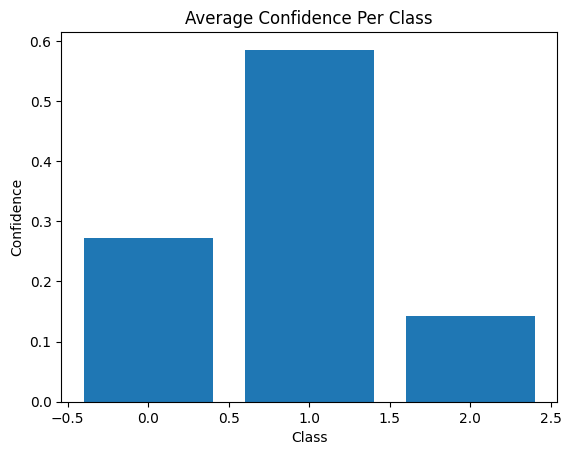

/var/folders/qw/p8rpb13x5xdcc1g501wf9mdw0000gn/T/ipykernel_54216/3409759739.py:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(all_confidences, labels=[f"Class {i}" for i in range(all_confidences.shape[1])])


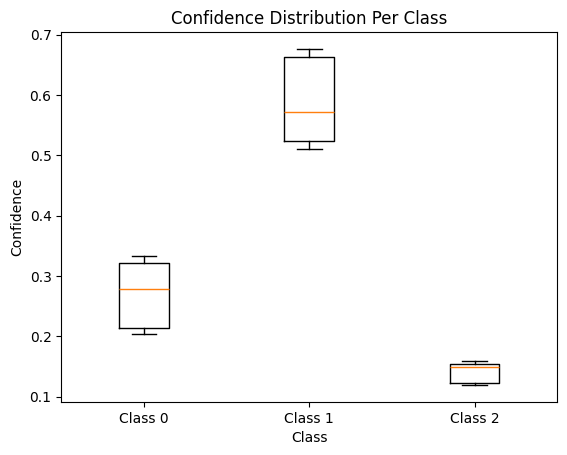

In [82]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming `all_confidences` contains confidence scores for all images
# Shape: (num_images, num_classes)
all_confidences = np.array([model.predict(image.reshape(1, *image.shape))[0] for image in all_images])

# Average confidence per class
mean_confidences = all_confidences.mean(axis=0)

# Bar plot
plt.bar(range(len(mean_confidences)), mean_confidences)
plt.title("Average Confidence Per Class")
plt.xlabel("Class")
plt.ylabel("Confidence")
plt.show()

# Box plot
plt.boxplot(all_confidences, labels=[f"Class {i}" for i in range(all_confidences.shape[1])])
plt.title("Confidence Distribution Per Class")
plt.xlabel("Class")
plt.ylabel("Confidence")
plt.show()


### Convert Metrics to Pandas DataFrame

In [83]:
import pandas as pd

# Create a DataFrame for metrics
metrics_df = pd.DataFrame(lime_metrics)


In [84]:
metrics_df

,label,highlighted_pixels,confidence
0,0,13129,1.0
1,1,12060,1.0
2,0,11984,1.0
3,1,11158,1.0
4,1,9301,1.0
...,...,...,...
295,0,11536,1.0
296,0,11962,1.0
297,0,14038,1.0
298,0,12668,1.0


## Visualisations

#### (a) Average Highlighted Pixels by Class

/var/folders/qw/p8rpb13x5xdcc1g501wf9mdw0000gn/T/ipykernel_54216/3698608533.py:5: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=metrics_df, x='label', y='highlighted_pixels', ci=None)


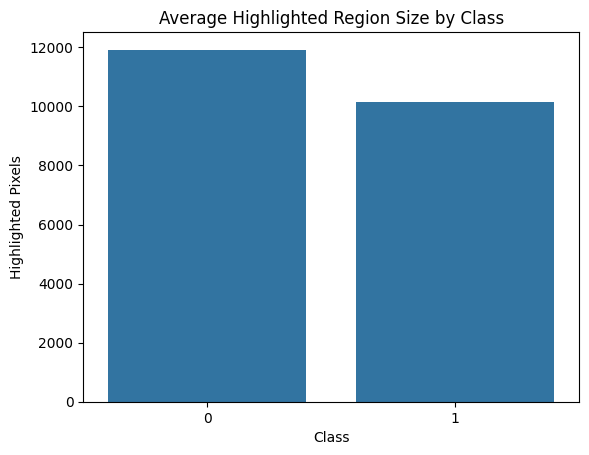

In [85]:
import matplotlib.pyplot as plt
import seaborn as sns

# Bar chart of highlighted region size by class
sns.barplot(data=metrics_df, x='label', y='highlighted_pixels', ci=None)
plt.title('Average Highlighted Region Size by Class')
plt.xlabel('Class')
plt.ylabel('Highlighted Pixels')
plt.show()


#### (c) Aggregate Heatmap of Pixel Importance

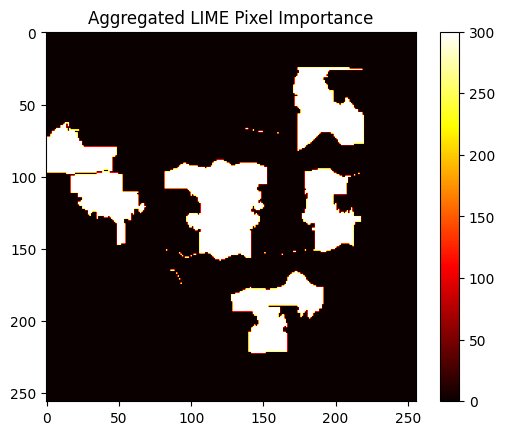

In [87]:
# Initialize an empty heatmap
heatmap = np.zeros_like(all_images[0].squeeze())

# Sum masks across all images
for i, image in enumerate(all_images):
    _, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=True,
        num_features=10,
        hide_rest=False
    )
    heatmap += mask

# Plot the aggregated heatmap
plt.imshow(heatmap, cmap='hot')
plt.title('Aggregated LIME Pixel Importance')
plt.colorbar()
plt.show()


In [92]:
print(f"all_labels shape: {all_labels.shape}")
print(f"Sample of all_labels: {all_labels[:5]}")


all_labels shape: (300, 3, 3)
Sample of all_labels: [[[1. 0. 0.]
  [0. 1. 0.]
  [1. 0. 0.]]

 [[0. 1. 0.]
  [1. 0. 0.]
  [1. 0. 0.]]

 [[1. 0. 0.]
  [1. 0. 0.]
  [0. 1. 0.]]

 [[0. 1. 0.]
  [1. 0. 0.]
  [1. 0. 0.]]

 [[0. 1. 0.]
  [1. 0. 0.]
  [1. 0. 0.]]]


Class 3.0: 300
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/st

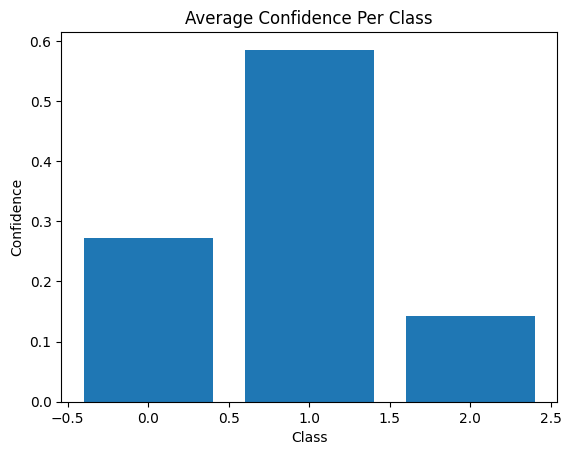

/var/folders/qw/p8rpb13x5xdcc1g501wf9mdw0000gn/T/ipykernel_54216/1487954343.py:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(all_confidences, labels=[f"Class {i}" for i in range(all_confidences.shape[1])])


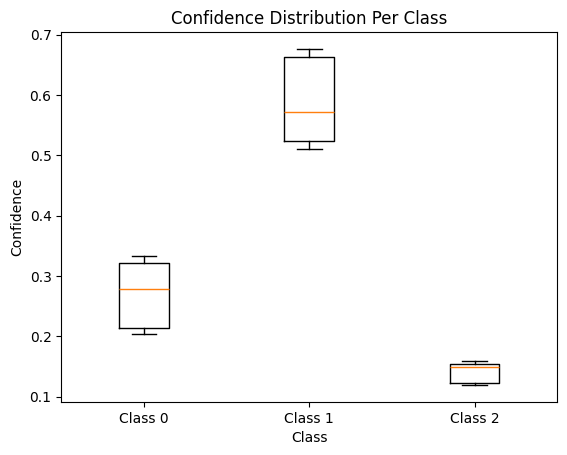

In [93]:
import matplotlib.pyplot as plt
import numpy as np

# Preprocess `all_labels` from shape (300, 3, 3)
if len(all_labels.shape) == 3 and all_labels.shape[1:] == (3, 3):
    # Collapse 3x3 matrices into one-hot encoding by summing along axes 1 and 2
    all_labels_processed = np.sum(all_labels, axis=(1, 2))  # Shape: (300, 3)
else:
    all_labels_processed = all_labels  # Use as-is if already correct

# Determine if the labels are one-hot encoded or flat indices
if len(all_labels_processed.shape) > 1 and all_labels_processed.shape[1] > 1:
    # One-hot encoded labels
    class_counts = np.sum(all_labels_processed, axis=0)  # Count occurrences per class
    for i, count in enumerate(class_counts):
        print(f"Class {i}: {int(count)}")
else:
    # Flat indices
    unique_classes, class_counts = np.unique(all_labels_processed, return_counts=True)
    for cls, count in zip(unique_classes, class_counts):
        print(f"Class {cls}: {count}")

# Assuming `all_confidences` contains confidence scores for all images
# Shape: (num_images, num_classes)
all_confidences = np.array([model.predict(image.reshape(1, *image.shape))[0] for image in all_images])

# Average confidence per class
mean_confidences = all_confidences.mean(axis=0)

# Bar plot
plt.bar(range(len(mean_confidences)), mean_confidences)
plt.title("Average Confidence Per Class")
plt.xlabel("Class")
plt.ylabel("Confidence")
plt.show()

# Box plot
plt.boxplot(all_confidences, labels=[f"Class {i}" for i in range(all_confidences.shape[1])])
plt.title("Confidence Distribution Per Class")
plt.xlabel("Class")
plt.ylabel("Confidence")
plt.show()


## Generating a Dependence Plot

### **1. Collect all the explanations**

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


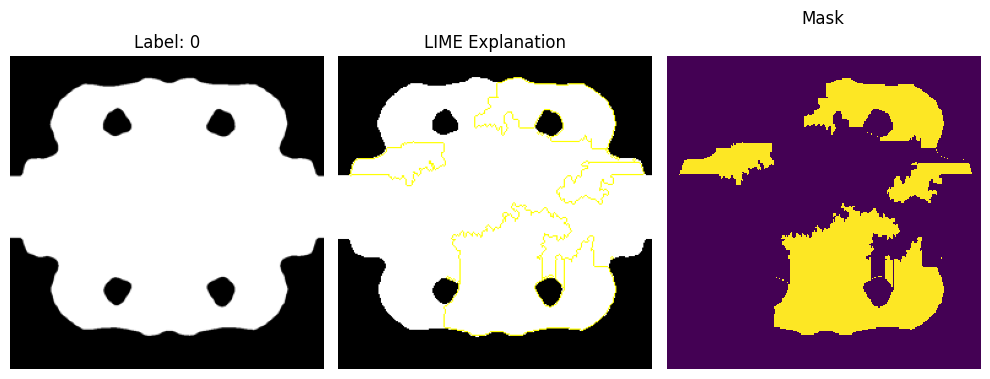

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


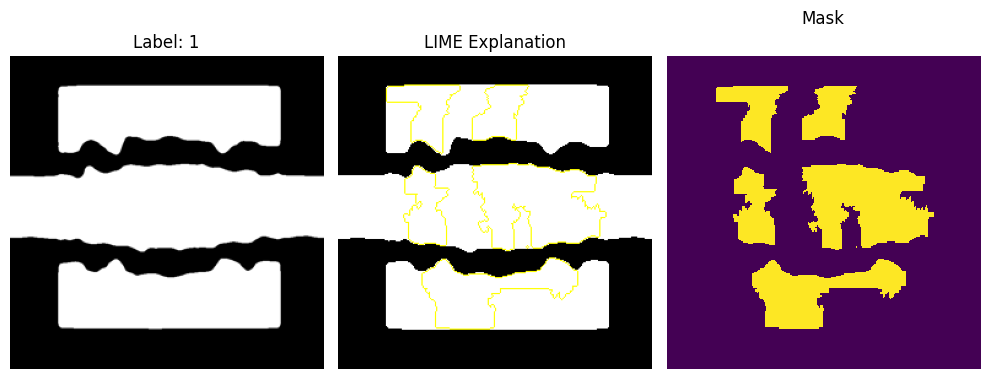

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


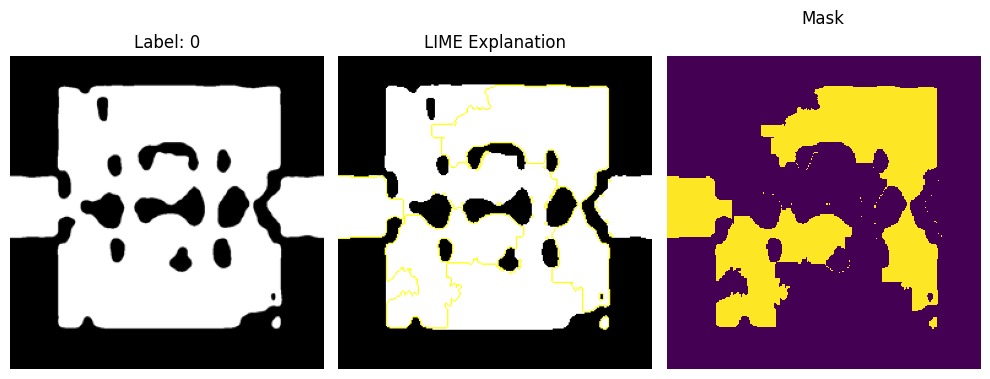

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


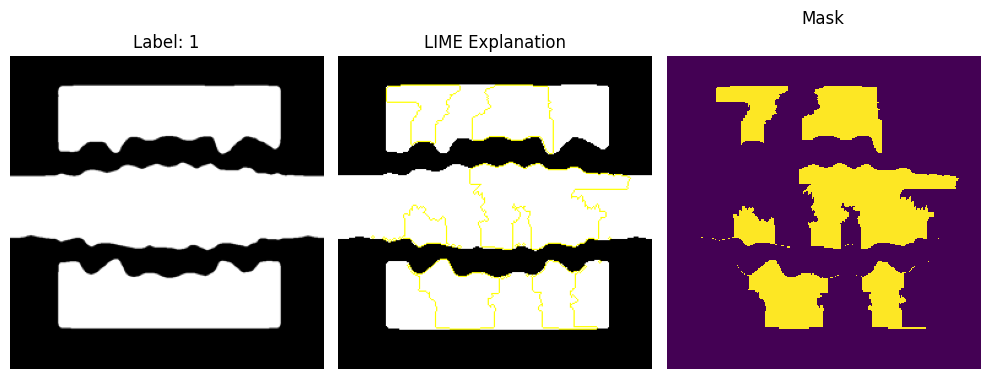

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


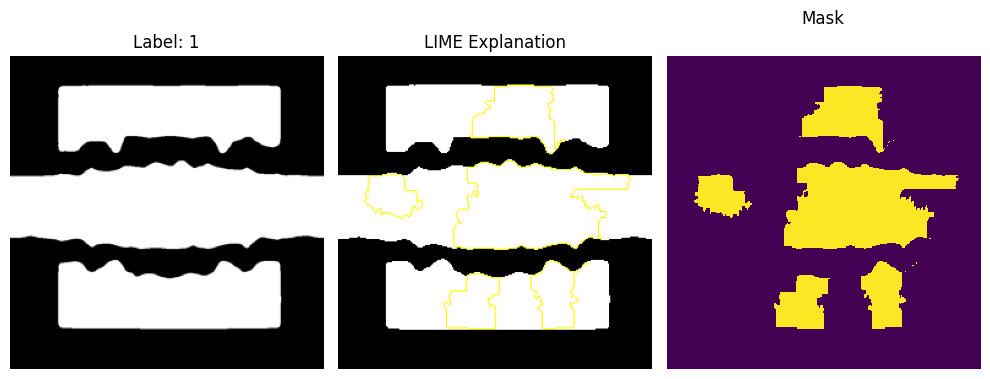

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


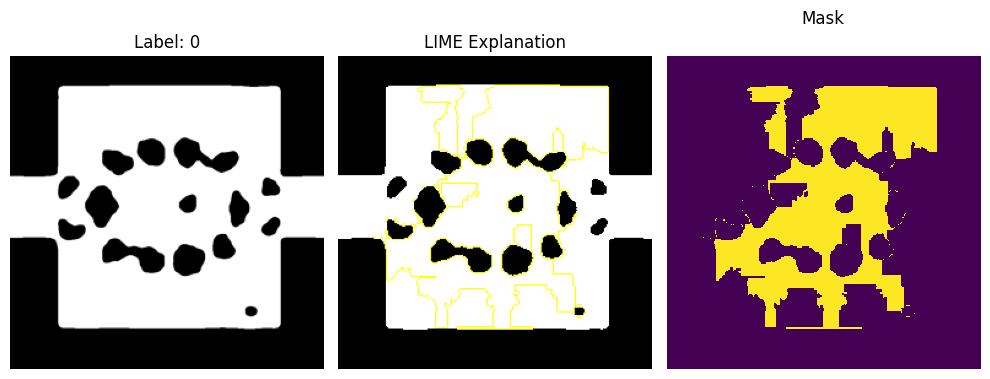

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


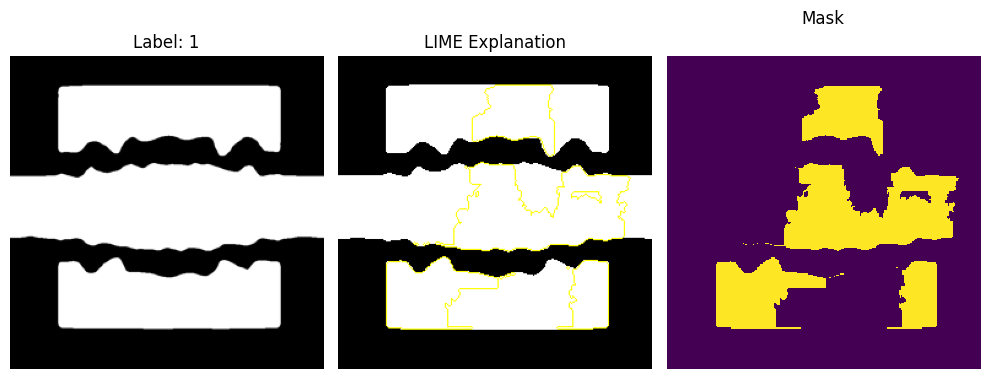

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


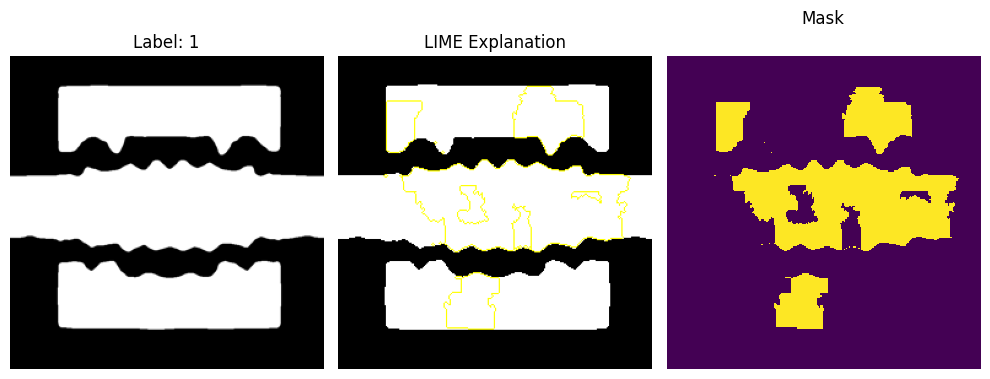

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


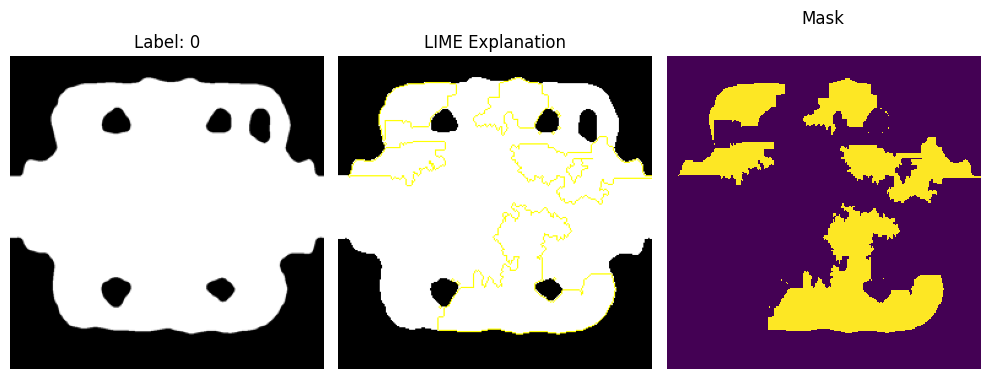

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


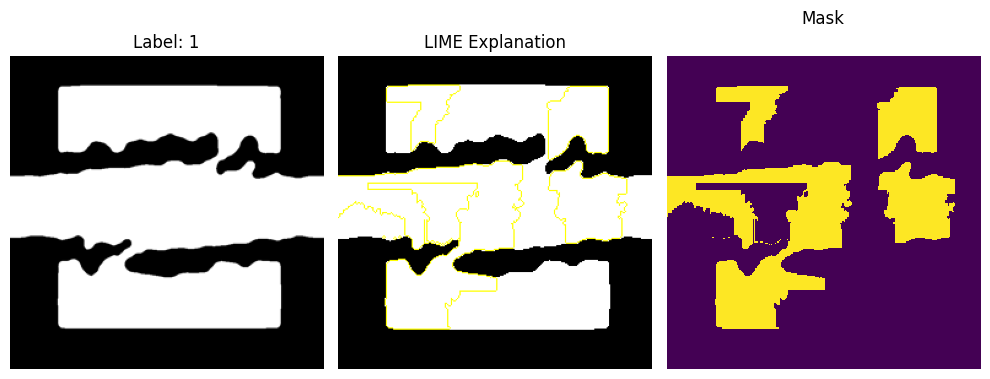

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


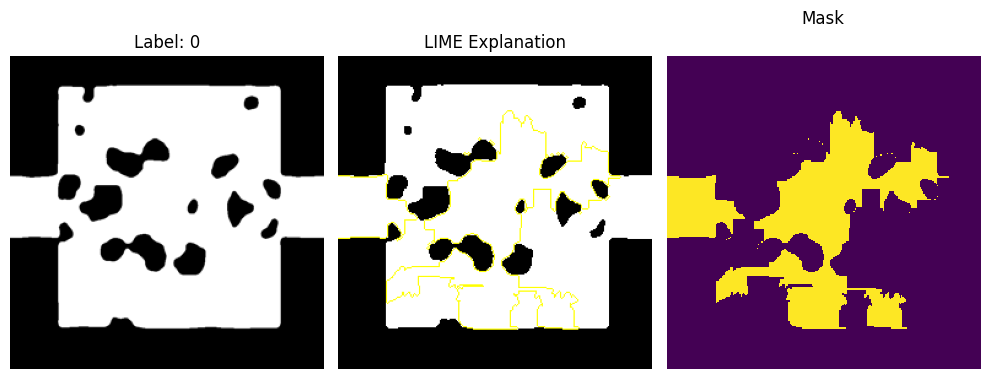

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


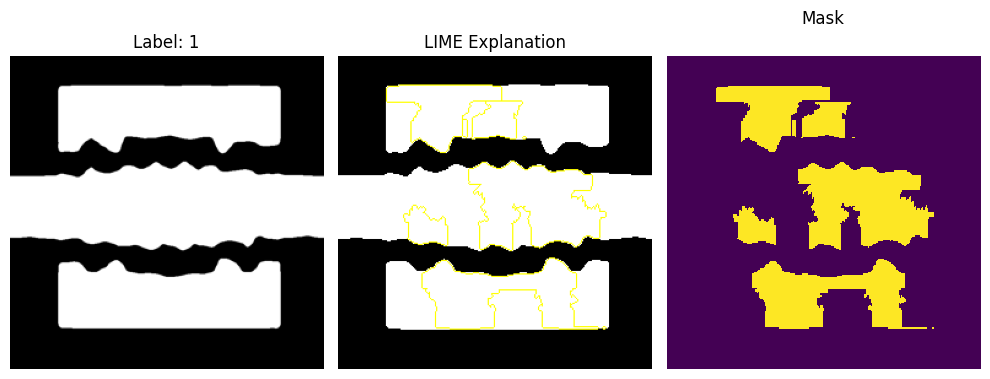

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


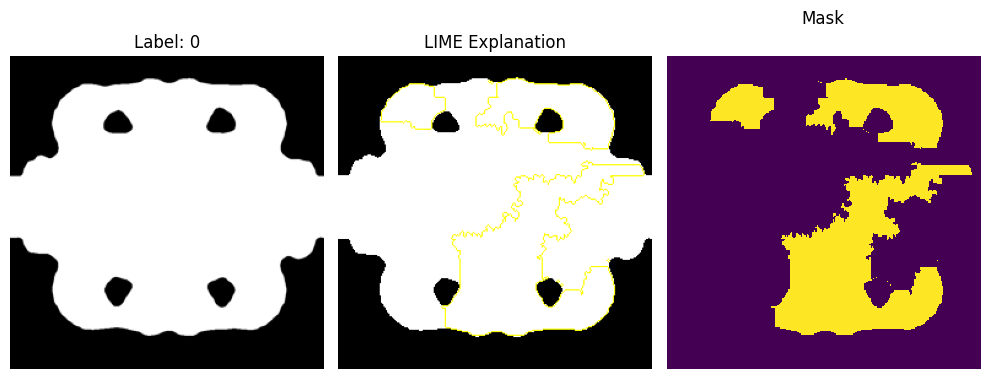

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


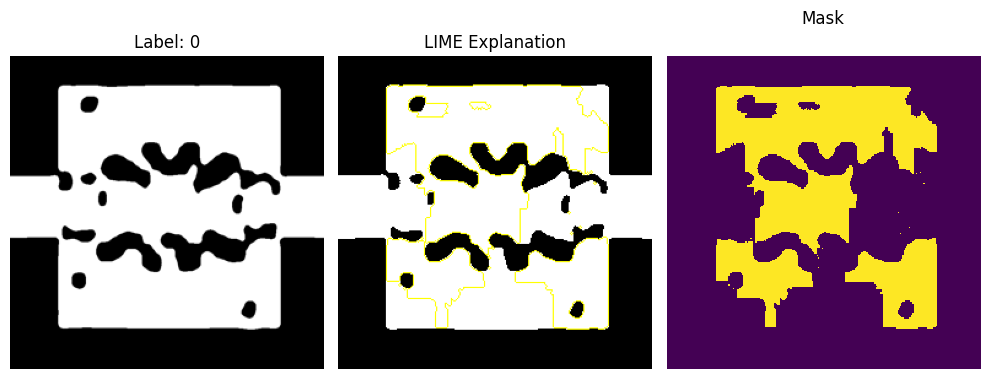

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


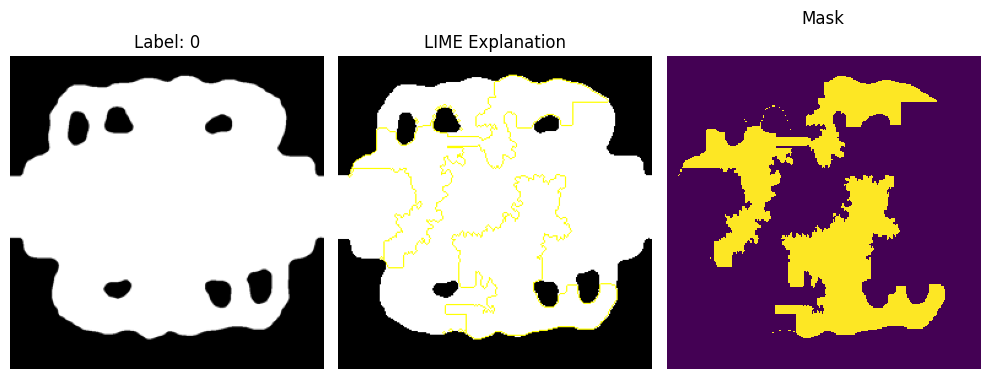

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


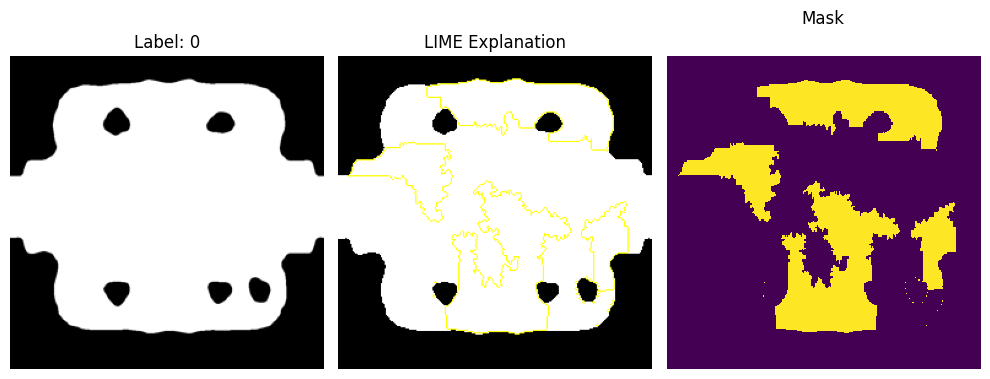

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


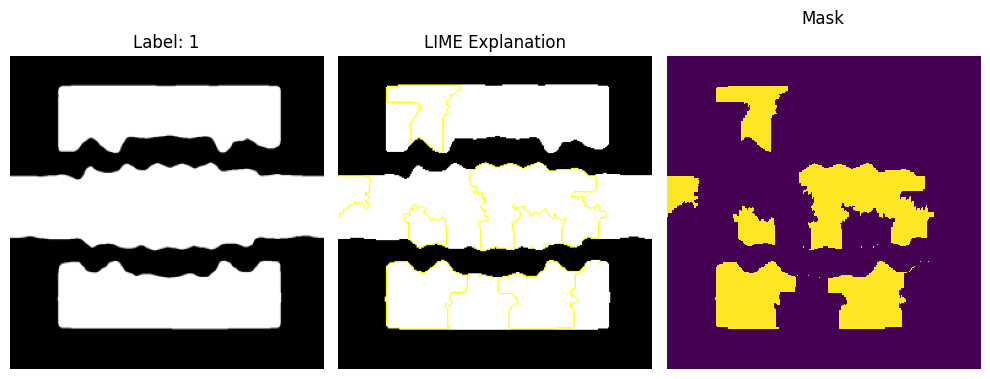

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


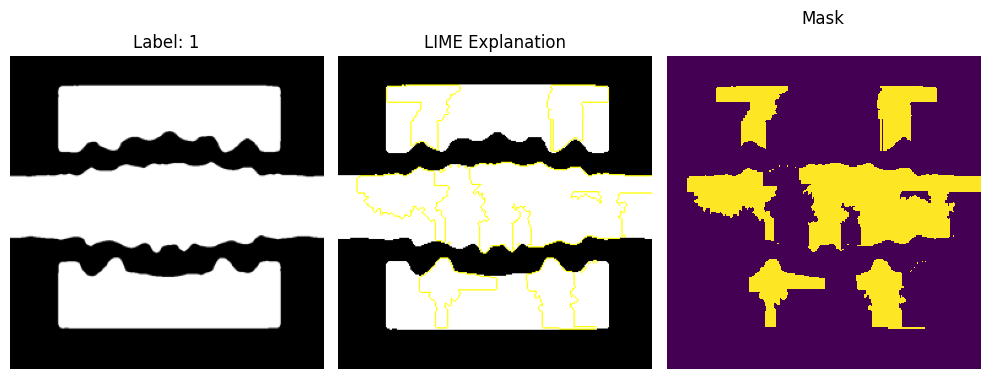

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


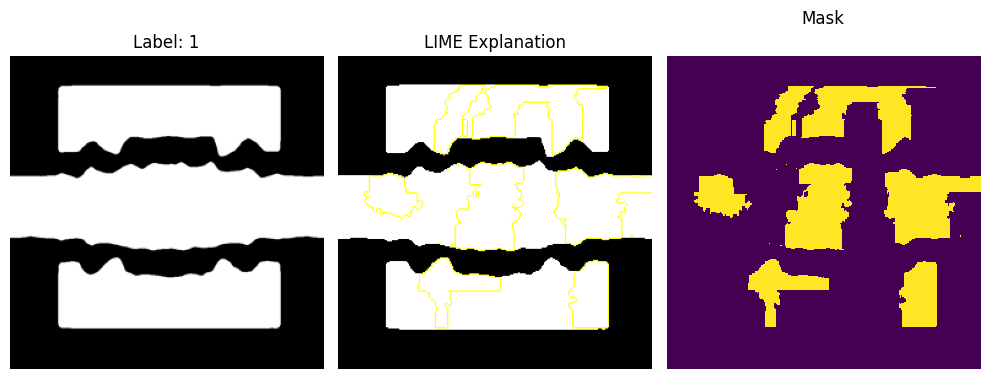

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


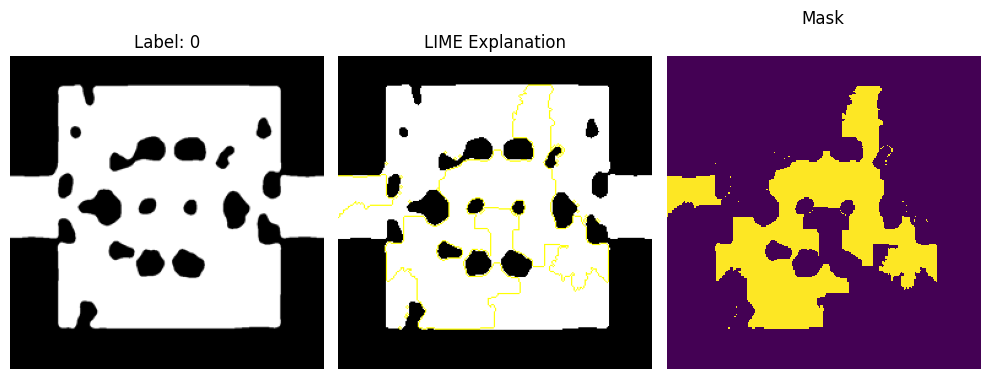

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


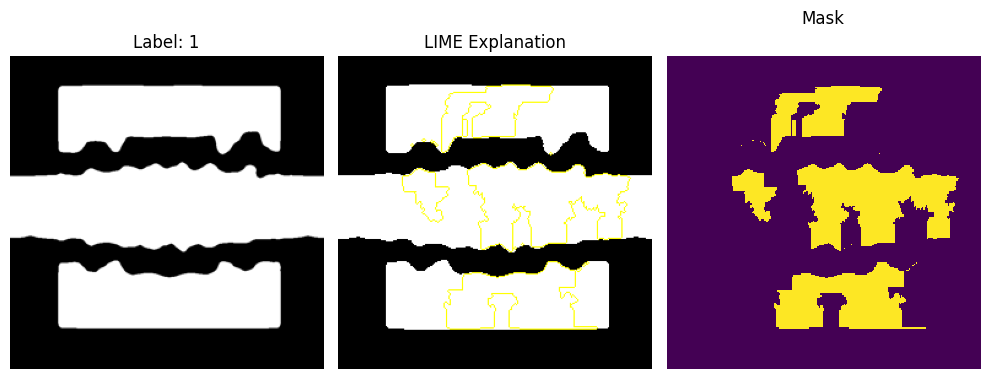

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


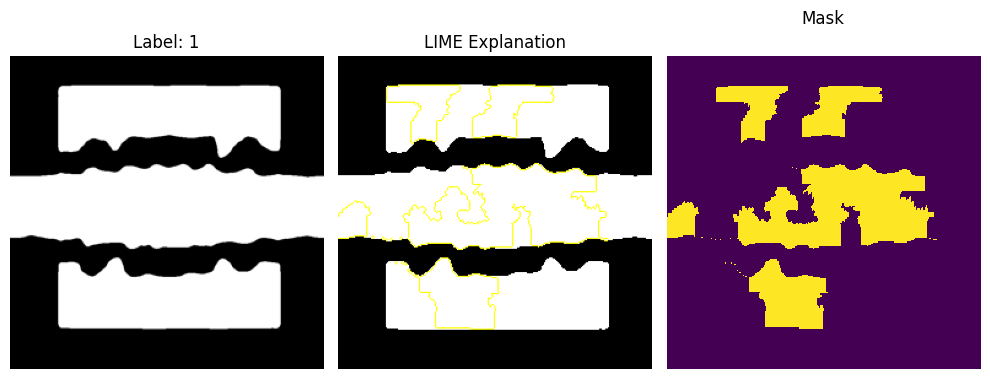

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


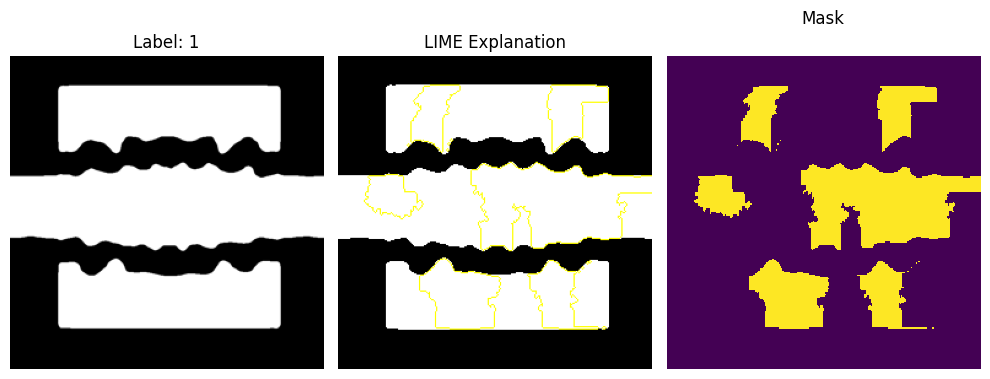

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


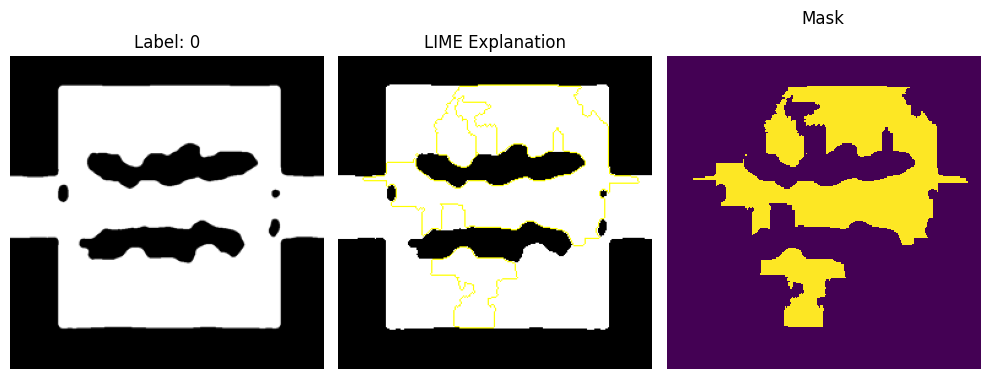

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


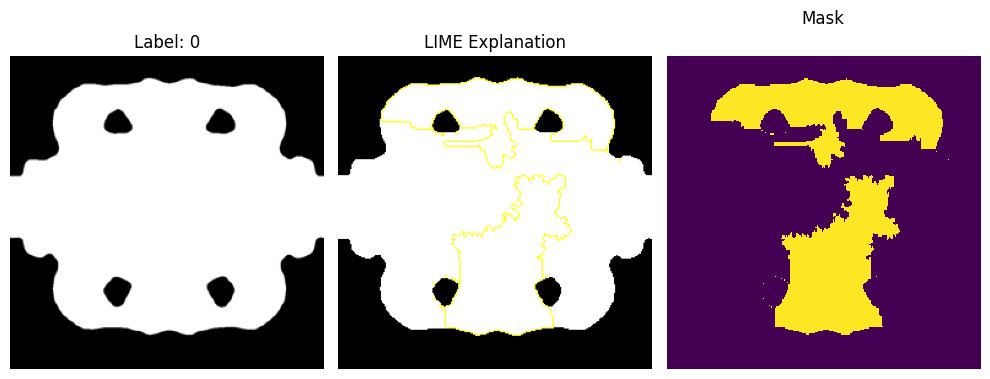

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


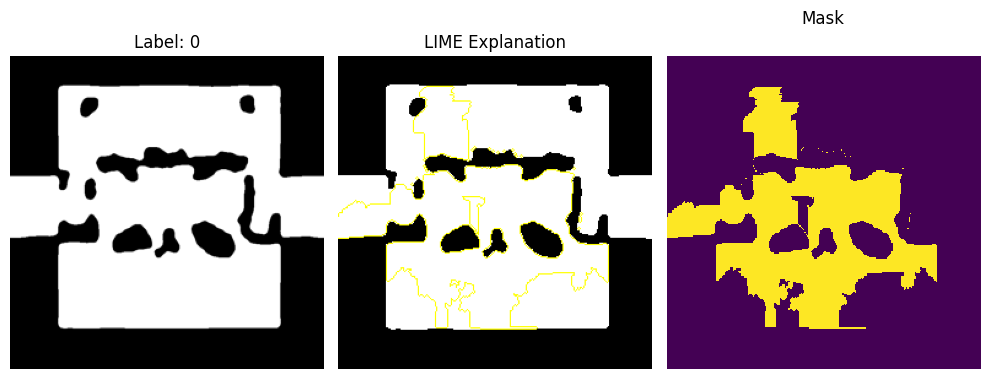

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


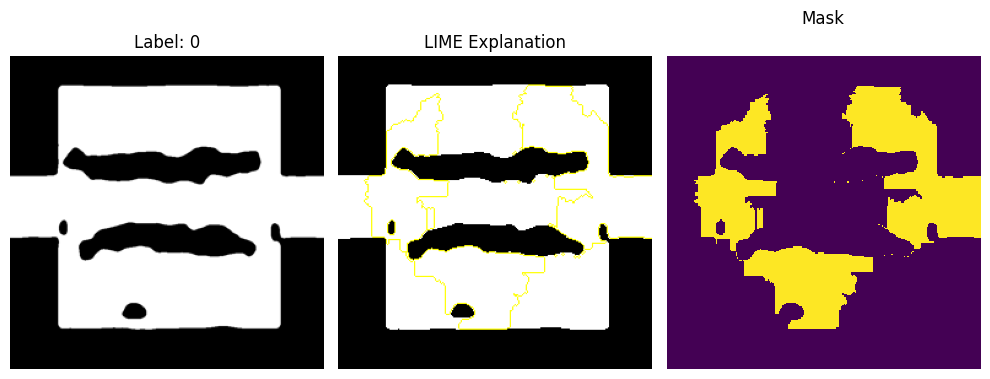

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


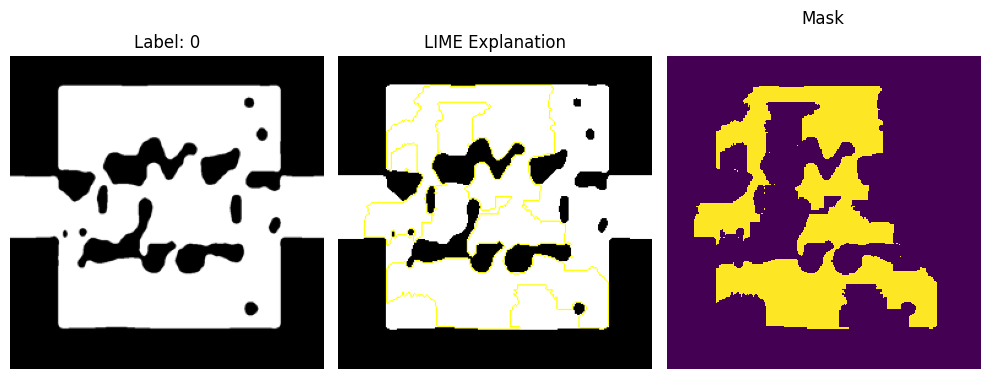

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


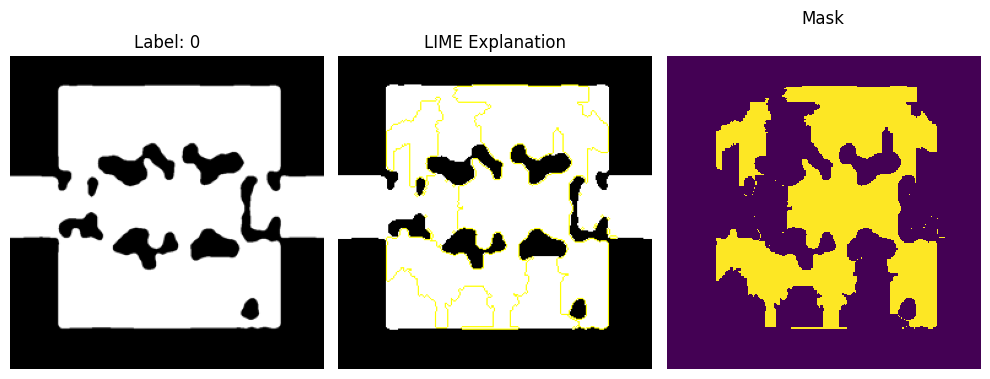

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


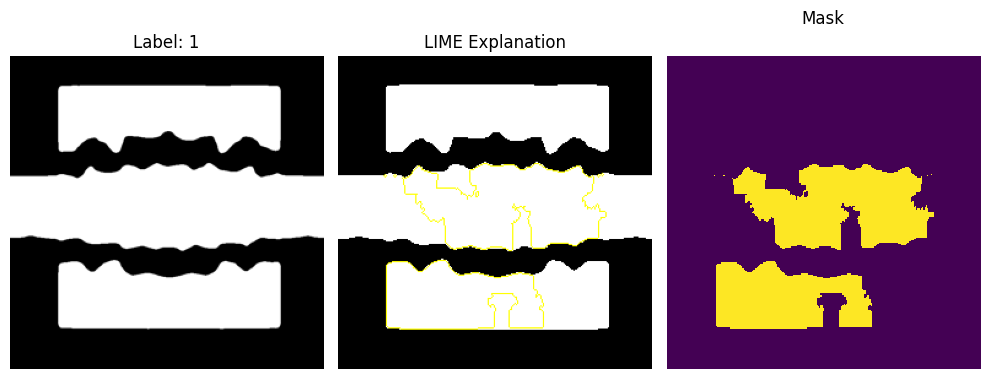

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


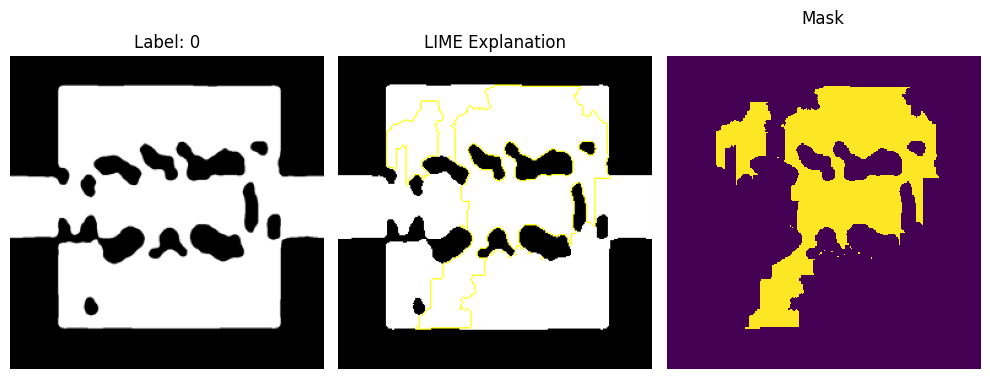

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


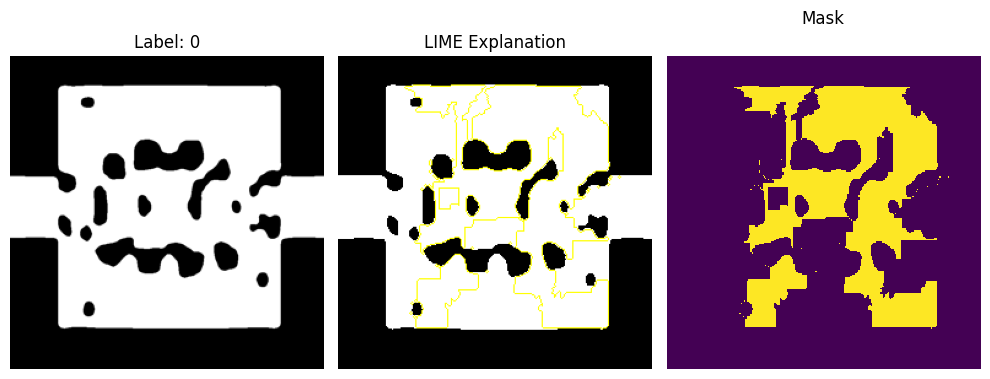

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


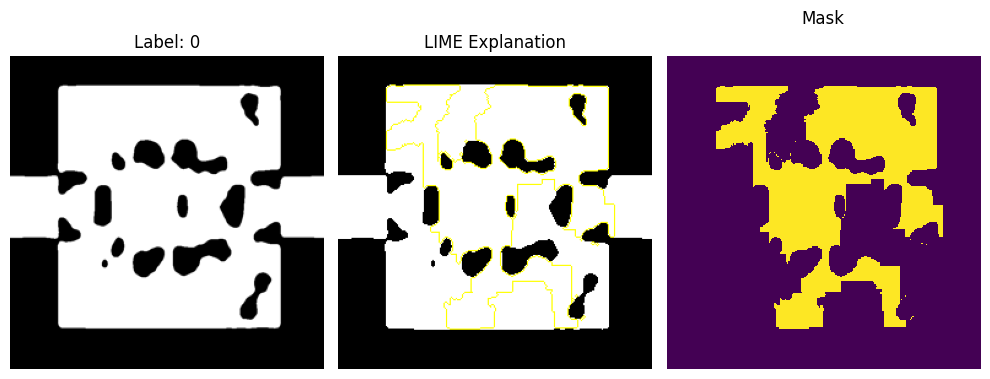

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


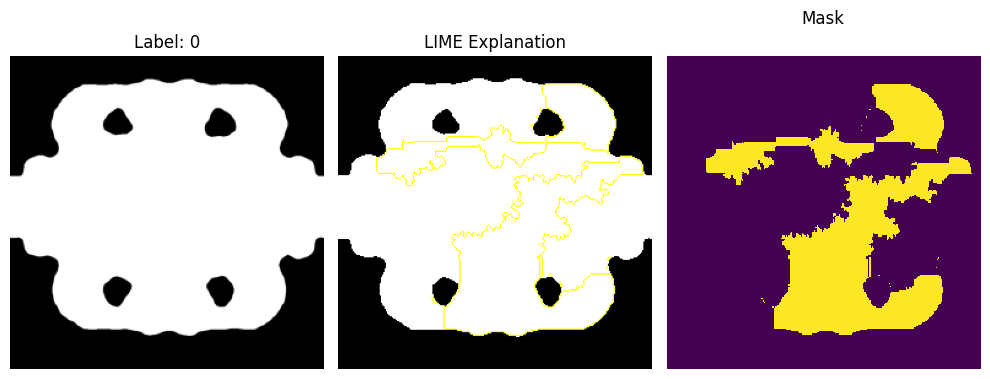

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


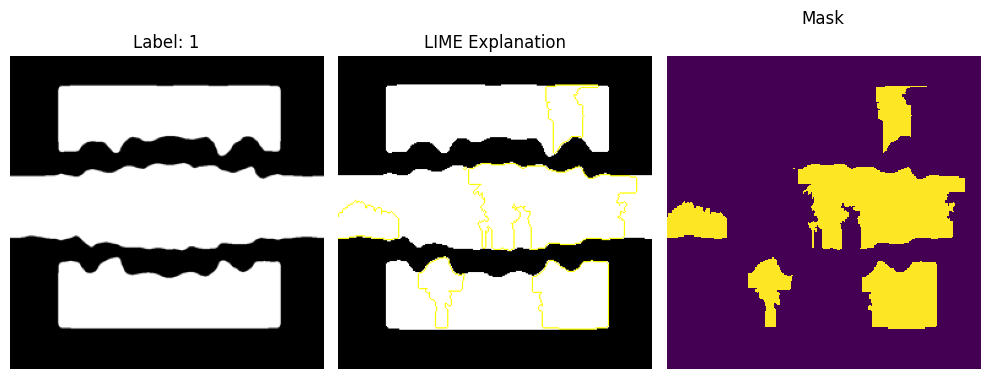

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


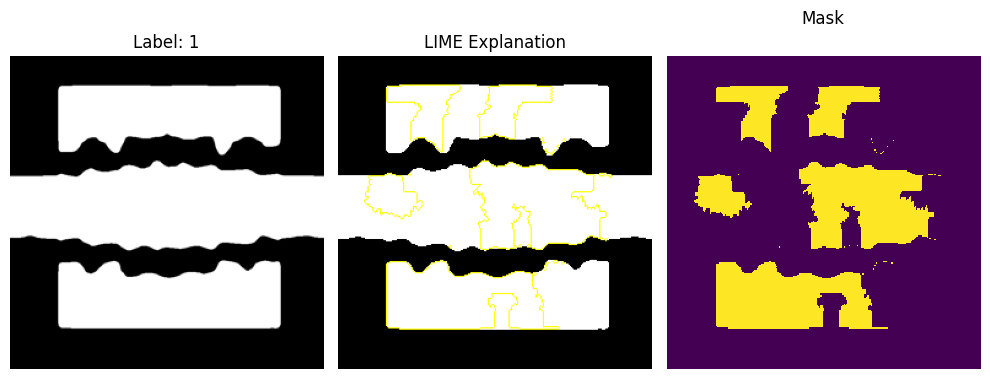

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


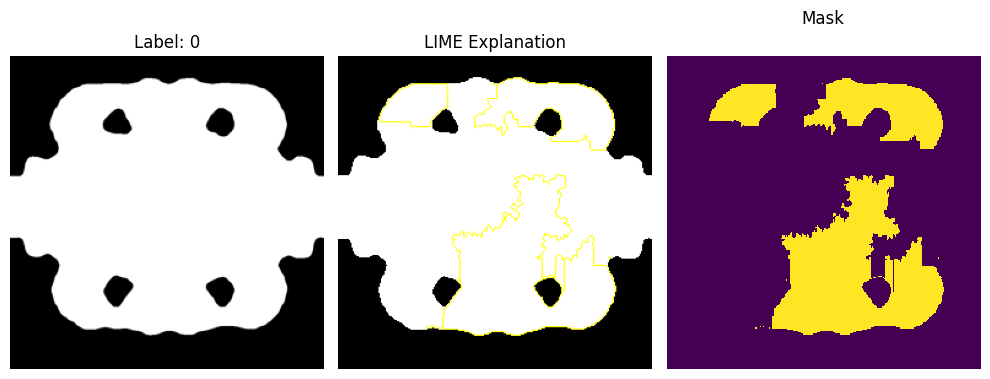

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


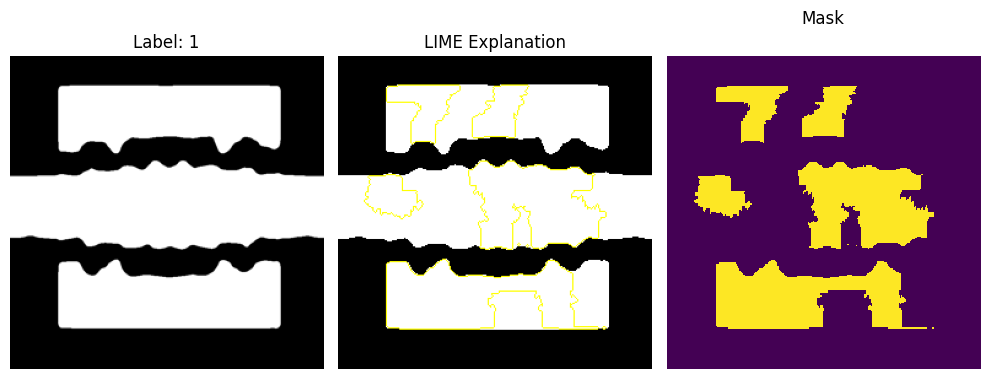

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


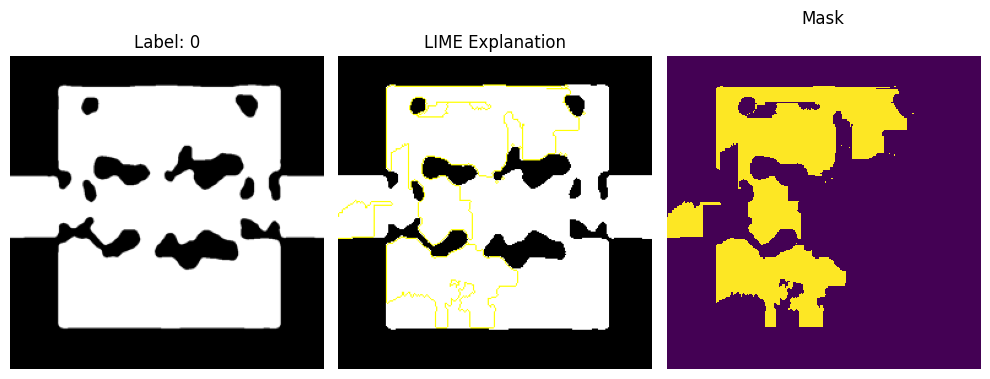

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


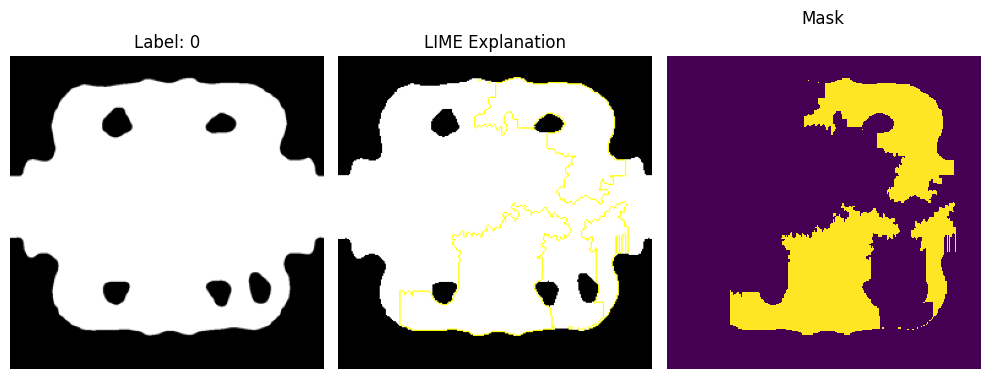

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


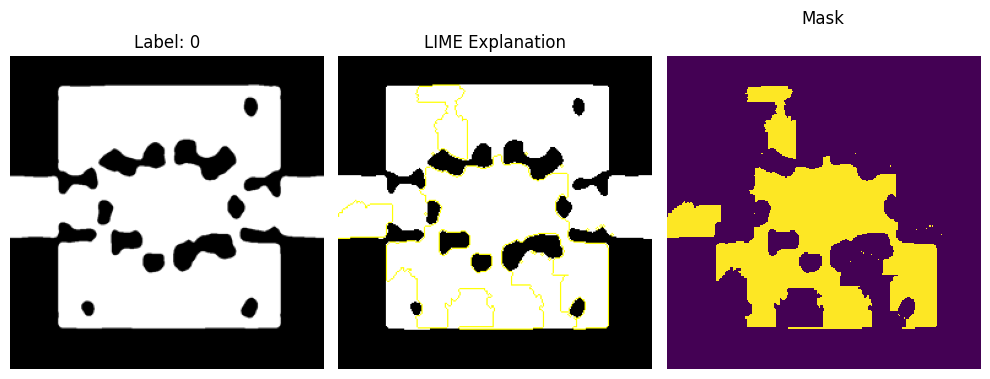

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


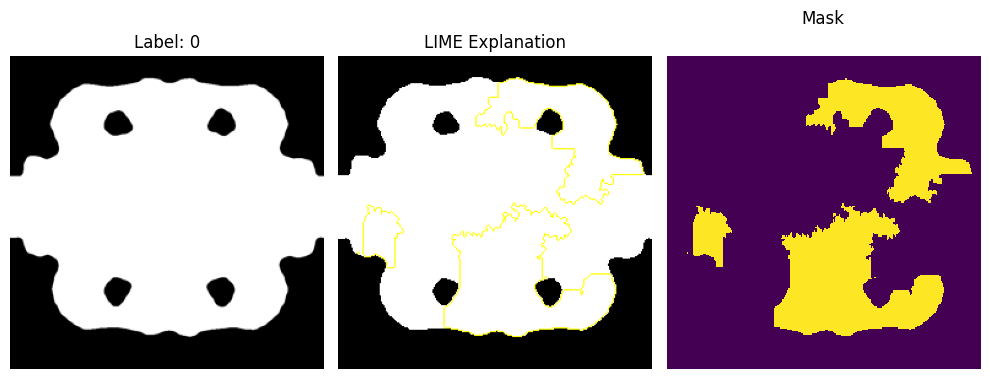

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


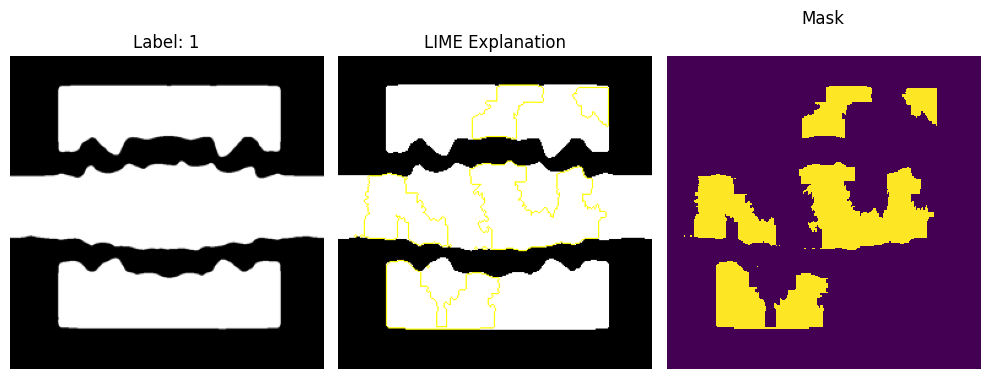

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


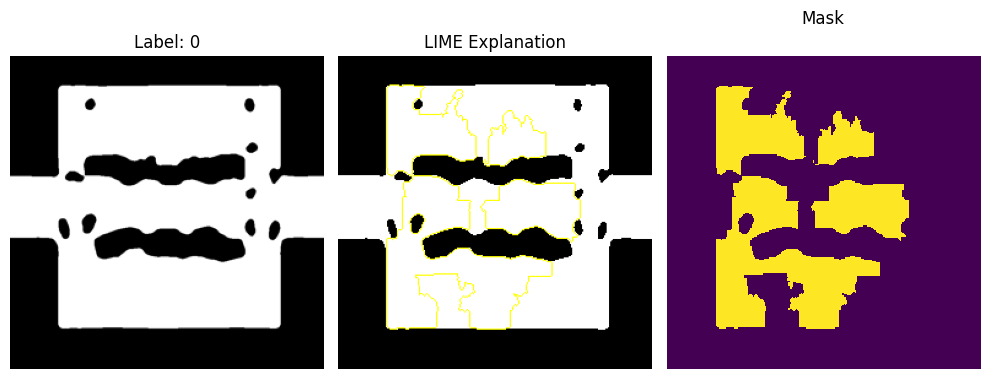

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


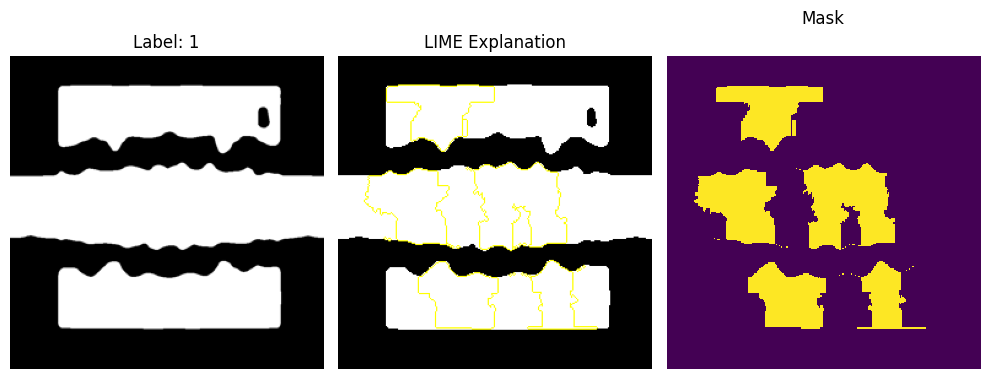

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


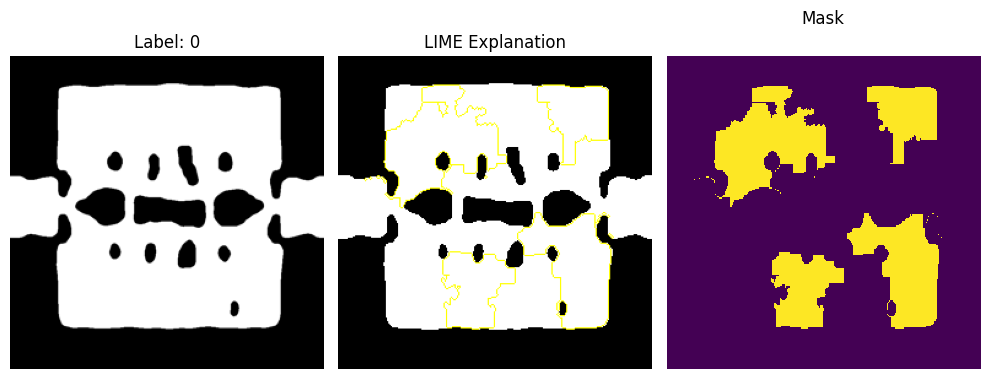

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


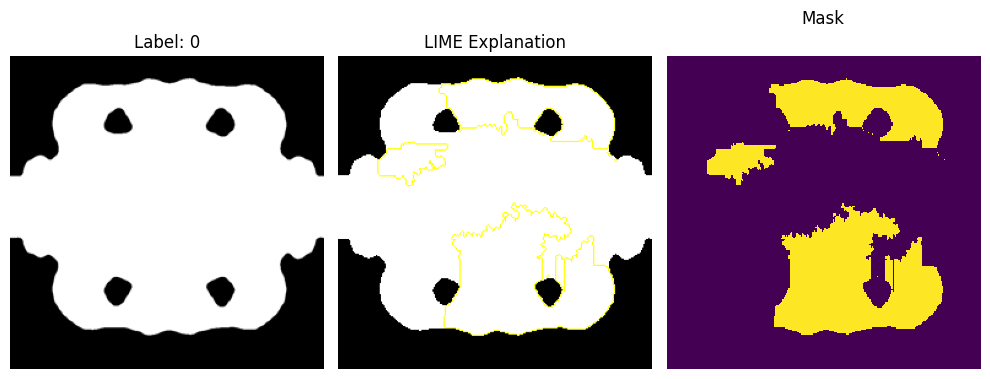

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


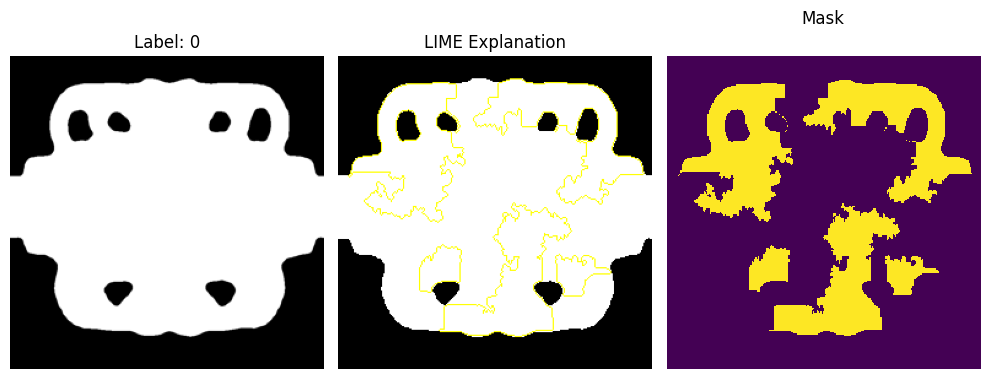

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


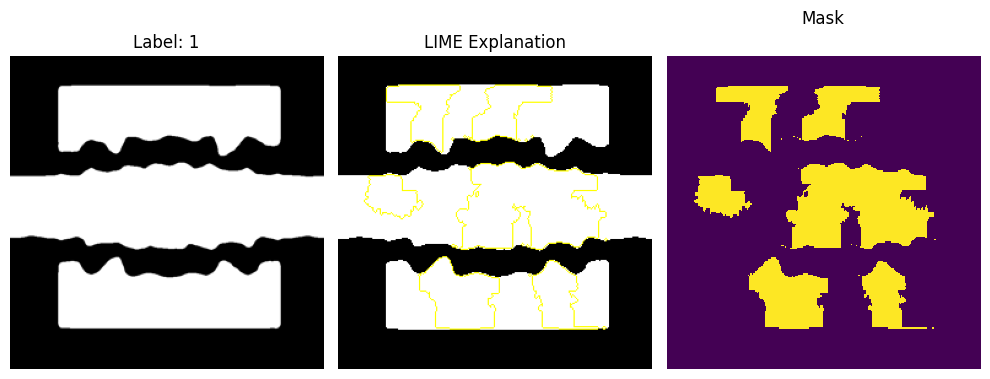

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


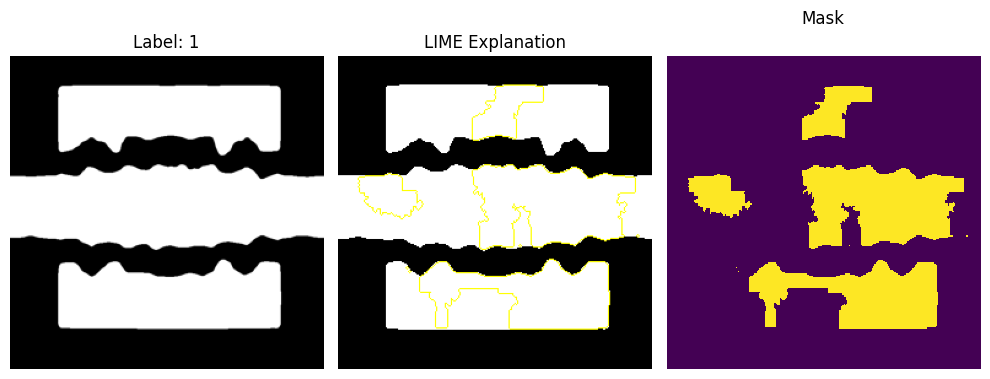

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


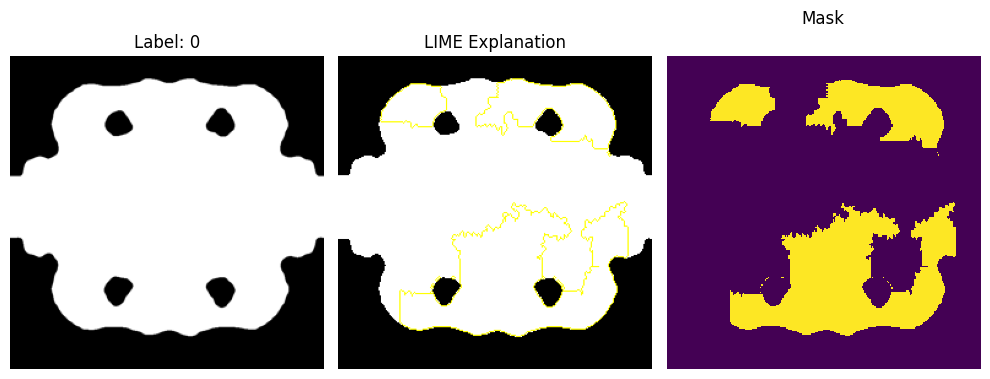

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


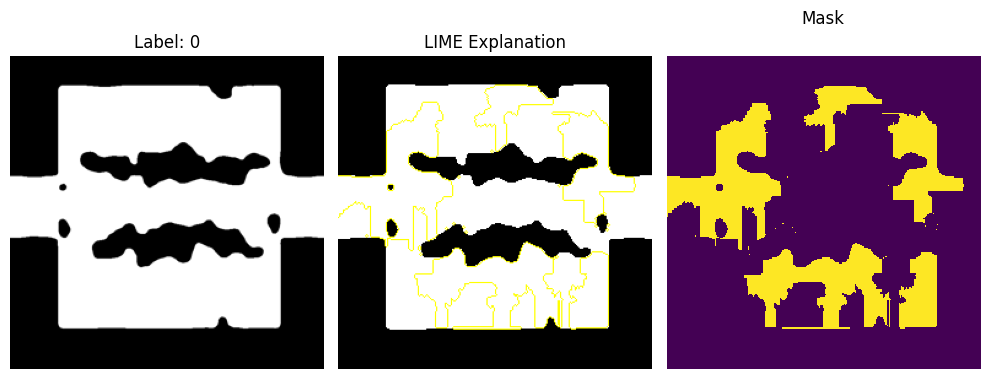

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


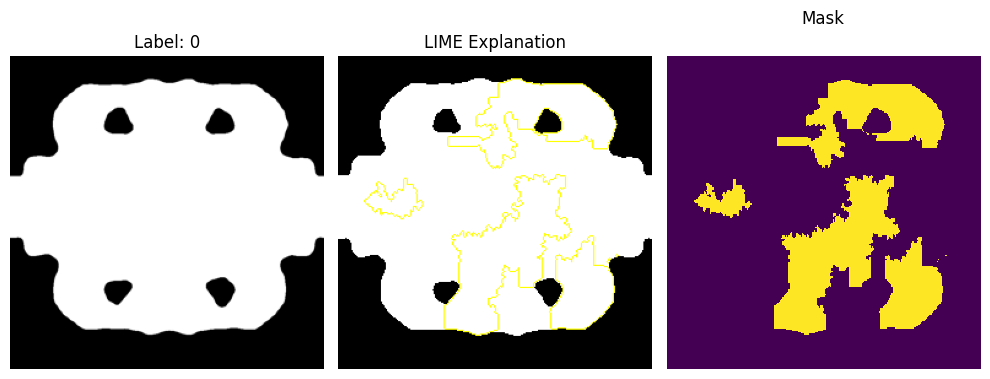

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


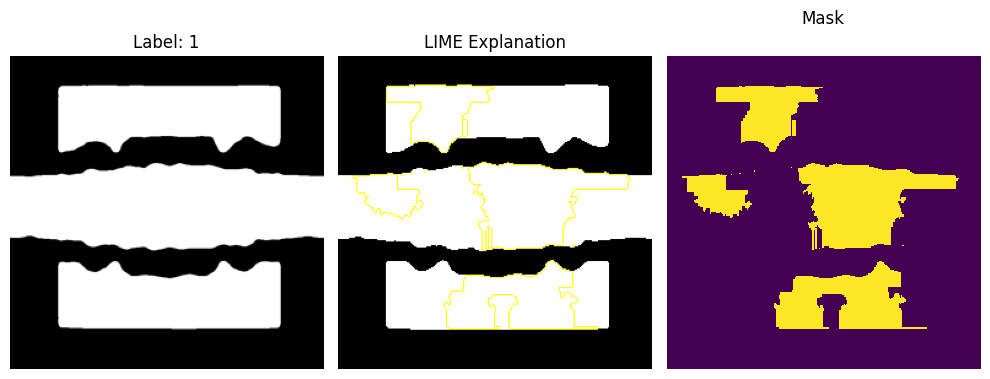

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


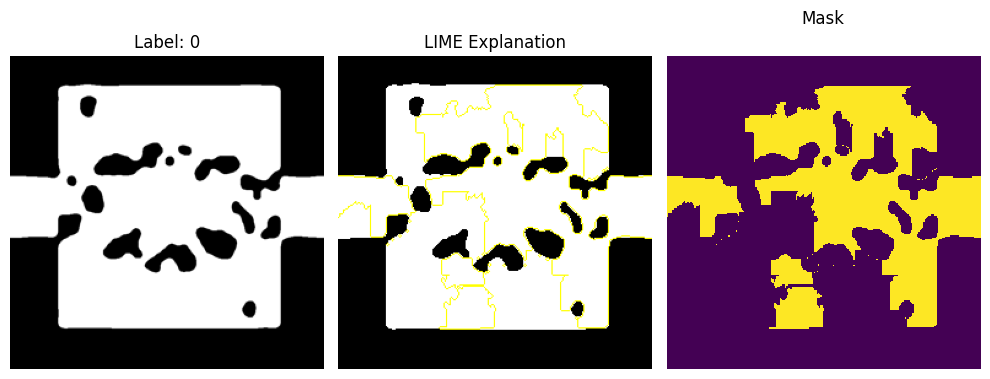

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


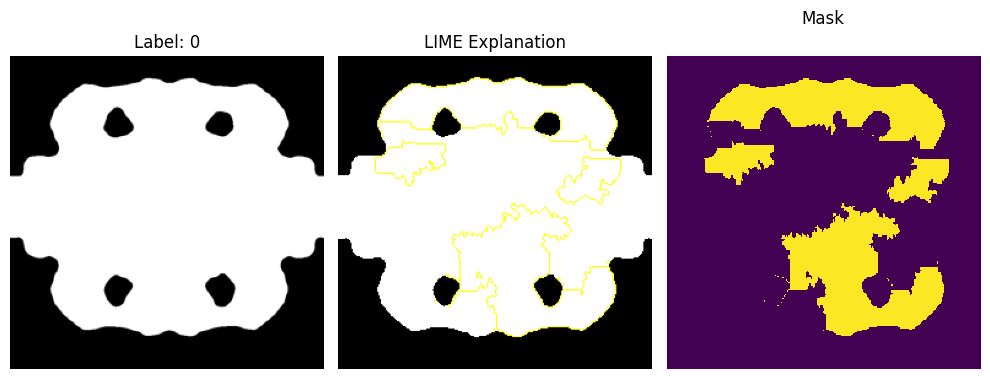

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


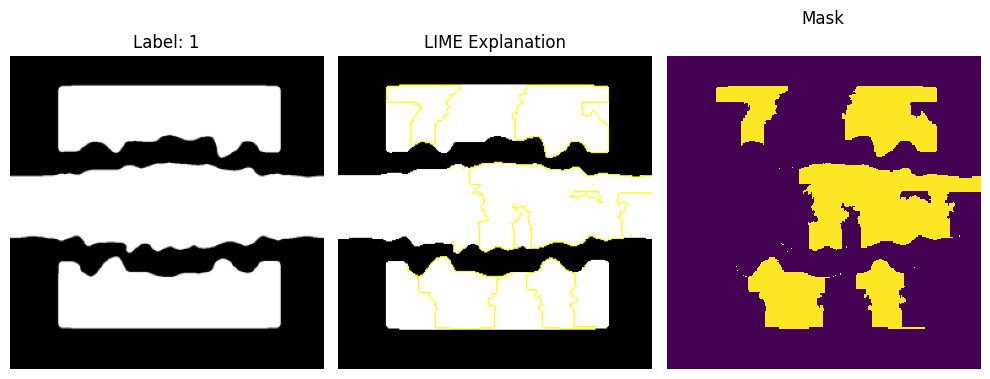

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


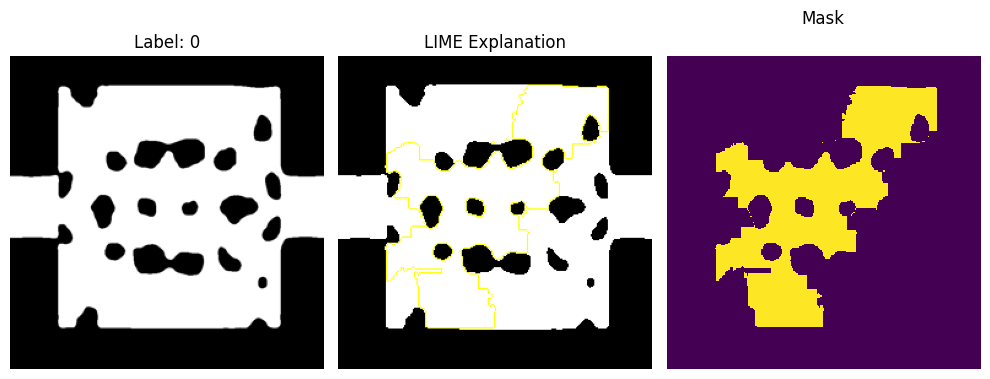

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


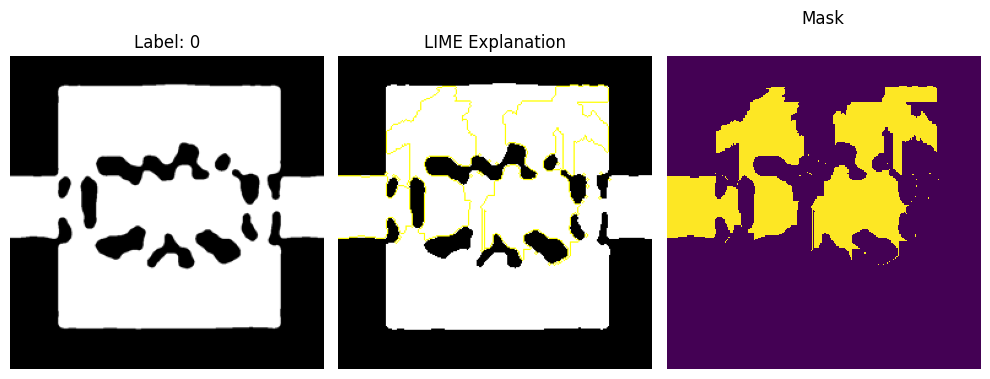

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


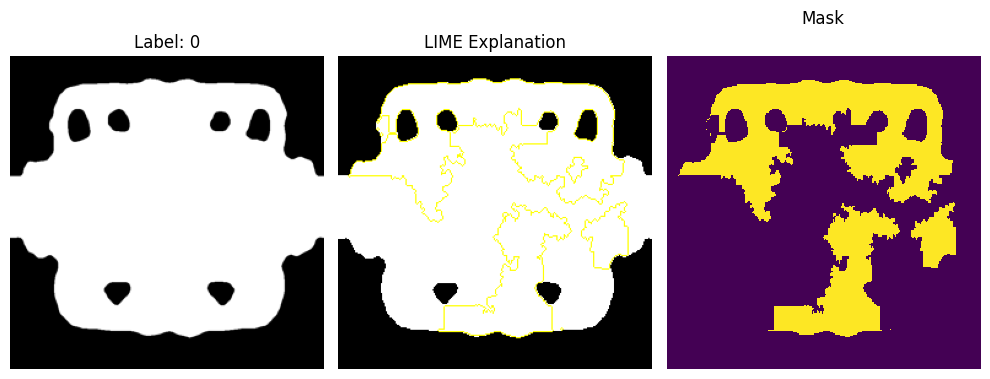

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


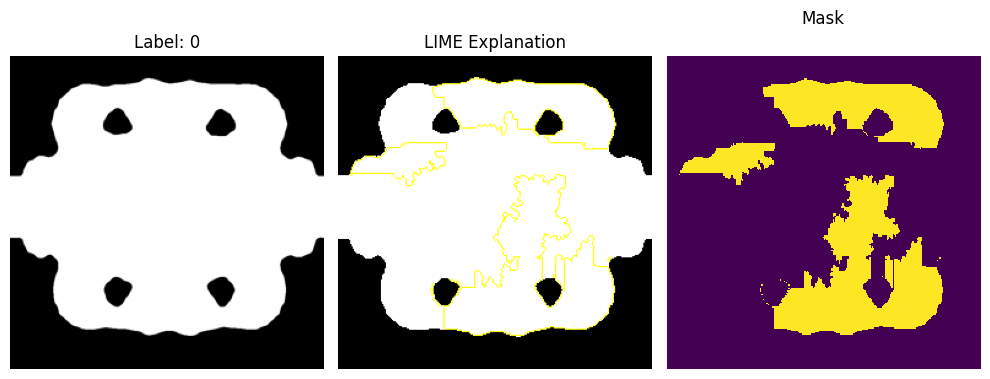

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


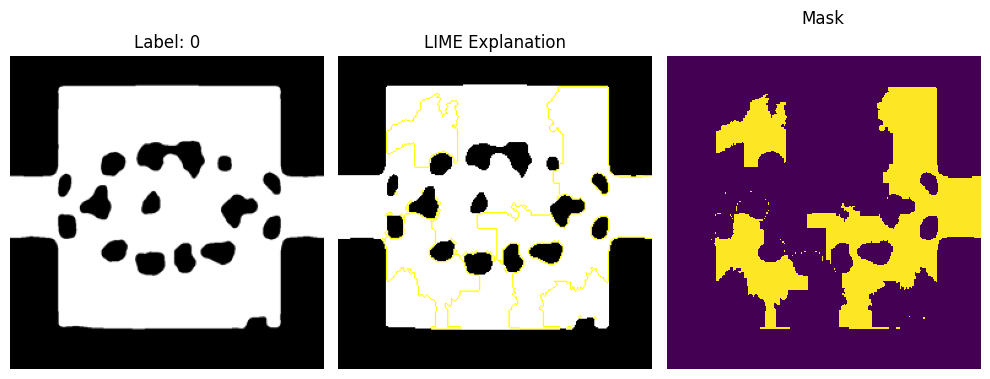

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


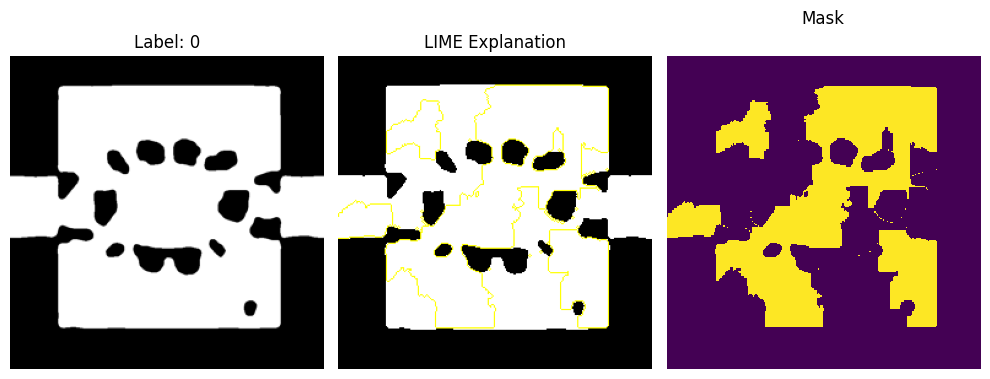

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


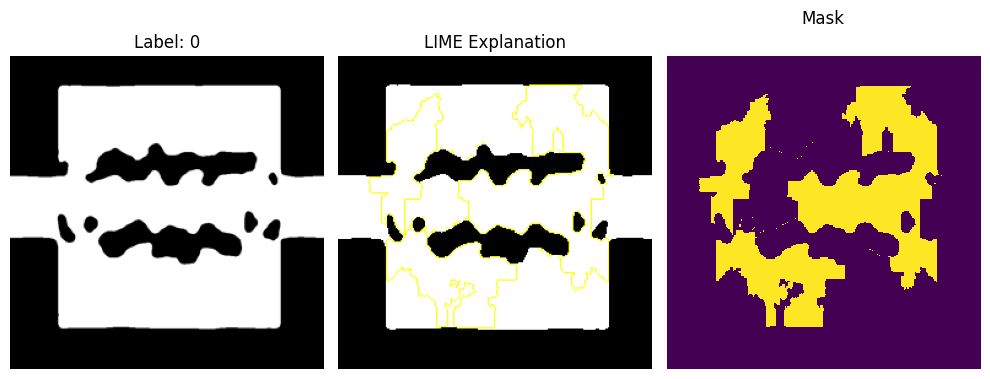

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


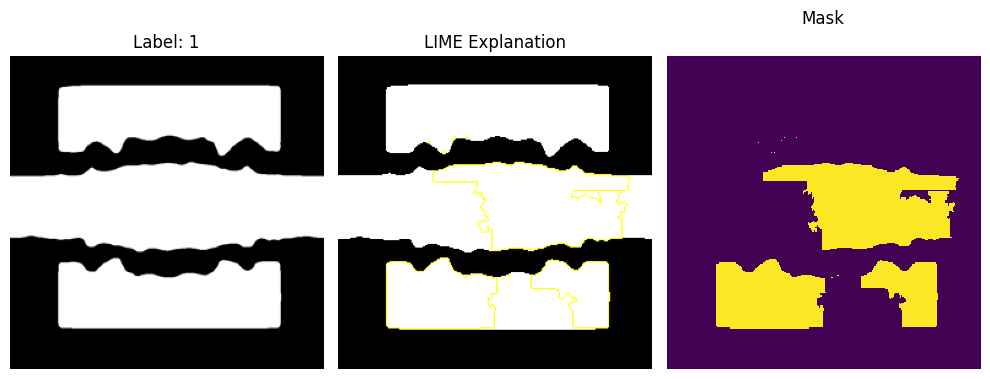

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


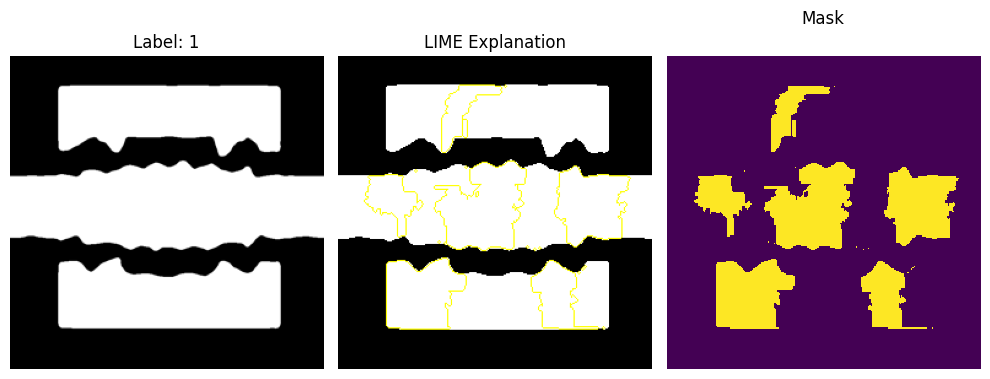

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


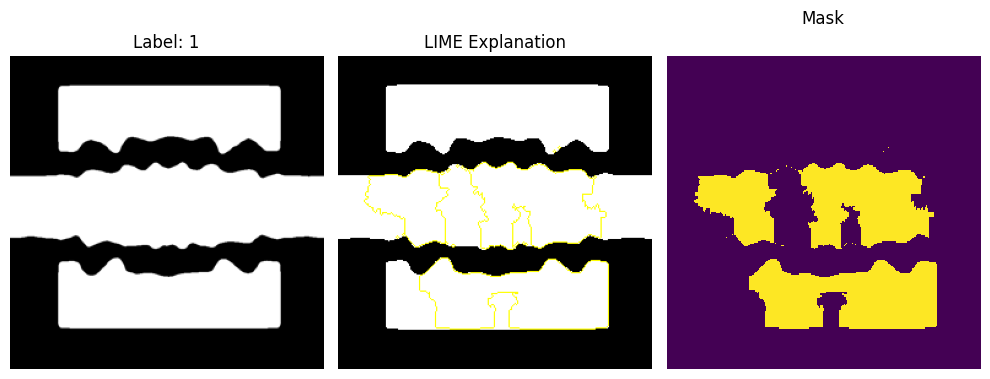

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


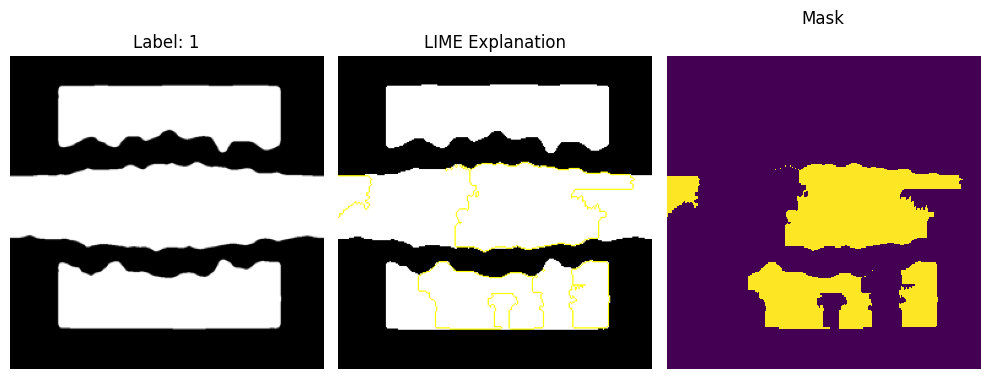

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


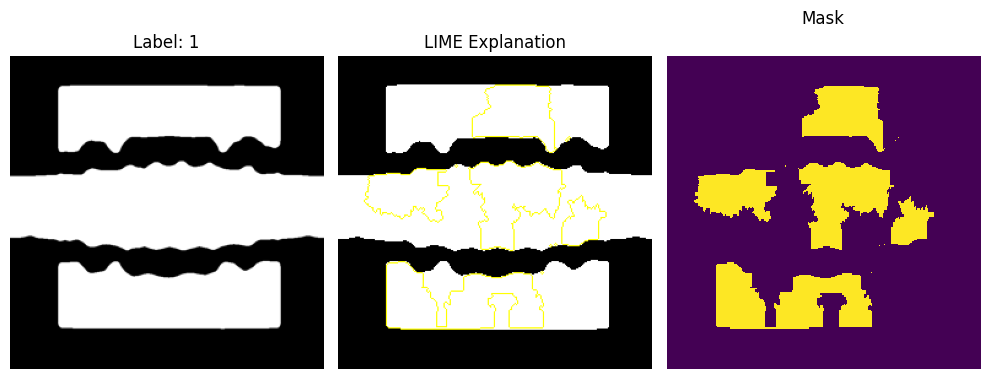

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


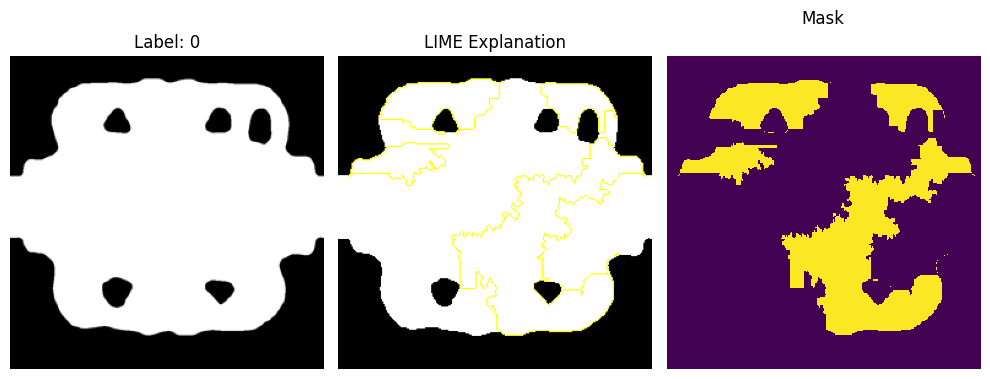

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


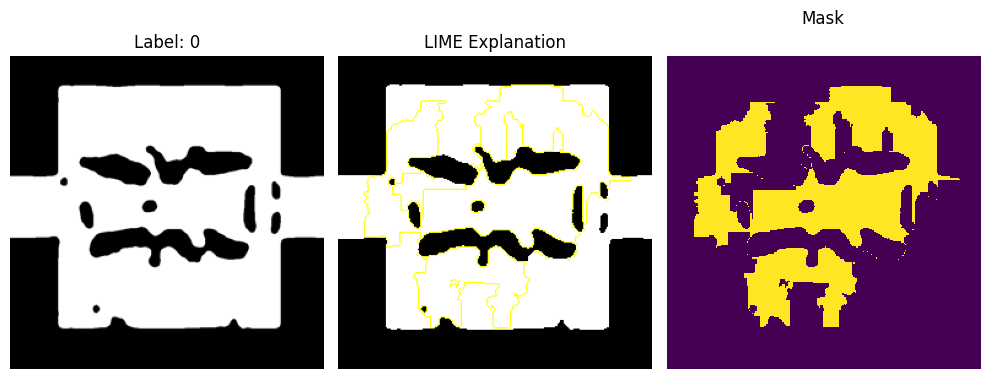

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


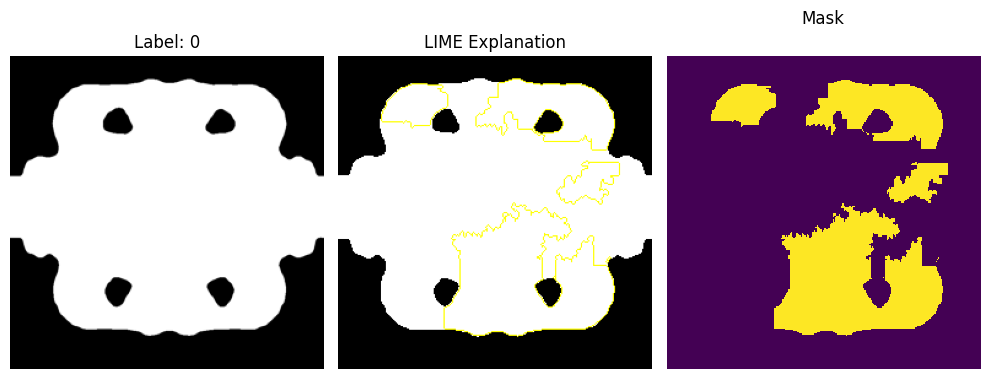

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


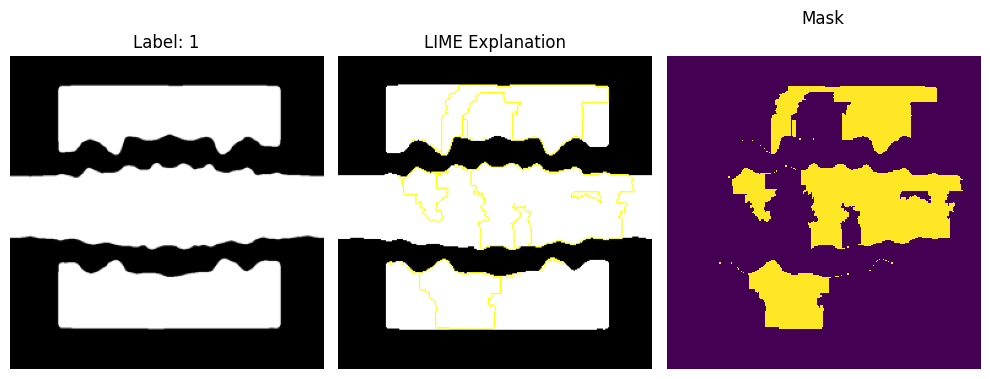

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


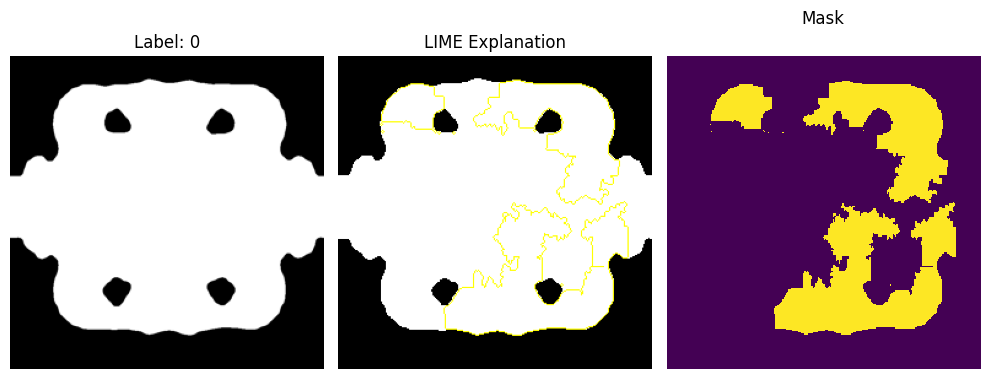

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


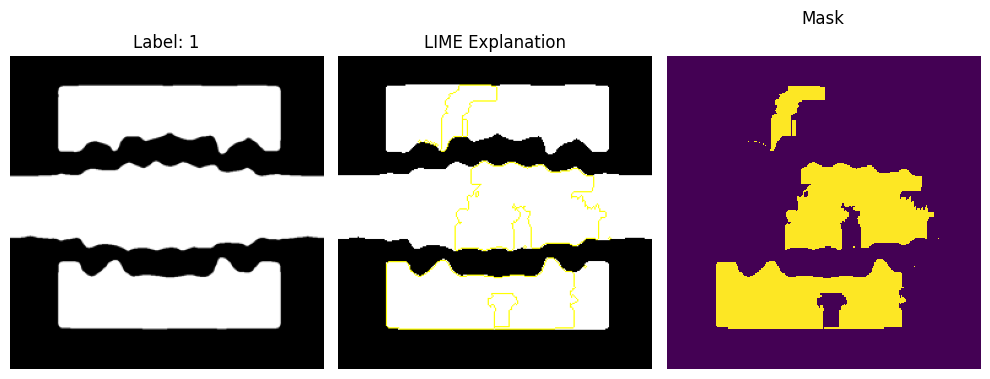

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


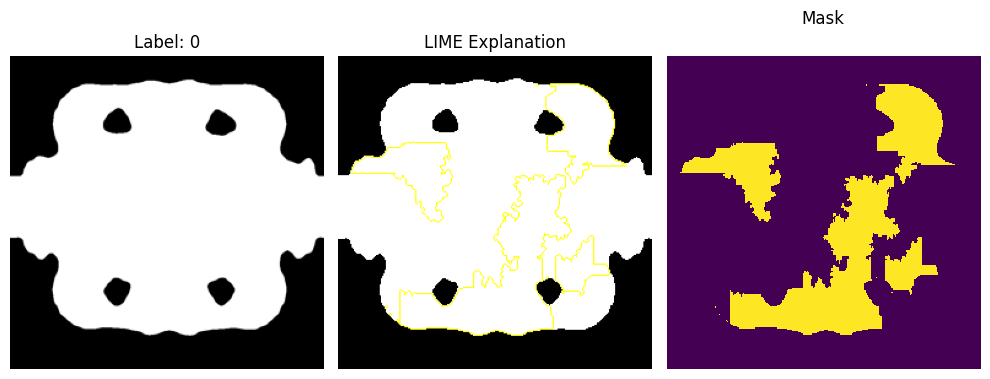

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


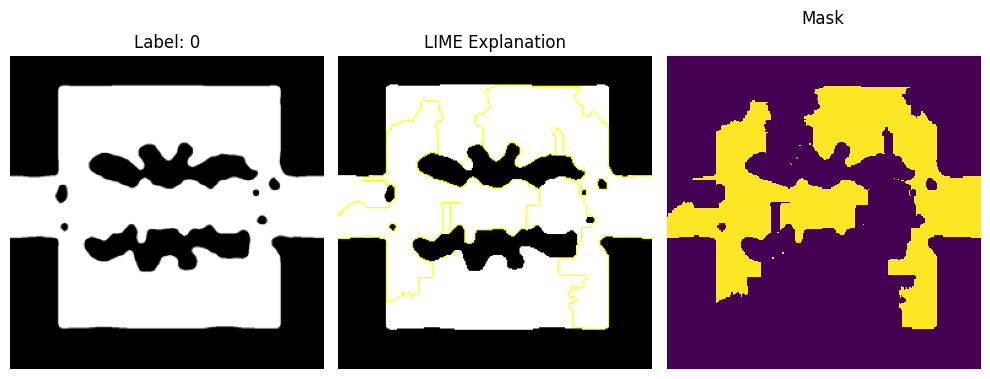

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


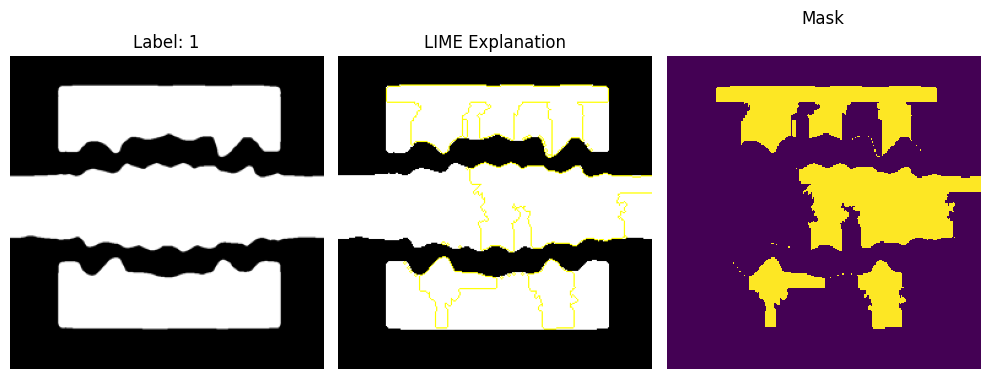

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


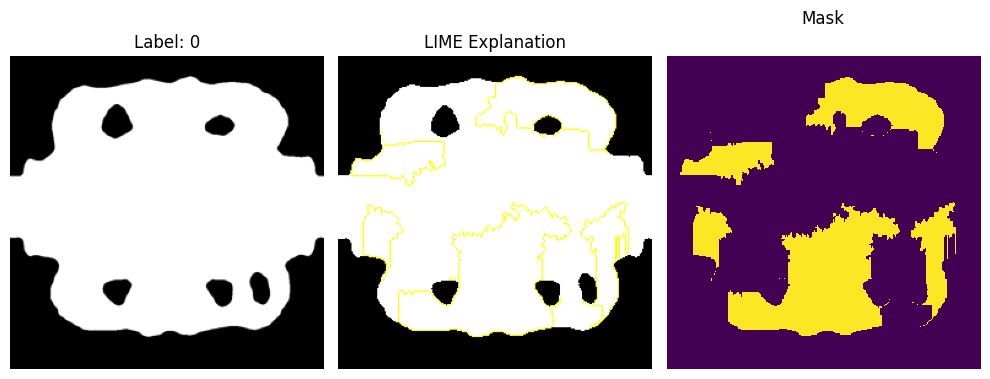

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


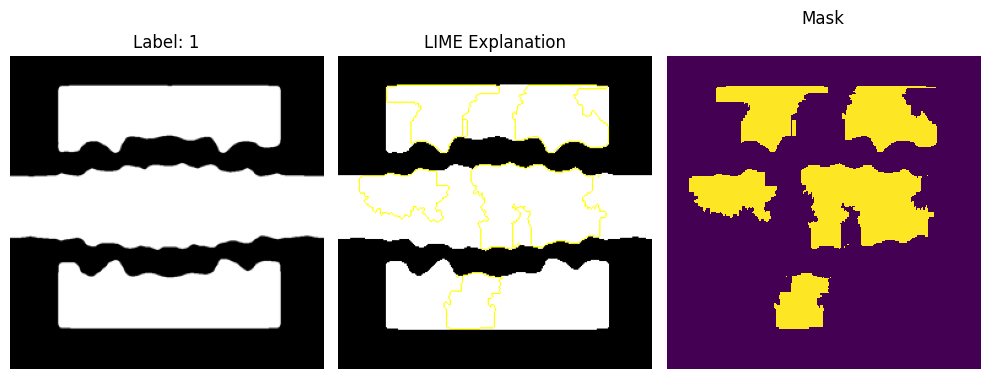

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


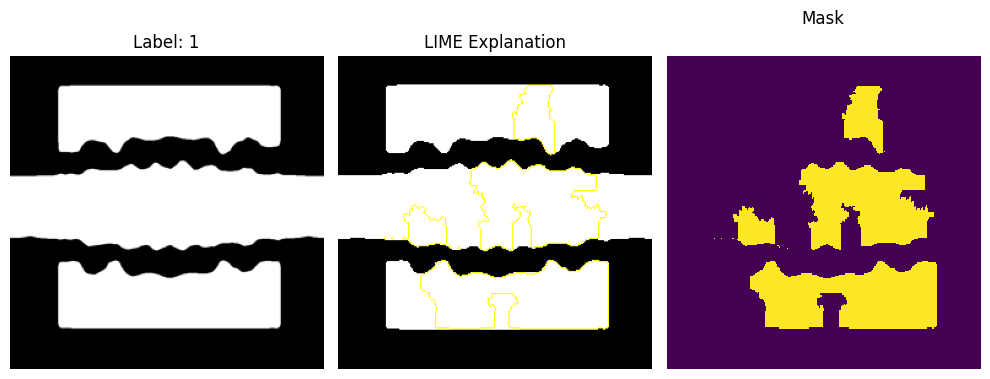

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


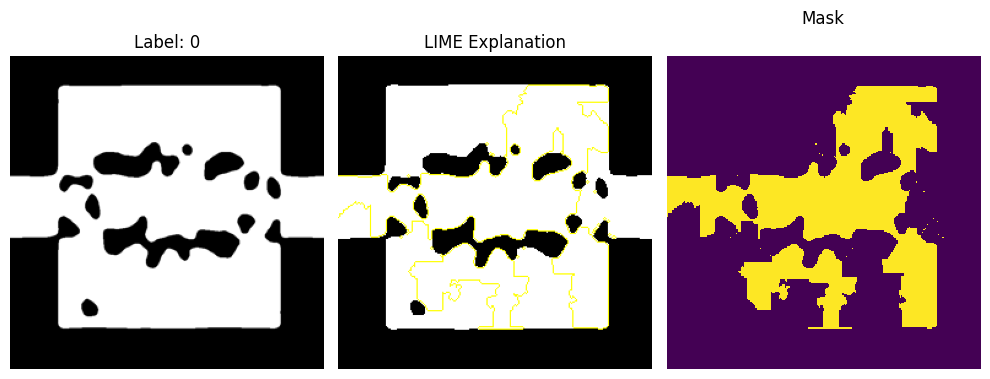

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


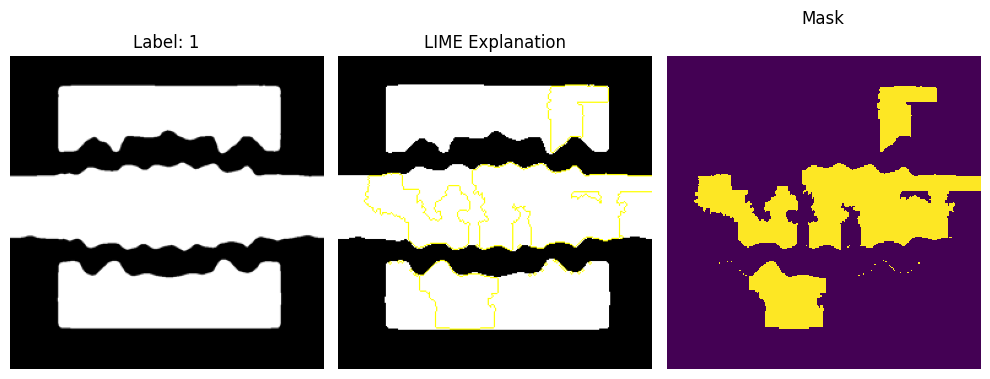

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


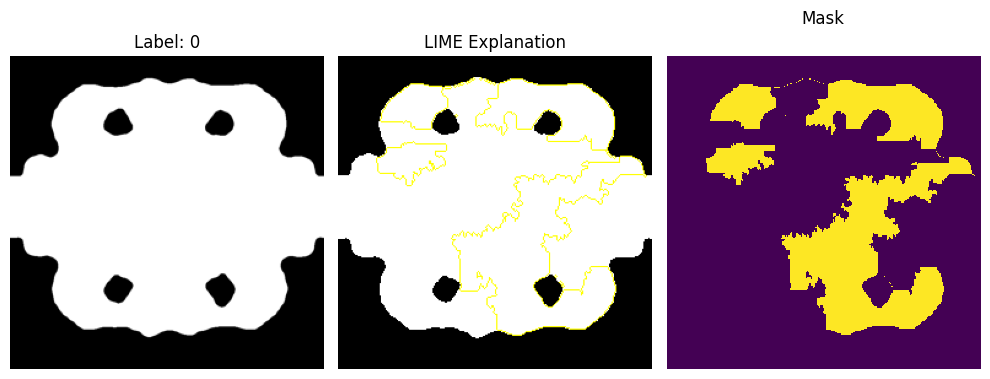

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


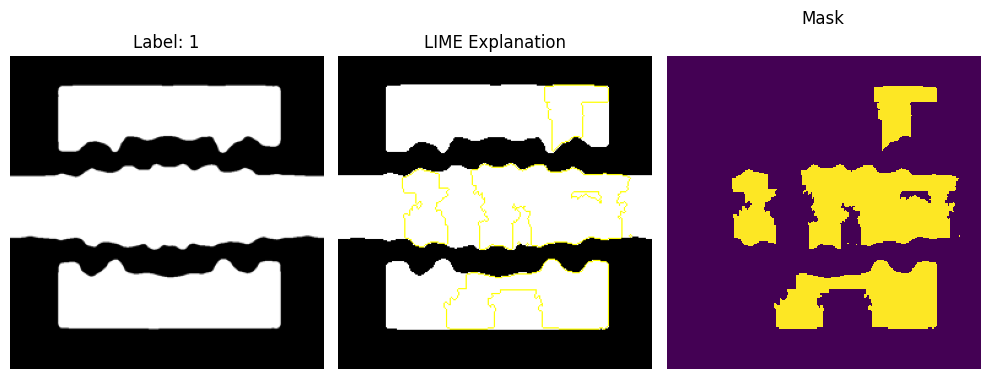

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


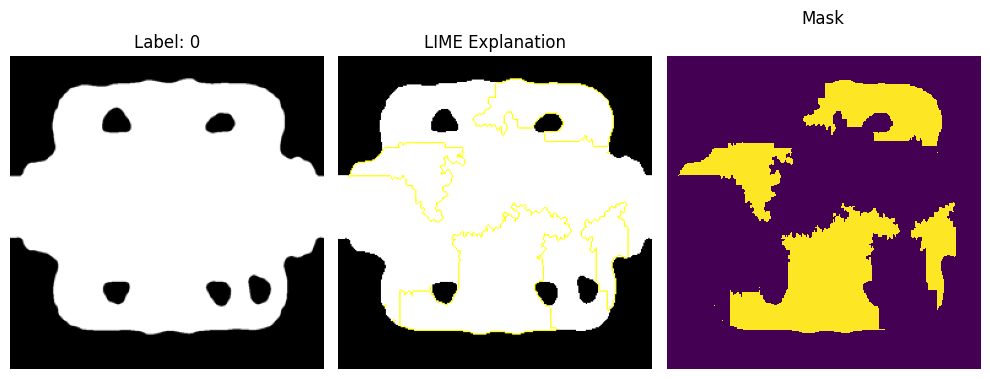

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


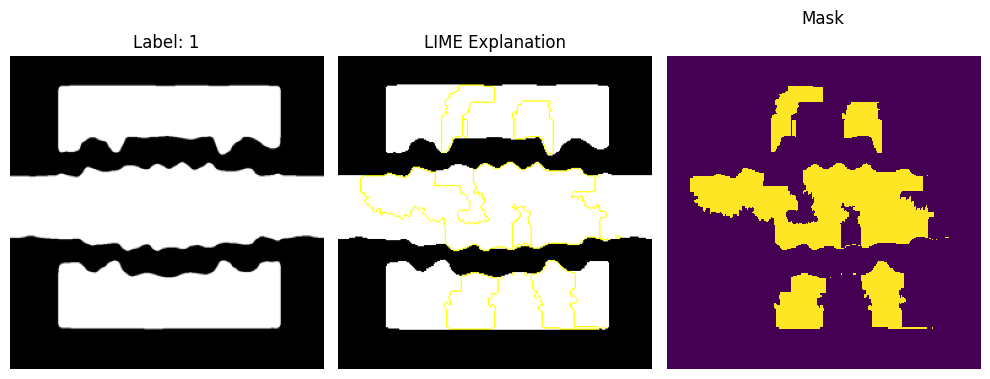

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


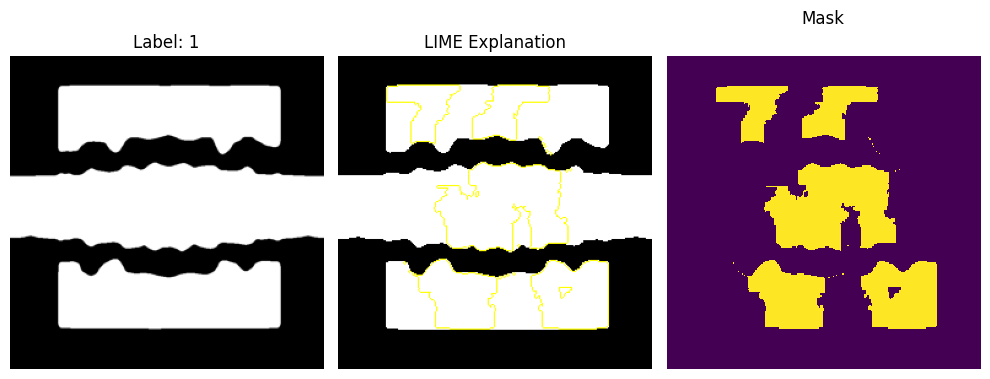

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


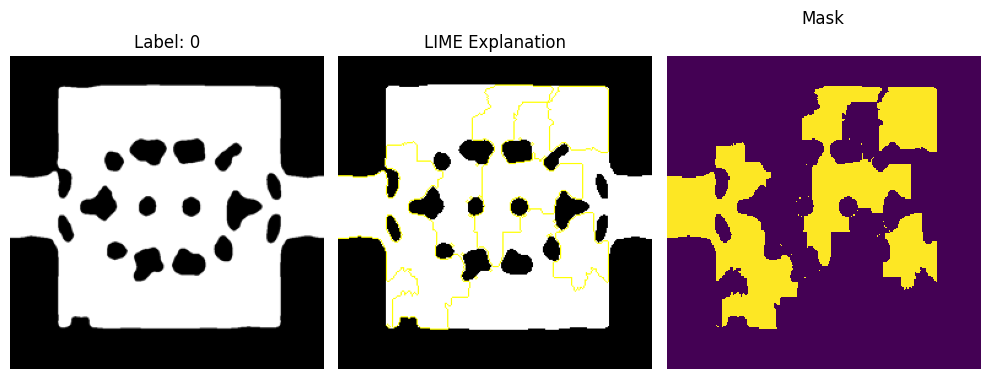

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


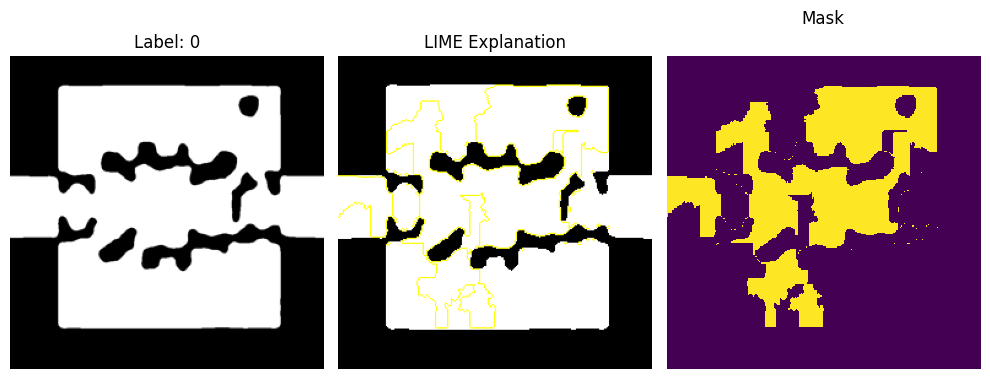

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


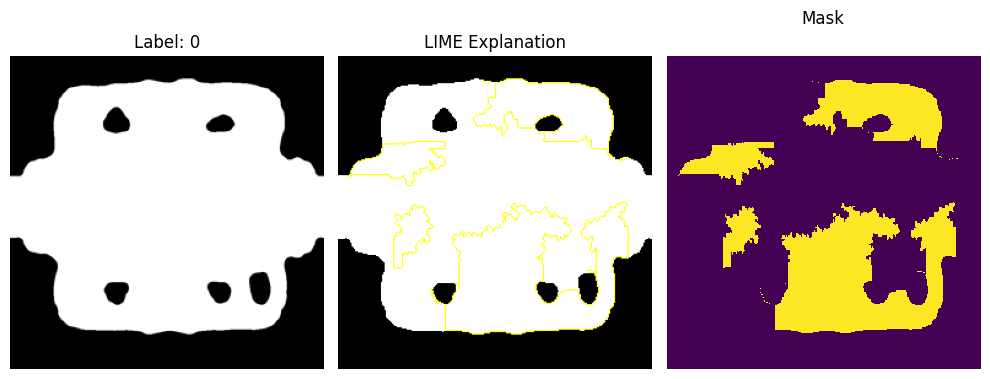

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


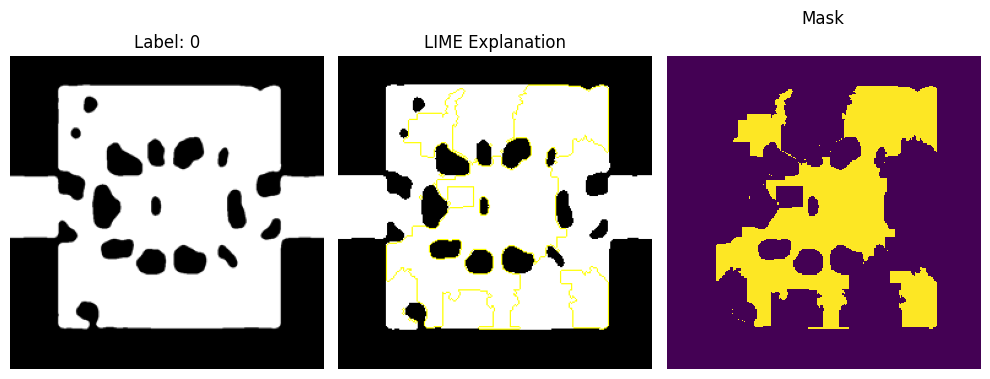

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


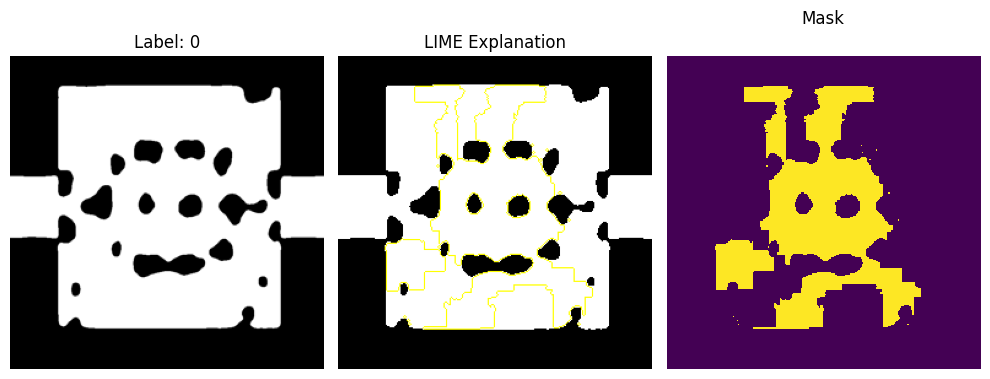

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


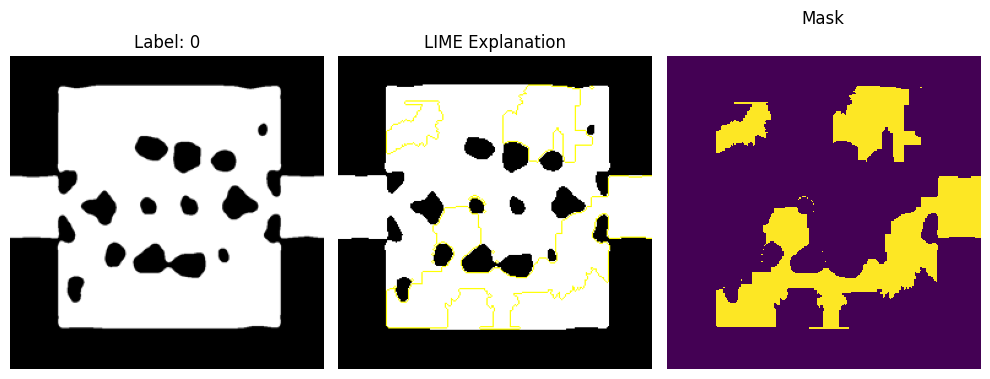

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


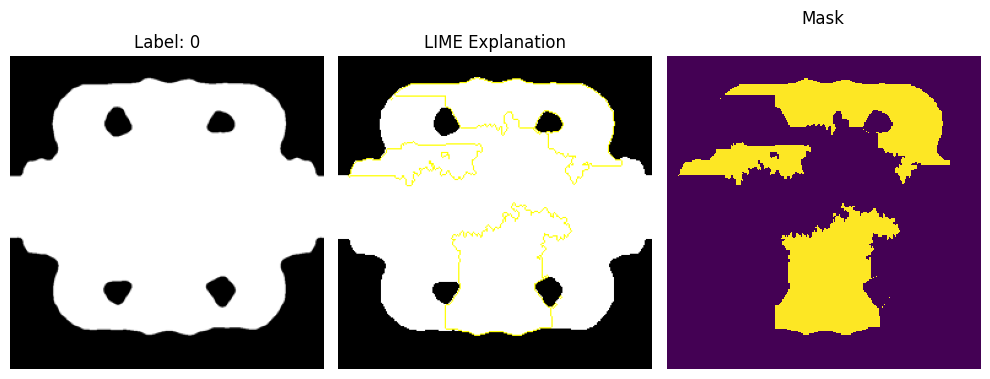

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


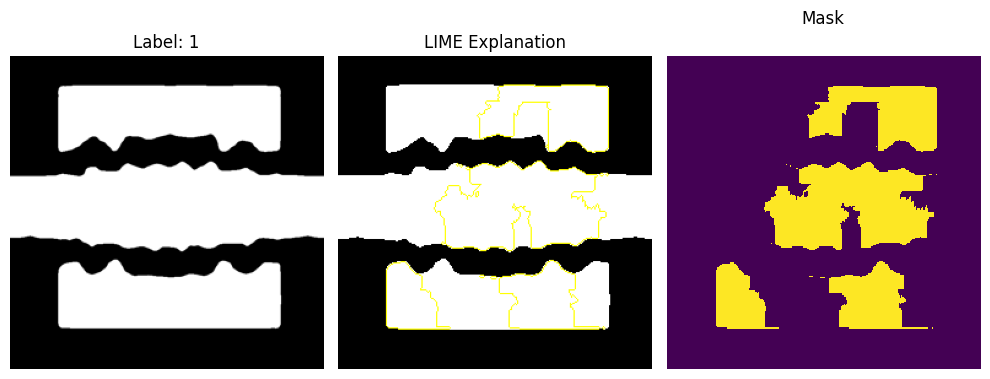

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


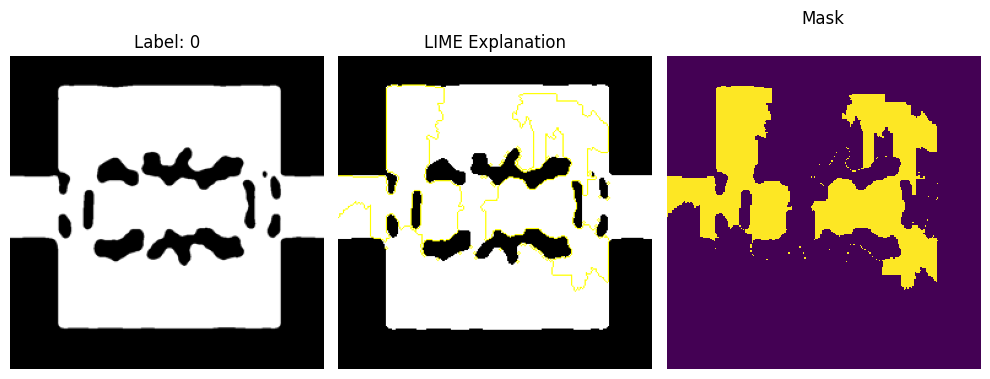

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


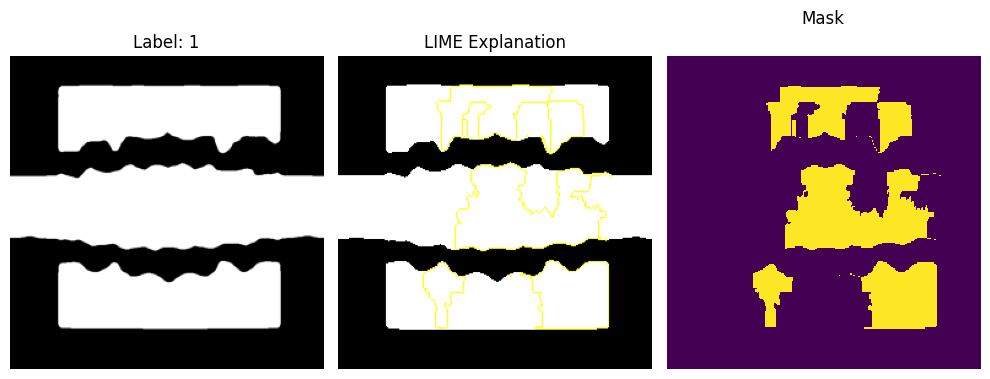

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


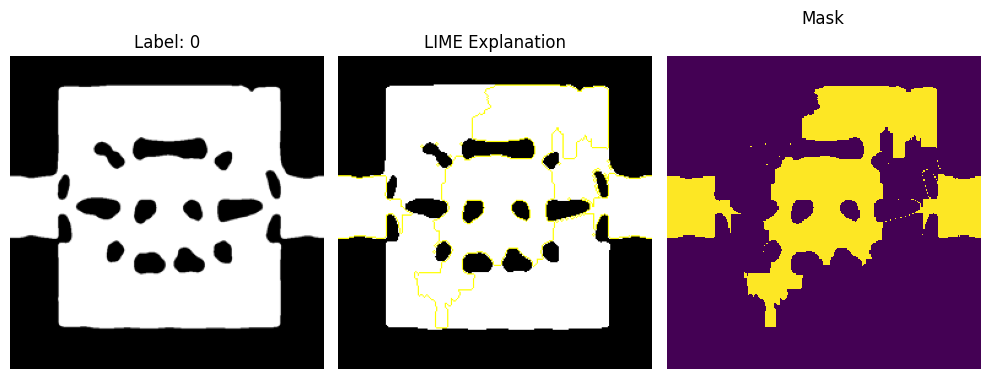

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


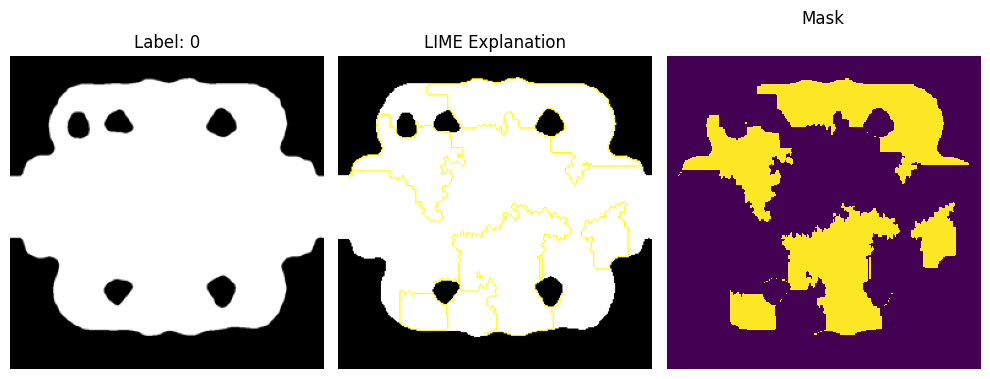

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


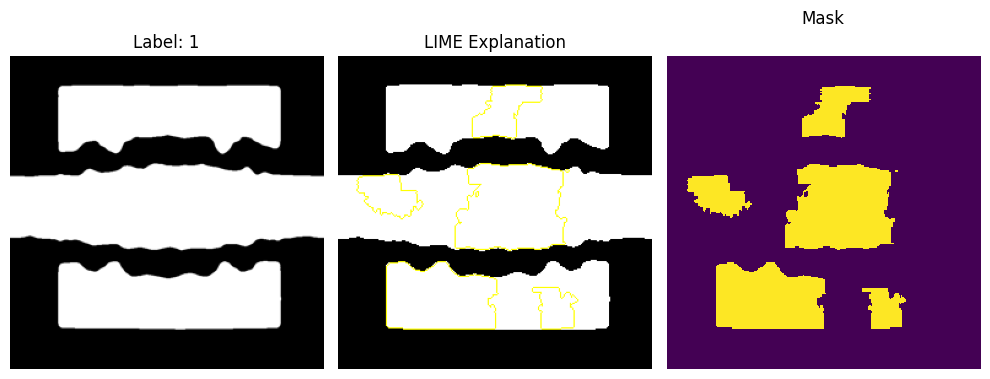

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


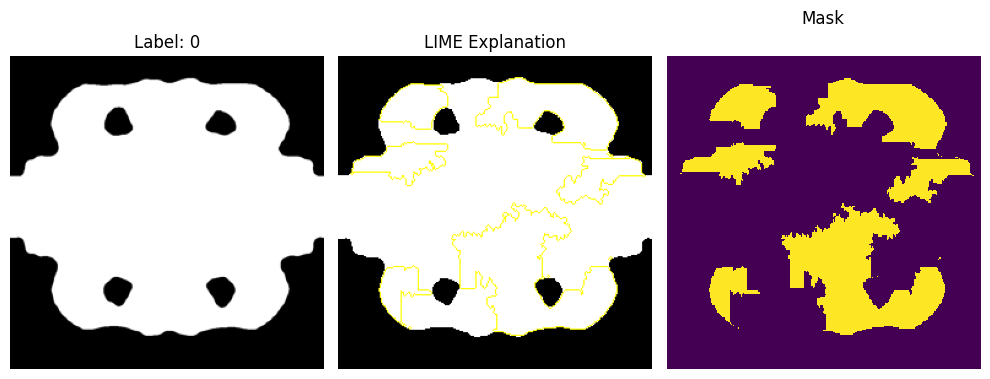

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


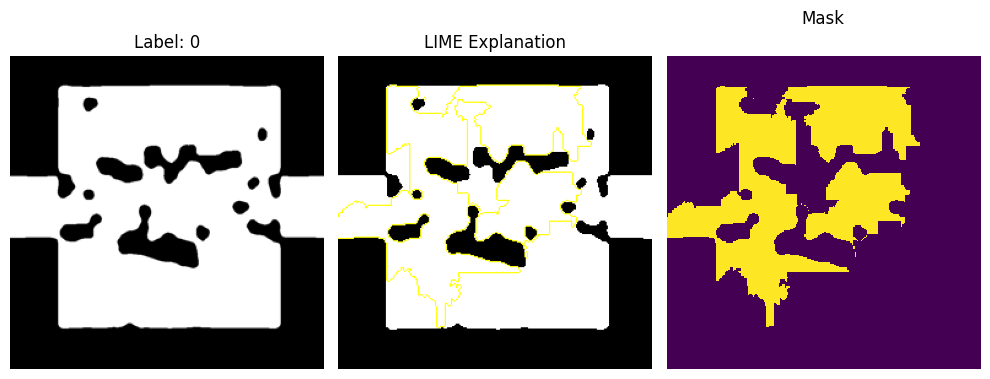

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


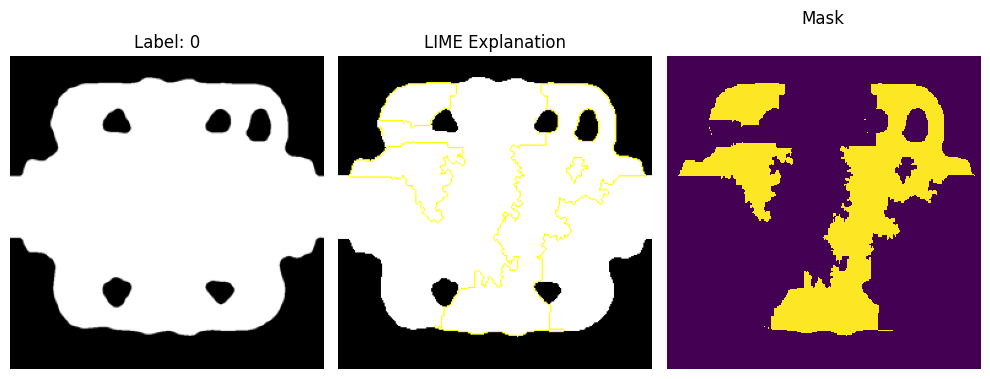

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


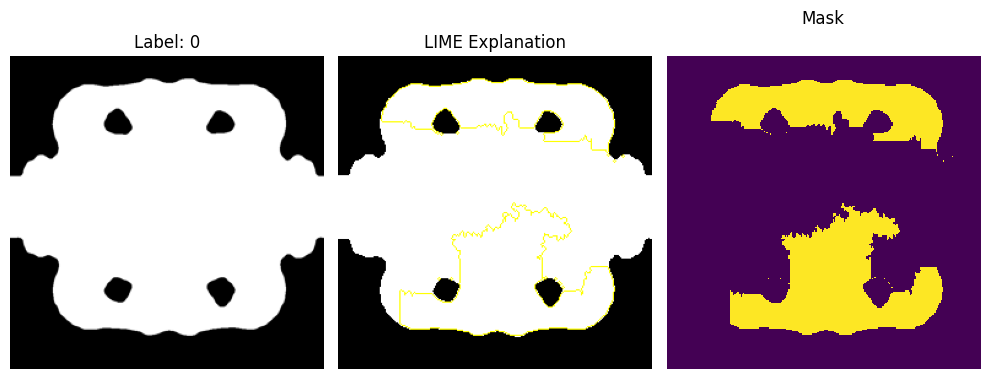

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


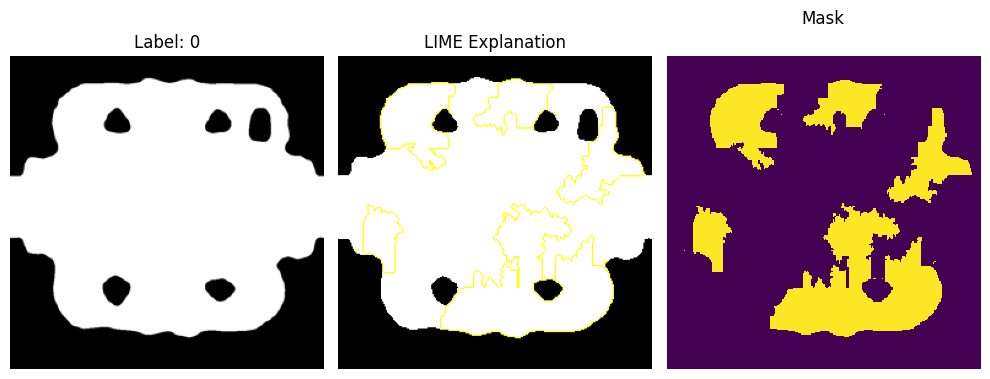

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


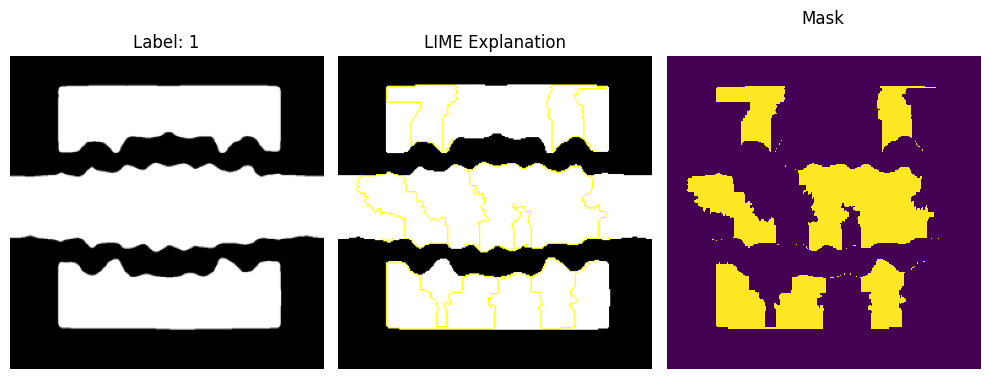

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


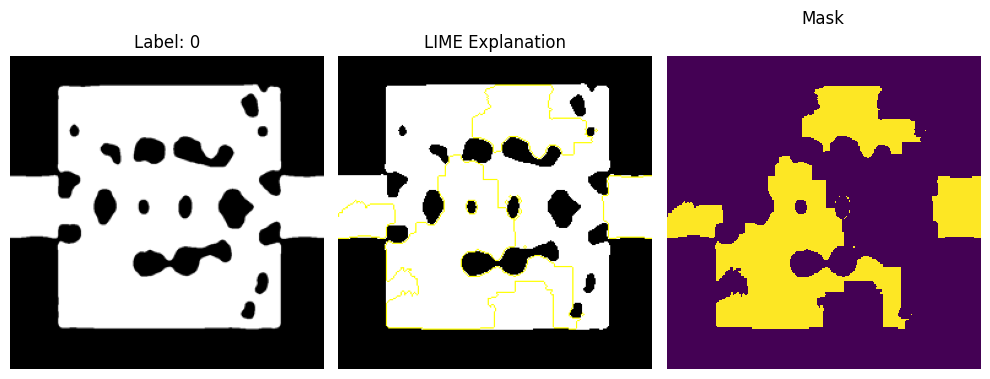

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


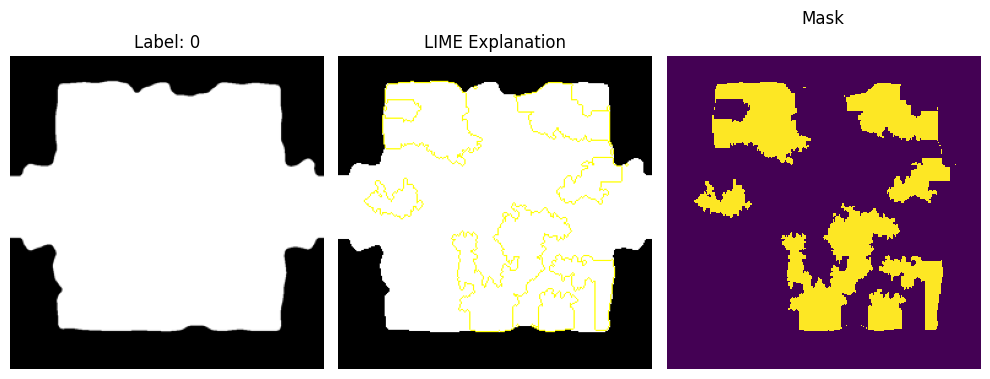

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


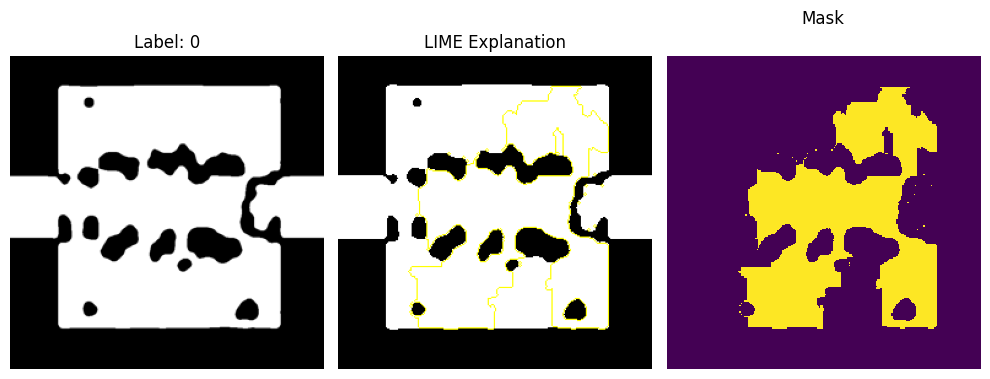

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


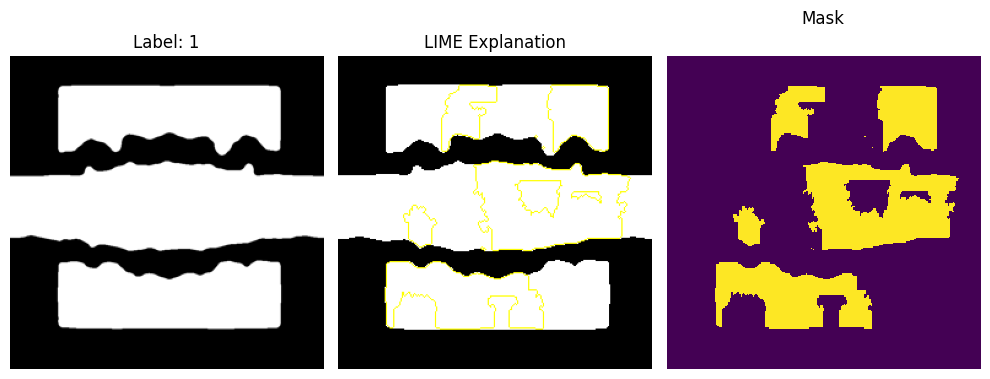

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


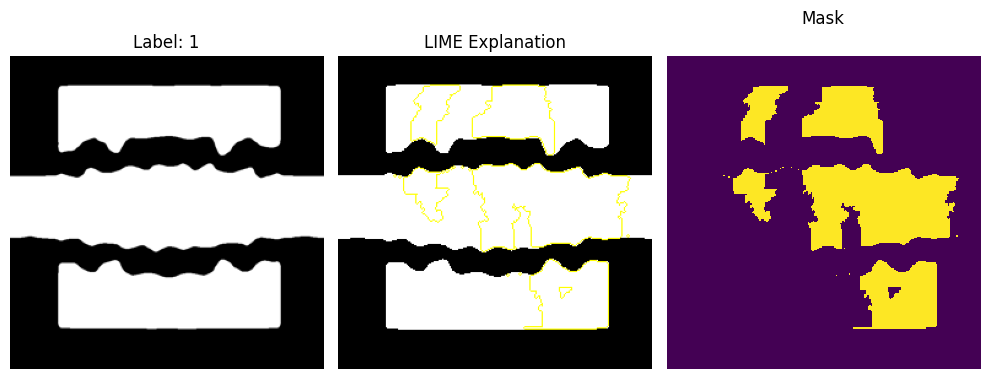

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


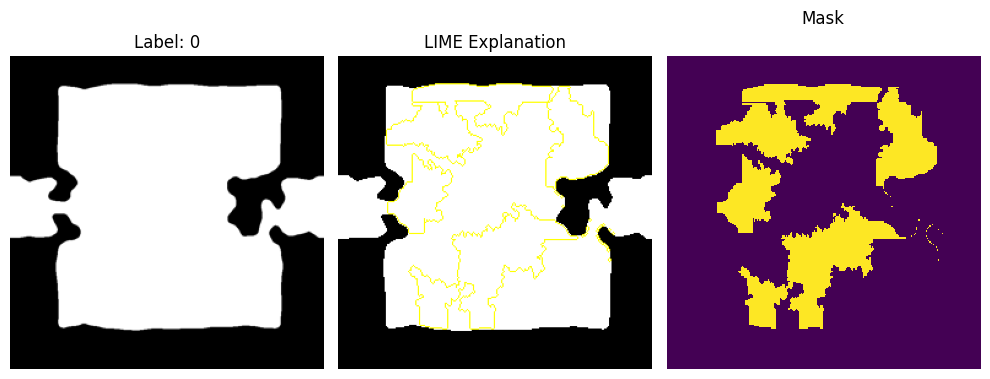

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


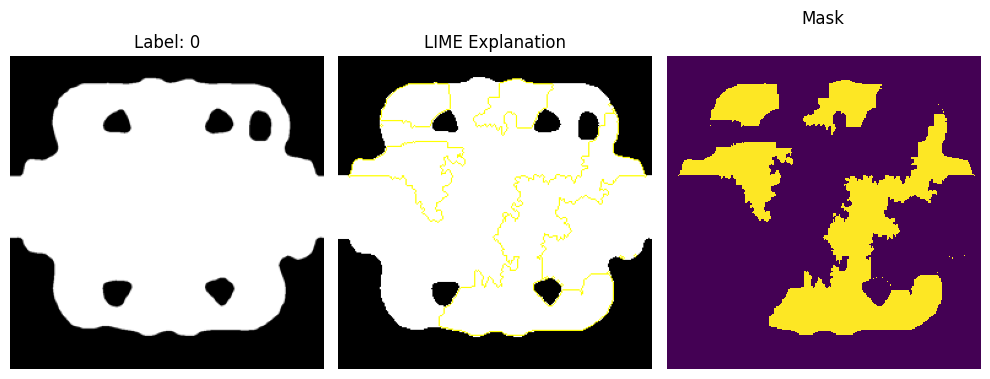

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


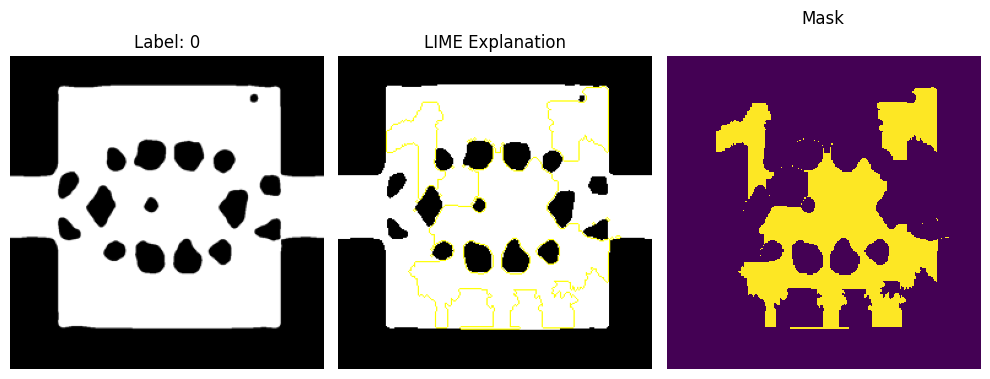

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


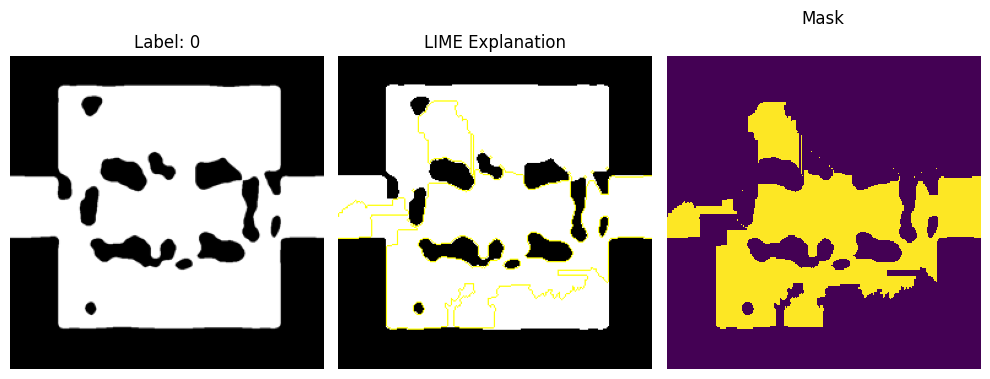

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


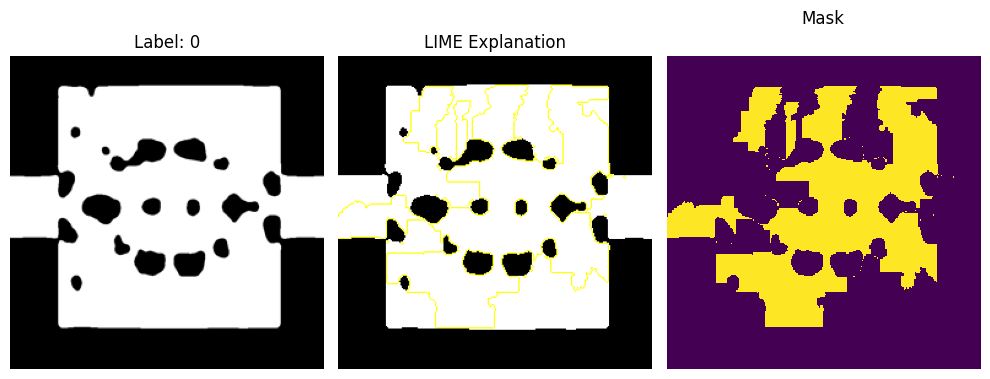

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


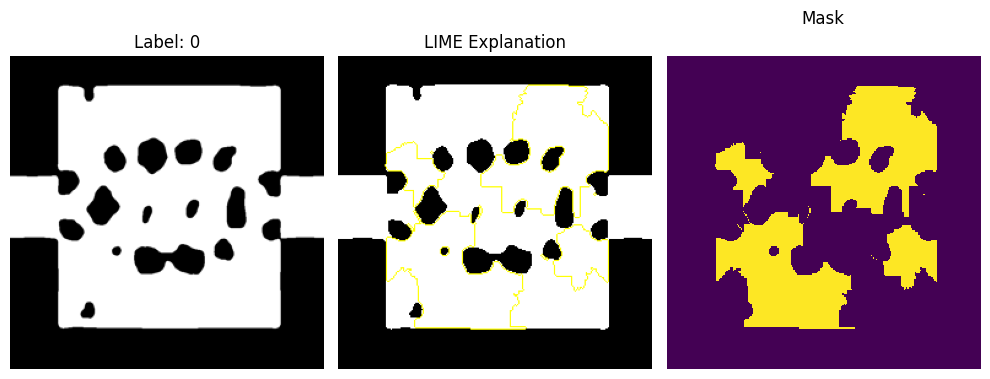

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


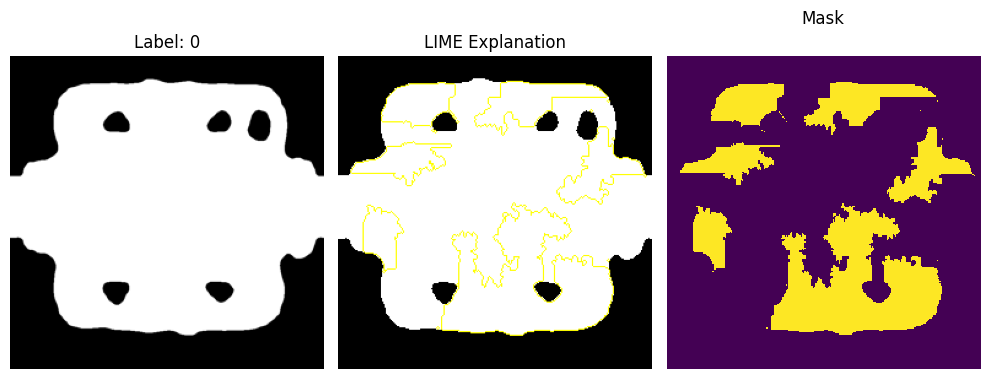

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


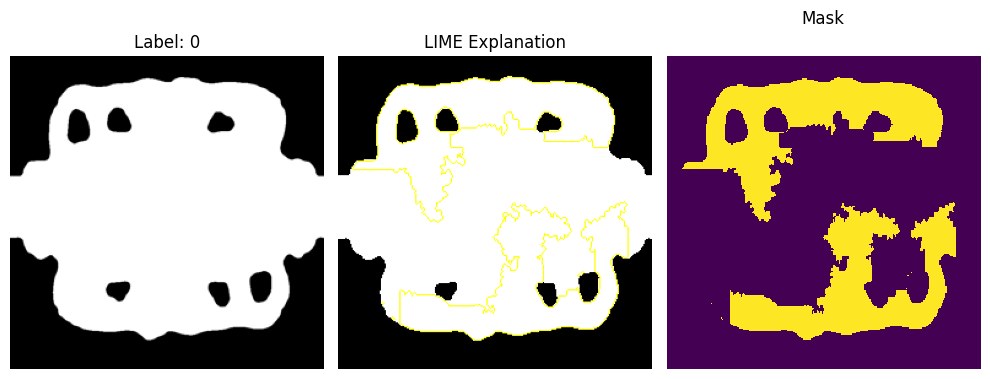

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


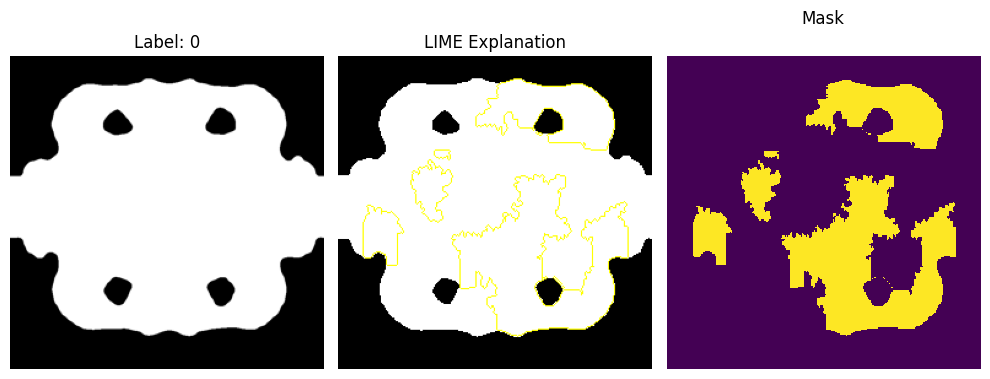

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


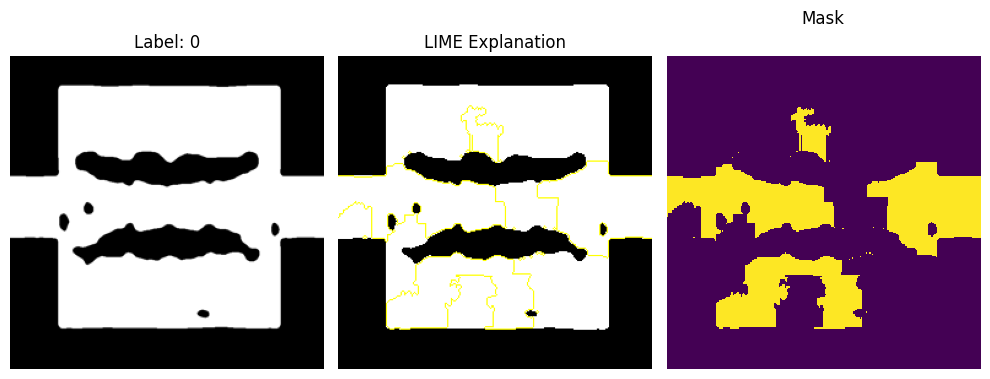

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


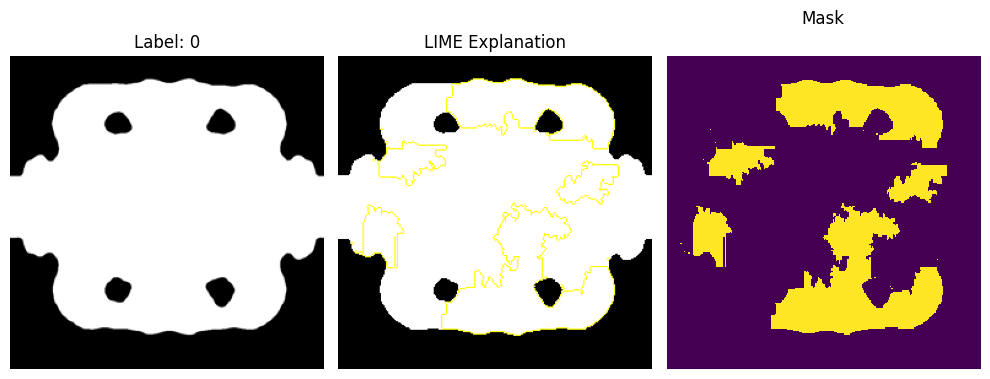

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


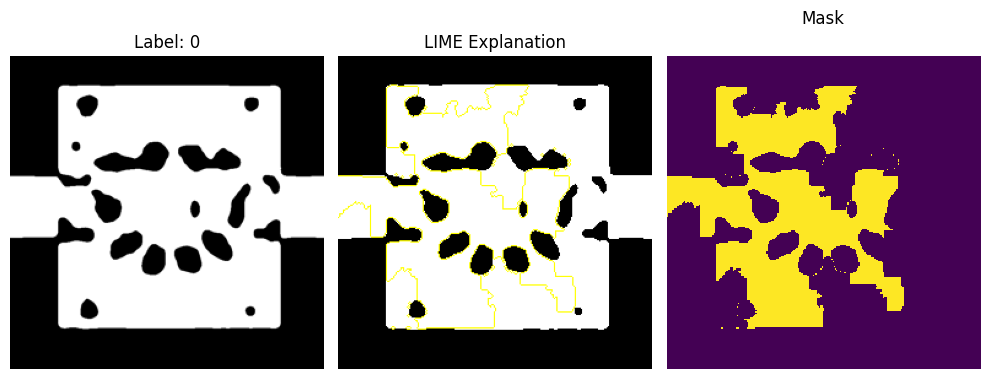

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


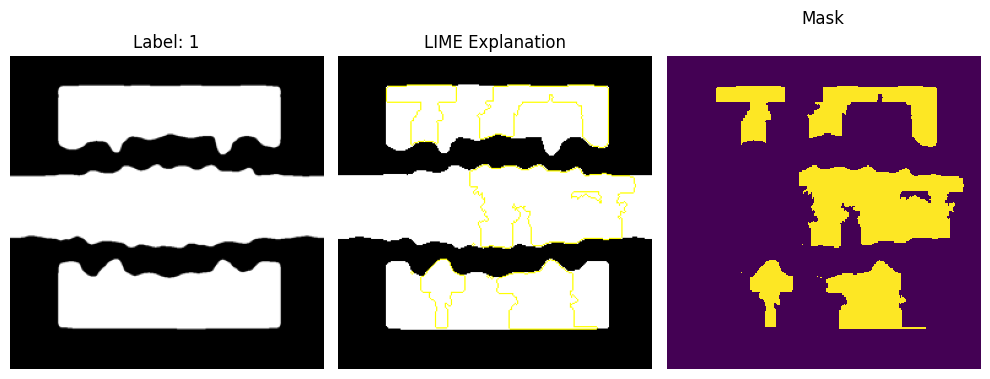

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


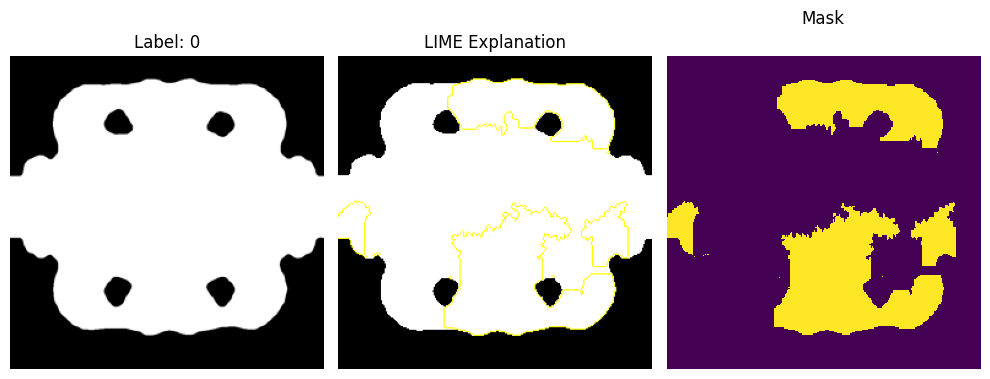

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


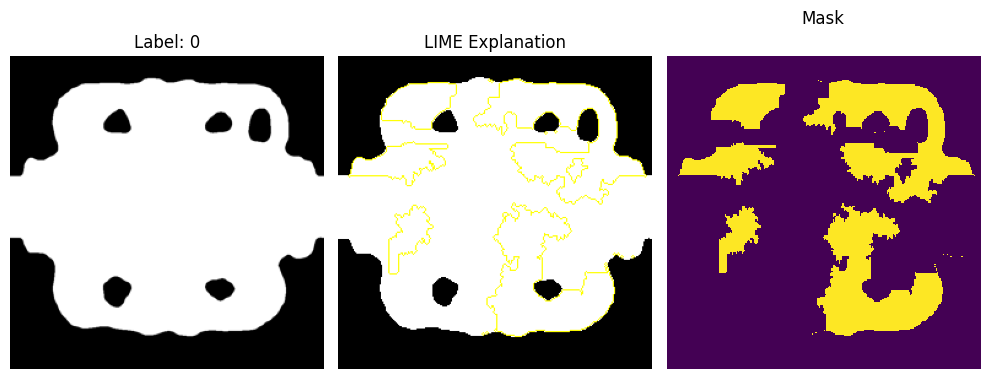

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


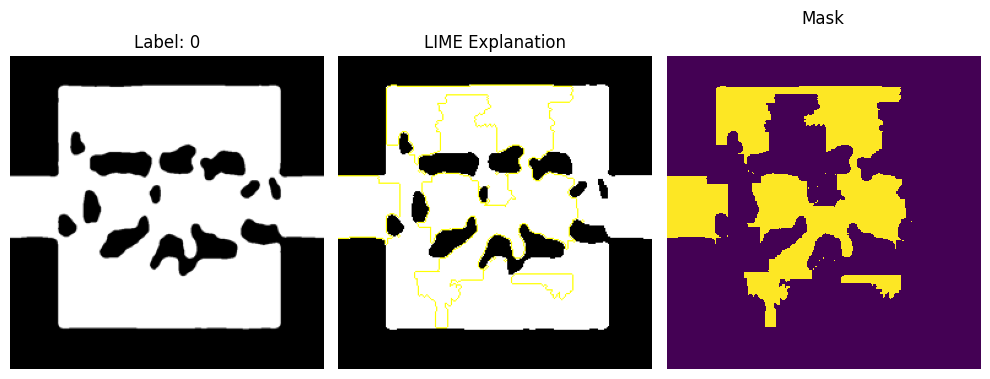

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


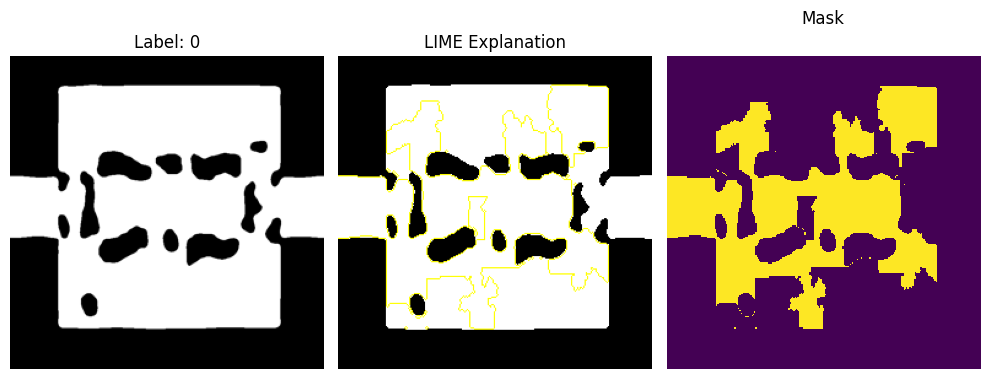

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


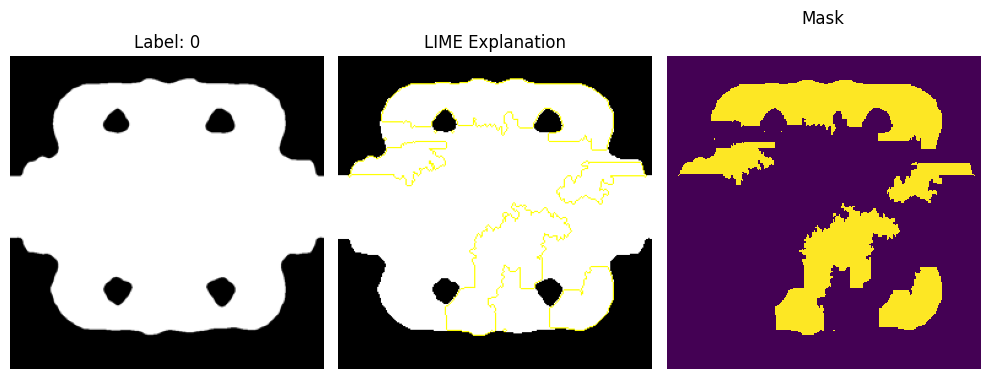

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


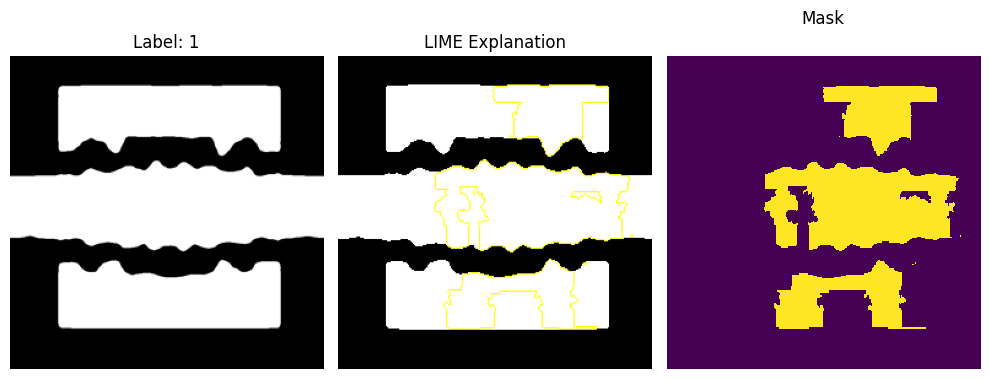

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


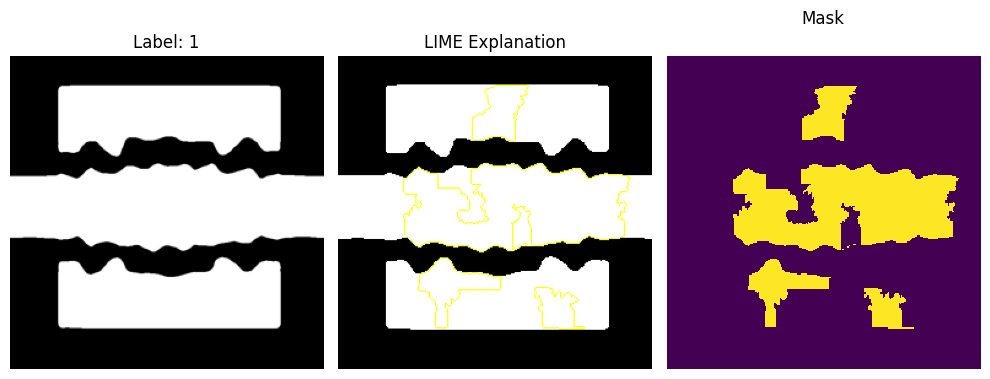

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


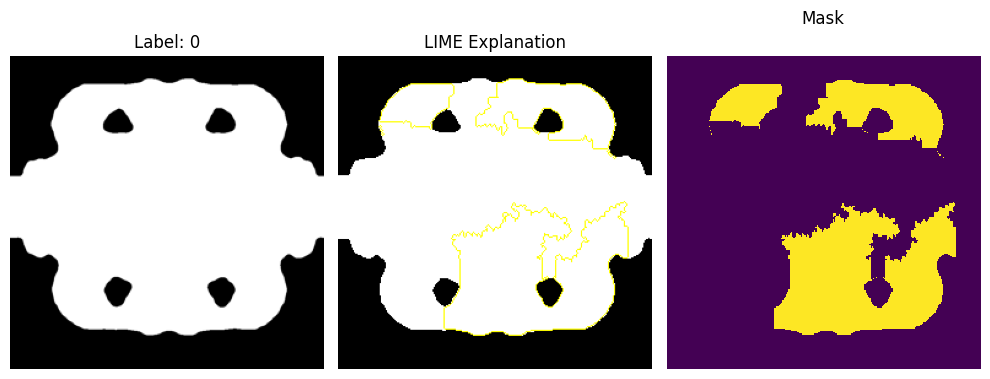

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


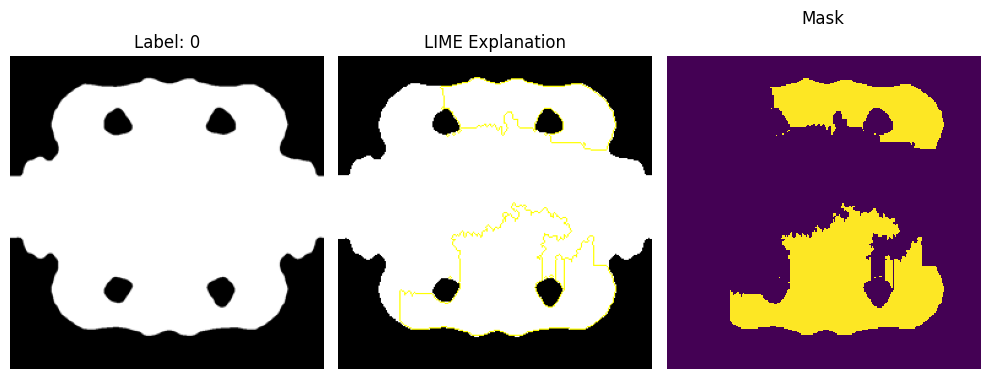

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


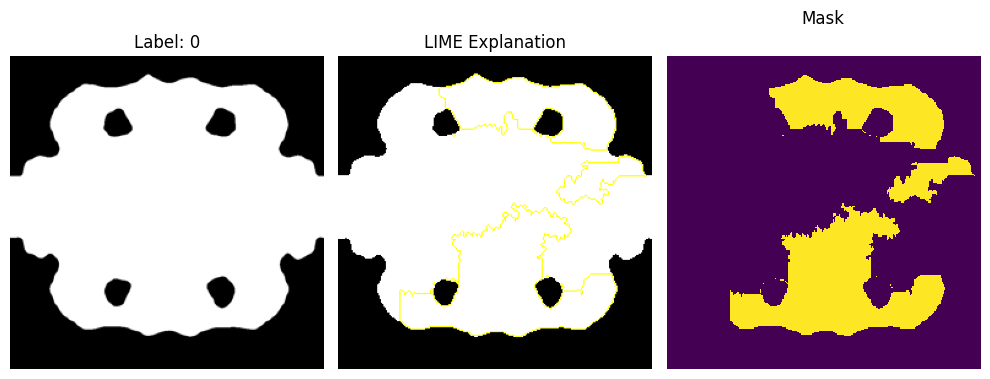

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


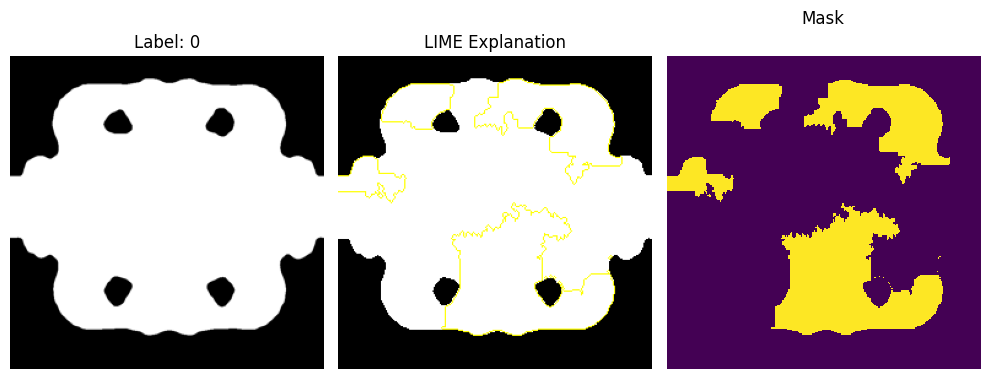

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


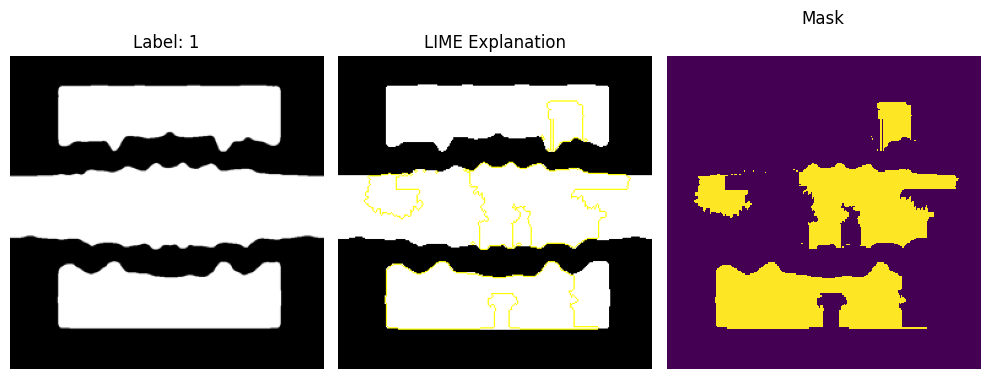

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


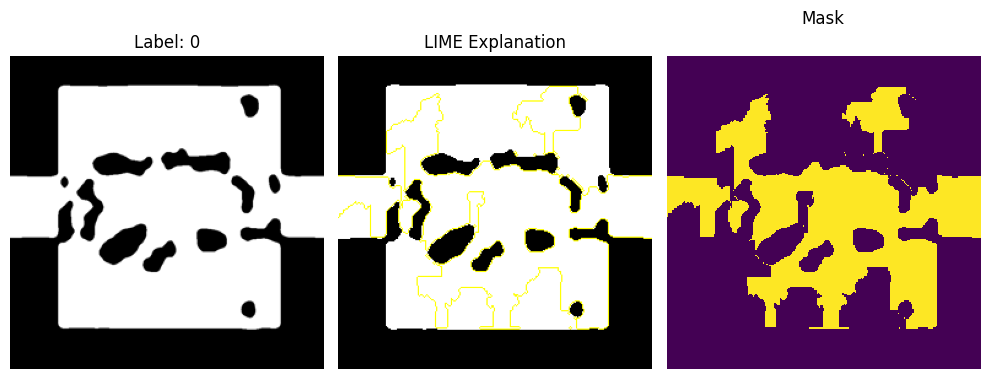

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


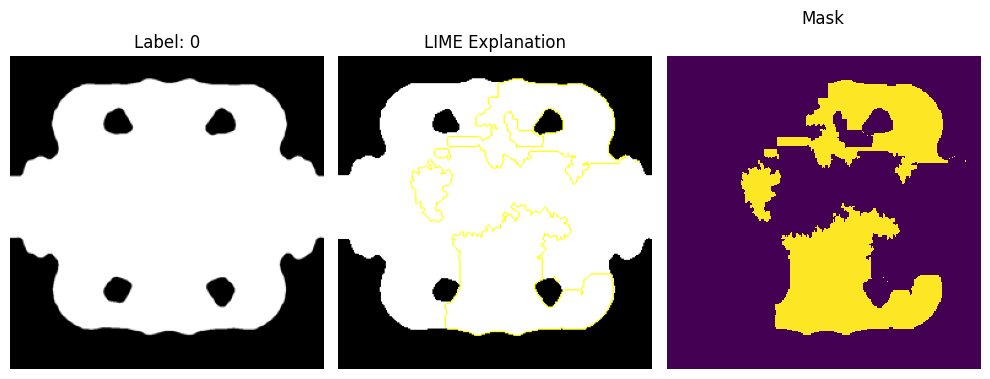

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


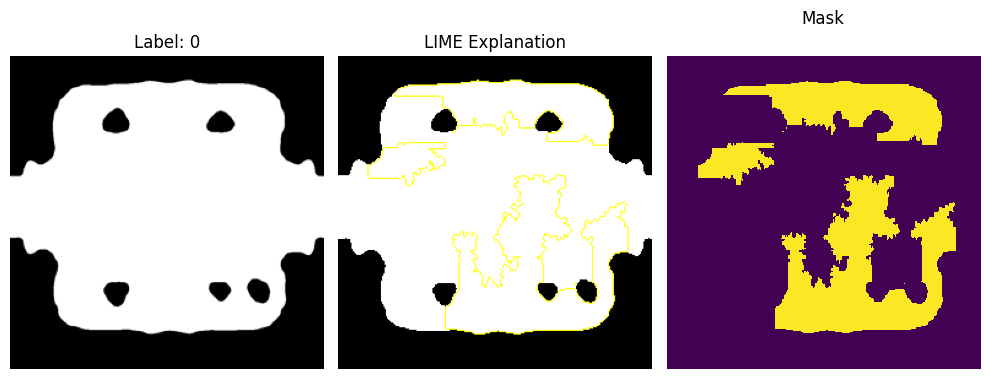

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


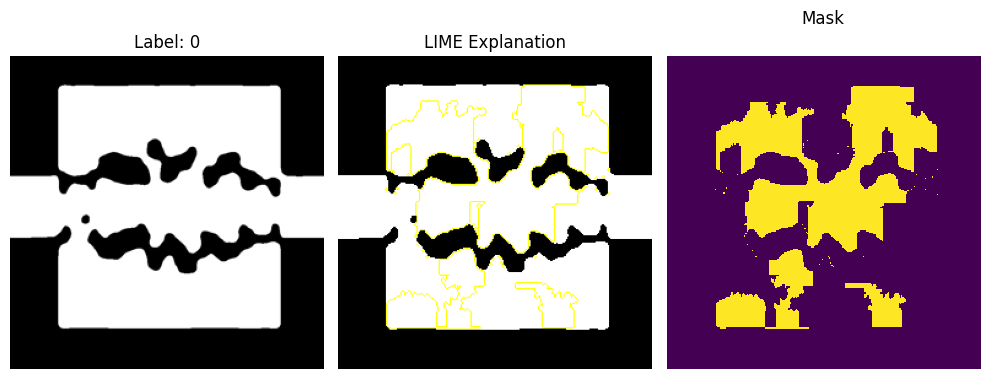

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


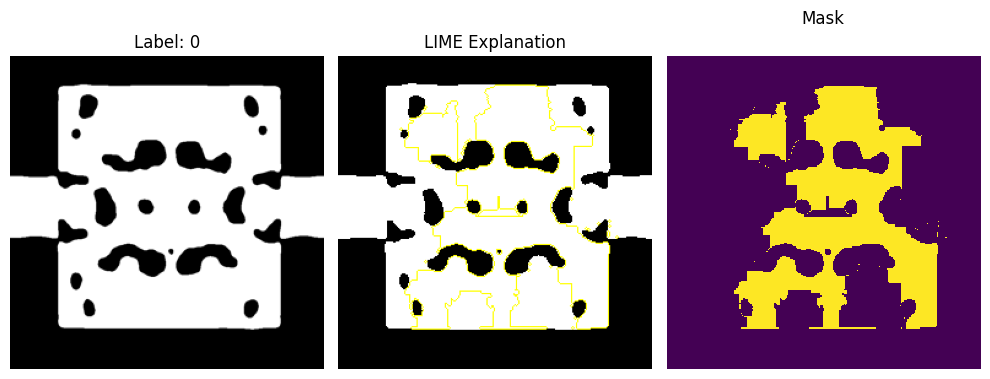

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


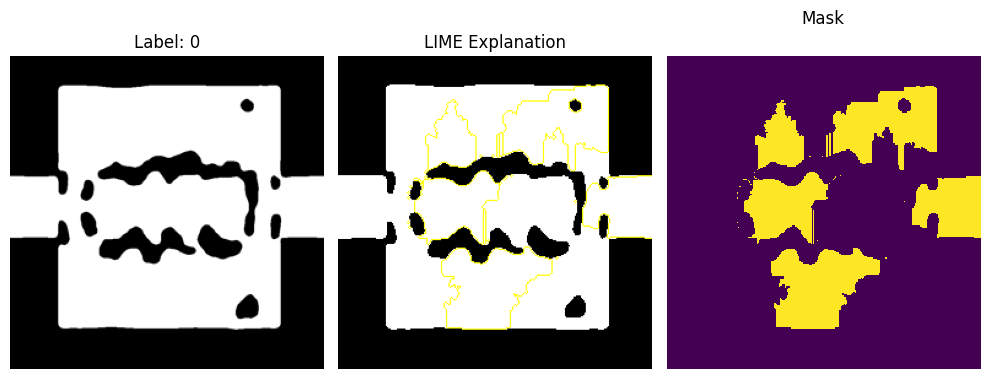

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


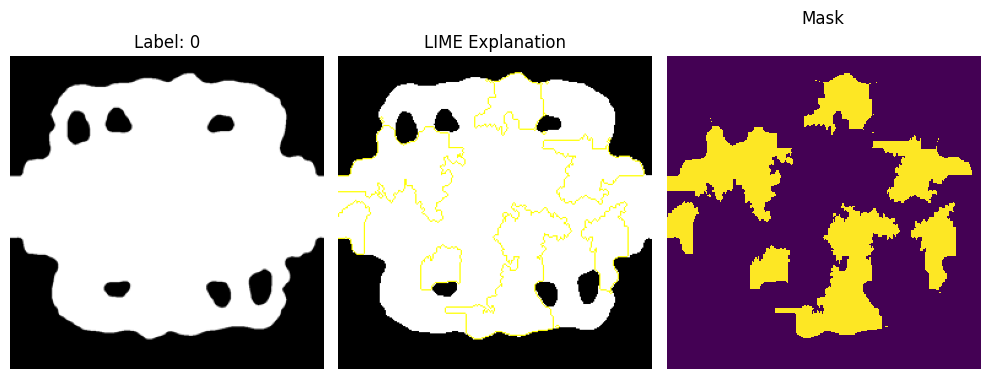

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


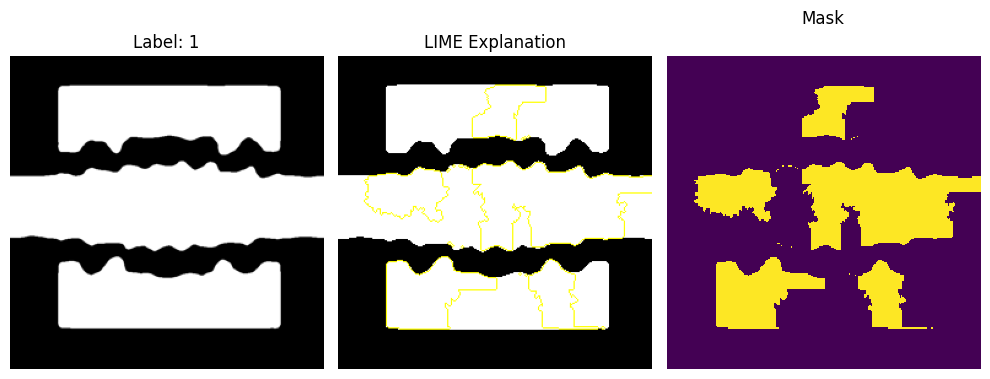

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


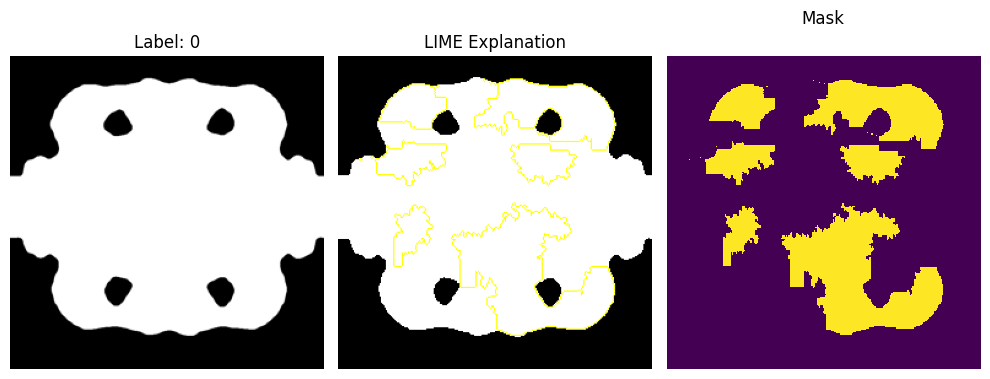

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


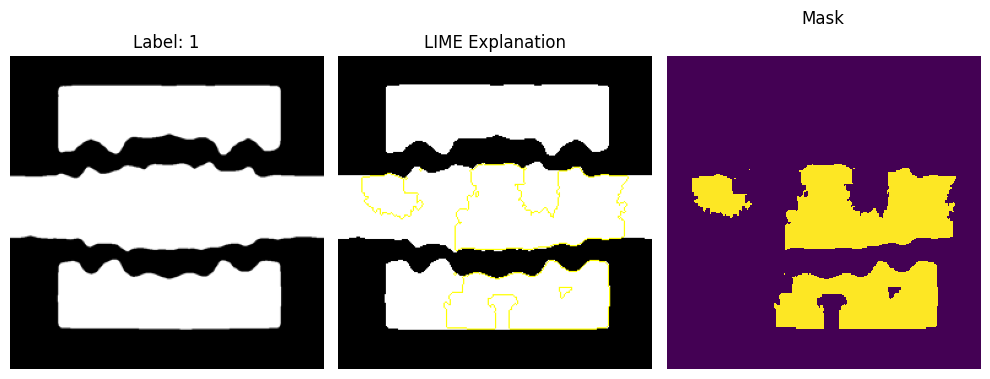

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


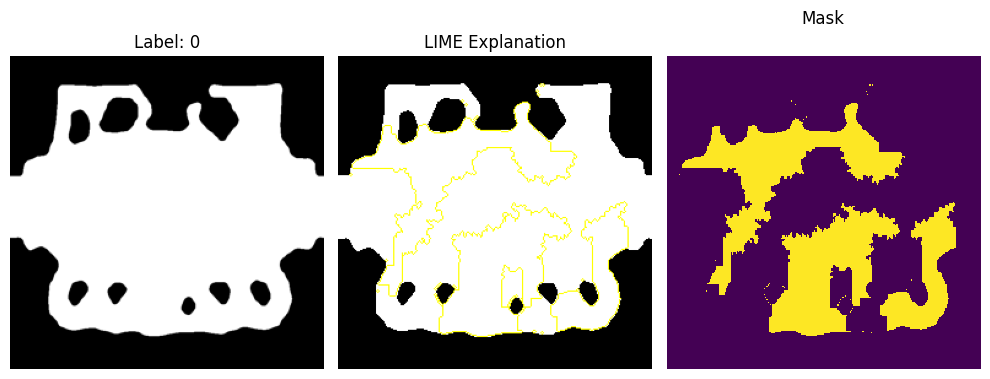

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


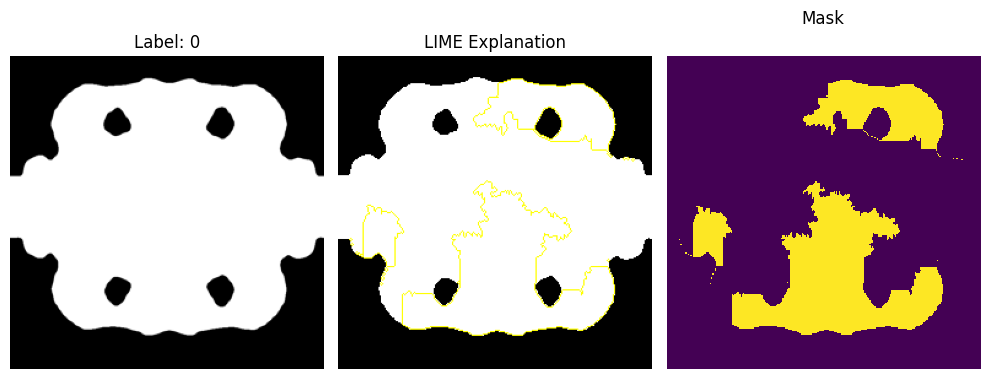

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


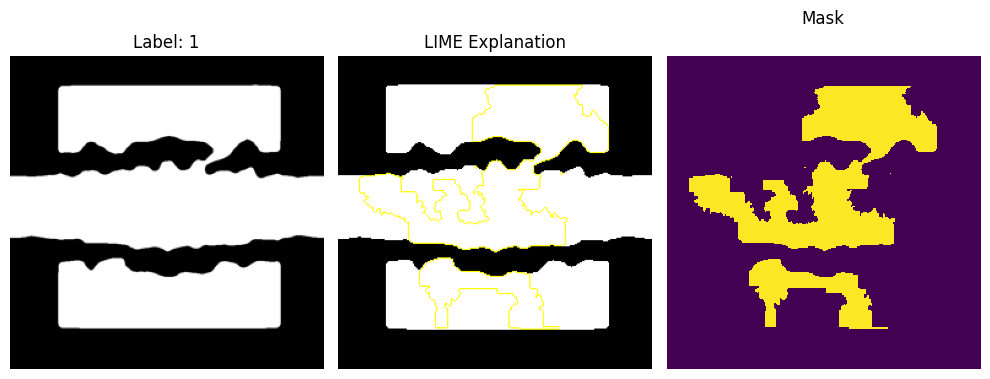

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


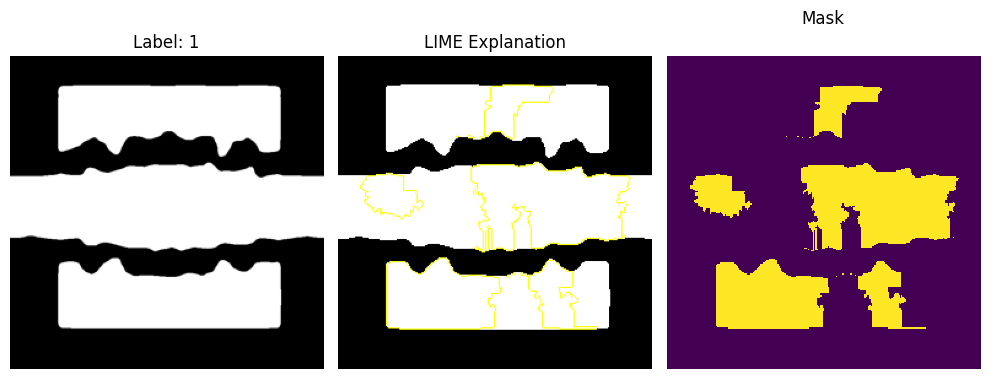

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


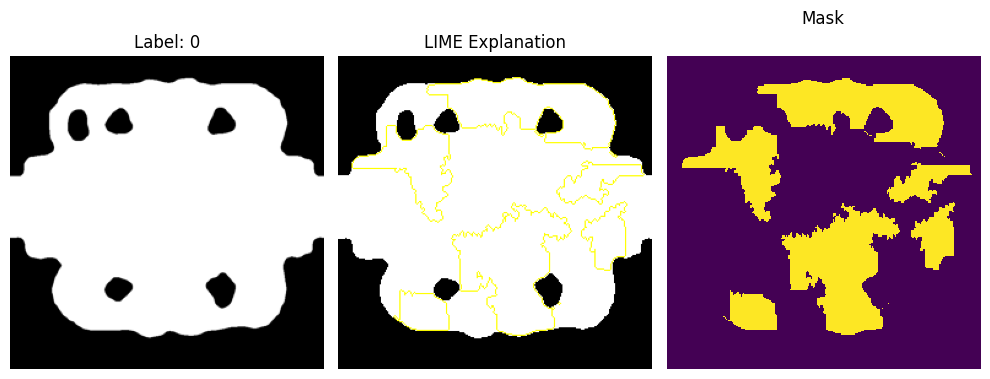

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


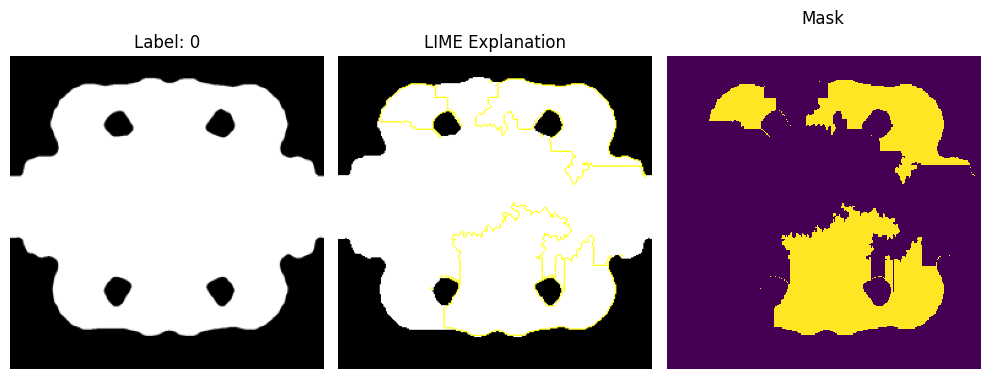

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


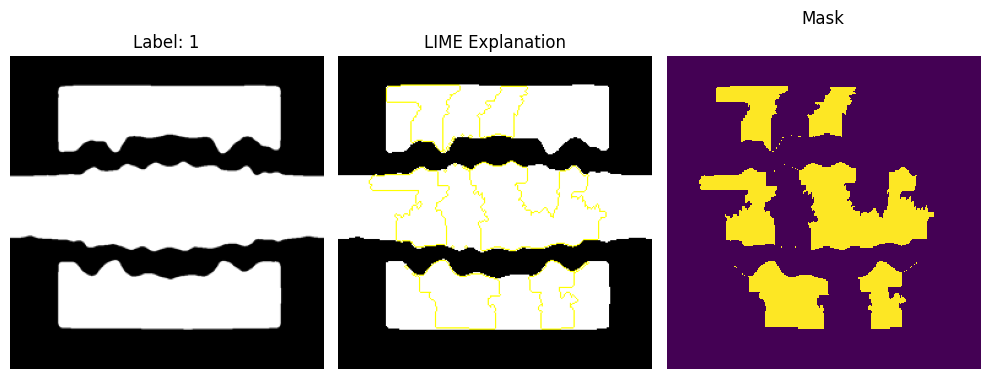

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


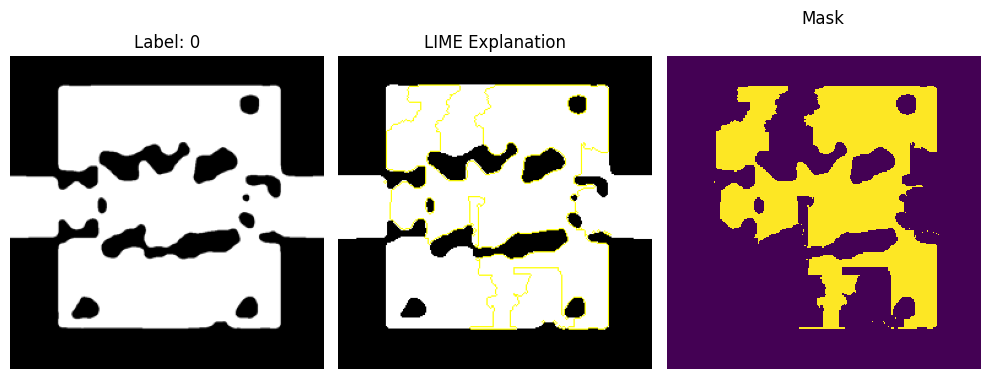

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


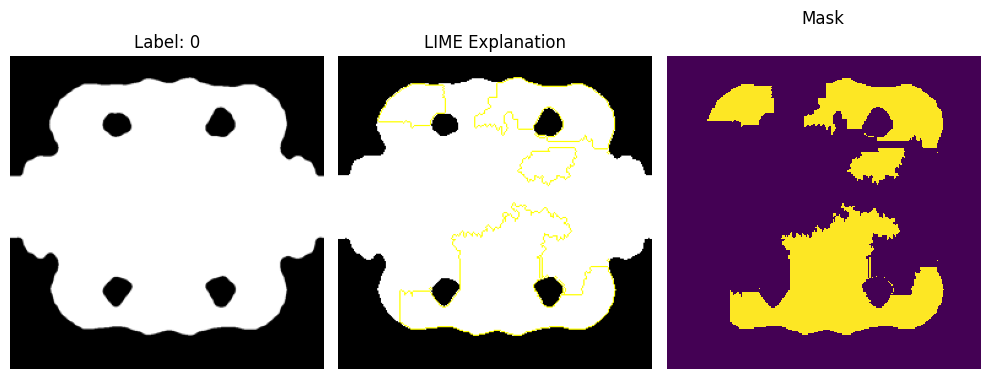

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


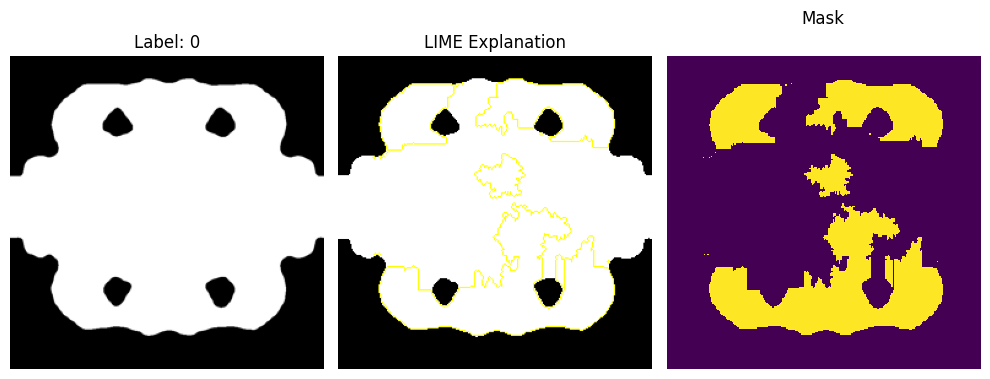

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


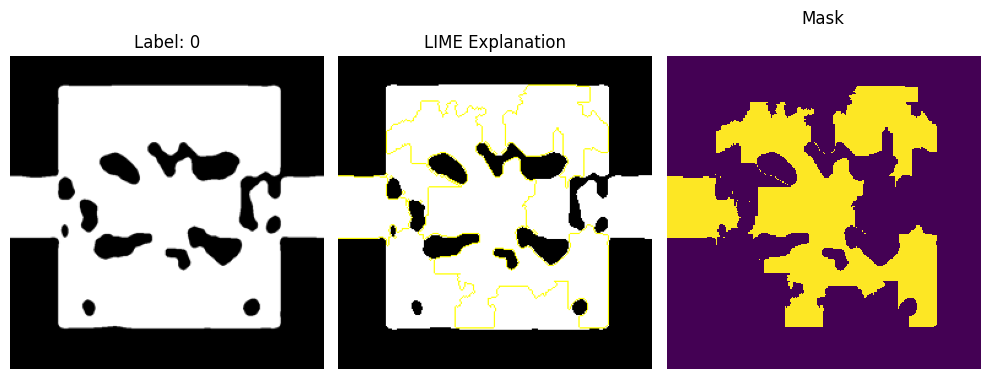

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


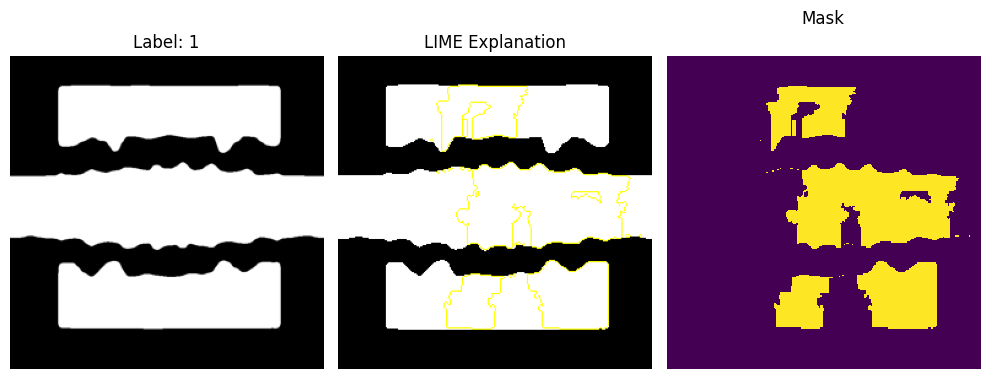

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


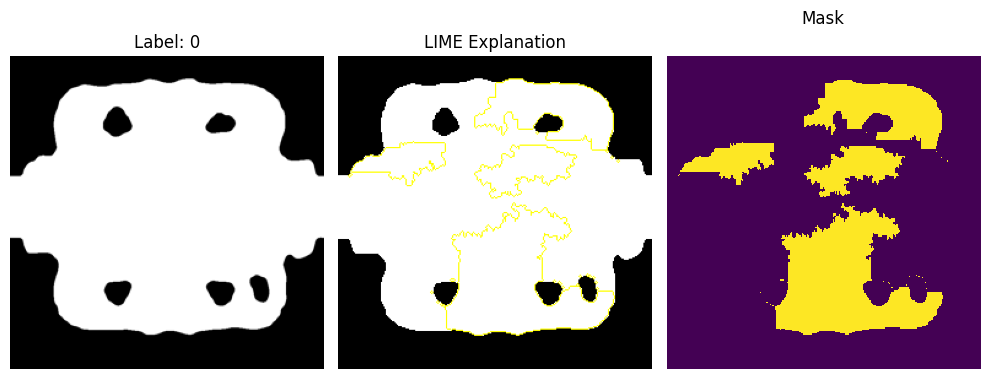

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


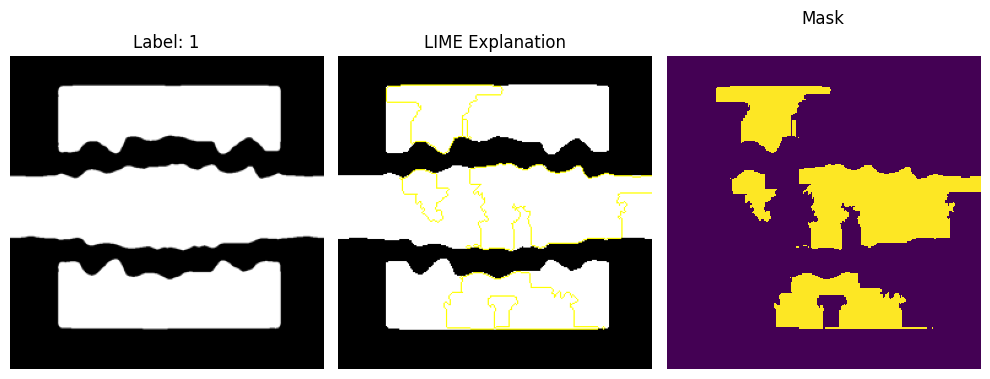

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


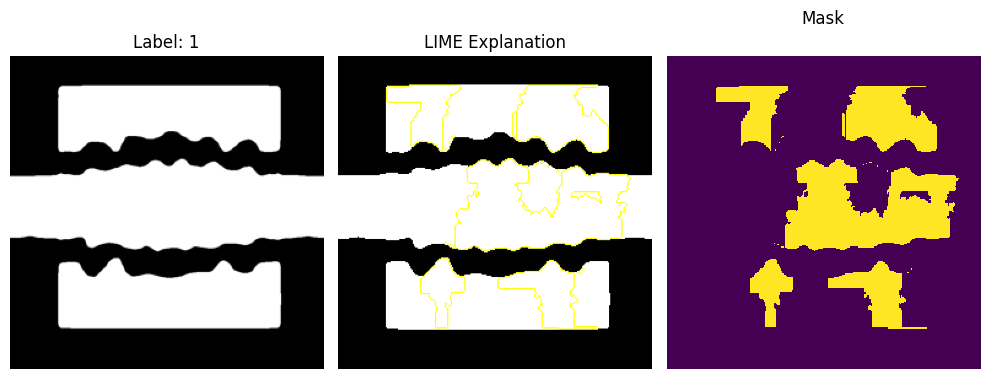

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


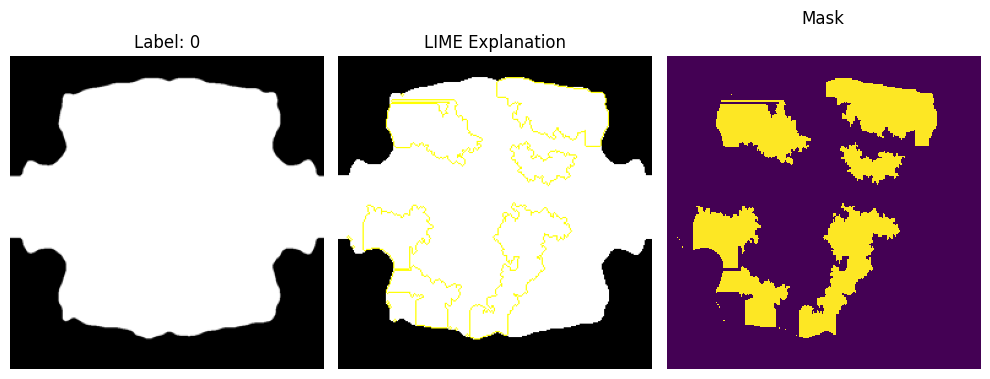

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


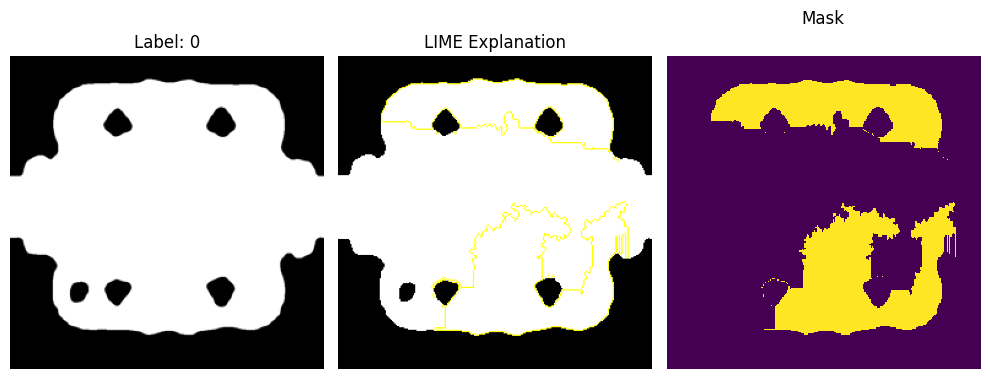

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


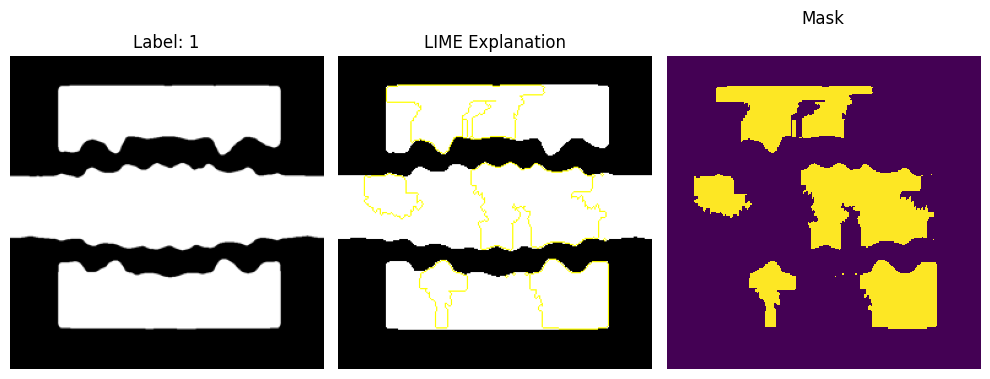

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


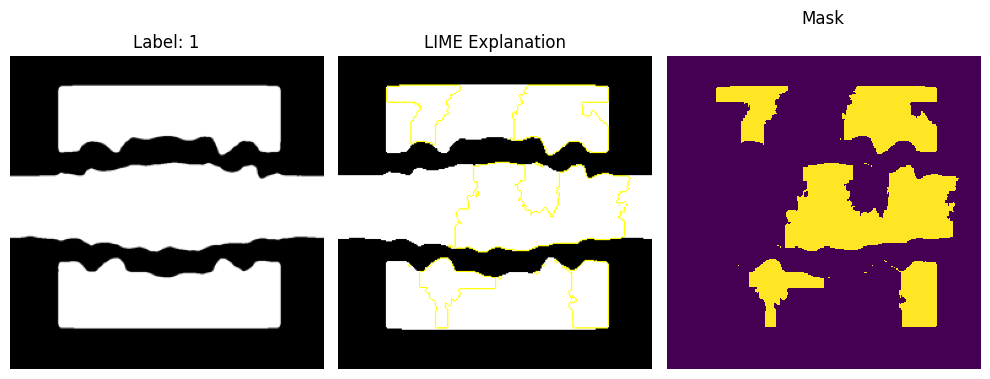

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


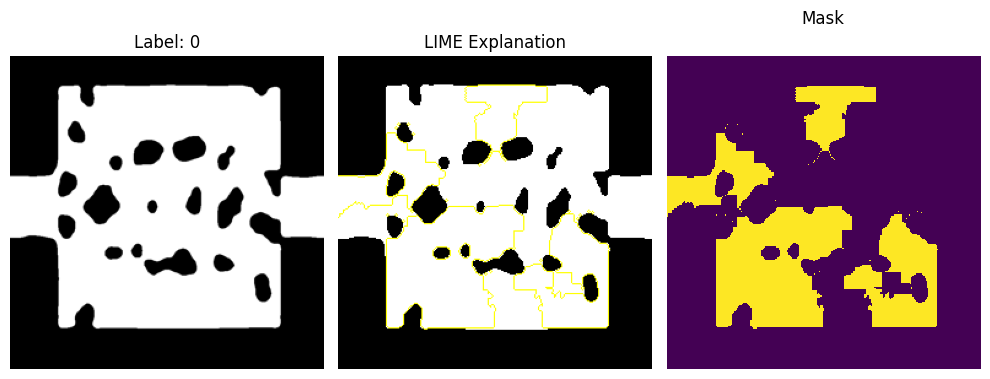

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


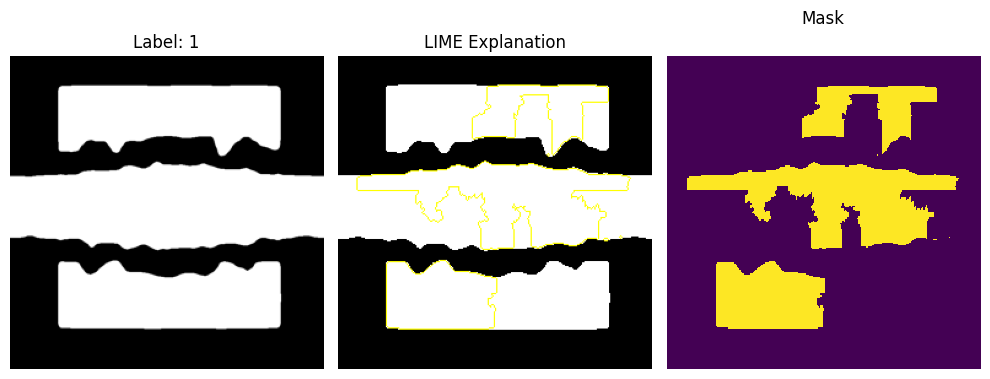

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


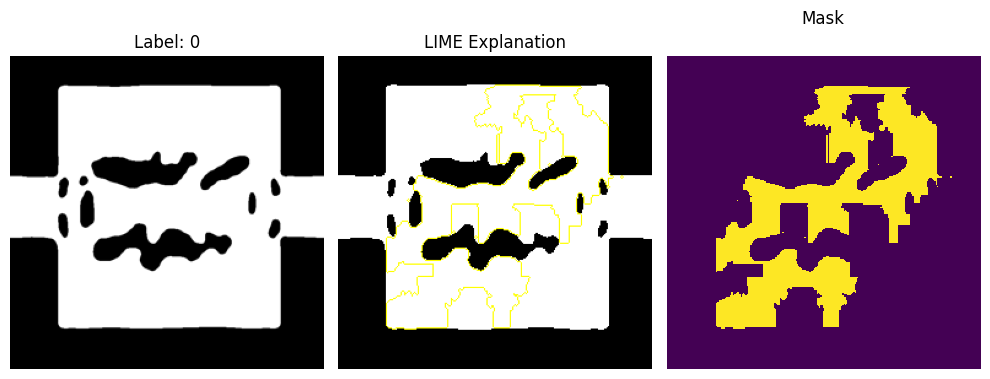

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


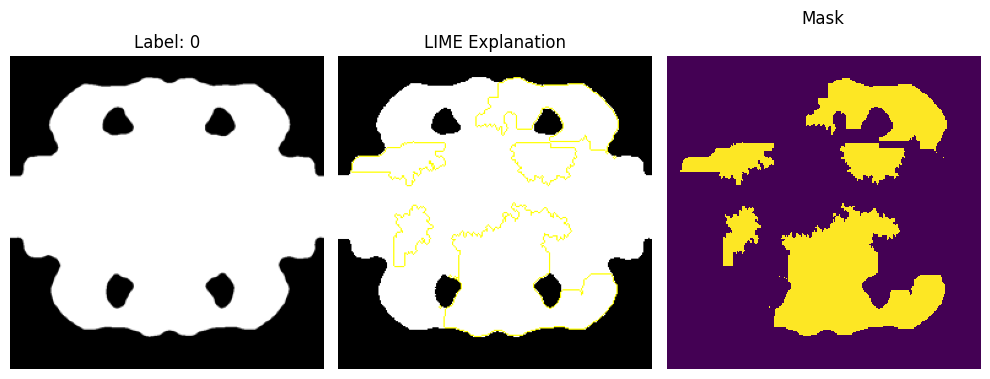

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


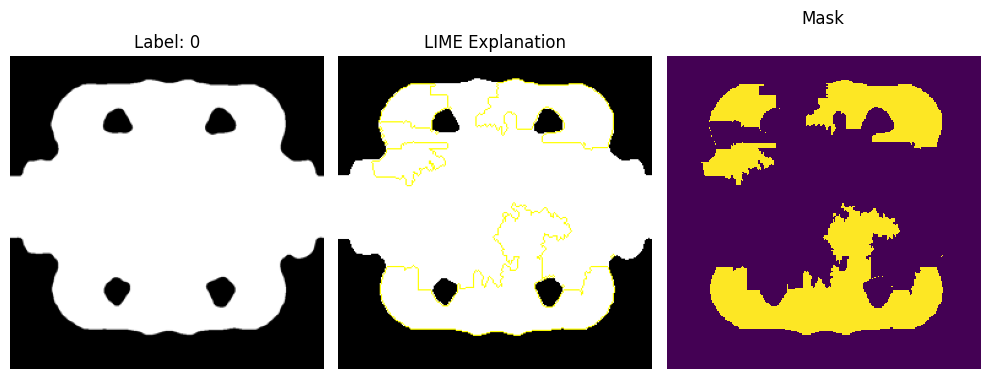

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


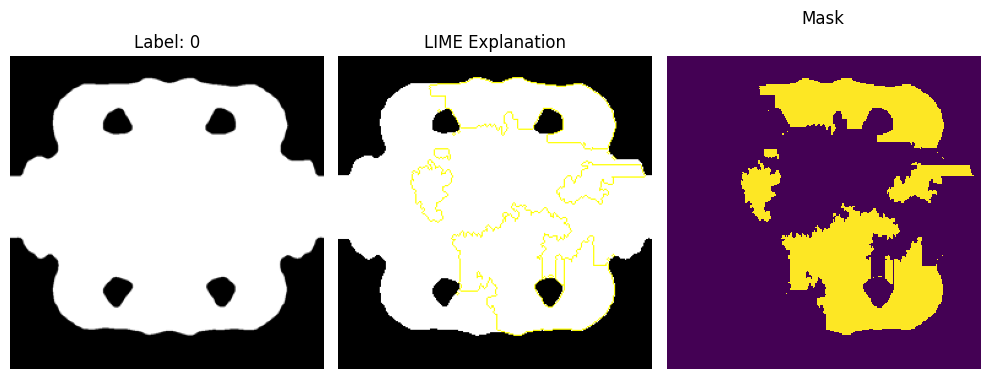

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


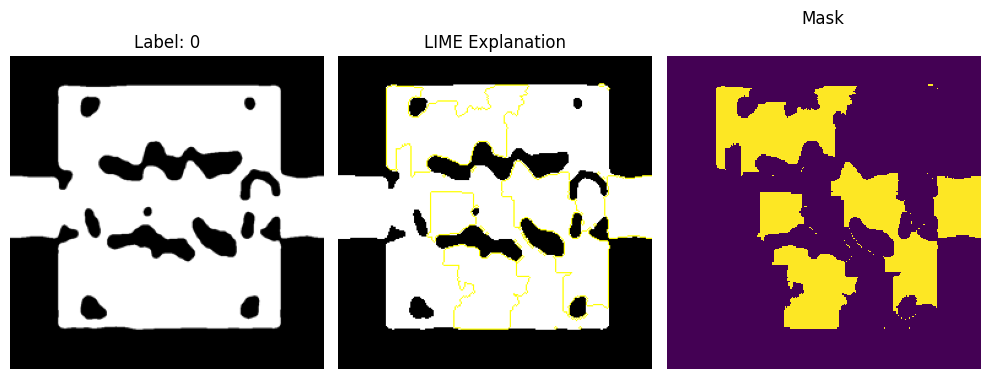

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


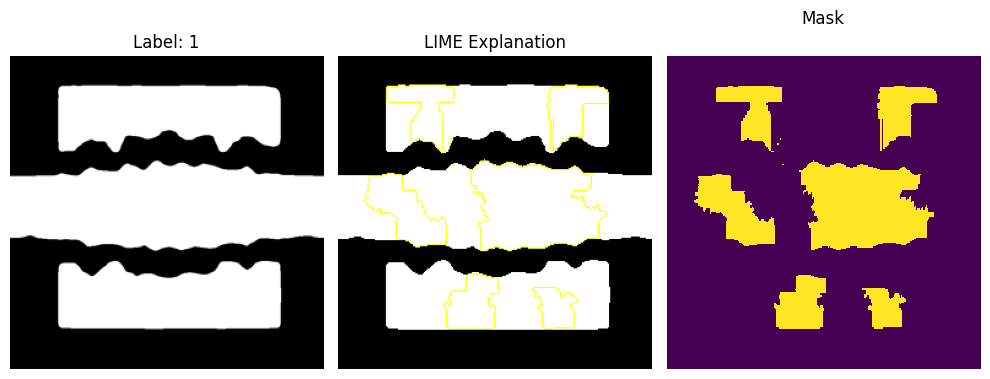

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


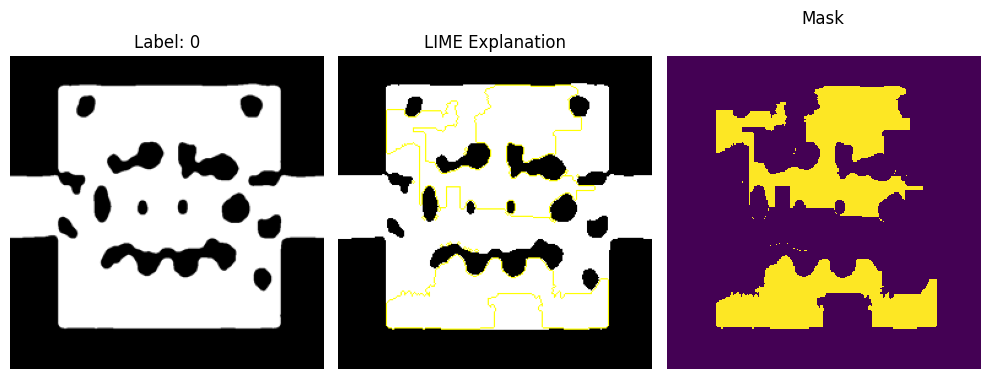

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


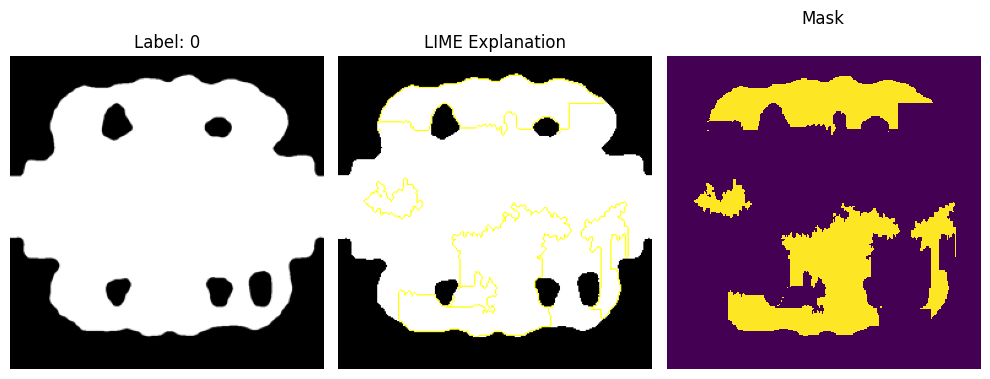

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


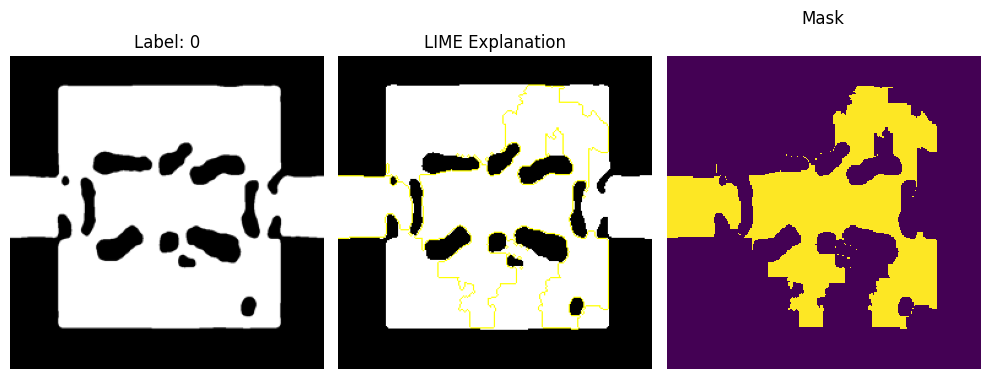

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


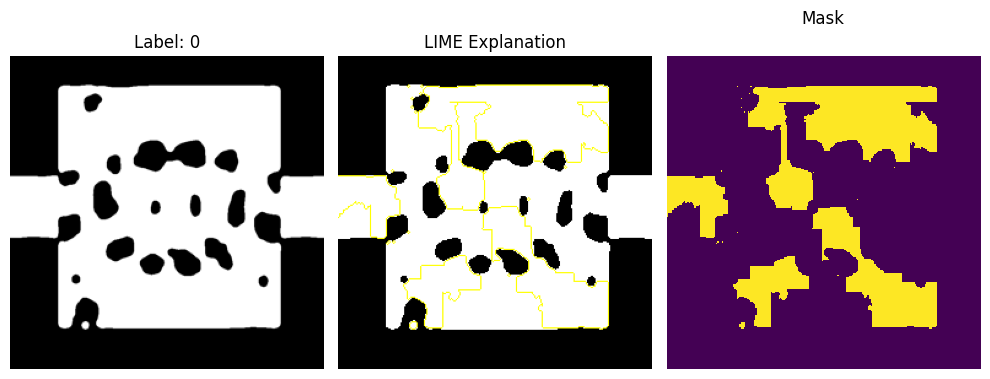

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


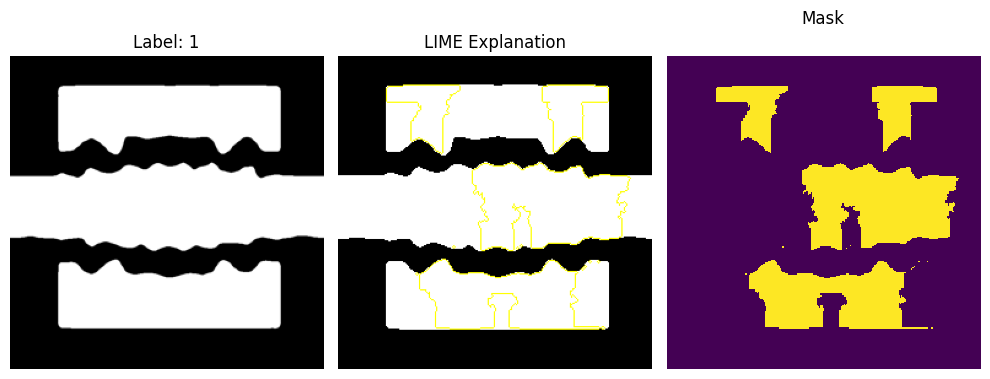

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


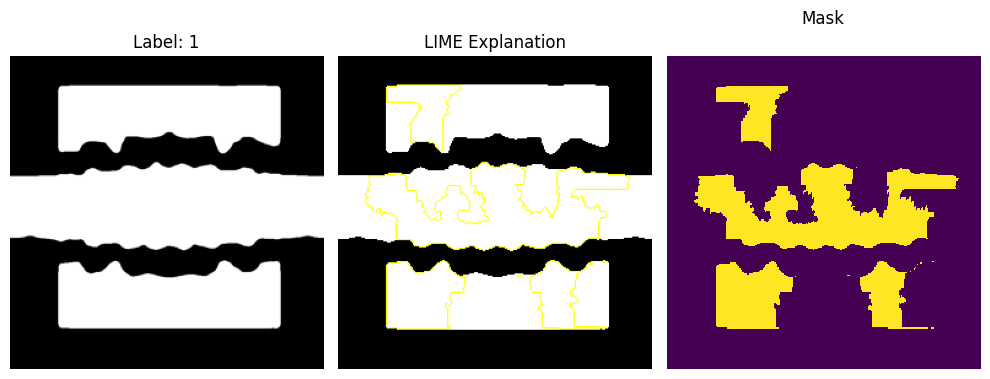

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


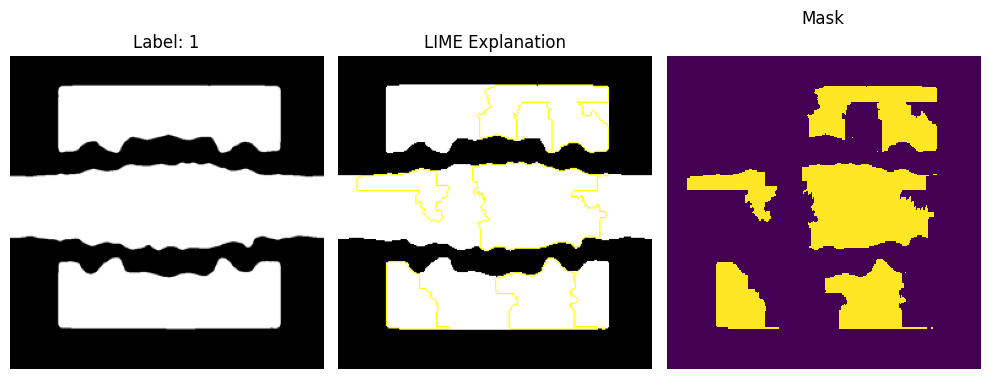

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


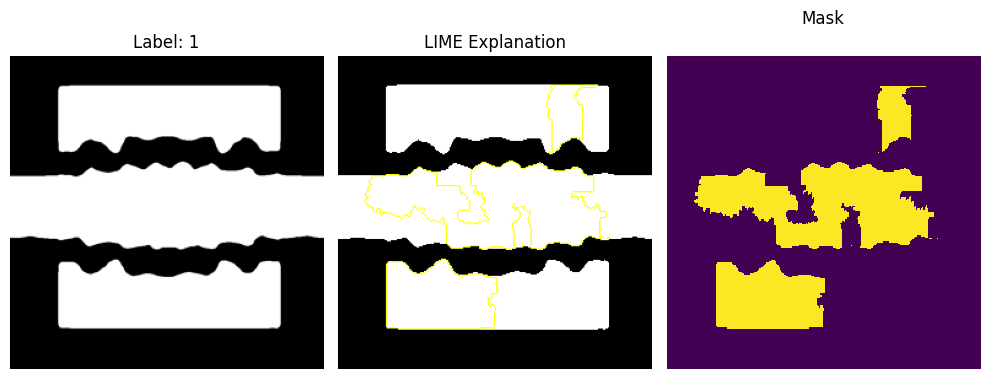

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


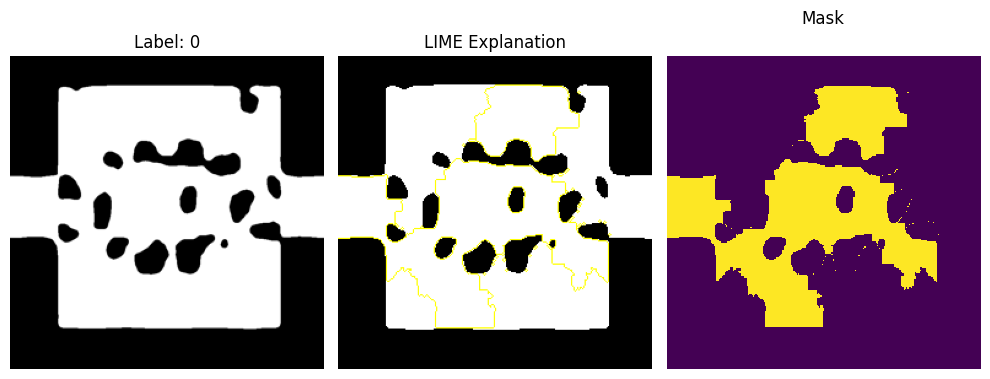

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


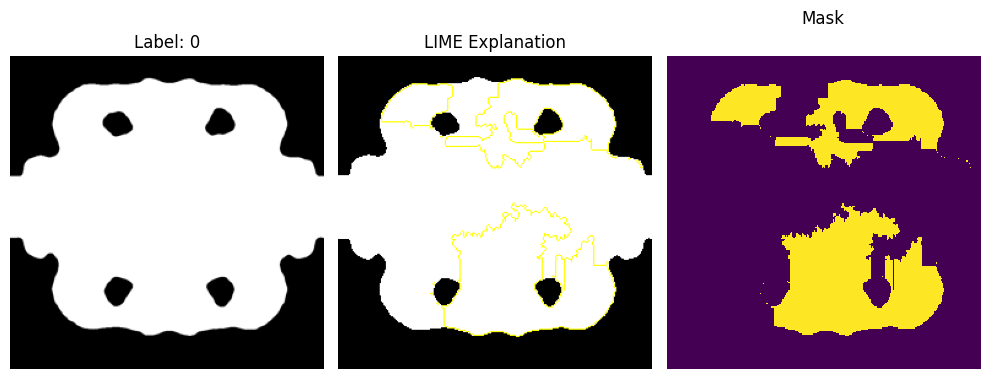

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


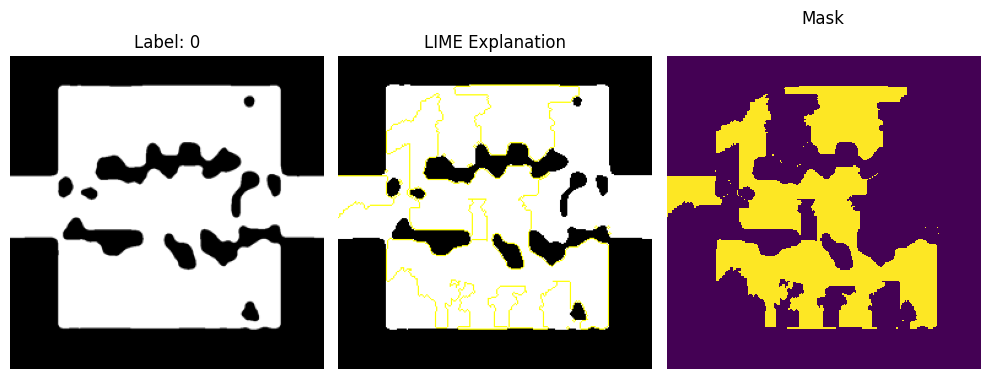

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


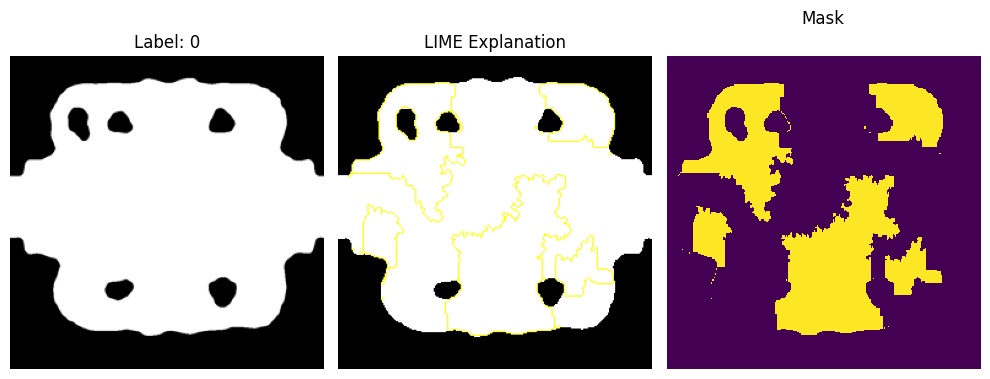

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


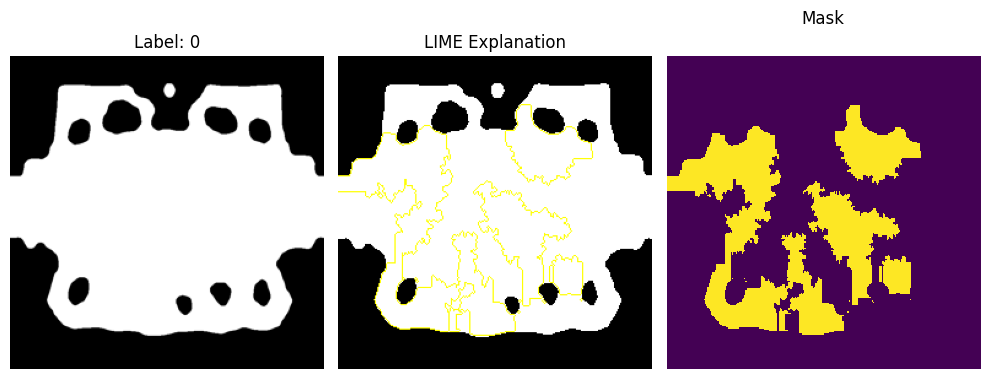

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


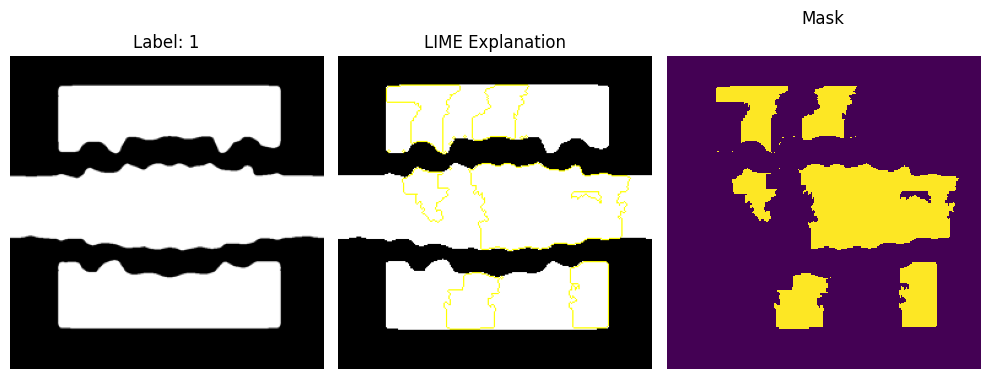

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


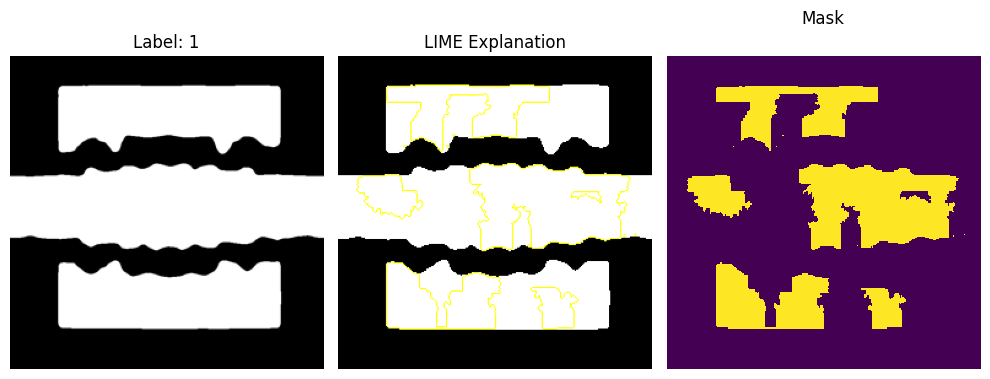

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


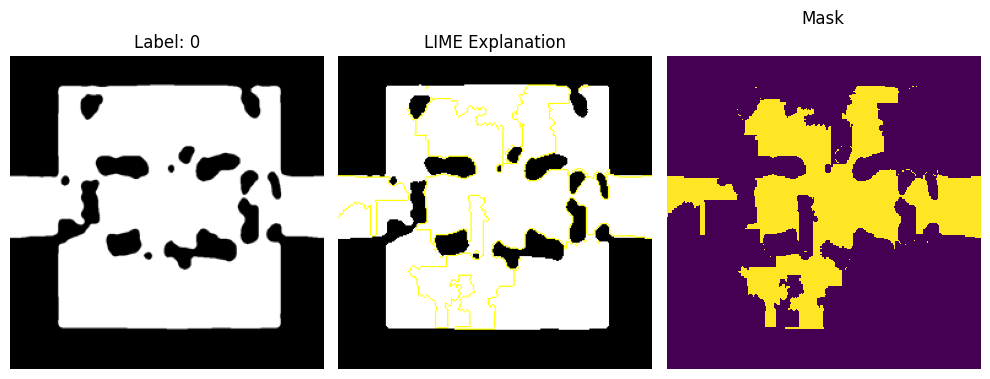

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


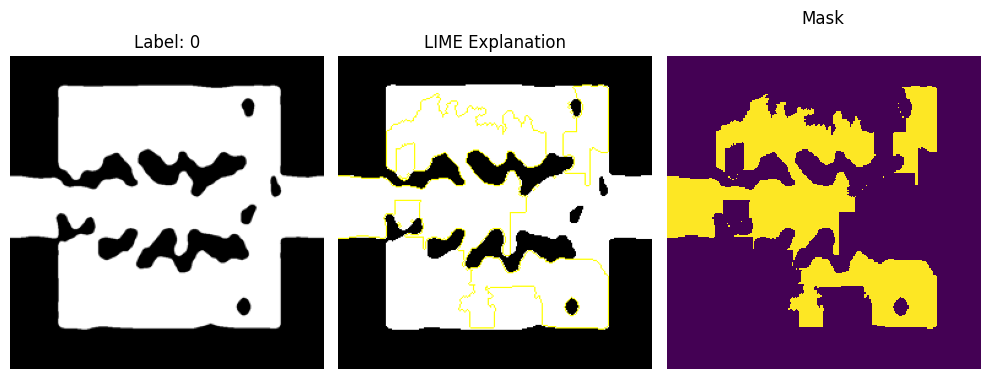

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


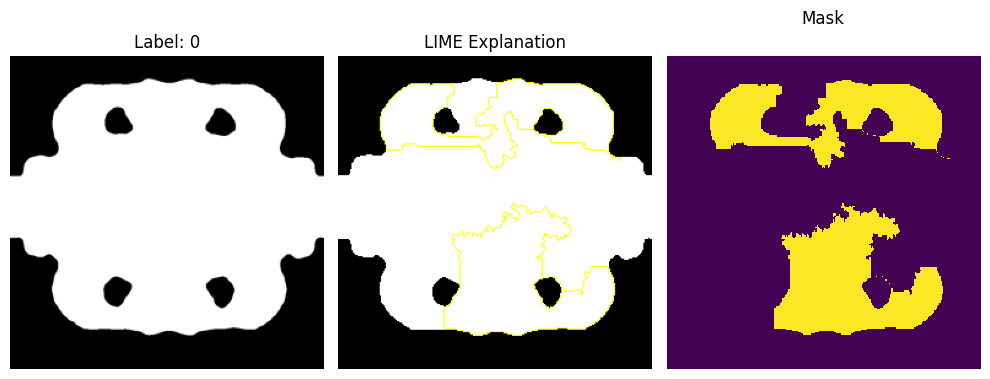

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


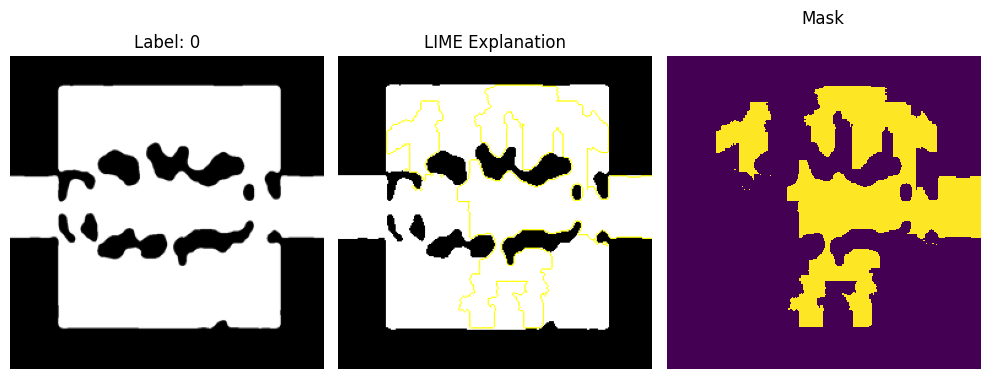

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


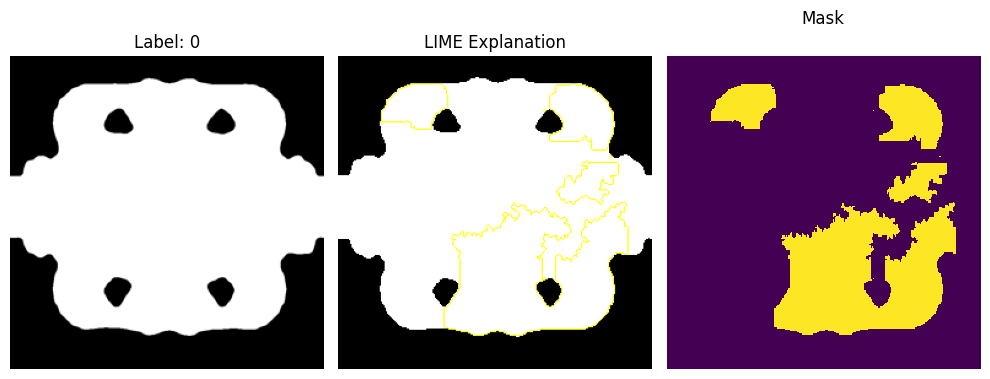

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


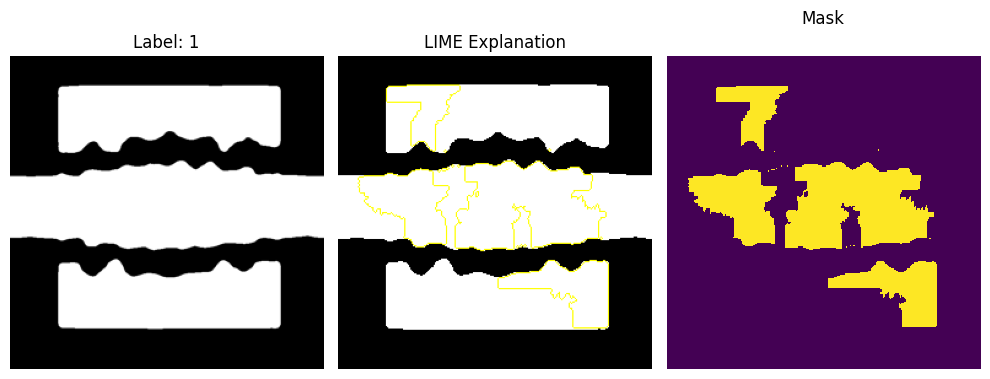

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


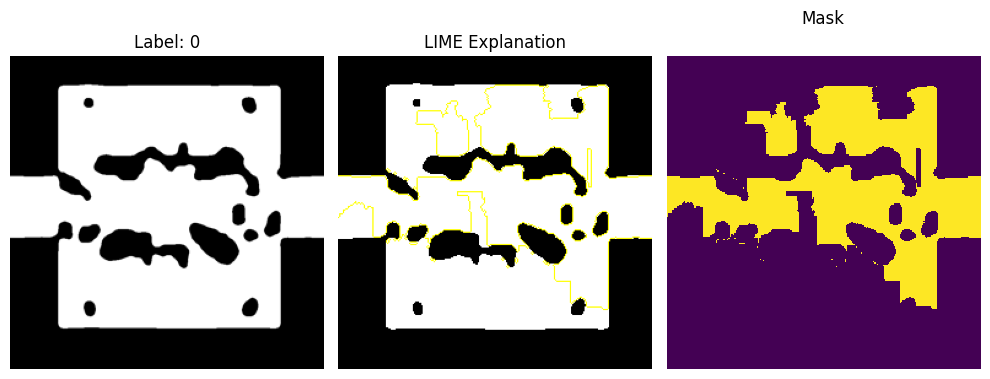

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


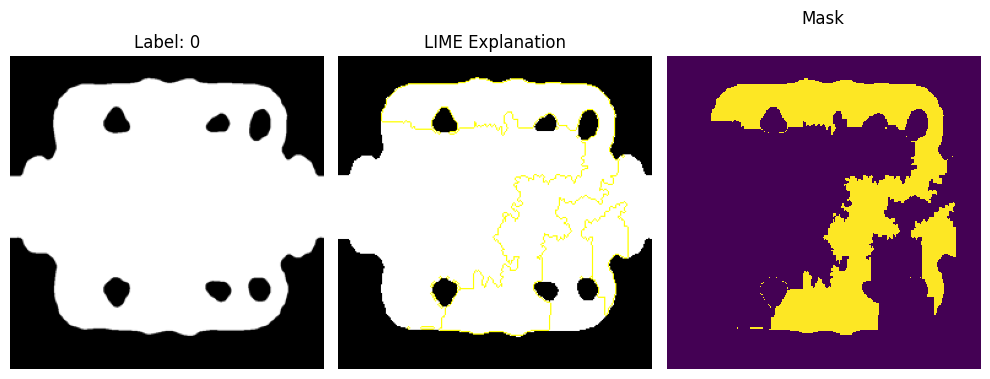

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


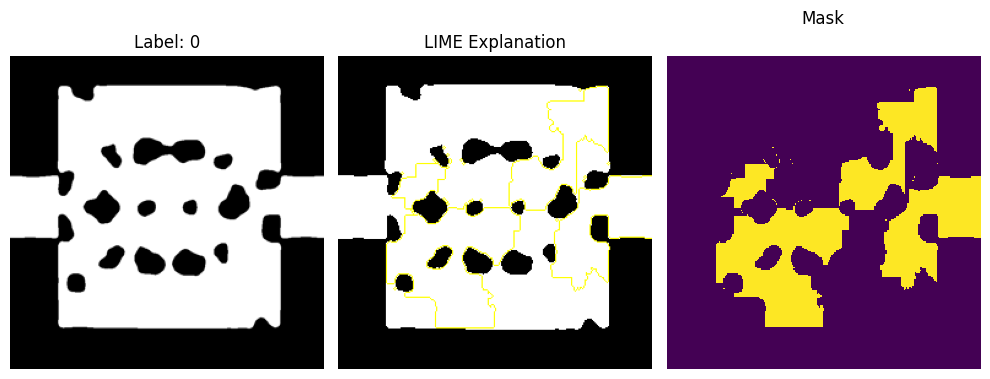

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


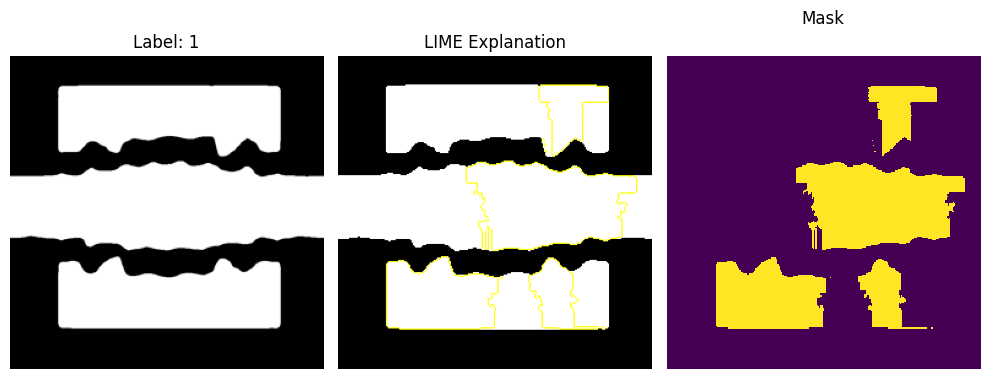

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


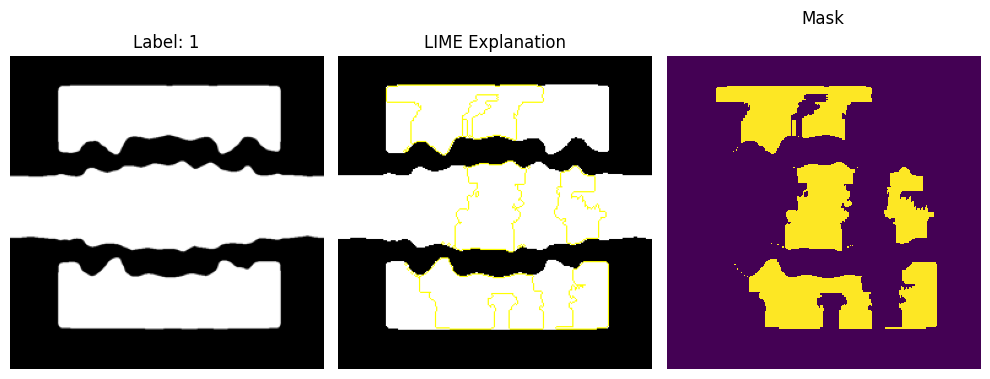

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


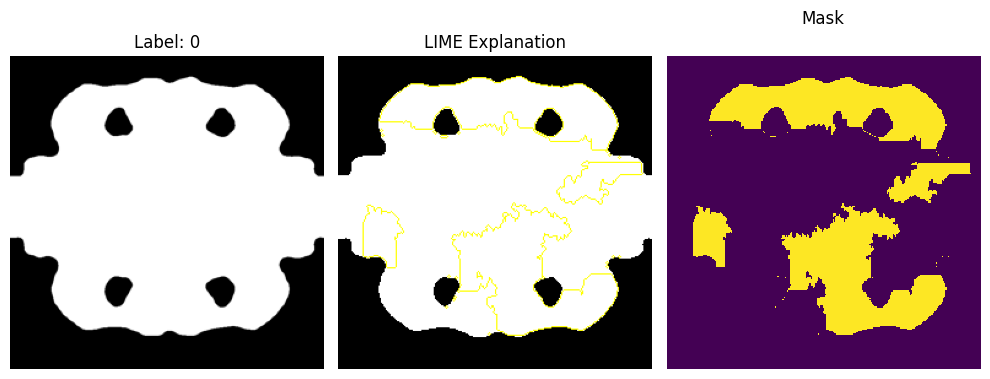

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


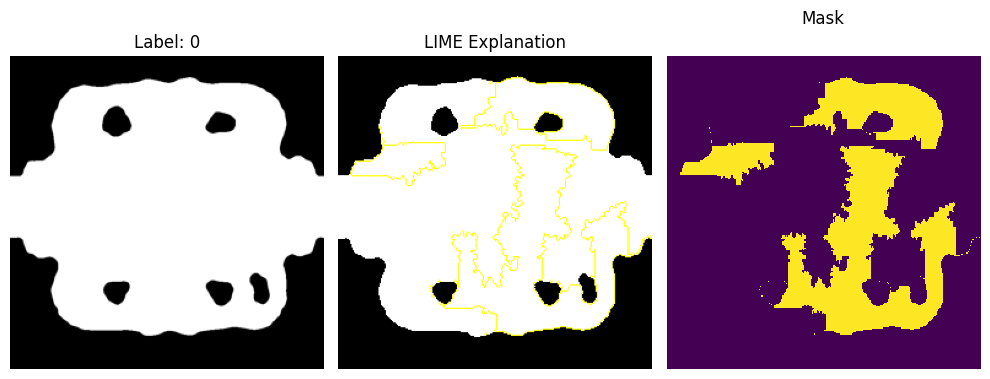

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


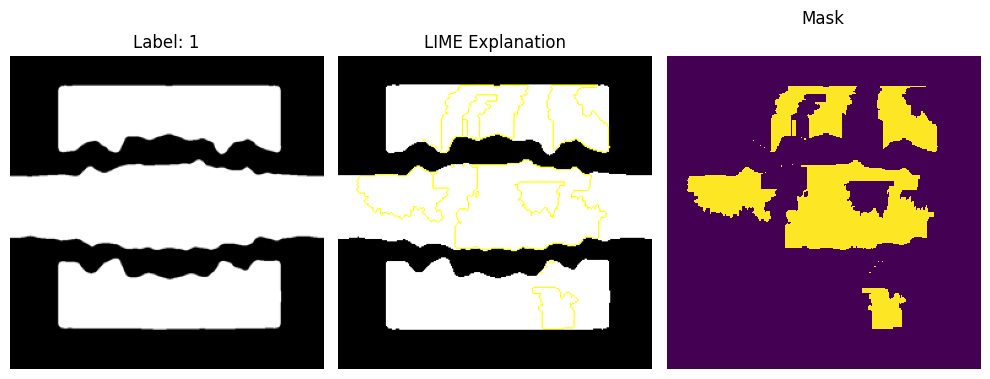

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


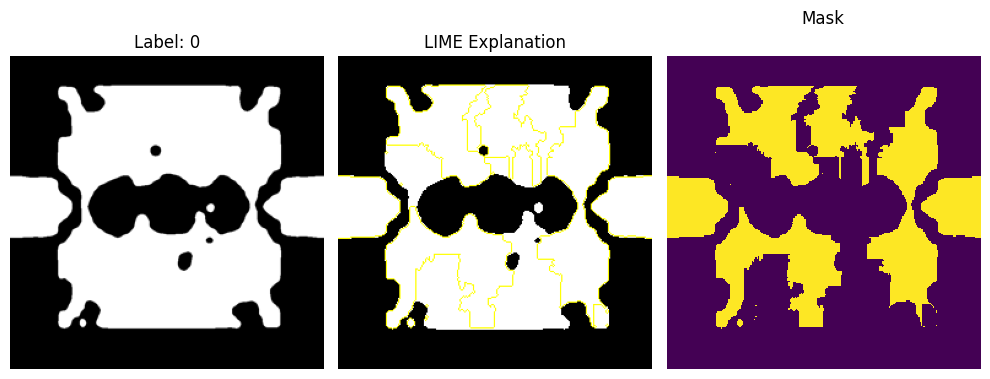

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


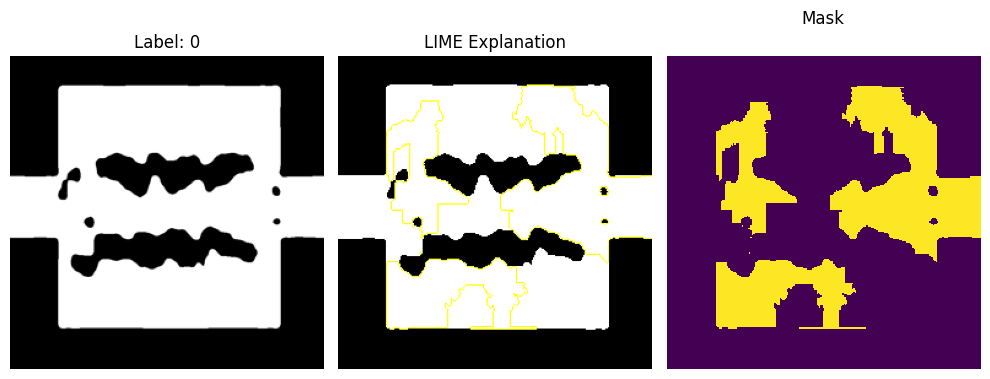

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


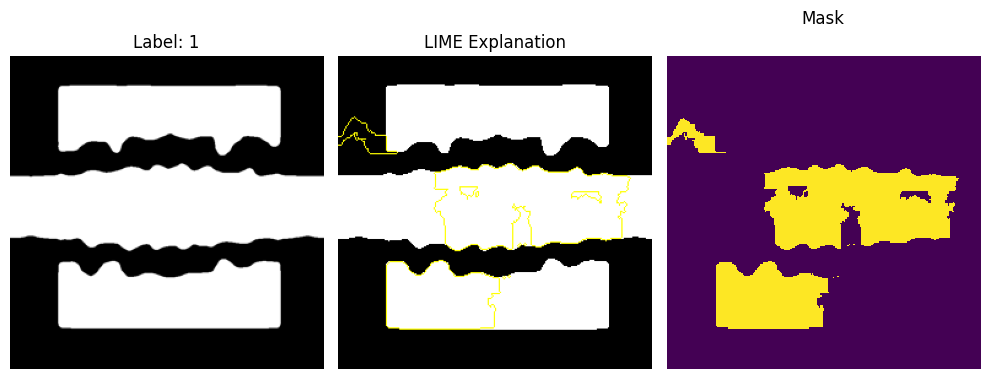

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


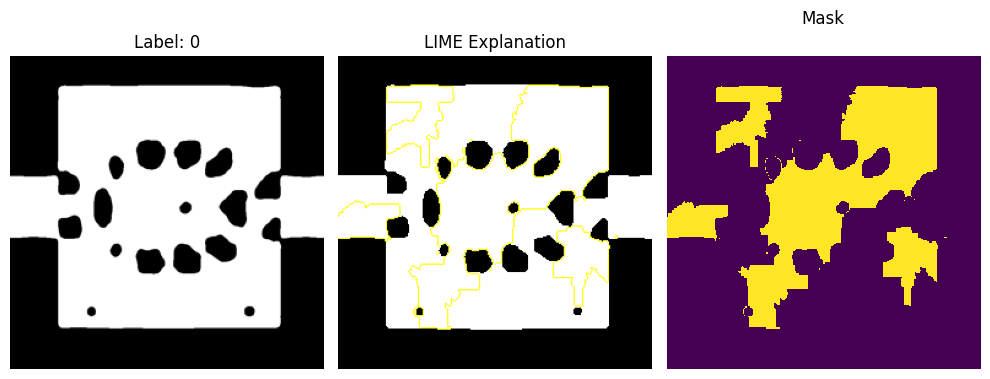

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


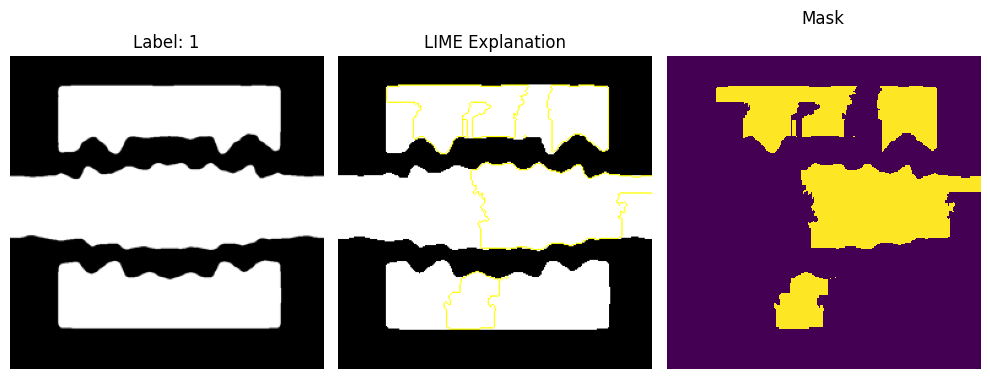

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


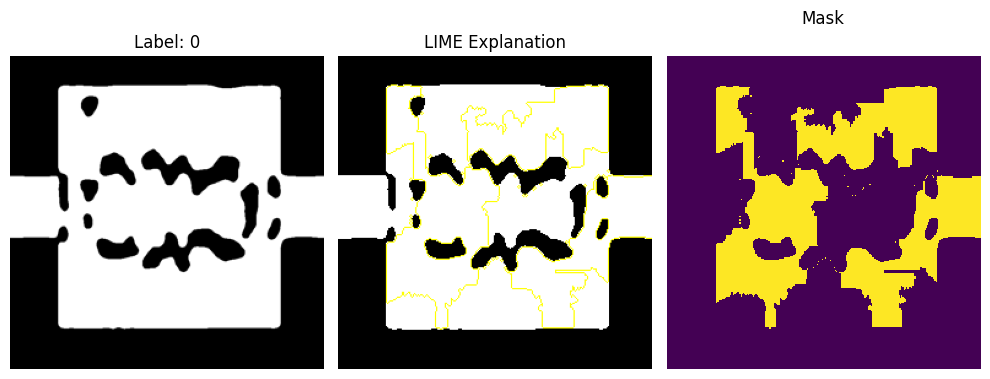

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


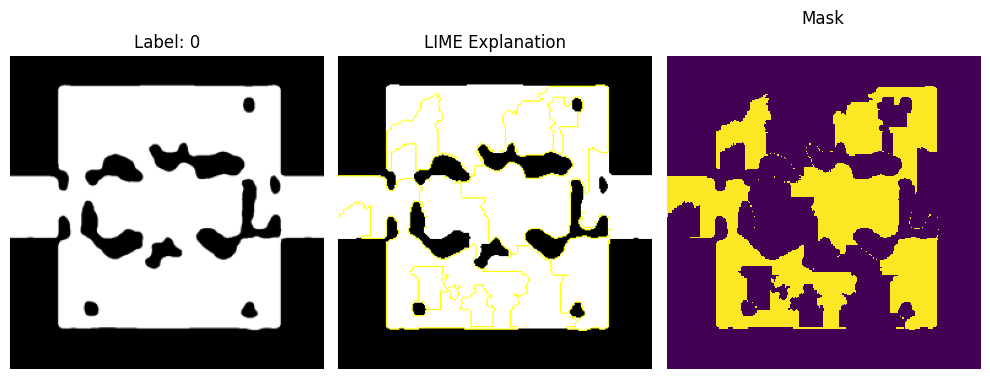

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


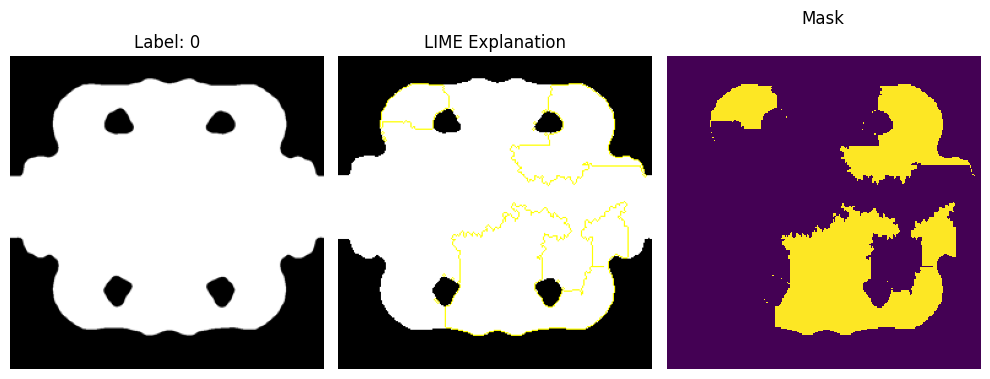

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


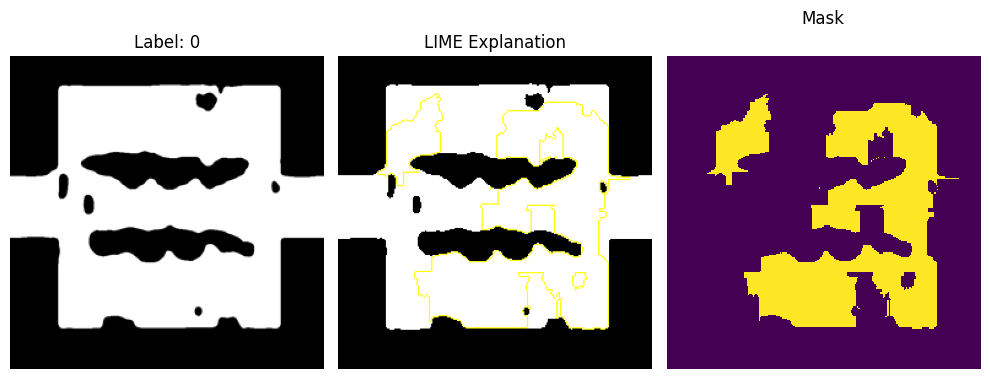

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


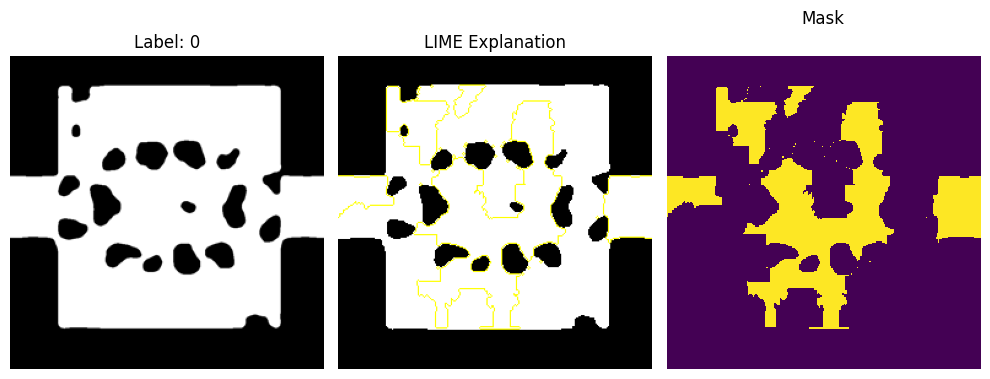

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


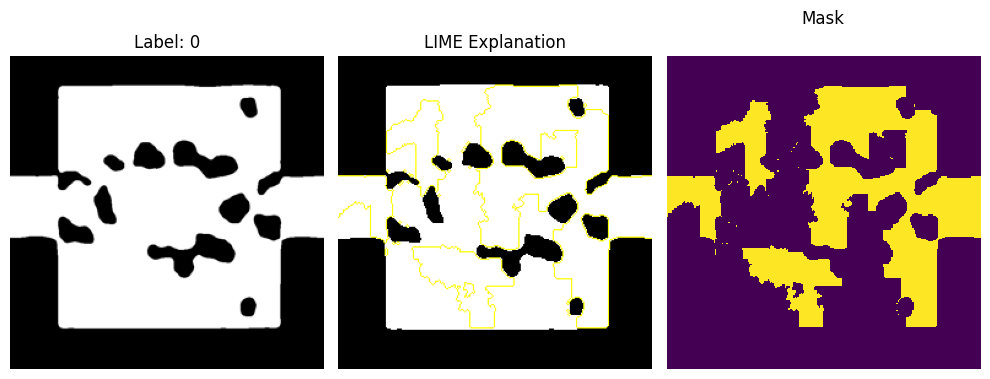

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


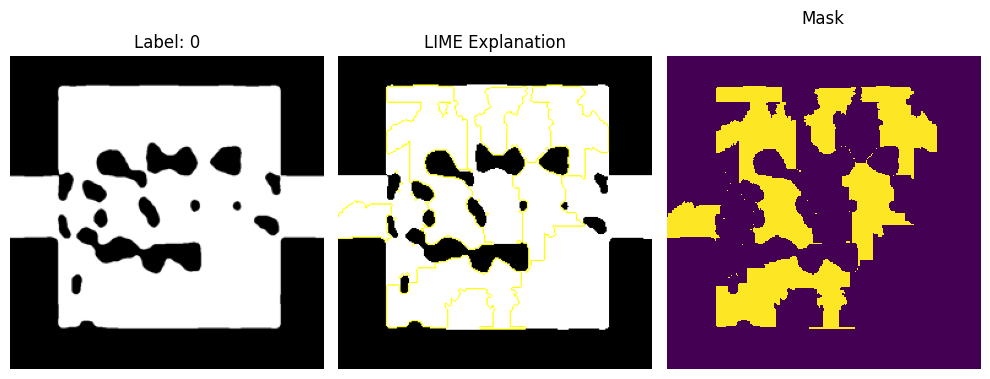

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


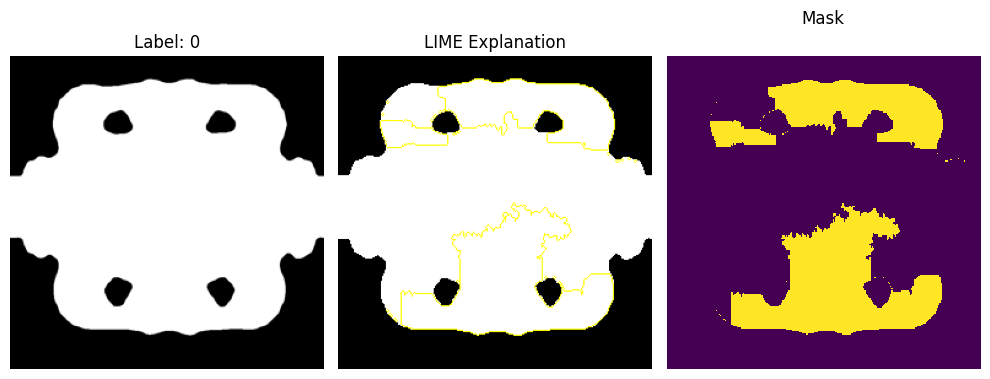

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


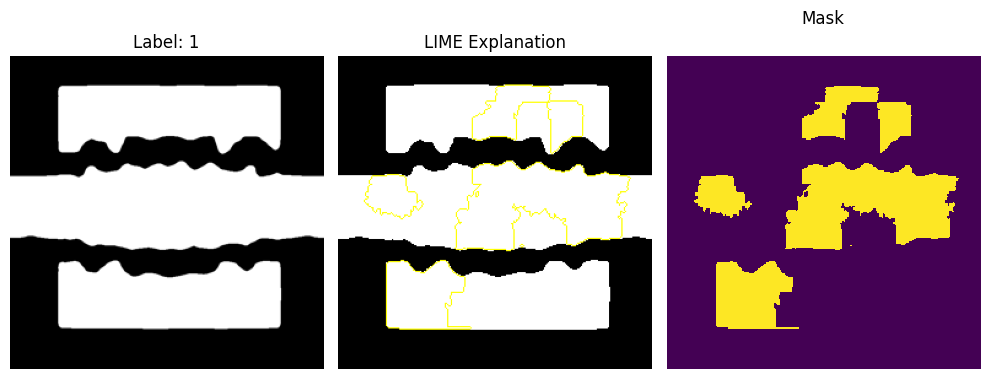

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


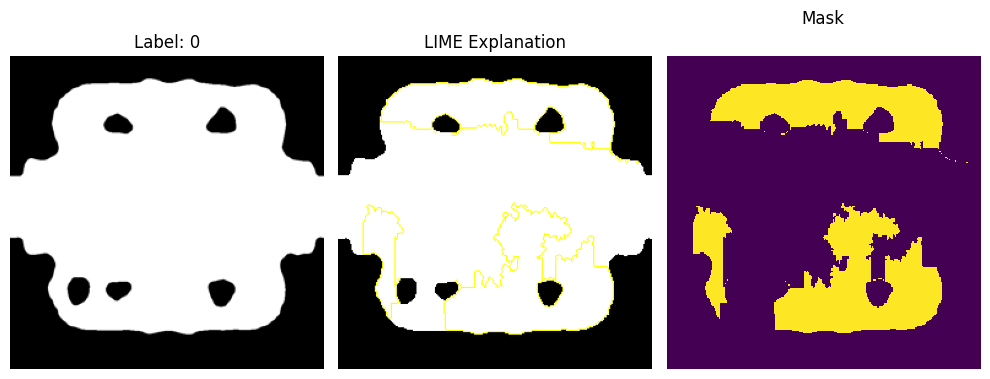

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


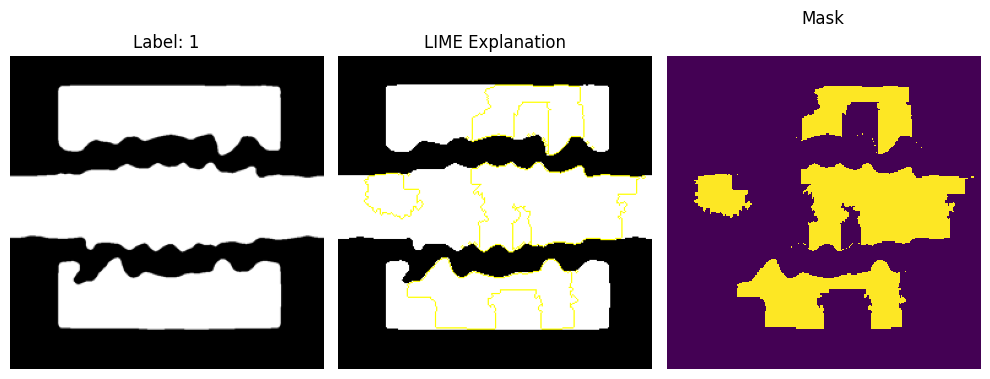

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


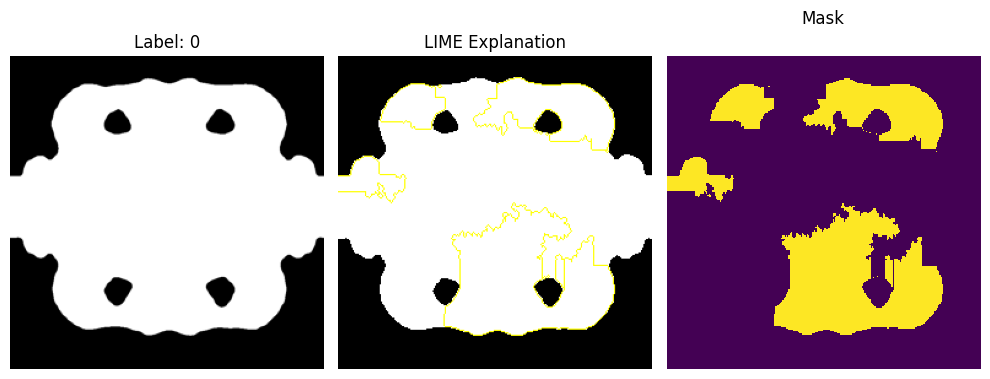

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


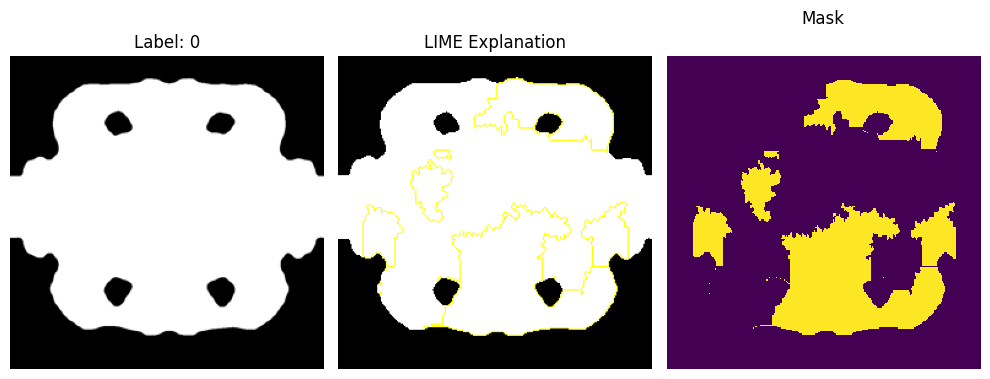

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


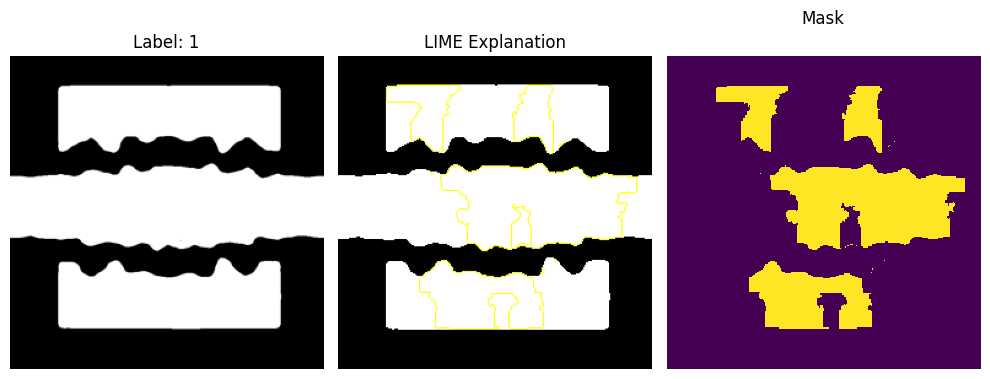

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


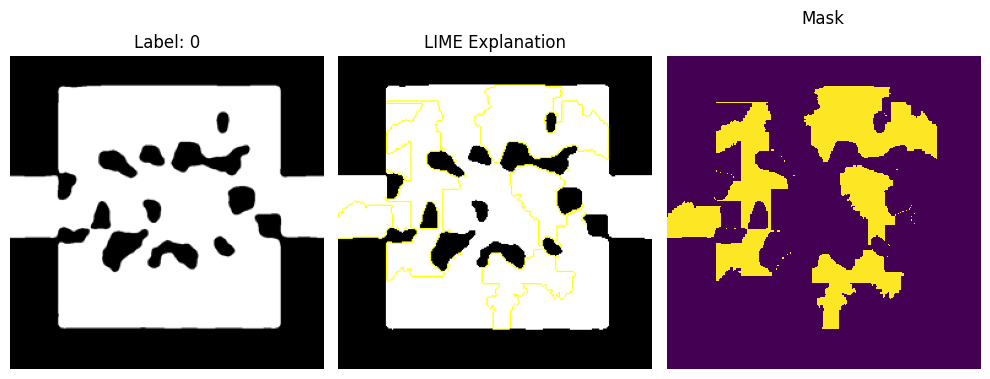

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


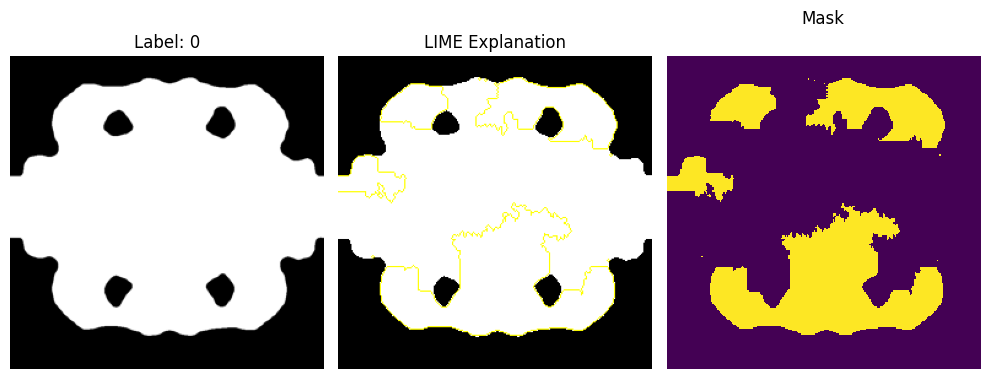

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


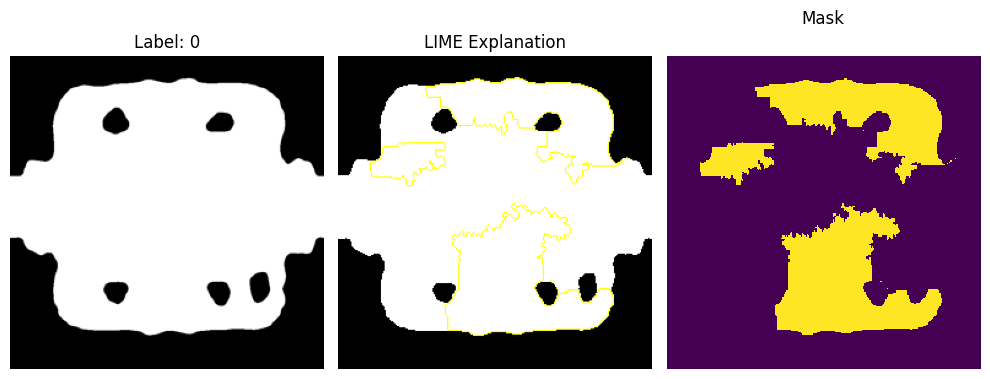

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


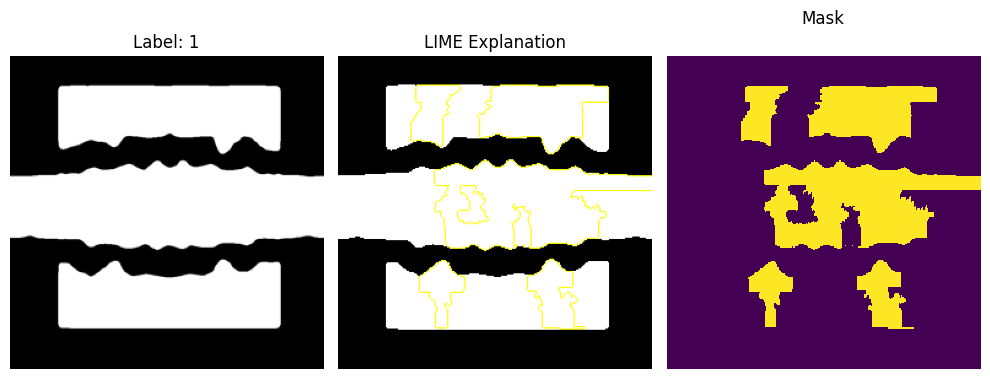

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


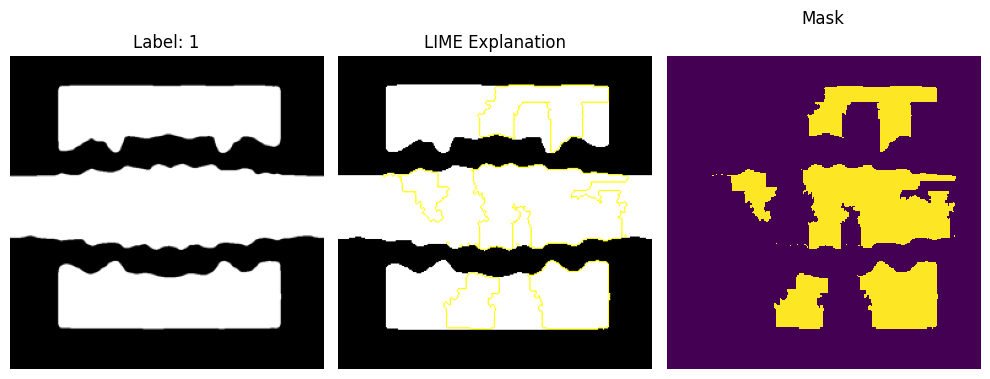

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


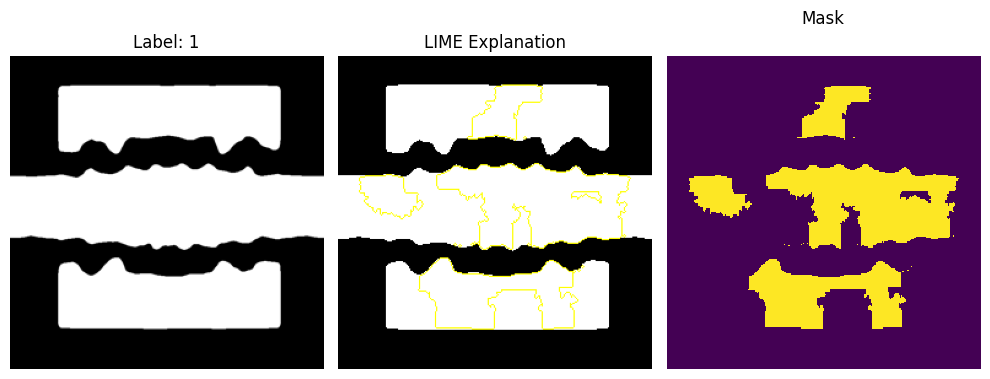

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


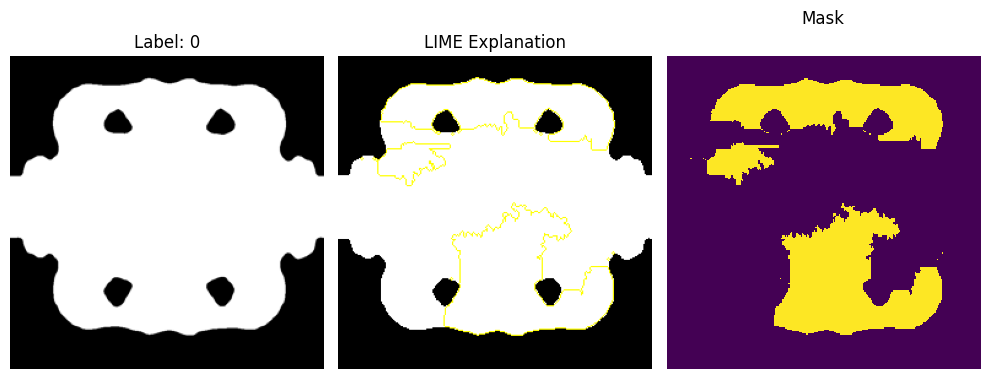

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


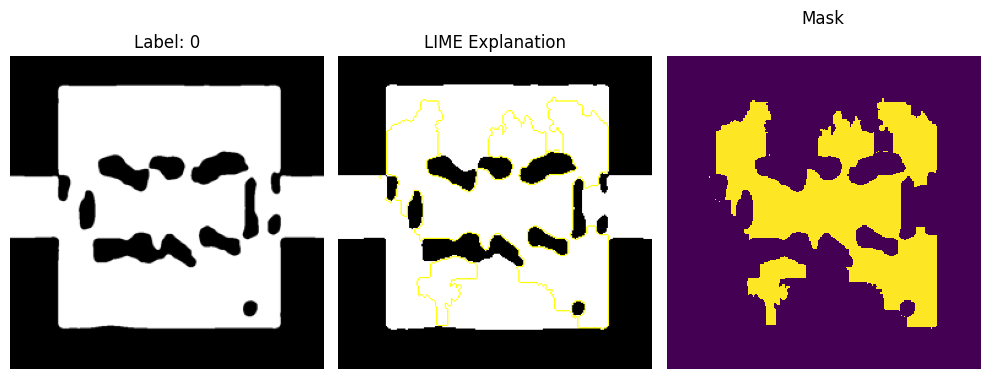

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


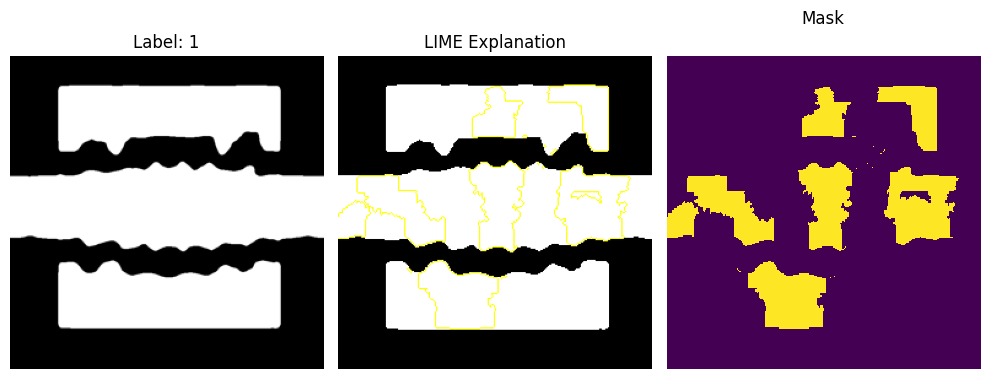

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


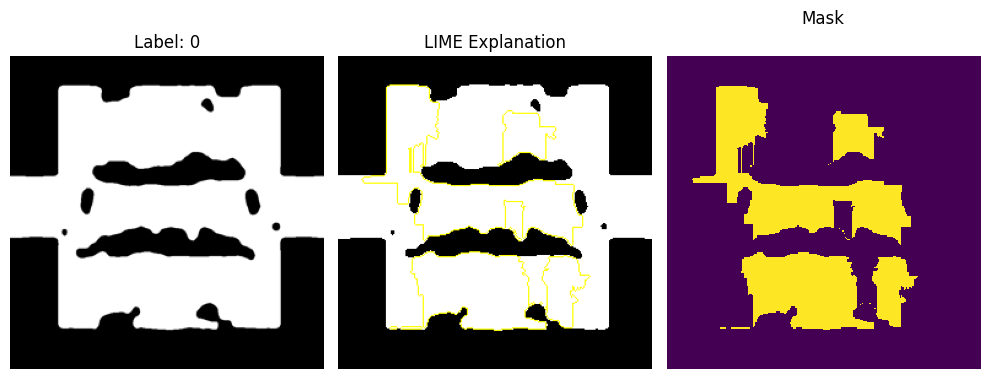

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


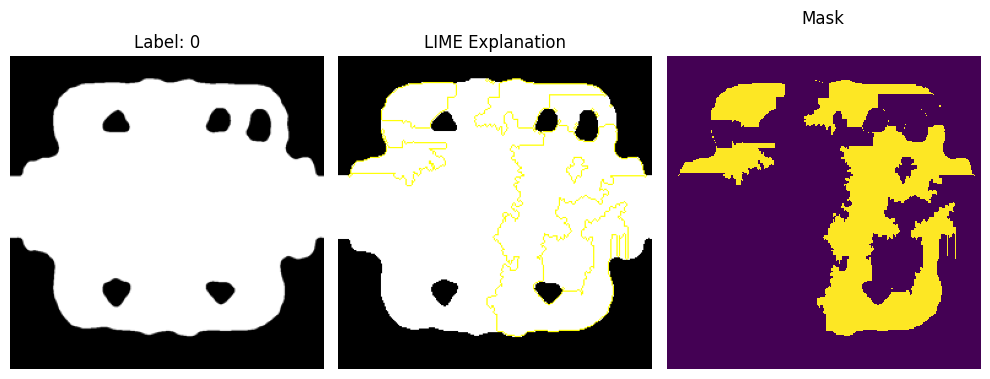

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


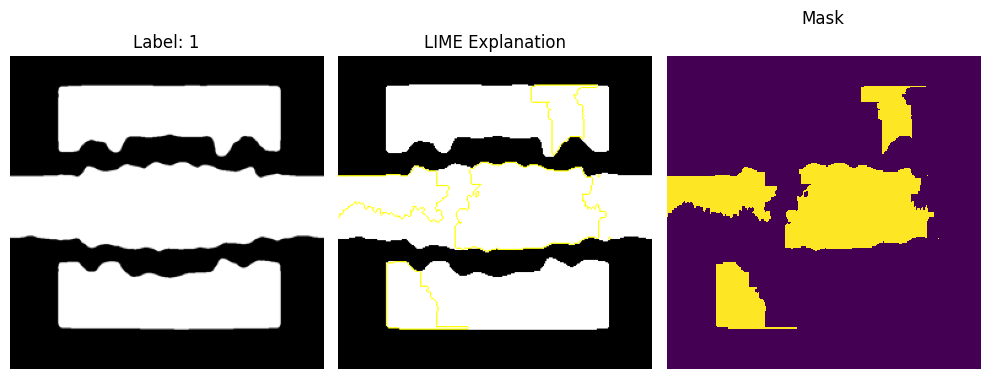

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


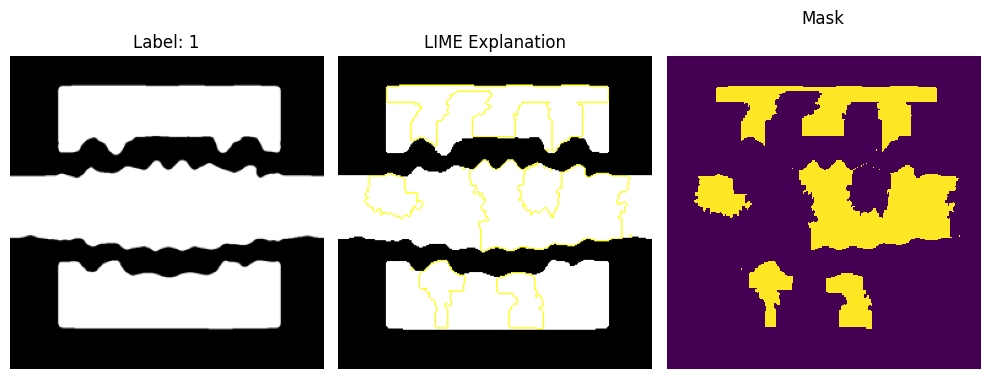

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


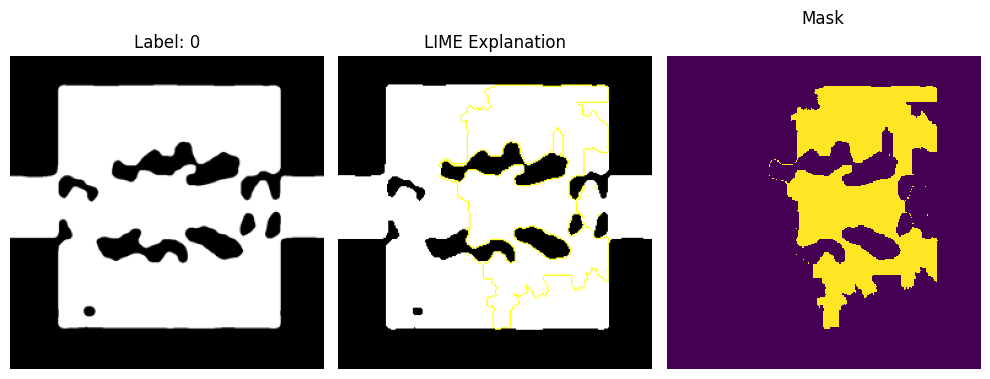

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


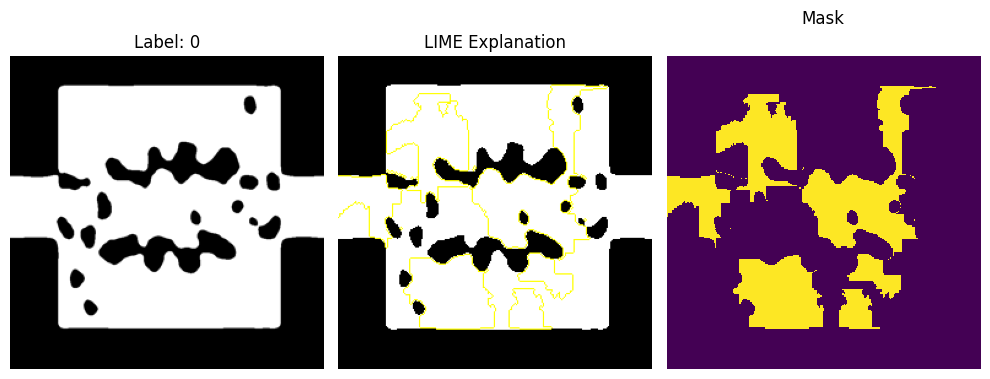

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


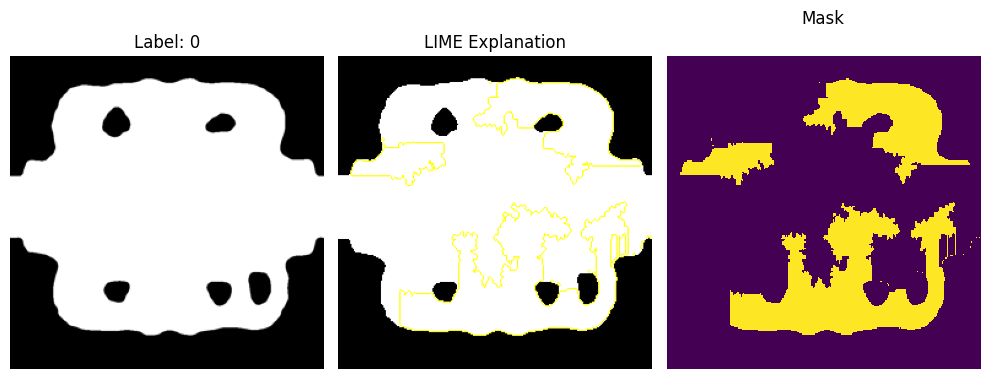

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


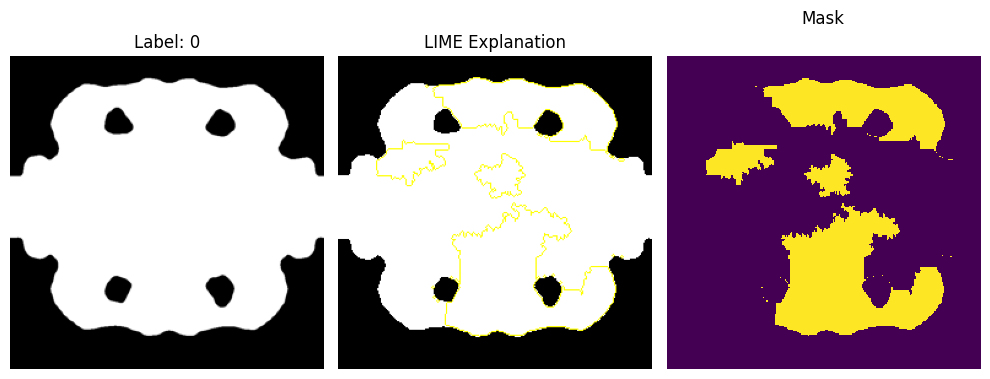

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


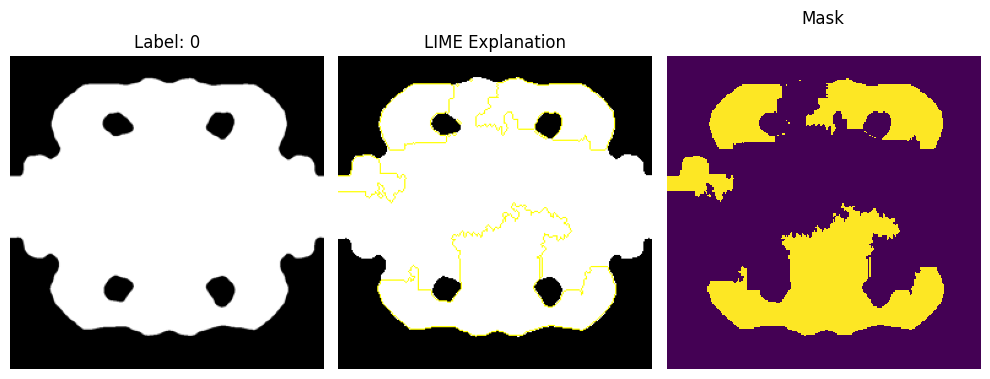

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


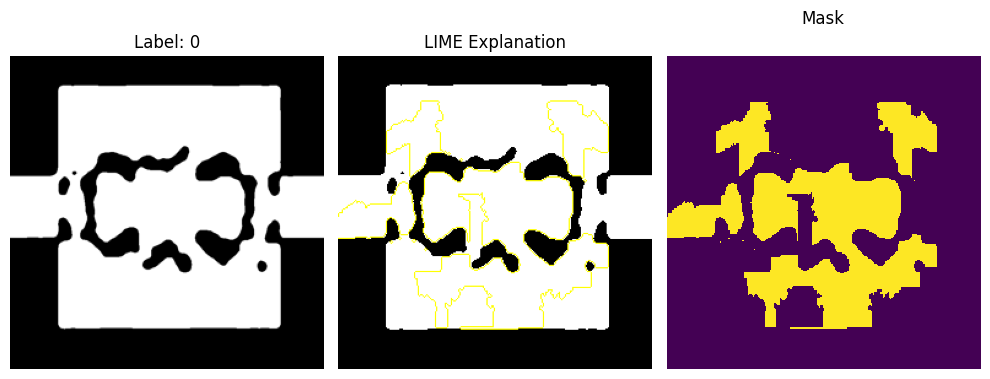

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


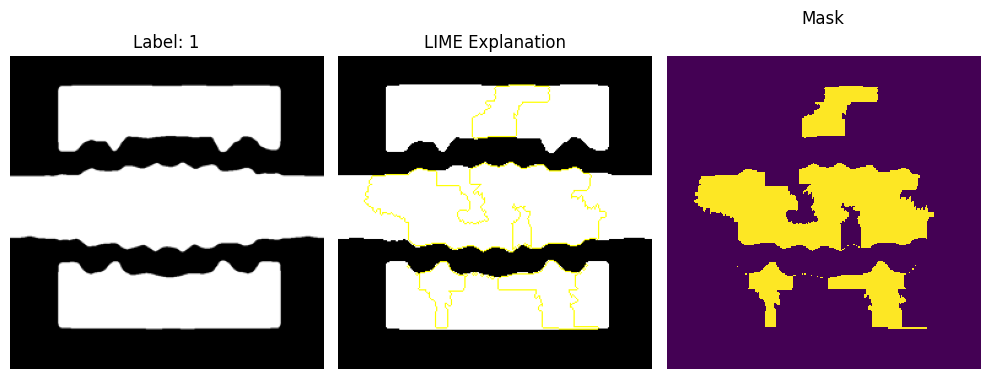

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


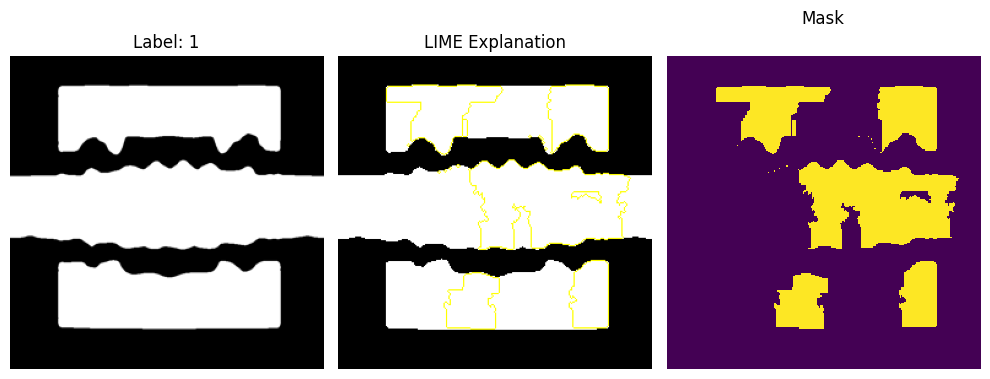

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


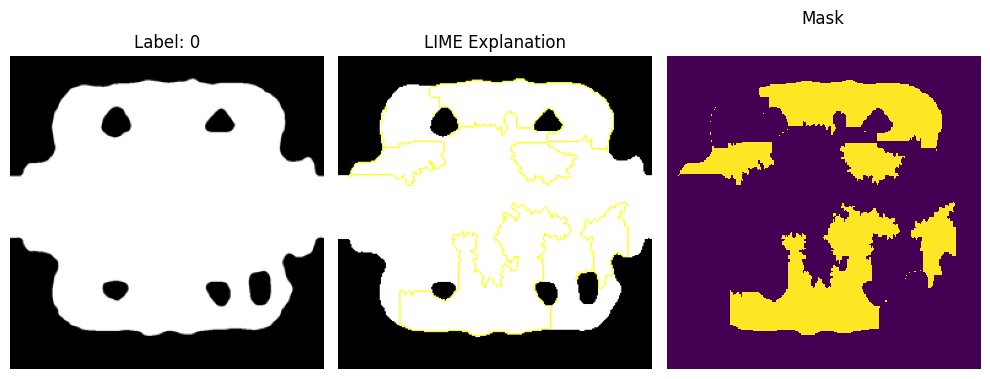

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


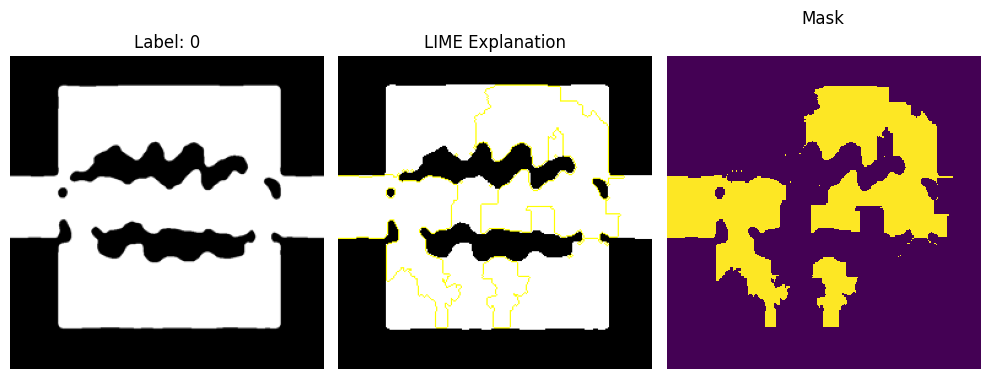

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


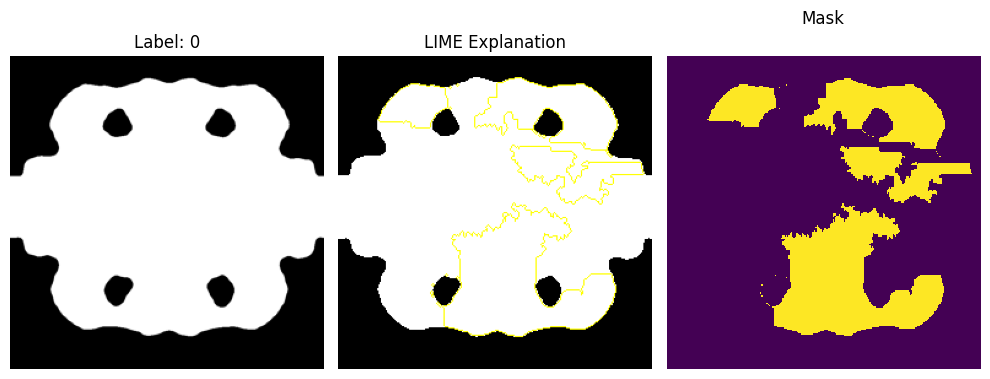

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


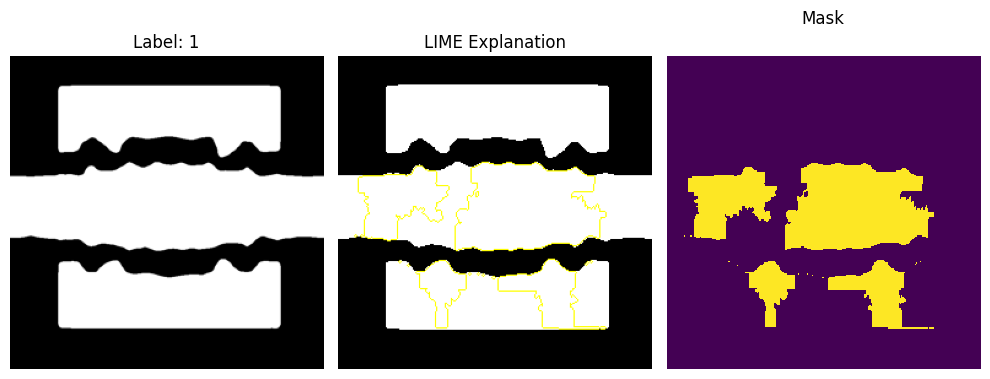

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


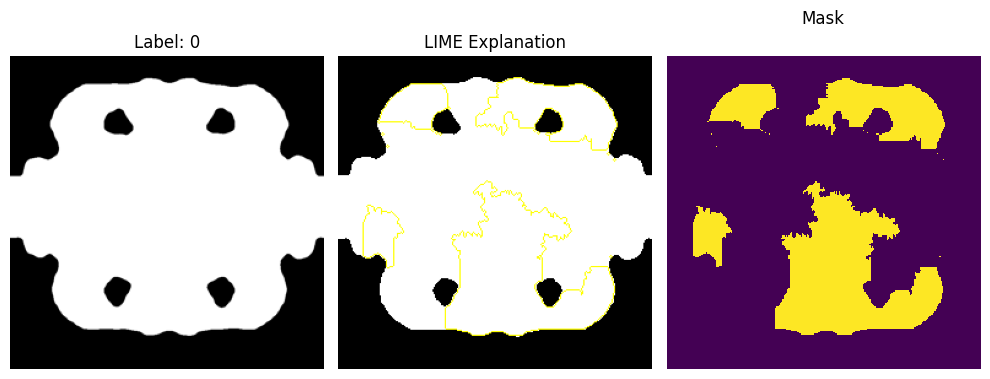

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


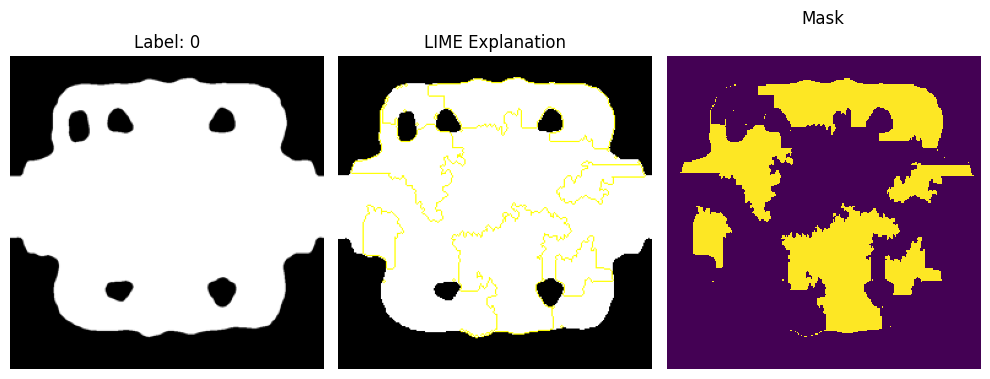

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


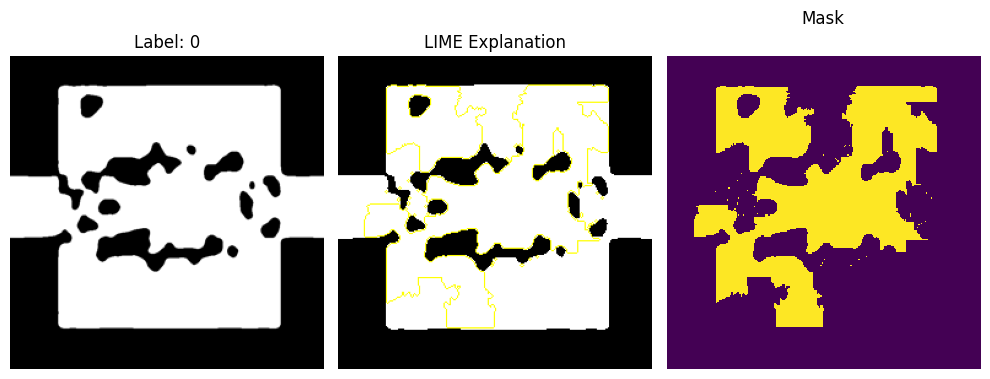

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


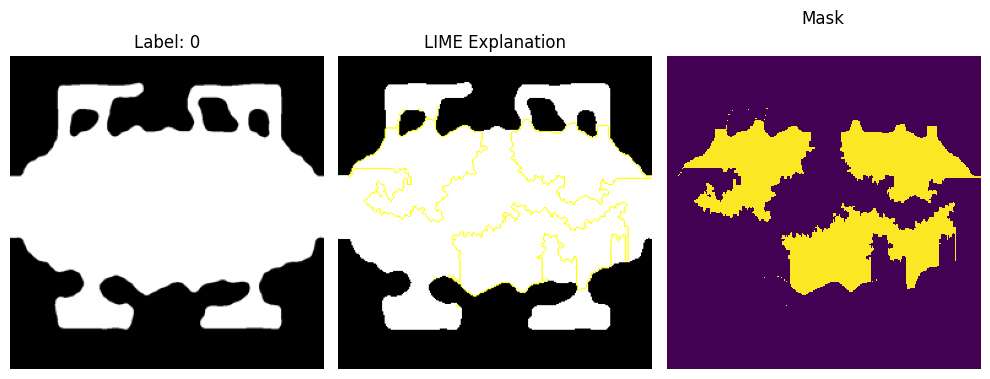

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


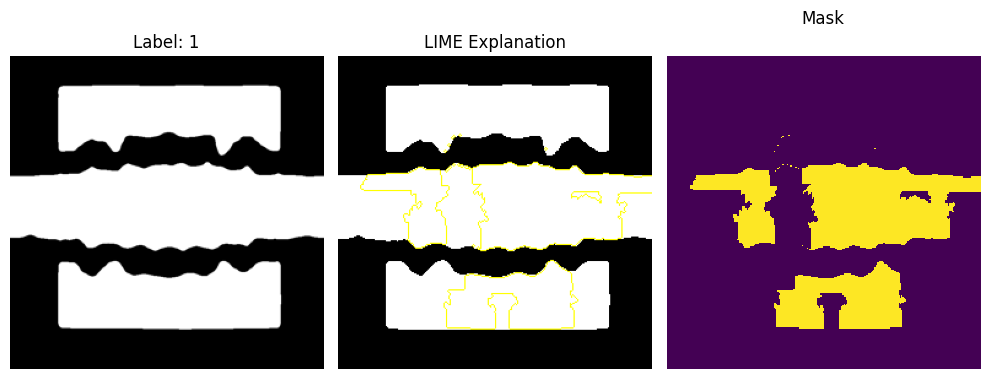

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


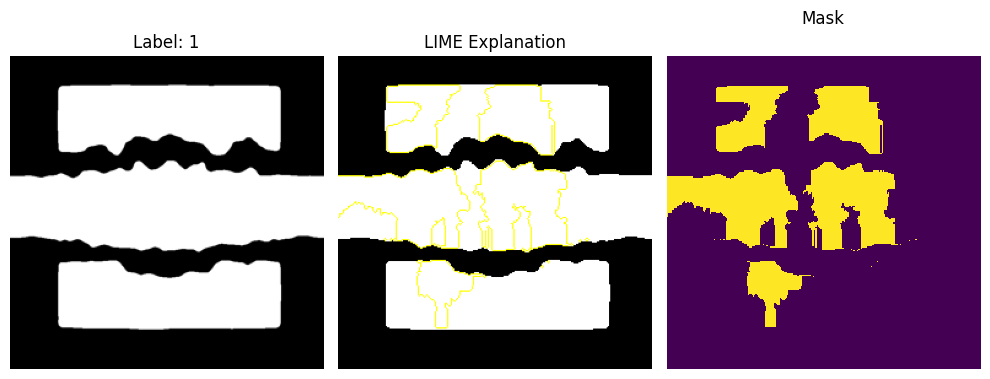

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


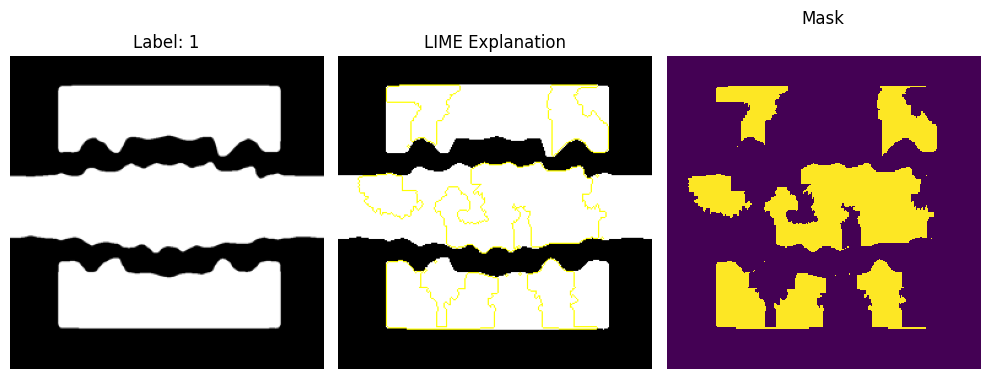

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


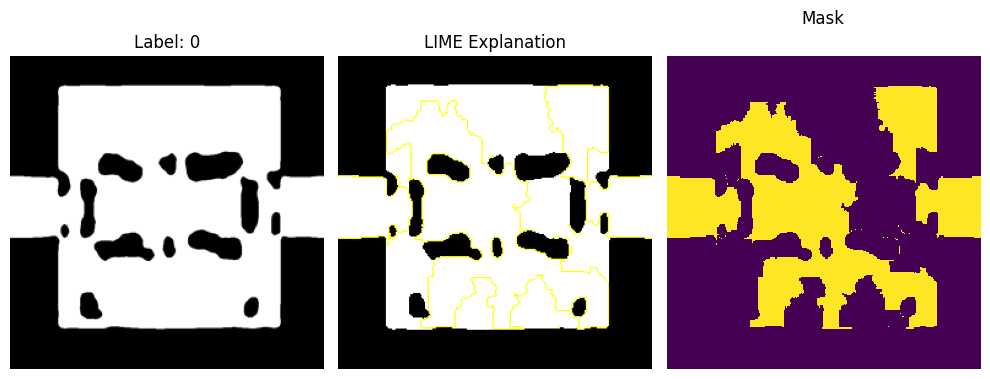

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


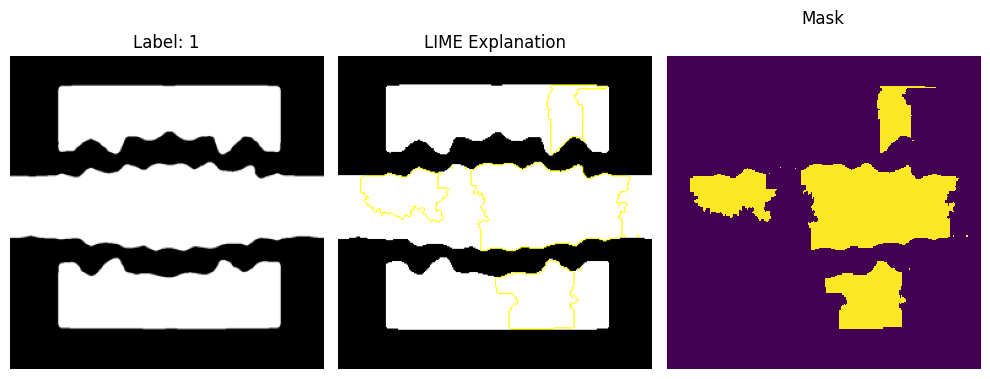

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


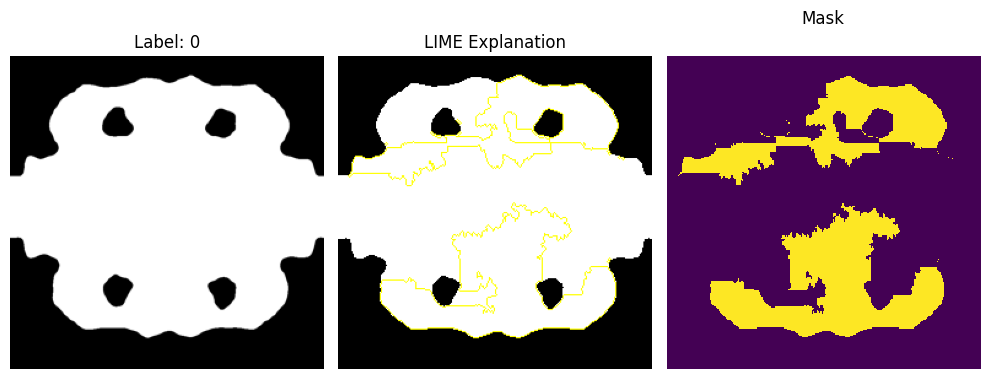

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


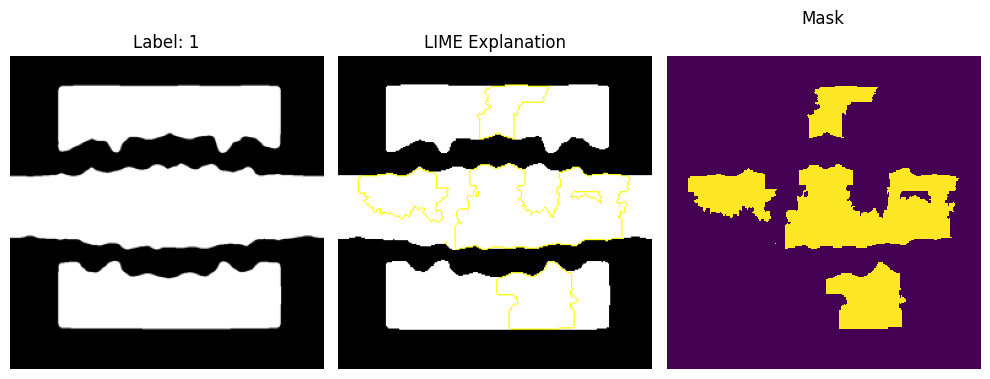

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


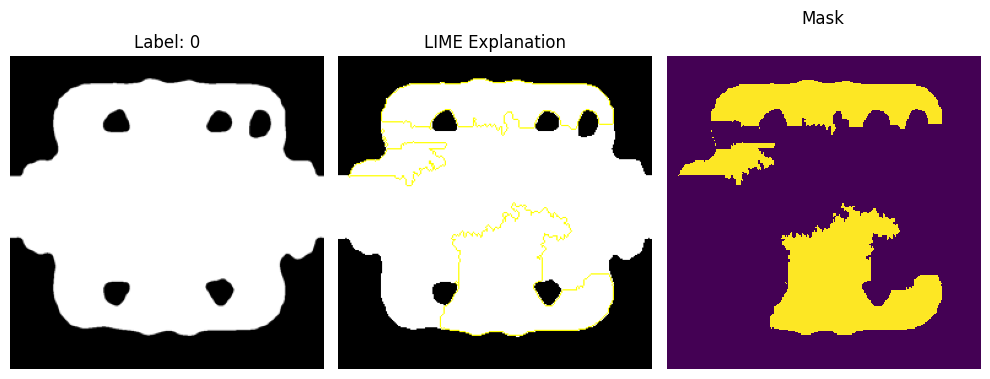

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


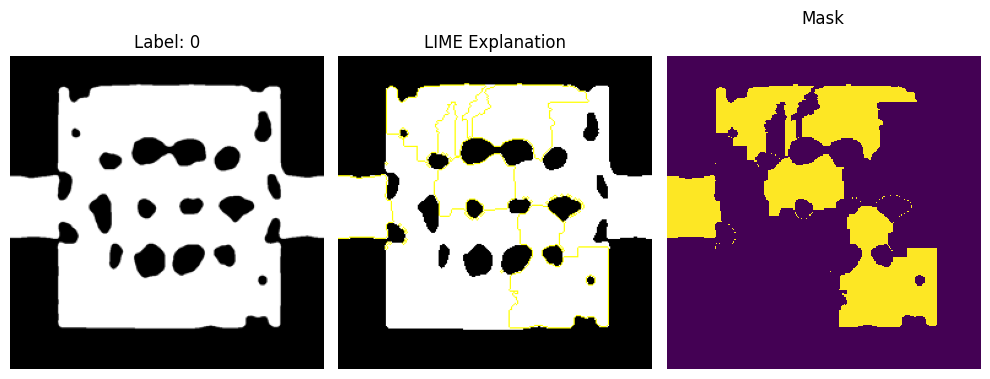

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


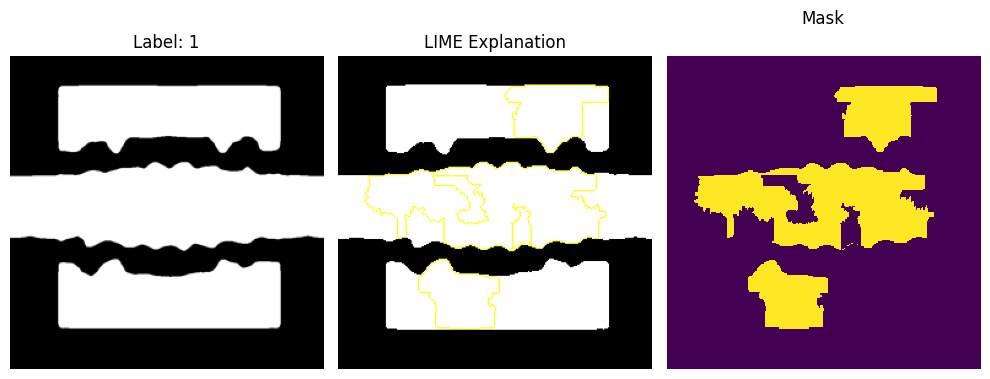

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


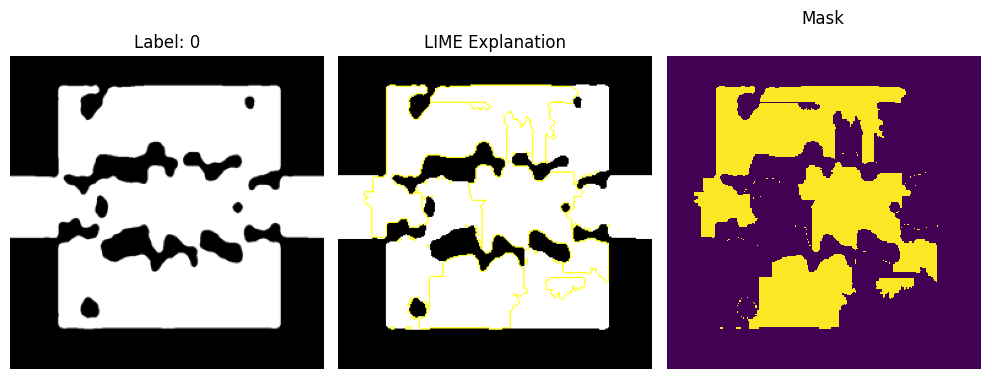

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


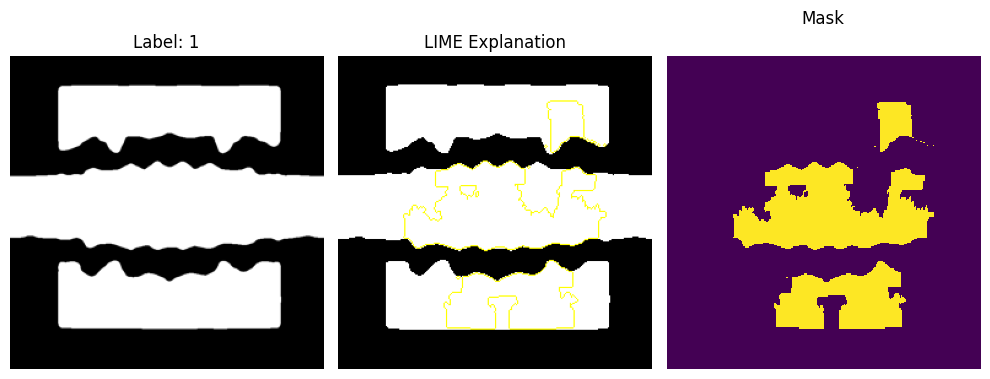

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


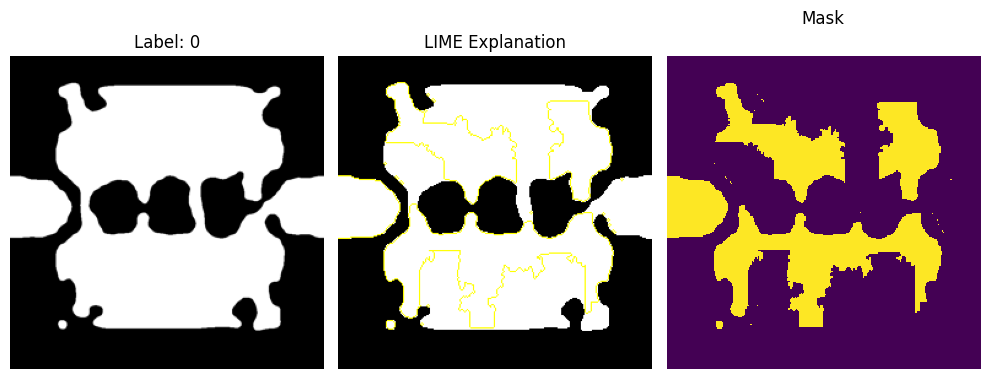

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


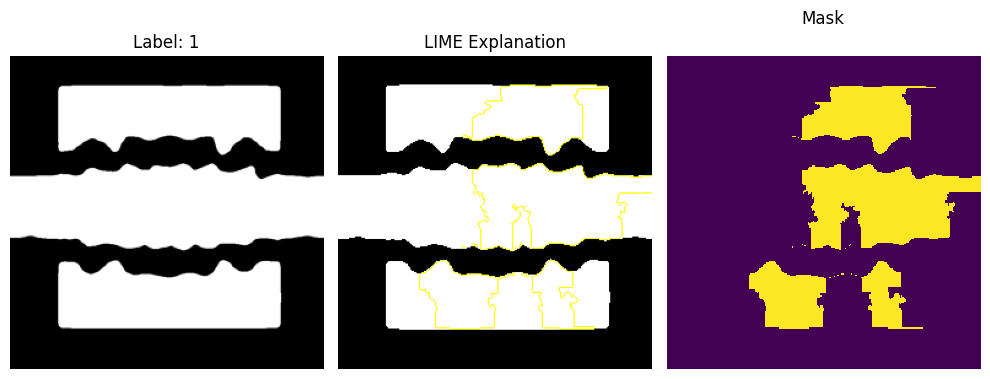

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


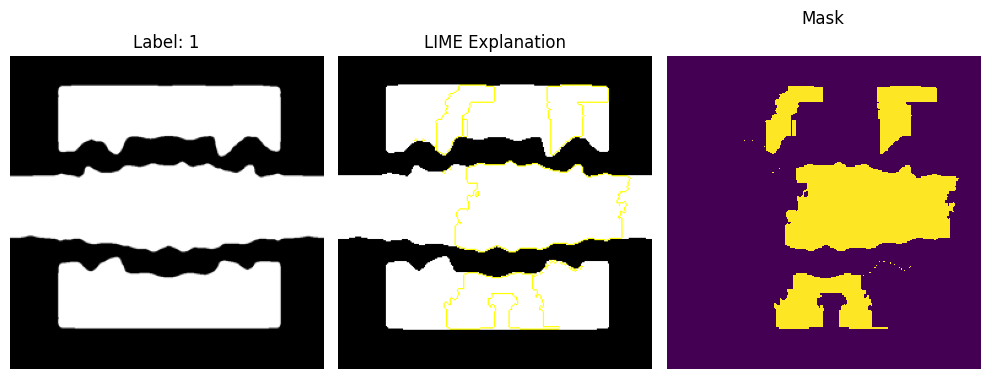

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


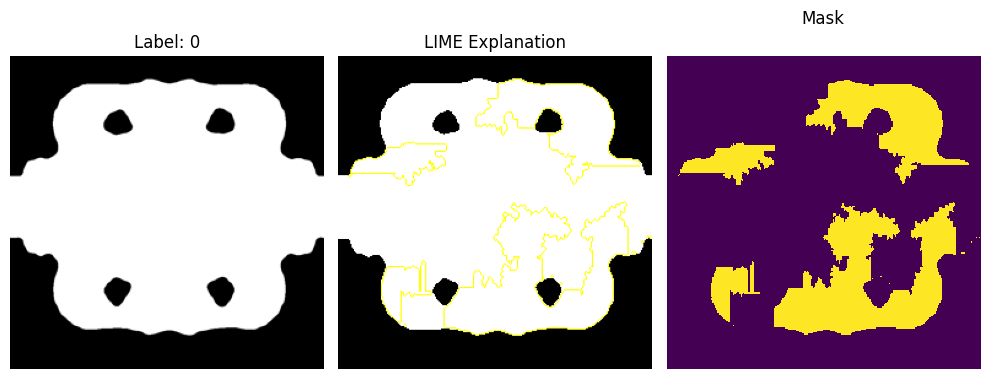

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


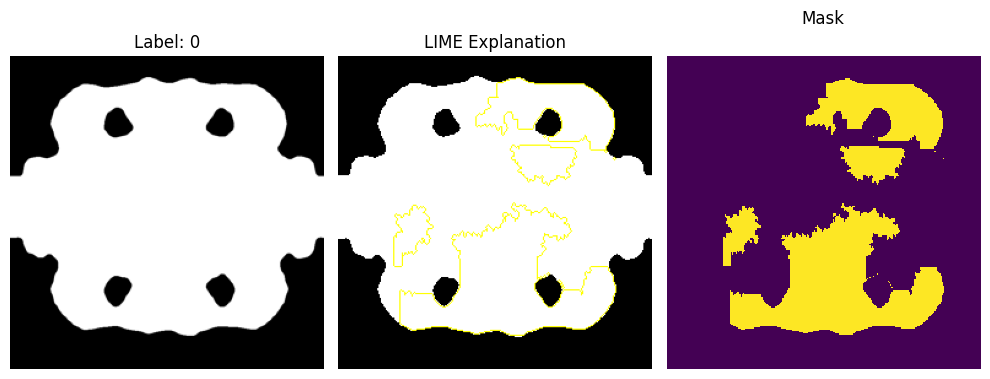

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


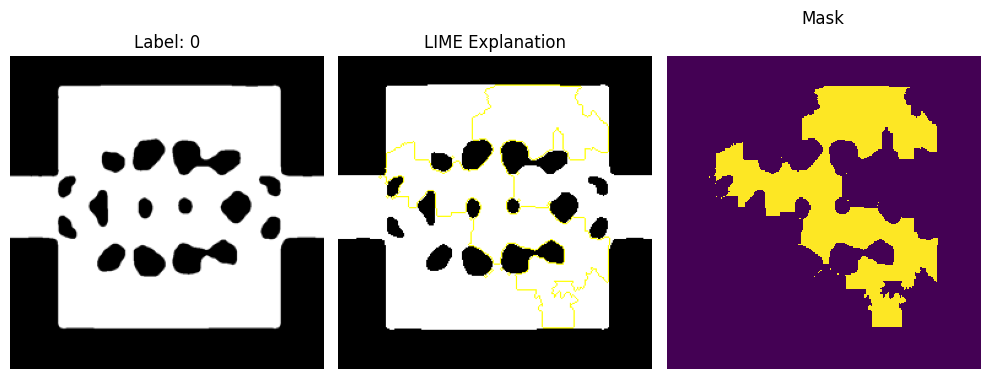

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


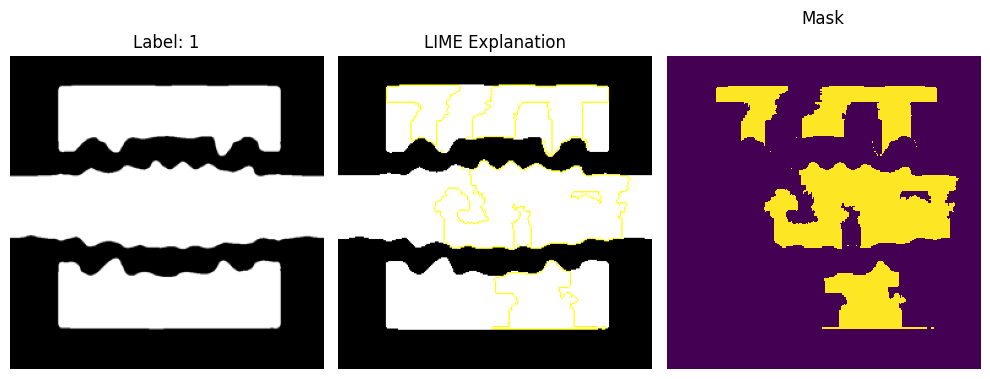

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


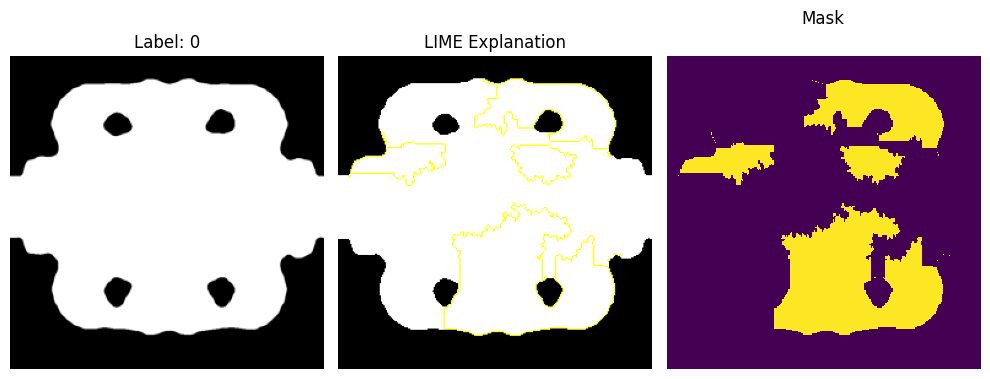

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


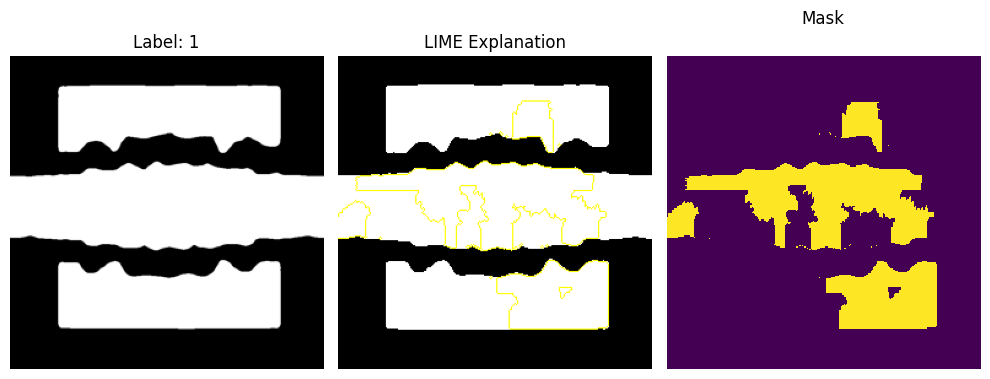

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


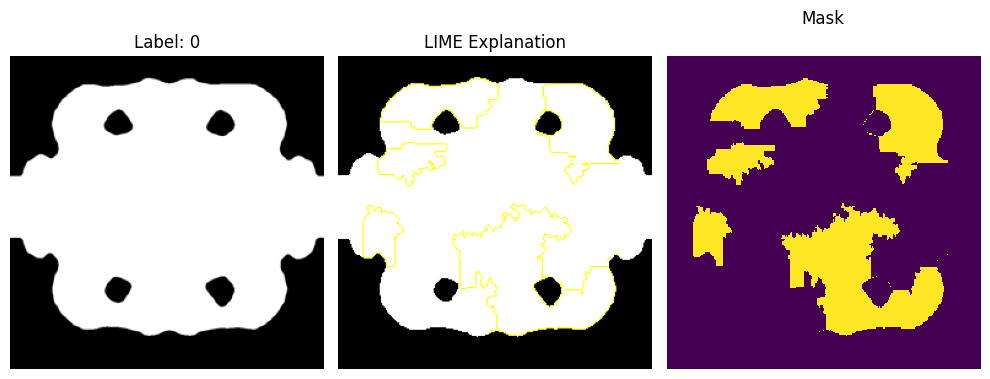

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


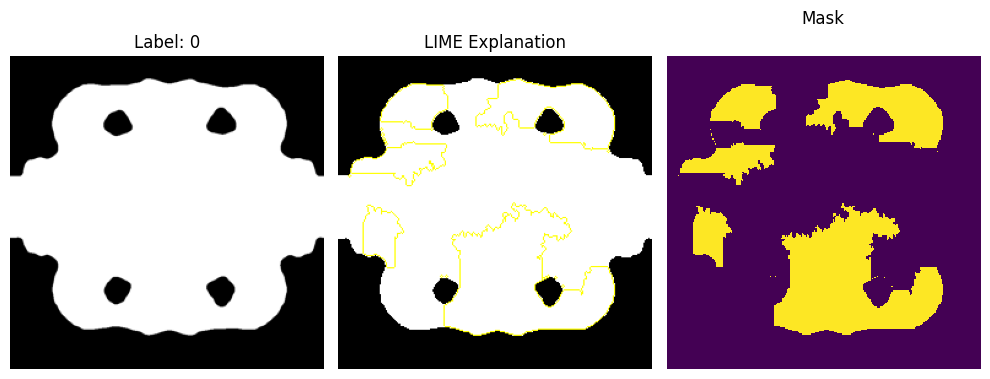

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


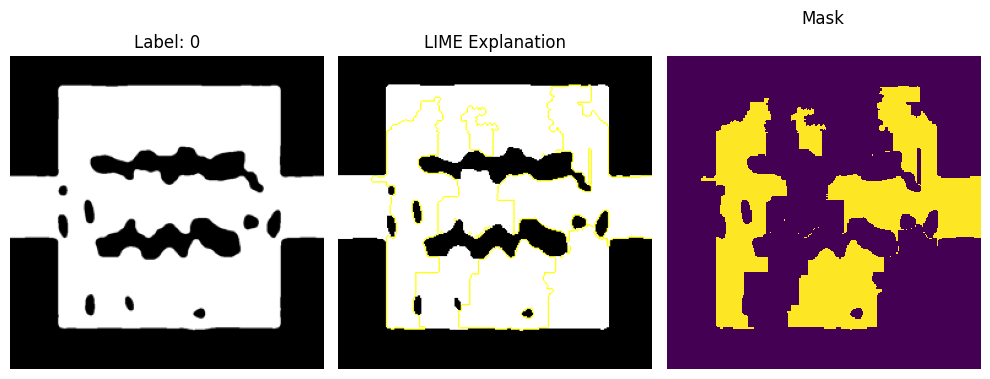

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


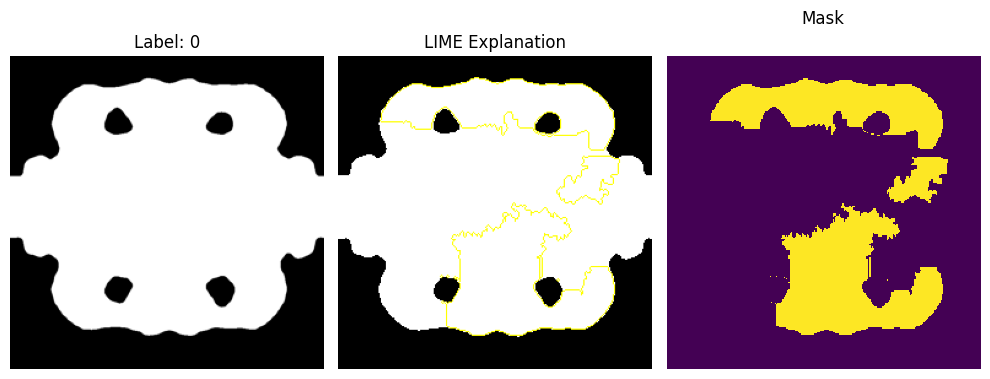

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


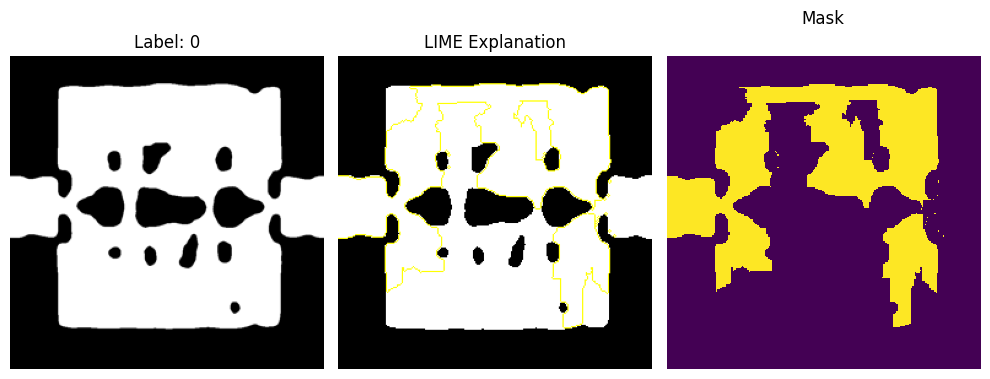

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


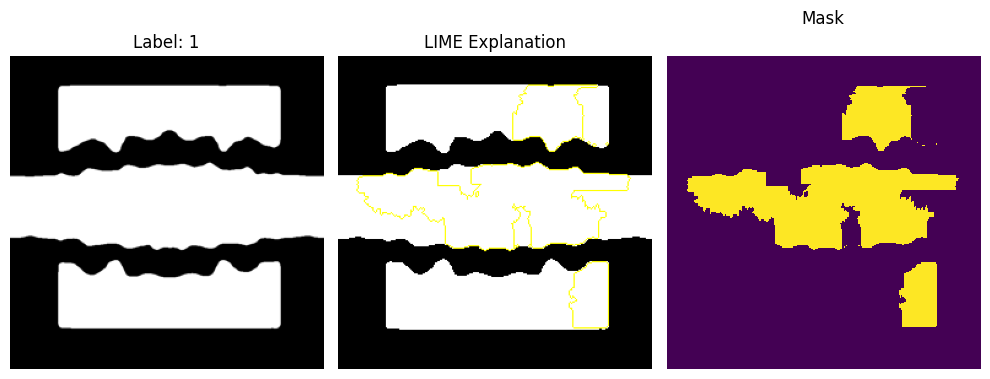

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


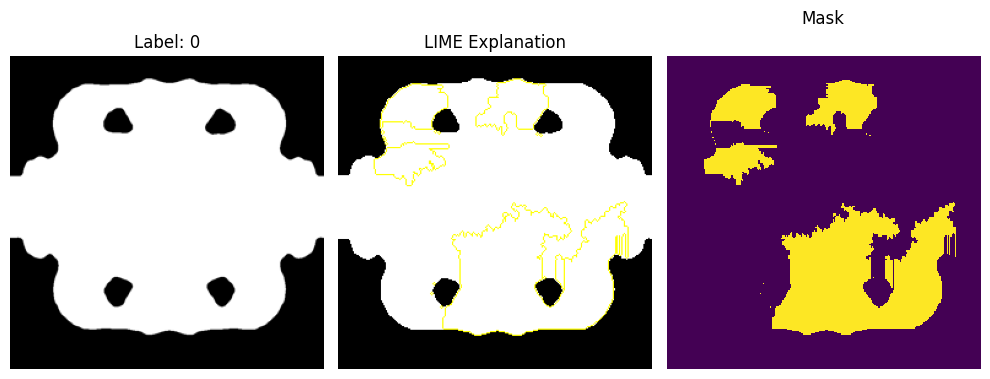

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


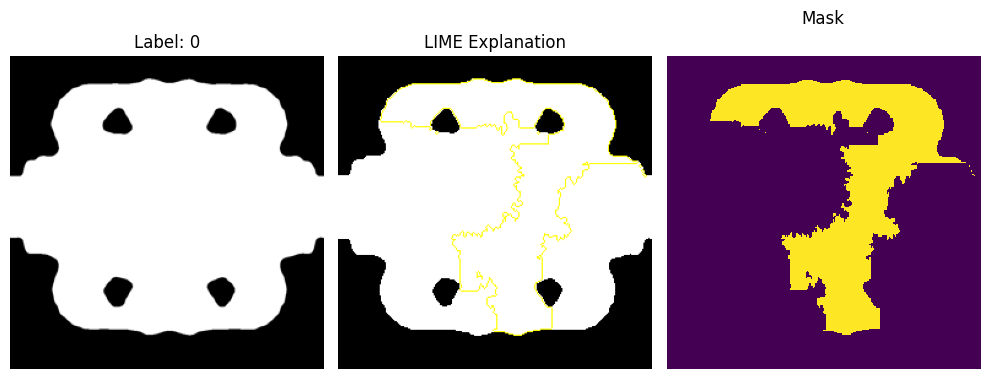

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


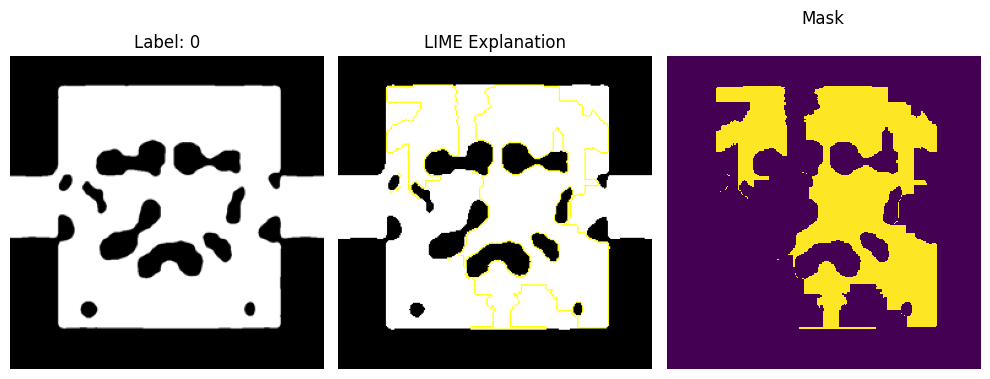

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


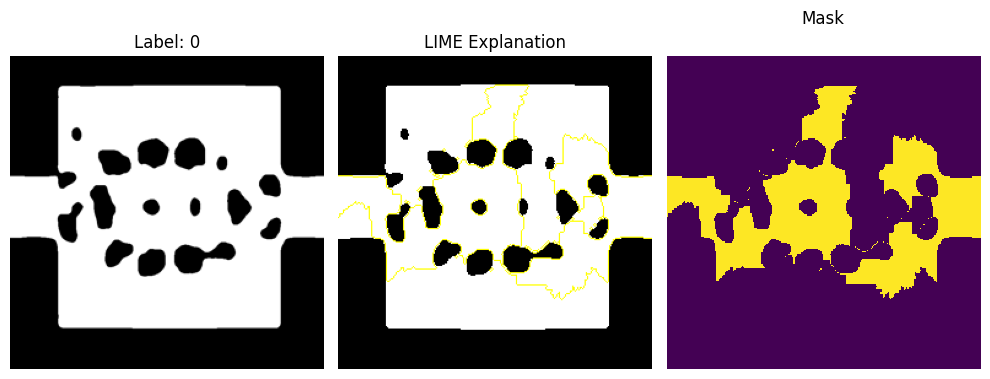

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


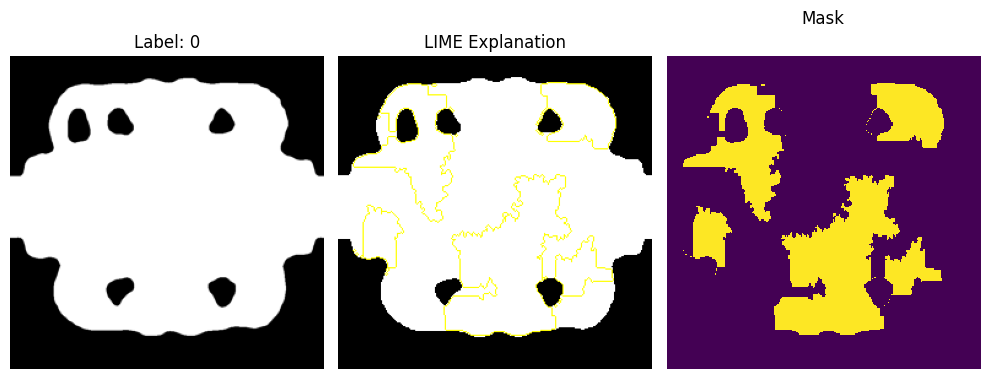

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


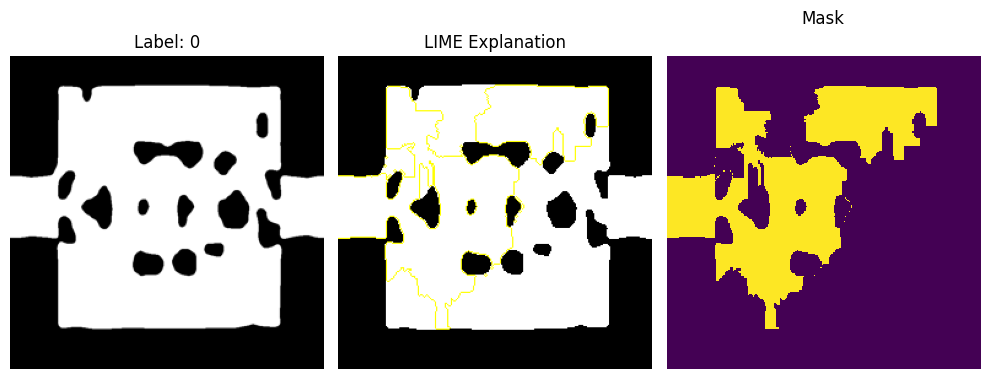

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


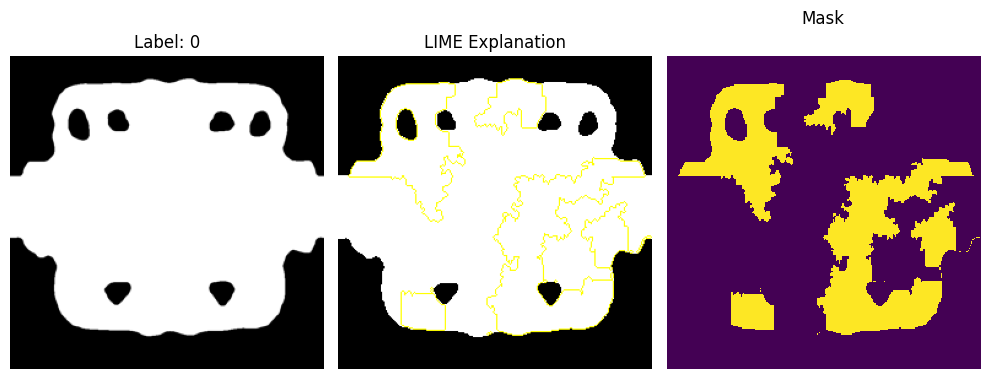

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


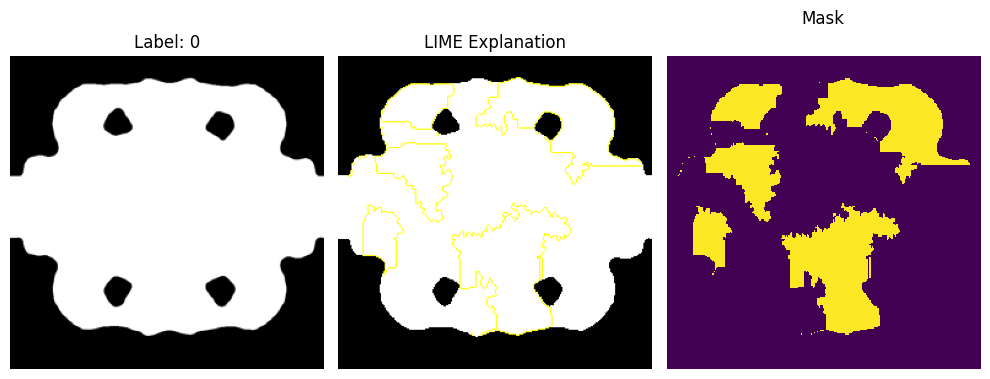

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


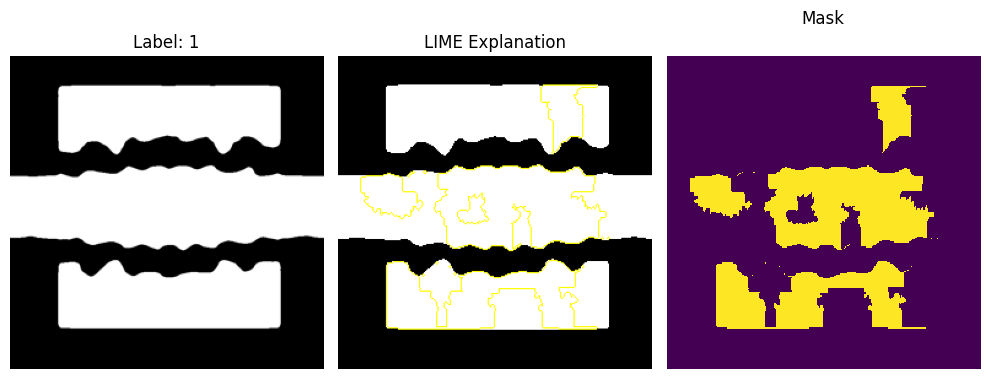

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


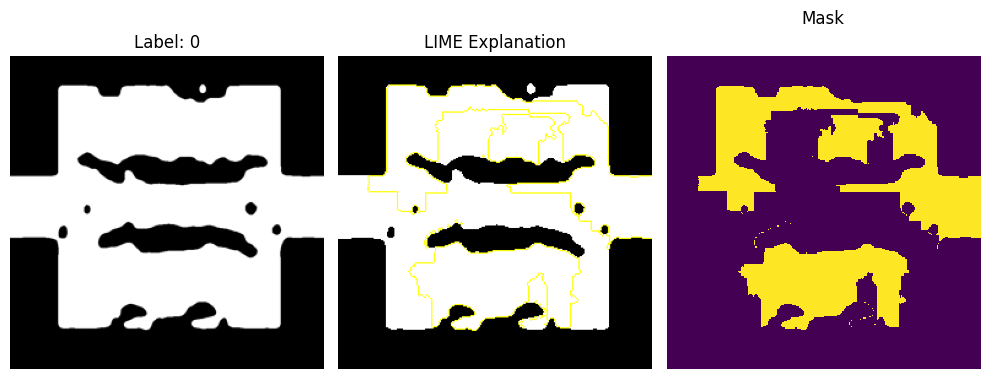

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


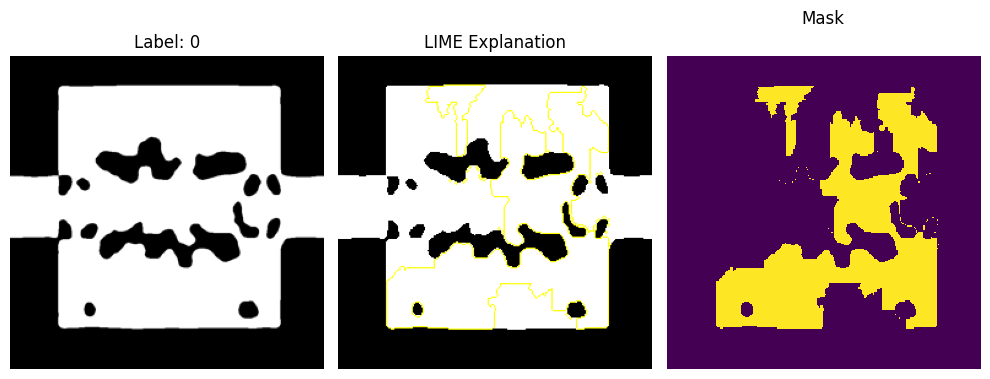

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


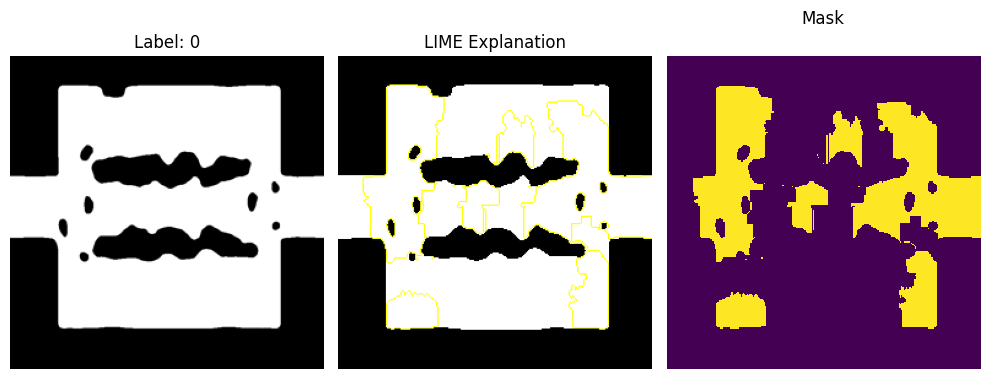

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


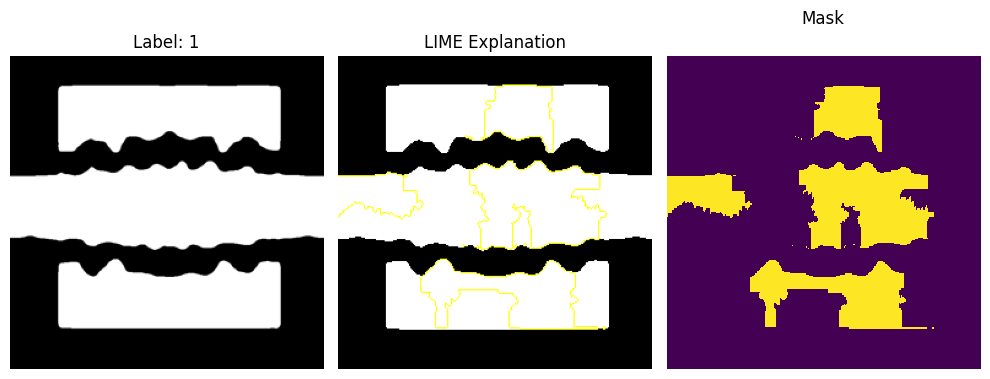

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


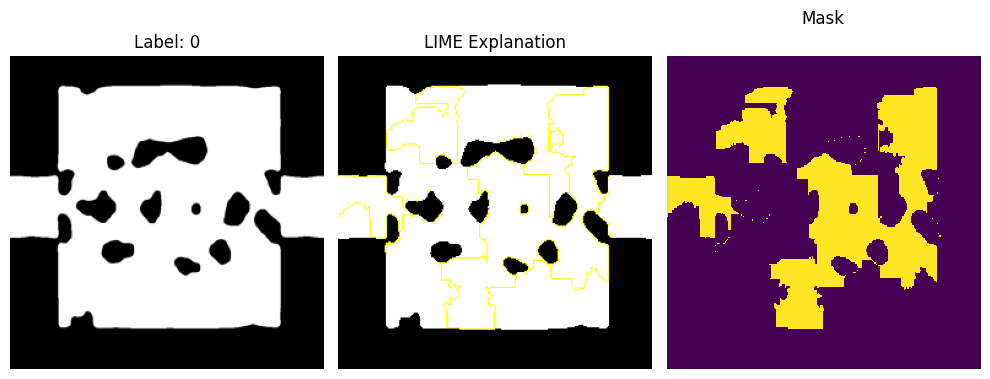

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


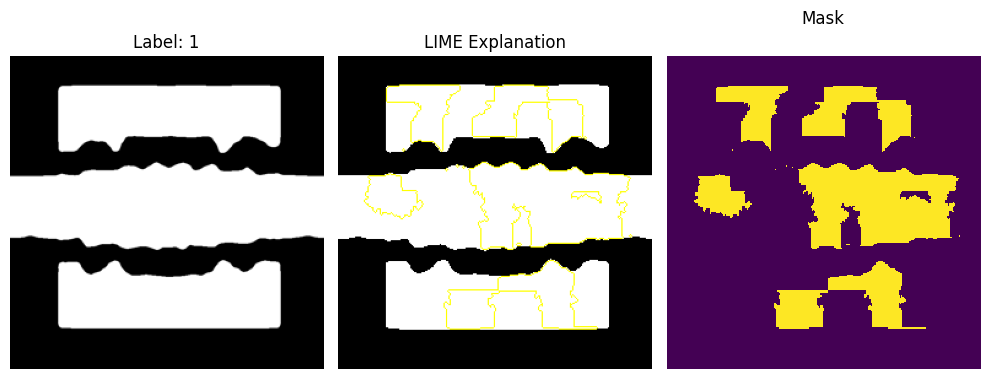

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


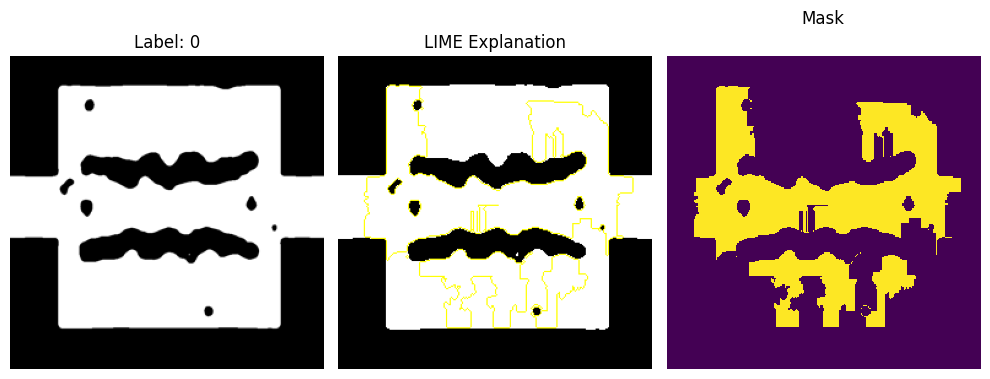

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


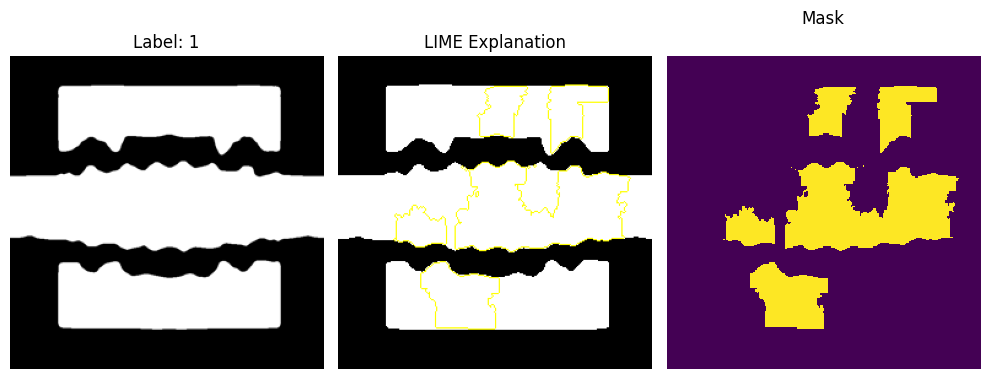

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


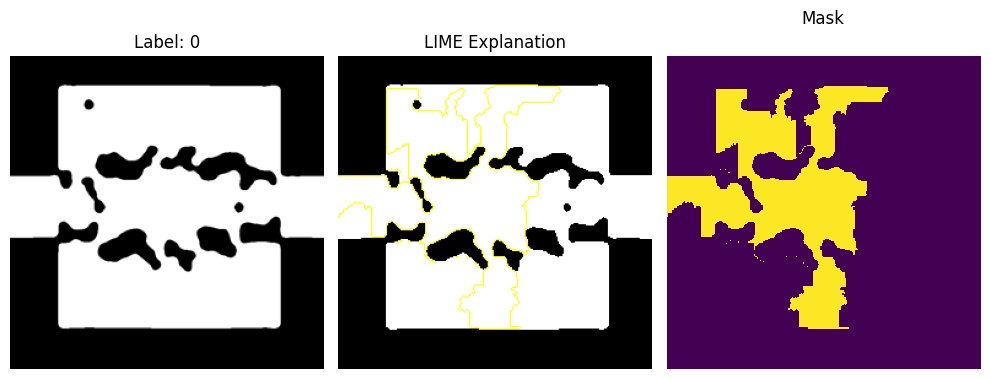

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


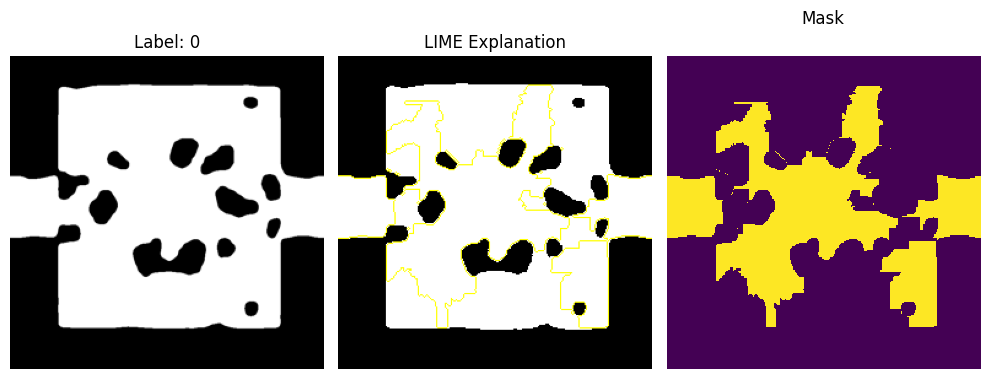

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


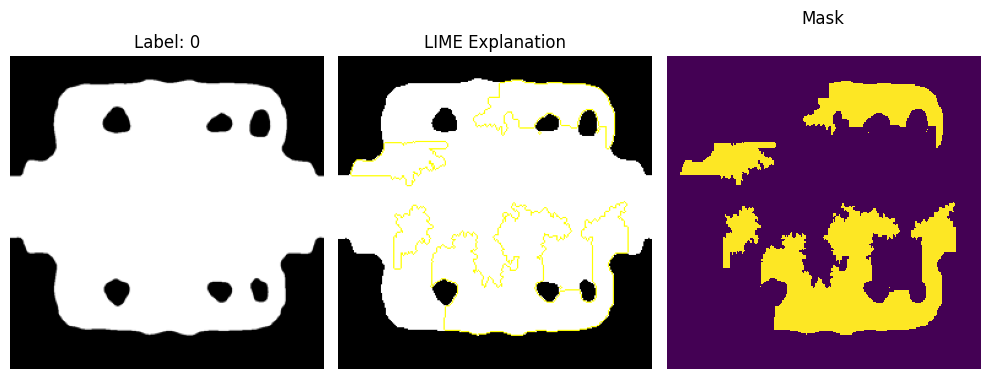

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


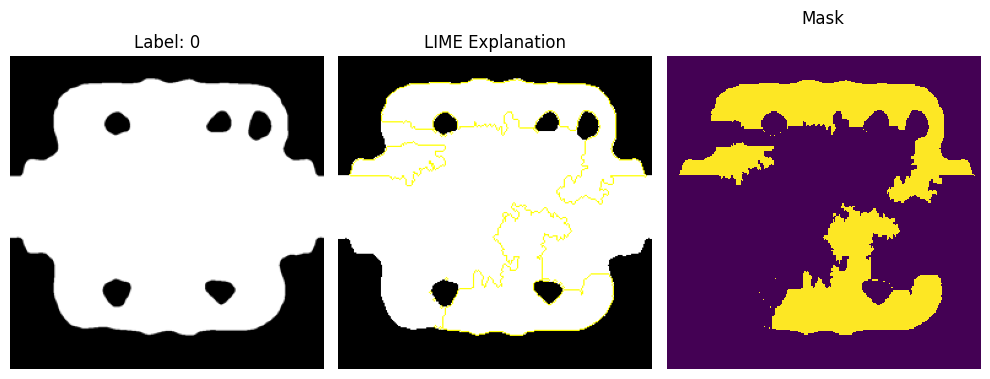

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


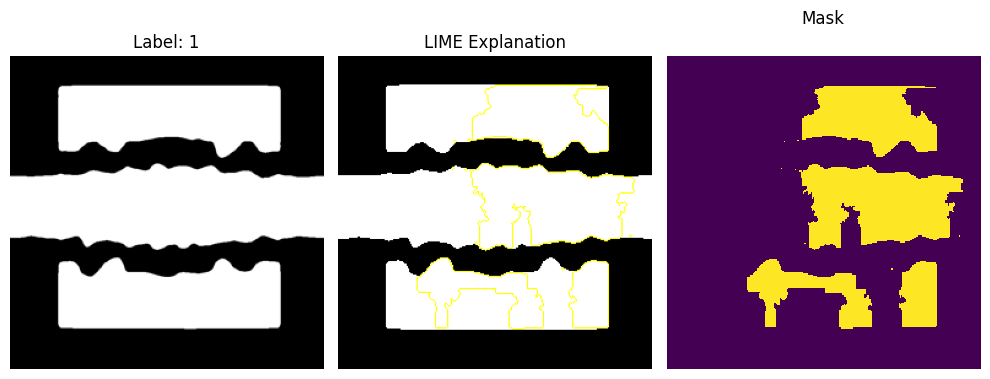

In [96]:
# Initialize a list to store all explanations
all_explanations = []

# Loop through all images
for i, image in enumerate(all_images):
    # Convert grayscale image to RGB for LIME compatibility
    sample_image = cv2.cvtColor((image.squeeze() * 255).astype('uint8'), cv2.COLOR_GRAY2RGB)

    # Run LIME explanation
    with SuppressOutput():  # Suppress LIME's verbose output
        explanation = explainer.explain_instance(
            sample_image.astype('double'),
            predict_fn,
            top_labels=1,
            hide_color=0,
            num_samples=1000  # Number of perturbations
        )

    # Save explanation to the list
    all_explanations.append(explanation)

    # Display explanation (optional, as in your original code)
    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=True,
        num_features=10,
        hide_rest=False
    )

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10, 5))

    # Original image
    ax1.imshow(sample_image[:, :, 0].reshape(sample_image.shape[0], sample_image.shape[1]), cmap='gray')
    ax1.set_title(f"Label: {np.argmax(all_labels[i])}")
    ax1.axis('off')

    # LIME explanation with boundaries
    ax2.imshow(mark_boundaries(temp, mask, color=(1, 1, 0)))  # Yellow boundaries
    ax2.set_title('LIME Explanation')
    ax2.axis('off')

    # Display mask
    ax3.matshow(mask)
    ax3.set_title('Mask')
    ax3.axis('off')

    plt.tight_layout()
    plt.show()


### **2. Generate Dependence Plot**

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━

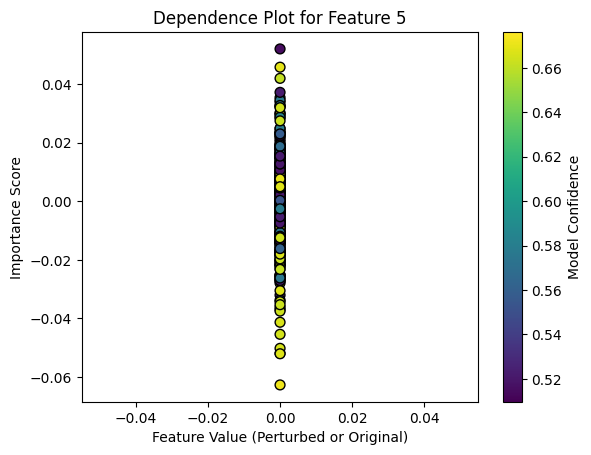

In [97]:
# Feature index to analyze (choose based on your LIME feature mapping)
feature_index = 5  # Change to the desired feature index

# Containers for feature values and importance scores
feature_values = []  # Perturbed feature values
importance_scores = []  # Corresponding importance scores
predicted_confidences = []  # Confidence for the top class

# Loop through all LIME explanations
for i, explanation in enumerate(all_explanations):
    # Extract the local explanation for the top label
    top_label = explanation.top_labels[0]
    local_exp = explanation.local_exp[top_label]  # List of (feature_index, importance_score)
    
    # Find the importance score for the chosen feature index
    for feat, importance in local_exp:
        if feat == feature_index:
            importance_scores.append(importance)
            break

    # Use the original feature value (perturbed value or image pixel)
    feature_values.append(all_images[i].flatten()[feature_index])

    # Get the confidence of the model for the top label
    predicted_confidences.append(model.predict(all_images[i].reshape(1, *all_images[i].shape))[0][top_label])

# Plot feature values vs. importance scores
plt.scatter(feature_values, importance_scores, c=predicted_confidences, cmap='viridis', s=50, edgecolor='k')
plt.colorbar(label="Model Confidence")
plt.title(f"Dependence Plot for Feature {feature_index}")
plt.xlabel("Feature Value (Perturbed or Original)")
plt.ylabel("Importance Score")
plt.show()


#### **About dependence plot:**

When working with black and white image datasets in the context of creating a dependence plot, the **"feature of interest"** typically refers to a measurable aspect of these images that could potentially influence the model's predictions. Since images inherently don't have straightforward "features" like tabular data (e.g., age, price, temperature), we need to derive these features from the image data itself. Here are a few ideas for features you might consider extracting from black and white images to analyze their impact on model predictions:

**Mean Pixel Intensity**: This is a simple feature that measures the average gray value across the entire image. Higher values indicate brighter images.

**Pixel Count Above a Threshold**: This feature could count how many pixels in an image have a gray value above a certain threshold, which could be a proxy for how much of a certain object or area is present.

**Edge Count**: By applying an edge detection filter (like Sobel or Canny), you can count the number of edge pixels in an image. This could correlate with the complexity or the presence of certain shapes in the images.

**Image Contrast**: Contrast can be defined as the standard deviation of the pixel intensities. It gives an idea of how much the pixel values in the image differ from each other.

**Area of the Largest Contour**: Using image segmentation techniques to find and measure the largest continuous area that stands out from the background.

### Roadblocks:

1. Need to find a way to generate the LIME outputs faster so that we do not have to run the algorithm again and again each time I add a new cell with visualisation/plots
2. Is there a way to save features of images such that they can be called as functions for new generating output from new methods of contextualisation?
3. How to keep the notebook updated always without having to run it in the background?